In [ ]:
import numpy as np
import matplotlib.pyplot as plt
 
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers

In [ ]:
fpath = '/content/drive/MyDrive/Dataset/syn_occ_sh.npy'

dataset = np.load(fpath)
print(dataset.shape)

# Normalize the data to the 0-1 range.
dataset = dataset / 255.0

def create_shifted_frames(data):
    x = data[:, 0 : data.shape[1] - 2, :, :]
    y = data[:, -1, :, :]
    return x, y

x, y = create_shifted_frames(dataset)

(872, 5, 80, 30, 3)


In [ ]:
from keras.models import load_model
bm = load_model('/content/drive/MyDrive/Dataset/model_syn_occ.h5')

In [ ]:
t=[]
for i in range(len(dataset)):
  example = dataset[i]

  frames = example[:3, ...]
  original_frames = example[-1, ...]
  new_prediction = bm.predict(np.expand_dims(frames, axis=0))
  s = new_prediction.reshape(80, 30, 3)
  v = np.array([original_frames, s])
  t.append(v)
  '''plt.figure(figsize=(20, 5))
  plt.subplot(1, 5, 1),plt.imshow(frames[0]),plt.title("Frame 1")
  plt.subplot(1, 5, 2),plt.imshow(frames[1]),plt.title("Frame 2")
  plt.subplot(1, 5, 3),plt.imshow(original_frames),plt.title("Frame 3")
  plt.subplot(1, 5, 4),plt.imshow(frames[2]),plt.title("Occluded Frame 3")
  plt.subplot(1, 5, 5),plt.imshow(s),plt.title("LSTM Model Output")
  plt.show()'''

lso = np.array(t)

In [ ]:
lso.shape

(872, 2, 80, 30, 3)

In [ ]:
np.save('/content/drive/MyDrive/Dataset/lso.npy', lso)

In [ ]:
d = np.load('/content/drive/MyDrive/Dataset/lso.npy')
d.shape

(872, 2, 80, 30, 3)

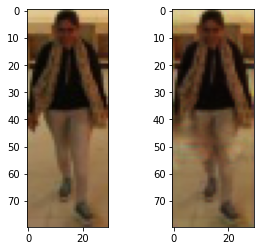

In [ ]:
for img in d:
  plt.figure(figsize=(10, 4))
  plt.subplot(1, 4, 1),plt.imshow(img[0])
  plt.subplot(1, 4, 2),plt.imshow(img[1])
  plt.show()
  break

In [ ]:
import numpy as np
import random
import matplotlib.pyplot as plt
%matplotlib inline

from tqdm import tqdm

from keras.layers import Input, Conv2D, Conv2DTranspose
from keras.layers import AveragePooling2D, BatchNormalization
from keras.layers import UpSampling2D, Flatten, Activation
from keras.models import Model, Sequential
from keras.layers.core import Dense, Dropout
from keras.layers.advanced_activations import LeakyReLU
from keras.optimizers import Adam
from keras import backend as k


In [ ]:
# Smoothing value
smooth_real = 0.9

# Number of epochs
epochs = 3000

# Batchsize
batch_size = 64

# Optimizer for the generator
optimizer_g = Adam(lr=0.0002, beta_1=0.5)

# Optimizer for the discriminator
optimizer_d = Adam(lr=0.0004, beta_1=0.5)

# Shape of the input image
input_shape = (80,30,3)

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/optimizer_v2/optimizer_v2.py:375: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  "The `lr` argument is deprecated, use `learning_rate` instead.")


In [ ]:
def img_generator(input_shape):
    generator = Sequential()
    generator.add(Conv2D(32, (3, 3), padding='same', input_shape=input_shape)) # 32 filters
    generator.add(BatchNormalization())
    generator.add(Activation('relu'))
    generator.add(AveragePooling2D(pool_size=(2, 2)))

    generator.add(Conv2D(64, (3, 3), padding='same')) # 64 filters
    generator.add(BatchNormalization())
    generator.add(Activation('relu'))
    
    generator.add(Conv2D(64, (3, 3), padding='same')) # 64 filters
    generator.add(BatchNormalization())
    generator.add(Activation('relu'))
    
    generator.add(Conv2D(128, (3, 3), padding='same')) # 128 filters
    generator.add(BatchNormalization())
    generator.add(Activation('relu'))

    generator.add(Conv2D(128, (3, 3), padding='same')) # 128 filters
    generator.add(BatchNormalization())
    generator.add(Activation('relu')) 

    generator.add(Conv2D(128, (3, 3), padding='same')) # 128 filters
    generator.add(Activation('relu'))
    generator.add(UpSampling2D((2,2)))
    
    generator.add(Conv2D(64, (3, 3), padding='same')) # 64 filters
    generator.add(Activation('relu'))

    generator.add(Conv2D(64, (3, 3), padding='same')) # 64 filters
    generator.add(Activation('relu'))
    
    generator.add(Conv2D(3, (3, 3), activation='tanh', padding='same')) # 3 filter
    return generator

# print generator summary
img_generator(input_shape).summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 80, 30, 32)        896       
_________________________________________________________________
batch_normalization (BatchNo (None, 80, 30, 32)        128       
_________________________________________________________________
activation (Activation)      (None, 80, 30, 32)        0         
_________________________________________________________________
average_pooling2d (AveragePo (None, 40, 15, 32)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 40, 15, 64)        18496     
_________________________________________________________________
batch_normalization_1 (Batch (None, 40, 15, 64)        256       
_________________________________________________________________
activation_1 (Activation)    (None, 40, 15, 64)        0

In [ ]:
def img_discriminator(input_shape):
    discriminator = Sequential()
    discriminator.add(Conv2D(32, (3, 3), strides=2, padding='same', input_shape=input_shape, activation = 'linear'))
    discriminator.add(LeakyReLU(0.2))
    discriminator.add(Dropout(0.2))

    discriminator.add(Conv2D(64, (3, 3), strides=2, padding='same', input_shape=input_shape, activation = 'linear'))
    discriminator.add(LeakyReLU(0.2))
    discriminator.add(Dropout(0.2))

    discriminator.add(Conv2D(64, (3, 3), strides=2, padding='same', input_shape=input_shape, activation = 'linear'))
    discriminator.add(LeakyReLU(0.2))
    discriminator.add(Dropout(0.2))
    
    discriminator.add(Conv2D(128, (3, 3), strides=2, padding='same', activation = 'linear'))
    discriminator.add(LeakyReLU(0.2))
    discriminator.add(Dropout(0.2))
    
    discriminator.add(Conv2D(256, (3, 3), padding='same', activation = 'linear'))
    discriminator.add(LeakyReLU(0.2))
    discriminator.add(Dropout(0.2))
    
    discriminator.add(Flatten())
    discriminator.add(Dense(1, activation='sigmoid'))

    return discriminator

# print summary of the discriminator
img_discriminator(input_shape).summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_9 (Conv2D)            (None, 40, 15, 32)        896       
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 40, 15, 32)        0         
_________________________________________________________________
dropout (Dropout)            (None, 40, 15, 32)        0         
_________________________________________________________________
conv2d_10 (Conv2D)           (None, 20, 8, 64)         18496     
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 20, 8, 64)         0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 20, 8, 64)         0         
_________________________________________________________________
conv2d_11 (Conv2D)           (None, 10, 4, 64)        

In [ ]:
def dcgan(discriminator, generator, input_shape):
    # Don't train the discriminator when compiling GAN
    discriminator.trainable = False

    # Accepts the noised input
    gan_input = Input(shape=input_shape)
    
    # Generates image by passing the above received input to the generator
    gen_img = generator(gan_input)
    
    # Feeds the generated image to the discriminator
    gan_output = discriminator(gen_img)
    
    # Compile everything as a model with binary crossentropy loss
    gan = Model(inputs=gan_input, outputs=gan_output)
    return gan

In [ ]:
def generated_images_plot(original, noised_data, generator):

    ind = np.random.randint(0, original.shape[0], size=5)

    for i in ind:
      plt.figure(figsize=(20, 5))
      plt.subplot(1, 5, 1),plt.imshow(noised_data[i]),plt.title("Occluded")
      plt.subplot(1, 5, 2),plt.imshow(original[i]),plt.title("Original")
      ip=noised_data[i].reshape(1,80,30,3)
      plt.subplot(1, 5, 3),plt.imshow((generator.predict(ip)).reshape(80,30,3)),plt.title("Generated")
      plt.show()

In [ ]:
def plot_generated_images_combined(original, noised_data, generator):
    rows, cols = 4, 12
    num = rows * cols
    image_size = 28

    generated_images = generator.predict(noised_data[0:num])
    
    imgs = np.concatenate([original[0:num], noised_data[0:num], generated_images])
    imgs = imgs.reshape((rows * 3, cols, image_size, image_size))
    imgs = np.vstack(np.split(imgs, rows, axis=1))
    imgs = imgs.reshape((rows * 3, -1, image_size, image_size))
    imgs = np.vstack([np.hstack(i) for i in imgs])
    imgs = upscale(imgs)
    plt.figure(figsize=(8,16))
    plt.axis('off')
    plt.title('Original Images: top rows, '
              'Corrupted Input: middle rows, '
              'Generated Images: bottom rows')
    plt.imshow(imgs)
    plt.show() 

In [ ]:
from keras.models import load_model
#generator=load_model('/content/drive/MyDrive/Dataset/N/gen_{1800---1}.h5')
#discriminator=load_model('/content/drive/MyDrive/Dataset/N/disc_{1800---1}.h5')

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch 1


100%|██████████| 13/13 [00:28<00:00,  2.19s/it]


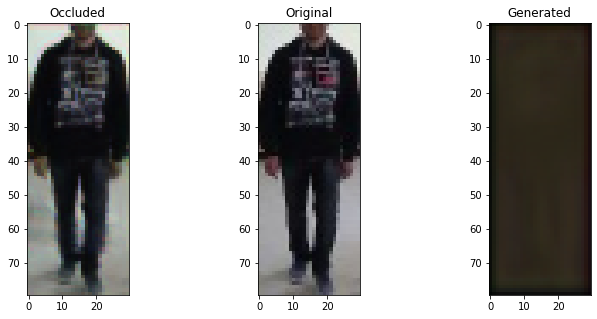

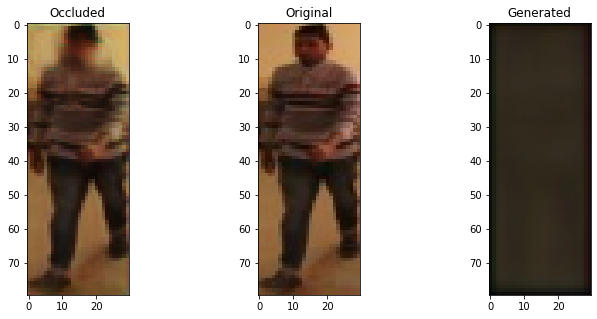

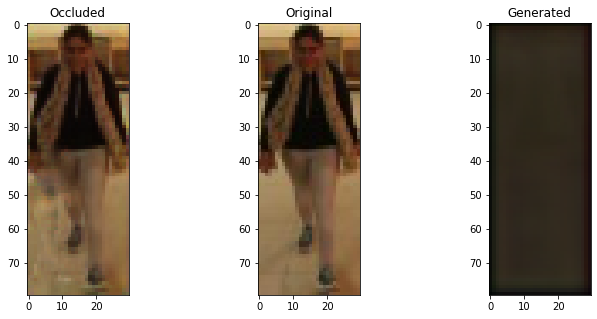

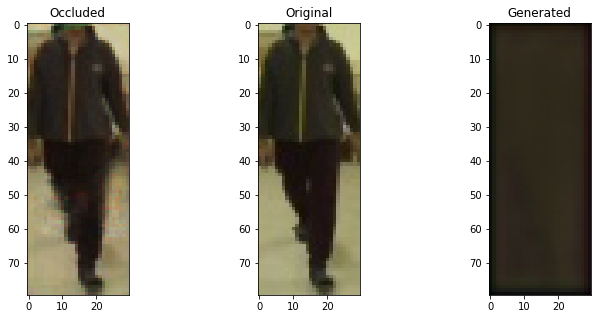

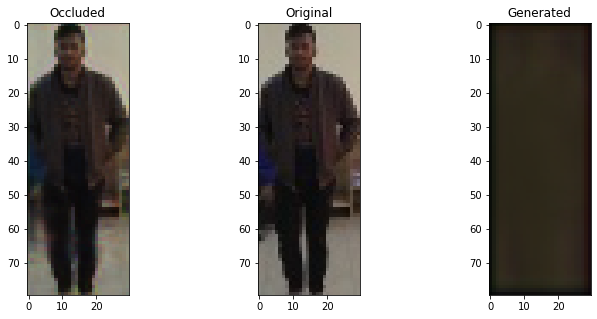

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.5471315383911133 , Adversarial Loss:  0.11706477403640747
Epoch 2


  8%|▊         | 1/13 [00:00<00:01,  8.42it/s]

Discriminator Loss:  0.6540895104408264 , Adversarial Loss:  0.050403811037540436
Epoch 3


  8%|▊         | 1/13 [00:00<00:01,  7.91it/s]

Discriminator Loss:  0.6477645635604858 , Adversarial Loss:  0.042593181133270264
Epoch 4


  8%|▊         | 1/13 [00:00<00:01,  8.49it/s]

Discriminator Loss:  0.6492252349853516 , Adversarial Loss:  0.03092038631439209
Epoch 5


  8%|▊         | 1/13 [00:00<00:01,  8.37it/s]

Discriminator Loss:  0.6505799293518066 , Adversarial Loss:  0.02845311537384987
Epoch 6


  8%|▊         | 1/13 [00:00<00:01,  7.73it/s]

Discriminator Loss:  0.6746892929077148 , Adversarial Loss:  0.02087944746017456
Epoch 7


  8%|▊         | 1/13 [00:00<00:01,  7.80it/s]

Discriminator Loss:  0.6531631946563721 , Adversarial Loss:  0.02023877389729023
Epoch 8


  8%|▊         | 1/13 [00:00<00:01,  8.36it/s]

Discriminator Loss:  0.6474080681800842 , Adversarial Loss:  0.017880015075206757
Epoch 9


  8%|▊         | 1/13 [00:00<00:01,  7.59it/s]

Discriminator Loss:  0.6451444625854492 , Adversarial Loss:  0.016225222498178482
Epoch 10


  8%|▊         | 1/13 [00:00<00:01,  7.77it/s]

Discriminator Loss:  0.6948100328445435 , Adversarial Loss:  0.014425607398152351
Epoch 11


  8%|▊         | 1/13 [00:00<00:01,  8.03it/s]

Discriminator Loss:  0.6321834325790405 , Adversarial Loss:  0.013448299840092659
Epoch 12


  8%|▊         | 1/13 [00:00<00:01,  7.30it/s]

Discriminator Loss:  0.6527833938598633 , Adversarial Loss:  0.013193164020776749
Epoch 13


  8%|▊         | 1/13 [00:00<00:01,  7.96it/s]

Discriminator Loss:  0.647167444229126 , Adversarial Loss:  0.012050043791532516
Epoch 14


  8%|▊         | 1/13 [00:00<00:01,  7.94it/s]

Discriminator Loss:  0.6460026502609253 , Adversarial Loss:  0.011509603820741177
Epoch 15


  8%|▊         | 1/13 [00:00<00:01,  7.26it/s]

Discriminator Loss:  0.6722983717918396 , Adversarial Loss:  0.012093829922378063
Epoch 16


  8%|▊         | 1/13 [00:00<00:01,  7.72it/s]

Discriminator Loss:  0.6408538818359375 , Adversarial Loss:  0.012264164164662361
Epoch 17


  8%|▊         | 1/13 [00:00<00:01,  7.63it/s]

Discriminator Loss:  0.6561079025268555 , Adversarial Loss:  0.011035365052521229
Epoch 18


  8%|▊         | 1/13 [00:00<00:01,  7.76it/s]

Discriminator Loss:  0.6238818168640137 , Adversarial Loss:  0.010952481999993324
Epoch 19


  8%|▊         | 1/13 [00:00<00:01,  7.53it/s]

Discriminator Loss:  0.6720262169837952 , Adversarial Loss:  0.01104417908936739
Epoch 20


  8%|▊         | 1/13 [00:00<00:01,  7.71it/s]

Discriminator Loss:  0.6629999876022339 , Adversarial Loss:  0.011329886503517628
Epoch 21


100%|██████████| 13/13 [00:01<00:00,  7.72it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


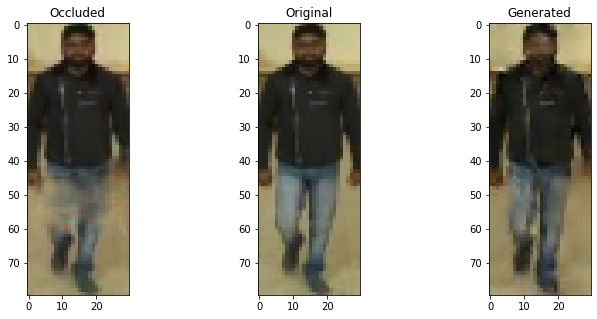

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


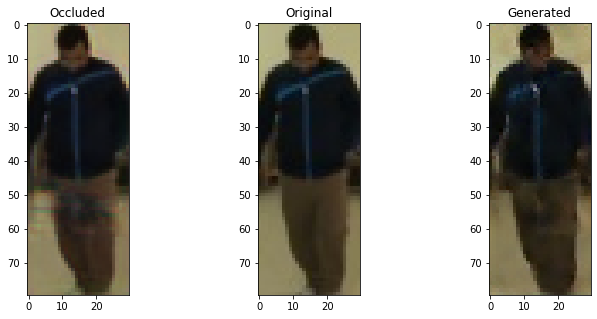

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


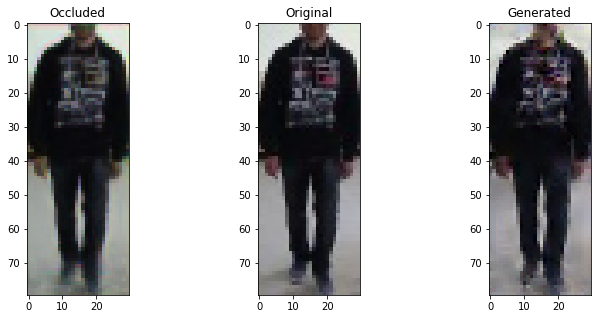

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


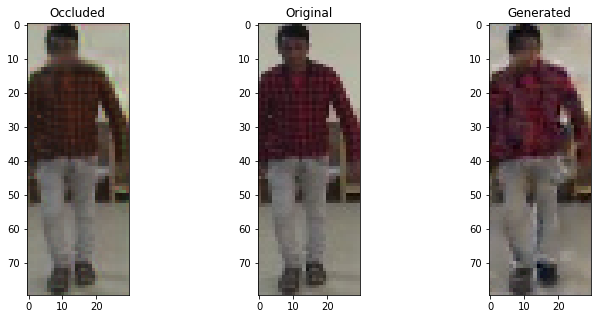

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


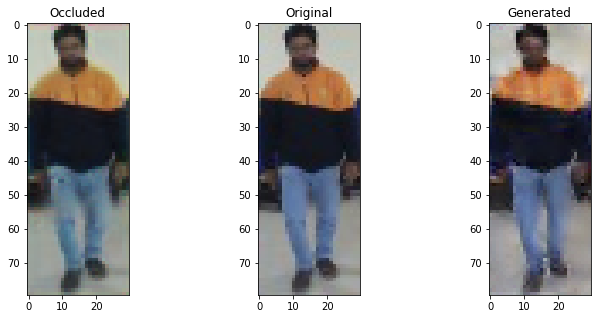

  8%|▊         | 1/13 [00:00<00:01,  6.33it/s]

Discriminator Loss:  0.6597995758056641 , Adversarial Loss:  0.010147642344236374
Epoch 22


  8%|▊         | 1/13 [00:00<00:01,  7.84it/s]

Discriminator Loss:  0.6385831832885742 , Adversarial Loss:  0.010365013964474201
Epoch 23


  8%|▊         | 1/13 [00:00<00:01,  7.82it/s]

Discriminator Loss:  0.6312524080276489 , Adversarial Loss:  0.009821349754929543
Epoch 24


  8%|▊         | 1/13 [00:00<00:01,  7.82it/s]

Discriminator Loss:  0.6594008803367615 , Adversarial Loss:  0.00830996036529541
Epoch 25


  8%|▊         | 1/13 [00:00<00:01,  7.74it/s]

Discriminator Loss:  0.6692283749580383 , Adversarial Loss:  0.010249543935060501
Epoch 26


  8%|▊         | 1/13 [00:00<00:01,  7.71it/s]

Discriminator Loss:  0.6621367931365967 , Adversarial Loss:  0.009409526363015175
Epoch 27


  8%|▊         | 1/13 [00:00<00:01,  7.51it/s]

Discriminator Loss:  0.6627755165100098 , Adversarial Loss:  0.00806603953242302
Epoch 28


  8%|▊         | 1/13 [00:00<00:01,  7.01it/s]

Discriminator Loss:  0.6643087267875671 , Adversarial Loss:  0.008437477052211761
Epoch 29


  8%|▊         | 1/13 [00:00<00:01,  7.80it/s]

Discriminator Loss:  0.6465469598770142 , Adversarial Loss:  0.008235137909650803
Epoch 30


  8%|▊         | 1/13 [00:00<00:01,  7.89it/s]

Discriminator Loss:  0.6528277397155762 , Adversarial Loss:  0.007641003467142582
Epoch 31


  8%|▊         | 1/13 [00:00<00:01,  7.77it/s]

Discriminator Loss:  0.6602672338485718 , Adversarial Loss:  0.007652784697711468
Epoch 32


  8%|▊         | 1/13 [00:00<00:01,  7.46it/s]

Discriminator Loss:  0.6768895387649536 , Adversarial Loss:  0.00812295638024807
Epoch 33


  8%|▊         | 1/13 [00:00<00:01,  7.83it/s]

Discriminator Loss:  0.681611180305481 , Adversarial Loss:  0.008084936998784542
Epoch 34


  8%|▊         | 1/13 [00:00<00:01,  7.83it/s]

Discriminator Loss:  0.6673233509063721 , Adversarial Loss:  0.008341390639543533
Epoch 35


  8%|▊         | 1/13 [00:00<00:01,  7.99it/s]

Discriminator Loss:  0.6766108274459839 , Adversarial Loss:  0.007930517196655273
Epoch 36


  8%|▊         | 1/13 [00:00<00:01,  7.69it/s]

Discriminator Loss:  0.6629723906517029 , Adversarial Loss:  0.007547426037490368
Epoch 37


  8%|▊         | 1/13 [00:00<00:01,  7.81it/s]

Discriminator Loss:  0.6467633247375488 , Adversarial Loss:  0.006420699413865805
Epoch 38


  8%|▊         | 1/13 [00:00<00:01,  7.91it/s]

Discriminator Loss:  0.6711851358413696 , Adversarial Loss:  0.006664392538368702
Epoch 39


  8%|▊         | 1/13 [00:00<00:01,  7.40it/s]

Discriminator Loss:  0.6617724895477295 , Adversarial Loss:  0.0066826362162828445
Epoch 40


  8%|▊         | 1/13 [00:00<00:01,  8.26it/s]

Discriminator Loss:  0.6561818718910217 , Adversarial Loss:  0.006889312528073788
Epoch 41


100%|██████████| 13/13 [00:01<00:00,  7.85it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


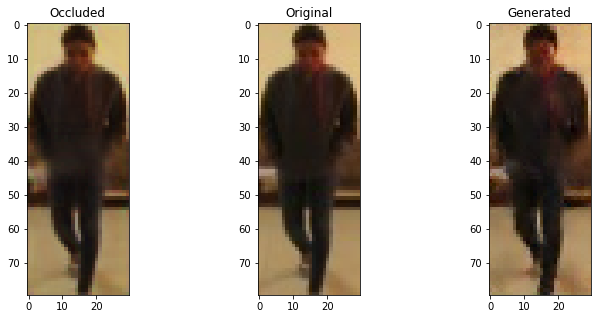

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


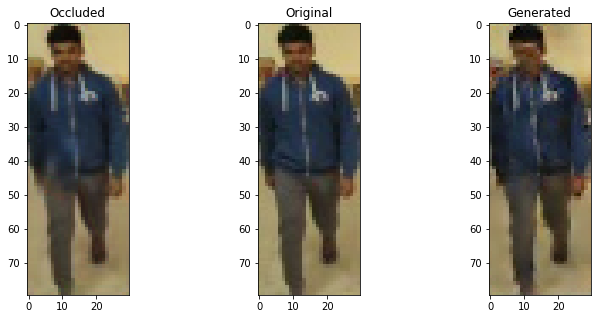

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


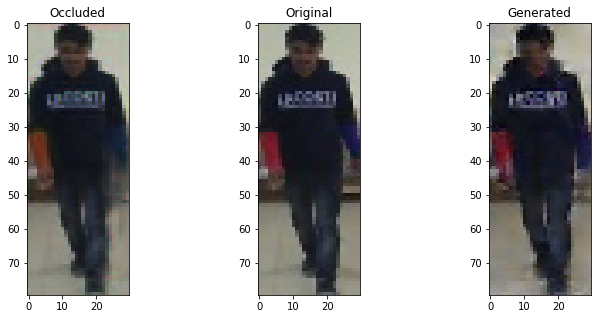

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


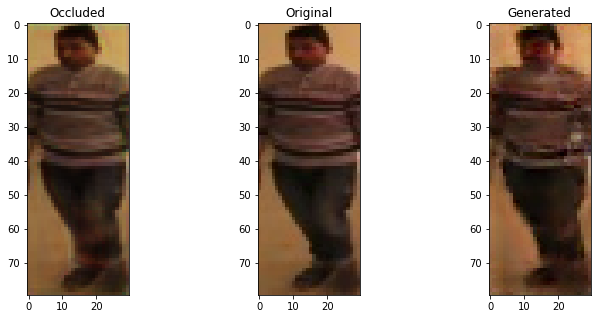

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


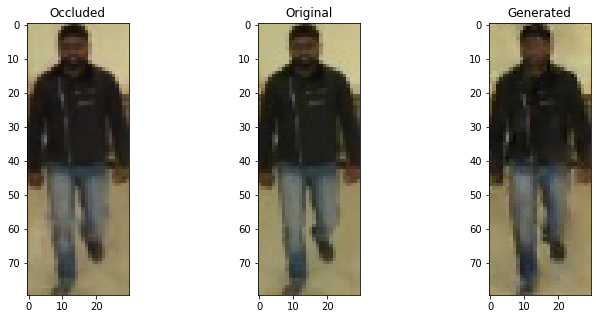

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6721054315567017 , Adversarial Loss:  0.0063250306993722916
Epoch 42


  8%|▊         | 1/13 [00:00<00:01,  7.90it/s]

Discriminator Loss:  0.6449740529060364 , Adversarial Loss:  0.006384536623954773
Epoch 43


  8%|▊         | 1/13 [00:00<00:01,  7.68it/s]

Discriminator Loss:  0.6854586601257324 , Adversarial Loss:  0.006673640571534634
Epoch 44


  8%|▊         | 1/13 [00:00<00:01,  7.94it/s]

Discriminator Loss:  0.6413730382919312 , Adversarial Loss:  0.00610002689063549
Epoch 45


  8%|▊         | 1/13 [00:00<00:01,  7.85it/s]

Discriminator Loss:  0.6461431980133057 , Adversarial Loss:  0.0062487926334142685
Epoch 46


  8%|▊         | 1/13 [00:00<00:01,  7.71it/s]

Discriminator Loss:  0.667885422706604 , Adversarial Loss:  0.006581388413906097
Epoch 47


  8%|▊         | 1/13 [00:00<00:01,  7.96it/s]

Discriminator Loss:  0.6608365178108215 , Adversarial Loss:  0.005567952524870634
Epoch 48


  8%|▊         | 1/13 [00:00<00:01,  7.82it/s]

Discriminator Loss:  0.6634247303009033 , Adversarial Loss:  0.005352732725441456
Epoch 49


  8%|▊         | 1/13 [00:00<00:02,  5.88it/s]

Discriminator Loss:  0.6830869317054749 , Adversarial Loss:  0.005504404194653034
Epoch 50


  8%|▊         | 1/13 [00:00<00:01,  7.76it/s]

Discriminator Loss:  0.6553052663803101 , Adversarial Loss:  0.0054023489356040955
Epoch 51


  8%|▊         | 1/13 [00:00<00:01,  7.27it/s]

Discriminator Loss:  0.6750786304473877 , Adversarial Loss:  0.005675792694091797
Epoch 52


  8%|▊         | 1/13 [00:00<00:01,  7.31it/s]

Discriminator Loss:  0.6582241654396057 , Adversarial Loss:  0.005453665740787983
Epoch 53


  8%|▊         | 1/13 [00:00<00:01,  7.75it/s]

Discriminator Loss:  0.6498141288757324 , Adversarial Loss:  0.00535420048981905
Epoch 54


  8%|▊         | 1/13 [00:00<00:02,  5.80it/s]

Discriminator Loss:  0.64277184009552 , Adversarial Loss:  0.005007760599255562
Epoch 55


  8%|▊         | 1/13 [00:00<00:01,  7.63it/s]

Discriminator Loss:  0.6355603933334351 , Adversarial Loss:  0.005193008109927177
Epoch 56


  8%|▊         | 1/13 [00:00<00:01,  7.63it/s]

Discriminator Loss:  0.6648829579353333 , Adversarial Loss:  0.005315088666975498
Epoch 57


  8%|▊         | 1/13 [00:00<00:01,  7.90it/s]

Discriminator Loss:  0.6674128770828247 , Adversarial Loss:  0.005698772147297859
Epoch 58


  8%|▊         | 1/13 [00:00<00:01,  7.61it/s]

Discriminator Loss:  0.6611038446426392 , Adversarial Loss:  0.005249069072306156
Epoch 59


  8%|▊         | 1/13 [00:00<00:02,  5.69it/s]

Discriminator Loss:  0.6594330072402954 , Adversarial Loss:  0.004882153123617172
Epoch 60


  8%|▊         | 1/13 [00:00<00:01,  7.55it/s]

Discriminator Loss:  0.6479812860488892 , Adversarial Loss:  0.004877999424934387
Epoch 61


100%|██████████| 13/13 [00:01<00:00,  7.45it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


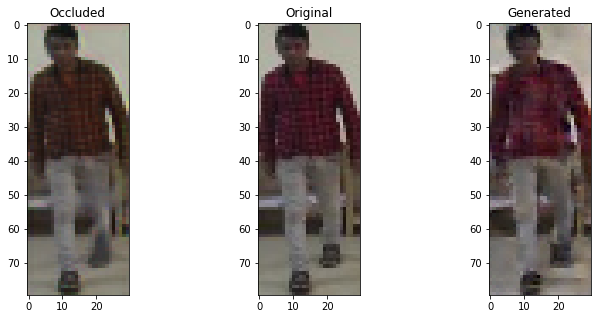

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


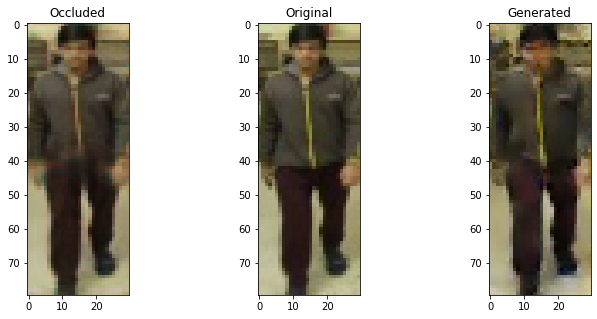

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


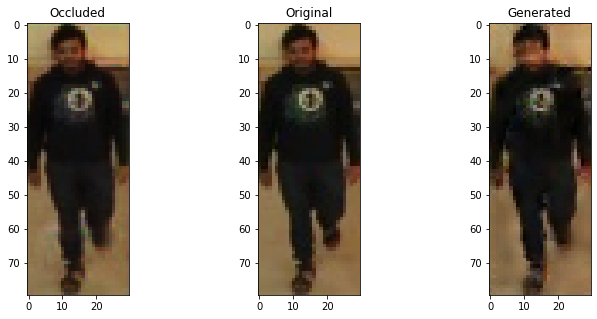

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


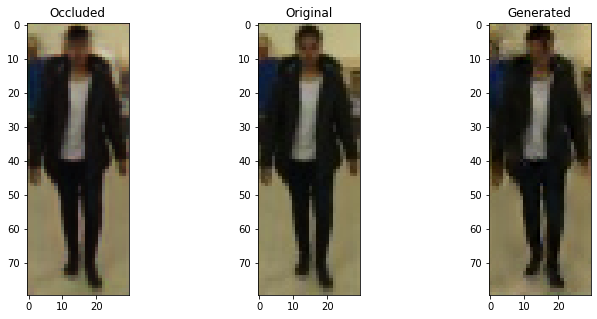

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


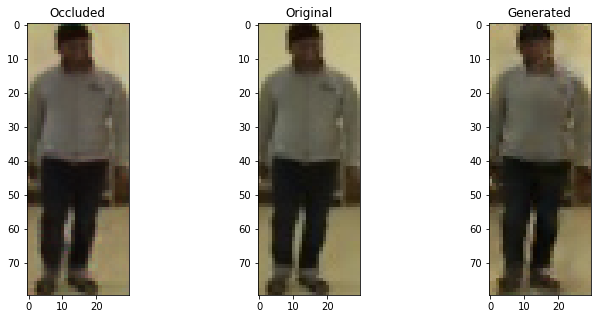

  8%|▊         | 1/13 [00:00<00:02,  5.81it/s]

Discriminator Loss:  0.6485273838043213 , Adversarial Loss:  0.004668941721320152
Epoch 62


  8%|▊         | 1/13 [00:00<00:01,  7.82it/s]

Discriminator Loss:  0.6507681012153625 , Adversarial Loss:  0.005365419201552868
Epoch 63


  8%|▊         | 1/13 [00:00<00:01,  7.59it/s]

Discriminator Loss:  0.6734346151351929 , Adversarial Loss:  0.004725247621536255
Epoch 64


  8%|▊         | 1/13 [00:00<00:01,  7.86it/s]

Discriminator Loss:  0.6612792015075684 , Adversarial Loss:  0.004501890391111374
Epoch 65


  8%|▊         | 1/13 [00:00<00:01,  7.81it/s]

Discriminator Loss:  0.6648783087730408 , Adversarial Loss:  0.004836828447878361
Epoch 66


  8%|▊         | 1/13 [00:00<00:01,  7.18it/s]

Discriminator Loss:  0.6896564364433289 , Adversarial Loss:  0.004501610994338989
Epoch 67


  8%|▊         | 1/13 [00:00<00:01,  7.27it/s]

Discriminator Loss:  0.651292085647583 , Adversarial Loss:  0.004673373885452747
Epoch 68


  8%|▊         | 1/13 [00:00<00:01,  7.51it/s]

Discriminator Loss:  0.649661660194397 , Adversarial Loss:  0.004733594600111246
Epoch 69


  8%|▊         | 1/13 [00:00<00:01,  7.91it/s]

Discriminator Loss:  0.6496750712394714 , Adversarial Loss:  0.004602828994393349
Epoch 70


  8%|▊         | 1/13 [00:00<00:01,  7.88it/s]

Discriminator Loss:  0.6560837030410767 , Adversarial Loss:  0.0048078144900500774
Epoch 71


  8%|▊         | 1/13 [00:00<00:01,  7.83it/s]

Discriminator Loss:  0.6635057926177979 , Adversarial Loss:  0.004641509614884853
Epoch 72


  8%|▊         | 1/13 [00:00<00:01,  8.30it/s]

Discriminator Loss:  0.6885895729064941 , Adversarial Loss:  0.004165229387581348
Epoch 73


  8%|▊         | 1/13 [00:00<00:01,  7.76it/s]

Discriminator Loss:  0.6727199554443359 , Adversarial Loss:  0.004963763989508152
Epoch 74


  8%|▊         | 1/13 [00:00<00:01,  7.75it/s]

Discriminator Loss:  0.6526440978050232 , Adversarial Loss:  0.004196283873170614
Epoch 75


  8%|▊         | 1/13 [00:00<00:01,  7.78it/s]

Discriminator Loss:  0.6449013948440552 , Adversarial Loss:  0.004315670114010572
Epoch 76


  8%|▊         | 1/13 [00:00<00:01,  7.93it/s]

Discriminator Loss:  0.6481710076332092 , Adversarial Loss:  0.00441303476691246
Epoch 77


  8%|▊         | 1/13 [00:00<00:01,  7.71it/s]

Discriminator Loss:  0.6672986745834351 , Adversarial Loss:  0.004352238029241562
Epoch 78


  8%|▊         | 1/13 [00:00<00:01,  6.71it/s]

Discriminator Loss:  0.6628633141517639 , Adversarial Loss:  0.003857821226119995
Epoch 79


  8%|▊         | 1/13 [00:00<00:01,  7.61it/s]

Discriminator Loss:  0.6675797700881958 , Adversarial Loss:  0.004614660982042551
Epoch 80


  8%|▊         | 1/13 [00:00<00:01,  7.38it/s]

Discriminator Loss:  0.6426845192909241 , Adversarial Loss:  0.004424524027854204
Epoch 81


100%|██████████| 13/13 [00:01<00:00,  7.37it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


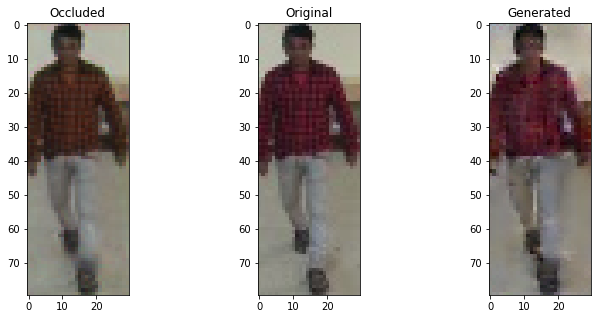

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


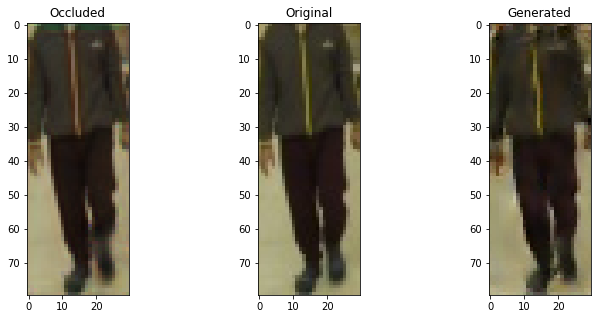

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


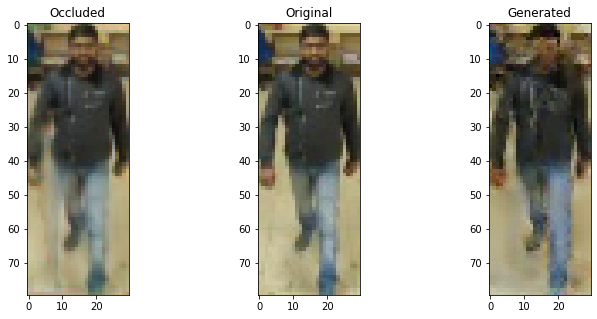

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


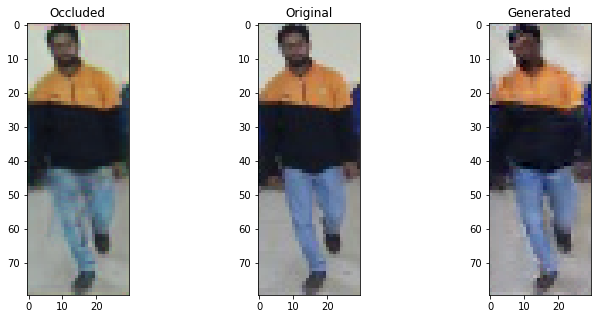

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


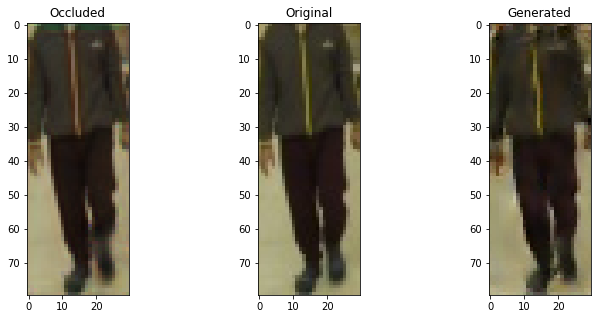

  8%|▊         | 1/13 [00:00<00:02,  5.97it/s]

Discriminator Loss:  0.6617531180381775 , Adversarial Loss:  0.004195625428110361
Epoch 82


  8%|▊         | 1/13 [00:00<00:02,  5.82it/s]

Discriminator Loss:  0.6726891994476318 , Adversarial Loss:  0.00387279293499887
Epoch 83


  8%|▊         | 1/13 [00:00<00:01,  7.27it/s]

Discriminator Loss:  0.6397473216056824 , Adversarial Loss:  0.004290700890123844
Epoch 84


  8%|▊         | 1/13 [00:00<00:01,  7.90it/s]

Discriminator Loss:  0.6323036551475525 , Adversarial Loss:  0.003988365642726421
Epoch 85


  8%|▊         | 1/13 [00:00<00:01,  7.65it/s]

Discriminator Loss:  0.6728901863098145 , Adversarial Loss:  0.0041847797110676765
Epoch 86


  8%|▊         | 1/13 [00:00<00:01,  7.71it/s]

Discriminator Loss:  0.6747991442680359 , Adversarial Loss:  0.003826298750936985
Epoch 87


  8%|▊         | 1/13 [00:00<00:01,  7.56it/s]

Discriminator Loss:  0.6724802851676941 , Adversarial Loss:  0.004081566818058491
Epoch 88


  8%|▊         | 1/13 [00:00<00:01,  7.44it/s]

Discriminator Loss:  0.6317059993743896 , Adversarial Loss:  0.0037510409019887447
Epoch 89


  8%|▊         | 1/13 [00:00<00:01,  7.70it/s]

Discriminator Loss:  0.6931104063987732 , Adversarial Loss:  0.003933854401111603
Epoch 90


  8%|▊         | 1/13 [00:00<00:01,  7.38it/s]

Discriminator Loss:  0.6542183756828308 , Adversarial Loss:  0.003724088193848729
Epoch 91


  8%|▊         | 1/13 [00:00<00:01,  7.24it/s]

Discriminator Loss:  0.652664840221405 , Adversarial Loss:  0.003919885028153658
Epoch 92


  8%|▊         | 1/13 [00:00<00:01,  6.01it/s]

Discriminator Loss:  0.6417629718780518 , Adversarial Loss:  0.004354570060968399
Epoch 93


  8%|▊         | 1/13 [00:00<00:01,  7.50it/s]

Discriminator Loss:  0.6348879933357239 , Adversarial Loss:  0.0036539919674396515
Epoch 94


  8%|▊         | 1/13 [00:00<00:01,  7.39it/s]

Discriminator Loss:  0.667844831943512 , Adversarial Loss:  0.0037764194421470165
Epoch 95


  8%|▊         | 1/13 [00:00<00:01,  6.73it/s]

Discriminator Loss:  0.6532896161079407 , Adversarial Loss:  0.003725987859070301
Epoch 96


  8%|▊         | 1/13 [00:00<00:01,  7.42it/s]

Discriminator Loss:  0.6446861028671265 , Adversarial Loss:  0.003829487832263112
Epoch 97


  8%|▊         | 1/13 [00:00<00:01,  7.87it/s]

Discriminator Loss:  0.6393687129020691 , Adversarial Loss:  0.003931702114641666
Epoch 98


  8%|▊         | 1/13 [00:00<00:01,  7.15it/s]

Discriminator Loss:  0.6752774119377136 , Adversarial Loss:  0.00400187773630023
Epoch 99


  8%|▊         | 1/13 [00:00<00:01,  7.65it/s]

Discriminator Loss:  0.6713904142379761 , Adversarial Loss:  0.0034925248473882675
Epoch 100


  8%|▊         | 1/13 [00:00<00:01,  6.80it/s]

Discriminator Loss:  0.639920711517334 , Adversarial Loss:  0.0038780192844569683
Epoch 101


100%|██████████| 13/13 [00:02<00:00,  6.49it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


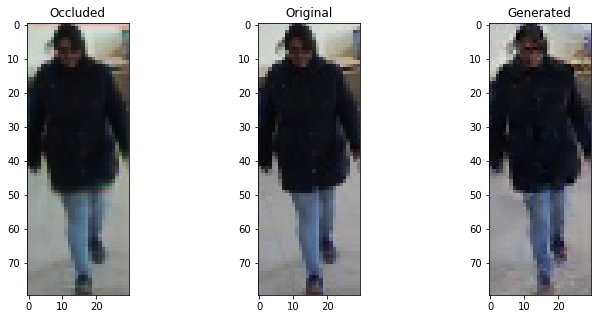

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


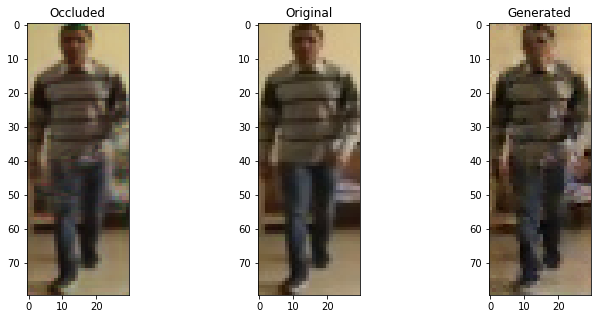

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


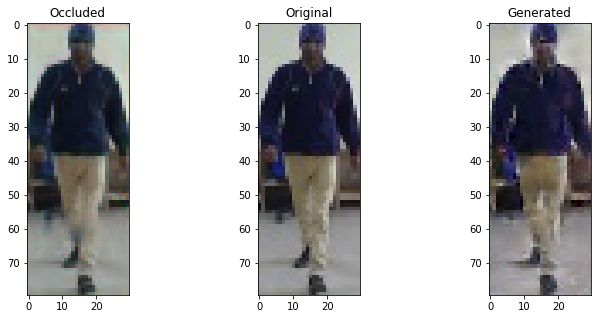

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


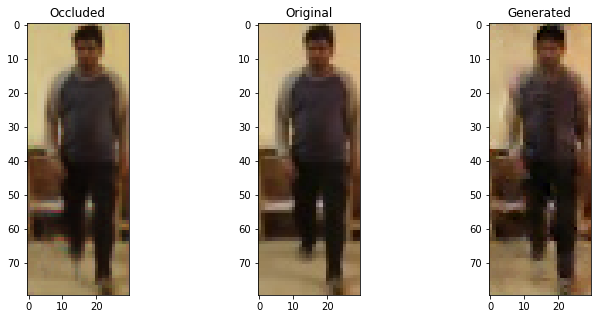

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


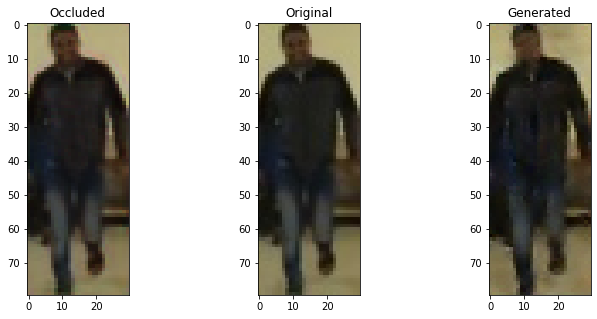

  8%|▊         | 1/13 [00:00<00:02,  5.53it/s]

Discriminator Loss:  0.6608229875564575 , Adversarial Loss:  0.004034914076328278
Epoch 102


  8%|▊         | 1/13 [00:00<00:01,  7.62it/s]

Discriminator Loss:  0.6675537824630737 , Adversarial Loss:  0.003434843383729458
Epoch 103


  8%|▊         | 1/13 [00:00<00:01,  7.38it/s]

Discriminator Loss:  0.6759256720542908 , Adversarial Loss:  0.0037310835905373096
Epoch 104


  8%|▊         | 1/13 [00:00<00:01,  7.44it/s]

Discriminator Loss:  0.6537300944328308 , Adversarial Loss:  0.003791187424212694
Epoch 105


  8%|▊         | 1/13 [00:00<00:01,  7.18it/s]

Discriminator Loss:  0.6529861688613892 , Adversarial Loss:  0.003645428456366062
Epoch 106


  8%|▊         | 1/13 [00:00<00:01,  7.23it/s]

Discriminator Loss:  0.6770446300506592 , Adversarial Loss:  0.003262265119701624
Epoch 107


  8%|▊         | 1/13 [00:00<00:01,  7.39it/s]

Discriminator Loss:  0.6483564376831055 , Adversarial Loss:  0.0033412673510611057
Epoch 108


  8%|▊         | 1/13 [00:00<00:01,  6.72it/s]

Discriminator Loss:  0.6490070223808289 , Adversarial Loss:  0.003670911304652691
Epoch 109


  8%|▊         | 1/13 [00:00<00:01,  7.40it/s]

Discriminator Loss:  0.6593643426895142 , Adversarial Loss:  0.0034478125162422657
Epoch 110


  8%|▊         | 1/13 [00:00<00:01,  7.27it/s]

Discriminator Loss:  0.6341950297355652 , Adversarial Loss:  0.0035877800546586514
Epoch 111


  8%|▊         | 1/13 [00:00<00:01,  6.60it/s]

Discriminator Loss:  0.6653037667274475 , Adversarial Loss:  0.0034603180829435587
Epoch 112


  8%|▊         | 1/13 [00:00<00:01,  7.15it/s]

Discriminator Loss:  0.6713059544563293 , Adversarial Loss:  0.0033748112618923187
Epoch 113


  8%|▊         | 1/13 [00:00<00:01,  7.33it/s]

Discriminator Loss:  0.6597002744674683 , Adversarial Loss:  0.0033850562758743763
Epoch 114


  8%|▊         | 1/13 [00:00<00:01,  6.77it/s]

Discriminator Loss:  0.6546291708946228 , Adversarial Loss:  0.003685965668410063
Epoch 115


  8%|▊         | 1/13 [00:00<00:01,  7.56it/s]

Discriminator Loss:  0.6701564788818359 , Adversarial Loss:  0.00372178852558136
Epoch 116


  8%|▊         | 1/13 [00:00<00:02,  5.81it/s]

Discriminator Loss:  0.6484478712081909 , Adversarial Loss:  0.0034842723980545998
Epoch 117


  8%|▊         | 1/13 [00:00<00:01,  7.28it/s]

Discriminator Loss:  0.6493316292762756 , Adversarial Loss:  0.003631033468991518
Epoch 118


  8%|▊         | 1/13 [00:00<00:01,  6.97it/s]

Discriminator Loss:  0.6529411673545837 , Adversarial Loss:  0.0031725901644676924
Epoch 119


  8%|▊         | 1/13 [00:00<00:01,  7.39it/s]

Discriminator Loss:  0.6704103946685791 , Adversarial Loss:  0.0031054140999913216
Epoch 120


  8%|▊         | 1/13 [00:00<00:01,  7.66it/s]

Discriminator Loss:  0.6788312196731567 , Adversarial Loss:  0.0036103909369558096
Epoch 121


100%|██████████| 13/13 [00:01<00:00,  7.40it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


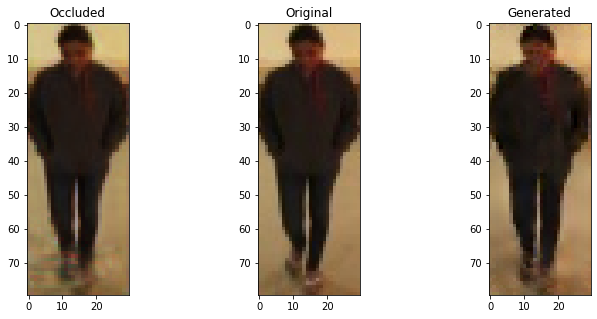

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


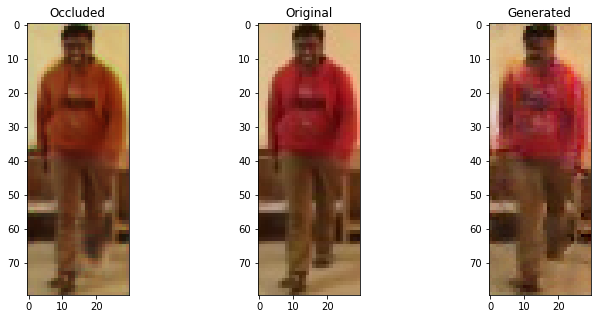

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


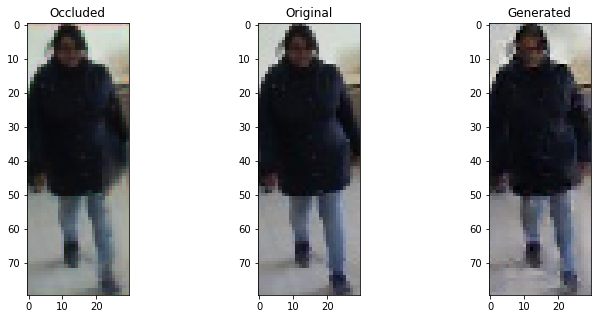

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


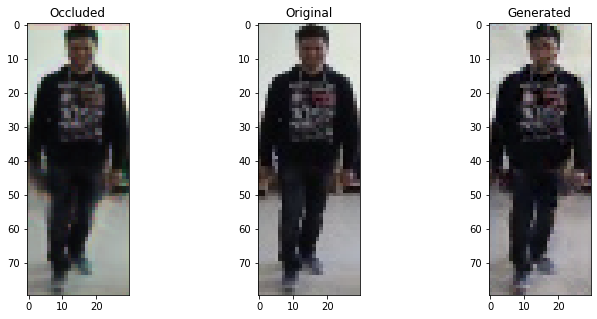

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


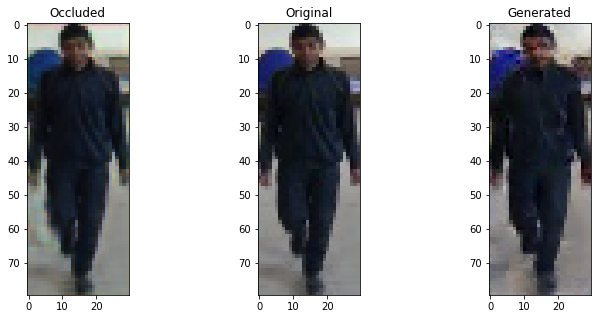

  8%|▊         | 1/13 [00:00<00:02,  5.74it/s]

Discriminator Loss:  0.6509125828742981 , Adversarial Loss:  0.003248566063120961
Epoch 122


  8%|▊         | 1/13 [00:00<00:01,  7.74it/s]

Discriminator Loss:  0.6463229656219482 , Adversarial Loss:  0.0036302388180047274
Epoch 123


  8%|▊         | 1/13 [00:00<00:01,  6.88it/s]

Discriminator Loss:  0.653057336807251 , Adversarial Loss:  0.0031923032365739346
Epoch 124


  8%|▊         | 1/13 [00:00<00:01,  6.96it/s]

Discriminator Loss:  0.6601771116256714 , Adversarial Loss:  0.0029339040629565716
Epoch 125


  8%|▊         | 1/13 [00:00<00:01,  7.53it/s]

Discriminator Loss:  0.6602945327758789 , Adversarial Loss:  0.003317001275718212
Epoch 126


  8%|▊         | 1/13 [00:00<00:01,  7.30it/s]

Discriminator Loss:  0.6576507091522217 , Adversarial Loss:  0.0037024233024567366
Epoch 127


  8%|▊         | 1/13 [00:00<00:01,  7.25it/s]

Discriminator Loss:  0.6239286661148071 , Adversarial Loss:  0.0030912840738892555
Epoch 128


  8%|▊         | 1/13 [00:00<00:01,  6.84it/s]

Discriminator Loss:  0.6681775450706482 , Adversarial Loss:  0.0034845941700041294
Epoch 129


  8%|▊         | 1/13 [00:00<00:01,  6.83it/s]

Discriminator Loss:  0.6774412393569946 , Adversarial Loss:  0.0036429844330996275
Epoch 130


  8%|▊         | 1/13 [00:00<00:01,  7.57it/s]

Discriminator Loss:  0.6467143297195435 , Adversarial Loss:  0.003242878243327141
Epoch 131


  8%|▊         | 1/13 [00:00<00:01,  6.86it/s]

Discriminator Loss:  0.6432117819786072 , Adversarial Loss:  0.0036972169764339924
Epoch 132


  8%|▊         | 1/13 [00:00<00:02,  5.73it/s]

Discriminator Loss:  0.6529383659362793 , Adversarial Loss:  0.0030861154664307833
Epoch 133


  8%|▊         | 1/13 [00:00<00:01,  6.95it/s]

Discriminator Loss:  0.6799522638320923 , Adversarial Loss:  0.0031836689449846745
Epoch 134


  8%|▊         | 1/13 [00:00<00:01,  7.12it/s]

Discriminator Loss:  0.6714648008346558 , Adversarial Loss:  0.0032119429670274258
Epoch 135


  8%|▊         | 1/13 [00:00<00:02,  5.34it/s]

Discriminator Loss:  0.6563760042190552 , Adversarial Loss:  0.0038305730558931828
Epoch 136


  8%|▊         | 1/13 [00:00<00:01,  7.60it/s]

Discriminator Loss:  0.6508408188819885 , Adversarial Loss:  0.0032868534326553345
Epoch 137


  8%|▊         | 1/13 [00:00<00:01,  7.75it/s]

Discriminator Loss:  0.6705366373062134 , Adversarial Loss:  0.003063700394704938
Epoch 138


  8%|▊         | 1/13 [00:00<00:01,  7.22it/s]

Discriminator Loss:  0.6461808085441589 , Adversarial Loss:  0.0033020745031535625
Epoch 139


  8%|▊         | 1/13 [00:00<00:02,  5.90it/s]

Discriminator Loss:  0.655644416809082 , Adversarial Loss:  0.0032245046459138393
Epoch 140


  8%|▊         | 1/13 [00:00<00:02,  5.85it/s]

Discriminator Loss:  0.6569437980651855 , Adversarial Loss:  0.0029699006117880344
Epoch 141


100%|██████████| 13/13 [00:01<00:00,  6.90it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


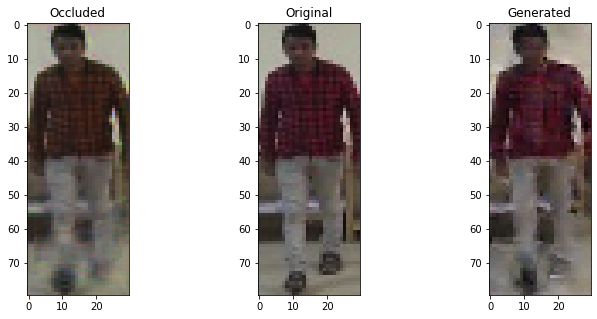

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


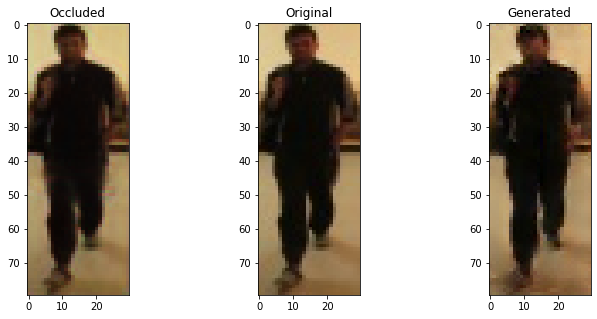

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


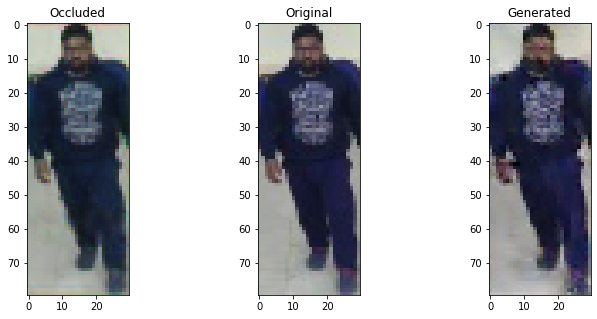

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


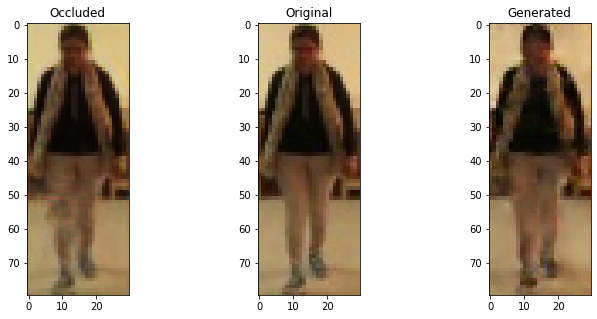

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


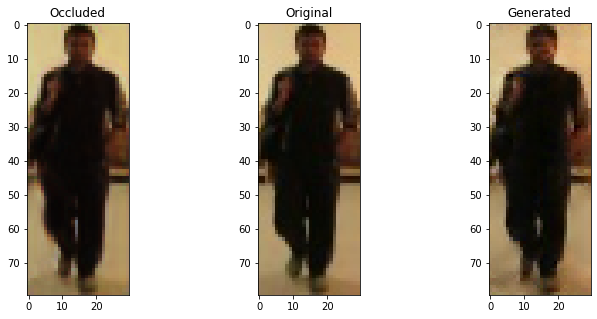

  8%|▊         | 1/13 [00:00<00:02,  5.72it/s]

Discriminator Loss:  0.680702805519104 , Adversarial Loss:  0.00312299863435328
Epoch 142


  8%|▊         | 1/13 [00:00<00:01,  7.39it/s]

Discriminator Loss:  0.6531274318695068 , Adversarial Loss:  0.003218783065676689
Epoch 143


  8%|▊         | 1/13 [00:00<00:01,  7.02it/s]

Discriminator Loss:  0.647209107875824 , Adversarial Loss:  0.003229532390832901
Epoch 144


  8%|▊         | 1/13 [00:00<00:01,  6.47it/s]

Discriminator Loss:  0.6483726501464844 , Adversarial Loss:  0.0033372489269822836
Epoch 145


  8%|▊         | 1/13 [00:00<00:01,  7.05it/s]

Discriminator Loss:  0.6657568216323853 , Adversarial Loss:  0.002909995149821043
Epoch 146


  8%|▊         | 1/13 [00:00<00:01,  6.90it/s]

Discriminator Loss:  0.6520517468452454 , Adversarial Loss:  0.002982819452881813
Epoch 147


  8%|▊         | 1/13 [00:00<00:01,  7.38it/s]

Discriminator Loss:  0.6556538939476013 , Adversarial Loss:  0.0027384934946894646
Epoch 148


  8%|▊         | 1/13 [00:00<00:01,  6.41it/s]

Discriminator Loss:  0.6614208817481995 , Adversarial Loss:  0.003264698199927807
Epoch 149


  8%|▊         | 1/13 [00:00<00:01,  6.95it/s]

Discriminator Loss:  0.6522508859634399 , Adversarial Loss:  0.003969138488173485
Epoch 150


  8%|▊         | 1/13 [00:00<00:01,  7.51it/s]

Discriminator Loss:  0.661653459072113 , Adversarial Loss:  0.0031019928865134716
Epoch 151


  8%|▊         | 1/13 [00:00<00:01,  7.22it/s]

Discriminator Loss:  0.666913628578186 , Adversarial Loss:  0.003019124735146761
Epoch 152


  8%|▊         | 1/13 [00:00<00:02,  5.72it/s]

Discriminator Loss:  0.6259024143218994 , Adversarial Loss:  0.0028488871175795794
Epoch 153


  8%|▊         | 1/13 [00:00<00:01,  7.01it/s]

Discriminator Loss:  0.6547813415527344 , Adversarial Loss:  0.002868658397346735
Epoch 154


  8%|▊         | 1/13 [00:00<00:01,  7.37it/s]

Discriminator Loss:  0.6822881698608398 , Adversarial Loss:  0.00264290114864707
Epoch 155


  8%|▊         | 1/13 [00:00<00:01,  7.63it/s]

Discriminator Loss:  0.6532223224639893 , Adversarial Loss:  0.002579336054623127
Epoch 156


  8%|▊         | 1/13 [00:00<00:01,  6.97it/s]

Discriminator Loss:  0.6574491858482361 , Adversarial Loss:  0.002523860428482294
Epoch 157


  8%|▊         | 1/13 [00:00<00:01,  7.10it/s]

Discriminator Loss:  0.6690192818641663 , Adversarial Loss:  0.0025264867581427097
Epoch 158


  8%|▊         | 1/13 [00:00<00:01,  7.18it/s]

Discriminator Loss:  0.6484843492507935 , Adversarial Loss:  0.003126170951873064
Epoch 159


  8%|▊         | 1/13 [00:00<00:01,  7.32it/s]

Discriminator Loss:  0.6856342554092407 , Adversarial Loss:  0.0025103259831666946
Epoch 160


  8%|▊         | 1/13 [00:00<00:02,  5.74it/s]

Discriminator Loss:  0.6535401344299316 , Adversarial Loss:  0.002592002972960472
Epoch 161


100%|██████████| 13/13 [00:01<00:00,  7.25it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


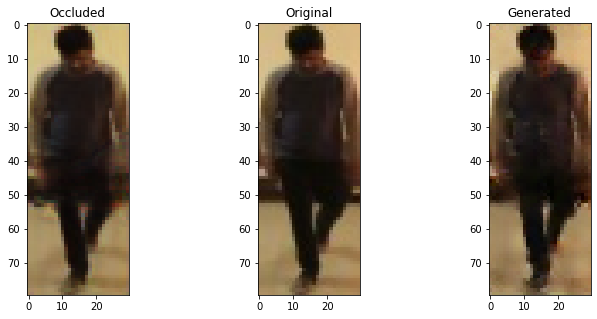

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


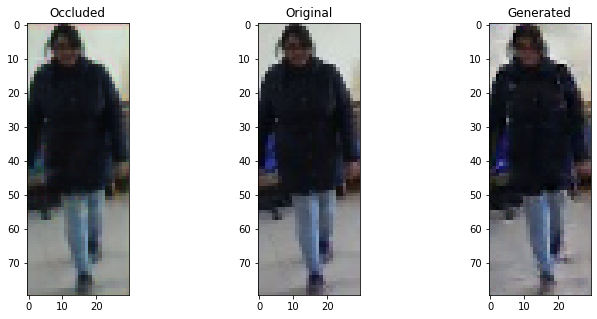

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


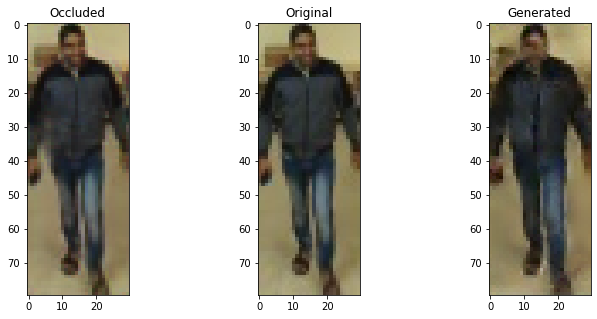

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


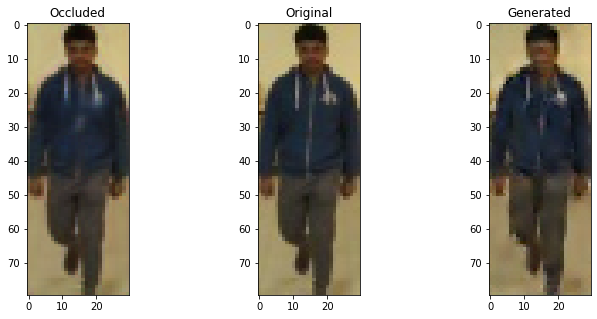

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


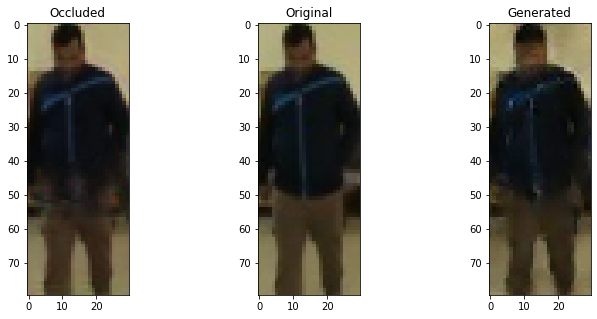

  8%|▊         | 1/13 [00:00<00:02,  6.00it/s]

Discriminator Loss:  0.6555706262588501 , Adversarial Loss:  0.002309859264642
Epoch 162


  8%|▊         | 1/13 [00:00<00:01,  6.83it/s]

Discriminator Loss:  0.6396262645721436 , Adversarial Loss:  0.0025813477113842964
Epoch 163


  8%|▊         | 1/13 [00:00<00:01,  7.51it/s]

Discriminator Loss:  0.6566405892372131 , Adversarial Loss:  0.00237641460262239
Epoch 164


  8%|▊         | 1/13 [00:00<00:02,  5.76it/s]

Discriminator Loss:  0.6599063873291016 , Adversarial Loss:  0.002500793430954218
Epoch 165


  8%|▊         | 1/13 [00:00<00:01,  6.44it/s]

Discriminator Loss:  0.6679770946502686 , Adversarial Loss:  0.0024387433659285307
Epoch 166


  8%|▊         | 1/13 [00:00<00:01,  7.27it/s]

Discriminator Loss:  0.6406896710395813 , Adversarial Loss:  0.0024481588043272495
Epoch 167


  8%|▊         | 1/13 [00:00<00:01,  7.22it/s]

Discriminator Loss:  0.6777387857437134 , Adversarial Loss:  0.0024115496780723333
Epoch 168


  8%|▊         | 1/13 [00:00<00:01,  6.83it/s]

Discriminator Loss:  0.6540390253067017 , Adversarial Loss:  0.002459120936691761
Epoch 169


  8%|▊         | 1/13 [00:00<00:02,  5.61it/s]

Discriminator Loss:  0.6610498428344727 , Adversarial Loss:  0.0022492867428809404
Epoch 170


  8%|▊         | 1/13 [00:00<00:01,  6.74it/s]

Discriminator Loss:  0.6485574245452881 , Adversarial Loss:  0.0022915643639862537
Epoch 171


  8%|▊         | 1/13 [00:00<00:01,  6.36it/s]

Discriminator Loss:  0.6469465494155884 , Adversarial Loss:  0.0023537627421319485
Epoch 172


  8%|▊         | 1/13 [00:00<00:02,  5.56it/s]

Discriminator Loss:  0.6586000919342041 , Adversarial Loss:  0.002335046883672476
Epoch 173


  8%|▊         | 1/13 [00:00<00:02,  5.62it/s]

Discriminator Loss:  0.6670500636100769 , Adversarial Loss:  0.002228124998509884
Epoch 174


  8%|▊         | 1/13 [00:00<00:01,  6.89it/s]

Discriminator Loss:  0.6568619608879089 , Adversarial Loss:  0.0024959228467196226
Epoch 175


  8%|▊         | 1/13 [00:00<00:01,  7.13it/s]

Discriminator Loss:  0.6523278951644897 , Adversarial Loss:  0.002045078668743372
Epoch 176


  8%|▊         | 1/13 [00:00<00:01,  7.13it/s]

Discriminator Loss:  0.6427209377288818 , Adversarial Loss:  0.00245464826002717
Epoch 177


  8%|▊         | 1/13 [00:00<00:01,  7.22it/s]

Discriminator Loss:  0.6631729602813721 , Adversarial Loss:  0.00256277434527874
Epoch 178


  8%|▊         | 1/13 [00:00<00:02,  5.43it/s]

Discriminator Loss:  0.6731675863265991 , Adversarial Loss:  0.0022533959709107876
Epoch 179


  8%|▊         | 1/13 [00:00<00:01,  6.69it/s]

Discriminator Loss:  0.6246762275695801 , Adversarial Loss:  0.0020907672587782145
Epoch 180


  8%|▊         | 1/13 [00:00<00:01,  6.84it/s]

Discriminator Loss:  0.6530176997184753 , Adversarial Loss:  0.002280346117913723
Epoch 181


100%|██████████| 13/13 [00:01<00:00,  7.20it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


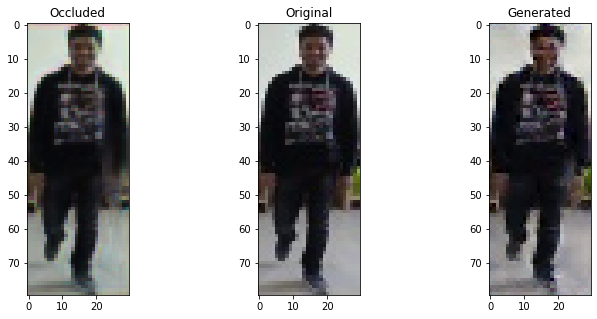

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


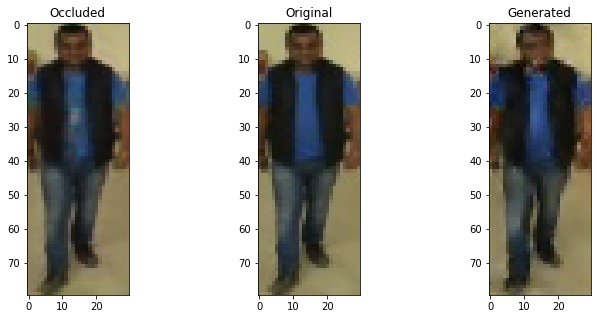

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


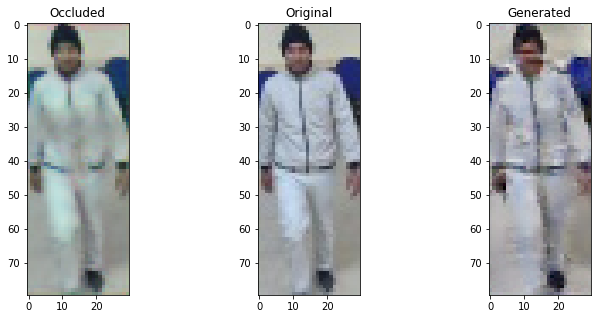

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


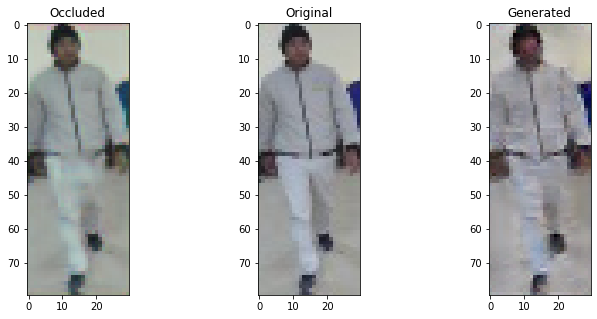

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


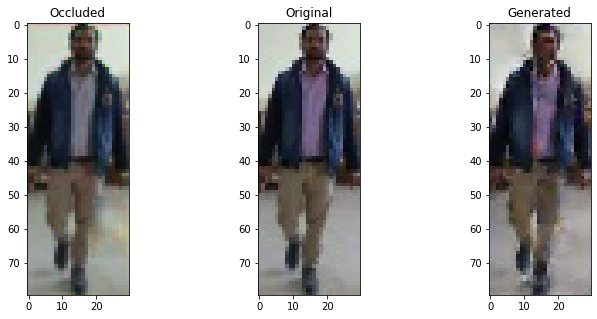

  8%|▊         | 1/13 [00:00<00:02,  5.85it/s]

Discriminator Loss:  0.639838695526123 , Adversarial Loss:  0.002228786936029792
Epoch 182


  8%|▊         | 1/13 [00:00<00:02,  5.75it/s]

Discriminator Loss:  0.6674085259437561 , Adversarial Loss:  0.0022566835395991802
Epoch 183


  8%|▊         | 1/13 [00:00<00:01,  7.00it/s]

Discriminator Loss:  0.6555539965629578 , Adversarial Loss:  0.0023248123470693827
Epoch 184


  8%|▊         | 1/13 [00:00<00:01,  6.67it/s]

Discriminator Loss:  0.6675622463226318 , Adversarial Loss:  0.002413626527413726
Epoch 185


  8%|▊         | 1/13 [00:00<00:01,  6.39it/s]

Discriminator Loss:  0.6465086936950684 , Adversarial Loss:  0.0021492228843271732
Epoch 186


  8%|▊         | 1/13 [00:00<00:02,  5.58it/s]

Discriminator Loss:  0.6458386778831482 , Adversarial Loss:  0.0023817315232008696
Epoch 187


  8%|▊         | 1/13 [00:00<00:01,  6.85it/s]

Discriminator Loss:  0.6530275940895081 , Adversarial Loss:  0.002427626634016633
Epoch 188


  8%|▊         | 1/13 [00:00<00:01,  6.85it/s]

Discriminator Loss:  0.6341112852096558 , Adversarial Loss:  0.002325277542695403
Epoch 189


  8%|▊         | 1/13 [00:00<00:01,  6.98it/s]

Discriminator Loss:  0.6811654567718506 , Adversarial Loss:  0.0022498411126434803
Epoch 190


  8%|▊         | 1/13 [00:00<00:01,  6.45it/s]

Discriminator Loss:  0.6495851278305054 , Adversarial Loss:  0.0022757789120078087
Epoch 191


  8%|▊         | 1/13 [00:00<00:01,  6.73it/s]

Discriminator Loss:  0.6730871200561523 , Adversarial Loss:  0.0021766400896012783
Epoch 192


  8%|▊         | 1/13 [00:00<00:01,  7.02it/s]

Discriminator Loss:  0.6660128831863403 , Adversarial Loss:  0.0020393989980220795
Epoch 193


  8%|▊         | 1/13 [00:00<00:01,  6.82it/s]

Discriminator Loss:  0.656708836555481 , Adversarial Loss:  0.0022598428186029196
Epoch 194


  8%|▊         | 1/13 [00:00<00:01,  7.21it/s]

Discriminator Loss:  0.6536251306533813 , Adversarial Loss:  0.0022892802953720093
Epoch 195


  8%|▊         | 1/13 [00:00<00:01,  7.39it/s]

Discriminator Loss:  0.6622776985168457 , Adversarial Loss:  0.002325819106772542
Epoch 196


  8%|▊         | 1/13 [00:00<00:01,  6.30it/s]

Discriminator Loss:  0.6505045890808105 , Adversarial Loss:  0.0019109667045995593
Epoch 197


  8%|▊         | 1/13 [00:00<00:01,  7.17it/s]

Discriminator Loss:  0.6610130667686462 , Adversarial Loss:  0.0021577125880867243
Epoch 198


  8%|▊         | 1/13 [00:00<00:01,  7.02it/s]

Discriminator Loss:  0.6440704464912415 , Adversarial Loss:  0.002221363829448819
Epoch 199


  8%|▊         | 1/13 [00:00<00:02,  5.79it/s]

Discriminator Loss:  0.6763312220573425 , Adversarial Loss:  0.00197456032037735
Epoch 200


  8%|▊         | 1/13 [00:00<00:01,  7.10it/s]

Discriminator Loss:  0.6499706506729126 , Adversarial Loss:  0.0022887217346578836
Epoch 201


100%|██████████| 13/13 [00:01<00:00,  7.16it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


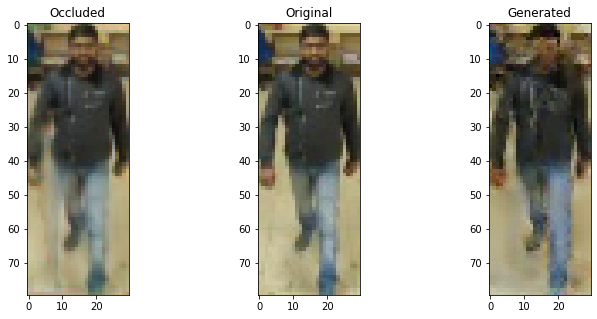

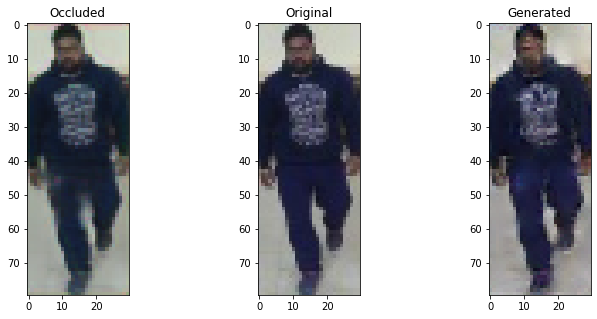

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


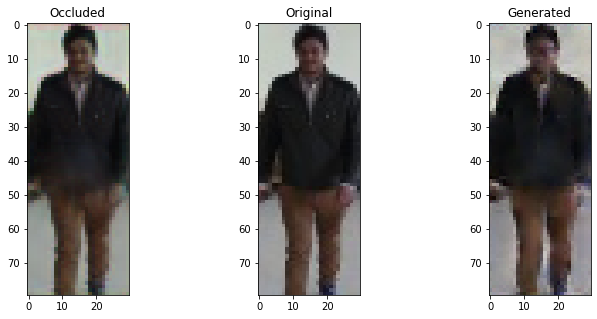

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


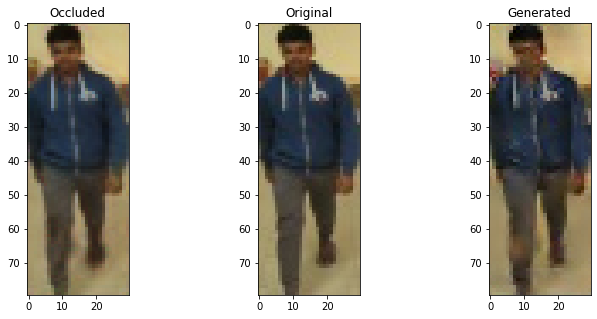

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


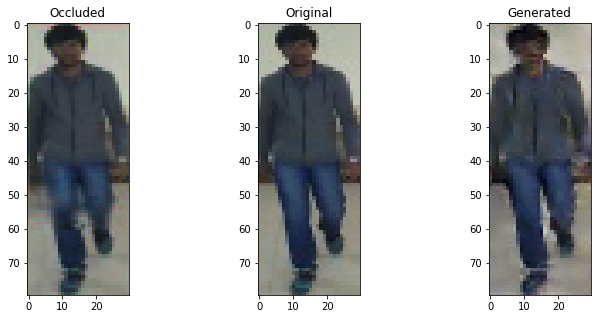

  8%|▊         | 1/13 [00:00<00:02,  5.90it/s]

Discriminator Loss:  0.6506984233856201 , Adversarial Loss:  0.0022283154539763927
Epoch 202


  8%|▊         | 1/13 [00:00<00:01,  6.48it/s]

Discriminator Loss:  0.6588668823242188 , Adversarial Loss:  0.0020292792469263077
Epoch 203


  8%|▊         | 1/13 [00:00<00:01,  6.75it/s]

Discriminator Loss:  0.6505298614501953 , Adversarial Loss:  0.0021148151718080044
Epoch 204


  8%|▊         | 1/13 [00:00<00:01,  6.63it/s]

Discriminator Loss:  0.6669617891311646 , Adversarial Loss:  0.002194995293393731
Epoch 205


  8%|▊         | 1/13 [00:00<00:01,  7.09it/s]

Discriminator Loss:  0.6383903622627258 , Adversarial Loss:  0.0019454492721706629
Epoch 206


  8%|▊         | 1/13 [00:00<00:01,  6.88it/s]

Discriminator Loss:  0.6514577865600586 , Adversarial Loss:  0.002039137529209256
Epoch 207


  8%|▊         | 1/13 [00:00<00:02,  5.66it/s]

Discriminator Loss:  0.6578315496444702 , Adversarial Loss:  0.002363708568736911
Epoch 208


  8%|▊         | 1/13 [00:00<00:01,  6.66it/s]

Discriminator Loss:  0.6396484375 , Adversarial Loss:  0.002015394624322653
Epoch 209


  8%|▊         | 1/13 [00:00<00:01,  6.89it/s]

Discriminator Loss:  0.6616002321243286 , Adversarial Loss:  0.0018834859365597367
Epoch 210


  8%|▊         | 1/13 [00:00<00:01,  6.60it/s]

Discriminator Loss:  0.6614060401916504 , Adversarial Loss:  0.002283301902934909
Epoch 211


  8%|▊         | 1/13 [00:00<00:01,  7.10it/s]

Discriminator Loss:  0.6465819478034973 , Adversarial Loss:  0.002127310261130333
Epoch 212


  8%|▊         | 1/13 [00:00<00:01,  6.80it/s]

Discriminator Loss:  0.6584966778755188 , Adversarial Loss:  0.0022262276615947485
Epoch 213


  8%|▊         | 1/13 [00:00<00:02,  5.61it/s]

Discriminator Loss:  0.6976732015609741 , Adversarial Loss:  0.0021437390241771936
Epoch 214


  8%|▊         | 1/13 [00:00<00:01,  6.70it/s]

Discriminator Loss:  0.6620161533355713 , Adversarial Loss:  0.0022032829001545906
Epoch 215


  8%|▊         | 1/13 [00:00<00:01,  6.81it/s]

Discriminator Loss:  0.6568375825881958 , Adversarial Loss:  0.0021318658255040646
Epoch 216


  8%|▊         | 1/13 [00:00<00:01,  7.53it/s]

Discriminator Loss:  0.6685829162597656 , Adversarial Loss:  0.0019707439932972193
Epoch 217


  8%|▊         | 1/13 [00:00<00:01,  6.87it/s]

Discriminator Loss:  0.6460410952568054 , Adversarial Loss:  0.0020118870306760073
Epoch 218


  8%|▊         | 1/13 [00:00<00:02,  5.49it/s]

Discriminator Loss:  0.6248242259025574 , Adversarial Loss:  0.0023367227986454964
Epoch 219


  8%|▊         | 1/13 [00:00<00:01,  6.51it/s]

Discriminator Loss:  0.6420989632606506 , Adversarial Loss:  0.0019279475091025233
Epoch 220


  8%|▊         | 1/13 [00:00<00:01,  6.90it/s]

Discriminator Loss:  0.6686904430389404 , Adversarial Loss:  0.001928968820720911
Epoch 221


100%|██████████| 13/13 [00:01<00:00,  7.09it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


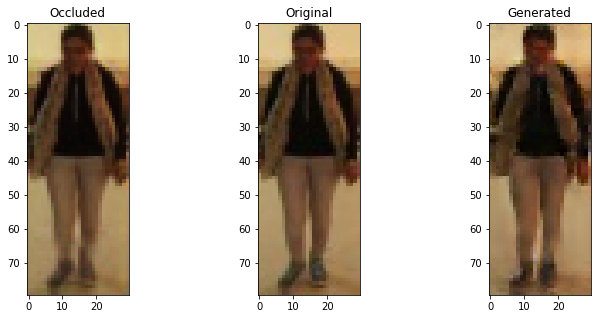

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


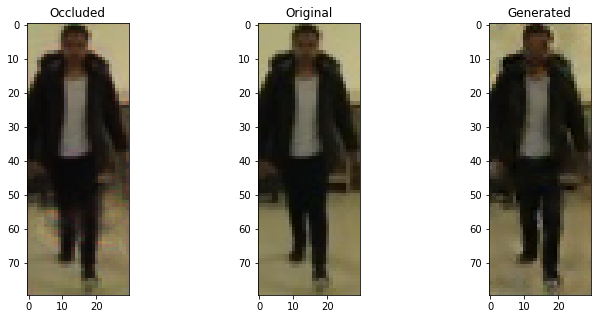

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


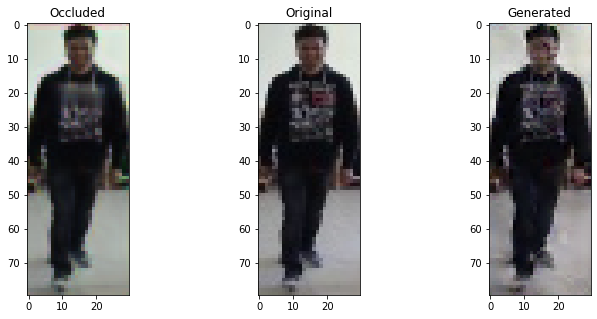

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


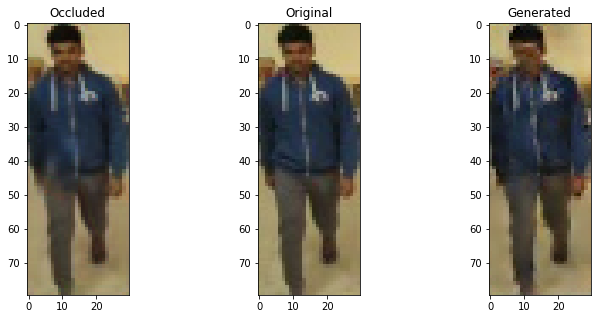

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


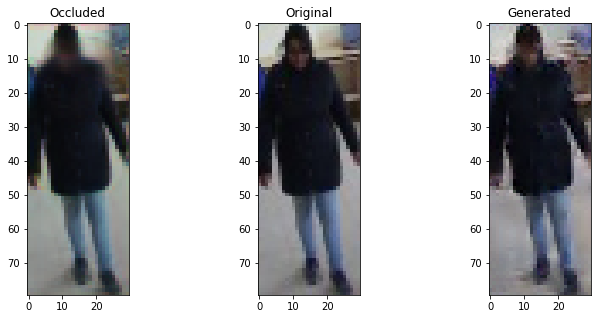

  8%|▊         | 1/13 [00:00<00:02,  5.86it/s]

Discriminator Loss:  0.66068434715271 , Adversarial Loss:  0.00207236735150218
Epoch 222


  8%|▊         | 1/13 [00:00<00:01,  6.63it/s]

Discriminator Loss:  0.6762512922286987 , Adversarial Loss:  0.002114620292559266
Epoch 223


  8%|▊         | 1/13 [00:00<00:01,  6.70it/s]

Discriminator Loss:  0.666747510433197 , Adversarial Loss:  0.0022632686886936426
Epoch 224


  8%|▊         | 1/13 [00:00<00:01,  6.49it/s]

Discriminator Loss:  0.678290605545044 , Adversarial Loss:  0.00209273979999125
Epoch 225


  8%|▊         | 1/13 [00:00<00:01,  6.34it/s]

Discriminator Loss:  0.6631733179092407 , Adversarial Loss:  0.0021624371875077486
Epoch 226


  8%|▊         | 1/13 [00:00<00:01,  6.79it/s]

Discriminator Loss:  0.6605800986289978 , Adversarial Loss:  0.002245641779154539
Epoch 227


  8%|▊         | 1/13 [00:00<00:02,  5.58it/s]

Discriminator Loss:  0.6430233716964722 , Adversarial Loss:  0.00208801357075572
Epoch 228


  8%|▊         | 1/13 [00:00<00:01,  6.50it/s]

Discriminator Loss:  0.6536628603935242 , Adversarial Loss:  0.0019092252478003502
Epoch 229


  8%|▊         | 1/13 [00:00<00:01,  6.82it/s]

Discriminator Loss:  0.6543942093849182 , Adversarial Loss:  0.002088019158691168
Epoch 230


  8%|▊         | 1/13 [00:00<00:01,  6.71it/s]

Discriminator Loss:  0.6640248894691467 , Adversarial Loss:  0.001941538997925818
Epoch 231


  8%|▊         | 1/13 [00:00<00:01,  6.51it/s]

Discriminator Loss:  0.6593051552772522 , Adversarial Loss:  0.002094157040119171
Epoch 232


  8%|▊         | 1/13 [00:00<00:01,  6.87it/s]

Discriminator Loss:  0.6558146476745605 , Adversarial Loss:  0.0020995286758989096
Epoch 233


  8%|▊         | 1/13 [00:00<00:01,  6.42it/s]

Discriminator Loss:  0.6532890796661377 , Adversarial Loss:  0.002169645857065916
Epoch 234


  8%|▊         | 1/13 [00:00<00:01,  6.51it/s]

Discriminator Loss:  0.6489802598953247 , Adversarial Loss:  0.0021316157653927803
Epoch 235


  8%|▊         | 1/13 [00:00<00:01,  6.86it/s]

Discriminator Loss:  0.6789724230766296 , Adversarial Loss:  0.002144239144399762
Epoch 236


  8%|▊         | 1/13 [00:00<00:01,  6.95it/s]

Discriminator Loss:  0.655258297920227 , Adversarial Loss:  0.0022232658229768276
Epoch 237


  8%|▊         | 1/13 [00:00<00:01,  6.15it/s]

Discriminator Loss:  0.6618590354919434 , Adversarial Loss:  0.002087957691401243
Epoch 238


  8%|▊         | 1/13 [00:00<00:01,  6.81it/s]

Discriminator Loss:  0.6994802355766296 , Adversarial Loss:  0.0019645793363451958
Epoch 239


  8%|▊         | 1/13 [00:00<00:01,  7.02it/s]

Discriminator Loss:  0.6761517524719238 , Adversarial Loss:  0.00201495923101902
Epoch 240


  8%|▊         | 1/13 [00:00<00:02,  5.54it/s]

Discriminator Loss:  0.639137864112854 , Adversarial Loss:  0.0019826944917440414
Epoch 241


100%|██████████| 13/13 [00:01<00:00,  6.83it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


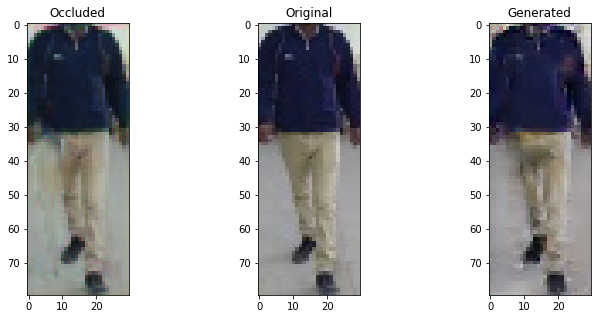

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


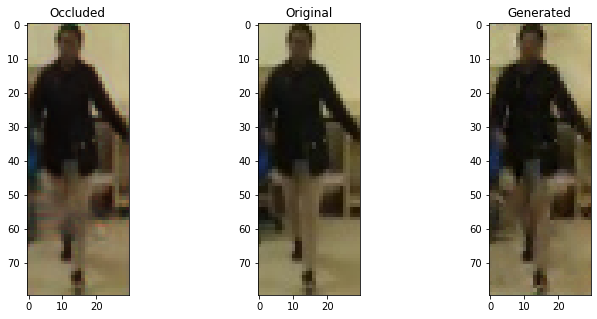

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


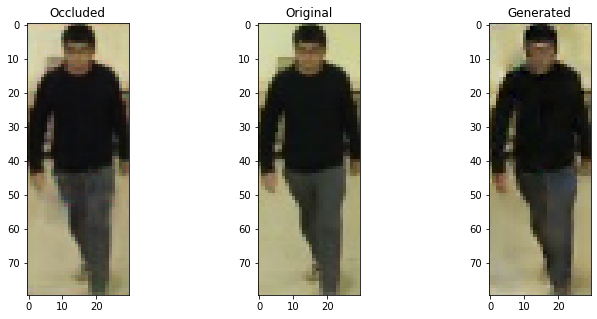

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


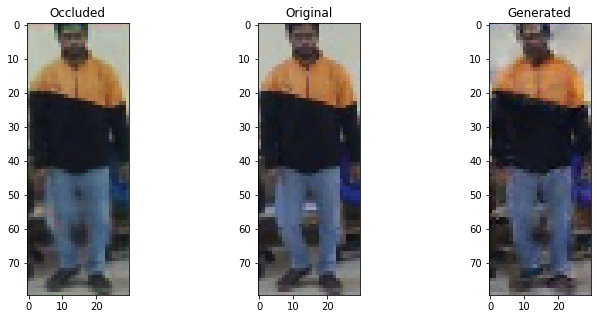

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


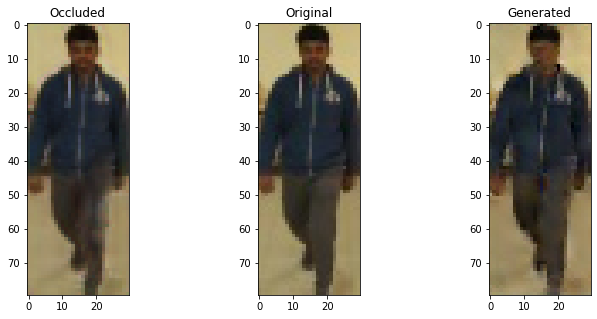

  8%|▊         | 1/13 [00:00<00:02,  5.89it/s]

Discriminator Loss:  0.6487475633621216 , Adversarial Loss:  0.0018629718106240034
Epoch 242


  8%|▊         | 1/13 [00:00<00:01,  6.78it/s]

Discriminator Loss:  0.6616372466087341 , Adversarial Loss:  0.0020317102316766977
Epoch 243


  8%|▊         | 1/13 [00:00<00:01,  6.76it/s]

Discriminator Loss:  0.6546746492385864 , Adversarial Loss:  0.00211722357198596
Epoch 244


  8%|▊         | 1/13 [00:00<00:01,  6.90it/s]

Discriminator Loss:  0.6606074571609497 , Adversarial Loss:  0.0020326110534369946
Epoch 245


  8%|▊         | 1/13 [00:00<00:01,  6.63it/s]

Discriminator Loss:  0.6519491076469421 , Adversarial Loss:  0.0019039320759475231
Epoch 246


  8%|▊         | 1/13 [00:00<00:01,  6.80it/s]

Discriminator Loss:  0.6782510876655579 , Adversarial Loss:  0.0019216119544580579
Epoch 247


  8%|▊         | 1/13 [00:00<00:01,  6.62it/s]

Discriminator Loss:  0.6634461879730225 , Adversarial Loss:  0.0018737330101430416
Epoch 248


  8%|▊         | 1/13 [00:00<00:01,  6.28it/s]

Discriminator Loss:  0.6560866832733154 , Adversarial Loss:  0.0019224024144932628
Epoch 249


  8%|▊         | 1/13 [00:00<00:01,  6.64it/s]

Discriminator Loss:  0.6447594165802002 , Adversarial Loss:  0.0018459217390045524
Epoch 250


  8%|▊         | 1/13 [00:00<00:01,  6.95it/s]

Discriminator Loss:  0.6712068319320679 , Adversarial Loss:  0.0019712066277861595
Epoch 251


  8%|▊         | 1/13 [00:00<00:01,  6.76it/s]

Discriminator Loss:  0.6779167652130127 , Adversarial Loss:  0.001875741290859878
Epoch 252


  8%|▊         | 1/13 [00:00<00:01,  6.80it/s]

Discriminator Loss:  0.6542340517044067 , Adversarial Loss:  0.0019845934584736824
Epoch 253


  8%|▊         | 1/13 [00:00<00:01,  6.95it/s]

Discriminator Loss:  0.6561222076416016 , Adversarial Loss:  0.001969980075955391
Epoch 254


  8%|▊         | 1/13 [00:00<00:02,  5.30it/s]

Discriminator Loss:  0.6649134159088135 , Adversarial Loss:  0.002093539573252201
Epoch 255


  8%|▊         | 1/13 [00:00<00:01,  6.02it/s]

Discriminator Loss:  0.6675266623497009 , Adversarial Loss:  0.0021094141993671656
Epoch 256


  8%|▊         | 1/13 [00:00<00:02,  5.42it/s]

Discriminator Loss:  0.6651004552841187 , Adversarial Loss:  0.0020011812448501587
Epoch 257


  8%|▊         | 1/13 [00:00<00:01,  7.02it/s]

Discriminator Loss:  0.6560360789299011 , Adversarial Loss:  0.0020678385626524687
Epoch 258


  8%|▊         | 1/13 [00:00<00:01,  6.72it/s]

Discriminator Loss:  0.6565459966659546 , Adversarial Loss:  0.0019808379001915455
Epoch 259


  8%|▊         | 1/13 [00:00<00:01,  6.45it/s]

Discriminator Loss:  0.6611241698265076 , Adversarial Loss:  0.0019519960042089224
Epoch 260


  8%|▊         | 1/13 [00:00<00:01,  6.96it/s]

Discriminator Loss:  0.6445719599723816 , Adversarial Loss:  0.0019046540837734938
Epoch 261


100%|██████████| 13/13 [00:01<00:00,  7.14it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


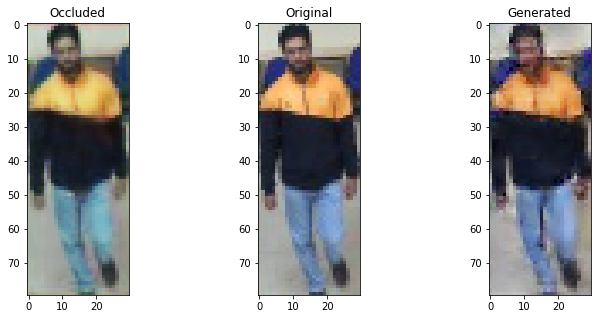

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


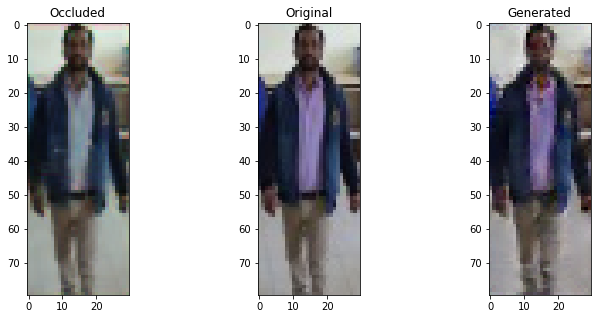

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


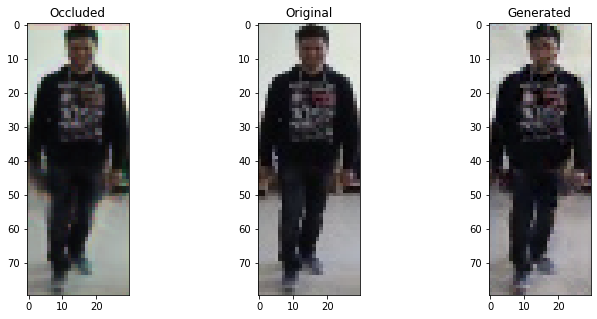

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


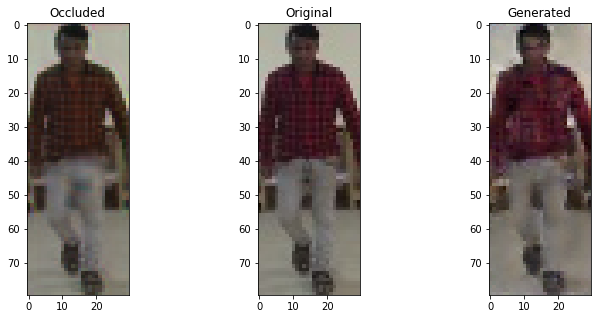

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


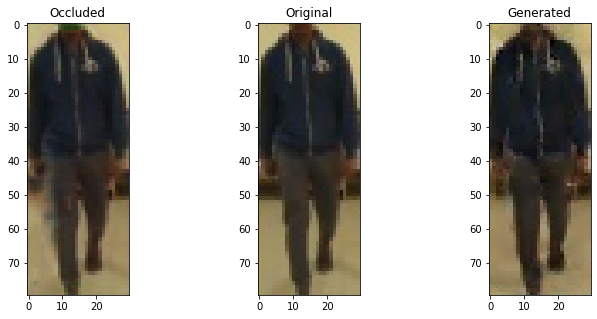

  8%|▊         | 1/13 [00:00<00:02,  5.17it/s]

Discriminator Loss:  0.6398242712020874 , Adversarial Loss:  0.0017691254615783691
Epoch 262


  8%|▊         | 1/13 [00:00<00:02,  5.30it/s]

Discriminator Loss:  0.6432774066925049 , Adversarial Loss:  0.001902749645523727
Epoch 263


  8%|▊         | 1/13 [00:00<00:01,  6.50it/s]

Discriminator Loss:  0.6565005779266357 , Adversarial Loss:  0.0018506788183003664
Epoch 264


  8%|▊         | 1/13 [00:00<00:01,  6.79it/s]

Discriminator Loss:  0.6489787101745605 , Adversarial Loss:  0.0020726402290165424
Epoch 265


  8%|▊         | 1/13 [00:00<00:02,  5.53it/s]

Discriminator Loss:  0.6606079339981079 , Adversarial Loss:  0.0019090763526037335
Epoch 266


  8%|▊         | 1/13 [00:00<00:01,  6.81it/s]

Discriminator Loss:  0.6512322425842285 , Adversarial Loss:  0.0017351130954921246
Epoch 267


  8%|▊         | 1/13 [00:00<00:01,  6.68it/s]

Discriminator Loss:  0.6806667447090149 , Adversarial Loss:  0.0018187913810834289
Epoch 268


  8%|▊         | 1/13 [00:00<00:01,  6.24it/s]

Discriminator Loss:  0.6439172029495239 , Adversarial Loss:  0.0022202450782060623
Epoch 269


  8%|▊         | 1/13 [00:00<00:01,  6.56it/s]

Discriminator Loss:  0.6534930467605591 , Adversarial Loss:  0.00181941082701087
Epoch 270


  8%|▊         | 1/13 [00:00<00:01,  6.77it/s]

Discriminator Loss:  0.6549352407455444 , Adversarial Loss:  0.0017618488054722548
Epoch 271


  8%|▊         | 1/13 [00:00<00:02,  5.37it/s]

Discriminator Loss:  0.6571021676063538 , Adversarial Loss:  0.001820520730689168
Epoch 272


  8%|▊         | 1/13 [00:00<00:02,  5.80it/s]

Discriminator Loss:  0.6371750831604004 , Adversarial Loss:  0.0018992971163243055
Epoch 273


  8%|▊         | 1/13 [00:00<00:01,  6.56it/s]

Discriminator Loss:  0.6446741223335266 , Adversarial Loss:  0.001980372704565525
Epoch 274


  8%|▊         | 1/13 [00:00<00:01,  6.84it/s]

Discriminator Loss:  0.6604207754135132 , Adversarial Loss:  0.0018834718503057957
Epoch 275


  8%|▊         | 1/13 [00:00<00:02,  5.78it/s]

Discriminator Loss:  0.6656535863876343 , Adversarial Loss:  0.0018716948106884956
Epoch 276


  8%|▊         | 1/13 [00:00<00:01,  6.83it/s]

Discriminator Loss:  0.6491719484329224 , Adversarial Loss:  0.0019075499149039388
Epoch 277


  8%|▊         | 1/13 [00:00<00:02,  5.51it/s]

Discriminator Loss:  0.6554893255233765 , Adversarial Loss:  0.001962384209036827
Epoch 278


  8%|▊         | 1/13 [00:00<00:01,  6.26it/s]

Discriminator Loss:  0.6583946943283081 , Adversarial Loss:  0.0019451892003417015
Epoch 279


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6588531136512756 , Adversarial Loss:  0.001927155302837491
Epoch 280


  8%|▊         | 1/13 [00:00<00:01,  6.36it/s]

Discriminator Loss:  0.648766279220581 , Adversarial Loss:  0.001763732172548771
Epoch 281


100%|██████████| 13/13 [00:01<00:00,  6.94it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


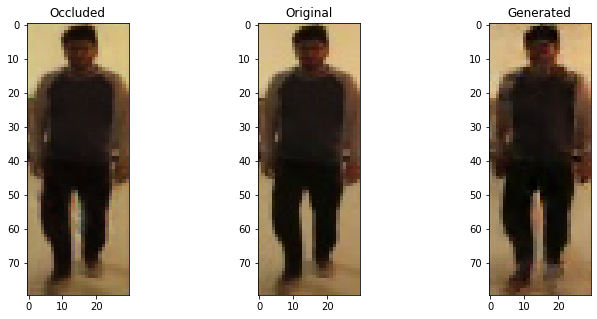

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


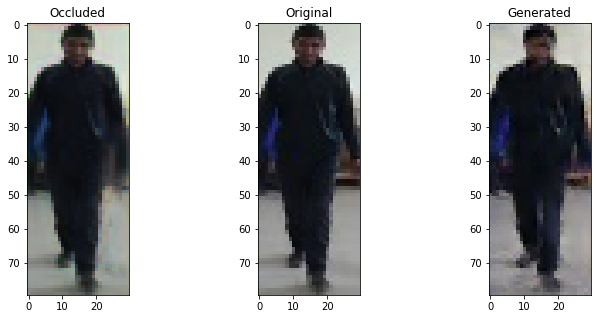

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


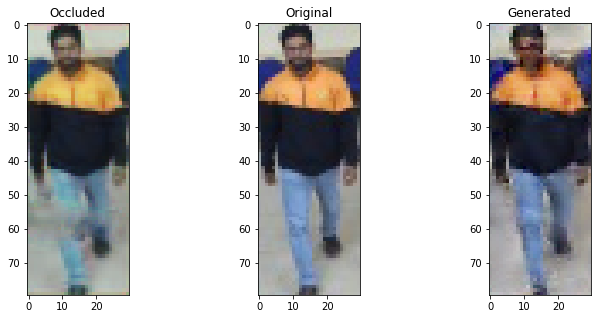

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


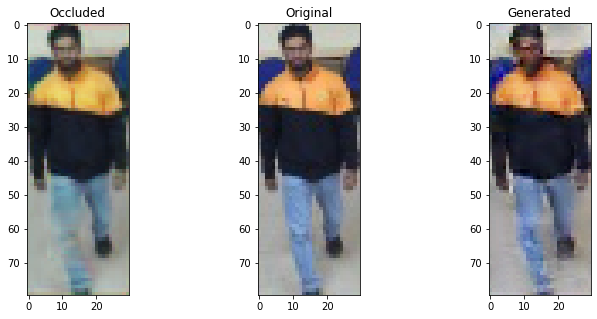

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


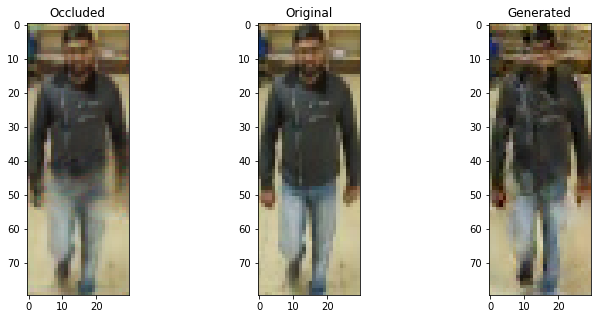

  8%|▊         | 1/13 [00:00<00:02,  5.38it/s]

Discriminator Loss:  0.6422571539878845 , Adversarial Loss:  0.0019082423532381654
Epoch 282


  8%|▊         | 1/13 [00:00<00:01,  6.76it/s]

Discriminator Loss:  0.6670704483985901 , Adversarial Loss:  0.0018938772846013308
Epoch 283


  8%|▊         | 1/13 [00:00<00:01,  6.15it/s]

Discriminator Loss:  0.6431783437728882 , Adversarial Loss:  0.0018860426498576999
Epoch 284


  8%|▊         | 1/13 [00:00<00:01,  6.59it/s]

Discriminator Loss:  0.6665940880775452 , Adversarial Loss:  0.001727369730360806
Epoch 285


  8%|▊         | 1/13 [00:00<00:01,  6.61it/s]

Discriminator Loss:  0.6639683842658997 , Adversarial Loss:  0.0017368042608723044
Epoch 286


  8%|▊         | 1/13 [00:00<00:01,  6.81it/s]

Discriminator Loss:  0.6956624388694763 , Adversarial Loss:  0.001844660029746592
Epoch 287


  8%|▊         | 1/13 [00:00<00:01,  6.95it/s]

Discriminator Loss:  0.6629674434661865 , Adversarial Loss:  0.0017603562446311116
Epoch 288


  8%|▊         | 1/13 [00:00<00:01,  6.43it/s]

Discriminator Loss:  0.6462991237640381 , Adversarial Loss:  0.0017822561785578728
Epoch 289


  8%|▊         | 1/13 [00:00<00:01,  6.41it/s]

Discriminator Loss:  0.6803335547447205 , Adversarial Loss:  0.0016713384538888931
Epoch 290


  8%|▊         | 1/13 [00:00<00:01,  6.68it/s]

Discriminator Loss:  0.6680022478103638 , Adversarial Loss:  0.0018651466816663742
Epoch 291


  8%|▊         | 1/13 [00:00<00:01,  6.48it/s]

Discriminator Loss:  0.6490759253501892 , Adversarial Loss:  0.0018994593992829323
Epoch 292


  8%|▊         | 1/13 [00:00<00:01,  6.39it/s]

Discriminator Loss:  0.6518723964691162 , Adversarial Loss:  0.0016728173941373825
Epoch 293


  8%|▊         | 1/13 [00:00<00:01,  6.05it/s]

Discriminator Loss:  0.6615310907363892 , Adversarial Loss:  0.001753359567373991
Epoch 294


  8%|▊         | 1/13 [00:00<00:02,  5.29it/s]

Discriminator Loss:  0.6489347219467163 , Adversarial Loss:  0.0018612626008689404
Epoch 295


  8%|▊         | 1/13 [00:00<00:01,  6.05it/s]

Discriminator Loss:  0.6467064023017883 , Adversarial Loss:  0.0015477149281650782
Epoch 296


  8%|▊         | 1/13 [00:00<00:01,  6.52it/s]

Discriminator Loss:  0.644722580909729 , Adversarial Loss:  0.0017209956422448158
Epoch 297


  8%|▊         | 1/13 [00:00<00:02,  5.51it/s]

Discriminator Loss:  0.6562919616699219 , Adversarial Loss:  0.0018527174834161997
Epoch 298


  8%|▊         | 1/13 [00:00<00:01,  6.58it/s]

Discriminator Loss:  0.6546557545661926 , Adversarial Loss:  0.0018684432143345475
Epoch 299


  8%|▊         | 1/13 [00:00<00:01,  6.48it/s]

Discriminator Loss:  0.6810024380683899 , Adversarial Loss:  0.0018248356645926833
Epoch 300


  8%|▊         | 1/13 [00:00<00:01,  6.75it/s]

Discriminator Loss:  0.6603440046310425 , Adversarial Loss:  0.0017572436481714249
Epoch 301


100%|██████████| 13/13 [00:02<00:00,  6.46it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


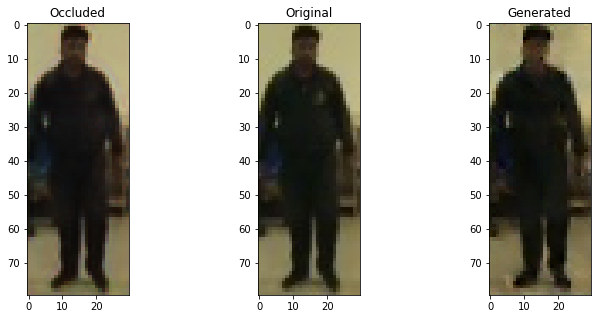

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


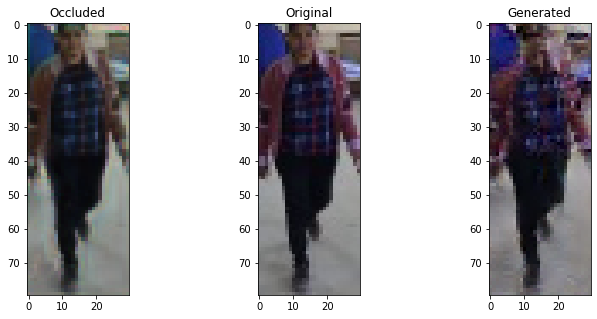

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


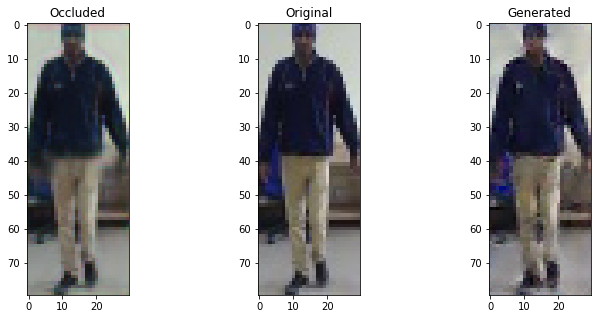

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


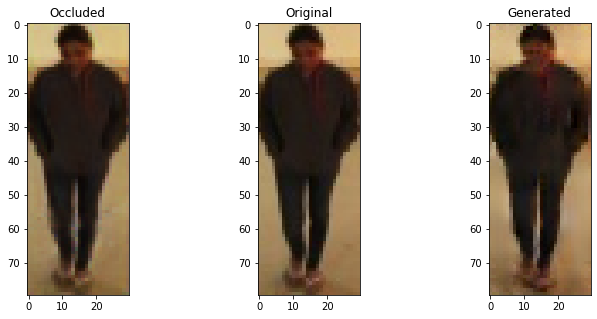

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


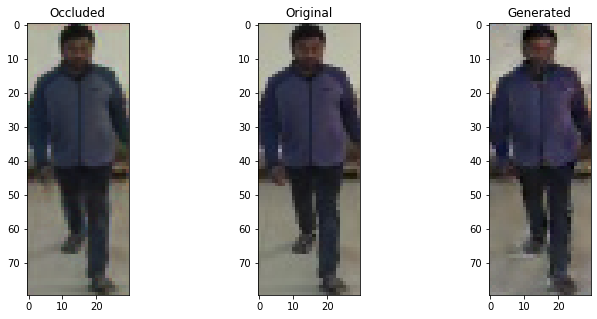

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6591987609863281 , Adversarial Loss:  0.0018145772628486156
Epoch 302


  8%|▊         | 1/13 [00:00<00:01,  6.47it/s]

Discriminator Loss:  0.6495739817619324 , Adversarial Loss:  0.0017931866459548473
Epoch 303


  8%|▊         | 1/13 [00:00<00:01,  6.45it/s]

Discriminator Loss:  0.6616488099098206 , Adversarial Loss:  0.001937330700457096
Epoch 304


  8%|▊         | 1/13 [00:00<00:01,  6.42it/s]

Discriminator Loss:  0.6628901362419128 , Adversarial Loss:  0.0017554552759975195
Epoch 305


  8%|▊         | 1/13 [00:00<00:01,  6.76it/s]

Discriminator Loss:  0.6825813055038452 , Adversarial Loss:  0.001797826960682869
Epoch 306


  8%|▊         | 1/13 [00:00<00:01,  6.29it/s]

Discriminator Loss:  0.684543788433075 , Adversarial Loss:  0.0018365455325692892
Epoch 307


  8%|▊         | 1/13 [00:00<00:02,  5.29it/s]

Discriminator Loss:  0.6533880233764648 , Adversarial Loss:  0.00162124156486243
Epoch 308


  8%|▊         | 1/13 [00:00<00:01,  6.29it/s]

Discriminator Loss:  0.6205410957336426 , Adversarial Loss:  0.0017615251708775759
Epoch 309


  8%|▊         | 1/13 [00:00<00:02,  5.38it/s]

Discriminator Loss:  0.6636831760406494 , Adversarial Loss:  0.0019636477809399366
Epoch 310


  8%|▊         | 1/13 [00:00<00:01,  6.80it/s]

Discriminator Loss:  0.6530745029449463 , Adversarial Loss:  0.0016209403984248638
Epoch 311


  8%|▊         | 1/13 [00:00<00:01,  6.57it/s]

Discriminator Loss:  0.6563963890075684 , Adversarial Loss:  0.0017185462638735771
Epoch 312


  8%|▊         | 1/13 [00:00<00:02,  5.40it/s]

Discriminator Loss:  0.6699622869491577 , Adversarial Loss:  0.001688210992142558
Epoch 313


  8%|▊         | 1/13 [00:00<00:02,  5.40it/s]

Discriminator Loss:  0.6432814598083496 , Adversarial Loss:  0.00177148194052279
Epoch 314


  8%|▊         | 1/13 [00:00<00:01,  7.11it/s]

Discriminator Loss:  0.6398799419403076 , Adversarial Loss:  0.001701326691545546
Epoch 315


  8%|▊         | 1/13 [00:00<00:01,  6.73it/s]

Discriminator Loss:  0.6438931226730347 , Adversarial Loss:  0.00181243394035846
Epoch 316


  8%|▊         | 1/13 [00:00<00:01,  6.20it/s]

Discriminator Loss:  0.6765158772468567 , Adversarial Loss:  0.0018796317745000124
Epoch 317


  8%|▊         | 1/13 [00:00<00:02,  5.48it/s]

Discriminator Loss:  0.6806995272636414 , Adversarial Loss:  0.001642181072384119
Epoch 318


  8%|▊         | 1/13 [00:00<00:02,  5.24it/s]

Discriminator Loss:  0.6662694811820984 , Adversarial Loss:  0.0016463028732687235
Epoch 319


  8%|▊         | 1/13 [00:00<00:01,  6.70it/s]

Discriminator Loss:  0.6766176223754883 , Adversarial Loss:  0.0017169633647426963
Epoch 320


  8%|▊         | 1/13 [00:00<00:02,  5.22it/s]

Discriminator Loss:  0.6487983465194702 , Adversarial Loss:  0.0016551793087273836
Epoch 321


100%|██████████| 13/13 [00:01<00:00,  6.74it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


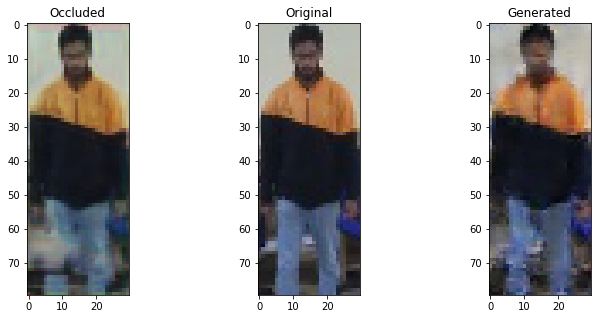

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


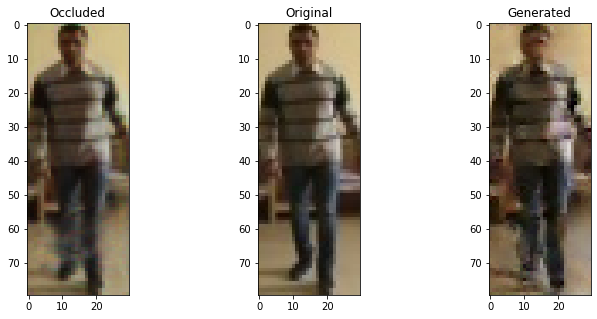

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


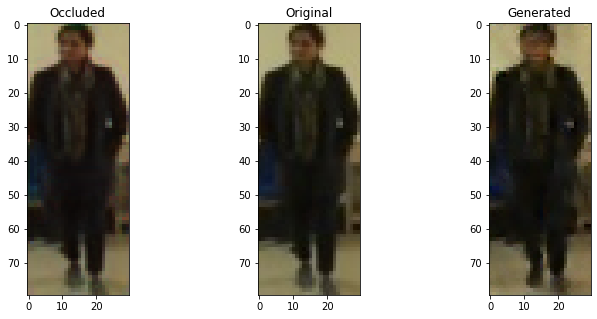

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


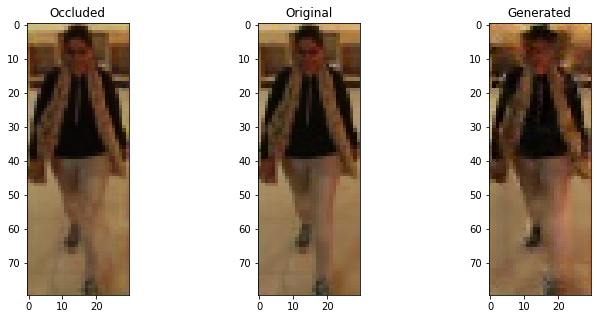

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


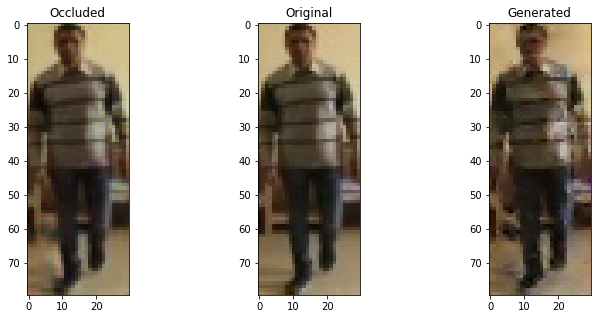

  8%|▊         | 1/13 [00:00<00:02,  5.70it/s]

Discriminator Loss:  0.6400600671768188 , Adversarial Loss:  0.001704674563370645
Epoch 322


  8%|▊         | 1/13 [00:00<00:01,  6.22it/s]

Discriminator Loss:  0.6651096343994141 , Adversarial Loss:  0.0016926289536058903
Epoch 323


  8%|▊         | 1/13 [00:00<00:01,  6.64it/s]

Discriminator Loss:  0.6528851389884949 , Adversarial Loss:  0.0016620684182271361
Epoch 324


  8%|▊         | 1/13 [00:00<00:01,  6.39it/s]

Discriminator Loss:  0.6800994873046875 , Adversarial Loss:  0.0019009103998541832
Epoch 325


  8%|▊         | 1/13 [00:00<00:01,  6.44it/s]

Discriminator Loss:  0.6665260195732117 , Adversarial Loss:  0.0015167826786637306
Epoch 326


  8%|▊         | 1/13 [00:00<00:01,  6.88it/s]

Discriminator Loss:  0.6677069664001465 , Adversarial Loss:  0.00177478208206594
Epoch 327


  8%|▊         | 1/13 [00:00<00:01,  6.33it/s]

Discriminator Loss:  0.6498106718063354 , Adversarial Loss:  0.0013984052930027246
Epoch 328


  8%|▊         | 1/13 [00:00<00:01,  6.14it/s]

Discriminator Loss:  0.6407429575920105 , Adversarial Loss:  0.0017812963342294097
Epoch 329


  8%|▊         | 1/13 [00:00<00:01,  6.68it/s]

Discriminator Loss:  0.6751946210861206 , Adversarial Loss:  0.0015579572645947337
Epoch 330


  8%|▊         | 1/13 [00:00<00:01,  6.63it/s]

Discriminator Loss:  0.6601119041442871 , Adversarial Loss:  0.0015657133189961314
Epoch 331


  8%|▊         | 1/13 [00:00<00:01,  6.12it/s]

Discriminator Loss:  0.6633943915367126 , Adversarial Loss:  0.0017234476981684566
Epoch 332


  8%|▊         | 1/13 [00:00<00:01,  6.52it/s]

Discriminator Loss:  0.6627429723739624 , Adversarial Loss:  0.001566670835018158
Epoch 333


  8%|▊         | 1/13 [00:00<00:01,  6.43it/s]

Discriminator Loss:  0.6508180499076843 , Adversarial Loss:  0.0016591019229963422
Epoch 334


  8%|▊         | 1/13 [00:00<00:02,  5.35it/s]

Discriminator Loss:  0.689344048500061 , Adversarial Loss:  0.0017235162667930126
Epoch 335


  8%|▊         | 1/13 [00:00<00:01,  6.90it/s]

Discriminator Loss:  0.6842499375343323 , Adversarial Loss:  0.001533098635263741
Epoch 336


  8%|▊         | 1/13 [00:00<00:02,  5.41it/s]

Discriminator Loss:  0.6413967609405518 , Adversarial Loss:  0.0016456497833132744
Epoch 337


  8%|▊         | 1/13 [00:00<00:01,  6.06it/s]

Discriminator Loss:  0.6649125814437866 , Adversarial Loss:  0.001713920384645462
Epoch 338


  8%|▊         | 1/13 [00:00<00:01,  6.40it/s]

Discriminator Loss:  0.6552650928497314 , Adversarial Loss:  0.001592153450474143
Epoch 339


  8%|▊         | 1/13 [00:00<00:01,  7.04it/s]

Discriminator Loss:  0.6582640409469604 , Adversarial Loss:  0.0015409691259264946
Epoch 340


  8%|▊         | 1/13 [00:00<00:01,  6.39it/s]

Discriminator Loss:  0.6510905027389526 , Adversarial Loss:  0.0016992383170872927
Epoch 341


100%|██████████| 13/13 [00:01<00:00,  6.64it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


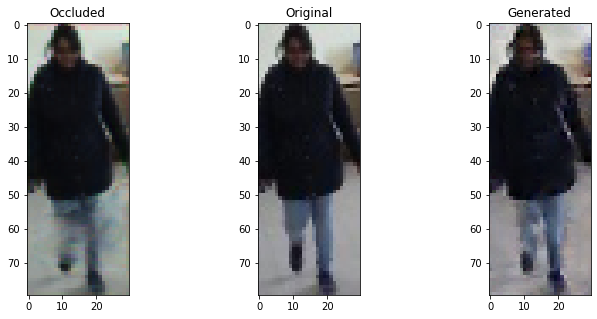

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


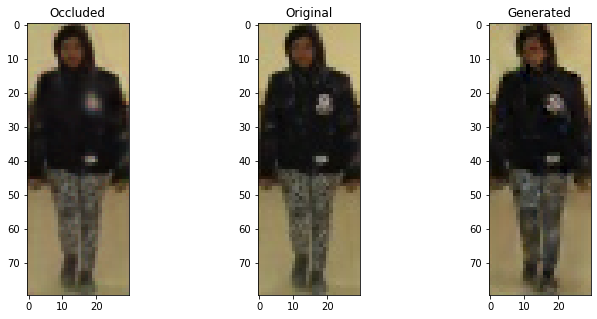

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


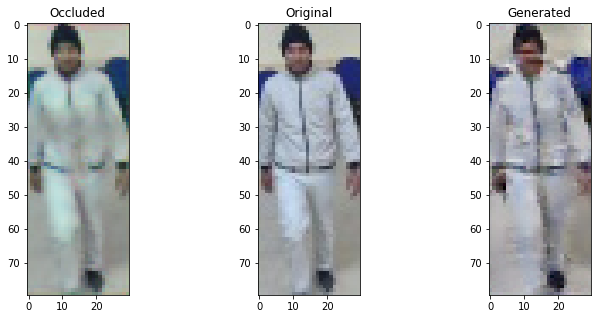

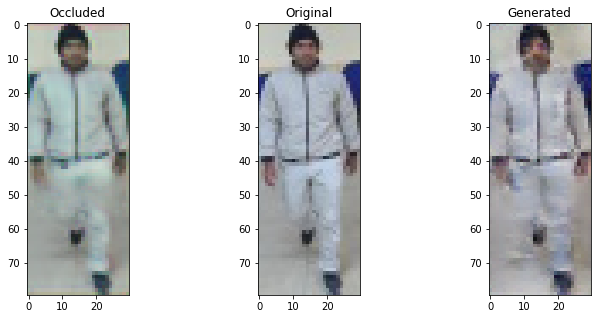

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


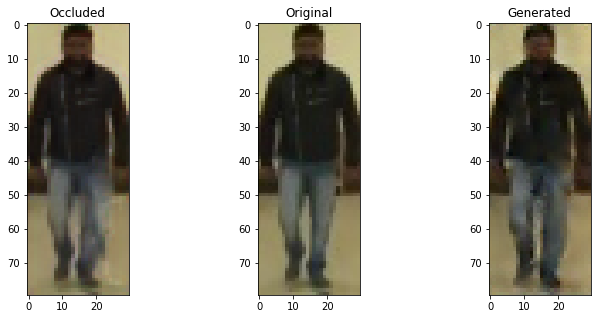

  8%|▊         | 1/13 [00:00<00:02,  5.47it/s]

Discriminator Loss:  0.6462572813034058 , Adversarial Loss:  0.0018151751719415188
Epoch 342


  8%|▊         | 1/13 [00:00<00:01,  6.17it/s]

Discriminator Loss:  0.6478224992752075 , Adversarial Loss:  0.018642127513885498
Epoch 343


  8%|▊         | 1/13 [00:00<00:01,  6.58it/s]

Discriminator Loss:  0.6745848655700684 , Adversarial Loss:  0.010961167514324188
Epoch 344


  8%|▊         | 1/13 [00:00<00:01,  6.75it/s]

Discriminator Loss:  0.6639400720596313 , Adversarial Loss:  0.008313020691275597
Epoch 345


  8%|▊         | 1/13 [00:00<00:01,  6.51it/s]

Discriminator Loss:  0.670547604560852 , Adversarial Loss:  0.0072431196458637714
Epoch 346


  8%|▊         | 1/13 [00:00<00:01,  6.19it/s]

Discriminator Loss:  0.6483751535415649 , Adversarial Loss:  0.006540977396070957
Epoch 347


  8%|▊         | 1/13 [00:00<00:01,  6.42it/s]

Discriminator Loss:  0.6620177030563354 , Adversarial Loss:  0.006222488824278116
Epoch 348


  8%|▊         | 1/13 [00:00<00:02,  5.28it/s]

Discriminator Loss:  0.6604896783828735 , Adversarial Loss:  0.0054255155846476555
Epoch 349


  8%|▊         | 1/13 [00:00<00:01,  6.75it/s]

Discriminator Loss:  0.6721725463867188 , Adversarial Loss:  0.005596725270152092
Epoch 350


  8%|▊         | 1/13 [00:00<00:01,  7.20it/s]

Discriminator Loss:  0.6605172753334045 , Adversarial Loss:  0.004917440935969353
Epoch 351


  8%|▊         | 1/13 [00:00<00:01,  6.62it/s]

Discriminator Loss:  0.672888994216919 , Adversarial Loss:  0.005506870336830616
Epoch 352


  8%|▊         | 1/13 [00:00<00:02,  5.40it/s]

Discriminator Loss:  0.6463767886161804 , Adversarial Loss:  0.004303129389882088
Epoch 353


  8%|▊         | 1/13 [00:00<00:01,  6.54it/s]

Discriminator Loss:  0.6515467166900635 , Adversarial Loss:  0.004397980868816376
Epoch 354


  8%|▊         | 1/13 [00:00<00:02,  5.28it/s]

Discriminator Loss:  0.6759257316589355 , Adversarial Loss:  0.004076607059687376
Epoch 355


  8%|▊         | 1/13 [00:00<00:01,  6.44it/s]

Discriminator Loss:  0.6428121328353882 , Adversarial Loss:  0.003953030798584223
Epoch 356


  8%|▊         | 1/13 [00:00<00:02,  5.48it/s]

Discriminator Loss:  0.6720535755157471 , Adversarial Loss:  0.004003661684691906
Epoch 357


  8%|▊         | 1/13 [00:00<00:01,  6.81it/s]

Discriminator Loss:  0.6571413278579712 , Adversarial Loss:  0.0035965186543762684
Epoch 358


  8%|▊         | 1/13 [00:00<00:01,  6.34it/s]

Discriminator Loss:  0.6708387732505798 , Adversarial Loss:  0.003523800987750292
Epoch 359


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6470685005187988 , Adversarial Loss:  0.003289130749180913
Epoch 360


  8%|▊         | 1/13 [00:00<00:01,  6.84it/s]

Discriminator Loss:  0.6965131759643555 , Adversarial Loss:  0.003377313958480954
Epoch 361


100%|██████████| 13/13 [00:01<00:00,  6.81it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


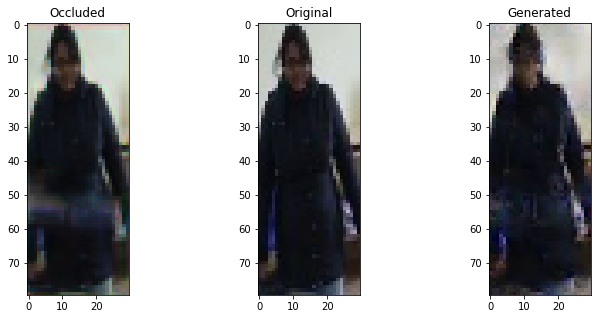

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


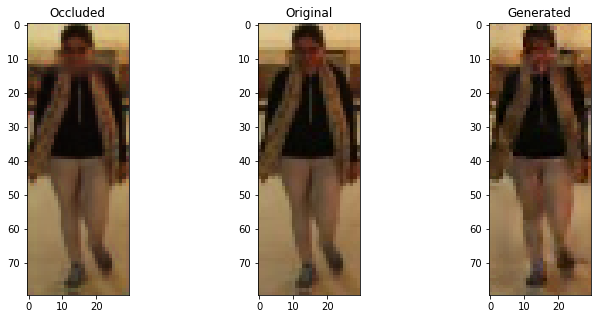

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


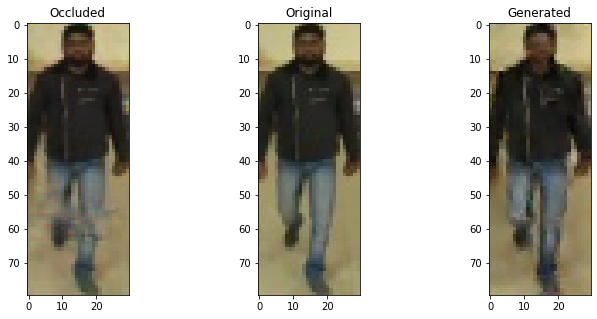

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


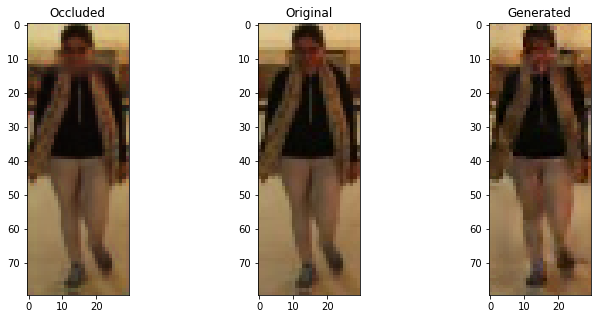

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


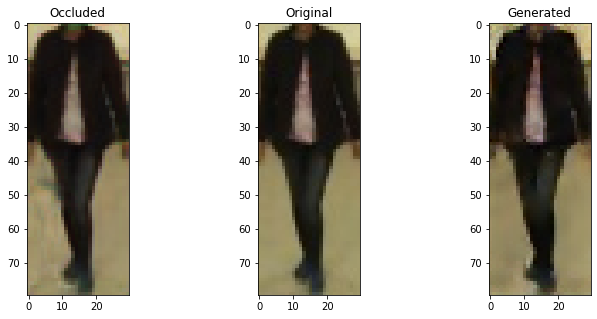

  8%|▊         | 1/13 [00:00<00:02,  5.26it/s]

Discriminator Loss:  0.6711728572845459 , Adversarial Loss:  0.0031328939367085695
Epoch 362


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6413001418113708 , Adversarial Loss:  0.0033249463886022568
Epoch 363


  8%|▊         | 1/13 [00:00<00:01,  6.25it/s]

Discriminator Loss:  0.6711934804916382 , Adversarial Loss:  0.0032155087683349848
Epoch 364


  8%|▊         | 1/13 [00:00<00:01,  6.17it/s]

Discriminator Loss:  0.6660065054893494 , Adversarial Loss:  0.002913881093263626
Epoch 365


  8%|▊         | 1/13 [00:00<00:01,  6.54it/s]

Discriminator Loss:  0.6667816638946533 , Adversarial Loss:  0.002996993251144886
Epoch 366


  8%|▊         | 1/13 [00:00<00:01,  6.13it/s]

Discriminator Loss:  0.6719273328781128 , Adversarial Loss:  0.0027462714351713657
Epoch 367


  8%|▊         | 1/13 [00:00<00:01,  7.06it/s]

Discriminator Loss:  0.6487622261047363 , Adversarial Loss:  0.002770140767097473
Epoch 368


  8%|▊         | 1/13 [00:00<00:01,  6.77it/s]

Discriminator Loss:  0.6713396310806274 , Adversarial Loss:  0.0026586768217384815
Epoch 369


  8%|▊         | 1/13 [00:00<00:01,  6.68it/s]

Discriminator Loss:  0.6692498922348022 , Adversarial Loss:  0.0025236448273062706
Epoch 370


  8%|▊         | 1/13 [00:00<00:01,  6.33it/s]

Discriminator Loss:  0.6533652544021606 , Adversarial Loss:  0.002609830815345049
Epoch 371


  8%|▊         | 1/13 [00:00<00:01,  6.64it/s]

Discriminator Loss:  0.6230881810188293 , Adversarial Loss:  0.0029983329586684704
Epoch 372


  8%|▊         | 1/13 [00:00<00:02,  5.16it/s]

Discriminator Loss:  0.6775684356689453 , Adversarial Loss:  0.0026465561240911484
Epoch 373


  8%|▊         | 1/13 [00:00<00:02,  5.42it/s]

Discriminator Loss:  0.643736720085144 , Adversarial Loss:  0.002615763805806637
Epoch 374


  8%|▊         | 1/13 [00:00<00:01,  6.79it/s]

Discriminator Loss:  0.6642158627510071 , Adversarial Loss:  0.0026966375298798084
Epoch 375


  8%|▊         | 1/13 [00:00<00:01,  6.04it/s]

Discriminator Loss:  0.6864252686500549 , Adversarial Loss:  0.0025245333090424538
Epoch 376


  8%|▊         | 1/13 [00:00<00:01,  6.50it/s]

Discriminator Loss:  0.6464143991470337 , Adversarial Loss:  0.0026959828101098537
Epoch 377


  8%|▊         | 1/13 [00:00<00:01,  6.49it/s]

Discriminator Loss:  0.6560634970664978 , Adversarial Loss:  0.0026264204643666744
Epoch 378


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6557678580284119 , Adversarial Loss:  0.002632344141602516
Epoch 379


  8%|▊         | 1/13 [00:00<00:01,  6.49it/s]

Discriminator Loss:  0.626072883605957 , Adversarial Loss:  0.002491242717951536
Epoch 380


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6489185690879822 , Adversarial Loss:  0.002832680009305477
Epoch 381


100%|██████████| 13/13 [00:01<00:00,  6.53it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


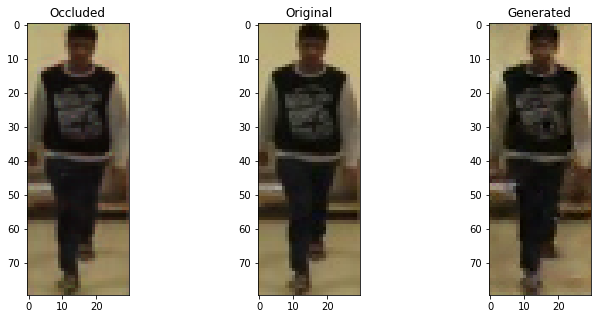

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


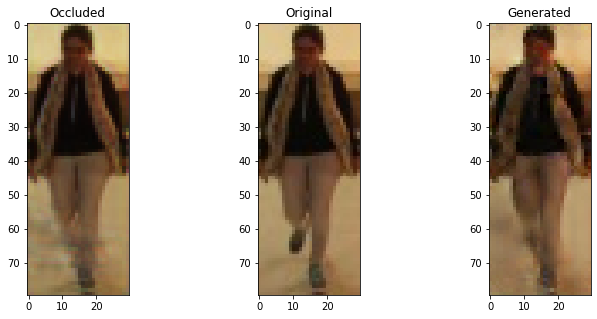

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


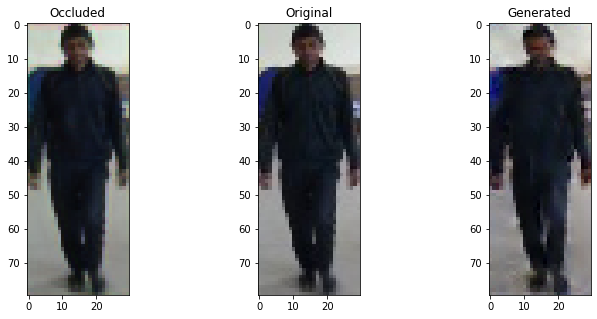

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


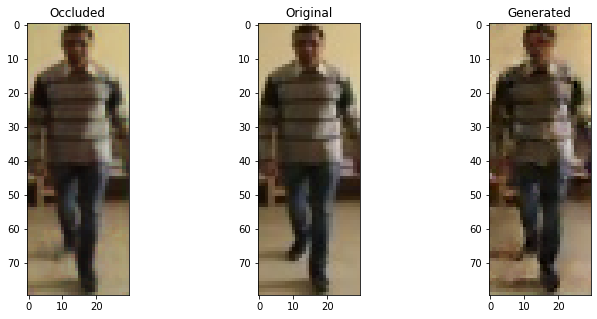

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


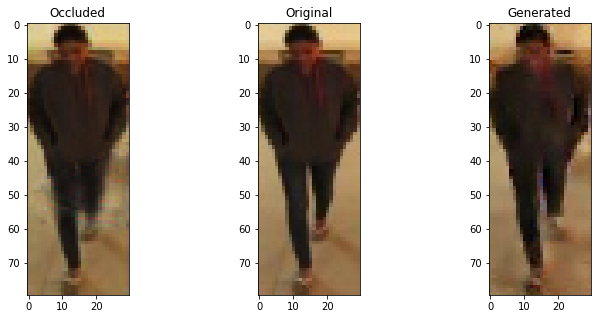

  8%|▊         | 1/13 [00:00<00:02,  5.62it/s]

Discriminator Loss:  0.6647931337356567 , Adversarial Loss:  0.002627235371619463
Epoch 382


  8%|▊         | 1/13 [00:00<00:01,  6.33it/s]

Discriminator Loss:  0.6811723709106445 , Adversarial Loss:  0.002319948747754097
Epoch 383


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6446104049682617 , Adversarial Loss:  0.002457181690260768
Epoch 384


  8%|▊         | 1/13 [00:00<00:01,  6.21it/s]

Discriminator Loss:  0.6441413760185242 , Adversarial Loss:  0.0023056212812662125
Epoch 385


  8%|▊         | 1/13 [00:00<00:01,  6.01it/s]

Discriminator Loss:  0.6499520540237427 , Adversarial Loss:  0.0027475724928081036
Epoch 386


  8%|▊         | 1/13 [00:00<00:02,  5.37it/s]

Discriminator Loss:  0.6826761364936829 , Adversarial Loss:  0.0025705937296152115
Epoch 387


  8%|▊         | 1/13 [00:00<00:02,  5.28it/s]

Discriminator Loss:  0.6863030195236206 , Adversarial Loss:  0.0022271983325481415
Epoch 388


  8%|▊         | 1/13 [00:00<00:01,  6.34it/s]

Discriminator Loss:  0.6630254983901978 , Adversarial Loss:  0.0023969586472958326
Epoch 389


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6494605541229248 , Adversarial Loss:  0.002307834569364786
Epoch 390


  8%|▊         | 1/13 [00:00<00:01,  6.51it/s]

Discriminator Loss:  0.6751205325126648 , Adversarial Loss:  0.0023455789778381586
Epoch 391


  8%|▊         | 1/13 [00:00<00:01,  6.38it/s]

Discriminator Loss:  0.663615882396698 , Adversarial Loss:  0.0024636881425976753
Epoch 392


  8%|▊         | 1/13 [00:00<00:01,  6.67it/s]

Discriminator Loss:  0.6585686802864075 , Adversarial Loss:  0.0025184217374771833
Epoch 393


  8%|▊         | 1/13 [00:00<00:02,  5.25it/s]

Discriminator Loss:  0.6605941653251648 , Adversarial Loss:  0.002544669434428215
Epoch 394


  8%|▊         | 1/13 [00:00<00:01,  6.12it/s]

Discriminator Loss:  0.6710636019706726 , Adversarial Loss:  0.002344853710383177
Epoch 395


  8%|▊         | 1/13 [00:00<00:02,  5.91it/s]

Discriminator Loss:  0.663965106010437 , Adversarial Loss:  0.0026101453695446253
Epoch 396


  8%|▊         | 1/13 [00:00<00:01,  6.56it/s]

Discriminator Loss:  0.6575112342834473 , Adversarial Loss:  0.0024179662577807903
Epoch 397


  8%|▊         | 1/13 [00:00<00:02,  5.10it/s]

Discriminator Loss:  0.6604394912719727 , Adversarial Loss:  0.002236146479845047
Epoch 398


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6428561210632324 , Adversarial Loss:  0.0025803991593420506
Epoch 399


  8%|▊         | 1/13 [00:00<00:02,  5.82it/s]

Discriminator Loss:  0.6674753427505493 , Adversarial Loss:  0.0024113915860652924
Epoch 400


  8%|▊         | 1/13 [00:00<00:01,  6.39it/s]

Discriminator Loss:  0.6633802652359009 , Adversarial Loss:  0.002278246683999896
Epoch 401


100%|██████████| 13/13 [00:01<00:00,  6.67it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


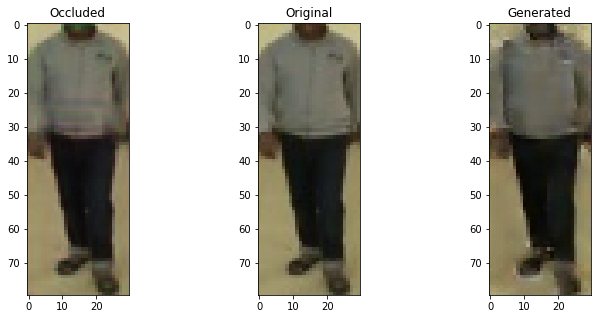

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


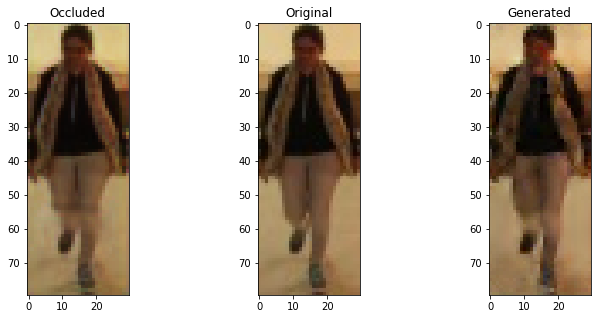

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


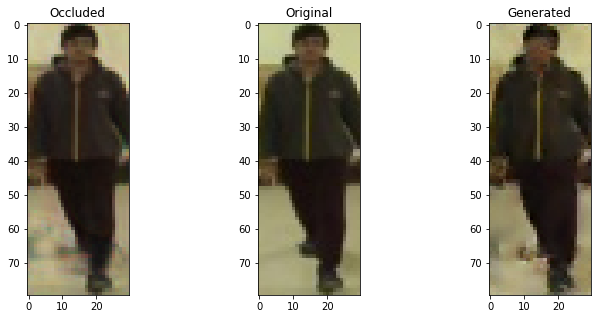

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


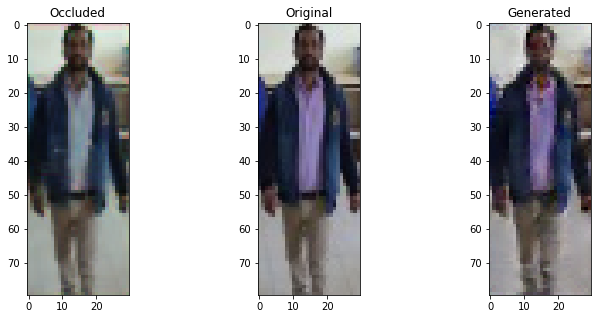

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


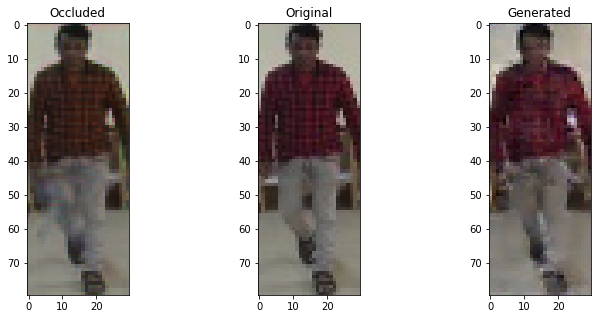

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6739216446876526 , Adversarial Loss:  0.0021561586763709784
Epoch 402


  8%|▊         | 1/13 [00:00<00:01,  6.93it/s]

Discriminator Loss:  0.6581078767776489 , Adversarial Loss:  0.0023427908308804035
Epoch 403


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6861867308616638 , Adversarial Loss:  0.002076086588203907
Epoch 404


  8%|▊         | 1/13 [00:00<00:01,  6.87it/s]

Discriminator Loss:  0.6776560544967651 , Adversarial Loss:  0.002469622530043125
Epoch 405


  8%|▊         | 1/13 [00:00<00:01,  6.74it/s]

Discriminator Loss:  0.665012001991272 , Adversarial Loss:  0.002088915091007948
Epoch 406


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6399708986282349 , Adversarial Loss:  0.002236667089164257
Epoch 407


  8%|▊         | 1/13 [00:00<00:01,  6.08it/s]

Discriminator Loss:  0.6575759649276733 , Adversarial Loss:  0.0022976836189627647
Epoch 408


  8%|▊         | 1/13 [00:00<00:02,  5.75it/s]

Discriminator Loss:  0.6605932712554932 , Adversarial Loss:  0.0020050660241395235
Epoch 409


  8%|▊         | 1/13 [00:00<00:01,  6.27it/s]

Discriminator Loss:  0.6631415486335754 , Adversarial Loss:  0.002215180778875947
Epoch 410


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6466213464736938 , Adversarial Loss:  0.0022489246912300587
Epoch 411


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6382066011428833 , Adversarial Loss:  0.0023718245793133974
Epoch 412


  8%|▊         | 1/13 [00:00<00:01,  6.63it/s]

Discriminator Loss:  0.6462518572807312 , Adversarial Loss:  0.002312301890924573
Epoch 413


  8%|▊         | 1/13 [00:00<00:01,  6.93it/s]

Discriminator Loss:  0.6600614786148071 , Adversarial Loss:  0.002280093729496002
Epoch 414


  8%|▊         | 1/13 [00:00<00:01,  6.50it/s]

Discriminator Loss:  0.6556361317634583 , Adversarial Loss:  0.002243964932858944
Epoch 415


  8%|▊         | 1/13 [00:00<00:01,  6.43it/s]

Discriminator Loss:  0.6620334386825562 , Adversarial Loss:  0.0019916254095733166
Epoch 416


  8%|▊         | 1/13 [00:00<00:01,  6.43it/s]

Discriminator Loss:  0.6513251662254333 , Adversarial Loss:  0.0020306261721998453
Epoch 417


  8%|▊         | 1/13 [00:00<00:01,  6.65it/s]

Discriminator Loss:  0.6409138441085815 , Adversarial Loss:  0.0021006569731980562
Epoch 418


  8%|▊         | 1/13 [00:00<00:02,  5.12it/s]

Discriminator Loss:  0.6620465517044067 , Adversarial Loss:  0.0020527730230242014
Epoch 419


  8%|▊         | 1/13 [00:00<00:01,  6.67it/s]

Discriminator Loss:  0.6635863184928894 , Adversarial Loss:  0.0024060977157205343
Epoch 420


  8%|▊         | 1/13 [00:00<00:01,  6.45it/s]

Discriminator Loss:  0.6517020463943481 , Adversarial Loss:  0.00231857318431139
Epoch 421


100%|██████████| 13/13 [00:02<00:00,  6.37it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


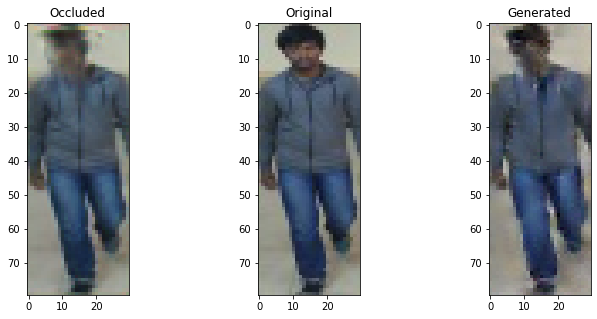

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


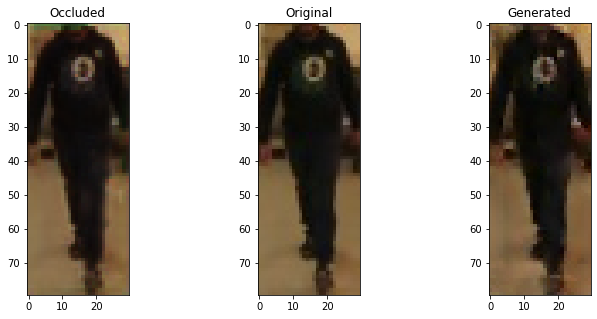

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


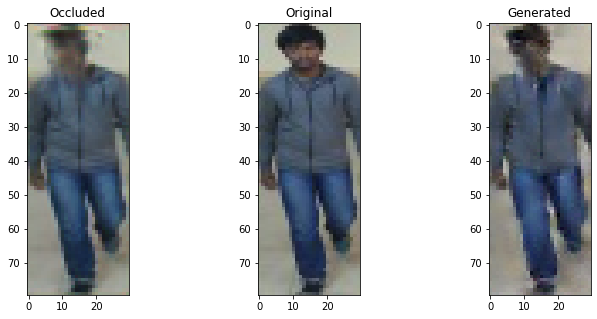

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


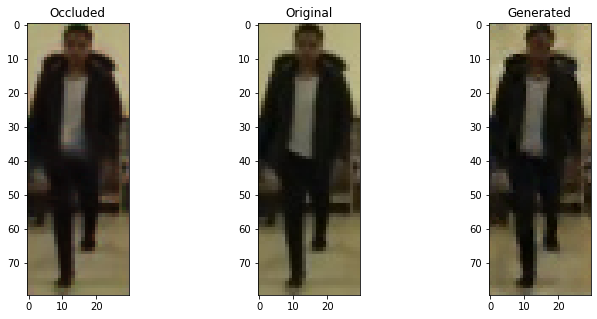

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


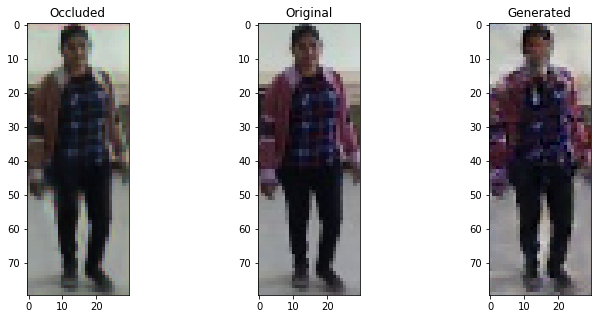

  8%|▊         | 1/13 [00:00<00:02,  5.25it/s]

Discriminator Loss:  0.6530113220214844 , Adversarial Loss:  0.0022199884988367558
Epoch 422


  8%|▊         | 1/13 [00:00<00:01,  6.68it/s]

Discriminator Loss:  0.6471289992332458 , Adversarial Loss:  0.0021261731162667274
Epoch 423


  8%|▊         | 1/13 [00:00<00:01,  6.75it/s]

Discriminator Loss:  0.668276309967041 , Adversarial Loss:  0.0021056956611573696
Epoch 424


  8%|▊         | 1/13 [00:00<00:01,  6.63it/s]

Discriminator Loss:  0.6660248637199402 , Adversarial Loss:  0.0021963065955787897
Epoch 425


  8%|▊         | 1/13 [00:00<00:01,  6.75it/s]

Discriminator Loss:  0.6497146487236023 , Adversarial Loss:  0.002417611423879862
Epoch 426


  8%|▊         | 1/13 [00:00<00:02,  5.13it/s]

Discriminator Loss:  0.6526283025741577 , Adversarial Loss:  0.0020879865624010563
Epoch 427


  8%|▊         | 1/13 [00:00<00:01,  6.64it/s]

Discriminator Loss:  0.656370997428894 , Adversarial Loss:  0.0022342789452522993
Epoch 428


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6608928442001343 , Adversarial Loss:  0.0018980874447152019
Epoch 429


  8%|▊         | 1/13 [00:00<00:02,  5.18it/s]

Discriminator Loss:  0.6430602669715881 , Adversarial Loss:  0.001955165760591626
Epoch 430


  8%|▊         | 1/13 [00:00<00:01,  6.33it/s]

Discriminator Loss:  0.6372588872909546 , Adversarial Loss:  0.002039676532149315
Epoch 431


  8%|▊         | 1/13 [00:00<00:01,  6.89it/s]

Discriminator Loss:  0.6554135084152222 , Adversarial Loss:  0.0020528556779026985
Epoch 432


  8%|▊         | 1/13 [00:00<00:01,  6.81it/s]

Discriminator Loss:  0.6788822412490845 , Adversarial Loss:  0.0019396789139136672
Epoch 433


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6717444062232971 , Adversarial Loss:  0.0020183739252388477
Epoch 434


  8%|▊         | 1/13 [00:00<00:01,  6.83it/s]

Discriminator Loss:  0.6596122980117798 , Adversarial Loss:  0.002050747163593769
Epoch 435


  8%|▊         | 1/13 [00:00<00:01,  6.38it/s]

Discriminator Loss:  0.6588608026504517 , Adversarial Loss:  0.0020738160237669945
Epoch 436


  8%|▊         | 1/13 [00:00<00:01,  6.59it/s]

Discriminator Loss:  0.6833704710006714 , Adversarial Loss:  0.0020555206574499607
Epoch 437


  8%|▊         | 1/13 [00:00<00:02,  5.07it/s]

Discriminator Loss:  0.6543146371841431 , Adversarial Loss:  0.0018422040157020092
Epoch 438


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6677032709121704 , Adversarial Loss:  0.0019742201548069715
Epoch 439


  8%|▊         | 1/13 [00:00<00:01,  6.76it/s]

Discriminator Loss:  0.6857901811599731 , Adversarial Loss:  0.0020683766342699528
Epoch 440


  8%|▊         | 1/13 [00:00<00:01,  6.58it/s]

Discriminator Loss:  0.6522271633148193 , Adversarial Loss:  0.0019920433405786753
Epoch 441


100%|██████████| 13/13 [00:02<00:00,  6.50it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


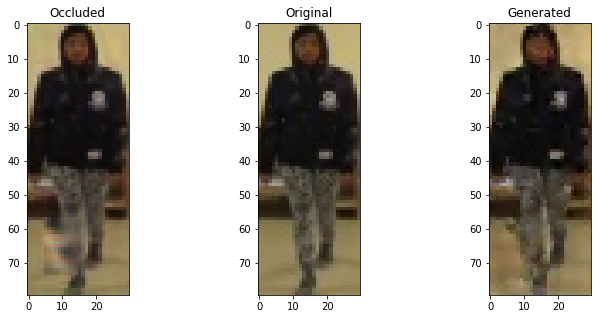

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


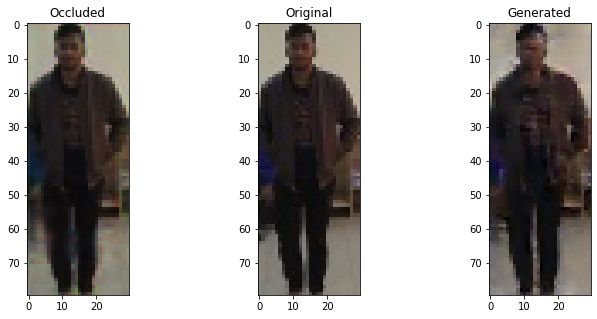

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


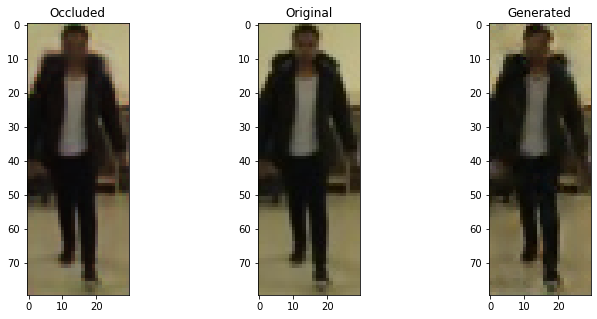

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


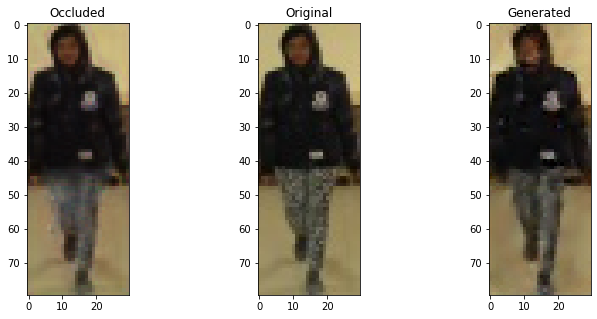

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


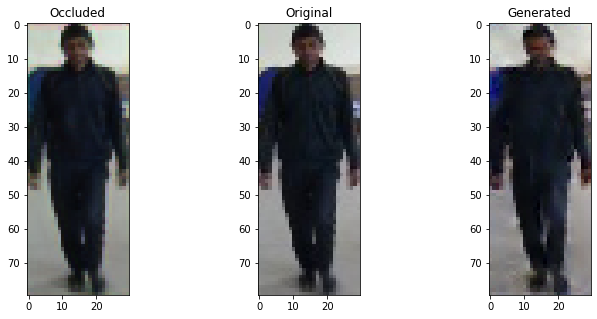

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6715453267097473 , Adversarial Loss:  0.0019562141969799995
Epoch 442


  8%|▊         | 1/13 [00:00<00:01,  6.56it/s]

Discriminator Loss:  0.654658317565918 , Adversarial Loss:  0.001841444754973054
Epoch 443


  8%|▊         | 1/13 [00:00<00:01,  6.02it/s]

Discriminator Loss:  0.674133837223053 , Adversarial Loss:  0.0020063321571797132
Epoch 444


  8%|▊         | 1/13 [00:00<00:02,  5.18it/s]

Discriminator Loss:  0.6682857871055603 , Adversarial Loss:  0.0019198829540982842
Epoch 445


  8%|▊         | 1/13 [00:00<00:01,  6.26it/s]

Discriminator Loss:  0.6433623433113098 , Adversarial Loss:  0.0020882291719317436
Epoch 446


  8%|▊         | 1/13 [00:00<00:01,  6.95it/s]

Discriminator Loss:  0.6589579582214355 , Adversarial Loss:  0.0020664420444518328
Epoch 447


  8%|▊         | 1/13 [00:00<00:01,  6.60it/s]

Discriminator Loss:  0.6422823667526245 , Adversarial Loss:  0.0018263452220708132
Epoch 448


  8%|▊         | 1/13 [00:00<00:01,  6.45it/s]

Discriminator Loss:  0.6656668186187744 , Adversarial Loss:  0.0021913228556513786
Epoch 449


  8%|▊         | 1/13 [00:00<00:01,  6.20it/s]

Discriminator Loss:  0.6630353927612305 , Adversarial Loss:  0.0019771764054894447
Epoch 450


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6766754388809204 , Adversarial Loss:  0.0020277511794120073
Epoch 451


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6547359824180603 , Adversarial Loss:  0.0019506860990077257
Epoch 452


  8%|▊         | 1/13 [00:00<00:01,  6.43it/s]

Discriminator Loss:  0.676316499710083 , Adversarial Loss:  0.0019304524175822735
Epoch 453


  8%|▊         | 1/13 [00:00<00:02,  5.14it/s]

Discriminator Loss:  0.662728488445282 , Adversarial Loss:  0.0018754054326564074
Epoch 454


  8%|▊         | 1/13 [00:00<00:01,  6.23it/s]

Discriminator Loss:  0.678067684173584 , Adversarial Loss:  0.0021196198649704456
Epoch 455


  8%|▊         | 1/13 [00:00<00:01,  6.21it/s]

Discriminator Loss:  0.6702758073806763 , Adversarial Loss:  0.001945770112797618
Epoch 456


  8%|▊         | 1/13 [00:00<00:02,  5.83it/s]

Discriminator Loss:  0.677742600440979 , Adversarial Loss:  0.0019372872775420547
Epoch 457


  8%|▊         | 1/13 [00:00<00:01,  6.84it/s]

Discriminator Loss:  0.6681098341941833 , Adversarial Loss:  0.001979595050215721
Epoch 458


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6675357222557068 , Adversarial Loss:  0.0019037863239645958
Epoch 459


  8%|▊         | 1/13 [00:00<00:01,  6.69it/s]

Discriminator Loss:  0.6685781478881836 , Adversarial Loss:  0.0019249925389885902
Epoch 460


  8%|▊         | 1/13 [00:00<00:01,  6.52it/s]

Discriminator Loss:  0.6569468975067139 , Adversarial Loss:  0.0017924434505403042
Epoch 461


100%|██████████| 13/13 [00:02<00:00,  5.86it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


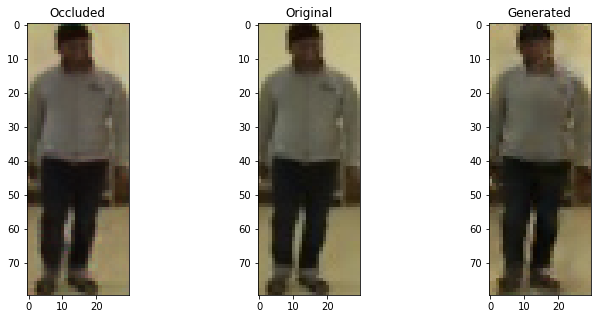

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


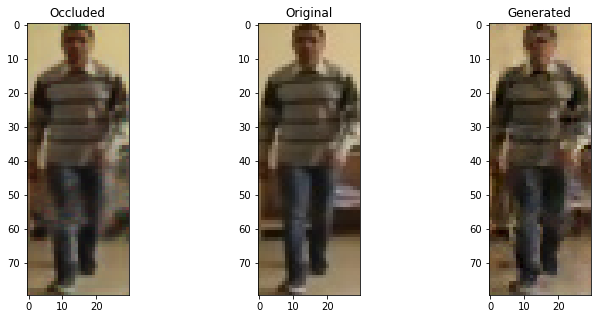

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


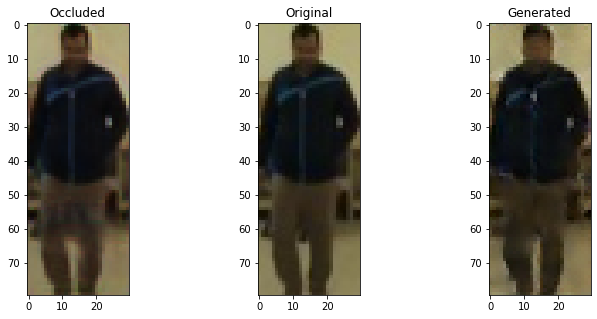

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


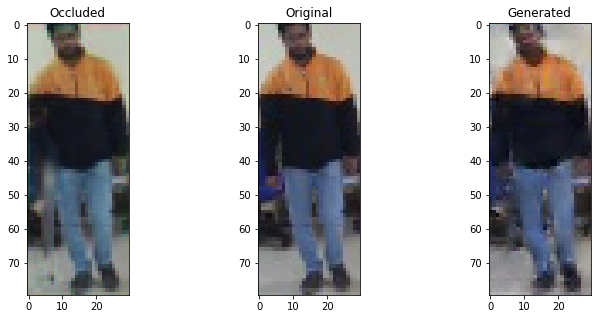

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


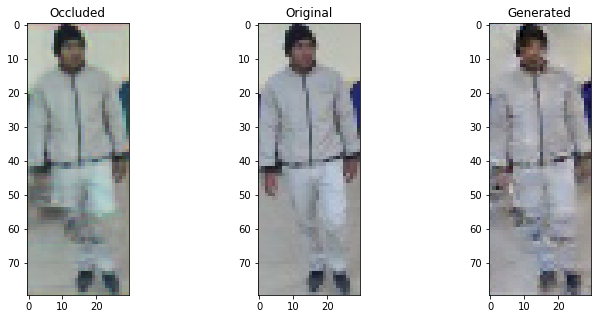

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6599162817001343 , Adversarial Loss:  0.0018489391077309847
Epoch 462


  8%|▊         | 1/13 [00:00<00:02,  5.23it/s]

Discriminator Loss:  0.6430525779724121 , Adversarial Loss:  0.0019374137045815587
Epoch 463


  8%|▊         | 1/13 [00:00<00:01,  6.61it/s]

Discriminator Loss:  0.6511870622634888 , Adversarial Loss:  0.0020031689200550318
Epoch 464


  8%|▊         | 1/13 [00:00<00:02,  5.81it/s]

Discriminator Loss:  0.6516816020011902 , Adversarial Loss:  0.001993420999497175
Epoch 465


  8%|▊         | 1/13 [00:00<00:01,  6.21it/s]

Discriminator Loss:  0.6543422341346741 , Adversarial Loss:  0.0016767310444265604
Epoch 466


  8%|▊         | 1/13 [00:00<00:01,  6.35it/s]

Discriminator Loss:  0.670142412185669 , Adversarial Loss:  0.0017458702204748988
Epoch 467


  8%|▊         | 1/13 [00:00<00:02,  5.96it/s]

Discriminator Loss:  0.6764014363288879 , Adversarial Loss:  0.0017727224621921778
Epoch 468


  8%|▊         | 1/13 [00:00<00:02,  5.90it/s]

Discriminator Loss:  0.6589505076408386 , Adversarial Loss:  0.0019937343895435333
Epoch 469


  8%|▊         | 1/13 [00:00<00:01,  6.54it/s]

Discriminator Loss:  0.6650255918502808 , Adversarial Loss:  0.0018548391526564956
Epoch 470


  8%|▊         | 1/13 [00:00<00:01,  6.43it/s]

Discriminator Loss:  0.6544171571731567 , Adversarial Loss:  0.0019267834722995758
Epoch 471


  8%|▊         | 1/13 [00:00<00:01,  6.18it/s]

Discriminator Loss:  0.6572237014770508 , Adversarial Loss:  0.0018562190234661102
Epoch 472


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6603955030441284 , Adversarial Loss:  0.001768395071849227
Epoch 473


  8%|▊         | 1/13 [00:00<00:01,  6.09it/s]

Discriminator Loss:  0.6663517951965332 , Adversarial Loss:  0.0018520005978643894
Epoch 474


  8%|▊         | 1/13 [00:00<00:01,  6.01it/s]

Discriminator Loss:  0.6631414890289307 , Adversarial Loss:  0.001859555603004992
Epoch 475


  8%|▊         | 1/13 [00:00<00:01,  6.06it/s]

Discriminator Loss:  0.6573981642723083 , Adversarial Loss:  0.0016497413162142038
Epoch 476


  8%|▊         | 1/13 [00:00<00:02,  5.98it/s]

Discriminator Loss:  0.6621403694152832 , Adversarial Loss:  0.0017515707295387983
Epoch 477


  8%|▊         | 1/13 [00:00<00:01,  6.77it/s]

Discriminator Loss:  0.6487210392951965 , Adversarial Loss:  0.0018547314684838057
Epoch 478


  8%|▊         | 1/13 [00:00<00:02,  5.28it/s]

Discriminator Loss:  0.6447259783744812 , Adversarial Loss:  0.0016969675198197365
Epoch 479


  8%|▊         | 1/13 [00:00<00:01,  6.82it/s]

Discriminator Loss:  0.6541966199874878 , Adversarial Loss:  0.0018378389067947865
Epoch 480


  8%|▊         | 1/13 [00:00<00:01,  6.37it/s]

Discriminator Loss:  0.6745625138282776 , Adversarial Loss:  0.001755541656166315
Epoch 481


100%|██████████| 13/13 [00:01<00:00,  6.57it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


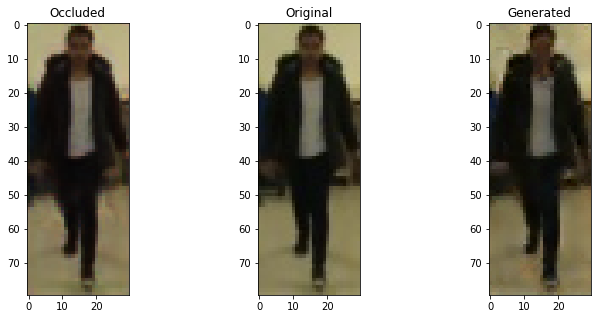

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


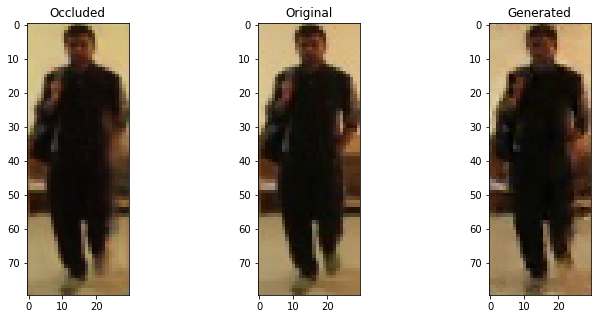

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


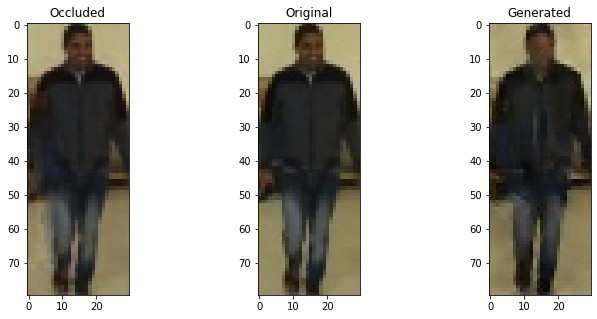

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


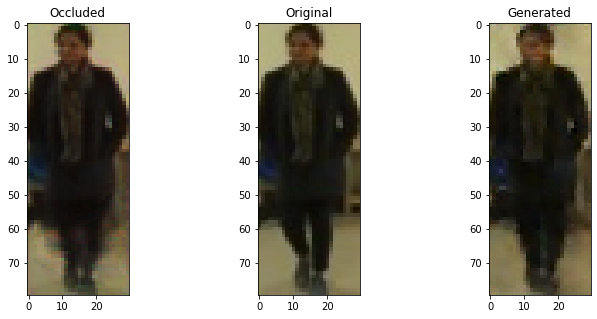

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


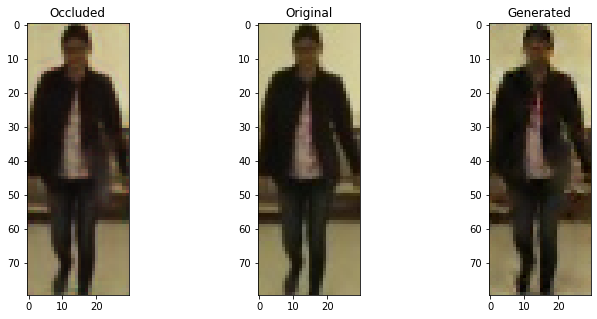

  8%|▊         | 1/13 [00:00<00:02,  5.62it/s]

Discriminator Loss:  0.6619144678115845 , Adversarial Loss:  0.0018419311381876469
Epoch 482


  8%|▊         | 1/13 [00:00<00:02,  5.29it/s]

Discriminator Loss:  0.6543664336204529 , Adversarial Loss:  0.001694555627182126
Epoch 483


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6598019599914551 , Adversarial Loss:  0.001678199041634798
Epoch 484


  8%|▊         | 1/13 [00:00<00:01,  6.70it/s]

Discriminator Loss:  0.6203641891479492 , Adversarial Loss:  0.0017289838287979364
Epoch 485


  8%|▊         | 1/13 [00:00<00:01,  6.22it/s]

Discriminator Loss:  0.6751887202262878 , Adversarial Loss:  0.001720222644507885
Epoch 486


  8%|▊         | 1/13 [00:00<00:01,  6.78it/s]

Discriminator Loss:  0.6615450978279114 , Adversarial Loss:  0.0015745371347293258
Epoch 487


  8%|▊         | 1/13 [00:00<00:01,  7.07it/s]

Discriminator Loss:  0.6495729684829712 , Adversarial Loss:  0.0017663214821368456
Epoch 488


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6638787388801575 , Adversarial Loss:  0.0017768449615687132
Epoch 489


  8%|▊         | 1/13 [00:00<00:01,  7.14it/s]

Discriminator Loss:  0.6596431732177734 , Adversarial Loss:  0.0016179531812667847
Epoch 490


  8%|▊         | 1/13 [00:00<00:01,  6.51it/s]

Discriminator Loss:  0.6521003246307373 , Adversarial Loss:  0.001677221618592739
Epoch 491


  8%|▊         | 1/13 [00:00<00:01,  6.90it/s]

Discriminator Loss:  0.6275339126586914 , Adversarial Loss:  0.0016228295862674713
Epoch 492


  8%|▊         | 1/13 [00:00<00:01,  6.88it/s]

Discriminator Loss:  0.6608344316482544 , Adversarial Loss:  0.0017593069933354855
Epoch 493


  8%|▊         | 1/13 [00:00<00:01,  6.21it/s]

Discriminator Loss:  0.6528126001358032 , Adversarial Loss:  0.001726603601127863
Epoch 494


  8%|▊         | 1/13 [00:00<00:01,  6.37it/s]

Discriminator Loss:  0.6658845543861389 , Adversarial Loss:  0.0016261613927781582
Epoch 495


  8%|▊         | 1/13 [00:00<00:01,  6.18it/s]

Discriminator Loss:  0.6274667978286743 , Adversarial Loss:  0.001639948459342122
Epoch 496


  8%|▊         | 1/13 [00:00<00:01,  6.01it/s]

Discriminator Loss:  0.646196722984314 , Adversarial Loss:  0.0016279751434922218
Epoch 497


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6727408170700073 , Adversarial Loss:  0.0016278964467346668
Epoch 498


  8%|▊         | 1/13 [00:00<00:01,  6.84it/s]

Discriminator Loss:  0.6425115466117859 , Adversarial Loss:  0.0015234749298542738
Epoch 499


  8%|▊         | 1/13 [00:00<00:01,  6.90it/s]

Discriminator Loss:  0.660223126411438 , Adversarial Loss:  0.0016902388306334615
Epoch 500


  8%|▊         | 1/13 [00:00<00:01,  6.37it/s]

Discriminator Loss:  0.6758360266685486 , Adversarial Loss:  0.001660906127654016
Epoch 501


100%|██████████| 13/13 [00:02<00:00,  6.31it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


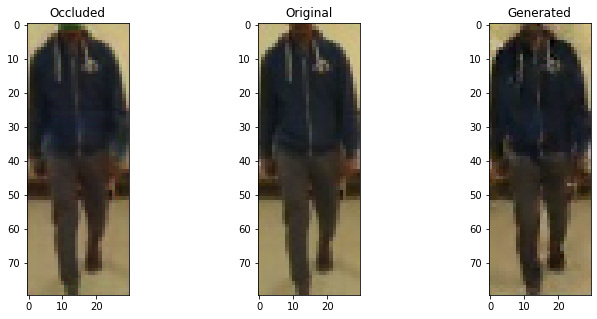

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


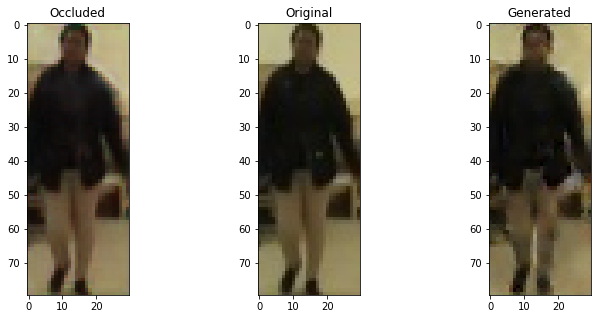

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


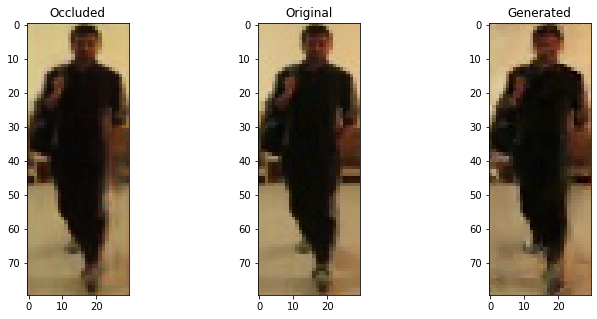

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


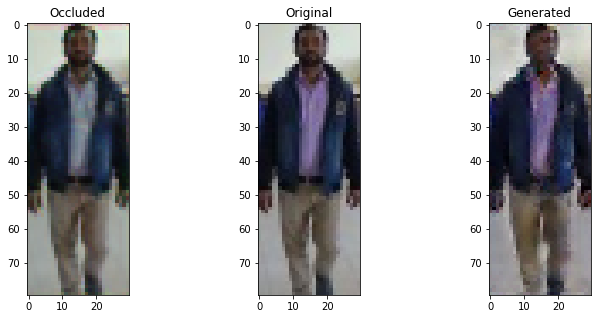

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


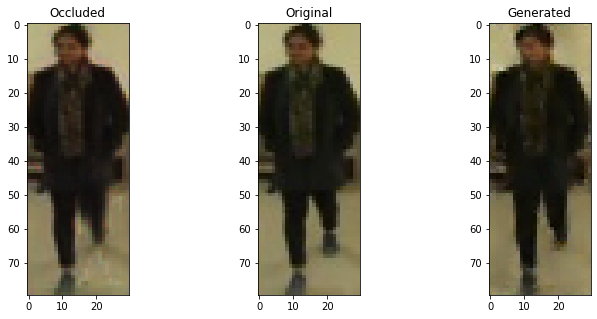

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6569216251373291 , Adversarial Loss:  0.0017472740728408098
Epoch 502


  8%|▊         | 1/13 [00:00<00:02,  5.25it/s]

Discriminator Loss:  0.6503594517707825 , Adversarial Loss:  0.00184422149322927
Epoch 503


  8%|▊         | 1/13 [00:00<00:01,  6.45it/s]

Discriminator Loss:  0.6626213192939758 , Adversarial Loss:  0.0016580814262852073
Epoch 504


  8%|▊         | 1/13 [00:00<00:01,  6.83it/s]

Discriminator Loss:  0.6584030389785767 , Adversarial Loss:  0.0017323727952316403
Epoch 505


  8%|▊         | 1/13 [00:00<00:01,  6.83it/s]

Discriminator Loss:  0.6706369519233704 , Adversarial Loss:  0.0016587371937930584
Epoch 506


  8%|▊         | 1/13 [00:00<00:01,  6.92it/s]

Discriminator Loss:  0.6582173705101013 , Adversarial Loss:  0.0016327020712196827
Epoch 507


  8%|▊         | 1/13 [00:00<00:01,  6.79it/s]

Discriminator Loss:  0.678019106388092 , Adversarial Loss:  0.0016882987692952156
Epoch 508


  8%|▊         | 1/13 [00:00<00:01,  6.60it/s]

Discriminator Loss:  0.6540131568908691 , Adversarial Loss:  0.001696842722594738
Epoch 509


  8%|▊         | 1/13 [00:00<00:02,  5.98it/s]

Discriminator Loss:  0.6726853847503662 , Adversarial Loss:  0.001443161047063768
Epoch 510


  8%|▊         | 1/13 [00:00<00:01,  6.48it/s]

Discriminator Loss:  0.6465729475021362 , Adversarial Loss:  0.001643902389332652
Epoch 511


  8%|▊         | 1/13 [00:00<00:01,  6.47it/s]

Discriminator Loss:  0.6748683452606201 , Adversarial Loss:  0.0014024697011336684
Epoch 512


  8%|▊         | 1/13 [00:00<00:01,  6.44it/s]

Discriminator Loss:  0.6701549887657166 , Adversarial Loss:  0.001526715699583292
Epoch 513


  8%|▊         | 1/13 [00:00<00:01,  6.60it/s]

Discriminator Loss:  0.6537109017372131 , Adversarial Loss:  0.0014947270974516869
Epoch 514


  8%|▊         | 1/13 [00:00<00:01,  6.97it/s]

Discriminator Loss:  0.6796517968177795 , Adversarial Loss:  0.0016714278608560562
Epoch 515


  8%|▊         | 1/13 [00:00<00:02,  5.78it/s]

Discriminator Loss:  0.6530730128288269 , Adversarial Loss:  0.0015971856191754341
Epoch 516


  8%|▊         | 1/13 [00:00<00:01,  6.85it/s]

Discriminator Loss:  0.6470357179641724 , Adversarial Loss:  0.0016357610002160072
Epoch 517


  8%|▊         | 1/13 [00:00<00:02,  5.17it/s]

Discriminator Loss:  0.6704829335212708 , Adversarial Loss:  0.0015684704994782805
Epoch 518


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.669587254524231 , Adversarial Loss:  0.0016077824402600527
Epoch 519


  8%|▊         | 1/13 [00:00<00:01,  6.30it/s]

Discriminator Loss:  0.6494684219360352 , Adversarial Loss:  0.0015412983484566212
Epoch 520


  8%|▊         | 1/13 [00:00<00:02,  5.16it/s]

Discriminator Loss:  0.664279580116272 , Adversarial Loss:  0.0018109085503965616
Epoch 521


100%|██████████| 13/13 [00:02<00:00,  5.80it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


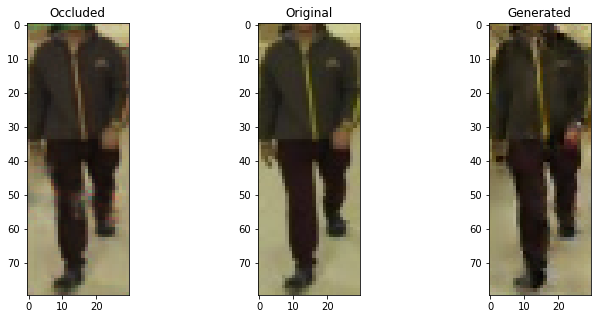

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


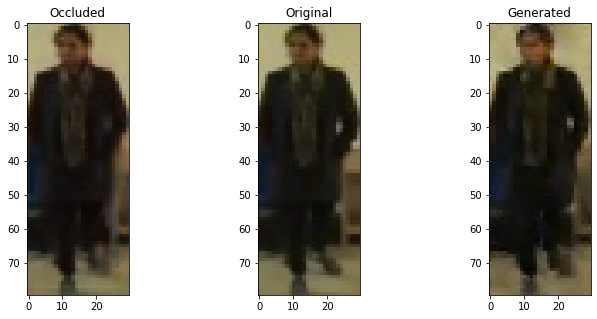

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


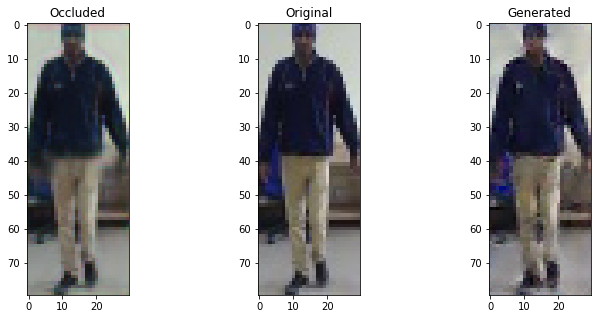

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


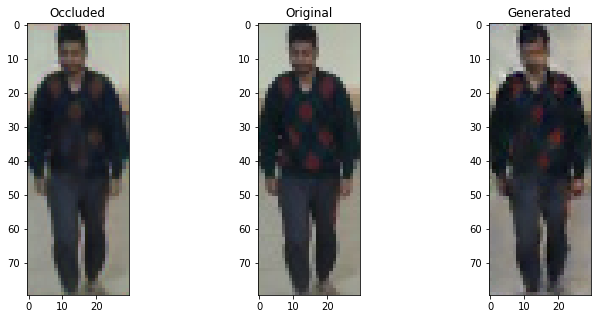

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


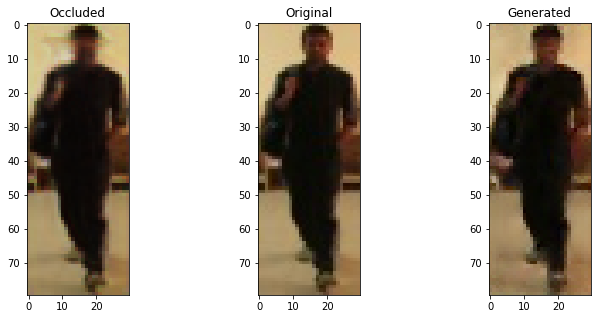

  8%|▊         | 1/13 [00:00<00:02,  5.34it/s]

Discriminator Loss:  0.6455616354942322 , Adversarial Loss:  0.0015758114168420434
Epoch 522


  8%|▊         | 1/13 [00:00<00:01,  6.55it/s]

Discriminator Loss:  0.6449798941612244 , Adversarial Loss:  0.0016805145423859358
Epoch 523


  8%|▊         | 1/13 [00:00<00:01,  6.41it/s]

Discriminator Loss:  0.67335045337677 , Adversarial Loss:  0.0015375541988760233
Epoch 524


  8%|▊         | 1/13 [00:00<00:02,  5.34it/s]

Discriminator Loss:  0.682713508605957 , Adversarial Loss:  0.0016913027502596378
Epoch 525


  8%|▊         | 1/13 [00:00<00:01,  6.98it/s]

Discriminator Loss:  0.6817414164543152 , Adversarial Loss:  0.0014750971458852291
Epoch 526


  8%|▊         | 1/13 [00:00<00:01,  6.20it/s]

Discriminator Loss:  0.6558827757835388 , Adversarial Loss:  0.0015648340340703726
Epoch 527


  8%|▊         | 1/13 [00:00<00:01,  6.29it/s]

Discriminator Loss:  0.6776403784751892 , Adversarial Loss:  0.0015287685673683882
Epoch 528


  8%|▊         | 1/13 [00:00<00:01,  6.27it/s]

Discriminator Loss:  0.6680065393447876 , Adversarial Loss:  0.0016740835271775723
Epoch 529


  8%|▊         | 1/13 [00:00<00:01,  6.48it/s]

Discriminator Loss:  0.6676216721534729 , Adversarial Loss:  0.0015117250150069594
Epoch 530


  8%|▊         | 1/13 [00:00<00:01,  6.80it/s]

Discriminator Loss:  0.6508617401123047 , Adversarial Loss:  0.0014851875603199005
Epoch 531


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6425508260726929 , Adversarial Loss:  0.0014515187358483672
Epoch 532


  8%|▊         | 1/13 [00:00<00:01,  6.50it/s]

Discriminator Loss:  0.6794345378875732 , Adversarial Loss:  0.0014657739084213972
Epoch 533


  8%|▊         | 1/13 [00:00<00:01,  6.23it/s]

Discriminator Loss:  0.6556370258331299 , Adversarial Loss:  0.001449859468266368
Epoch 534


  8%|▊         | 1/13 [00:00<00:01,  6.27it/s]

Discriminator Loss:  0.6364086866378784 , Adversarial Loss:  0.0014370116405189037
Epoch 535


  8%|▊         | 1/13 [00:00<00:02,  5.25it/s]

Discriminator Loss:  0.648827314376831 , Adversarial Loss:  0.0015763426199555397
Epoch 536


  8%|▊         | 1/13 [00:00<00:02,  5.27it/s]

Discriminator Loss:  0.6500371694564819 , Adversarial Loss:  0.0015676782932132483
Epoch 537


  8%|▊         | 1/13 [00:00<00:01,  7.15it/s]

Discriminator Loss:  0.6555665731430054 , Adversarial Loss:  0.0014822635566815734
Epoch 538


  8%|▊         | 1/13 [00:00<00:02,  5.99it/s]

Discriminator Loss:  0.6526635885238647 , Adversarial Loss:  0.0016312738880515099
Epoch 539


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6507682800292969 , Adversarial Loss:  0.0016089529963210225
Epoch 540


  8%|▊         | 1/13 [00:00<00:01,  6.54it/s]

Discriminator Loss:  0.6458577513694763 , Adversarial Loss:  0.0015809989999979734
Epoch 541


100%|██████████| 13/13 [00:02<00:00,  6.24it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


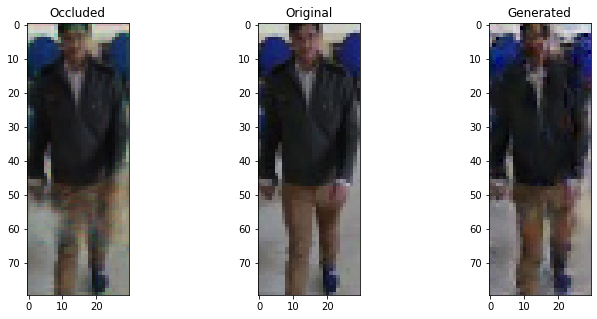

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


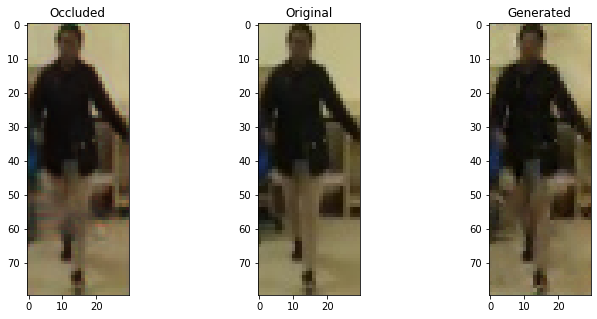

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


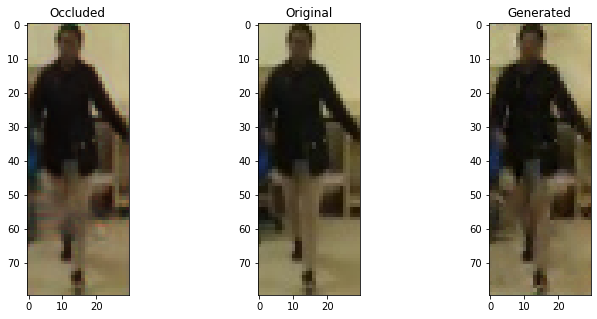

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


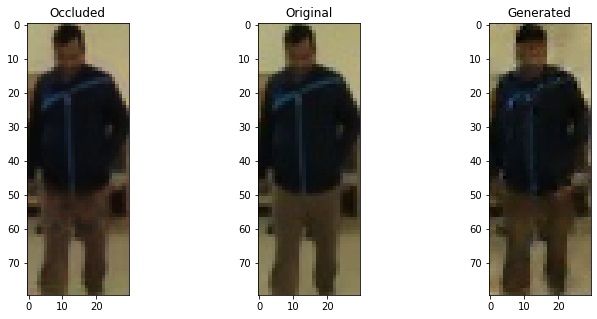

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


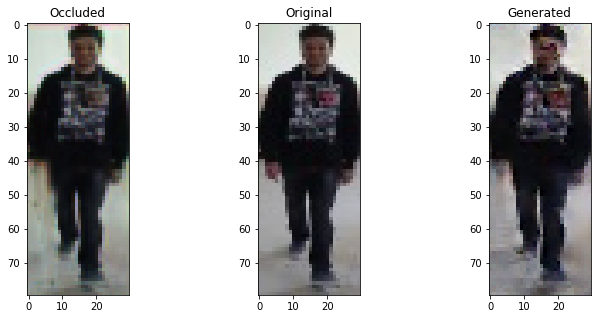

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6648443341255188 , Adversarial Loss:  0.001506609027273953
Epoch 542


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6644712090492249 , Adversarial Loss:  0.00149858882650733
Epoch 543


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6537481546401978 , Adversarial Loss:  0.001523714978247881
Epoch 544


  8%|▊         | 1/13 [00:00<00:02,  5.39it/s]

Discriminator Loss:  0.6712062358856201 , Adversarial Loss:  0.0014843468088656664
Epoch 545


  8%|▊         | 1/13 [00:00<00:01,  7.00it/s]

Discriminator Loss:  0.6701977252960205 , Adversarial Loss:  0.0013548252172768116
Epoch 546


  8%|▊         | 1/13 [00:00<00:01,  6.44it/s]

Discriminator Loss:  0.6768628358840942 , Adversarial Loss:  0.0015295881312340498
Epoch 547


  8%|▊         | 1/13 [00:00<00:01,  6.47it/s]

Discriminator Loss:  0.6661461591720581 , Adversarial Loss:  0.001525066327303648
Epoch 548


  8%|▊         | 1/13 [00:00<00:01,  6.40it/s]

Discriminator Loss:  0.6332297921180725 , Adversarial Loss:  0.0015403670258820057
Epoch 549


  8%|▊         | 1/13 [00:00<00:01,  6.63it/s]

Discriminator Loss:  0.6480280756950378 , Adversarial Loss:  0.0014636394334957004
Epoch 550


  8%|▊         | 1/13 [00:00<00:01,  6.96it/s]

Discriminator Loss:  0.6661444902420044 , Adversarial Loss:  0.0015199442859739065
Epoch 551


  8%|▊         | 1/13 [00:00<00:01,  6.02it/s]

Discriminator Loss:  0.6579631567001343 , Adversarial Loss:  0.001387682743370533
Epoch 552


  8%|▊         | 1/13 [00:00<00:01,  6.44it/s]

Discriminator Loss:  0.6665035486221313 , Adversarial Loss:  0.0015947584761306643
Epoch 553


  8%|▊         | 1/13 [00:00<00:01,  6.44it/s]

Discriminator Loss:  0.6379263401031494 , Adversarial Loss:  0.001635879511013627
Epoch 554


  8%|▊         | 1/13 [00:00<00:02,  5.17it/s]

Discriminator Loss:  0.6602919697761536 , Adversarial Loss:  0.0013545884285122156
Epoch 555


  8%|▊         | 1/13 [00:00<00:01,  6.74it/s]

Discriminator Loss:  0.6456607580184937 , Adversarial Loss:  0.001481778221204877
Epoch 556


  8%|▊         | 1/13 [00:00<00:01,  6.74it/s]

Discriminator Loss:  0.6470139026641846 , Adversarial Loss:  0.001429685391485691
Epoch 557


  8%|▊         | 1/13 [00:00<00:02,  5.20it/s]

Discriminator Loss:  0.6671440601348877 , Adversarial Loss:  0.001414604252204299
Epoch 558


  8%|▊         | 1/13 [00:00<00:01,  7.01it/s]

Discriminator Loss:  0.6367997527122498 , Adversarial Loss:  0.0015091488603502512
Epoch 559


  8%|▊         | 1/13 [00:00<00:01,  6.30it/s]

Discriminator Loss:  0.6702730059623718 , Adversarial Loss:  0.0015979479067027569
Epoch 560


  8%|▊         | 1/13 [00:00<00:01,  6.09it/s]

Discriminator Loss:  0.6496222019195557 , Adversarial Loss:  0.001377128646709025
Epoch 561


100%|██████████| 13/13 [00:02<00:00,  5.98it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


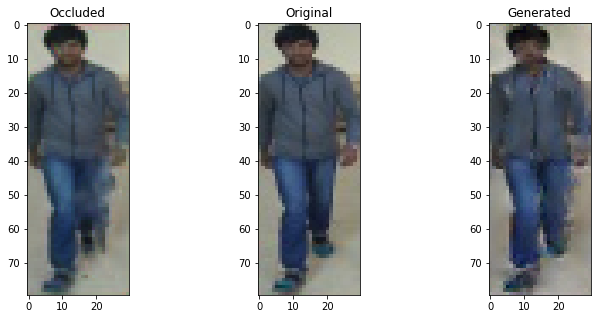

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


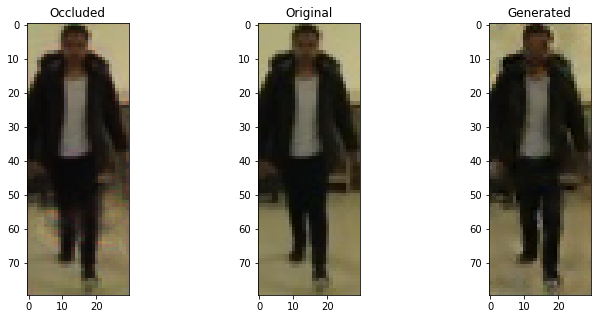

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


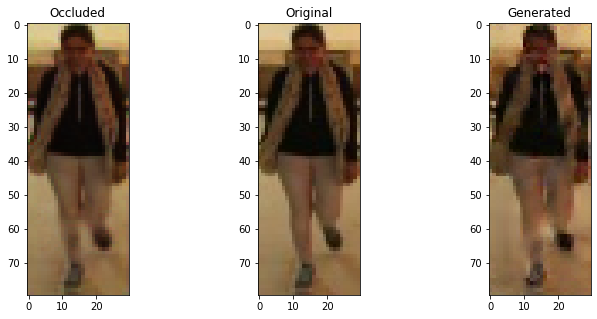

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


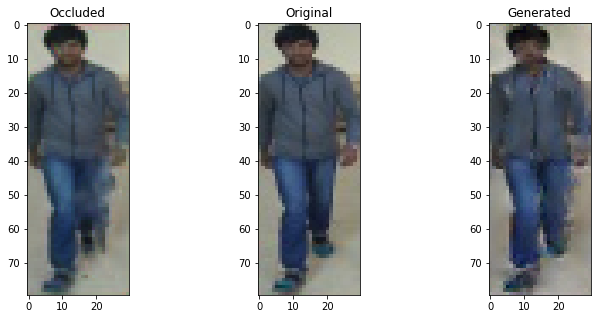

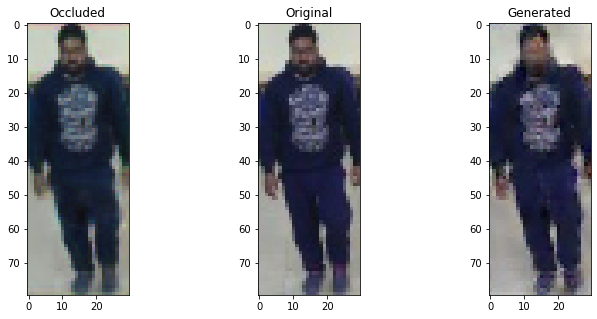

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6741455793380737 , Adversarial Loss:  0.0014840483199805021
Epoch 562


  8%|▊         | 1/13 [00:00<00:01,  6.43it/s]

Discriminator Loss:  0.6580377221107483 , Adversarial Loss:  0.0014720812905579805
Epoch 563


  8%|▊         | 1/13 [00:00<00:01,  6.65it/s]

Discriminator Loss:  0.6724980473518372 , Adversarial Loss:  0.0014578824630007148
Epoch 564


  8%|▊         | 1/13 [00:00<00:01,  7.07it/s]

Discriminator Loss:  0.6746286153793335 , Adversarial Loss:  0.0014816990587860346
Epoch 565


  8%|▊         | 1/13 [00:00<00:01,  6.60it/s]

Discriminator Loss:  0.6706554293632507 , Adversarial Loss:  0.0014515621587634087
Epoch 566


  8%|▊         | 1/13 [00:00<00:02,  5.97it/s]

Discriminator Loss:  0.6398431062698364 , Adversarial Loss:  0.0016035183798521757
Epoch 567


  8%|▊         | 1/13 [00:00<00:01,  6.21it/s]

Discriminator Loss:  0.6483639478683472 , Adversarial Loss:  0.00167377560865134
Epoch 568


  8%|▊         | 1/13 [00:00<00:01,  6.33it/s]

Discriminator Loss:  0.6730375289916992 , Adversarial Loss:  0.0014031457249075174
Epoch 569


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6582467555999756 , Adversarial Loss:  0.0014154944801703095
Epoch 570


  8%|▊         | 1/13 [00:00<00:02,  5.40it/s]

Discriminator Loss:  0.6439282894134521 , Adversarial Loss:  0.0013813655823469162
Epoch 571


  8%|▊         | 1/13 [00:00<00:02,  5.93it/s]

Discriminator Loss:  0.6310884952545166 , Adversarial Loss:  0.001425834489054978
Epoch 572


  8%|▊         | 1/13 [00:00<00:02,  5.16it/s]

Discriminator Loss:  0.6697597503662109 , Adversarial Loss:  0.0013541086809709668
Epoch 573


  8%|▊         | 1/13 [00:00<00:01,  6.33it/s]

Discriminator Loss:  0.6522802114486694 , Adversarial Loss:  0.001472393749281764
Epoch 574


  8%|▊         | 1/13 [00:00<00:01,  6.92it/s]

Discriminator Loss:  0.6476582884788513 , Adversarial Loss:  0.0013888326939195395
Epoch 575


  8%|▊         | 1/13 [00:00<00:02,  5.97it/s]

Discriminator Loss:  0.638224184513092 , Adversarial Loss:  0.0015100707532837987
Epoch 576


  8%|▊         | 1/13 [00:00<00:02,  5.86it/s]

Discriminator Loss:  0.6827758550643921 , Adversarial Loss:  0.001426432398147881
Epoch 577


  8%|▊         | 1/13 [00:00<00:01,  6.40it/s]

Discriminator Loss:  0.6509976983070374 , Adversarial Loss:  0.0014218188589438796
Epoch 578


  8%|▊         | 1/13 [00:00<00:01,  6.10it/s]

Discriminator Loss:  0.6780376434326172 , Adversarial Loss:  0.0014831074513494968
Epoch 579


  8%|▊         | 1/13 [00:00<00:01,  7.08it/s]

Discriminator Loss:  0.670897364616394 , Adversarial Loss:  0.0013927518157288432
Epoch 580


  8%|▊         | 1/13 [00:00<00:02,  5.40it/s]

Discriminator Loss:  0.6506595015525818 , Adversarial Loss:  0.0015115157002583146
Epoch 581


100%|██████████| 13/13 [00:02<00:00,  6.23it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


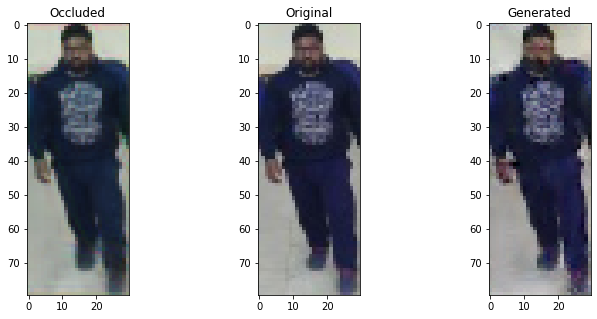

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


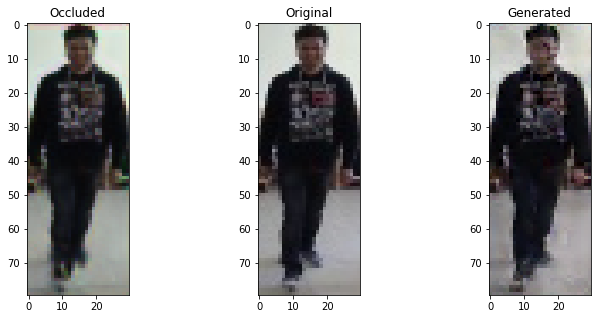

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


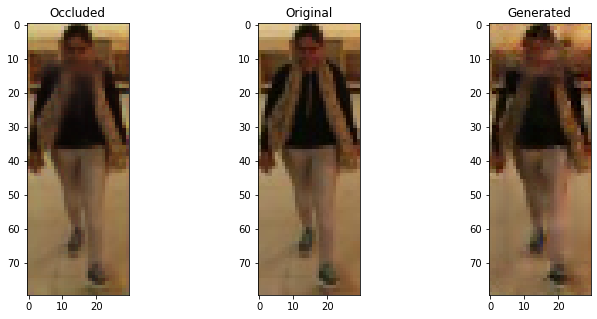

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


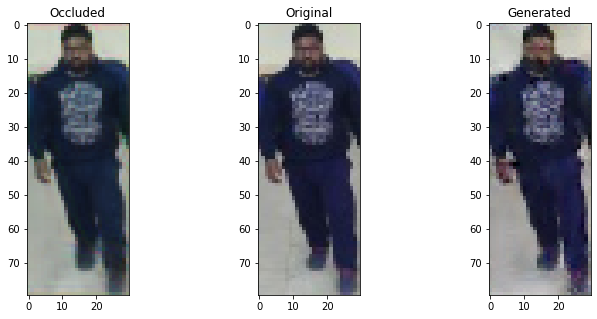

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


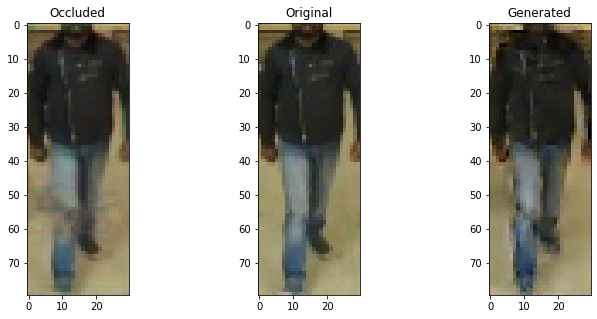

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.661833643913269 , Adversarial Loss:  0.0014019027585163713
Epoch 582


  8%|▊         | 1/13 [00:00<00:01,  6.57it/s]

Discriminator Loss:  0.6632034778594971 , Adversarial Loss:  0.0014262350741773844
Epoch 583


  8%|▊         | 1/13 [00:00<00:01,  6.85it/s]

Discriminator Loss:  0.648603081703186 , Adversarial Loss:  0.0013727269833907485
Epoch 584


  8%|▊         | 1/13 [00:00<00:01,  6.94it/s]

Discriminator Loss:  0.6472642421722412 , Adversarial Loss:  0.0014081349363550544
Epoch 585


  8%|▊         | 1/13 [00:00<00:01,  6.06it/s]

Discriminator Loss:  0.6608527898788452 , Adversarial Loss:  0.0013881940394639969
Epoch 586


  8%|▊         | 1/13 [00:00<00:02,  5.28it/s]

Discriminator Loss:  0.6364600658416748 , Adversarial Loss:  0.001340818009339273
Epoch 587


  8%|▊         | 1/13 [00:00<00:01,  6.71it/s]

Discriminator Loss:  0.6522383093833923 , Adversarial Loss:  0.0013907516840845346
Epoch 588


  8%|▊         | 1/13 [00:00<00:01,  6.54it/s]

Discriminator Loss:  0.6596075296401978 , Adversarial Loss:  0.0014850797597318888
Epoch 589


  8%|▊         | 1/13 [00:00<00:02,  5.12it/s]

Discriminator Loss:  0.6304940581321716 , Adversarial Loss:  0.0014177426928654313
Epoch 590


  8%|▊         | 1/13 [00:00<00:01,  6.48it/s]

Discriminator Loss:  0.6444342136383057 , Adversarial Loss:  0.0015838632825762033
Epoch 591


  8%|▊         | 1/13 [00:00<00:01,  6.80it/s]

Discriminator Loss:  0.6603459715843201 , Adversarial Loss:  0.0014314247528091073
Epoch 592


  8%|▊         | 1/13 [00:00<00:01,  6.65it/s]

Discriminator Loss:  0.6772177219390869 , Adversarial Loss:  0.0013791716191917658
Epoch 593


  8%|▊         | 1/13 [00:00<00:01,  6.86it/s]

Discriminator Loss:  0.6515594124794006 , Adversarial Loss:  0.0012831899803131819
Epoch 594


  8%|▊         | 1/13 [00:00<00:01,  6.51it/s]

Discriminator Loss:  0.6732789874076843 , Adversarial Loss:  0.0012859173584729433
Epoch 595


  8%|▊         | 1/13 [00:00<00:02,  5.98it/s]

Discriminator Loss:  0.6607836484909058 , Adversarial Loss:  0.001477339188568294
Epoch 596


  8%|▊         | 1/13 [00:00<00:01,  6.63it/s]

Discriminator Loss:  0.6571018695831299 , Adversarial Loss:  0.001422478468157351
Epoch 597


  8%|▊         | 1/13 [00:00<00:01,  6.35it/s]

Discriminator Loss:  0.6812883615493774 , Adversarial Loss:  0.0014162875013425946
Epoch 598


  8%|▊         | 1/13 [00:00<00:01,  6.71it/s]

Discriminator Loss:  0.6423122882843018 , Adversarial Loss:  0.0013251772616058588
Epoch 599


  8%|▊         | 1/13 [00:00<00:01,  6.29it/s]

Discriminator Loss:  0.6416948437690735 , Adversarial Loss:  0.0013592079048976302
Epoch 600


  8%|▊         | 1/13 [00:00<00:01,  6.81it/s]

Discriminator Loss:  0.6377938985824585 , Adversarial Loss:  0.0013231565244495869
Epoch 601


100%|██████████| 13/13 [00:02<00:00,  6.41it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


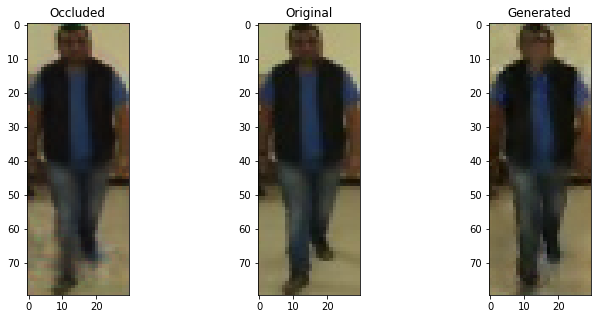

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


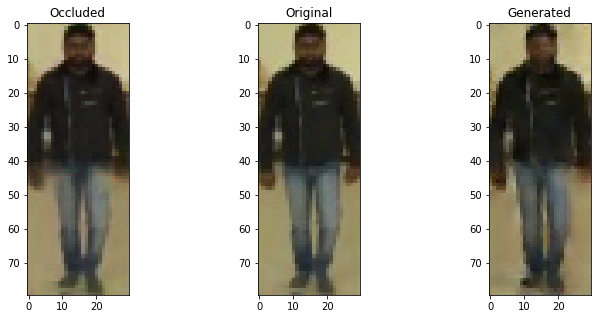

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


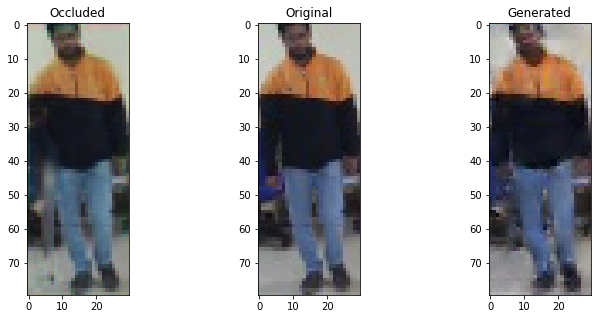

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


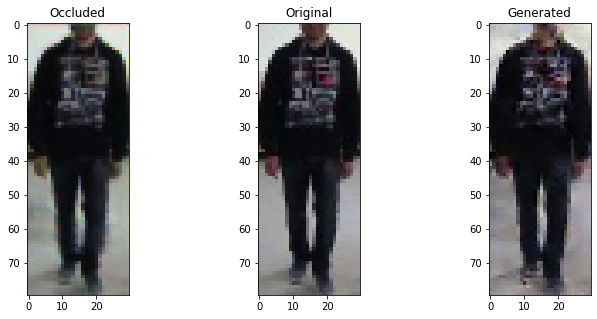

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


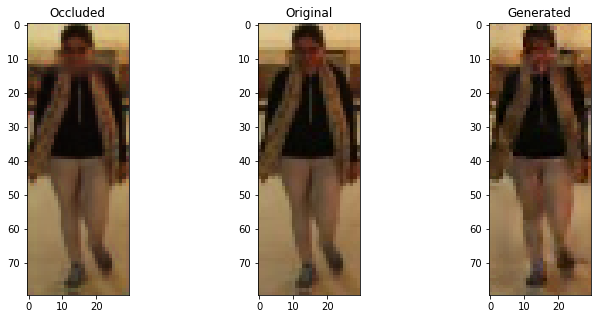

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6656578183174133 , Adversarial Loss:  0.0012646932154893875
Epoch 602


  8%|▊         | 1/13 [00:00<00:01,  6.01it/s]

Discriminator Loss:  0.6598217487335205 , Adversarial Loss:  0.0013761655427515507
Epoch 603


  8%|▊         | 1/13 [00:00<00:01,  6.55it/s]

Discriminator Loss:  0.6751524806022644 , Adversarial Loss:  0.0014738396275788546
Epoch 604


  8%|▊         | 1/13 [00:00<00:01,  6.73it/s]

Discriminator Loss:  0.6517486572265625 , Adversarial Loss:  0.001397439045831561
Epoch 605


  8%|▊         | 1/13 [00:00<00:02,  5.91it/s]

Discriminator Loss:  0.6248487234115601 , Adversarial Loss:  0.0013541211374104023
Epoch 606


  8%|▊         | 1/13 [00:00<00:01,  6.13it/s]

Discriminator Loss:  0.6453194618225098 , Adversarial Loss:  0.001346179866231978
Epoch 607


  8%|▊         | 1/13 [00:00<00:01,  6.34it/s]

Discriminator Loss:  0.685767650604248 , Adversarial Loss:  0.001557585084810853
Epoch 608


  8%|▊         | 1/13 [00:00<00:01,  6.49it/s]

Discriminator Loss:  0.6405786275863647 , Adversarial Loss:  0.0014032088220119476
Epoch 609


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6620486378669739 , Adversarial Loss:  0.0013410006649792194
Epoch 610


  8%|▊         | 1/13 [00:00<00:01,  6.85it/s]

Discriminator Loss:  0.6504969596862793 , Adversarial Loss:  0.0012506602797657251
Epoch 611


  8%|▊         | 1/13 [00:00<00:01,  6.27it/s]

Discriminator Loss:  0.68104487657547 , Adversarial Loss:  0.001352387829683721
Epoch 612


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.672418475151062 , Adversarial Loss:  0.0014130936469882727
Epoch 613


  8%|▊         | 1/13 [00:00<00:02,  5.66it/s]

Discriminator Loss:  0.6439623832702637 , Adversarial Loss:  0.0013318475103005767
Epoch 614


  8%|▊         | 1/13 [00:00<00:01,  6.37it/s]

Discriminator Loss:  0.6493451595306396 , Adversarial Loss:  0.0014034269843250513
Epoch 615


  8%|▊         | 1/13 [00:00<00:01,  6.59it/s]

Discriminator Loss:  0.6614478826522827 , Adversarial Loss:  0.0015519254375249147
Epoch 616


  8%|▊         | 1/13 [00:00<00:01,  6.80it/s]

Discriminator Loss:  0.6852105855941772 , Adversarial Loss:  0.0014004260301589966
Epoch 617


  8%|▊         | 1/13 [00:00<00:01,  6.52it/s]

Discriminator Loss:  0.6572214961051941 , Adversarial Loss:  0.0014657063875347376
Epoch 618


  8%|▊         | 1/13 [00:00<00:01,  6.81it/s]

Discriminator Loss:  0.6593695878982544 , Adversarial Loss:  0.0013909365516155958
Epoch 619


  8%|▊         | 1/13 [00:00<00:01,  6.39it/s]

Discriminator Loss:  0.6616354584693909 , Adversarial Loss:  0.0014267582446336746
Epoch 620


  8%|▊         | 1/13 [00:00<00:01,  6.74it/s]

Discriminator Loss:  0.6707331538200378 , Adversarial Loss:  0.0014141540741547942
Epoch 621


100%|██████████| 13/13 [00:02<00:00,  6.21it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


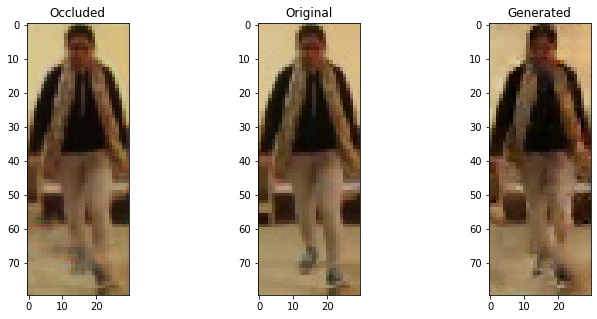

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


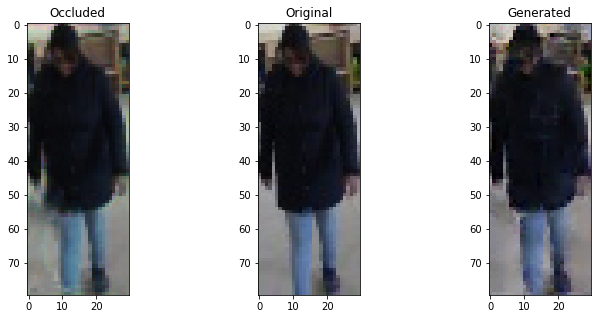

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


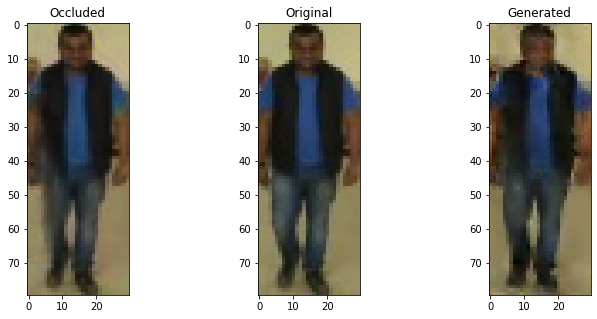

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


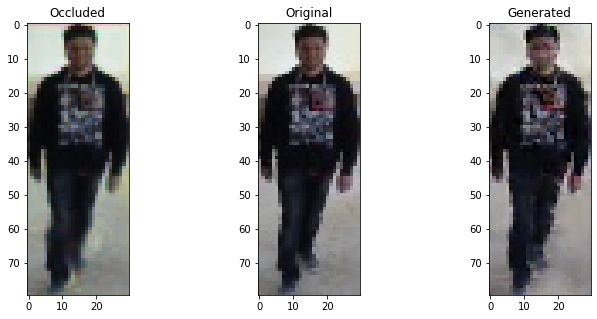

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


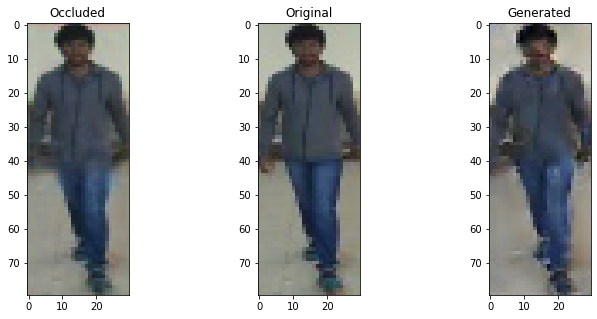

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6500488519668579 , Adversarial Loss:  0.0014577824622392654
Epoch 622


  8%|▊         | 1/13 [00:00<00:02,  5.17it/s]

Discriminator Loss:  0.6505365371704102 , Adversarial Loss:  0.001448293449357152
Epoch 623


  8%|▊         | 1/13 [00:00<00:01,  6.29it/s]

Discriminator Loss:  0.6801543235778809 , Adversarial Loss:  0.0012540395837277174
Epoch 624


  8%|▊         | 1/13 [00:00<00:01,  6.49it/s]

Discriminator Loss:  0.6743914484977722 , Adversarial Loss:  0.0013249891344457865
Epoch 625


  8%|▊         | 1/13 [00:00<00:01,  6.01it/s]

Discriminator Loss:  0.6507565975189209 , Adversarial Loss:  0.0013842033222317696
Epoch 626


  8%|▊         | 1/13 [00:00<00:01,  6.77it/s]

Discriminator Loss:  0.68184494972229 , Adversarial Loss:  0.0014443848049268126
Epoch 627


  8%|▊         | 1/13 [00:00<00:01,  6.71it/s]

Discriminator Loss:  0.6534227132797241 , Adversarial Loss:  0.0014812196604907513
Epoch 628


  8%|▊         | 1/13 [00:00<00:01,  6.11it/s]

Discriminator Loss:  0.6584439277648926 , Adversarial Loss:  0.0012855164241045713
Epoch 629


  8%|▊         | 1/13 [00:00<00:01,  6.31it/s]

Discriminator Loss:  0.6338666677474976 , Adversarial Loss:  0.001350313425064087
Epoch 630


  8%|▊         | 1/13 [00:00<00:01,  6.84it/s]

Discriminator Loss:  0.6717438697814941 , Adversarial Loss:  0.0012762860860675573
Epoch 631


  8%|▊         | 1/13 [00:00<00:01,  6.18it/s]

Discriminator Loss:  0.6907593607902527 , Adversarial Loss:  0.0014284646604210138
Epoch 632


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6574018001556396 , Adversarial Loss:  0.0013175528729334474
Epoch 633


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6477468013763428 , Adversarial Loss:  0.001283680205233395
Epoch 634


  8%|▊         | 1/13 [00:00<00:01,  6.60it/s]

Discriminator Loss:  0.6493635773658752 , Adversarial Loss:  0.001309097744524479
Epoch 635


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6497395038604736 , Adversarial Loss:  0.0013579435180872679
Epoch 636


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6500002145767212 , Adversarial Loss:  0.001333606312982738
Epoch 637


  8%|▊         | 1/13 [00:00<00:01,  6.57it/s]

Discriminator Loss:  0.6465747952461243 , Adversarial Loss:  0.0013478124747052789
Epoch 638


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6689344048500061 , Adversarial Loss:  0.0012416262179613113
Epoch 639


  8%|▊         | 1/13 [00:00<00:01,  6.47it/s]

Discriminator Loss:  0.6588493585586548 , Adversarial Loss:  0.001398542313836515
Epoch 640


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6724213361740112 , Adversarial Loss:  0.001388524891808629
Epoch 641


100%|██████████| 13/13 [00:02<00:00,  6.07it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


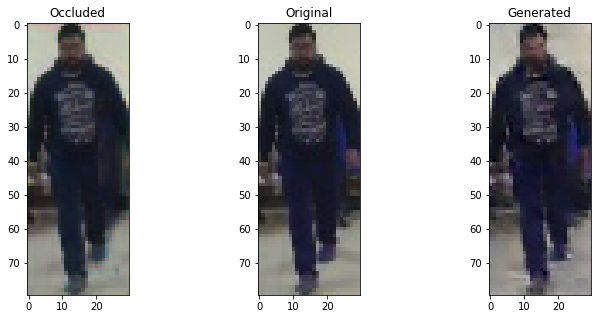

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


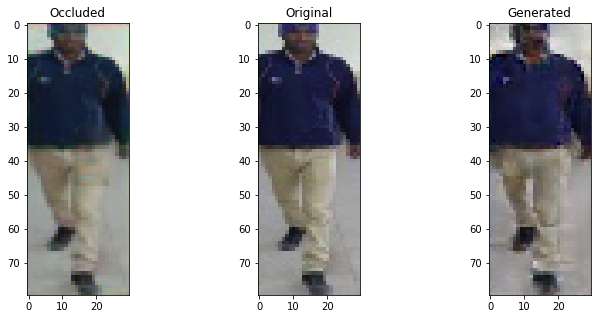

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


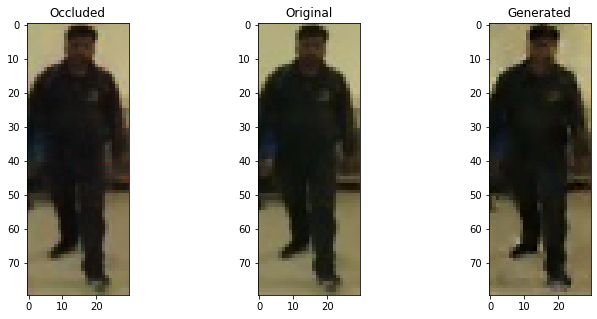

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


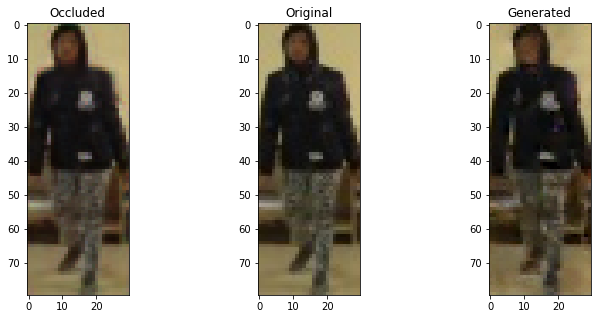

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


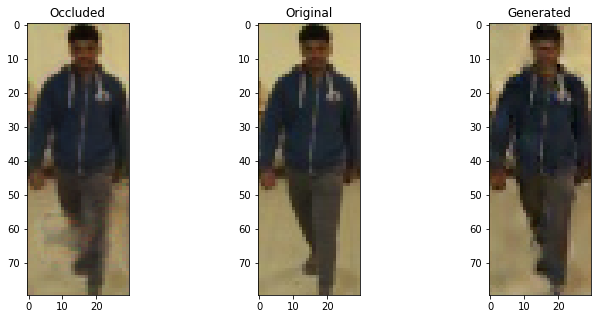

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6418739557266235 , Adversarial Loss:  0.0013774402905255556
Epoch 642


  8%|▊         | 1/13 [00:00<00:01,  6.47it/s]

Discriminator Loss:  0.6453790664672852 , Adversarial Loss:  0.001237112912349403
Epoch 643


  8%|▊         | 1/13 [00:00<00:01,  6.63it/s]

Discriminator Loss:  0.6494337320327759 , Adversarial Loss:  0.0013026691740378737
Epoch 644


  8%|▊         | 1/13 [00:00<00:01,  6.34it/s]

Discriminator Loss:  0.6797058582305908 , Adversarial Loss:  0.001383903669193387
Epoch 645


  8%|▊         | 1/13 [00:00<00:01,  6.37it/s]

Discriminator Loss:  0.6555570363998413 , Adversarial Loss:  0.0014818550553172827
Epoch 646


  8%|▊         | 1/13 [00:00<00:01,  6.53it/s]

Discriminator Loss:  0.6449680924415588 , Adversarial Loss:  0.001337277120910585
Epoch 647


  8%|▊         | 1/13 [00:00<00:01,  6.73it/s]

Discriminator Loss:  0.6908262372016907 , Adversarial Loss:  0.0015754823107272387
Epoch 648


  8%|▊         | 1/13 [00:00<00:01,  6.16it/s]

Discriminator Loss:  0.6220115423202515 , Adversarial Loss:  0.0014457248616963625
Epoch 649


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6767191290855408 , Adversarial Loss:  0.0013353023678064346
Epoch 650


  8%|▊         | 1/13 [00:00<00:02,  5.90it/s]

Discriminator Loss:  0.6639281511306763 , Adversarial Loss:  0.0012879115529358387
Epoch 651


  8%|▊         | 1/13 [00:00<00:02,  5.89it/s]

Discriminator Loss:  0.6739880442619324 , Adversarial Loss:  0.001240305369719863
Epoch 652


  8%|▊         | 1/13 [00:00<00:01,  6.83it/s]

Discriminator Loss:  0.6369560956954956 , Adversarial Loss:  0.0012329363962635398
Epoch 653


  8%|▊         | 1/13 [00:00<00:01,  6.45it/s]

Discriminator Loss:  0.6800597906112671 , Adversarial Loss:  0.0013172904727980494
Epoch 654


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6571981906890869 , Adversarial Loss:  0.001260631950572133
Epoch 655


  8%|▊         | 1/13 [00:00<00:01,  6.44it/s]

Discriminator Loss:  0.6666617393493652 , Adversarial Loss:  0.0013911828864365816
Epoch 656


  8%|▊         | 1/13 [00:00<00:01,  6.46it/s]

Discriminator Loss:  0.6490996479988098 , Adversarial Loss:  0.0012645155657082796
Epoch 657


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6590297222137451 , Adversarial Loss:  0.0013947989791631699
Epoch 658


  8%|▊         | 1/13 [00:00<00:01,  6.18it/s]

Discriminator Loss:  0.6195682287216187 , Adversarial Loss:  0.0012588625540956855
Epoch 659


  8%|▊         | 1/13 [00:00<00:02,  4.99it/s]

Discriminator Loss:  0.6835371851921082 , Adversarial Loss:  0.0012666062684729695
Epoch 660


  8%|▊         | 1/13 [00:00<00:02,  5.18it/s]

Discriminator Loss:  0.6549652218818665 , Adversarial Loss:  0.0013530869036912918
Epoch 661


100%|██████████| 13/13 [00:02<00:00,  6.13it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


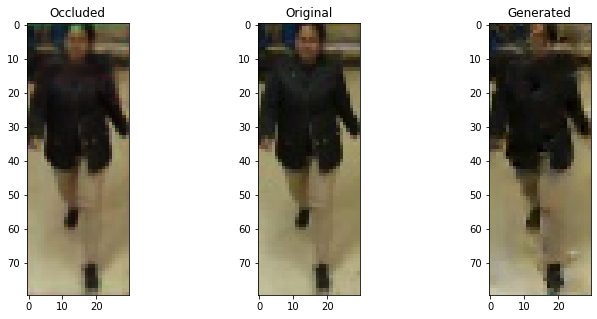

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


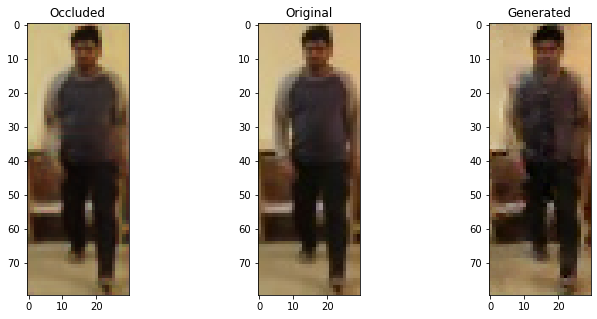

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


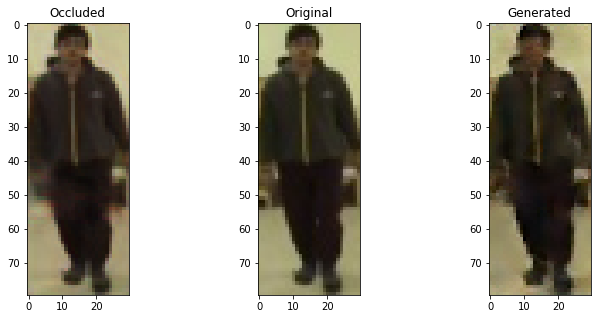

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


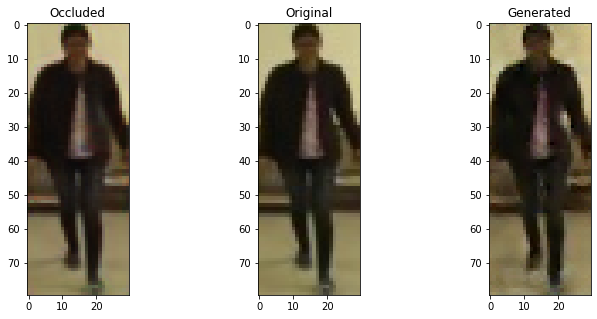

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


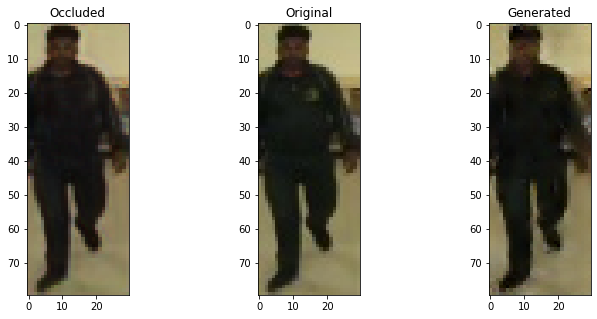

  8%|▊         | 1/13 [00:00<00:02,  5.42it/s]

Discriminator Loss:  0.651665449142456 , Adversarial Loss:  0.0014169967034831643
Epoch 662


  8%|▊         | 1/13 [00:00<00:01,  6.46it/s]

Discriminator Loss:  0.6603763103485107 , Adversarial Loss:  0.0012271481100469828
Epoch 663


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6364974975585938 , Adversarial Loss:  0.0013602122198790312
Epoch 664


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6521440148353577 , Adversarial Loss:  0.0012423881562426686
Epoch 665


  8%|▊         | 1/13 [00:00<00:01,  6.24it/s]

Discriminator Loss:  0.6909129619598389 , Adversarial Loss:  0.0012912980746477842
Epoch 666


  8%|▊         | 1/13 [00:00<00:01,  6.63it/s]

Discriminator Loss:  0.654733419418335 , Adversarial Loss:  0.001275456976145506
Epoch 667


  8%|▊         | 1/13 [00:00<00:02,  5.23it/s]

Discriminator Loss:  0.6676899790763855 , Adversarial Loss:  0.0013240394182503223
Epoch 668


  8%|▊         | 1/13 [00:00<00:01,  6.55it/s]

Discriminator Loss:  0.6504215002059937 , Adversarial Loss:  0.0012531701941043139
Epoch 669


  8%|▊         | 1/13 [00:00<00:01,  6.17it/s]

Discriminator Loss:  0.6344435214996338 , Adversarial Loss:  0.0012622919166460633
Epoch 670


  8%|▊         | 1/13 [00:00<00:01,  6.35it/s]

Discriminator Loss:  0.6645940542221069 , Adversarial Loss:  0.0011948138708248734
Epoch 671


  8%|▊         | 1/13 [00:00<00:01,  6.56it/s]

Discriminator Loss:  0.6840030550956726 , Adversarial Loss:  0.0011730855330824852
Epoch 672


  8%|▊         | 1/13 [00:00<00:01,  6.66it/s]

Discriminator Loss:  0.664783239364624 , Adversarial Loss:  0.001366351032629609
Epoch 673


  8%|▊         | 1/13 [00:00<00:01,  6.91it/s]

Discriminator Loss:  0.6492929458618164 , Adversarial Loss:  0.0012639318592846394
Epoch 674


  8%|▊         | 1/13 [00:00<00:01,  6.42it/s]

Discriminator Loss:  0.6572421789169312 , Adversarial Loss:  0.0010991832241415977
Epoch 675


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6585067510604858 , Adversarial Loss:  0.0013010563561692834
Epoch 676


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.66837477684021 , Adversarial Loss:  0.0013864694628864527
Epoch 677


  8%|▊         | 1/13 [00:00<00:01,  6.55it/s]

Discriminator Loss:  0.6635921001434326 , Adversarial Loss:  0.001240031560882926
Epoch 678


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6567701101303101 , Adversarial Loss:  0.0012405654415488243
Epoch 679


  8%|▊         | 1/13 [00:00<00:01,  6.03it/s]

Discriminator Loss:  0.6490464806556702 , Adversarial Loss:  0.0012885772157460451
Epoch 680


  8%|▊         | 1/13 [00:00<00:01,  6.61it/s]

Discriminator Loss:  0.651465892791748 , Adversarial Loss:  0.00123848847579211
Epoch 681


100%|██████████| 13/13 [00:02<00:00,  6.09it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


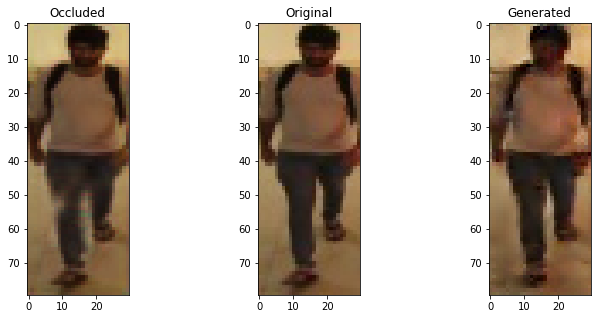

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


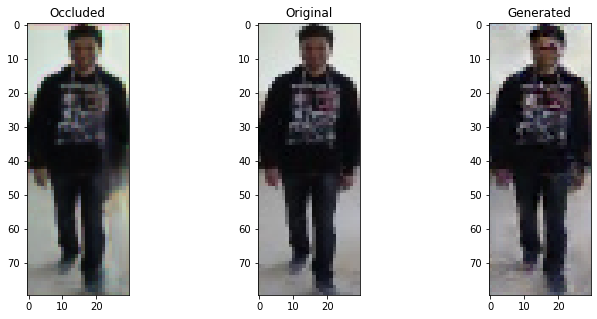

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


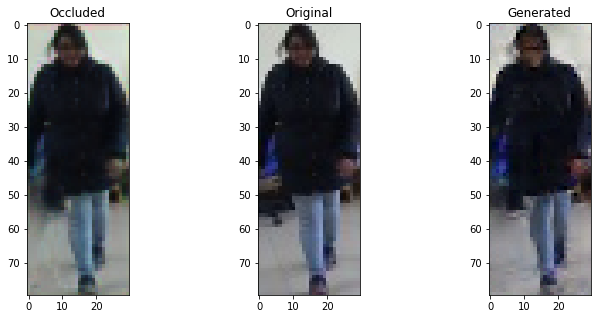

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


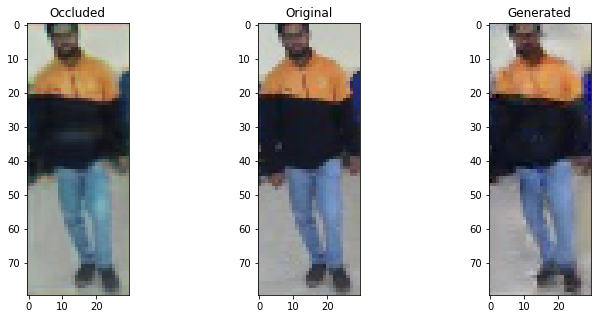

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


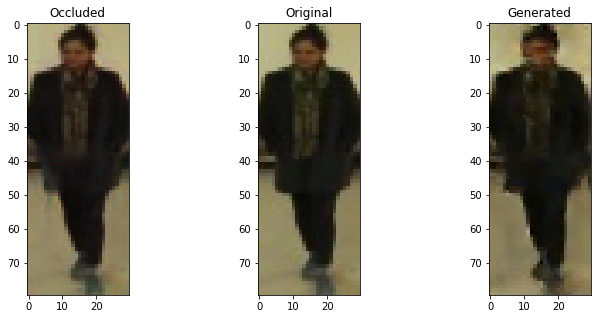

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6599076986312866 , Adversarial Loss:  0.0012189692351967096
Epoch 682


  8%|▊         | 1/13 [00:00<00:01,  6.71it/s]

Discriminator Loss:  0.6651245355606079 , Adversarial Loss:  0.0012005064636468887
Epoch 683


  8%|▊         | 1/13 [00:00<00:01,  6.57it/s]

Discriminator Loss:  0.6293143033981323 , Adversarial Loss:  0.001144235022366047
Epoch 684


  8%|▊         | 1/13 [00:00<00:01,  6.48it/s]

Discriminator Loss:  0.651089072227478 , Adversarial Loss:  0.0013933167792856693
Epoch 685


  8%|▊         | 1/13 [00:00<00:01,  6.45it/s]

Discriminator Loss:  0.6428517699241638 , Adversarial Loss:  0.0011767285177484155
Epoch 686


  8%|▊         | 1/13 [00:00<00:01,  6.22it/s]

Discriminator Loss:  0.6687237620353699 , Adversarial Loss:  0.001236630487255752
Epoch 687


  8%|▊         | 1/13 [00:00<00:01,  6.79it/s]

Discriminator Loss:  0.6429207921028137 , Adversarial Loss:  0.0012353787897154689
Epoch 688


  8%|▊         | 1/13 [00:00<00:01,  6.52it/s]

Discriminator Loss:  0.6497296094894409 , Adversarial Loss:  0.0012686668196693063
Epoch 689


  8%|▊         | 1/13 [00:00<00:02,  5.18it/s]

Discriminator Loss:  0.6685627698898315 , Adversarial Loss:  0.0012084176996722817
Epoch 690


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6700865030288696 , Adversarial Loss:  0.0011183080496266484
Epoch 691


  8%|▊         | 1/13 [00:00<00:01,  6.41it/s]

Discriminator Loss:  0.6467565298080444 , Adversarial Loss:  0.001174774719402194
Epoch 692


  8%|▊         | 1/13 [00:00<00:01,  6.30it/s]

Discriminator Loss:  0.6412168145179749 , Adversarial Loss:  0.001205960987135768
Epoch 693


  8%|▊         | 1/13 [00:00<00:01,  6.31it/s]

Discriminator Loss:  0.6418151259422302 , Adversarial Loss:  0.0011789726559072733
Epoch 694


  8%|▊         | 1/13 [00:00<00:01,  6.88it/s]

Discriminator Loss:  0.6686537265777588 , Adversarial Loss:  0.0012323572300374508
Epoch 695


  8%|▊         | 1/13 [00:00<00:02,  5.67it/s]

Discriminator Loss:  0.663659930229187 , Adversarial Loss:  0.0013055119197815657
Epoch 696


  8%|▊         | 1/13 [00:00<00:01,  6.52it/s]

Discriminator Loss:  0.6474244594573975 , Adversarial Loss:  0.0011693208944052458
Epoch 697


  8%|▊         | 1/13 [00:00<00:01,  6.47it/s]

Discriminator Loss:  0.6675645112991333 , Adversarial Loss:  0.0012943302281200886
Epoch 698


  8%|▊         | 1/13 [00:00<00:01,  6.14it/s]

Discriminator Loss:  0.6515432000160217 , Adversarial Loss:  0.0012759310193359852
Epoch 699


  8%|▊         | 1/13 [00:00<00:01,  6.07it/s]

Discriminator Loss:  0.6404227614402771 , Adversarial Loss:  0.001116700004786253
Epoch 700


  8%|▊         | 1/13 [00:00<00:02,  5.06it/s]

Discriminator Loss:  0.6848464012145996 , Adversarial Loss:  0.001271833200007677
Epoch 701


100%|██████████| 13/13 [00:02<00:00,  5.90it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


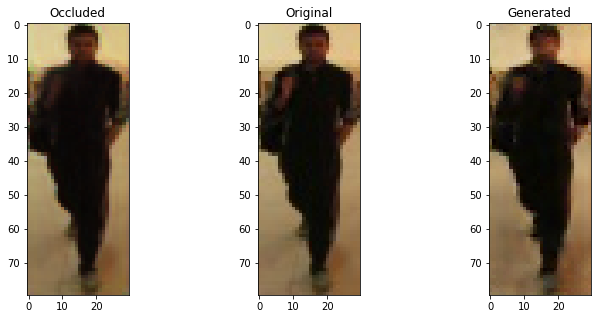

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


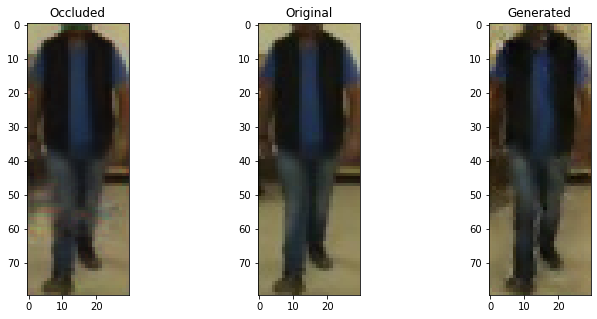

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


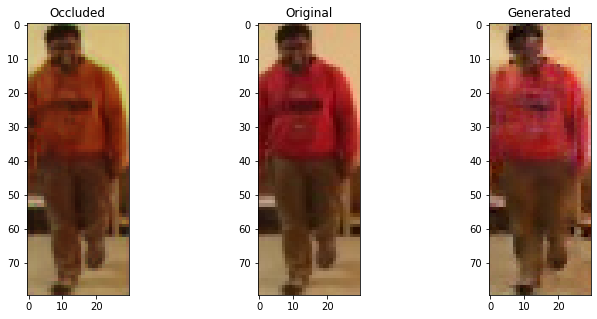

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


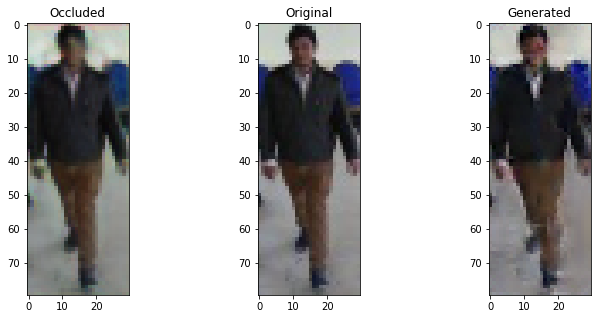

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


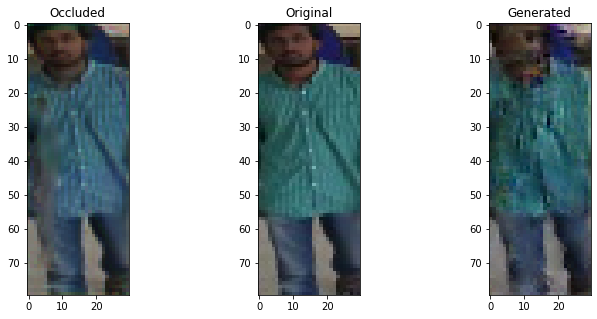

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6568922400474548 , Adversarial Loss:  0.0011130479397252202
Epoch 702


  8%|▊         | 1/13 [00:00<00:01,  6.76it/s]

Discriminator Loss:  0.6541736125946045 , Adversarial Loss:  0.0012048782082274556
Epoch 703


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6577445268630981 , Adversarial Loss:  0.0012621693313121796
Epoch 704


  8%|▊         | 1/13 [00:00<00:02,  5.04it/s]

Discriminator Loss:  0.6766963601112366 , Adversarial Loss:  0.0012408869806677103
Epoch 705


  8%|▊         | 1/13 [00:00<00:01,  6.34it/s]

Discriminator Loss:  0.6540942788124084 , Adversarial Loss:  0.001285061240196228
Epoch 706


  8%|▊         | 1/13 [00:00<00:01,  6.31it/s]

Discriminator Loss:  0.6552753448486328 , Adversarial Loss:  0.0012102427426725626
Epoch 707


  8%|▊         | 1/13 [00:00<00:02,  5.17it/s]

Discriminator Loss:  0.6618693470954895 , Adversarial Loss:  0.001206030836328864
Epoch 708


  8%|▊         | 1/13 [00:00<00:01,  6.12it/s]

Discriminator Loss:  0.6441133618354797 , Adversarial Loss:  0.0011273679556325078
Epoch 709


  8%|▊         | 1/13 [00:00<00:01,  6.79it/s]

Discriminator Loss:  0.6556453704833984 , Adversarial Loss:  0.001185658504255116
Epoch 710


  8%|▊         | 1/13 [00:00<00:01,  6.42it/s]

Discriminator Loss:  0.6572559475898743 , Adversarial Loss:  0.0012494957773014903
Epoch 711


  8%|▊         | 1/13 [00:00<00:01,  6.48it/s]

Discriminator Loss:  0.6514765620231628 , Adversarial Loss:  0.0012198180193081498
Epoch 712


  8%|▊         | 1/13 [00:00<00:01,  6.76it/s]

Discriminator Loss:  0.6802836656570435 , Adversarial Loss:  0.0010701927822083235
Epoch 713


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6619817614555359 , Adversarial Loss:  0.0010867377277463675
Epoch 714


  8%|▊         | 1/13 [00:00<00:01,  6.13it/s]

Discriminator Loss:  0.6549380421638489 , Adversarial Loss:  0.0011356776813045144
Epoch 715


  8%|▊         | 1/13 [00:00<00:01,  6.59it/s]

Discriminator Loss:  0.6607301235198975 , Adversarial Loss:  0.0011412837775424123
Epoch 716


  8%|▊         | 1/13 [00:00<00:01,  6.47it/s]

Discriminator Loss:  0.6387815475463867 , Adversarial Loss:  0.0011371660511940718
Epoch 717


  8%|▊         | 1/13 [00:00<00:01,  6.71it/s]

Discriminator Loss:  0.6731058955192566 , Adversarial Loss:  0.0013217309024184942
Epoch 718


  8%|▊         | 1/13 [00:00<00:01,  6.62it/s]

Discriminator Loss:  0.6800329089164734 , Adversarial Loss:  0.0010964076500386
Epoch 719


  8%|▊         | 1/13 [00:00<00:01,  6.57it/s]

Discriminator Loss:  0.6430787444114685 , Adversarial Loss:  0.0012129138922318816
Epoch 720


  8%|▊         | 1/13 [00:00<00:01,  6.68it/s]

Discriminator Loss:  0.6438727378845215 , Adversarial Loss:  0.0012068271171301603
Epoch 721


100%|██████████| 13/13 [00:02<00:00,  6.18it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


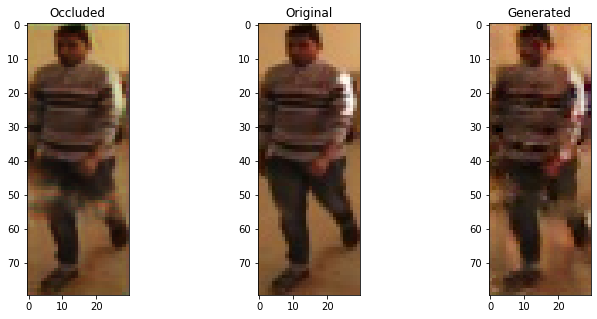

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


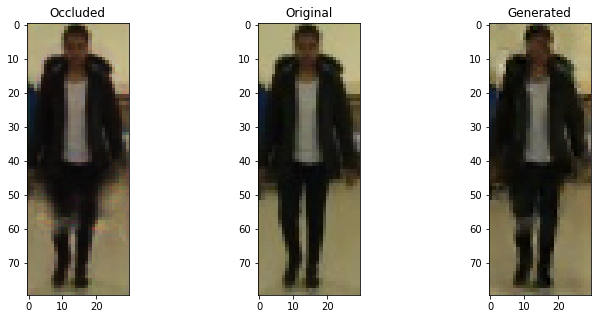

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


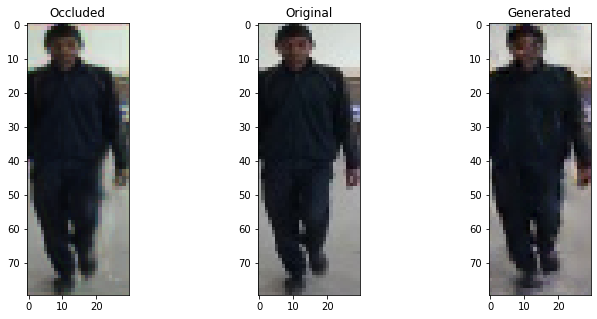

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


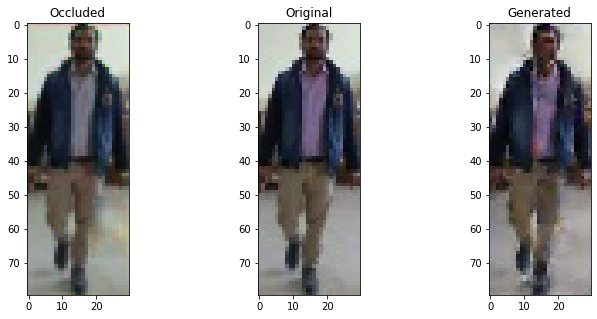

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


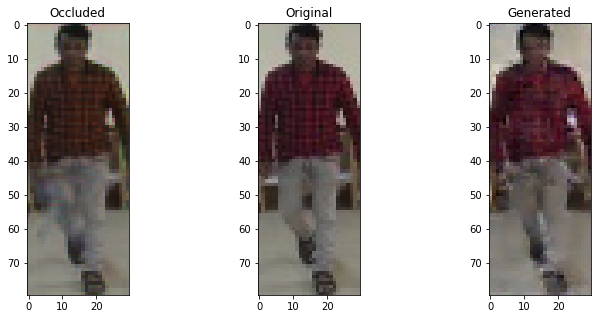

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6492529511451721 , Adversarial Loss:  0.0010374588891863823
Epoch 722


  8%|▊         | 1/13 [00:00<00:01,  6.67it/s]

Discriminator Loss:  0.6415926218032837 , Adversarial Loss:  0.0010422137565910816
Epoch 723


  8%|▊         | 1/13 [00:00<00:01,  6.45it/s]

Discriminator Loss:  0.6612760424613953 , Adversarial Loss:  0.0011890748282894492
Epoch 724


  8%|▊         | 1/13 [00:00<00:01,  6.43it/s]

Discriminator Loss:  0.6616934537887573 , Adversarial Loss:  0.0011128216283395886
Epoch 725


  8%|▊         | 1/13 [00:00<00:01,  6.58it/s]

Discriminator Loss:  0.6731495261192322 , Adversarial Loss:  0.001229241956025362
Epoch 726


  8%|▊         | 1/13 [00:00<00:01,  6.60it/s]

Discriminator Loss:  0.6264445781707764 , Adversarial Loss:  0.001140084583312273
Epoch 727


  8%|▊         | 1/13 [00:00<00:01,  6.69it/s]

Discriminator Loss:  0.6497450470924377 , Adversarial Loss:  0.001102329115383327
Epoch 728


  8%|▊         | 1/13 [00:00<00:01,  6.17it/s]

Discriminator Loss:  0.6628332138061523 , Adversarial Loss:  0.0013016341254115105
Epoch 729


  8%|▊         | 1/13 [00:00<00:01,  7.02it/s]

Discriminator Loss:  0.6561834216117859 , Adversarial Loss:  0.0010794000700116158
Epoch 730


  8%|▊         | 1/13 [00:00<00:01,  6.44it/s]

Discriminator Loss:  0.6292527914047241 , Adversarial Loss:  0.0010733564849942923
Epoch 731


  8%|▊         | 1/13 [00:00<00:01,  6.93it/s]

Discriminator Loss:  0.646417498588562 , Adversarial Loss:  0.0012127603404223919
Epoch 732


  8%|▊         | 1/13 [00:00<00:01,  6.36it/s]

Discriminator Loss:  0.6725033521652222 , Adversarial Loss:  0.001218142919242382
Epoch 733


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6796385645866394 , Adversarial Loss:  0.001107407733798027
Epoch 734


  8%|▊         | 1/13 [00:00<00:01,  6.81it/s]

Discriminator Loss:  0.6617960333824158 , Adversarial Loss:  0.0010673882206901908
Epoch 735


  8%|▊         | 1/13 [00:00<00:01,  6.36it/s]

Discriminator Loss:  0.6682909727096558 , Adversarial Loss:  0.0011468639131635427
Epoch 736


  8%|▊         | 1/13 [00:00<00:01,  6.85it/s]

Discriminator Loss:  0.664762020111084 , Adversarial Loss:  0.001158065744675696
Epoch 737


  8%|▊         | 1/13 [00:00<00:01,  6.13it/s]

Discriminator Loss:  0.6761901378631592 , Adversarial Loss:  0.0011895968345925212
Epoch 738


  8%|▊         | 1/13 [00:00<00:01,  6.23it/s]

Discriminator Loss:  0.6534758806228638 , Adversarial Loss:  0.0011794648598879576
Epoch 739


  8%|▊         | 1/13 [00:00<00:01,  6.70it/s]

Discriminator Loss:  0.6422334313392639 , Adversarial Loss:  0.001178736798465252
Epoch 740


  8%|▊         | 1/13 [00:00<00:02,  5.84it/s]

Discriminator Loss:  0.6444075107574463 , Adversarial Loss:  0.0011100999545305967
Epoch 741


100%|██████████| 13/13 [00:02<00:00,  6.20it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


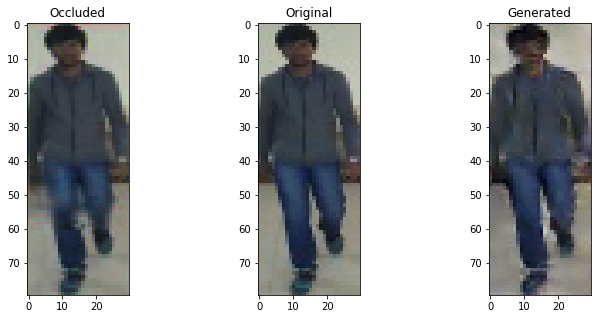

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


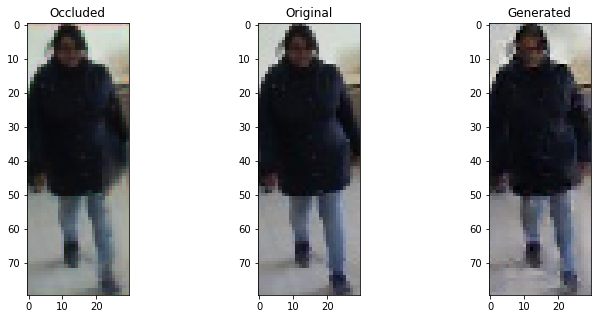

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


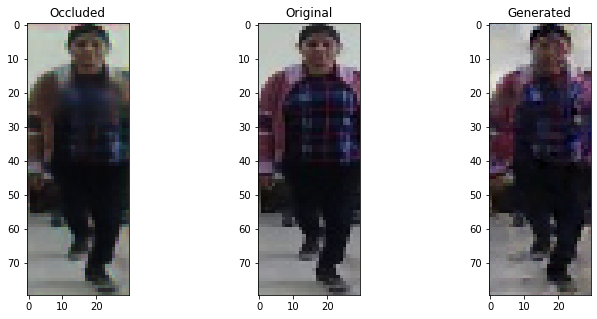

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


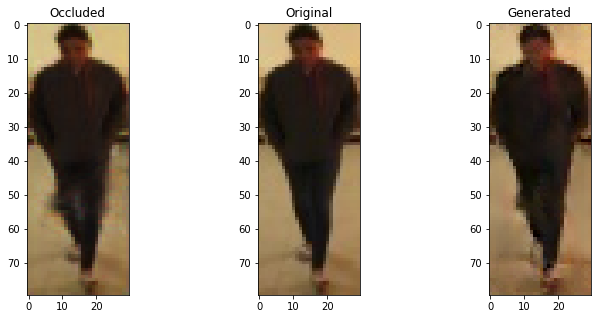

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


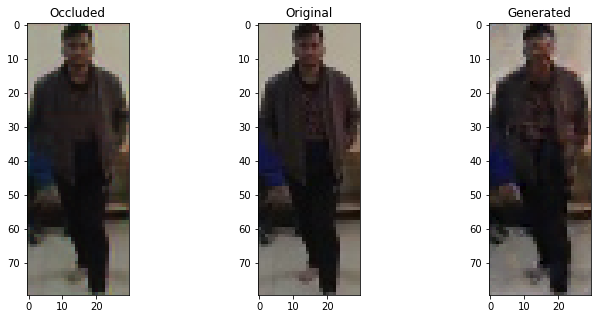

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6684908866882324 , Adversarial Loss:  0.0011360346106812358
Epoch 742


  8%|▊         | 1/13 [00:00<00:01,  6.73it/s]

Discriminator Loss:  0.6603198647499084 , Adversarial Loss:  0.001109607983380556
Epoch 743


  8%|▊         | 1/13 [00:00<00:01,  6.60it/s]

Discriminator Loss:  0.6550355553627014 , Adversarial Loss:  0.0011063390411436558
Epoch 744


  8%|▊         | 1/13 [00:00<00:01,  6.51it/s]

Discriminator Loss:  0.6224923133850098 , Adversarial Loss:  0.0012739056255668402
Epoch 745


  8%|▊         | 1/13 [00:00<00:02,  5.59it/s]

Discriminator Loss:  0.6460927128791809 , Adversarial Loss:  0.00120138144120574
Epoch 746


  8%|▊         | 1/13 [00:00<00:01,  6.48it/s]

Discriminator Loss:  0.6513931155204773 , Adversarial Loss:  0.0010866625234484673
Epoch 747


  8%|▊         | 1/13 [00:00<00:01,  6.62it/s]

Discriminator Loss:  0.6769206523895264 , Adversarial Loss:  0.0011214325204491615
Epoch 748


  8%|▊         | 1/13 [00:00<00:02,  5.93it/s]

Discriminator Loss:  0.6444910764694214 , Adversarial Loss:  0.0011233421973884106
Epoch 749


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.648709774017334 , Adversarial Loss:  0.0011634400580078363
Epoch 750


  8%|▊         | 1/13 [00:00<00:01,  6.80it/s]

Discriminator Loss:  0.6533926129341125 , Adversarial Loss:  0.0010620905086398125
Epoch 751


  8%|▊         | 1/13 [00:00<00:02,  5.20it/s]

Discriminator Loss:  0.6620784997940063 , Adversarial Loss:  0.0011371205328032374
Epoch 752


  8%|▊         | 1/13 [00:00<00:02,  5.28it/s]

Discriminator Loss:  0.6754896640777588 , Adversarial Loss:  0.0012127332156524062
Epoch 753


  8%|▊         | 1/13 [00:00<00:01,  6.41it/s]

Discriminator Loss:  0.6503936052322388 , Adversarial Loss:  0.0011754269944503903
Epoch 754


  8%|▊         | 1/13 [00:00<00:01,  6.50it/s]

Discriminator Loss:  0.6399960517883301 , Adversarial Loss:  0.0011562349973246455
Epoch 755


  8%|▊         | 1/13 [00:00<00:01,  6.21it/s]

Discriminator Loss:  0.675849199295044 , Adversarial Loss:  0.001115803373977542
Epoch 756


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6399405002593994 , Adversarial Loss:  0.0011676257709041238
Epoch 757


  8%|▊         | 1/13 [00:00<00:01,  6.40it/s]

Discriminator Loss:  0.6678426265716553 , Adversarial Loss:  0.001123181078583002
Epoch 758


  8%|▊         | 1/13 [00:00<00:01,  6.39it/s]

Discriminator Loss:  0.6635570526123047 , Adversarial Loss:  0.0011708415113389492
Epoch 759


  8%|▊         | 1/13 [00:00<00:01,  6.59it/s]

Discriminator Loss:  0.67087721824646 , Adversarial Loss:  0.0012418944388628006
Epoch 760


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6346359848976135 , Adversarial Loss:  0.001045253244228661
Epoch 761


100%|██████████| 13/13 [00:02<00:00,  5.92it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


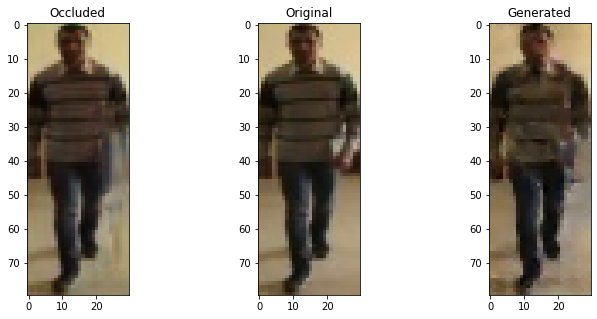

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


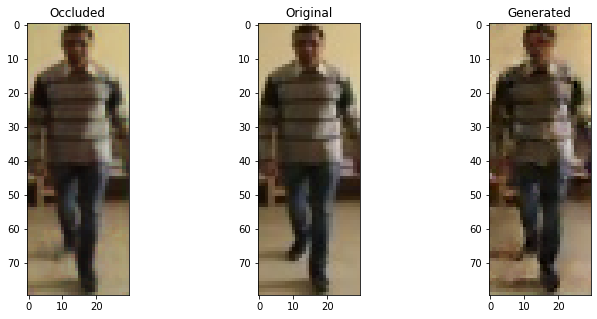

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


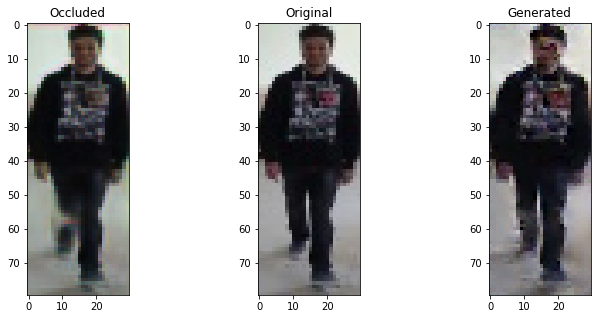

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


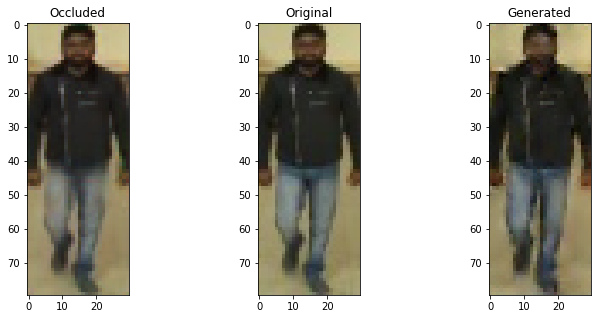

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


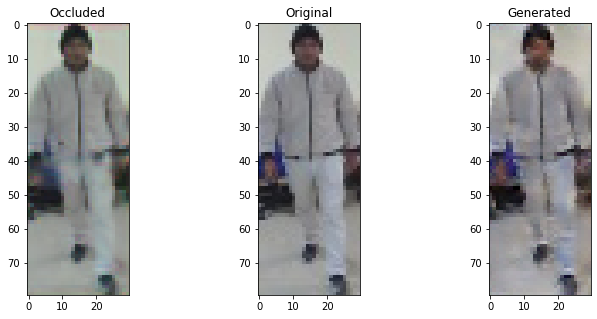

  8%|▊         | 1/13 [00:00<00:02,  5.62it/s]

Discriminator Loss:  0.6654941439628601 , Adversarial Loss:  0.0011955143418163061
Epoch 762


  8%|▊         | 1/13 [00:00<00:01,  6.33it/s]

Discriminator Loss:  0.6209787130355835 , Adversarial Loss:  0.0011280954349786043
Epoch 763


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6310052275657654 , Adversarial Loss:  0.001016351510770619
Epoch 764


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.659376323223114 , Adversarial Loss:  0.001069244579412043
Epoch 765


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6567474603652954 , Adversarial Loss:  0.0010809232480823994
Epoch 766


  8%|▊         | 1/13 [00:00<00:01,  6.57it/s]

Discriminator Loss:  0.6475818157196045 , Adversarial Loss:  0.0012657090555876493
Epoch 767


  8%|▊         | 1/13 [00:00<00:01,  6.52it/s]

Discriminator Loss:  0.657228946685791 , Adversarial Loss:  0.001164336921647191
Epoch 768


  8%|▊         | 1/13 [00:00<00:01,  6.27it/s]

Discriminator Loss:  0.6566826105117798 , Adversarial Loss:  0.0011093469802290201
Epoch 769


  8%|▊         | 1/13 [00:00<00:01,  6.26it/s]

Discriminator Loss:  0.6693410277366638 , Adversarial Loss:  0.0011504360008984804
Epoch 770


  8%|▊         | 1/13 [00:00<00:01,  6.30it/s]

Discriminator Loss:  0.6653783917427063 , Adversarial Loss:  0.001116712810471654
Epoch 771


  8%|▊         | 1/13 [00:00<00:01,  6.63it/s]

Discriminator Loss:  0.6550257802009583 , Adversarial Loss:  0.0011216694256290793
Epoch 772


  8%|▊         | 1/13 [00:00<00:01,  6.49it/s]

Discriminator Loss:  0.6681916117668152 , Adversarial Loss:  0.0010914499871432781
Epoch 773


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.655391275882721 , Adversarial Loss:  0.001040928647853434
Epoch 774


  8%|▊         | 1/13 [00:00<00:01,  6.86it/s]

Discriminator Loss:  0.635841965675354 , Adversarial Loss:  0.0010902377543970942
Epoch 775


  8%|▊         | 1/13 [00:00<00:02,  5.38it/s]

Discriminator Loss:  0.6587731838226318 , Adversarial Loss:  0.001049016835168004
Epoch 776


  8%|▊         | 1/13 [00:00<00:01,  6.75it/s]

Discriminator Loss:  0.684810221195221 , Adversarial Loss:  0.0010825216304510832
Epoch 777


  8%|▊         | 1/13 [00:00<00:01,  6.54it/s]

Discriminator Loss:  0.6503114104270935 , Adversarial Loss:  0.0010540704242885113
Epoch 778


  8%|▊         | 1/13 [00:00<00:01,  6.06it/s]

Discriminator Loss:  0.6426010727882385 , Adversarial Loss:  0.0010693438816815615
Epoch 779


  8%|▊         | 1/13 [00:00<00:01,  6.52it/s]

Discriminator Loss:  0.675826907157898 , Adversarial Loss:  0.0010077321203425527
Epoch 780


  8%|▊         | 1/13 [00:00<00:01,  6.61it/s]

Discriminator Loss:  0.6716434955596924 , Adversarial Loss:  0.0009943658951669931
Epoch 781


100%|██████████| 13/13 [00:02<00:00,  6.00it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


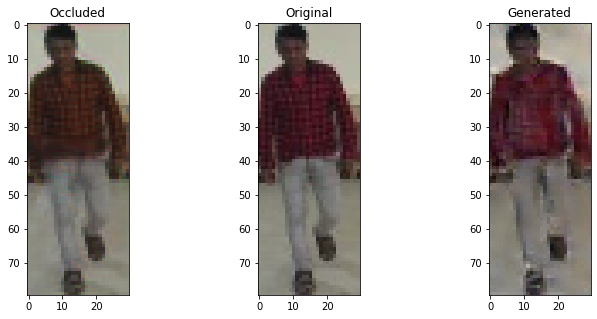

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


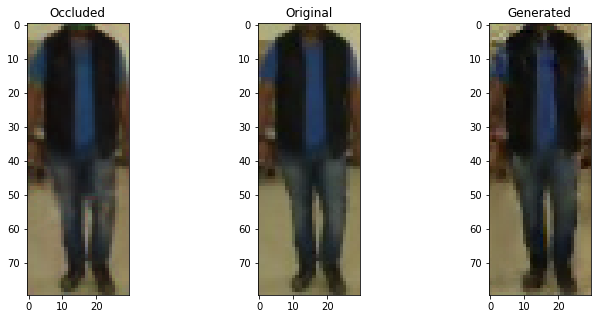

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


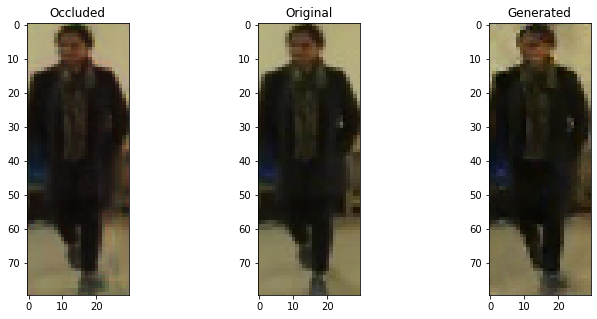

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


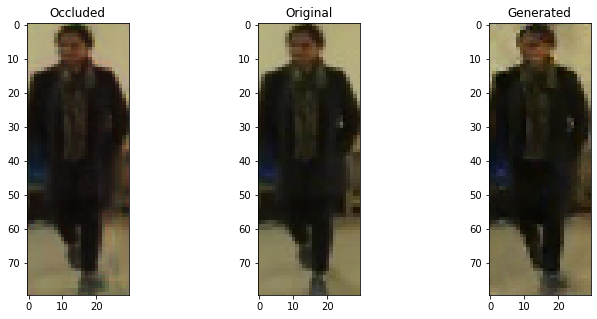

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


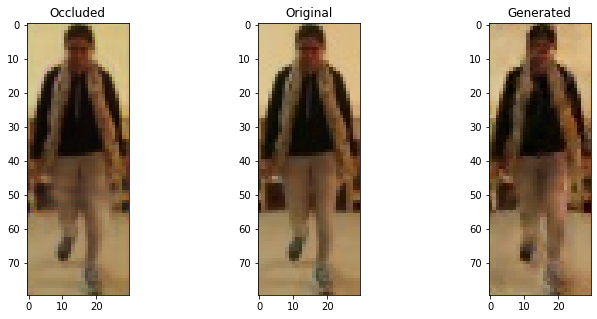

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6637982130050659 , Adversarial Loss:  0.001112140016630292
Epoch 782


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.656605064868927 , Adversarial Loss:  0.0011575056705623865
Epoch 783


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6867986917495728 , Adversarial Loss:  0.001101339003071189
Epoch 784


  8%|▊         | 1/13 [00:00<00:01,  6.54it/s]

Discriminator Loss:  0.6784610152244568 , Adversarial Loss:  0.0010290051577612758
Epoch 785


  8%|▊         | 1/13 [00:00<00:02,  5.21it/s]

Discriminator Loss:  0.651847779750824 , Adversarial Loss:  0.0010879207402467728
Epoch 786


  8%|▊         | 1/13 [00:00<00:02,  5.80it/s]

Discriminator Loss:  0.6483092904090881 , Adversarial Loss:  0.0011854406911879778
Epoch 787


  8%|▊         | 1/13 [00:00<00:01,  6.46it/s]

Discriminator Loss:  0.6704767942428589 , Adversarial Loss:  0.00109749601688236
Epoch 788


  8%|▊         | 1/13 [00:00<00:01,  6.26it/s]

Discriminator Loss:  0.6598854064941406 , Adversarial Loss:  0.001071559265255928
Epoch 789


  8%|▊         | 1/13 [00:00<00:01,  6.21it/s]

Discriminator Loss:  0.6760386228561401 , Adversarial Loss:  0.0009918123250827193
Epoch 790


  8%|▊         | 1/13 [00:00<00:01,  6.38it/s]

Discriminator Loss:  0.6616755723953247 , Adversarial Loss:  0.0009587170789018273
Epoch 791


  8%|▊         | 1/13 [00:00<00:02,  5.23it/s]

Discriminator Loss:  0.643197774887085 , Adversarial Loss:  0.0010631091427057981
Epoch 792


  8%|▊         | 1/13 [00:00<00:02,  5.77it/s]

Discriminator Loss:  0.6547168493270874 , Adversarial Loss:  0.0010050470009446144
Epoch 793


  8%|▊         | 1/13 [00:00<00:01,  6.97it/s]

Discriminator Loss:  0.6467372179031372 , Adversarial Loss:  0.0010488660773262382
Epoch 794


  8%|▊         | 1/13 [00:00<00:01,  6.71it/s]

Discriminator Loss:  0.6657965183258057 , Adversarial Loss:  0.001063804142177105
Epoch 795


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6594641208648682 , Adversarial Loss:  0.0009102544281631708
Epoch 796


  8%|▊         | 1/13 [00:00<00:02,  5.83it/s]

Discriminator Loss:  0.6582200527191162 , Adversarial Loss:  0.001059817150235176
Epoch 797


  8%|▊         | 1/13 [00:00<00:01,  6.46it/s]

Discriminator Loss:  0.6359851360321045 , Adversarial Loss:  0.001105326460674405
Epoch 798


  8%|▊         | 1/13 [00:00<00:02,  5.96it/s]

Discriminator Loss:  0.6666325926780701 , Adversarial Loss:  0.001079632667824626
Epoch 799


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6749573945999146 , Adversarial Loss:  0.0009940576273947954
Epoch 800


  8%|▊         | 1/13 [00:00<00:01,  6.71it/s]

Discriminator Loss:  0.6591612100601196 , Adversarial Loss:  0.0010746843181550503
Epoch 801


100%|██████████| 13/13 [00:02<00:00,  6.09it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


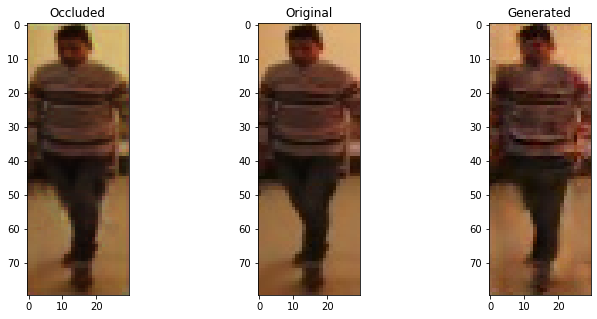

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


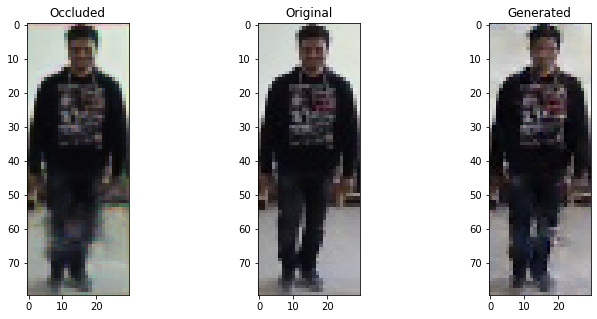

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


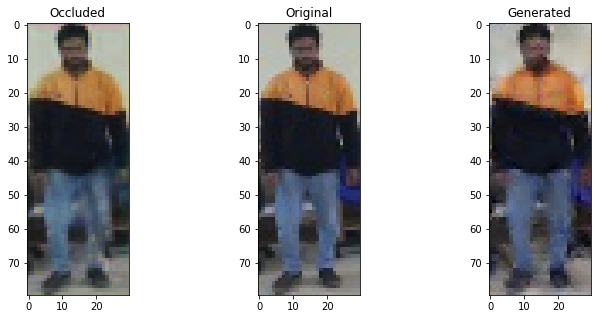

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


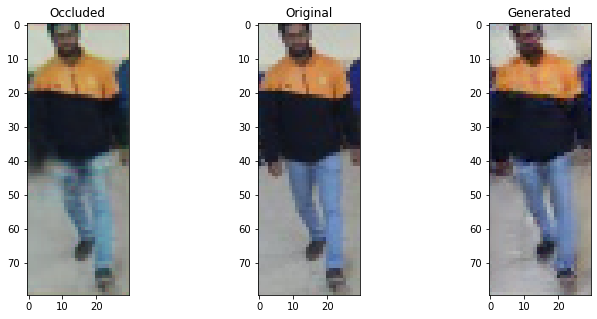

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


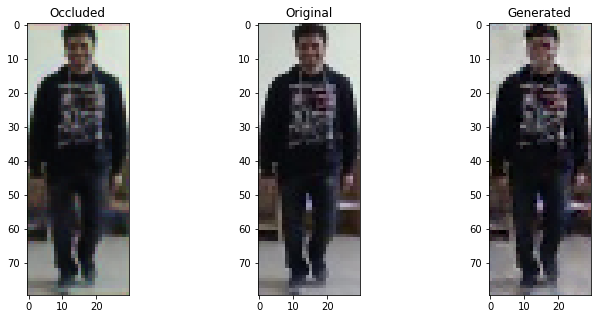

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6579996347427368 , Adversarial Loss:  0.0009921249002218246
Epoch 802


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6579254269599915 , Adversarial Loss:  0.0010074172168970108
Epoch 803


  8%|▊         | 1/13 [00:00<00:01,  6.68it/s]

Discriminator Loss:  0.6661432981491089 , Adversarial Loss:  0.001057843561284244
Epoch 804


  8%|▊         | 1/13 [00:00<00:02,  5.37it/s]

Discriminator Loss:  0.6475896239280701 , Adversarial Loss:  0.0010418803431093693
Epoch 805


  8%|▊         | 1/13 [00:00<00:01,  6.55it/s]

Discriminator Loss:  0.6892772912979126 , Adversarial Loss:  0.0010347599163651466
Epoch 806


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.648345947265625 , Adversarial Loss:  0.0010162097169086337
Epoch 807


  8%|▊         | 1/13 [00:00<00:01,  6.43it/s]

Discriminator Loss:  0.6709814071655273 , Adversarial Loss:  0.0009094990091398358
Epoch 808


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6661778092384338 , Adversarial Loss:  0.0011027257423847914
Epoch 809


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6546250581741333 , Adversarial Loss:  0.0008804192184470594
Epoch 810


  8%|▊         | 1/13 [00:00<00:02,  5.33it/s]

Discriminator Loss:  0.6905373334884644 , Adversarial Loss:  0.0010332853998988867
Epoch 811


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6504881978034973 , Adversarial Loss:  0.0009497426217421889
Epoch 812


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.65287846326828 , Adversarial Loss:  0.001084539806470275
Epoch 813


  8%|▊         | 1/13 [00:00<00:01,  6.31it/s]

Discriminator Loss:  0.6726517677307129 , Adversarial Loss:  0.0010548208374530077
Epoch 814


  8%|▊         | 1/13 [00:00<00:01,  6.52it/s]

Discriminator Loss:  0.6443829536437988 , Adversarial Loss:  0.001035754568874836
Epoch 815


  8%|▊         | 1/13 [00:00<00:01,  6.16it/s]

Discriminator Loss:  0.6482747793197632 , Adversarial Loss:  0.0010505039244890213
Epoch 816


  8%|▊         | 1/13 [00:00<00:01,  6.41it/s]

Discriminator Loss:  0.6776987910270691 , Adversarial Loss:  0.000945183914154768
Epoch 817


  8%|▊         | 1/13 [00:00<00:01,  6.69it/s]

Discriminator Loss:  0.6602305173873901 , Adversarial Loss:  0.0009714275365695357
Epoch 818


  8%|▊         | 1/13 [00:00<00:01,  6.12it/s]

Discriminator Loss:  0.6429082155227661 , Adversarial Loss:  0.0010332264937460423
Epoch 819


  8%|▊         | 1/13 [00:00<00:01,  6.01it/s]

Discriminator Loss:  0.6809248924255371 , Adversarial Loss:  0.0010310154175385833
Epoch 820


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6769428253173828 , Adversarial Loss:  0.0010134336771443486
Epoch 821


100%|██████████| 13/13 [00:02<00:00,  5.53it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


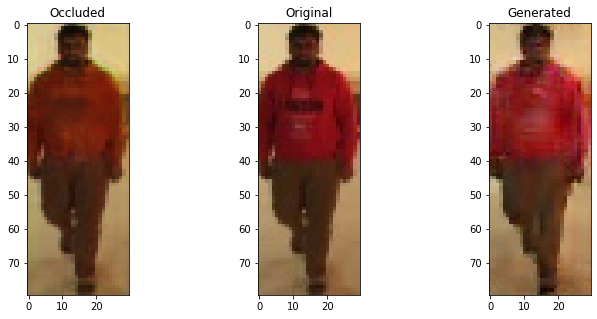

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


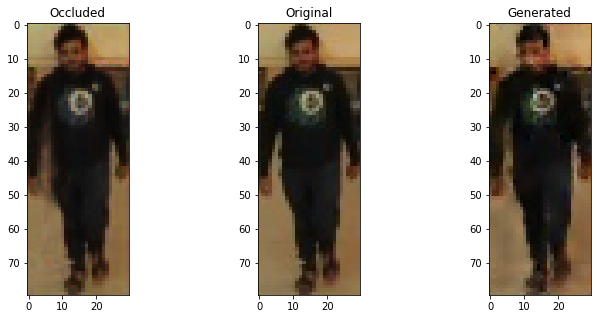

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


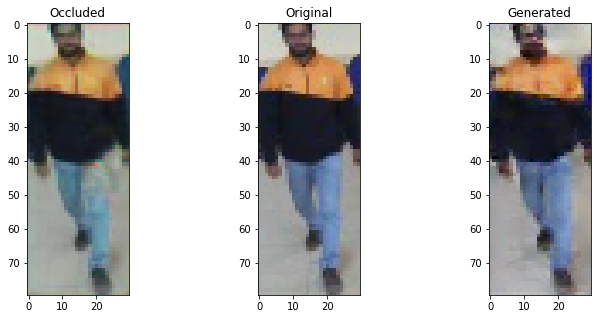

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


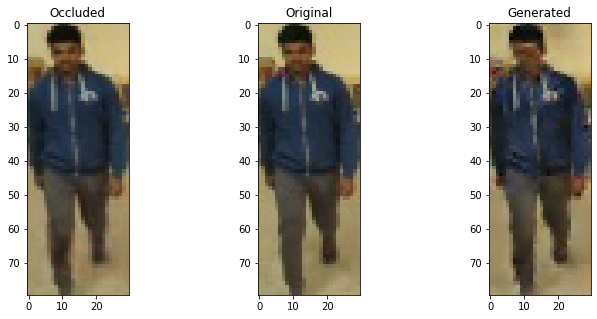

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


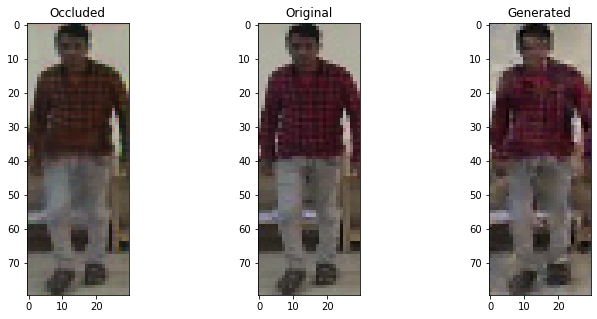

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6386235356330872 , Adversarial Loss:  0.0010218223324045539
Epoch 822


  8%|▊         | 1/13 [00:00<00:02,  5.17it/s]

Discriminator Loss:  0.6465851068496704 , Adversarial Loss:  0.0009562718914821744
Epoch 823


  8%|▊         | 1/13 [00:00<00:02,  5.24it/s]

Discriminator Loss:  0.6542628407478333 , Adversarial Loss:  0.0010887820972129703
Epoch 824


  8%|▊         | 1/13 [00:00<00:01,  6.27it/s]

Discriminator Loss:  0.6725167036056519 , Adversarial Loss:  0.0010262387804687023
Epoch 825


  8%|▊         | 1/13 [00:00<00:01,  6.28it/s]

Discriminator Loss:  0.6807907819747925 , Adversarial Loss:  0.0010208169696852565
Epoch 826


  8%|▊         | 1/13 [00:00<00:01,  6.38it/s]

Discriminator Loss:  0.6457586288452148 , Adversarial Loss:  0.0009932919638231397
Epoch 827


  8%|▊         | 1/13 [00:00<00:01,  6.53it/s]

Discriminator Loss:  0.6706744432449341 , Adversarial Loss:  0.0010282930452376604
Epoch 828


  8%|▊         | 1/13 [00:00<00:01,  6.22it/s]

Discriminator Loss:  0.6555154323577881 , Adversarial Loss:  0.0009335147915408015
Epoch 829


  8%|▊         | 1/13 [00:00<00:02,  5.12it/s]

Discriminator Loss:  0.6795046329498291 , Adversarial Loss:  0.0009456013794988394
Epoch 830


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6714894771575928 , Adversarial Loss:  0.0009463962633162737
Epoch 831


  8%|▊         | 1/13 [00:00<00:01,  6.55it/s]

Discriminator Loss:  0.6425269842147827 , Adversarial Loss:  0.0011095067020505667
Epoch 832


  8%|▊         | 1/13 [00:00<00:01,  6.45it/s]

Discriminator Loss:  0.6605817079544067 , Adversarial Loss:  0.0010192685294896364
Epoch 833


  8%|▊         | 1/13 [00:00<00:01,  6.43it/s]

Discriminator Loss:  0.6733629703521729 , Adversarial Loss:  0.0009547005174681544
Epoch 834


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6608454585075378 , Adversarial Loss:  0.0009210031712427735
Epoch 835


  8%|▊         | 1/13 [00:00<00:01,  6.47it/s]

Discriminator Loss:  0.6512106657028198 , Adversarial Loss:  0.0009797902312129736
Epoch 836


  8%|▊         | 1/13 [00:00<00:01,  6.56it/s]

Discriminator Loss:  0.6787088513374329 , Adversarial Loss:  0.0009497413411736488
Epoch 837


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6264239549636841 , Adversarial Loss:  0.0010257279500365257
Epoch 838


  8%|▊         | 1/13 [00:00<00:01,  6.30it/s]

Discriminator Loss:  0.679219663143158 , Adversarial Loss:  0.0009422624134458601
Epoch 839


  8%|▊         | 1/13 [00:00<00:01,  6.43it/s]

Discriminator Loss:  0.6397374272346497 , Adversarial Loss:  0.0010413340060040355
Epoch 840


  8%|▊         | 1/13 [00:00<00:01,  6.57it/s]

Discriminator Loss:  0.6333645582199097 , Adversarial Loss:  0.0009573565912432969
Epoch 841


100%|██████████| 13/13 [00:02<00:00,  5.80it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


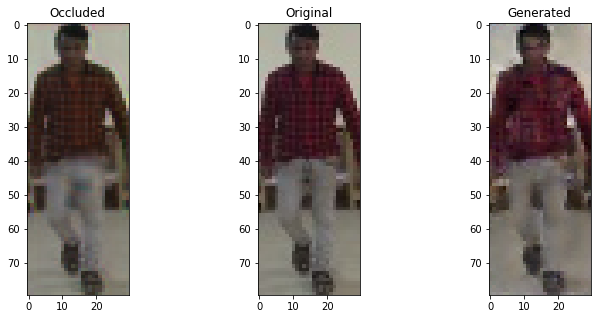

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


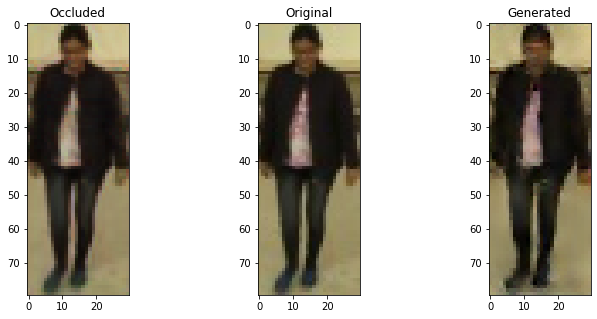

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


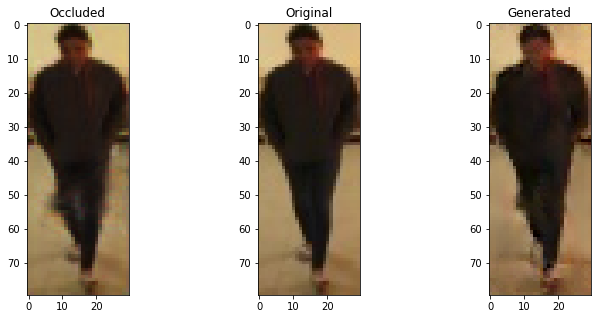

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


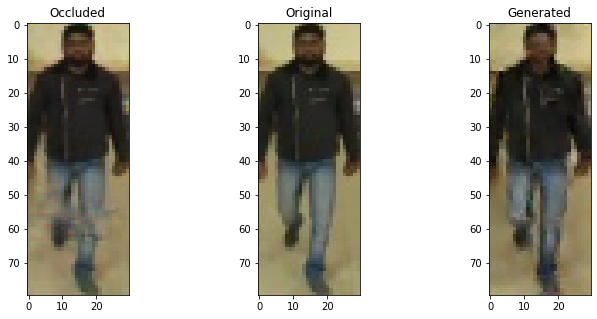

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


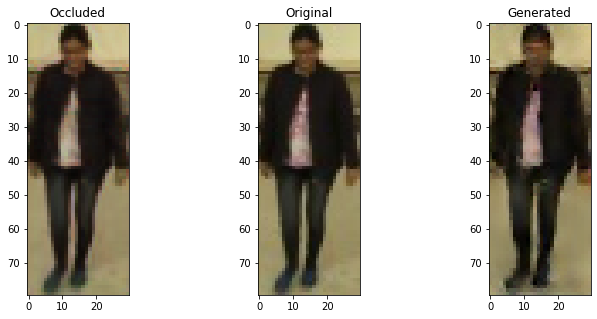

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6733955144882202 , Adversarial Loss:  0.001035753870382905
Epoch 842


  8%|▊         | 1/13 [00:00<00:01,  6.12it/s]

Discriminator Loss:  0.6314129829406738 , Adversarial Loss:  0.0010212411871179938
Epoch 843


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6716355681419373 , Adversarial Loss:  0.0010310396319255233
Epoch 844


  8%|▊         | 1/13 [00:00<00:01,  6.50it/s]

Discriminator Loss:  0.6477622985839844 , Adversarial Loss:  0.0009822612628340721
Epoch 845


  8%|▊         | 1/13 [00:00<00:01,  6.42it/s]

Discriminator Loss:  0.6592928767204285 , Adversarial Loss:  0.0009317033691331744
Epoch 846


  8%|▊         | 1/13 [00:00<00:01,  6.79it/s]

Discriminator Loss:  0.6495524048805237 , Adversarial Loss:  0.0010075258323922753
Epoch 847


  8%|▊         | 1/13 [00:00<00:01,  6.49it/s]

Discriminator Loss:  0.6472828388214111 , Adversarial Loss:  0.0009473905665799975
Epoch 848


  8%|▊         | 1/13 [00:00<00:01,  6.51it/s]

Discriminator Loss:  0.6756285429000854 , Adversarial Loss:  0.001028526807203889
Epoch 849


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6456301808357239 , Adversarial Loss:  0.0009154460858553648
Epoch 850


  8%|▊         | 1/13 [00:00<00:01,  6.40it/s]

Discriminator Loss:  0.6492047309875488 , Adversarial Loss:  0.001061965711414814
Epoch 851


  8%|▊         | 1/13 [00:00<00:01,  6.28it/s]

Discriminator Loss:  0.6809587478637695 , Adversarial Loss:  0.0009547671070322394
Epoch 852


  8%|▊         | 1/13 [00:00<00:02,  5.85it/s]

Discriminator Loss:  0.6555330157279968 , Adversarial Loss:  0.0010428953683003783
Epoch 853


  8%|▊         | 1/13 [00:00<00:01,  6.81it/s]

Discriminator Loss:  0.653817892074585 , Adversarial Loss:  0.0009959172457456589
Epoch 854


  8%|▊         | 1/13 [00:00<00:02,  5.91it/s]

Discriminator Loss:  0.6396387815475464 , Adversarial Loss:  0.0009691876475699246
Epoch 855


  8%|▊         | 1/13 [00:00<00:01,  6.30it/s]

Discriminator Loss:  0.648116409778595 , Adversarial Loss:  0.0011223319452255964
Epoch 856


  8%|▊         | 1/13 [00:00<00:02,  5.98it/s]

Discriminator Loss:  0.6451038122177124 , Adversarial Loss:  0.001110962824895978
Epoch 857


  8%|▊         | 1/13 [00:00<00:01,  6.70it/s]

Discriminator Loss:  0.6593326926231384 , Adversarial Loss:  0.0009175021550618112
Epoch 858


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6477303504943848 , Adversarial Loss:  0.0009061435703188181
Epoch 859


  8%|▊         | 1/13 [00:00<00:01,  6.77it/s]

Discriminator Loss:  0.6687256097793579 , Adversarial Loss:  0.0010338405845686793
Epoch 860


  8%|▊         | 1/13 [00:00<00:01,  6.24it/s]

Discriminator Loss:  0.6477468013763428 , Adversarial Loss:  0.0009345115977339447
Epoch 861


100%|██████████| 13/13 [00:02<00:00,  6.23it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


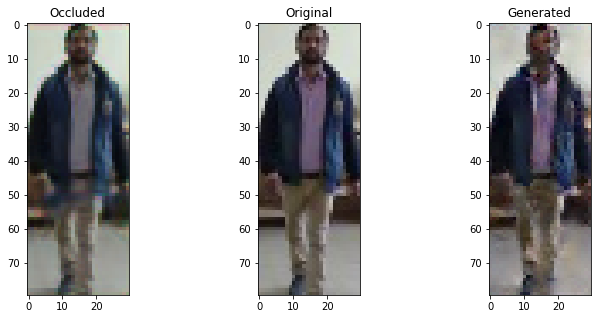

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


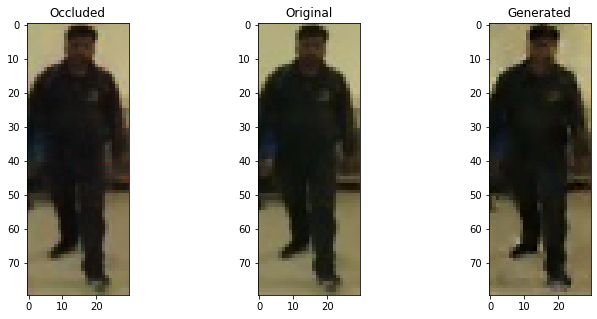

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


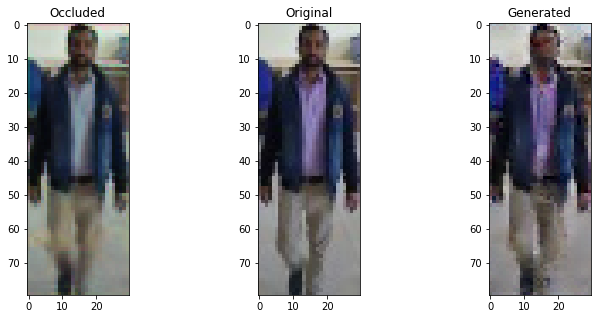

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


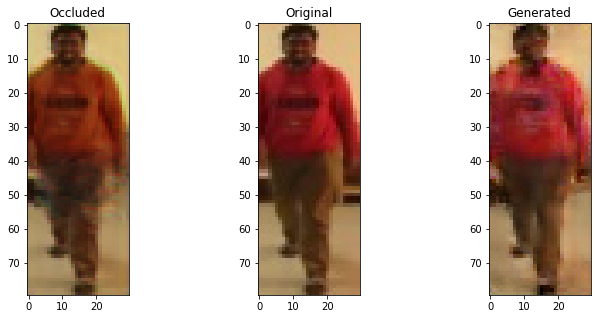

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


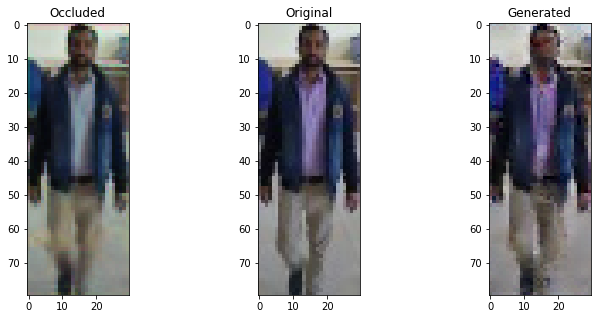

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6469371914863586 , Adversarial Loss:  0.0010552810272201896
Epoch 862


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6774206161499023 , Adversarial Loss:  0.000941209145821631
Epoch 863


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6438295841217041 , Adversarial Loss:  0.0010693530784919858
Epoch 864


  8%|▊         | 1/13 [00:00<00:01,  6.57it/s]

Discriminator Loss:  0.6646400690078735 , Adversarial Loss:  0.0009722139802761376
Epoch 865


  8%|▊         | 1/13 [00:00<00:01,  6.18it/s]

Discriminator Loss:  0.6414169669151306 , Adversarial Loss:  0.0009602023637853563
Epoch 866


  8%|▊         | 1/13 [00:00<00:01,  6.73it/s]

Discriminator Loss:  0.6552612781524658 , Adversarial Loss:  0.0010519992792978883
Epoch 867


  8%|▊         | 1/13 [00:00<00:01,  6.48it/s]

Discriminator Loss:  0.6604512929916382 , Adversarial Loss:  0.0010168482549488544
Epoch 868


  8%|▊         | 1/13 [00:00<00:01,  6.19it/s]

Discriminator Loss:  0.6273568868637085 , Adversarial Loss:  0.0009114251588471234
Epoch 869


  8%|▊         | 1/13 [00:00<00:02,  5.79it/s]

Discriminator Loss:  0.637413740158081 , Adversarial Loss:  0.0009400093113072217
Epoch 870


  8%|▊         | 1/13 [00:00<00:01,  6.80it/s]

Discriminator Loss:  0.66582852602005 , Adversarial Loss:  0.0009791916236281395
Epoch 871


  8%|▊         | 1/13 [00:00<00:01,  6.70it/s]

Discriminator Loss:  0.6443052887916565 , Adversarial Loss:  0.0010403728811070323
Epoch 872


  8%|▊         | 1/13 [00:00<00:02,  5.16it/s]

Discriminator Loss:  0.6440266370773315 , Adversarial Loss:  0.0009286399581469595
Epoch 873


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6348332166671753 , Adversarial Loss:  0.0009044881444424391
Epoch 874


  8%|▊         | 1/13 [00:00<00:01,  6.14it/s]

Discriminator Loss:  0.6680015921592712 , Adversarial Loss:  0.0009306714055128396
Epoch 875


  8%|▊         | 1/13 [00:00<00:02,  5.80it/s]

Discriminator Loss:  0.6708234548568726 , Adversarial Loss:  0.0009134059073403478
Epoch 876


  8%|▊         | 1/13 [00:00<00:02,  5.79it/s]

Discriminator Loss:  0.6614828109741211 , Adversarial Loss:  0.0009836815297603607
Epoch 877


  8%|▊         | 1/13 [00:00<00:01,  6.15it/s]

Discriminator Loss:  0.6652445793151855 , Adversarial Loss:  0.0008671755203977227
Epoch 878


  8%|▊         | 1/13 [00:00<00:02,  5.16it/s]

Discriminator Loss:  0.6811633110046387 , Adversarial Loss:  0.000969176646322012
Epoch 879


  8%|▊         | 1/13 [00:00<00:01,  6.31it/s]

Discriminator Loss:  0.6650474071502686 , Adversarial Loss:  0.0008740394841879606
Epoch 880


  8%|▊         | 1/13 [00:00<00:01,  6.40it/s]

Discriminator Loss:  0.682086706161499 , Adversarial Loss:  0.0010644033318385482
Epoch 881


100%|██████████| 13/13 [00:02<00:00,  6.12it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


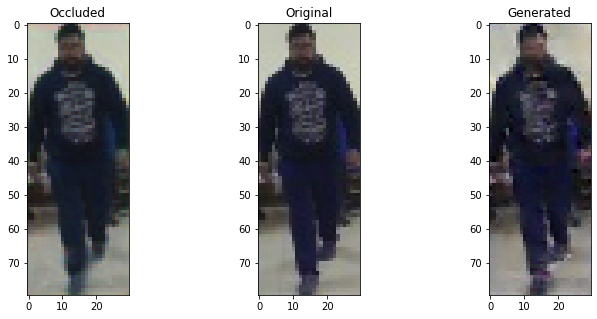

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


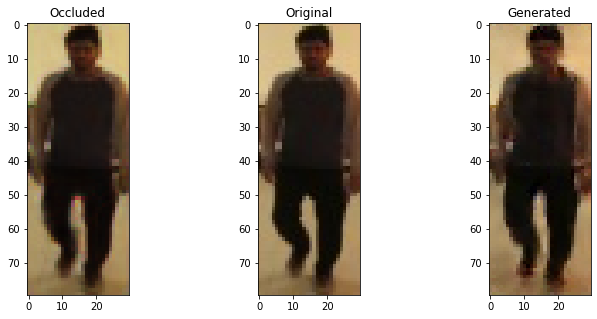

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


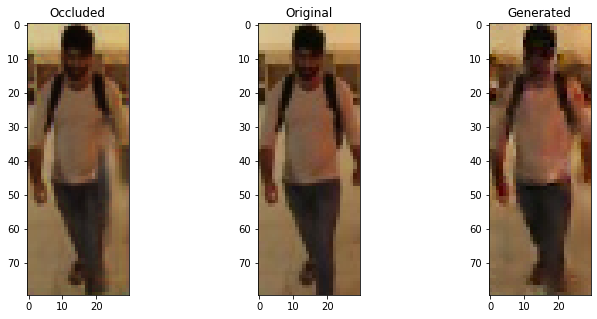

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


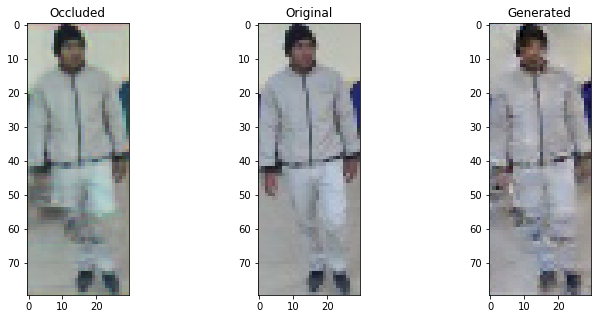

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


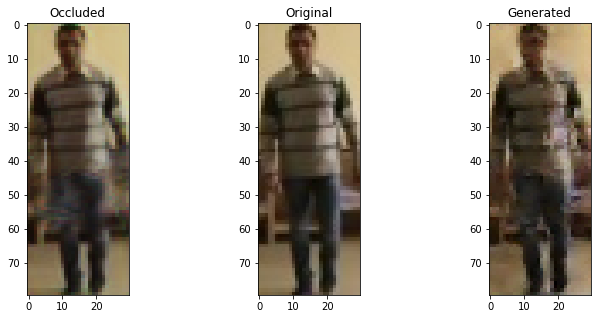

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6572532653808594 , Adversarial Loss:  0.0010461374185979366
Epoch 882


  8%|▊         | 1/13 [00:00<00:01,  6.53it/s]

Discriminator Loss:  0.6600501537322998 , Adversarial Loss:  0.00098479597363621
Epoch 883


  8%|▊         | 1/13 [00:00<00:01,  6.60it/s]

Discriminator Loss:  0.66327965259552 , Adversarial Loss:  0.001004160032607615
Epoch 884


  8%|▊         | 1/13 [00:00<00:02,  5.84it/s]

Discriminator Loss:  0.6598360538482666 , Adversarial Loss:  0.0009399183909408748
Epoch 885


  8%|▊         | 1/13 [00:00<00:02,  5.83it/s]

Discriminator Loss:  0.6539930105209351 , Adversarial Loss:  0.0010381363099440932
Epoch 886


  8%|▊         | 1/13 [00:00<00:01,  6.03it/s]

Discriminator Loss:  0.6627326011657715 , Adversarial Loss:  0.0008531369967386127
Epoch 887


  8%|▊         | 1/13 [00:00<00:01,  6.50it/s]

Discriminator Loss:  0.6412823796272278 , Adversarial Loss:  0.0009211743017658591
Epoch 888


  8%|▊         | 1/13 [00:00<00:01,  6.12it/s]

Discriminator Loss:  0.6716118454933167 , Adversarial Loss:  0.0008935404475778341
Epoch 889


  8%|▊         | 1/13 [00:00<00:01,  6.19it/s]

Discriminator Loss:  0.668008029460907 , Adversarial Loss:  0.0009898996213451028
Epoch 890


  8%|▊         | 1/13 [00:00<00:01,  6.58it/s]

Discriminator Loss:  0.6627967357635498 , Adversarial Loss:  0.0009118945454247296
Epoch 891


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6688998937606812 , Adversarial Loss:  0.00108217797242105
Epoch 892


  8%|▊         | 1/13 [00:00<00:01,  6.32it/s]

Discriminator Loss:  0.671420693397522 , Adversarial Loss:  0.0009421908762305975
Epoch 893


  8%|▊         | 1/13 [00:00<00:01,  6.38it/s]

Discriminator Loss:  0.6793487668037415 , Adversarial Loss:  0.0009505952475592494
Epoch 894


  8%|▊         | 1/13 [00:00<00:01,  6.19it/s]

Discriminator Loss:  0.660800576210022 , Adversarial Loss:  0.0009080031886696815
Epoch 895


  8%|▊         | 1/13 [00:00<00:01,  6.30it/s]

Discriminator Loss:  0.6697633862495422 , Adversarial Loss:  0.0010053446749225259
Epoch 896


  8%|▊         | 1/13 [00:00<00:01,  6.38it/s]

Discriminator Loss:  0.6549785733222961 , Adversarial Loss:  0.0008693775744177401
Epoch 897


  8%|▊         | 1/13 [00:00<00:01,  6.06it/s]

Discriminator Loss:  0.6672449111938477 , Adversarial Loss:  0.0009325256105512381
Epoch 898


  8%|▊         | 1/13 [00:00<00:01,  6.57it/s]

Discriminator Loss:  0.6565043926239014 , Adversarial Loss:  0.0010871929116547108
Epoch 899


  8%|▊         | 1/13 [00:00<00:01,  6.01it/s]

Discriminator Loss:  0.6633877754211426 , Adversarial Loss:  0.0009862465085461736
Epoch 900


  8%|▊         | 1/13 [00:00<00:01,  6.65it/s]

Discriminator Loss:  0.6531592011451721 , Adversarial Loss:  0.0009686333360150456
Epoch 901


100%|██████████| 13/13 [00:02<00:00,  5.88it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


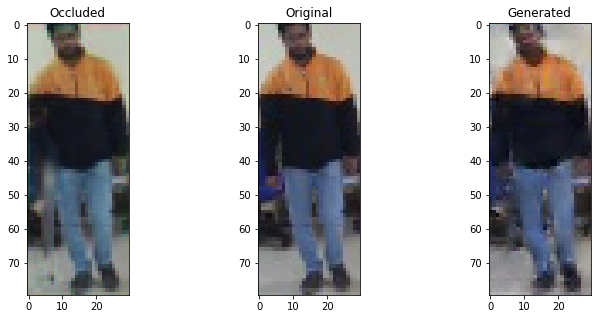

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


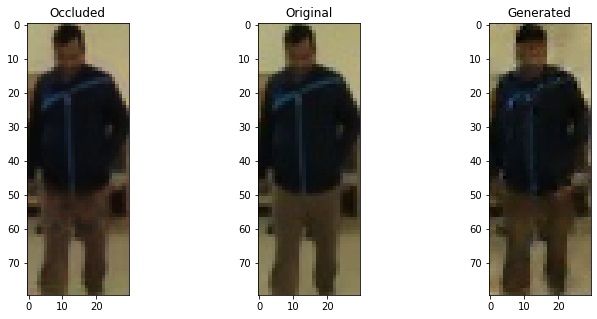

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


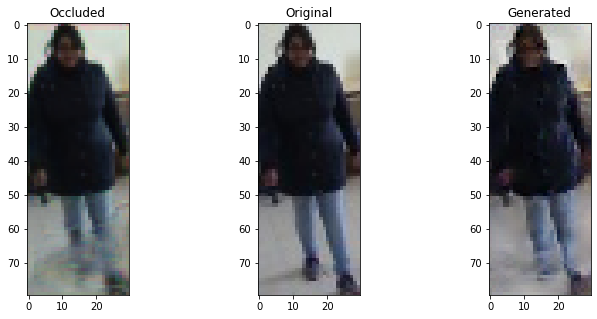

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


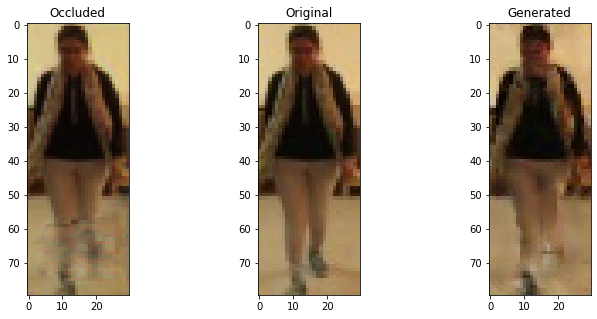

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


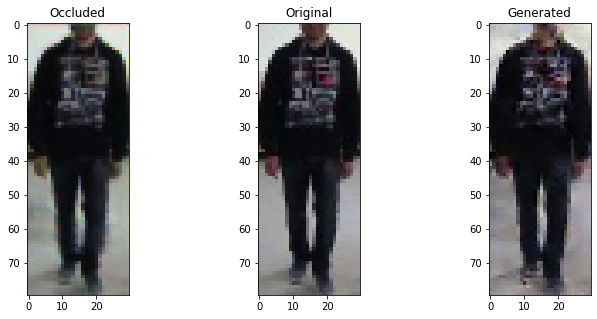

  8%|▊         | 1/13 [00:00<00:02,  5.56it/s]

Discriminator Loss:  0.6525053381919861 , Adversarial Loss:  0.0009643554221838713
Epoch 902


  8%|▊         | 1/13 [00:00<00:01,  6.25it/s]

Discriminator Loss:  0.6713253855705261 , Adversarial Loss:  0.0008406427223235369
Epoch 903


  8%|▊         | 1/13 [00:00<00:01,  6.66it/s]

Discriminator Loss:  0.6494211554527283 , Adversarial Loss:  0.0009618762414902449
Epoch 904


  8%|▊         | 1/13 [00:00<00:01,  6.37it/s]

Discriminator Loss:  0.6546279191970825 , Adversarial Loss:  0.0009405972668901086
Epoch 905


  8%|▊         | 1/13 [00:00<00:01,  6.44it/s]

Discriminator Loss:  0.6647545695304871 , Adversarial Loss:  0.0009383868891745806
Epoch 906


  8%|▊         | 1/13 [00:00<00:01,  6.79it/s]

Discriminator Loss:  0.6508834958076477 , Adversarial Loss:  0.0008655944839119911
Epoch 907


  8%|▊         | 1/13 [00:00<00:01,  6.33it/s]

Discriminator Loss:  0.6680996417999268 , Adversarial Loss:  0.001014015986584127
Epoch 908


  8%|▊         | 1/13 [00:00<00:01,  6.46it/s]

Discriminator Loss:  0.6580017805099487 , Adversarial Loss:  0.000923234736546874
Epoch 909


  8%|▊         | 1/13 [00:00<00:01,  6.27it/s]

Discriminator Loss:  0.6676307916641235 , Adversarial Loss:  0.0008381218649446964
Epoch 910


  8%|▊         | 1/13 [00:00<00:01,  6.47it/s]

Discriminator Loss:  0.6564446687698364 , Adversarial Loss:  0.0009025055915117264
Epoch 911


  8%|▊         | 1/13 [00:00<00:01,  6.01it/s]

Discriminator Loss:  0.6613798141479492 , Adversarial Loss:  0.0010689010377973318
Epoch 912


  8%|▊         | 1/13 [00:00<00:01,  6.50it/s]

Discriminator Loss:  0.6667748093605042 , Adversarial Loss:  0.000863145396579057
Epoch 913


  8%|▊         | 1/13 [00:00<00:01,  6.70it/s]

Discriminator Loss:  0.6710136532783508 , Adversarial Loss:  0.0009212539298459888
Epoch 914


  8%|▊         | 1/13 [00:00<00:01,  6.65it/s]

Discriminator Loss:  0.6624635457992554 , Adversarial Loss:  0.000998679781332612
Epoch 915


  8%|▊         | 1/13 [00:00<00:01,  6.28it/s]

Discriminator Loss:  0.6708074808120728 , Adversarial Loss:  0.0009246867848560214
Epoch 916


  8%|▊         | 1/13 [00:00<00:01,  6.03it/s]

Discriminator Loss:  0.6675381064414978 , Adversarial Loss:  0.0008940701372921467
Epoch 917


  8%|▊         | 1/13 [00:00<00:01,  6.86it/s]

Discriminator Loss:  0.6372655630111694 , Adversarial Loss:  0.008042309433221817
Epoch 918


  8%|▊         | 1/13 [00:00<00:01,  6.08it/s]

Discriminator Loss:  0.653978705406189 , Adversarial Loss:  0.004046862944960594
Epoch 919


  8%|▊         | 1/13 [00:00<00:01,  6.74it/s]

Discriminator Loss:  0.6349340081214905 , Adversarial Loss:  0.0028546121902763844
Epoch 920


  8%|▊         | 1/13 [00:00<00:01,  6.49it/s]

Discriminator Loss:  0.6461942195892334 , Adversarial Loss:  0.002304626163095236
Epoch 921


100%|██████████| 13/13 [00:02<00:00,  6.06it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


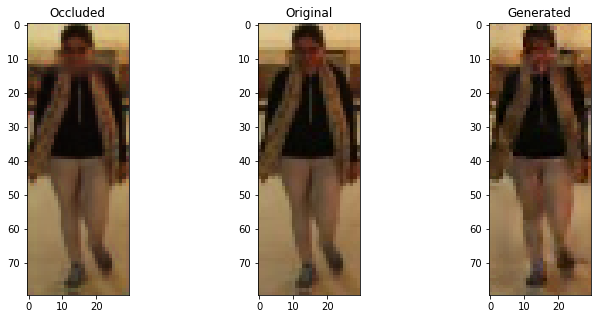

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


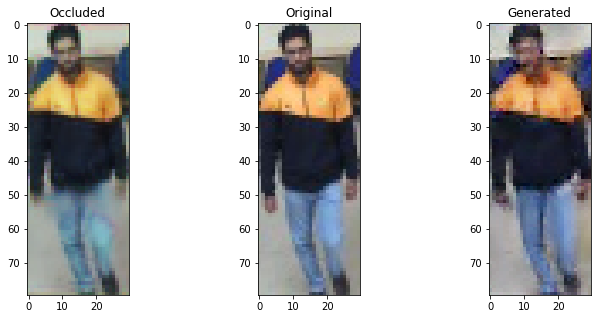

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


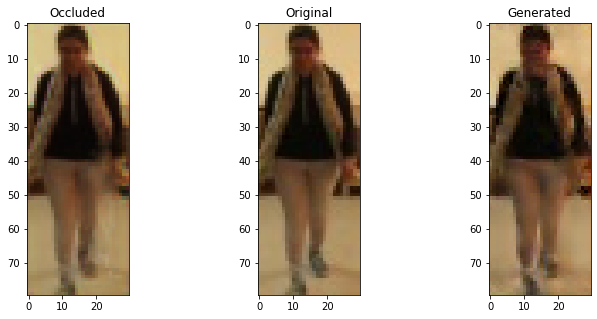

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


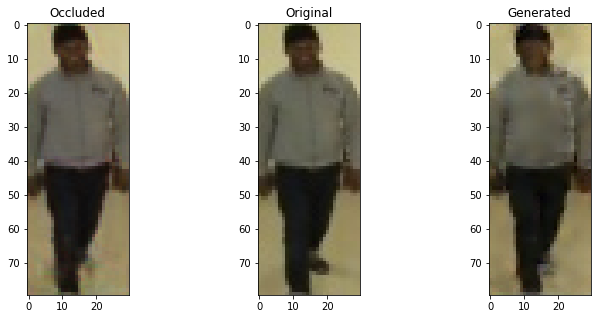

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


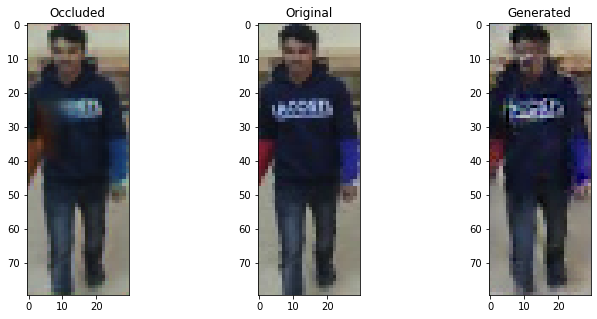

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6661324501037598 , Adversarial Loss:  0.002019729930907488
Epoch 922


  8%|▊         | 1/13 [00:00<00:01,  6.48it/s]

Discriminator Loss:  0.6548687815666199 , Adversarial Loss:  0.0020129838958382607
Epoch 923


  8%|▊         | 1/13 [00:00<00:01,  6.83it/s]

Discriminator Loss:  0.655849277973175 , Adversarial Loss:  0.0017015112098306417
Epoch 924


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6617202758789062 , Adversarial Loss:  0.0015292239841073751
Epoch 925


  8%|▊         | 1/13 [00:00<00:02,  5.96it/s]

Discriminator Loss:  0.6535911560058594 , Adversarial Loss:  0.001441435655578971
Epoch 926


  8%|▊         | 1/13 [00:00<00:01,  6.71it/s]

Discriminator Loss:  0.6646904945373535 , Adversarial Loss:  0.0014203342143446207
Epoch 927


  8%|▊         | 1/13 [00:00<00:01,  6.52it/s]

Discriminator Loss:  0.6566987037658691 , Adversarial Loss:  0.0014722826890647411
Epoch 928


  8%|▊         | 1/13 [00:00<00:01,  6.28it/s]

Discriminator Loss:  0.6825132966041565 , Adversarial Loss:  0.0014153318479657173
Epoch 929


  8%|▊         | 1/13 [00:00<00:02,  5.31it/s]

Discriminator Loss:  0.6575012803077698 , Adversarial Loss:  0.0012343821581453085
Epoch 930


  8%|▊         | 1/13 [00:00<00:01,  6.50it/s]

Discriminator Loss:  0.6673175692558289 , Adversarial Loss:  0.0012531953398138285
Epoch 931


  8%|▊         | 1/13 [00:00<00:01,  6.57it/s]

Discriminator Loss:  0.6336067914962769 , Adversarial Loss:  0.0012349828612059355
Epoch 932


  8%|▊         | 1/13 [00:00<00:01,  6.79it/s]

Discriminator Loss:  0.6484133005142212 , Adversarial Loss:  0.0012768898159265518
Epoch 933


  8%|▊         | 1/13 [00:00<00:01,  6.91it/s]

Discriminator Loss:  0.6788966655731201 , Adversarial Loss:  0.001088102930225432
Epoch 934


  8%|▊         | 1/13 [00:00<00:01,  6.40it/s]

Discriminator Loss:  0.6593675017356873 , Adversarial Loss:  0.0011008576257154346
Epoch 935


  8%|▊         | 1/13 [00:00<00:01,  6.29it/s]

Discriminator Loss:  0.664269208908081 , Adversarial Loss:  0.0011721306946128607
Epoch 936


  8%|▊         | 1/13 [00:00<00:01,  6.59it/s]

Discriminator Loss:  0.6561151146888733 , Adversarial Loss:  0.0011259418679401278
Epoch 937


  8%|▊         | 1/13 [00:00<00:01,  6.70it/s]

Discriminator Loss:  0.6419697999954224 , Adversarial Loss:  0.001049274462275207
Epoch 938


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6368286609649658 , Adversarial Loss:  0.0010648268507793546
Epoch 939


  8%|▊         | 1/13 [00:00<00:01,  6.71it/s]

Discriminator Loss:  0.6340287327766418 , Adversarial Loss:  0.0010460785124450922
Epoch 940


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6426993608474731 , Adversarial Loss:  0.0012926950585097075
Epoch 941


100%|██████████| 13/13 [00:02<00:00,  6.20it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


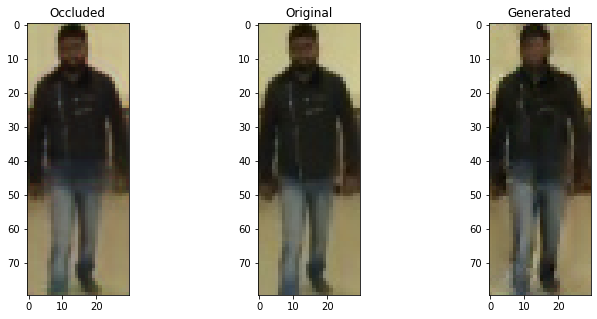

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


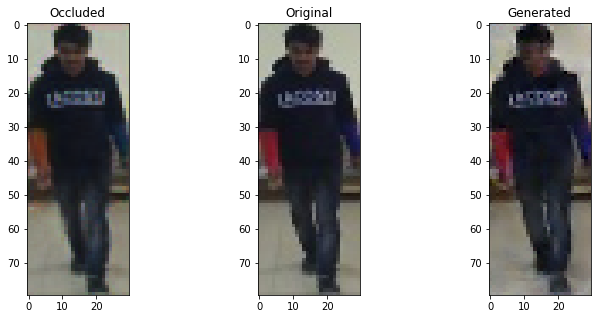

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


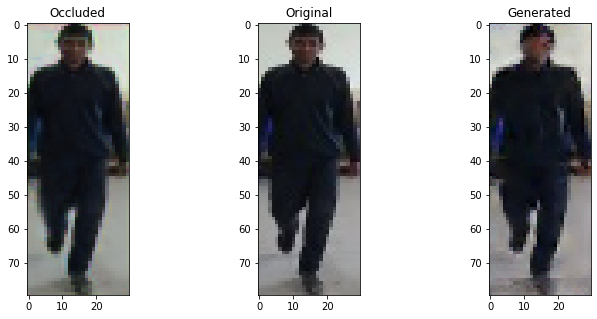

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


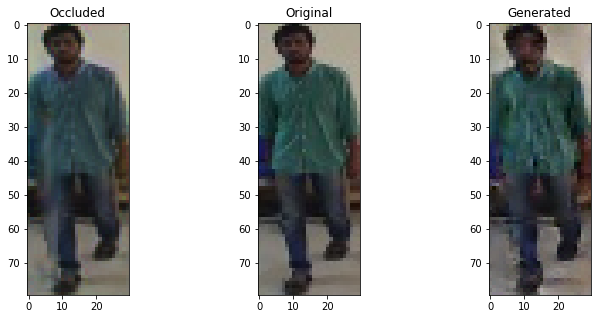

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


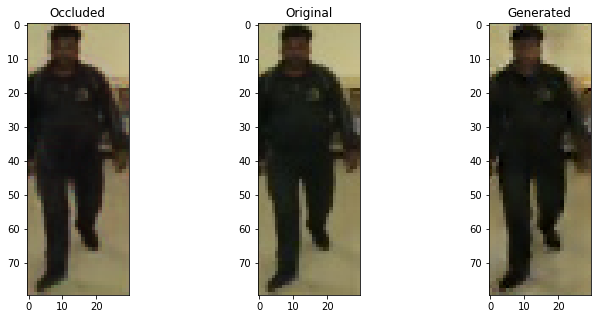

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6648927927017212 , Adversarial Loss:  0.0011479477398097515
Epoch 942


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6434631943702698 , Adversarial Loss:  0.0011715565342456102
Epoch 943


  8%|▊         | 1/13 [00:00<00:01,  6.39it/s]

Discriminator Loss:  0.6453667879104614 , Adversarial Loss:  0.001060487818904221
Epoch 944


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.674518346786499 , Adversarial Loss:  0.0011294051073491573
Epoch 945


  8%|▊         | 1/13 [00:00<00:02,  5.81it/s]

Discriminator Loss:  0.637600302696228 , Adversarial Loss:  0.001031222753226757
Epoch 946


  8%|▊         | 1/13 [00:00<00:01,  6.47it/s]

Discriminator Loss:  0.666178286075592 , Adversarial Loss:  0.001142340712249279
Epoch 947


  8%|▊         | 1/13 [00:00<00:01,  6.31it/s]

Discriminator Loss:  0.661700963973999 , Adversarial Loss:  0.001102198613807559
Epoch 948


  8%|▊         | 1/13 [00:00<00:02,  5.81it/s]

Discriminator Loss:  0.6607149839401245 , Adversarial Loss:  0.0010836721630766988
Epoch 949


  8%|▊         | 1/13 [00:00<00:01,  6.34it/s]

Discriminator Loss:  0.6636233329772949 , Adversarial Loss:  0.001078438712283969
Epoch 950


  8%|▊         | 1/13 [00:00<00:02,  5.99it/s]

Discriminator Loss:  0.6560667753219604 , Adversarial Loss:  0.0010716876713559031
Epoch 951


  8%|▊         | 1/13 [00:00<00:01,  6.59it/s]

Discriminator Loss:  0.6540783047676086 , Adversarial Loss:  0.0010962516535073519
Epoch 952


  8%|▊         | 1/13 [00:00<00:01,  6.89it/s]

Discriminator Loss:  0.6613458395004272 , Adversarial Loss:  0.0009905074257403612
Epoch 953


  8%|▊         | 1/13 [00:00<00:01,  6.77it/s]

Discriminator Loss:  0.6636333465576172 , Adversarial Loss:  0.0010885000228881836
Epoch 954


  8%|▊         | 1/13 [00:00<00:02,  5.63it/s]

Discriminator Loss:  0.6695151925086975 , Adversarial Loss:  0.0010562429670244455
Epoch 955


  8%|▊         | 1/13 [00:00<00:01,  6.25it/s]

Discriminator Loss:  0.6526853442192078 , Adversarial Loss:  0.0009942628676071763
Epoch 956


  8%|▊         | 1/13 [00:00<00:01,  6.35it/s]

Discriminator Loss:  0.6442273855209351 , Adversarial Loss:  0.0010043091606348753
Epoch 957


  8%|▊         | 1/13 [00:00<00:01,  6.46it/s]

Discriminator Loss:  0.6581881642341614 , Adversarial Loss:  0.0010988061549142003
Epoch 958


  8%|▊         | 1/13 [00:00<00:01,  6.55it/s]

Discriminator Loss:  0.6379977464675903 , Adversarial Loss:  0.000992006273008883
Epoch 959


  8%|▊         | 1/13 [00:00<00:01,  6.48it/s]

Discriminator Loss:  0.6257637739181519 , Adversarial Loss:  0.0010127832647413015
Epoch 960


  8%|▊         | 1/13 [00:00<00:01,  6.40it/s]

Discriminator Loss:  0.6690362691879272 , Adversarial Loss:  0.0010633488418534398
Epoch 961


100%|██████████| 13/13 [00:02<00:00,  5.95it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


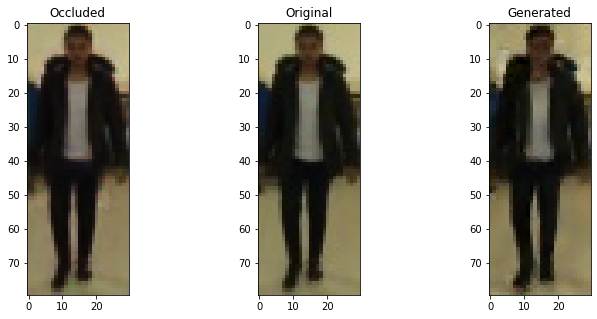

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


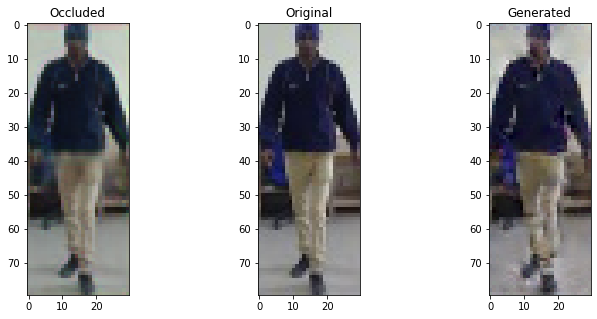

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


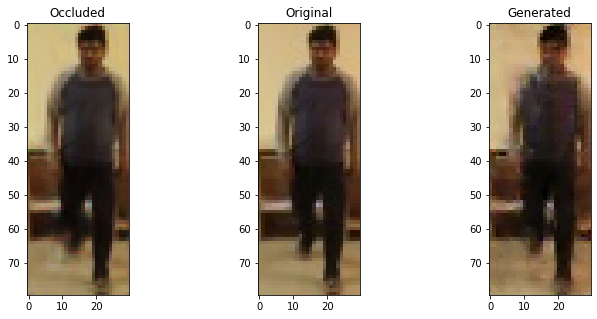

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


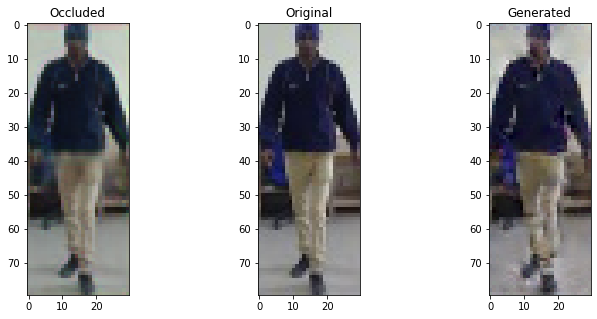

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


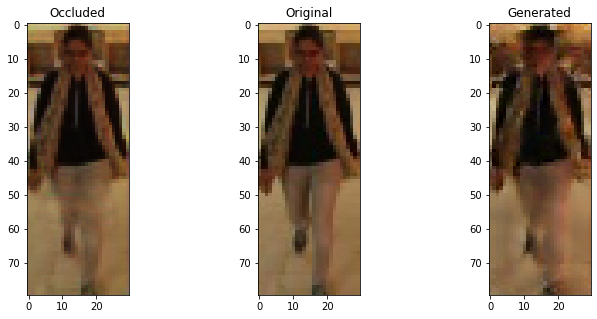

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6570135354995728 , Adversarial Loss:  0.0010039800545200706
Epoch 962


  8%|▊         | 1/13 [00:00<00:02,  5.19it/s]

Discriminator Loss:  0.675905704498291 , Adversarial Loss:  0.0010200664401054382
Epoch 963


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6811096668243408 , Adversarial Loss:  0.0008498812094330788
Epoch 964


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6520823836326599 , Adversarial Loss:  0.0010866677621379495
Epoch 965


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6569277048110962 , Adversarial Loss:  0.0010370949748903513
Epoch 966


  8%|▊         | 1/13 [00:00<00:01,  6.02it/s]

Discriminator Loss:  0.6304069757461548 , Adversarial Loss:  0.0009120000177063048
Epoch 967


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6394036412239075 , Adversarial Loss:  0.0010210649343207479
Epoch 968


  8%|▊         | 1/13 [00:00<00:01,  6.09it/s]

Discriminator Loss:  0.6614305973052979 , Adversarial Loss:  0.00099335762206465
Epoch 969


  8%|▊         | 1/13 [00:00<00:02,  5.94it/s]

Discriminator Loss:  0.6674411296844482 , Adversarial Loss:  0.0009740080568008125
Epoch 970


  8%|▊         | 1/13 [00:00<00:01,  6.57it/s]

Discriminator Loss:  0.6706947684288025 , Adversarial Loss:  0.0009423334267921746
Epoch 971


  8%|▊         | 1/13 [00:00<00:01,  6.36it/s]

Discriminator Loss:  0.6790136098861694 , Adversarial Loss:  0.0008637936552986503
Epoch 972


  8%|▊         | 1/13 [00:00<00:01,  6.28it/s]

Discriminator Loss:  0.6603613495826721 , Adversarial Loss:  0.0009847412584349513
Epoch 973


  8%|▊         | 1/13 [00:00<00:01,  6.52it/s]

Discriminator Loss:  0.6436293125152588 , Adversarial Loss:  0.0008605296025052667
Epoch 974


  8%|▊         | 1/13 [00:00<00:01,  6.27it/s]

Discriminator Loss:  0.6631583571434021 , Adversarial Loss:  0.0010433921124786139
Epoch 975


  8%|▊         | 1/13 [00:00<00:02,  5.49it/s]

Discriminator Loss:  0.6523144841194153 , Adversarial Loss:  0.0009072802495211363
Epoch 976


  8%|▊         | 1/13 [00:00<00:01,  6.58it/s]

Discriminator Loss:  0.6595739126205444 , Adversarial Loss:  0.0009663200471550226
Epoch 977


  8%|▊         | 1/13 [00:00<00:01,  6.71it/s]

Discriminator Loss:  0.6825461387634277 , Adversarial Loss:  0.0008745014201849699
Epoch 978


  8%|▊         | 1/13 [00:00<00:01,  6.71it/s]

Discriminator Loss:  0.6512304544448853 , Adversarial Loss:  0.0009065435733646154
Epoch 979


  8%|▊         | 1/13 [00:00<00:01,  6.50it/s]

Discriminator Loss:  0.6494364738464355 , Adversarial Loss:  0.0009357775561511517
Epoch 980


  8%|▊         | 1/13 [00:00<00:01,  6.43it/s]

Discriminator Loss:  0.6610305309295654 , Adversarial Loss:  0.0008846915443427861
Epoch 981


100%|██████████| 13/13 [00:02<00:00,  6.05it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


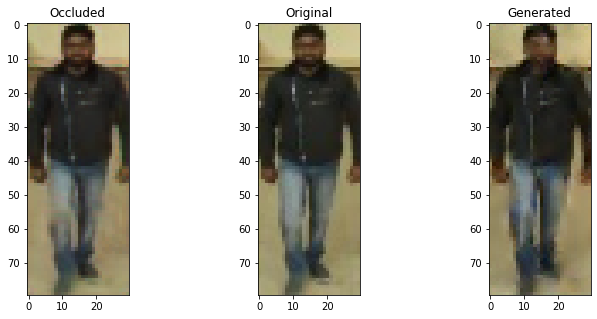

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


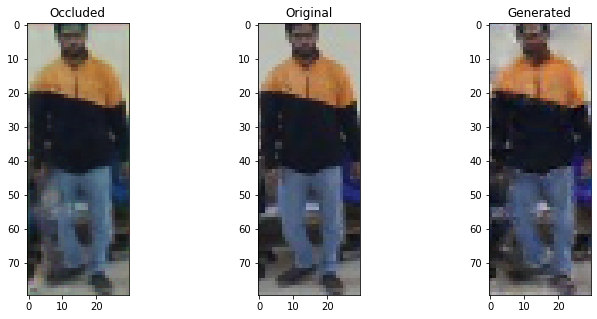

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


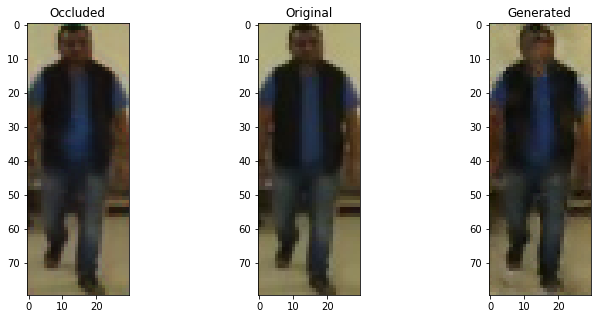

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


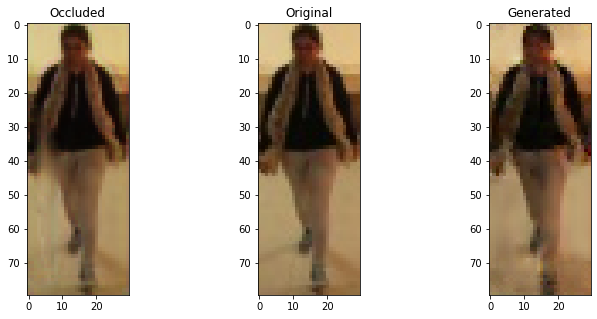

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


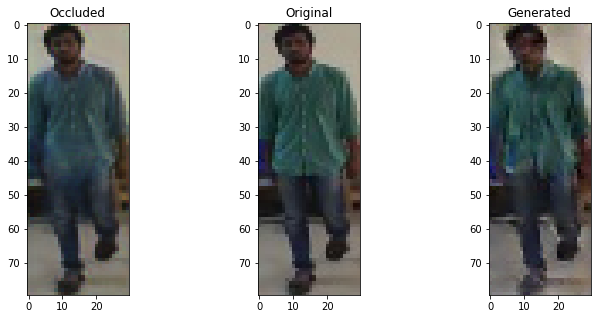

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6626806259155273 , Adversarial Loss:  0.000858661369420588
Epoch 982


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6794543266296387 , Adversarial Loss:  0.0007788777584210038
Epoch 983


  8%|▊         | 1/13 [00:00<00:02,  5.24it/s]

Discriminator Loss:  0.6468161344528198 , Adversarial Loss:  0.0009325318969786167
Epoch 984


  8%|▊         | 1/13 [00:00<00:02,  5.81it/s]

Discriminator Loss:  0.6618734002113342 , Adversarial Loss:  0.0008397112833335996
Epoch 985


  8%|▊         | 1/13 [00:00<00:01,  6.21it/s]

Discriminator Loss:  0.658825159072876 , Adversarial Loss:  0.0008589050266891718
Epoch 986


  8%|▊         | 1/13 [00:00<00:02,  5.26it/s]

Discriminator Loss:  0.6436195373535156 , Adversarial Loss:  0.000923221290577203
Epoch 987


  8%|▊         | 1/13 [00:00<00:01,  6.51it/s]

Discriminator Loss:  0.6628413200378418 , Adversarial Loss:  0.0008567488985136151
Epoch 988


  8%|▊         | 1/13 [00:00<00:02,  5.97it/s]

Discriminator Loss:  0.6620357036590576 , Adversarial Loss:  0.0008691273396834731
Epoch 989


  8%|▊         | 1/13 [00:00<00:01,  6.19it/s]

Discriminator Loss:  0.6733865141868591 , Adversarial Loss:  0.0008440287783741951
Epoch 990


  8%|▊         | 1/13 [00:00<00:01,  6.20it/s]

Discriminator Loss:  0.6722903251647949 , Adversarial Loss:  0.000956348143517971
Epoch 991


  8%|▊         | 1/13 [00:00<00:01,  6.14it/s]

Discriminator Loss:  0.6496717929840088 , Adversarial Loss:  0.0008401632076129317
Epoch 992


  8%|▊         | 1/13 [00:00<00:02,  5.91it/s]

Discriminator Loss:  0.6412050724029541 , Adversarial Loss:  0.0009149335091933608
Epoch 993


  8%|▊         | 1/13 [00:00<00:01,  6.76it/s]

Discriminator Loss:  0.6757889986038208 , Adversarial Loss:  0.0008662272011861205
Epoch 994


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6885901689529419 , Adversarial Loss:  0.0009024147875607014
Epoch 995


  8%|▊         | 1/13 [00:00<00:02,  5.90it/s]

Discriminator Loss:  0.6344794034957886 , Adversarial Loss:  0.0008621827582828701
Epoch 996


  8%|▊         | 1/13 [00:00<00:01,  6.67it/s]

Discriminator Loss:  0.6597706079483032 , Adversarial Loss:  0.0008972920477390289
Epoch 997


  8%|▊         | 1/13 [00:00<00:01,  6.86it/s]

Discriminator Loss:  0.6516388058662415 , Adversarial Loss:  0.0008463123813271523
Epoch 998


  8%|▊         | 1/13 [00:00<00:01,  6.48it/s]

Discriminator Loss:  0.6616052389144897 , Adversarial Loss:  0.0009230987052433193
Epoch 999


  8%|▊         | 1/13 [00:00<00:01,  6.11it/s]

Discriminator Loss:  0.6752732396125793 , Adversarial Loss:  0.0009234867175109684
Epoch 1000


  8%|▊         | 1/13 [00:00<00:02,  5.17it/s]

Discriminator Loss:  0.6479671001434326 , Adversarial Loss:  0.0009074170375242829
Epoch 1001


100%|██████████| 13/13 [00:02<00:00,  5.72it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


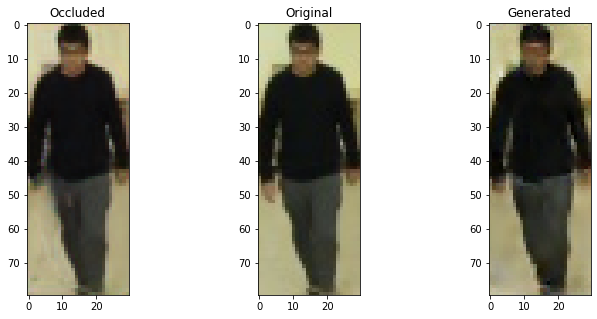

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


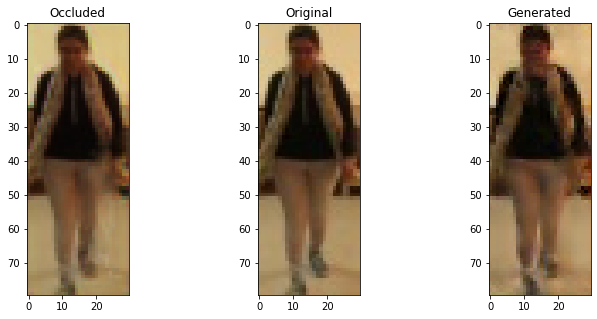

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


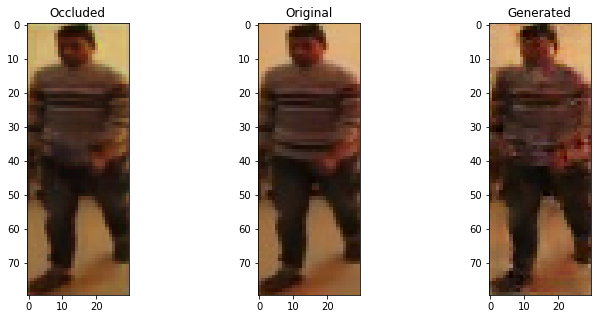

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


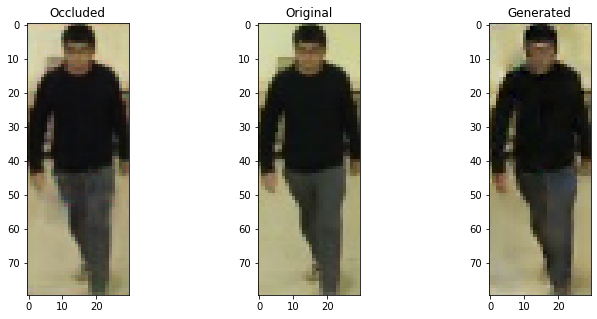

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


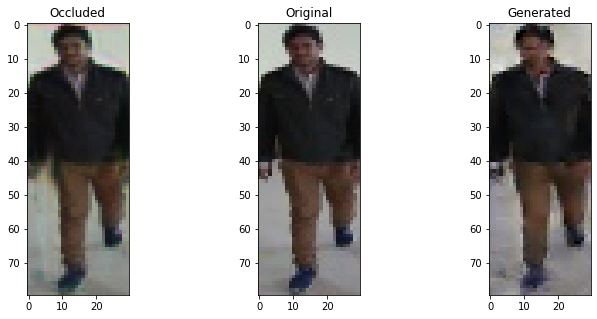

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6616894006729126 , Adversarial Loss:  0.0009215075988322496
Epoch 1002


  8%|▊         | 1/13 [00:00<00:01,  6.27it/s]

Discriminator Loss:  0.6555618643760681 , Adversarial Loss:  0.0009273227769881487
Epoch 1003


  8%|▊         | 1/13 [00:00<00:01,  6.63it/s]

Discriminator Loss:  0.6551247835159302 , Adversarial Loss:  0.000874324468895793
Epoch 1004


  8%|▊         | 1/13 [00:00<00:02,  5.87it/s]

Discriminator Loss:  0.669345498085022 , Adversarial Loss:  0.0008775914320722222
Epoch 1005


  8%|▊         | 1/13 [00:00<00:01,  6.68it/s]

Discriminator Loss:  0.6692337989807129 , Adversarial Loss:  0.0009239737410098314
Epoch 1006


  8%|▊         | 1/13 [00:00<00:01,  6.51it/s]

Discriminator Loss:  0.6598878502845764 , Adversarial Loss:  0.0008871532045304775
Epoch 1007


  8%|▊         | 1/13 [00:00<00:01,  6.19it/s]

Discriminator Loss:  0.6621124148368835 , Adversarial Loss:  0.0008843210525810719
Epoch 1008


  8%|▊         | 1/13 [00:00<00:01,  6.33it/s]

Discriminator Loss:  0.6858105063438416 , Adversarial Loss:  0.0009150073165073991
Epoch 1009


  8%|▊         | 1/13 [00:00<00:01,  6.02it/s]

Discriminator Loss:  0.6702091097831726 , Adversarial Loss:  0.0008722390048205853
Epoch 1010


  8%|▊         | 1/13 [00:00<00:01,  6.33it/s]

Discriminator Loss:  0.6688380837440491 , Adversarial Loss:  0.0008674095151945949
Epoch 1011


  8%|▊         | 1/13 [00:00<00:01,  6.05it/s]

Discriminator Loss:  0.6605029702186584 , Adversarial Loss:  0.0009035703260451555
Epoch 1012


  8%|▊         | 1/13 [00:00<00:01,  6.46it/s]

Discriminator Loss:  0.6642007827758789 , Adversarial Loss:  0.0009716888889670372
Epoch 1013


  8%|▊         | 1/13 [00:00<00:01,  6.44it/s]

Discriminator Loss:  0.664375901222229 , Adversarial Loss:  0.0008626026101410389
Epoch 1014


  8%|▊         | 1/13 [00:00<00:01,  6.33it/s]

Discriminator Loss:  0.6627998352050781 , Adversarial Loss:  0.0008869426674209535
Epoch 1015


  8%|▊         | 1/13 [00:00<00:01,  6.22it/s]

Discriminator Loss:  0.6732646226882935 , Adversarial Loss:  0.0008186330087482929
Epoch 1016


  8%|▊         | 1/13 [00:00<00:02,  5.36it/s]

Discriminator Loss:  0.666052520275116 , Adversarial Loss:  0.0009396601817570627
Epoch 1017


  8%|▊         | 1/13 [00:00<00:01,  6.27it/s]

Discriminator Loss:  0.6466590762138367 , Adversarial Loss:  0.0008629532530903816
Epoch 1018


  8%|▊         | 1/13 [00:00<00:01,  6.02it/s]

Discriminator Loss:  0.6477805972099304 , Adversarial Loss:  0.0009042093297466636
Epoch 1019


  8%|▊         | 1/13 [00:00<00:01,  6.51it/s]

Discriminator Loss:  0.6615347862243652 , Adversarial Loss:  0.000857618055306375
Epoch 1020


  8%|▊         | 1/13 [00:00<00:01,  6.21it/s]

Discriminator Loss:  0.6417332887649536 , Adversarial Loss:  0.000925086613278836
Epoch 1021


100%|██████████| 13/13 [00:02<00:00,  6.07it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


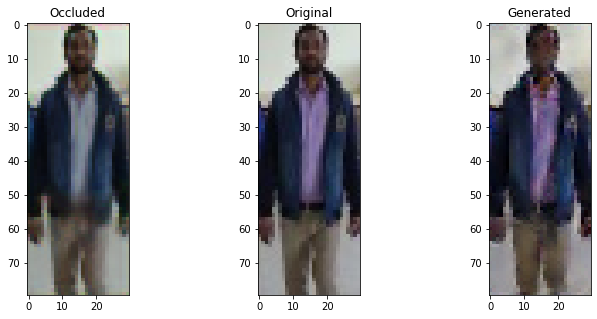

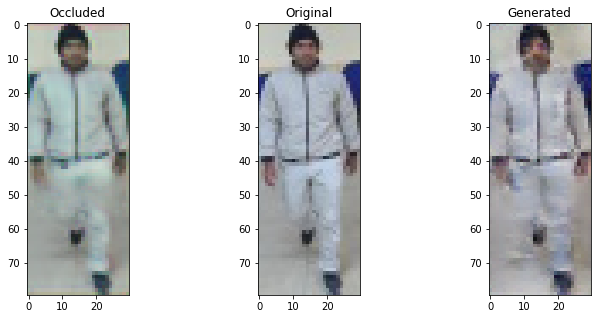

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


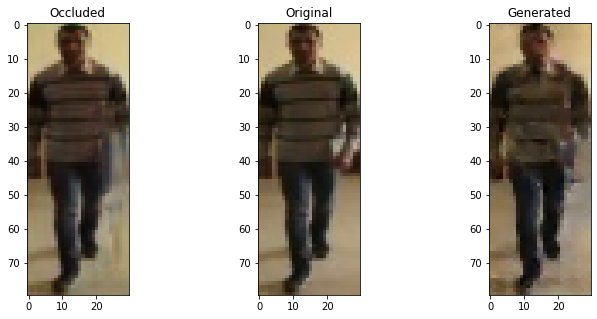

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


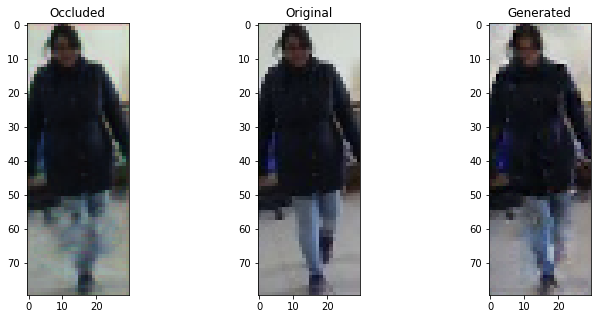

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


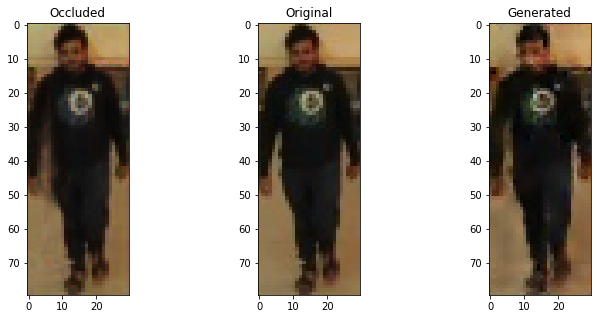

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6696494817733765 , Adversarial Loss:  0.0008185782935470343
Epoch 1022


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6609680652618408 , Adversarial Loss:  0.0009132762206718326
Epoch 1023


  8%|▊         | 1/13 [00:00<00:01,  6.41it/s]

Discriminator Loss:  0.6497179865837097 , Adversarial Loss:  0.0007874213042668998
Epoch 1024


  8%|▊         | 1/13 [00:00<00:01,  6.60it/s]

Discriminator Loss:  0.677586555480957 , Adversarial Loss:  0.0009344530408270657
Epoch 1025


  8%|▊         | 1/13 [00:00<00:01,  6.46it/s]

Discriminator Loss:  0.6394324898719788 , Adversarial Loss:  0.0008413786999881268
Epoch 1026


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6691572666168213 , Adversarial Loss:  0.0008650172967463732
Epoch 1027


  8%|▊         | 1/13 [00:00<00:01,  6.55it/s]

Discriminator Loss:  0.6531401872634888 , Adversarial Loss:  0.0008372364100068808
Epoch 1028


  8%|▊         | 1/13 [00:00<00:01,  6.12it/s]

Discriminator Loss:  0.6301217079162598 , Adversarial Loss:  0.00090111477766186
Epoch 1029


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6561184525489807 , Adversarial Loss:  0.0009275771444663405
Epoch 1030


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6345698833465576 , Adversarial Loss:  0.0008698776364326477
Epoch 1031


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6873290538787842 , Adversarial Loss:  0.0008190531516447663
Epoch 1032


  8%|▊         | 1/13 [00:00<00:01,  6.78it/s]

Discriminator Loss:  0.6439247131347656 , Adversarial Loss:  0.0008543481817469001
Epoch 1033


  8%|▊         | 1/13 [00:00<00:01,  6.41it/s]

Discriminator Loss:  0.6429826617240906 , Adversarial Loss:  0.0008027170551940799
Epoch 1034


  8%|▊         | 1/13 [00:00<00:02,  5.78it/s]

Discriminator Loss:  0.6409567594528198 , Adversarial Loss:  0.0007568703731521964
Epoch 1035


  8%|▊         | 1/13 [00:00<00:01,  6.36it/s]

Discriminator Loss:  0.6631945967674255 , Adversarial Loss:  0.0008612981182523072
Epoch 1036


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6600017547607422 , Adversarial Loss:  0.0008873810875229537
Epoch 1037


  8%|▊         | 1/13 [00:00<00:01,  6.59it/s]

Discriminator Loss:  0.6512068510055542 , Adversarial Loss:  0.0008274944266304374
Epoch 1038


  8%|▊         | 1/13 [00:00<00:01,  6.27it/s]

Discriminator Loss:  0.665321946144104 , Adversarial Loss:  0.000874178484082222
Epoch 1039


  8%|▊         | 1/13 [00:00<00:01,  6.74it/s]

Discriminator Loss:  0.6649166345596313 , Adversarial Loss:  0.0007888430263847113
Epoch 1040


  8%|▊         | 1/13 [00:00<00:01,  6.29it/s]

Discriminator Loss:  0.6666550636291504 , Adversarial Loss:  0.0008373139426112175
Epoch 1041


100%|██████████| 13/13 [00:02<00:00,  6.17it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


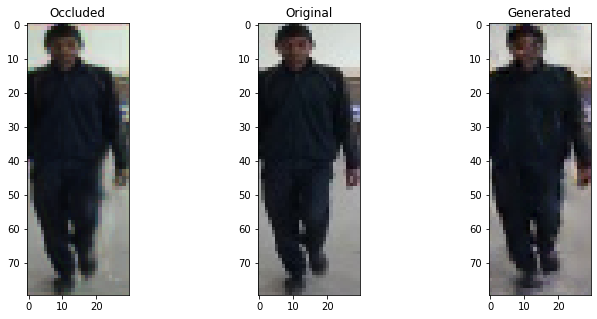

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


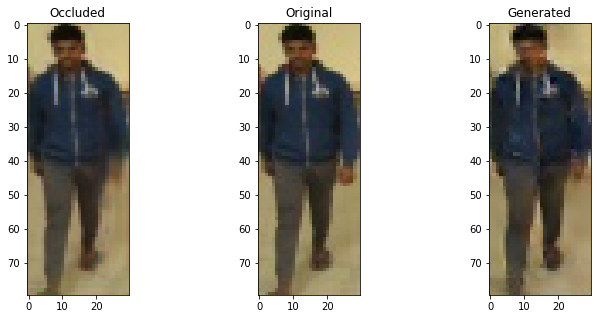

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


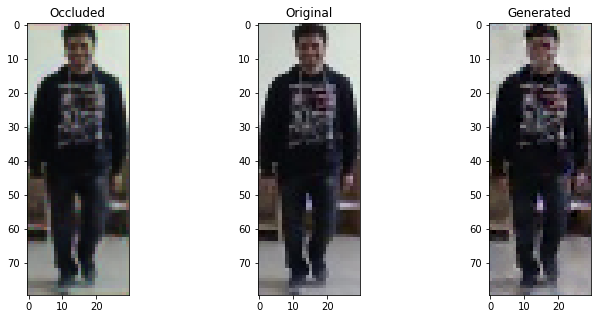

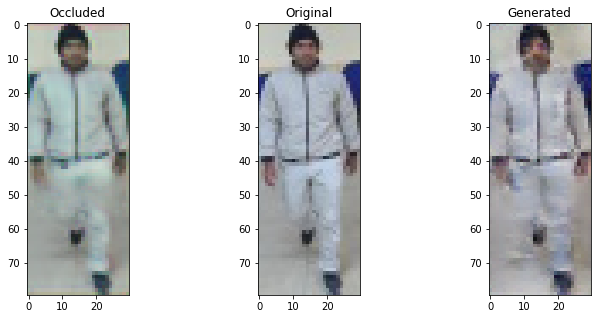

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


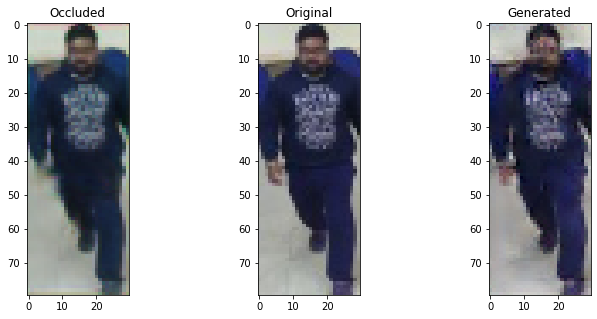

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6684043407440186 , Adversarial Loss:  0.0007177175721153617
Epoch 1042


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6577893495559692 , Adversarial Loss:  0.000832478457596153
Epoch 1043


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6519381403923035 , Adversarial Loss:  0.0008558914996683598
Epoch 1044


  8%|▊         | 1/13 [00:00<00:02,  5.77it/s]

Discriminator Loss:  0.665623128414154 , Adversarial Loss:  0.0007304312894120812
Epoch 1045


  8%|▊         | 1/13 [00:00<00:02,  5.70it/s]

Discriminator Loss:  0.6573079824447632 , Adversarial Loss:  0.0008374464232474566
Epoch 1046


  8%|▊         | 1/13 [00:00<00:01,  6.86it/s]

Discriminator Loss:  0.6484201550483704 , Adversarial Loss:  0.000805097573902458
Epoch 1047


  8%|▊         | 1/13 [00:00<00:01,  6.47it/s]

Discriminator Loss:  0.6611233949661255 , Adversarial Loss:  0.0007905344245955348
Epoch 1048


  8%|▊         | 1/13 [00:00<00:01,  6.33it/s]

Discriminator Loss:  0.6591892242431641 , Adversarial Loss:  0.0008323730435222387
Epoch 1049


  8%|▊         | 1/13 [00:00<00:01,  6.64it/s]

Discriminator Loss:  0.6489613652229309 , Adversarial Loss:  0.0008674197015352547
Epoch 1050


  8%|▊         | 1/13 [00:00<00:01,  6.35it/s]

Discriminator Loss:  0.6560627818107605 , Adversarial Loss:  0.0008787696715444326
Epoch 1051


  8%|▊         | 1/13 [00:00<00:01,  6.75it/s]

Discriminator Loss:  0.6564715504646301 , Adversarial Loss:  0.0009088821825571358
Epoch 1052


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6557695865631104 , Adversarial Loss:  0.0008484908612444997
Epoch 1053


  8%|▊         | 1/13 [00:00<00:01,  6.59it/s]

Discriminator Loss:  0.6731581687927246 , Adversarial Loss:  0.0007976538618095219
Epoch 1054


  8%|▊         | 1/13 [00:00<00:01,  6.51it/s]

Discriminator Loss:  0.6411439180374146 , Adversarial Loss:  0.0008785739773884416
Epoch 1055


  8%|▊         | 1/13 [00:00<00:01,  6.35it/s]

Discriminator Loss:  0.6519721746444702 , Adversarial Loss:  0.0007798646693117917
Epoch 1056


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6600356101989746 , Adversarial Loss:  0.0007479291525669396
Epoch 1057


  8%|▊         | 1/13 [00:00<00:02,  5.25it/s]

Discriminator Loss:  0.6597257852554321 , Adversarial Loss:  0.0008049322059378028
Epoch 1058


  8%|▊         | 1/13 [00:00<00:01,  6.12it/s]

Discriminator Loss:  0.6731730103492737 , Adversarial Loss:  0.0009724774281494319
Epoch 1059


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6432029008865356 , Adversarial Loss:  0.0008203249890357256
Epoch 1060


  8%|▊         | 1/13 [00:00<00:02,  5.16it/s]

Discriminator Loss:  0.6612371206283569 , Adversarial Loss:  0.0008255752036347985
Epoch 1061


100%|██████████| 13/13 [00:02<00:00,  5.02it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


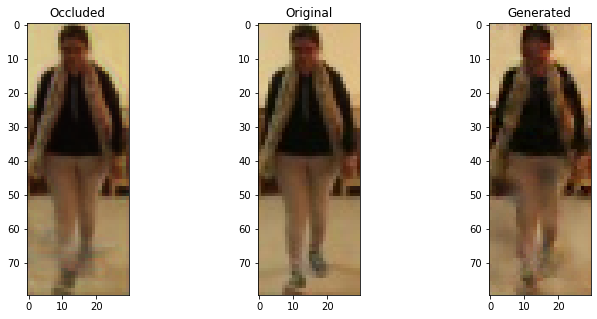

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


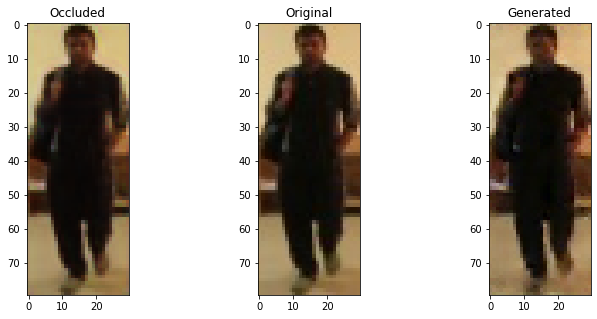

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


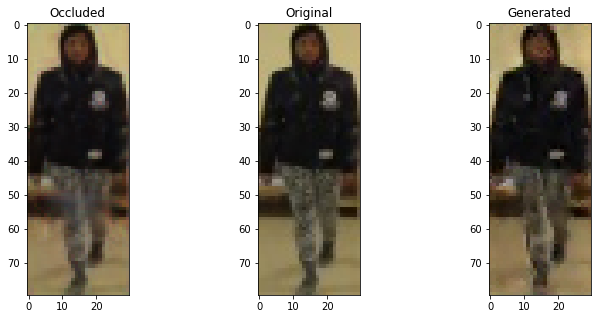

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


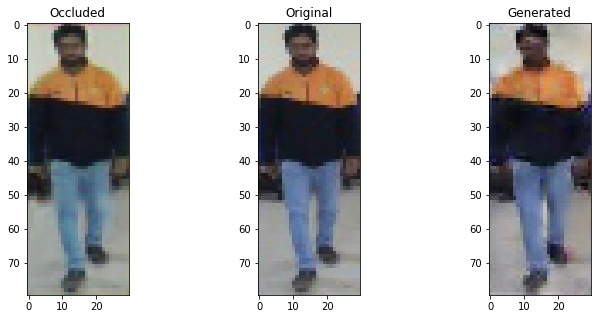

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


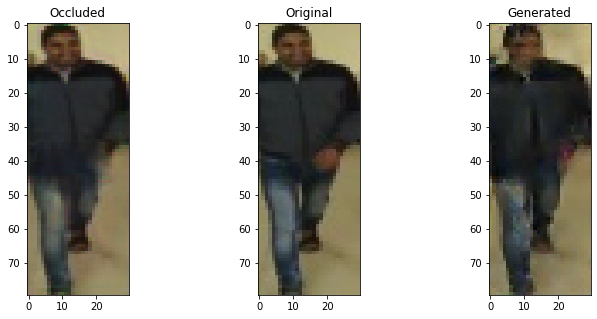

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.659177303314209 , Adversarial Loss:  0.0008881656685844064
Epoch 1062


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.66705322265625 , Adversarial Loss:  0.000692864297889173
Epoch 1063


  8%|▊         | 1/13 [00:00<00:02,  5.56it/s]

Discriminator Loss:  0.6508196592330933 , Adversarial Loss:  0.0008187241619452834
Epoch 1064


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6760727763175964 , Adversarial Loss:  0.0008351423311978579
Epoch 1065


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6664237976074219 , Adversarial Loss:  0.0008475229842588305
Epoch 1066


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6884607076644897 , Adversarial Loss:  0.0008065621368587017
Epoch 1067


  8%|▊         | 1/13 [00:00<00:01,  6.77it/s]

Discriminator Loss:  0.6563729047775269 , Adversarial Loss:  0.0008480784599669278
Epoch 1068


  8%|▊         | 1/13 [00:00<00:01,  6.30it/s]

Discriminator Loss:  0.673406720161438 , Adversarial Loss:  0.0007783574983477592
Epoch 1069


  8%|▊         | 1/13 [00:00<00:01,  6.30it/s]

Discriminator Loss:  0.6334792971611023 , Adversarial Loss:  0.0007705372991040349
Epoch 1070


  8%|▊         | 1/13 [00:00<00:01,  6.62it/s]

Discriminator Loss:  0.6773396134376526 , Adversarial Loss:  0.0008167332271113992
Epoch 1071


  8%|▊         | 1/13 [00:00<00:01,  6.32it/s]

Discriminator Loss:  0.6693304181098938 , Adversarial Loss:  0.0007518232450820506
Epoch 1072


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6635780334472656 , Adversarial Loss:  0.0008259440655820072
Epoch 1073


  8%|▊         | 1/13 [00:00<00:01,  6.20it/s]

Discriminator Loss:  0.63752281665802 , Adversarial Loss:  0.0008764370577409863
Epoch 1074


  8%|▊         | 1/13 [00:00<00:01,  6.59it/s]

Discriminator Loss:  0.6457457542419434 , Adversarial Loss:  0.0007784522022120655
Epoch 1075


  8%|▊         | 1/13 [00:00<00:01,  6.25it/s]

Discriminator Loss:  0.67674320936203 , Adversarial Loss:  0.0007752890232950449
Epoch 1076


  8%|▊         | 1/13 [00:00<00:01,  6.80it/s]

Discriminator Loss:  0.6592321395874023 , Adversarial Loss:  0.0007789760129526258
Epoch 1077


  8%|▊         | 1/13 [00:00<00:01,  6.72it/s]

Discriminator Loss:  0.6505184769630432 , Adversarial Loss:  0.0007879656623117626
Epoch 1078


  8%|▊         | 1/13 [00:00<00:01,  6.05it/s]

Discriminator Loss:  0.6696339249610901 , Adversarial Loss:  0.0007530511356890202
Epoch 1079


  8%|▊         | 1/13 [00:00<00:01,  6.23it/s]

Discriminator Loss:  0.6430219411849976 , Adversarial Loss:  0.0008487525628879666
Epoch 1080


  8%|▊         | 1/13 [00:00<00:01,  6.24it/s]

Discriminator Loss:  0.6683924198150635 , Adversarial Loss:  0.0008798839407972991
Epoch 1081


100%|██████████| 13/13 [00:02<00:00,  6.06it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


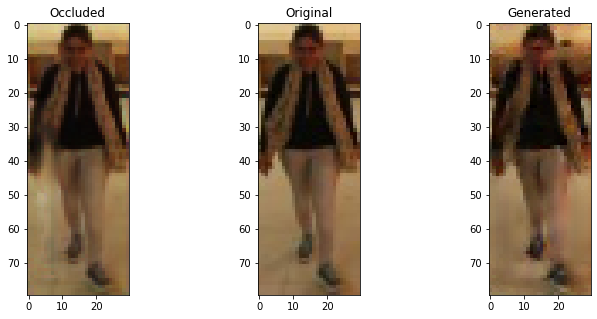

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


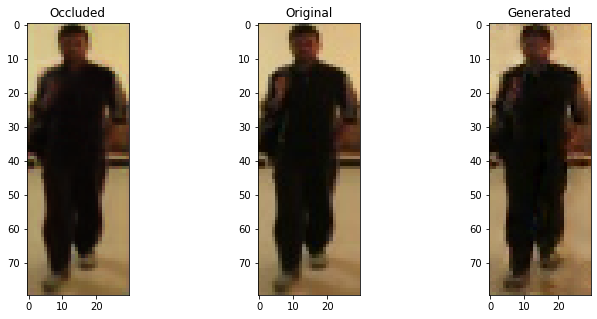

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


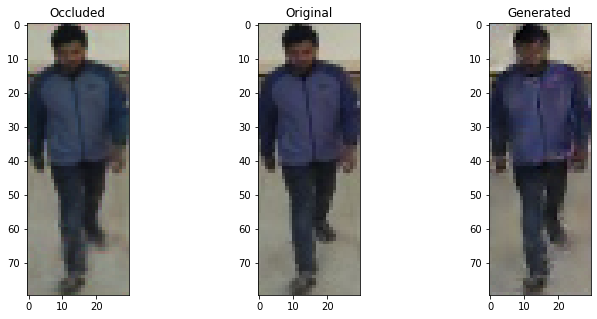

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


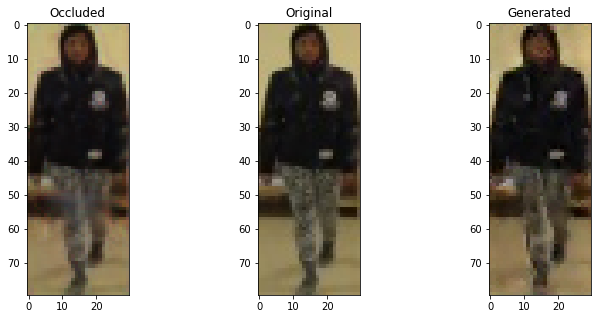

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


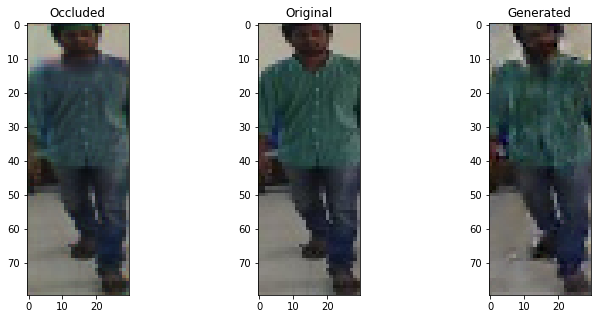

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6644065380096436 , Adversarial Loss:  0.0007551127928309143
Epoch 1082


  8%|▊         | 1/13 [00:00<00:02,  5.93it/s]

Discriminator Loss:  0.6838064789772034 , Adversarial Loss:  0.0008689680835232139
Epoch 1083


  8%|▊         | 1/13 [00:00<00:01,  6.59it/s]

Discriminator Loss:  0.6690884828567505 , Adversarial Loss:  0.0007668004836887121
Epoch 1084


  8%|▊         | 1/13 [00:00<00:01,  6.42it/s]

Discriminator Loss:  0.6635016202926636 , Adversarial Loss:  0.0007777015562169254
Epoch 1085


  8%|▊         | 1/13 [00:00<00:02,  5.80it/s]

Discriminator Loss:  0.6564764976501465 , Adversarial Loss:  0.0007996618514880538
Epoch 1086


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6688054800033569 , Adversarial Loss:  0.0008236659923568368
Epoch 1087


  8%|▊         | 1/13 [00:00<00:01,  6.55it/s]

Discriminator Loss:  0.6569318771362305 , Adversarial Loss:  0.0007775729754939675
Epoch 1088


  8%|▊         | 1/13 [00:00<00:01,  6.12it/s]

Discriminator Loss:  0.6569920182228088 , Adversarial Loss:  0.0008109178161248565
Epoch 1089


  8%|▊         | 1/13 [00:00<00:01,  6.16it/s]

Discriminator Loss:  0.6600927114486694 , Adversarial Loss:  0.000721918826457113
Epoch 1090


  8%|▊         | 1/13 [00:00<00:01,  6.35it/s]

Discriminator Loss:  0.6642810106277466 , Adversarial Loss:  0.0007328722858801484
Epoch 1091


  8%|▊         | 1/13 [00:00<00:01,  6.22it/s]

Discriminator Loss:  0.669695258140564 , Adversarial Loss:  0.0008597116684541106
Epoch 1092


  8%|▊         | 1/13 [00:00<00:02,  5.35it/s]

Discriminator Loss:  0.6448808908462524 , Adversarial Loss:  0.0007295673713088036
Epoch 1093


  8%|▊         | 1/13 [00:00<00:01,  6.52it/s]

Discriminator Loss:  0.6631045341491699 , Adversarial Loss:  0.0008252968546003103
Epoch 1094


  8%|▊         | 1/13 [00:00<00:01,  6.76it/s]

Discriminator Loss:  0.6476055979728699 , Adversarial Loss:  0.0007969375001266599
Epoch 1095


  8%|▊         | 1/13 [00:00<00:02,  5.77it/s]

Discriminator Loss:  0.6547673940658569 , Adversarial Loss:  0.0008527789614163339
Epoch 1096


  8%|▊         | 1/13 [00:00<00:02,  5.92it/s]

Discriminator Loss:  0.6553853750228882 , Adversarial Loss:  0.0008118631085380912
Epoch 1097


  8%|▊         | 1/13 [00:00<00:02,  5.92it/s]

Discriminator Loss:  0.6609962582588196 , Adversarial Loss:  0.0007778352592140436
Epoch 1098


  8%|▊         | 1/13 [00:00<00:01,  6.52it/s]

Discriminator Loss:  0.6611049771308899 , Adversarial Loss:  0.0007493344601243734
Epoch 1099


  8%|▊         | 1/13 [00:00<00:01,  6.47it/s]

Discriminator Loss:  0.6877834796905518 , Adversarial Loss:  0.000734325556550175
Epoch 1100


  8%|▊         | 1/13 [00:00<00:01,  6.57it/s]

Discriminator Loss:  0.649285614490509 , Adversarial Loss:  0.0007707914337515831
Epoch 1101


100%|██████████| 13/13 [00:02<00:00,  5.80it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


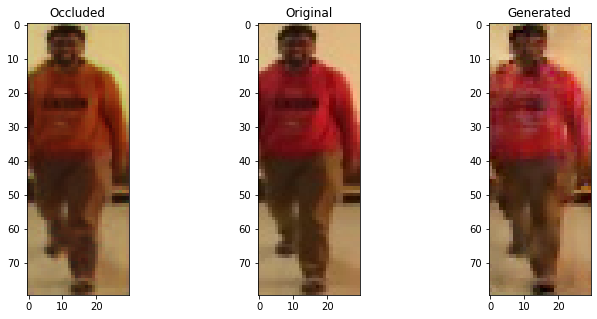

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


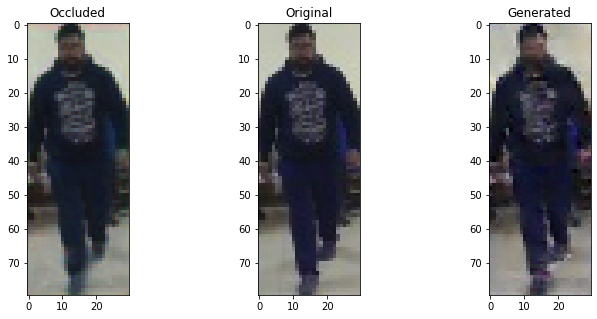

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


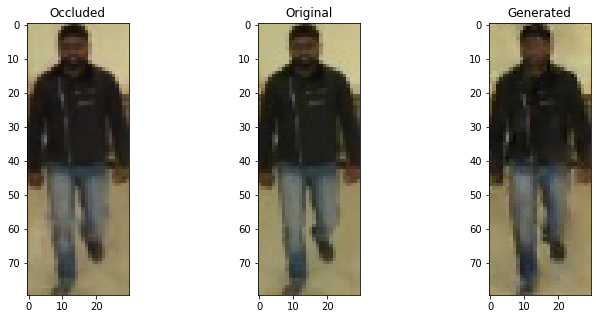

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


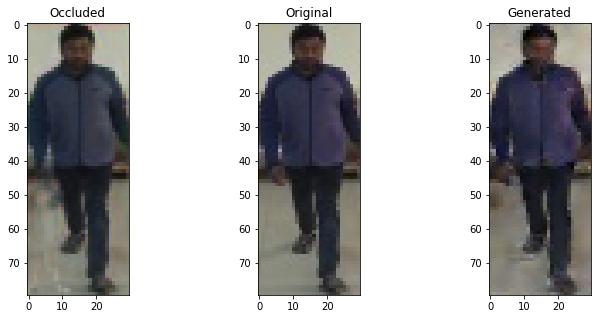

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


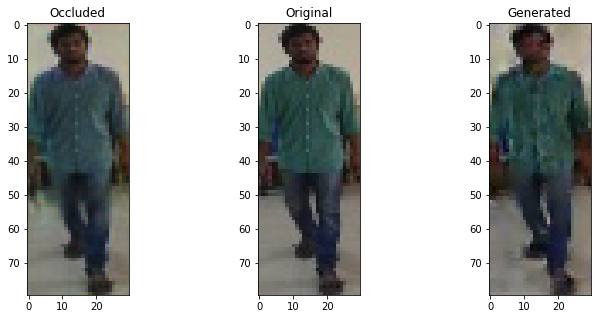

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6456290483474731 , Adversarial Loss:  0.0007526993867941201
Epoch 1102


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6887300610542297 , Adversarial Loss:  0.0008281215559691191
Epoch 1103


  8%|▊         | 1/13 [00:00<00:01,  6.43it/s]

Discriminator Loss:  0.6602983474731445 , Adversarial Loss:  0.0007813641568645835
Epoch 1104


  8%|▊         | 1/13 [00:00<00:01,  6.03it/s]

Discriminator Loss:  0.6554217338562012 , Adversarial Loss:  0.0008169112261384726
Epoch 1105


  8%|▊         | 1/13 [00:00<00:02,  5.37it/s]

Discriminator Loss:  0.6693980693817139 , Adversarial Loss:  0.0008408898138441145
Epoch 1106


  8%|▊         | 1/13 [00:00<00:01,  6.38it/s]

Discriminator Loss:  0.673234760761261 , Adversarial Loss:  0.0007188164163380861
Epoch 1107


  8%|▊         | 1/13 [00:00<00:01,  6.24it/s]

Discriminator Loss:  0.6480493545532227 , Adversarial Loss:  0.0007270770147442818
Epoch 1108


  8%|▊         | 1/13 [00:00<00:02,  5.98it/s]

Discriminator Loss:  0.6823362112045288 , Adversarial Loss:  0.0007818637532182038
Epoch 1109


  8%|▊         | 1/13 [00:00<00:01,  6.43it/s]

Discriminator Loss:  0.667084813117981 , Adversarial Loss:  0.0008404087275266647
Epoch 1110


  8%|▊         | 1/13 [00:00<00:01,  6.19it/s]

Discriminator Loss:  0.6769797801971436 , Adversarial Loss:  0.0008151321089826524
Epoch 1111


  8%|▊         | 1/13 [00:00<00:02,  5.19it/s]

Discriminator Loss:  0.6553343534469604 , Adversarial Loss:  0.0007309477077797055
Epoch 1112


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6331664323806763 , Adversarial Loss:  0.0008898850646801293
Epoch 1113


  8%|▊         | 1/13 [00:00<00:01,  6.09it/s]

Discriminator Loss:  0.6352656483650208 , Adversarial Loss:  0.0008285874500870705
Epoch 1114


  8%|▊         | 1/13 [00:00<00:02,  5.80it/s]

Discriminator Loss:  0.688984751701355 , Adversarial Loss:  0.0008501620031893253
Epoch 1115


  8%|▊         | 1/13 [00:00<00:01,  6.37it/s]

Discriminator Loss:  0.6561408042907715 , Adversarial Loss:  0.0007812088588252664
Epoch 1116


  8%|▊         | 1/13 [00:00<00:01,  6.71it/s]

Discriminator Loss:  0.6666609644889832 , Adversarial Loss:  0.0007923152297735214
Epoch 1117


  8%|▊         | 1/13 [00:00<00:02,  5.61it/s]

Discriminator Loss:  0.6508911848068237 , Adversarial Loss:  0.0007178738596849144
Epoch 1118


  8%|▊         | 1/13 [00:00<00:01,  6.23it/s]

Discriminator Loss:  0.6502361297607422 , Adversarial Loss:  0.0006954225245863199
Epoch 1119


  8%|▊         | 1/13 [00:00<00:02,  5.64it/s]

Discriminator Loss:  0.6652327179908752 , Adversarial Loss:  0.0007244597654789686
Epoch 1120


  8%|▊         | 1/13 [00:00<00:01,  7.09it/s]

Discriminator Loss:  0.6460777521133423 , Adversarial Loss:  0.0007300892029888928
Epoch 1121


100%|██████████| 13/13 [00:02<00:00,  6.20it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


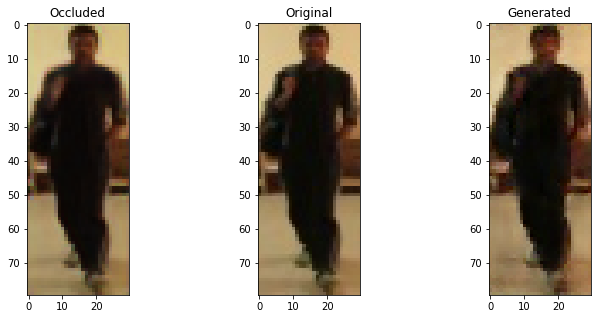

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


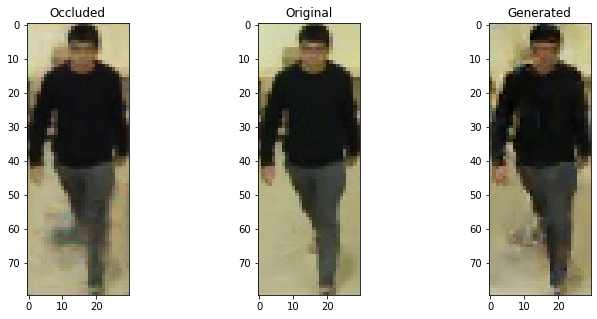

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


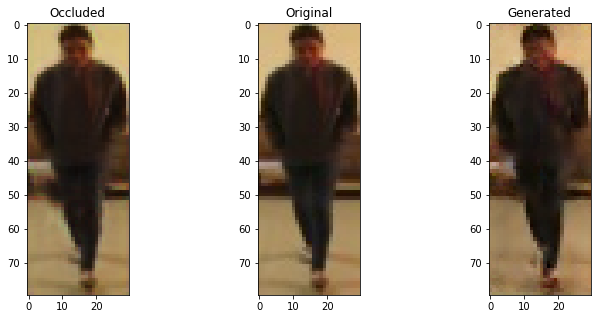

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


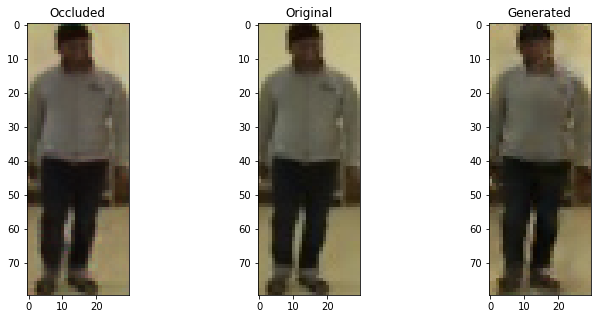

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


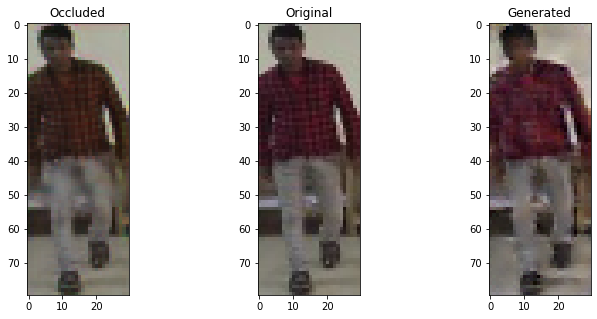

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6652654409408569 , Adversarial Loss:  0.000714178429916501
Epoch 1122


  8%|▊         | 1/13 [00:00<00:01,  6.12it/s]

Discriminator Loss:  0.6778509020805359 , Adversarial Loss:  0.0007713582599535584
Epoch 1123


  8%|▊         | 1/13 [00:00<00:01,  6.57it/s]

Discriminator Loss:  0.6647428870201111 , Adversarial Loss:  0.0007473143050447106
Epoch 1124


  8%|▊         | 1/13 [00:00<00:01,  6.44it/s]

Discriminator Loss:  0.6491385698318481 , Adversarial Loss:  0.0007782144239172339
Epoch 1125


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6666797995567322 , Adversarial Loss:  0.0007339056464843452
Epoch 1126


  8%|▊         | 1/13 [00:00<00:01,  6.51it/s]

Discriminator Loss:  0.6451771259307861 , Adversarial Loss:  0.0006893132231198251
Epoch 1127


  8%|▊         | 1/13 [00:00<00:01,  6.53it/s]

Discriminator Loss:  0.6822161674499512 , Adversarial Loss:  0.0007914481684565544
Epoch 1128


  8%|▊         | 1/13 [00:00<00:01,  6.30it/s]

Discriminator Loss:  0.6489027142524719 , Adversarial Loss:  0.0008023011614568532
Epoch 1129


  8%|▊         | 1/13 [00:00<00:01,  6.39it/s]

Discriminator Loss:  0.6523216366767883 , Adversarial Loss:  0.0008223840268328786
Epoch 1130


  8%|▊         | 1/13 [00:00<00:01,  6.71it/s]

Discriminator Loss:  0.6548886895179749 , Adversarial Loss:  0.0008158006239682436
Epoch 1131


  8%|▊         | 1/13 [00:00<00:01,  6.61it/s]

Discriminator Loss:  0.6757218837738037 , Adversarial Loss:  0.0007390819955617189
Epoch 1132


  8%|▊         | 1/13 [00:00<00:01,  6.19it/s]

Discriminator Loss:  0.6676881313323975 , Adversarial Loss:  0.0007425227668136358
Epoch 1133


  8%|▊         | 1/13 [00:00<00:01,  6.87it/s]

Discriminator Loss:  0.6566380858421326 , Adversarial Loss:  0.0007621398544870317
Epoch 1134


  8%|▊         | 1/13 [00:00<00:01,  6.29it/s]

Discriminator Loss:  0.6734325289726257 , Adversarial Loss:  0.000844533380586654
Epoch 1135


  8%|▊         | 1/13 [00:00<00:02,  5.42it/s]

Discriminator Loss:  0.6289361715316772 , Adversarial Loss:  0.0006854606326669455
Epoch 1136


  8%|▊         | 1/13 [00:00<00:01,  6.36it/s]

Discriminator Loss:  0.6660038232803345 , Adversarial Loss:  0.000631525763310492
Epoch 1137


  8%|▊         | 1/13 [00:00<00:01,  6.60it/s]

Discriminator Loss:  0.6655642986297607 , Adversarial Loss:  0.0007802282925695181
Epoch 1138


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6468478441238403 , Adversarial Loss:  0.0006954902783036232
Epoch 1139


  8%|▊         | 1/13 [00:00<00:01,  6.55it/s]

Discriminator Loss:  0.6482884287834167 , Adversarial Loss:  0.0008574483217671514
Epoch 1140


  8%|▊         | 1/13 [00:00<00:02,  5.79it/s]

Discriminator Loss:  0.6812695860862732 , Adversarial Loss:  0.0008491779444739223
Epoch 1141


100%|██████████| 13/13 [00:02<00:00,  6.00it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


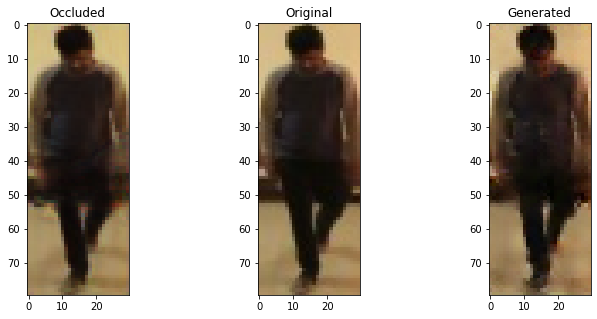

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


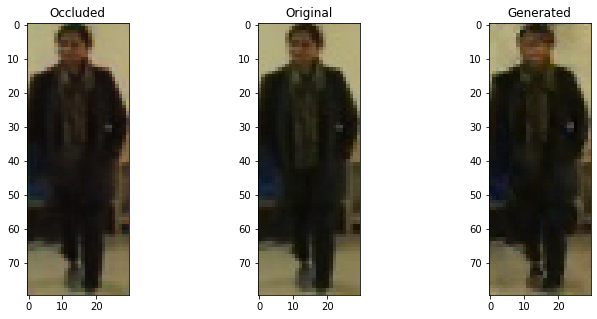

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


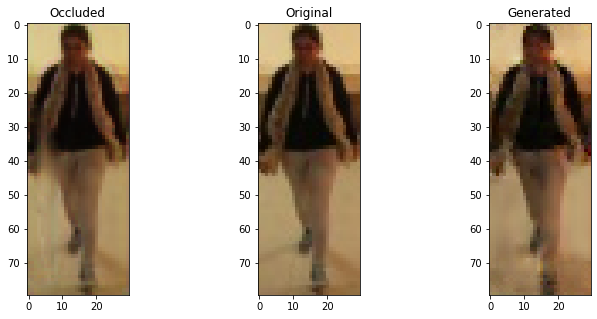

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


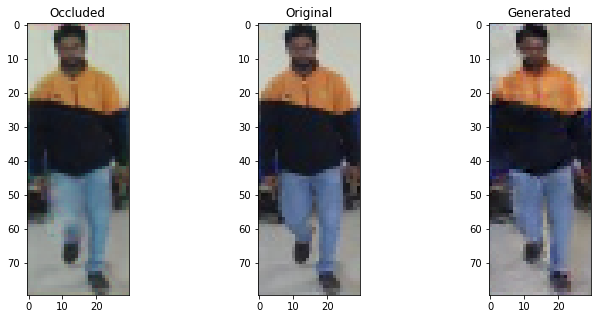

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


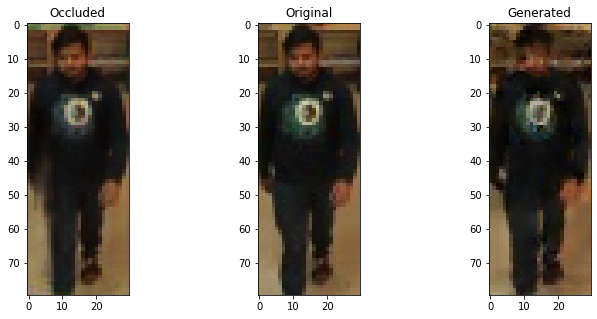

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6365522146224976 , Adversarial Loss:  0.0007372123072855175
Epoch 1142


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6448458433151245 , Adversarial Loss:  0.0007281563011929393
Epoch 1143


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6491419672966003 , Adversarial Loss:  0.0007967218989506364
Epoch 1144


  8%|▊         | 1/13 [00:00<00:01,  6.07it/s]

Discriminator Loss:  0.6658079028129578 , Adversarial Loss:  0.0007773321121931076
Epoch 1145


  8%|▊         | 1/13 [00:00<00:01,  6.80it/s]

Discriminator Loss:  0.6543039679527283 , Adversarial Loss:  0.0007346596103161573
Epoch 1146


  8%|▊         | 1/13 [00:00<00:01,  6.42it/s]

Discriminator Loss:  0.6453759670257568 , Adversarial Loss:  0.0007689883932471275
Epoch 1147


  8%|▊         | 1/13 [00:00<00:01,  6.51it/s]

Discriminator Loss:  0.7096505165100098 , Adversarial Loss:  0.0007507171831093729
Epoch 1148


  8%|▊         | 1/13 [00:00<00:02,  5.61it/s]

Discriminator Loss:  0.6747178435325623 , Adversarial Loss:  0.0007180500542744994
Epoch 1149


  8%|▊         | 1/13 [00:00<00:01,  6.62it/s]

Discriminator Loss:  0.6453166604042053 , Adversarial Loss:  0.0007161382818594575
Epoch 1150


  8%|▊         | 1/13 [00:00<00:01,  6.63it/s]

Discriminator Loss:  0.6642705202102661 , Adversarial Loss:  0.000667346699628979
Epoch 1151


  8%|▊         | 1/13 [00:00<00:01,  6.19it/s]

Discriminator Loss:  0.6510185599327087 , Adversarial Loss:  0.0007427394157275558
Epoch 1152


  8%|▊         | 1/13 [00:00<00:01,  6.85it/s]

Discriminator Loss:  0.6492602825164795 , Adversarial Loss:  0.0007651729974895716
Epoch 1153


  8%|▊         | 1/13 [00:00<00:01,  6.62it/s]

Discriminator Loss:  0.6940191984176636 , Adversarial Loss:  0.0007453153375536203
Epoch 1154


  8%|▊         | 1/13 [00:00<00:01,  6.06it/s]

Discriminator Loss:  0.6444664597511292 , Adversarial Loss:  0.0007532351883128285
Epoch 1155


  8%|▊         | 1/13 [00:00<00:01,  6.02it/s]

Discriminator Loss:  0.655371904373169 , Adversarial Loss:  0.0007309654611162841
Epoch 1156


  8%|▊         | 1/13 [00:00<00:01,  6.30it/s]

Discriminator Loss:  0.666083037853241 , Adversarial Loss:  0.0007291364599950612
Epoch 1157


  8%|▊         | 1/13 [00:00<00:01,  6.59it/s]

Discriminator Loss:  0.663422703742981 , Adversarial Loss:  0.001116218976676464
Epoch 1158


  8%|▊         | 1/13 [00:00<00:02,  5.99it/s]

Discriminator Loss:  0.6505500674247742 , Adversarial Loss:  0.008550520986318588
Epoch 1159


  8%|▊         | 1/13 [00:00<00:02,  5.96it/s]

Discriminator Loss:  0.6542956233024597 , Adversarial Loss:  0.005090488586574793
Epoch 1160


  8%|▊         | 1/13 [00:00<00:01,  6.23it/s]

Discriminator Loss:  0.6635804176330566 , Adversarial Loss:  0.003745111869648099
Epoch 1161


100%|██████████| 13/13 [00:02<00:00,  6.03it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


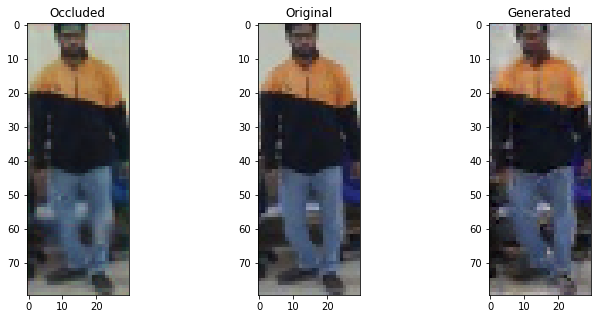

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


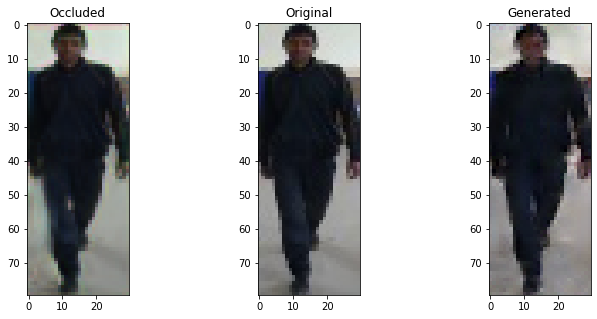

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


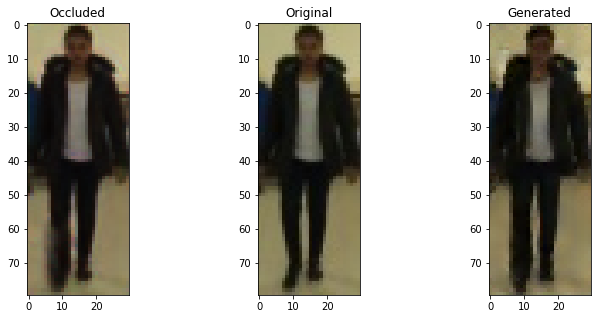

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


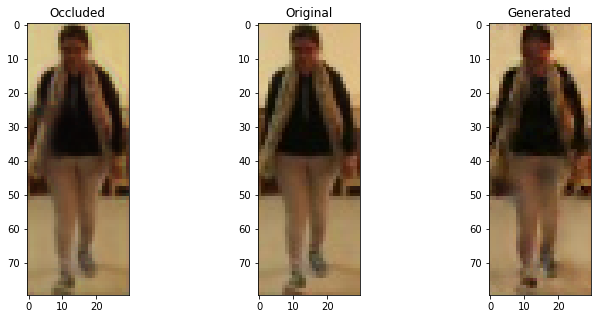

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


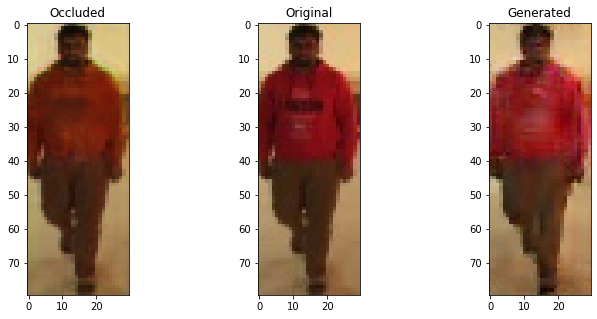

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6754379272460938 , Adversarial Loss:  0.002800990594550967
Epoch 1162


  8%|▊         | 1/13 [00:00<00:01,  6.07it/s]

Discriminator Loss:  0.6761505603790283 , Adversarial Loss:  0.0024148887023329735
Epoch 1163


  8%|▊         | 1/13 [00:00<00:01,  6.41it/s]

Discriminator Loss:  0.6711589097976685 , Adversarial Loss:  0.002121396828442812
Epoch 1164


  8%|▊         | 1/13 [00:00<00:02,  5.83it/s]

Discriminator Loss:  0.6545040607452393 , Adversarial Loss:  0.0018731006421148777
Epoch 1165


  8%|▊         | 1/13 [00:00<00:01,  6.04it/s]

Discriminator Loss:  0.6471588611602783 , Adversarial Loss:  0.0020250354427844286
Epoch 1166


  8%|▊         | 1/13 [00:00<00:01,  6.66it/s]

Discriminator Loss:  0.6420884132385254 , Adversarial Loss:  0.0019151557935401797
Epoch 1167


  8%|▊         | 1/13 [00:00<00:01,  6.86it/s]

Discriminator Loss:  0.6666747331619263 , Adversarial Loss:  0.0015093954280018806
Epoch 1168


  8%|▊         | 1/13 [00:00<00:02,  5.89it/s]

Discriminator Loss:  0.6625974178314209 , Adversarial Loss:  0.0013578964862972498
Epoch 1169


  8%|▊         | 1/13 [00:00<00:01,  6.65it/s]

Discriminator Loss:  0.6524081230163574 , Adversarial Loss:  0.0013921289937570691
Epoch 1170


  8%|▊         | 1/13 [00:00<00:01,  6.73it/s]

Discriminator Loss:  0.6597294807434082 , Adversarial Loss:  0.0013301731087267399
Epoch 1171


  8%|▊         | 1/13 [00:00<00:01,  6.46it/s]

Discriminator Loss:  0.6757299900054932 , Adversarial Loss:  0.0012712159659713507
Epoch 1172


  8%|▊         | 1/13 [00:00<00:02,  5.49it/s]

Discriminator Loss:  0.6408892273902893 , Adversarial Loss:  0.0011940111871808767
Epoch 1173


  8%|▊         | 1/13 [00:00<00:01,  6.24it/s]

Discriminator Loss:  0.6736174821853638 , Adversarial Loss:  0.001189124071970582
Epoch 1174


  8%|▊         | 1/13 [00:00<00:01,  6.43it/s]

Discriminator Loss:  0.6752520203590393 , Adversarial Loss:  0.0010587975848466158
Epoch 1175


  8%|▊         | 1/13 [00:00<00:01,  6.99it/s]

Discriminator Loss:  0.6447577476501465 , Adversarial Loss:  0.0010485919192433357
Epoch 1176


  8%|▊         | 1/13 [00:00<00:02,  5.29it/s]

Discriminator Loss:  0.6602438688278198 , Adversarial Loss:  0.0009280515369027853
Epoch 1177


  8%|▊         | 1/13 [00:00<00:02,  5.96it/s]

Discriminator Loss:  0.6713029146194458 , Adversarial Loss:  0.0010274929227307439
Epoch 1178


  8%|▊         | 1/13 [00:00<00:01,  6.04it/s]

Discriminator Loss:  0.6520477533340454 , Adversarial Loss:  0.001000107149593532
Epoch 1179


  8%|▊         | 1/13 [00:00<00:01,  6.59it/s]

Discriminator Loss:  0.6624278426170349 , Adversarial Loss:  0.0009993079584091902
Epoch 1180


  8%|▊         | 1/13 [00:00<00:01,  6.56it/s]

Discriminator Loss:  0.668391227722168 , Adversarial Loss:  0.000992313725873828
Epoch 1181


100%|██████████| 13/13 [00:02<00:00,  5.67it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


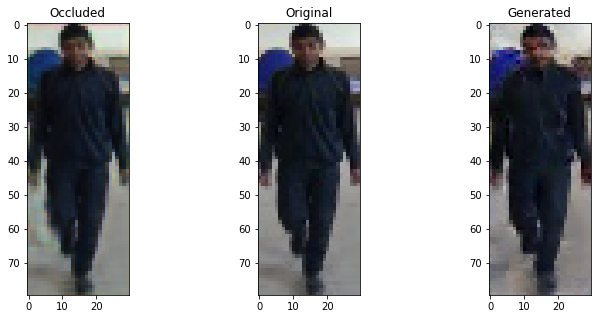

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


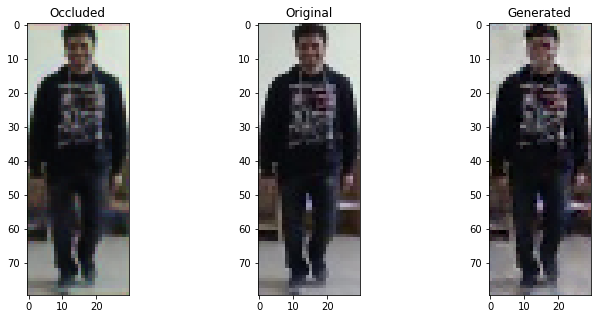

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


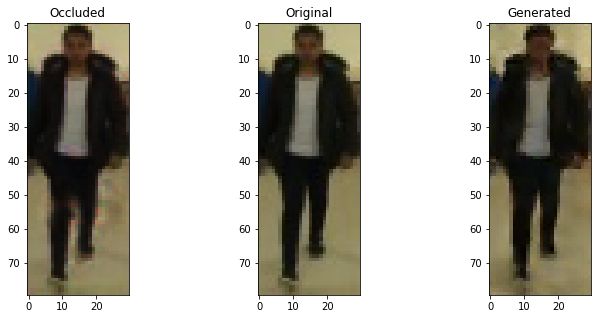

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


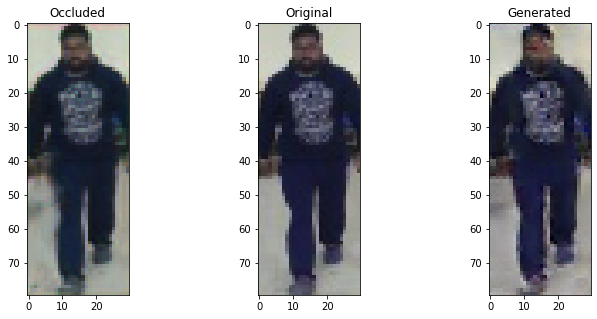

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


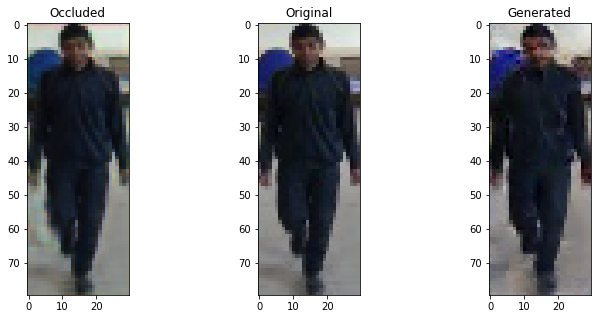

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.653498113155365 , Adversarial Loss:  0.0009482185123488307
Epoch 1182


  8%|▊         | 1/13 [00:00<00:01,  6.24it/s]

Discriminator Loss:  0.6331439018249512 , Adversarial Loss:  0.0010162785183638334
Epoch 1183


  8%|▊         | 1/13 [00:00<00:01,  6.46it/s]

Discriminator Loss:  0.6260541677474976 , Adversarial Loss:  0.0008600103901699185
Epoch 1184


  8%|▊         | 1/13 [00:00<00:01,  6.03it/s]

Discriminator Loss:  0.6630988121032715 , Adversarial Loss:  0.0009603773360140622
Epoch 1185


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6581404209136963 , Adversarial Loss:  0.0009006760665215552
Epoch 1186


  8%|▊         | 1/13 [00:00<00:01,  6.69it/s]

Discriminator Loss:  0.6588567495346069 , Adversarial Loss:  0.0008555975509807467
Epoch 1187


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6548433899879456 , Adversarial Loss:  0.0009489426156505942
Epoch 1188


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6684908866882324 , Adversarial Loss:  0.000872425502166152
Epoch 1189


  8%|▊         | 1/13 [00:00<00:01,  6.65it/s]

Discriminator Loss:  0.6822859644889832 , Adversarial Loss:  0.0008767959661781788
Epoch 1190


  8%|▊         | 1/13 [00:00<00:01,  6.53it/s]

Discriminator Loss:  0.6481937170028687 , Adversarial Loss:  0.0008708564564585686
Epoch 1191


  8%|▊         | 1/13 [00:00<00:01,  6.61it/s]

Discriminator Loss:  0.6733747720718384 , Adversarial Loss:  0.0008809628197923303
Epoch 1192


  8%|▊         | 1/13 [00:00<00:01,  6.53it/s]

Discriminator Loss:  0.6710327863693237 , Adversarial Loss:  0.0008595931576564908
Epoch 1193


  8%|▊         | 1/13 [00:00<00:02,  5.18it/s]

Discriminator Loss:  0.669969916343689 , Adversarial Loss:  0.00089452468091622
Epoch 1194


  8%|▊         | 1/13 [00:00<00:02,  5.92it/s]

Discriminator Loss:  0.6786234378814697 , Adversarial Loss:  0.0008502491400577128
Epoch 1195


  8%|▊         | 1/13 [00:00<00:01,  6.16it/s]

Discriminator Loss:  0.6432760953903198 , Adversarial Loss:  0.0007825526408851147
Epoch 1196


  8%|▊         | 1/13 [00:00<00:01,  6.70it/s]

Discriminator Loss:  0.6379870772361755 , Adversarial Loss:  0.0007956199115142226
Epoch 1197


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6665012836456299 , Adversarial Loss:  0.0007537956116721034
Epoch 1198


  8%|▊         | 1/13 [00:00<00:01,  6.47it/s]

Discriminator Loss:  0.665799081325531 , Adversarial Loss:  0.0008905549184419215
Epoch 1199


  8%|▊         | 1/13 [00:00<00:01,  6.65it/s]

Discriminator Loss:  0.6566158533096313 , Adversarial Loss:  0.0008175768307410181
Epoch 1200


  8%|▊         | 1/13 [00:00<00:01,  6.14it/s]

Discriminator Loss:  0.6525213718414307 , Adversarial Loss:  0.0008374151075258851
Epoch 1201


100%|██████████| 13/13 [00:02<00:00,  6.20it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


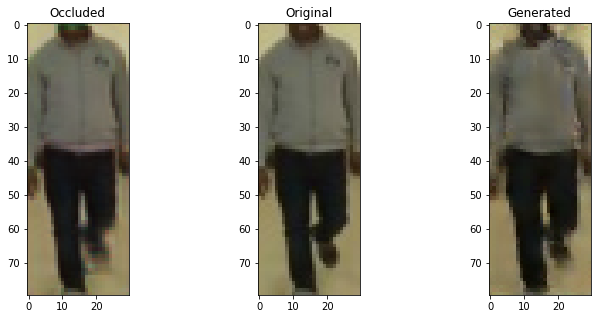

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


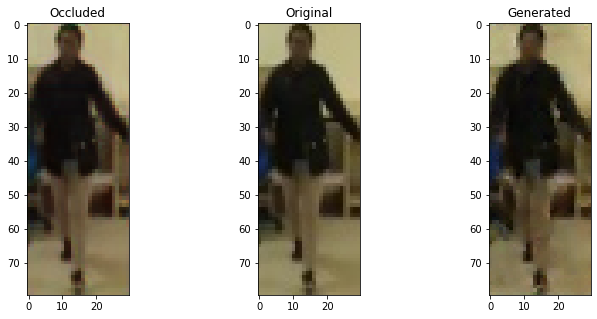

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


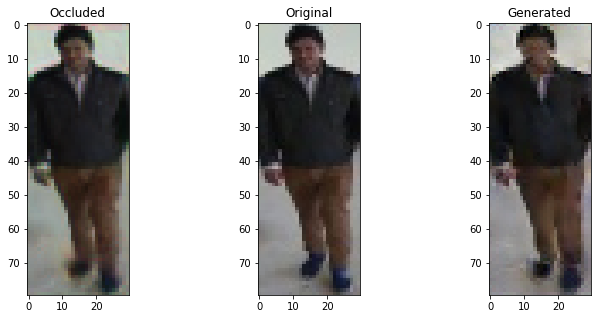

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


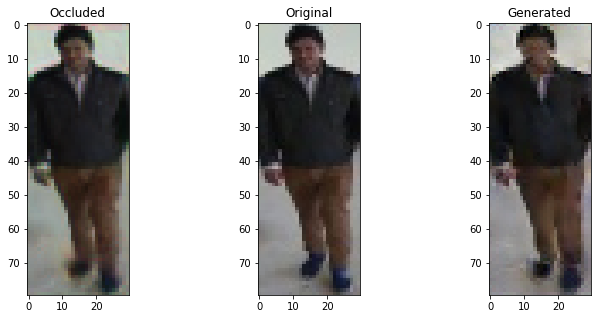

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


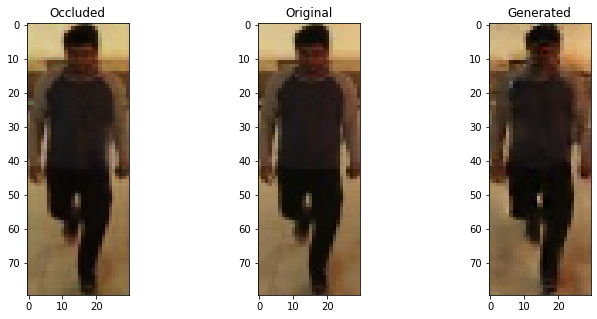

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6688399910926819 , Adversarial Loss:  0.0007651252089999616
Epoch 1202


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6767823696136475 , Adversarial Loss:  0.0008363043889403343
Epoch 1203


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6516587138175964 , Adversarial Loss:  0.0007693767547607422
Epoch 1204


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6569642424583435 , Adversarial Loss:  0.0008627827046439052
Epoch 1205


  8%|▊         | 1/13 [00:00<00:01,  6.87it/s]

Discriminator Loss:  0.6497106552124023 , Adversarial Loss:  0.0008177399286068976
Epoch 1206


  8%|▊         | 1/13 [00:00<00:02,  5.34it/s]

Discriminator Loss:  0.6698997020721436 , Adversarial Loss:  0.0008348987903445959
Epoch 1207


  8%|▊         | 1/13 [00:00<00:01,  6.31it/s]

Discriminator Loss:  0.6495710611343384 , Adversarial Loss:  0.0007725016330368817
Epoch 1208


  8%|▊         | 1/13 [00:00<00:01,  6.02it/s]

Discriminator Loss:  0.6513778567314148 , Adversarial Loss:  0.0007722972077317536
Epoch 1209


  8%|▊         | 1/13 [00:00<00:01,  6.05it/s]

Discriminator Loss:  0.6726903915405273 , Adversarial Loss:  0.0007024449296295643
Epoch 1210


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6444045305252075 , Adversarial Loss:  0.0008093478973023593
Epoch 1211


  8%|▊         | 1/13 [00:00<00:01,  6.38it/s]

Discriminator Loss:  0.6662247180938721 , Adversarial Loss:  0.0008102913852781057
Epoch 1212


  8%|▊         | 1/13 [00:00<00:01,  6.32it/s]

Discriminator Loss:  0.6697044968605042 , Adversarial Loss:  0.0008033998310565948
Epoch 1213


  8%|▊         | 1/13 [00:00<00:01,  6.55it/s]

Discriminator Loss:  0.6906478404998779 , Adversarial Loss:  0.0008564915042370558
Epoch 1214


  8%|▊         | 1/13 [00:00<00:02,  5.41it/s]

Discriminator Loss:  0.6567389965057373 , Adversarial Loss:  0.0008169655338861048
Epoch 1215


  8%|▊         | 1/13 [00:00<00:01,  6.52it/s]

Discriminator Loss:  0.6337226629257202 , Adversarial Loss:  0.000795774394646287
Epoch 1216


  8%|▊         | 1/13 [00:00<00:01,  6.25it/s]

Discriminator Loss:  0.6705973148345947 , Adversarial Loss:  0.0008022534311749041
Epoch 1217


  8%|▊         | 1/13 [00:00<00:01,  6.17it/s]

Discriminator Loss:  0.6578705906867981 , Adversarial Loss:  0.0007917629554867744
Epoch 1218


  8%|▊         | 1/13 [00:00<00:02,  5.89it/s]

Discriminator Loss:  0.6519286036491394 , Adversarial Loss:  0.0007524311658926308
Epoch 1219


  8%|▊         | 1/13 [00:00<00:01,  6.76it/s]

Discriminator Loss:  0.6411001682281494 , Adversarial Loss:  0.0007168910233303905
Epoch 1220


  8%|▊         | 1/13 [00:00<00:01,  6.67it/s]

Discriminator Loss:  0.6476609706878662 , Adversarial Loss:  0.0008231562678702176
Epoch 1221


100%|██████████| 13/13 [00:02<00:00,  6.16it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


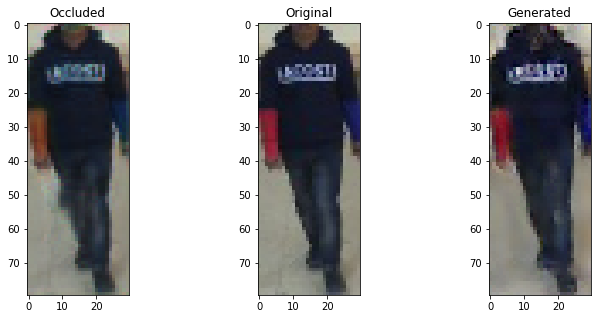

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


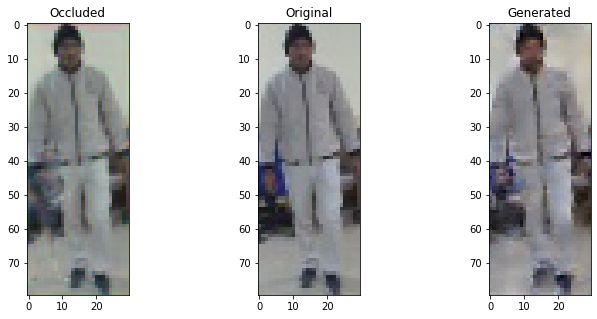

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


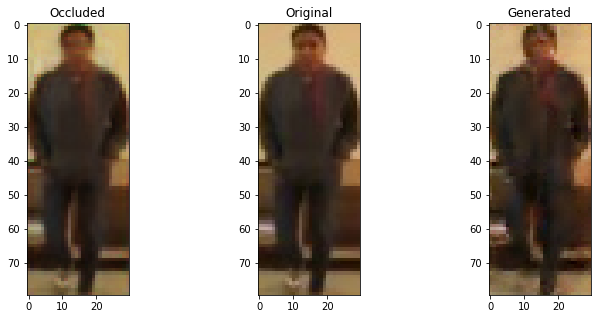

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


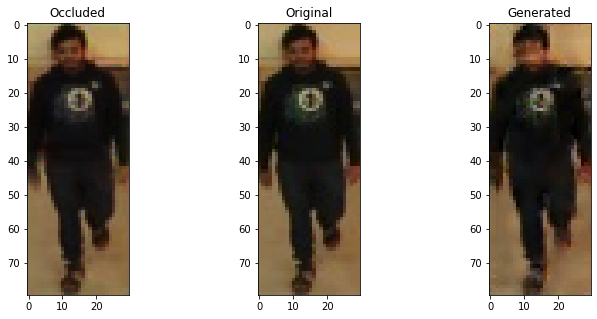

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


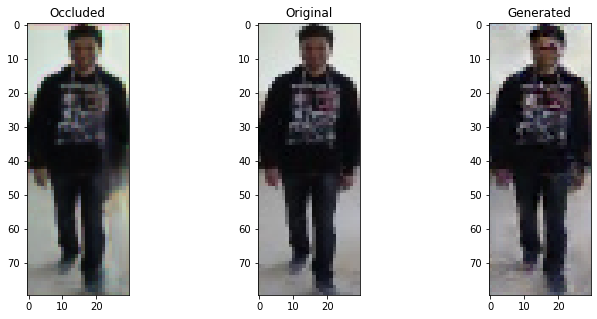

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6690235137939453 , Adversarial Loss:  0.0007296258118003607
Epoch 1222


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6697391867637634 , Adversarial Loss:  0.0007671993807889521
Epoch 1223


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6678221225738525 , Adversarial Loss:  0.0007550321170128882
Epoch 1224


  8%|▊         | 1/13 [00:00<00:02,  5.20it/s]

Discriminator Loss:  0.6497435569763184 , Adversarial Loss:  0.0007708357879891992
Epoch 1225


  8%|▊         | 1/13 [00:00<00:02,  5.91it/s]

Discriminator Loss:  0.662675142288208 , Adversarial Loss:  0.0007325488841161132
Epoch 1226


  8%|▊         | 1/13 [00:00<00:01,  6.21it/s]

Discriminator Loss:  0.6621347665786743 , Adversarial Loss:  0.0008528081234544516
Epoch 1227


  8%|▊         | 1/13 [00:00<00:01,  6.48it/s]

Discriminator Loss:  0.6840153336524963 , Adversarial Loss:  0.0007566800341010094
Epoch 1228


  8%|▊         | 1/13 [00:00<00:02,  5.97it/s]

Discriminator Loss:  0.6537421941757202 , Adversarial Loss:  0.0007490131538361311
Epoch 1229


  8%|▊         | 1/13 [00:00<00:01,  6.69it/s]

Discriminator Loss:  0.6669291257858276 , Adversarial Loss:  0.0007731148507446051
Epoch 1230


  8%|▊         | 1/13 [00:00<00:01,  6.06it/s]

Discriminator Loss:  0.6416630744934082 , Adversarial Loss:  0.000758214620873332
Epoch 1231


  8%|▊         | 1/13 [00:00<00:01,  6.11it/s]

Discriminator Loss:  0.6446945071220398 , Adversarial Loss:  0.0008356296457350254
Epoch 1232


  8%|▊         | 1/13 [00:00<00:01,  6.26it/s]

Discriminator Loss:  0.6388227939605713 , Adversarial Loss:  0.0007035999442450702
Epoch 1233


  8%|▊         | 1/13 [00:00<00:01,  6.46it/s]

Discriminator Loss:  0.6679181456565857 , Adversarial Loss:  0.000750195060390979
Epoch 1234


  8%|▊         | 1/13 [00:00<00:01,  6.63it/s]

Discriminator Loss:  0.6291146874427795 , Adversarial Loss:  0.0007214350625872612
Epoch 1235


  8%|▊         | 1/13 [00:00<00:02,  5.60it/s]

Discriminator Loss:  0.6678705811500549 , Adversarial Loss:  0.0007142251706682146
Epoch 1236


  8%|▊         | 1/13 [00:00<00:01,  6.70it/s]

Discriminator Loss:  0.6459814310073853 , Adversarial Loss:  0.0007406232180073857
Epoch 1237


  8%|▊         | 1/13 [00:00<00:01,  6.03it/s]

Discriminator Loss:  0.6709387302398682 , Adversarial Loss:  0.0007027793908491731
Epoch 1238


  8%|▊         | 1/13 [00:00<00:01,  6.37it/s]

Discriminator Loss:  0.6580474972724915 , Adversarial Loss:  0.000682441983371973
Epoch 1239


  8%|▊         | 1/13 [00:00<00:02,  5.29it/s]

Discriminator Loss:  0.6467883586883545 , Adversarial Loss:  0.0006724356790073216
Epoch 1240


  8%|▊         | 1/13 [00:00<00:02,  5.25it/s]

Discriminator Loss:  0.646121621131897 , Adversarial Loss:  0.0008226414793170989
Epoch 1241


100%|██████████| 13/13 [00:02<00:00,  5.93it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


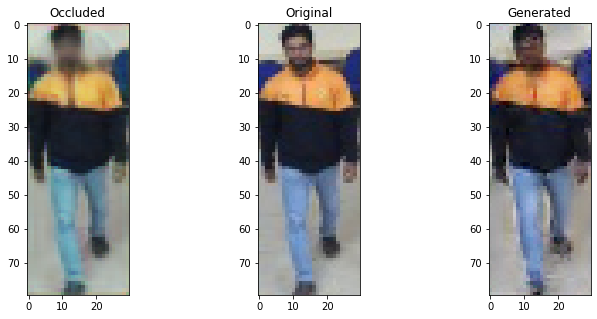

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


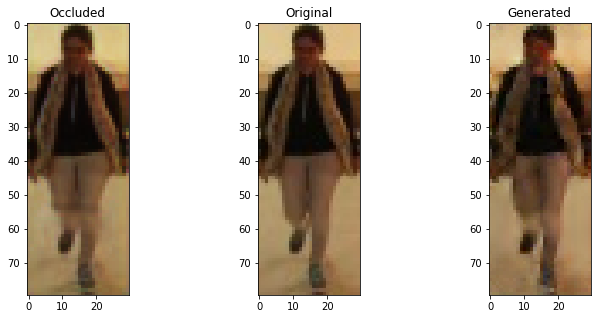

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


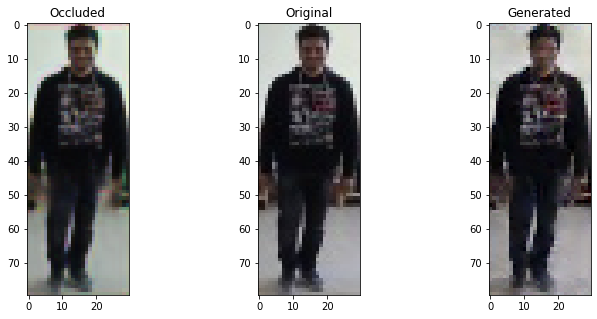

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


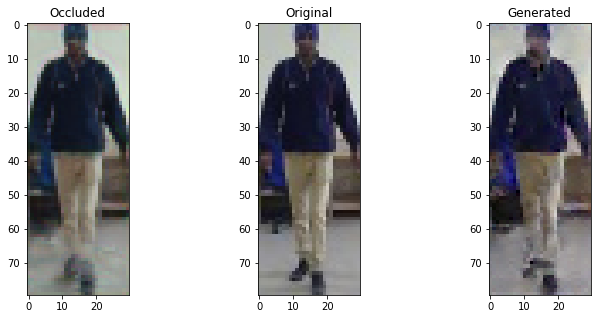

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


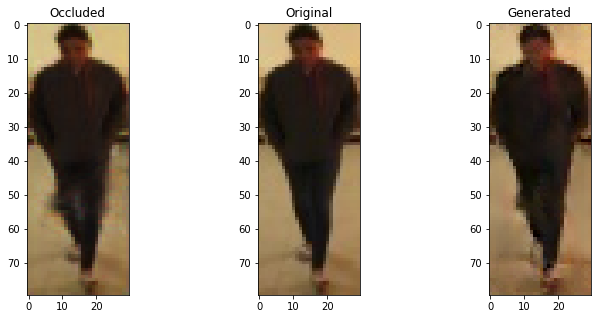

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6492598652839661 , Adversarial Loss:  0.0007541641825810075
Epoch 1242


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6545755863189697 , Adversarial Loss:  0.0007143046823330224
Epoch 1243


  8%|▊         | 1/13 [00:00<00:02,  5.35it/s]

Discriminator Loss:  0.6625472903251648 , Adversarial Loss:  0.0006588373798877001
Epoch 1244


  8%|▊         | 1/13 [00:00<00:01,  6.22it/s]

Discriminator Loss:  0.6508293747901917 , Adversarial Loss:  0.0007250008056871593
Epoch 1245


  8%|▊         | 1/13 [00:00<00:01,  6.46it/s]

Discriminator Loss:  0.6632835865020752 , Adversarial Loss:  0.0007220982224680483
Epoch 1246


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6766974925994873 , Adversarial Loss:  0.000724170939065516
Epoch 1247


  8%|▊         | 1/13 [00:00<00:01,  6.61it/s]

Discriminator Loss:  0.6555157899856567 , Adversarial Loss:  0.000736915972083807
Epoch 1248


  8%|▊         | 1/13 [00:00<00:01,  6.19it/s]

Discriminator Loss:  0.6658985614776611 , Adversarial Loss:  0.0006896439008414745
Epoch 1249


  8%|▊         | 1/13 [00:00<00:01,  6.50it/s]

Discriminator Loss:  0.6578258275985718 , Adversarial Loss:  0.0006905943155288696
Epoch 1250


  8%|▊         | 1/13 [00:00<00:02,  5.19it/s]

Discriminator Loss:  0.643709123134613 , Adversarial Loss:  0.0007389033562503755
Epoch 1251


  8%|▊         | 1/13 [00:00<00:02,  5.32it/s]

Discriminator Loss:  0.6417127251625061 , Adversarial Loss:  0.0007160866516642272
Epoch 1252


  8%|▊         | 1/13 [00:00<00:01,  6.86it/s]

Discriminator Loss:  0.6262320280075073 , Adversarial Loss:  0.0007301459554582834
Epoch 1253


  8%|▊         | 1/13 [00:00<00:02,  5.27it/s]

Discriminator Loss:  0.6668278574943542 , Adversarial Loss:  0.0007205188740044832
Epoch 1254


  8%|▊         | 1/13 [00:00<00:01,  6.30it/s]

Discriminator Loss:  0.6379903554916382 , Adversarial Loss:  0.000730242463760078
Epoch 1255


  8%|▊         | 1/13 [00:00<00:01,  6.16it/s]

Discriminator Loss:  0.6563560962677002 , Adversarial Loss:  0.0007267020409926772
Epoch 1256


  8%|▊         | 1/13 [00:00<00:01,  6.48it/s]

Discriminator Loss:  0.6866885423660278 , Adversarial Loss:  0.0007284849416464567
Epoch 1257


  8%|▊         | 1/13 [00:00<00:01,  6.45it/s]

Discriminator Loss:  0.6487529277801514 , Adversarial Loss:  0.000679614779073745
Epoch 1258


  8%|▊         | 1/13 [00:00<00:01,  6.31it/s]

Discriminator Loss:  0.6714946627616882 , Adversarial Loss:  0.0007119201472960413
Epoch 1259


  8%|▊         | 1/13 [00:00<00:01,  6.49it/s]

Discriminator Loss:  0.6571225523948669 , Adversarial Loss:  0.000685433391481638
Epoch 1260


  8%|▊         | 1/13 [00:00<00:02,  5.85it/s]

Discriminator Loss:  0.6628811359405518 , Adversarial Loss:  0.0006940981838852167
Epoch 1261


100%|██████████| 13/13 [00:02<00:00,  5.97it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


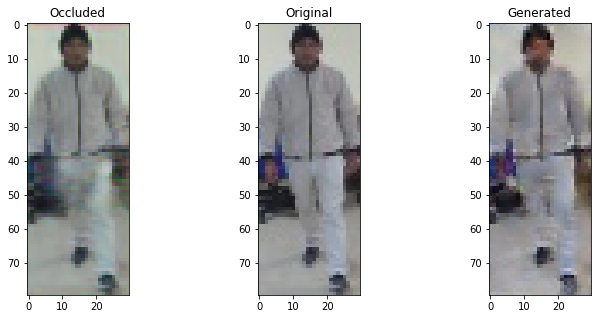

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


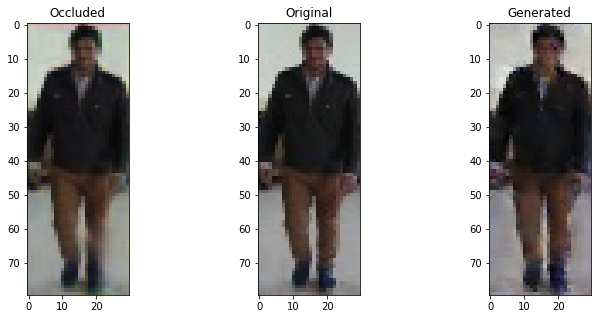

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


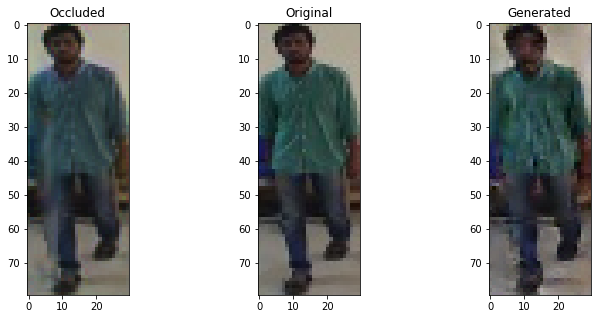

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


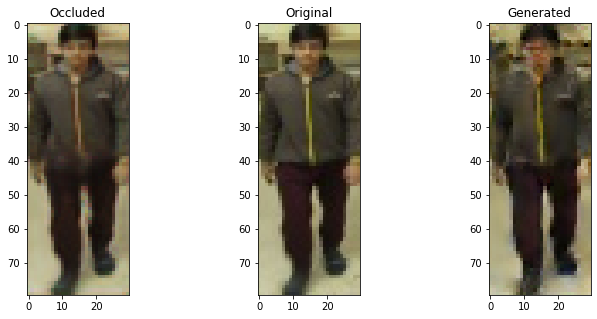

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


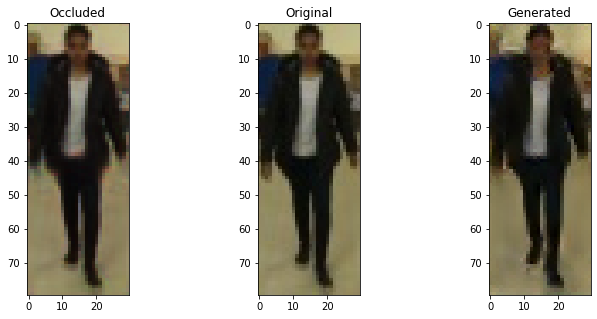

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6599538326263428 , Adversarial Loss:  0.0008462088881060481
Epoch 1262


  8%|▊         | 1/13 [00:00<00:02,  5.51it/s]

Discriminator Loss:  0.6536812782287598 , Adversarial Loss:  0.0007301557343453169
Epoch 1263


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6664605140686035 , Adversarial Loss:  0.0007956027984619141
Epoch 1264


  8%|▊         | 1/13 [00:00<00:02,  5.21it/s]

Discriminator Loss:  0.66508549451828 , Adversarial Loss:  0.0007199960527941585
Epoch 1265


  8%|▊         | 1/13 [00:00<00:01,  6.57it/s]

Discriminator Loss:  0.6579040288925171 , Adversarial Loss:  0.0006579607725143433
Epoch 1266


  8%|▊         | 1/13 [00:00<00:01,  6.79it/s]

Discriminator Loss:  0.6758172512054443 , Adversarial Loss:  0.0006964289350435138
Epoch 1267


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6786782741546631 , Adversarial Loss:  0.0007295118412002921
Epoch 1268


  8%|▊         | 1/13 [00:00<00:02,  5.90it/s]

Discriminator Loss:  0.6623603701591492 , Adversarial Loss:  0.0006759963580407202
Epoch 1269


  8%|▊         | 1/13 [00:00<00:01,  6.71it/s]

Discriminator Loss:  0.6697932481765747 , Adversarial Loss:  0.0007325048791244626
Epoch 1270


  8%|▊         | 1/13 [00:00<00:01,  6.13it/s]

Discriminator Loss:  0.6760996580123901 , Adversarial Loss:  0.0006780315889045596
Epoch 1271


  8%|▊         | 1/13 [00:00<00:01,  6.44it/s]

Discriminator Loss:  0.6862116456031799 , Adversarial Loss:  0.0006916263955645263
Epoch 1272


  8%|▊         | 1/13 [00:00<00:01,  6.30it/s]

Discriminator Loss:  0.6517031788825989 , Adversarial Loss:  0.0007507706177420914
Epoch 1273


  8%|▊         | 1/13 [00:00<00:01,  6.36it/s]

Discriminator Loss:  0.6605340242385864 , Adversarial Loss:  0.000657734926789999
Epoch 1274


  8%|▊         | 1/13 [00:00<00:01,  6.53it/s]

Discriminator Loss:  0.6578909158706665 , Adversarial Loss:  0.0006267082644626498
Epoch 1275


  8%|▊         | 1/13 [00:00<00:02,  5.95it/s]

Discriminator Loss:  0.658294677734375 , Adversarial Loss:  0.0007681969436816871
Epoch 1276


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6485779285430908 , Adversarial Loss:  0.0007543645333498716
Epoch 1277


  8%|▊         | 1/13 [00:00<00:02,  5.90it/s]

Discriminator Loss:  0.6619876623153687 , Adversarial Loss:  0.0007088235579431057
Epoch 1278


  8%|▊         | 1/13 [00:00<00:01,  6.16it/s]

Discriminator Loss:  0.6634568572044373 , Adversarial Loss:  0.0006738239899277687
Epoch 1279


  8%|▊         | 1/13 [00:00<00:01,  6.39it/s]

Discriminator Loss:  0.6650048494338989 , Adversarial Loss:  0.0007366751087829471
Epoch 1280


  8%|▊         | 1/13 [00:00<00:01,  6.35it/s]

Discriminator Loss:  0.6486560106277466 , Adversarial Loss:  0.0006843820447102189
Epoch 1281


100%|██████████| 13/13 [00:02<00:00,  5.49it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


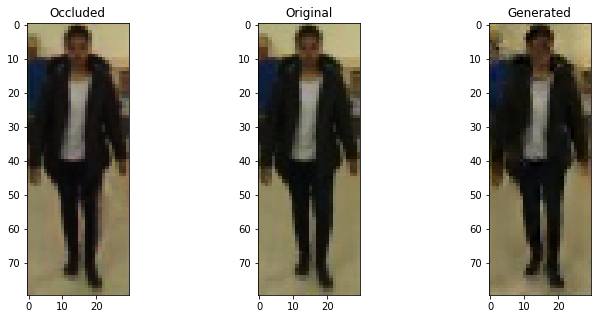

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


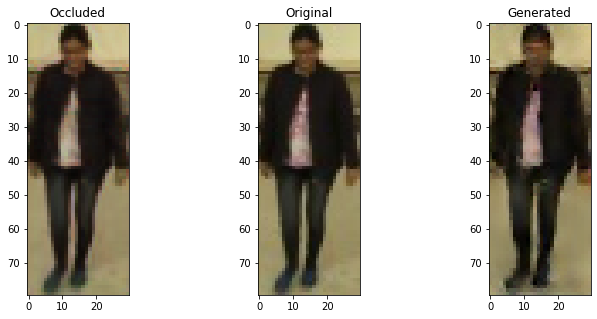

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


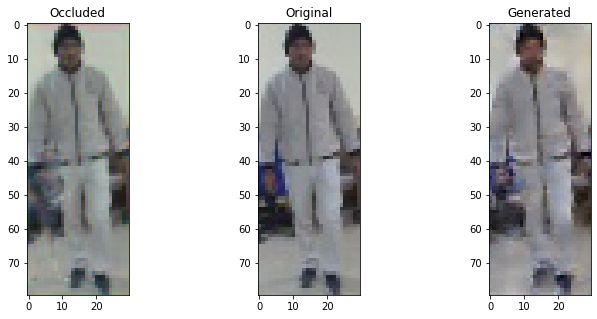

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


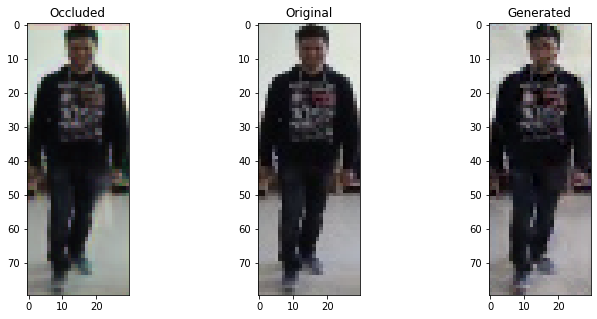

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


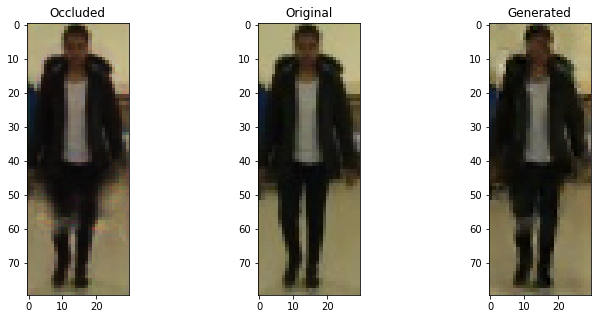

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6504576206207275 , Adversarial Loss:  0.0006120765465311706
Epoch 1282


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6690413951873779 , Adversarial Loss:  0.0006633675075136125
Epoch 1283


  8%|▊         | 1/13 [00:00<00:01,  6.78it/s]

Discriminator Loss:  0.6552034616470337 , Adversarial Loss:  0.0007249728660099208
Epoch 1284


  8%|▊         | 1/13 [00:00<00:01,  6.56it/s]

Discriminator Loss:  0.6761654019355774 , Adversarial Loss:  0.0006838918197900057
Epoch 1285


  8%|▊         | 1/13 [00:00<00:01,  6.35it/s]

Discriminator Loss:  0.6589050889015198 , Adversarial Loss:  0.0007090932340361178
Epoch 1286


  8%|▊         | 1/13 [00:00<00:01,  6.43it/s]

Discriminator Loss:  0.6846955418586731 , Adversarial Loss:  0.000682169571518898
Epoch 1287


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6718134880065918 , Adversarial Loss:  0.0006972863338887691
Epoch 1288


  8%|▊         | 1/13 [00:00<00:02,  5.87it/s]

Discriminator Loss:  0.6492213010787964 , Adversarial Loss:  0.000610704708378762
Epoch 1289


  8%|▊         | 1/13 [00:00<00:01,  6.46it/s]

Discriminator Loss:  0.6651178598403931 , Adversarial Loss:  0.0007313087116926908
Epoch 1290


  8%|▊         | 1/13 [00:00<00:01,  6.34it/s]

Discriminator Loss:  0.6808009147644043 , Adversarial Loss:  0.0007065462414175272
Epoch 1291


  8%|▊         | 1/13 [00:00<00:01,  6.75it/s]

Discriminator Loss:  0.6522620320320129 , Adversarial Loss:  0.0006832353537902236
Epoch 1292


  8%|▊         | 1/13 [00:00<00:01,  6.40it/s]

Discriminator Loss:  0.6478821039199829 , Adversarial Loss:  0.0006753141642548144
Epoch 1293


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6469382047653198 , Adversarial Loss:  0.0006746915751136839
Epoch 1294


  8%|▊         | 1/13 [00:00<00:01,  6.04it/s]

Discriminator Loss:  0.6771066188812256 , Adversarial Loss:  0.0007598410593345761
Epoch 1295


  8%|▊         | 1/13 [00:00<00:02,  5.98it/s]

Discriminator Loss:  0.6625666618347168 , Adversarial Loss:  0.0006658804486505687
Epoch 1296


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6592869758605957 , Adversarial Loss:  0.0007042874349281192
Epoch 1297


  8%|▊         | 1/13 [00:00<00:01,  6.82it/s]

Discriminator Loss:  0.6643673777580261 , Adversarial Loss:  0.0007008115062490106
Epoch 1298


  8%|▊         | 1/13 [00:00<00:01,  6.79it/s]

Discriminator Loss:  0.6487206220626831 , Adversarial Loss:  0.0007051478023640811
Epoch 1299


  8%|▊         | 1/13 [00:00<00:01,  6.58it/s]

Discriminator Loss:  0.6492903232574463 , Adversarial Loss:  0.0007096144836395979
Epoch 1300


  8%|▊         | 1/13 [00:00<00:01,  6.20it/s]

Discriminator Loss:  0.6572655439376831 , Adversarial Loss:  0.000596294179558754
Epoch 1301


100%|██████████| 13/13 [00:02<00:00,  6.15it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


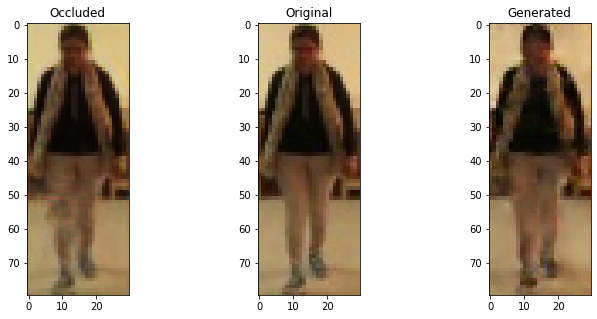

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


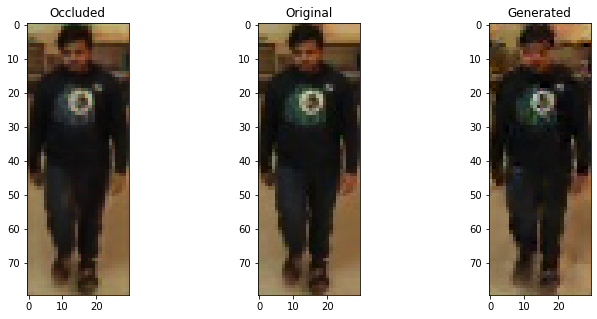

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


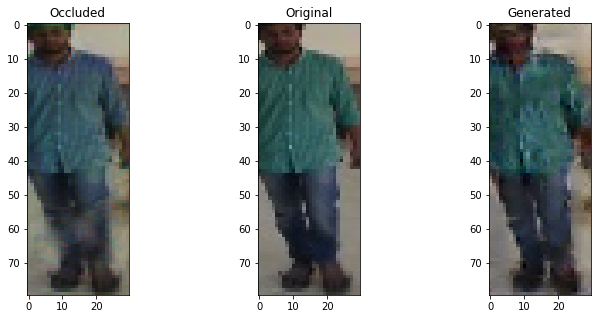

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


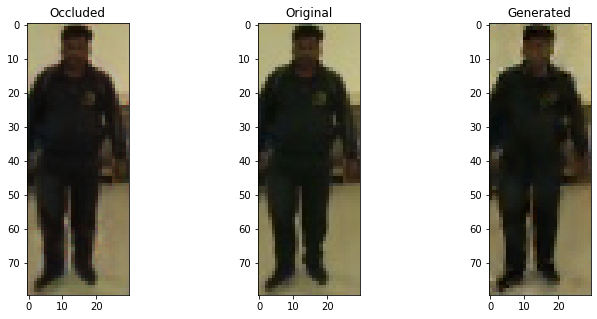

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


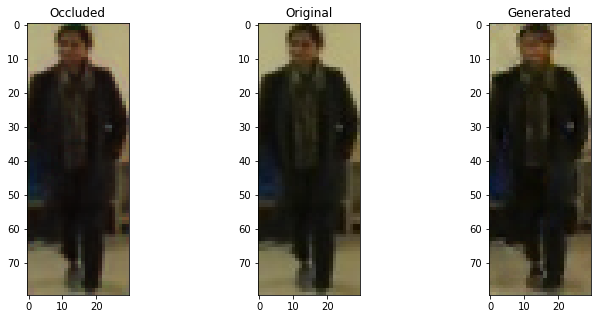

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6392254829406738 , Adversarial Loss:  0.000760256196372211
Epoch 1302


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6508859395980835 , Adversarial Loss:  0.000684162718243897
Epoch 1303


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6460949182510376 , Adversarial Loss:  0.0006432661321014166
Epoch 1304


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6381701827049255 , Adversarial Loss:  0.000679386081174016
Epoch 1305


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6325912475585938 , Adversarial Loss:  0.0007492095464840531
Epoch 1306


  8%|▊         | 1/13 [00:00<00:01,  6.41it/s]

Discriminator Loss:  0.6636937260627747 , Adversarial Loss:  0.0006506667123176157
Epoch 1307


  8%|▊         | 1/13 [00:00<00:01,  6.39it/s]

Discriminator Loss:  0.6491901874542236 , Adversarial Loss:  0.0006700450321659446
Epoch 1308


  8%|▊         | 1/13 [00:00<00:02,  5.92it/s]

Discriminator Loss:  0.667753279209137 , Adversarial Loss:  0.0007126218406483531
Epoch 1309


  8%|▊         | 1/13 [00:00<00:01,  6.74it/s]

Discriminator Loss:  0.696155846118927 , Adversarial Loss:  0.0006355103105306625
Epoch 1310


  8%|▊         | 1/13 [00:00<00:01,  6.75it/s]

Discriminator Loss:  0.645067572593689 , Adversarial Loss:  0.00071238714735955
Epoch 1311


  8%|▊         | 1/13 [00:00<00:01,  6.68it/s]

Discriminator Loss:  0.652132511138916 , Adversarial Loss:  0.0007118385401554406
Epoch 1312


  8%|▊         | 1/13 [00:00<00:02,  5.20it/s]

Discriminator Loss:  0.6612142324447632 , Adversarial Loss:  0.0006127306842245162
Epoch 1313


  8%|▊         | 1/13 [00:00<00:02,  5.96it/s]

Discriminator Loss:  0.6545071601867676 , Adversarial Loss:  0.0006744820857420564
Epoch 1314


  8%|▊         | 1/13 [00:00<00:01,  6.48it/s]

Discriminator Loss:  0.652592658996582 , Adversarial Loss:  0.0006651860312558711
Epoch 1315


  8%|▊         | 1/13 [00:00<00:02,  5.20it/s]

Discriminator Loss:  0.6545095443725586 , Adversarial Loss:  0.0006929173250682652
Epoch 1316


  8%|▊         | 1/13 [00:00<00:01,  6.25it/s]

Discriminator Loss:  0.6538329124450684 , Adversarial Loss:  0.0006305592833086848
Epoch 1317


  8%|▊         | 1/13 [00:00<00:02,  5.72it/s]

Discriminator Loss:  0.6579580307006836 , Adversarial Loss:  0.0006347631569951773
Epoch 1318


  8%|▊         | 1/13 [00:00<00:01,  6.42it/s]

Discriminator Loss:  0.6802032589912415 , Adversarial Loss:  0.0006752524059265852
Epoch 1319


  8%|▊         | 1/13 [00:00<00:01,  6.41it/s]

Discriminator Loss:  0.6477987766265869 , Adversarial Loss:  0.0006761327385902405
Epoch 1320


  8%|▊         | 1/13 [00:00<00:01,  6.69it/s]

Discriminator Loss:  0.6611089706420898 , Adversarial Loss:  0.0006402661092579365
Epoch 1321


100%|██████████| 13/13 [00:02<00:00,  6.14it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


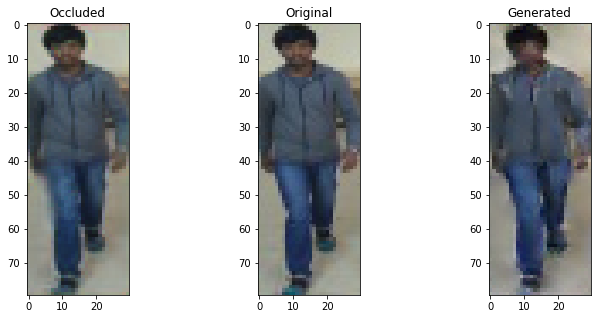

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


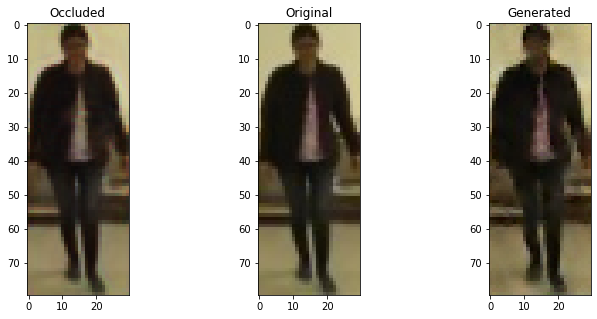

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


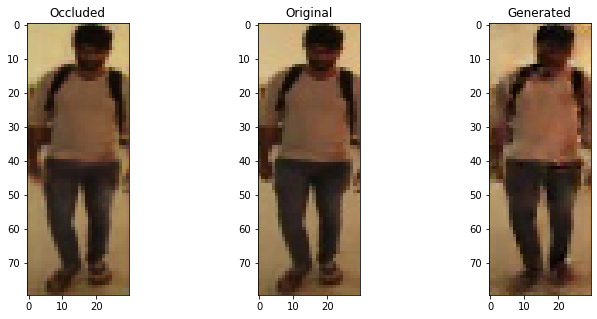

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


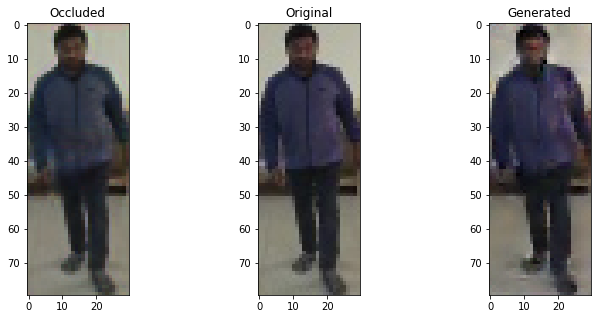

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


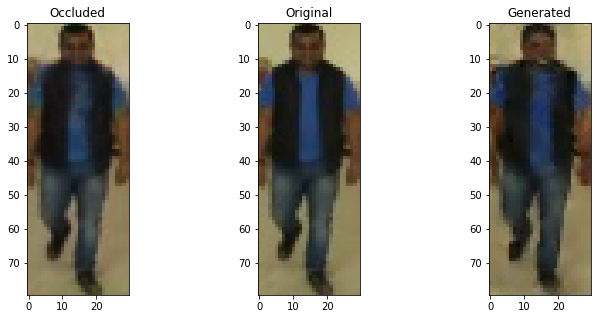

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6406996846199036 , Adversarial Loss:  0.0006704070838168263
Epoch 1322


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6555484533309937 , Adversarial Loss:  0.0005781162763014436
Epoch 1323


  8%|▊         | 1/13 [00:00<00:02,  5.95it/s]

Discriminator Loss:  0.6617773771286011 , Adversarial Loss:  0.0006750046741217375
Epoch 1324


  8%|▊         | 1/13 [00:00<00:01,  6.10it/s]

Discriminator Loss:  0.6762179732322693 , Adversarial Loss:  0.0006496458663605154
Epoch 1325


  8%|▊         | 1/13 [00:00<00:01,  6.42it/s]

Discriminator Loss:  0.6643147468566895 , Adversarial Loss:  0.0006318024825304747
Epoch 1326


  8%|▊         | 1/13 [00:00<00:01,  6.56it/s]

Discriminator Loss:  0.667339563369751 , Adversarial Loss:  0.0007161739049479365
Epoch 1327


  8%|▊         | 1/13 [00:00<00:01,  6.13it/s]

Discriminator Loss:  0.6598379611968994 , Adversarial Loss:  0.0006287824362516403
Epoch 1328


  8%|▊         | 1/13 [00:00<00:01,  6.00it/s]

Discriminator Loss:  0.6469188928604126 , Adversarial Loss:  0.0006708863656967878
Epoch 1329


  8%|▊         | 1/13 [00:00<00:01,  6.08it/s]

Discriminator Loss:  0.6830737590789795 , Adversarial Loss:  0.0006755705690011382
Epoch 1330


  8%|▊         | 1/13 [00:00<00:01,  6.51it/s]

Discriminator Loss:  0.6732248663902283 , Adversarial Loss:  0.0006518264417536557
Epoch 1331


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.648296058177948 , Adversarial Loss:  0.0007128574652597308
Epoch 1332


  8%|▊         | 1/13 [00:00<00:01,  6.58it/s]

Discriminator Loss:  0.6476204991340637 , Adversarial Loss:  0.0006669157883152366
Epoch 1333


  8%|▊         | 1/13 [00:00<00:01,  6.52it/s]

Discriminator Loss:  0.659591019153595 , Adversarial Loss:  0.000576639489736408
Epoch 1334


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6715918183326721 , Adversarial Loss:  0.0007236310048028827
Epoch 1335


  8%|▊         | 1/13 [00:00<00:02,  5.52it/s]

Discriminator Loss:  0.6412152051925659 , Adversarial Loss:  0.0007033603615127504
Epoch 1336


  8%|▊         | 1/13 [00:00<00:01,  6.37it/s]

Discriminator Loss:  0.6578811407089233 , Adversarial Loss:  0.0006037488346919417
Epoch 1337


  8%|▊         | 1/13 [00:00<00:01,  6.26it/s]

Discriminator Loss:  0.658029317855835 , Adversarial Loss:  0.0006542518967762589
Epoch 1338


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6714246869087219 , Adversarial Loss:  0.0006715367780998349
Epoch 1339


  8%|▊         | 1/13 [00:00<00:01,  6.53it/s]

Discriminator Loss:  0.6421300768852234 , Adversarial Loss:  0.000618095975369215
Epoch 1340


  8%|▊         | 1/13 [00:00<00:01,  6.57it/s]

Discriminator Loss:  0.6648266315460205 , Adversarial Loss:  0.0006208297563716769
Epoch 1341


100%|██████████| 13/13 [00:02<00:00,  5.91it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


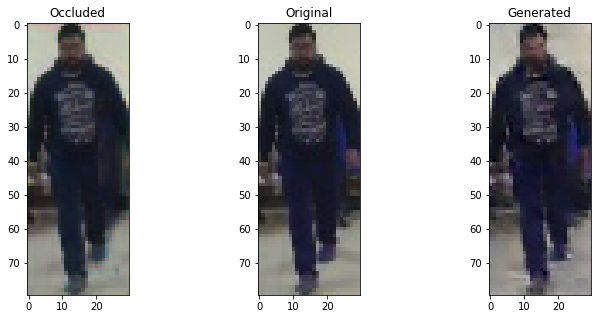

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


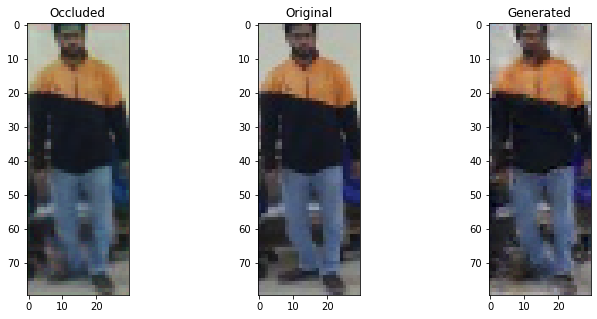

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


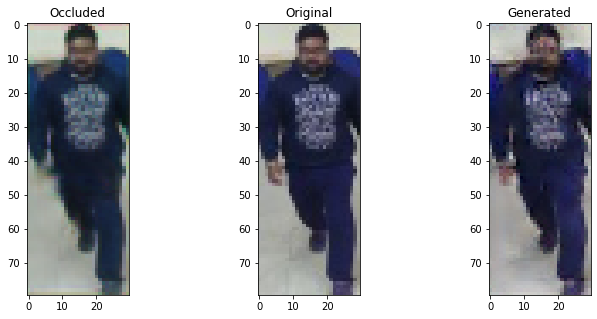

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


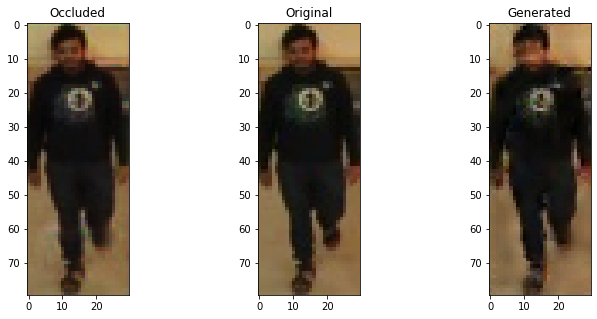

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


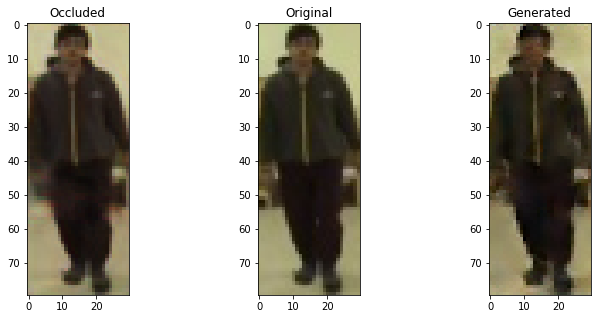

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.642155647277832 , Adversarial Loss:  0.0006663053063675761
Epoch 1342


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6254006028175354 , Adversarial Loss:  0.0006681334925815463
Epoch 1343


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6577566862106323 , Adversarial Loss:  0.0006701071397401392
Epoch 1344


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6425902843475342 , Adversarial Loss:  0.0006588126998394728
Epoch 1345


  8%|▊         | 1/13 [00:00<00:02,  5.60it/s]

Discriminator Loss:  0.6632523536682129 , Adversarial Loss:  0.0006397647666744888
Epoch 1346


  8%|▊         | 1/13 [00:00<00:02,  5.23it/s]

Discriminator Loss:  0.651599645614624 , Adversarial Loss:  0.0006258517387323081
Epoch 1347


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.663063645362854 , Adversarial Loss:  0.0006107928929850459
Epoch 1348


  8%|▊         | 1/13 [00:00<00:01,  6.52it/s]

Discriminator Loss:  0.662117600440979 , Adversarial Loss:  0.0007041667122393847
Epoch 1349


  8%|▊         | 1/13 [00:00<00:01,  6.39it/s]

Discriminator Loss:  0.6493600606918335 , Adversarial Loss:  0.0006624864181503654
Epoch 1350


  8%|▊         | 1/13 [00:00<00:01,  6.12it/s]

Discriminator Loss:  0.65916508436203 , Adversarial Loss:  0.0007192673510871828
Epoch 1351


  8%|▊         | 1/13 [00:00<00:01,  6.07it/s]

Discriminator Loss:  0.6588205099105835 , Adversarial Loss:  0.0005751489661633968
Epoch 1352


  8%|▊         | 1/13 [00:00<00:01,  6.36it/s]

Discriminator Loss:  0.6681472063064575 , Adversarial Loss:  0.0006347091984935105
Epoch 1353


  8%|▊         | 1/13 [00:00<00:01,  6.39it/s]

Discriminator Loss:  0.67343670129776 , Adversarial Loss:  0.0006152627756819129
Epoch 1354


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6726634502410889 , Adversarial Loss:  0.0006520337192341685
Epoch 1355


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6637593507766724 , Adversarial Loss:  0.000674871145747602
Epoch 1356


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6606606841087341 , Adversarial Loss:  0.0006156946765258908
Epoch 1357


  8%|▊         | 1/13 [00:00<00:01,  6.61it/s]

Discriminator Loss:  0.6606379747390747 , Adversarial Loss:  0.0007156396750360727
Epoch 1358


  8%|▊         | 1/13 [00:00<00:02,  5.87it/s]

Discriminator Loss:  0.6700439453125 , Adversarial Loss:  0.0007381077157333493
Epoch 1359


  8%|▊         | 1/13 [00:00<00:01,  6.09it/s]

Discriminator Loss:  0.6781467199325562 , Adversarial Loss:  0.0006273911567404866
Epoch 1360


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6574958562850952 , Adversarial Loss:  0.0006743408739566803
Epoch 1361


100%|██████████| 13/13 [00:02<00:00,  5.64it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


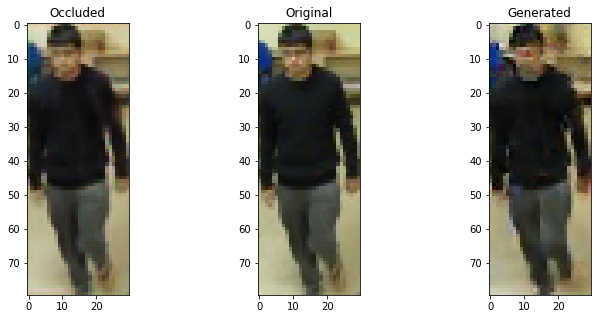

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


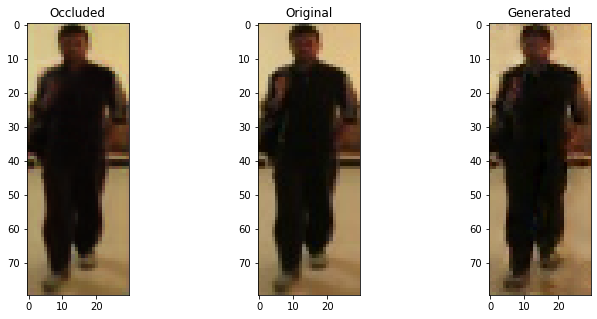

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


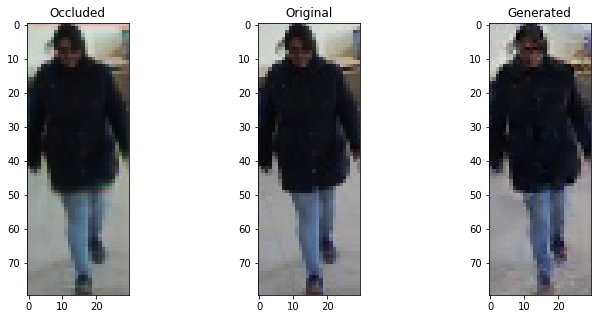

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


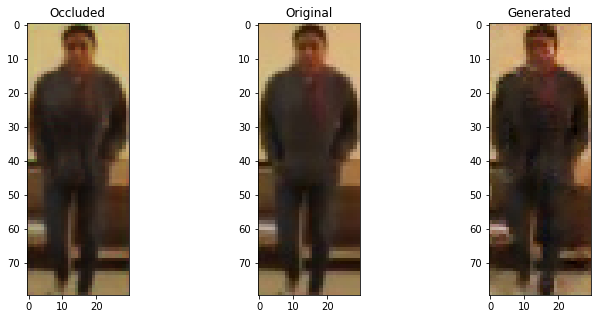

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


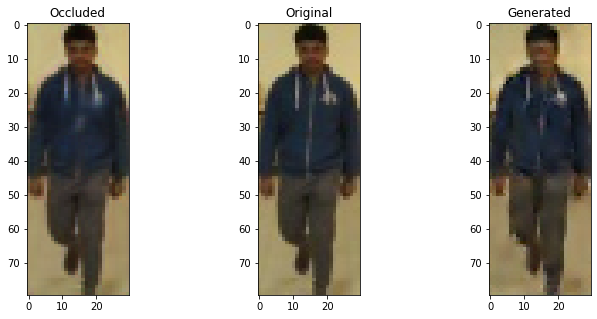

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6504107713699341 , Adversarial Loss:  0.0006467262865044177
Epoch 1362


  8%|▊         | 1/13 [00:00<00:01,  6.07it/s]

Discriminator Loss:  0.6668184995651245 , Adversarial Loss:  0.0006828139303252101
Epoch 1363


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6493952870368958 , Adversarial Loss:  0.0007048412808217108
Epoch 1364


  8%|▊         | 1/13 [00:00<00:01,  6.17it/s]

Discriminator Loss:  0.6508503556251526 , Adversarial Loss:  0.0006509567610919476
Epoch 1365


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6729114055633545 , Adversarial Loss:  0.0006083921762183309
Epoch 1366


  8%|▊         | 1/13 [00:00<00:01,  6.34it/s]

Discriminator Loss:  0.631350040435791 , Adversarial Loss:  0.0006635847385041416
Epoch 1367


  8%|▊         | 1/13 [00:00<00:01,  6.34it/s]

Discriminator Loss:  0.6719399690628052 , Adversarial Loss:  0.0005895204376429319
Epoch 1368


  8%|▊         | 1/13 [00:00<00:01,  6.36it/s]

Discriminator Loss:  0.6636450886726379 , Adversarial Loss:  0.00061663833912462
Epoch 1369


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6465649604797363 , Adversarial Loss:  0.0006163051002658904
Epoch 1370


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6540422439575195 , Adversarial Loss:  0.0006778649403713644
Epoch 1371


  8%|▊         | 1/13 [00:00<00:02,  5.64it/s]

Discriminator Loss:  0.6706984043121338 , Adversarial Loss:  0.0006439049611799419
Epoch 1372


  8%|▊         | 1/13 [00:00<00:01,  6.02it/s]

Discriminator Loss:  0.6582698822021484 , Adversarial Loss:  0.0006325092981569469
Epoch 1373


  8%|▊         | 1/13 [00:00<00:01,  6.54it/s]

Discriminator Loss:  0.6796552538871765 , Adversarial Loss:  0.0006578550674021244
Epoch 1374


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6550836563110352 , Adversarial Loss:  0.0005946661112830043
Epoch 1375


  8%|▊         | 1/13 [00:00<00:02,  5.22it/s]

Discriminator Loss:  0.6962459087371826 , Adversarial Loss:  0.0006104776402935386
Epoch 1376


  8%|▊         | 1/13 [00:00<00:01,  6.37it/s]

Discriminator Loss:  0.675344705581665 , Adversarial Loss:  0.000603602034971118
Epoch 1377


  8%|▊         | 1/13 [00:00<00:01,  6.19it/s]

Discriminator Loss:  0.6363722085952759 , Adversarial Loss:  0.0006326428847387433
Epoch 1378


  8%|▊         | 1/13 [00:00<00:01,  6.27it/s]

Discriminator Loss:  0.6413042545318604 , Adversarial Loss:  0.0006257874192669988
Epoch 1379


  8%|▊         | 1/13 [00:00<00:01,  6.79it/s]

Discriminator Loss:  0.6355640888214111 , Adversarial Loss:  0.0006196631584316492
Epoch 1380


  8%|▊         | 1/13 [00:00<00:01,  6.62it/s]

Discriminator Loss:  0.6742197871208191 , Adversarial Loss:  0.0006582794012501836
Epoch 1381


100%|██████████| 13/13 [00:02<00:00,  6.02it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


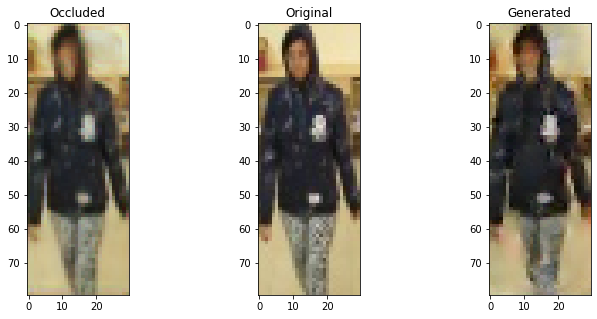

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


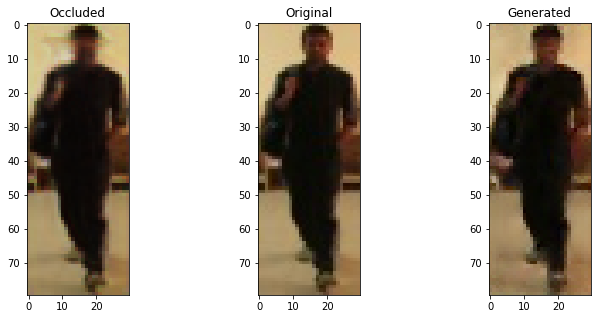

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


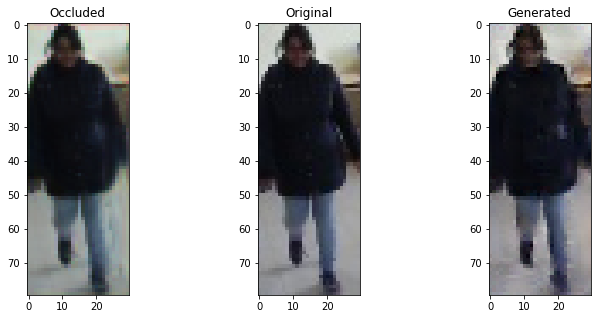

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


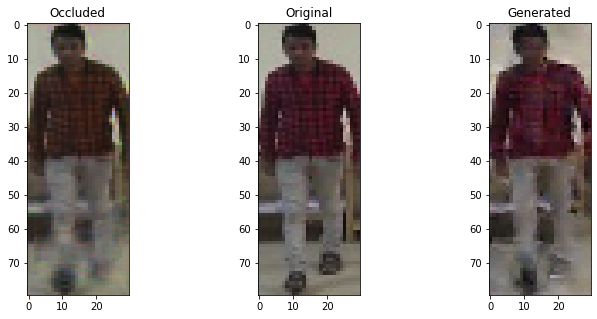

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


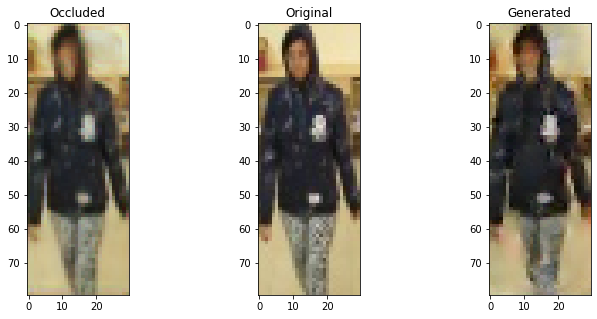

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6502265334129333 , Adversarial Loss:  0.0006004924653097987
Epoch 1382


  8%|▊         | 1/13 [00:00<00:01,  6.03it/s]

Discriminator Loss:  0.6803625822067261 , Adversarial Loss:  0.000684340950101614
Epoch 1383


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6570508480072021 , Adversarial Loss:  0.0006604318041354418
Epoch 1384


  8%|▊         | 1/13 [00:00<00:02,  5.47it/s]

Discriminator Loss:  0.6481891870498657 , Adversarial Loss:  0.000686399289406836
Epoch 1385


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6773176193237305 , Adversarial Loss:  0.0006657654303126037
Epoch 1386


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.646446704864502 , Adversarial Loss:  0.0006012918311171234
Epoch 1387


  8%|▊         | 1/13 [00:00<00:01,  6.47it/s]

Discriminator Loss:  0.676427960395813 , Adversarial Loss:  0.0005832465249113739
Epoch 1388


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6599678993225098 , Adversarial Loss:  0.0006204079836606979
Epoch 1389


  8%|▊         | 1/13 [00:00<00:01,  6.75it/s]

Discriminator Loss:  0.6693128347396851 , Adversarial Loss:  0.0006317211664281785
Epoch 1390


  8%|▊         | 1/13 [00:00<00:01,  6.33it/s]

Discriminator Loss:  0.6719997525215149 , Adversarial Loss:  0.0005940871778875589
Epoch 1391


  8%|▊         | 1/13 [00:00<00:02,  5.32it/s]

Discriminator Loss:  0.656843364238739 , Adversarial Loss:  0.0006361005362123251
Epoch 1392


  8%|▊         | 1/13 [00:00<00:01,  6.49it/s]

Discriminator Loss:  0.6615614891052246 , Adversarial Loss:  0.0006586211966350675
Epoch 1393


  8%|▊         | 1/13 [00:00<00:01,  6.51it/s]

Discriminator Loss:  0.6654024124145508 , Adversarial Loss:  0.000572214019484818
Epoch 1394


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6639268398284912 , Adversarial Loss:  0.0006607499672099948
Epoch 1395


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6741155385971069 , Adversarial Loss:  0.0006378272082656622
Epoch 1396


  8%|▊         | 1/13 [00:00<00:01,  6.42it/s]

Discriminator Loss:  0.6606501936912537 , Adversarial Loss:  0.0005959062254987657
Epoch 1397


  8%|▊         | 1/13 [00:00<00:01,  6.10it/s]

Discriminator Loss:  0.647966742515564 , Adversarial Loss:  0.0006842946750111878
Epoch 1398


  8%|▊         | 1/13 [00:00<00:01,  6.57it/s]

Discriminator Loss:  0.636235237121582 , Adversarial Loss:  0.0006187795661389828
Epoch 1399


  8%|▊         | 1/13 [00:00<00:02,  5.79it/s]

Discriminator Loss:  0.6701893210411072 , Adversarial Loss:  0.0005512232310138643
Epoch 1400


  8%|▊         | 1/13 [00:00<00:02,  5.28it/s]

Discriminator Loss:  0.6252021789550781 , Adversarial Loss:  0.0006292690522968769
Epoch 1401


100%|██████████| 13/13 [00:02<00:00,  5.99it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


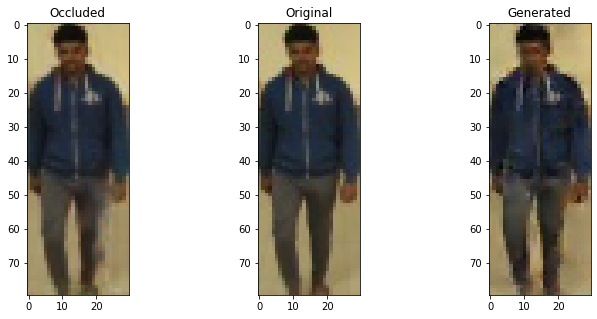

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


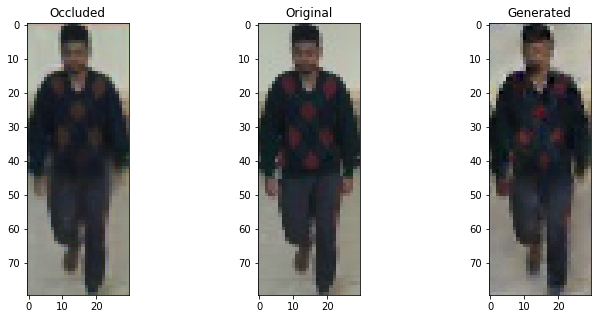

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


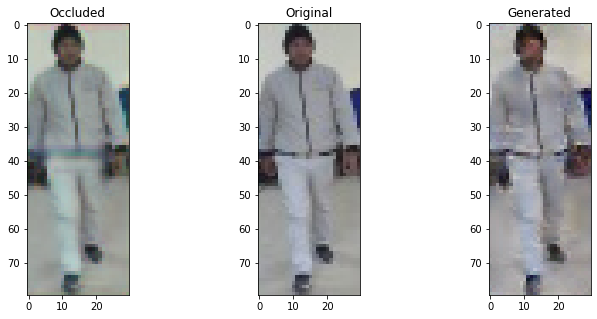

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


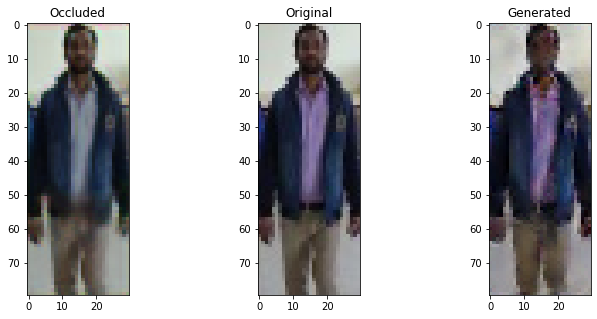

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


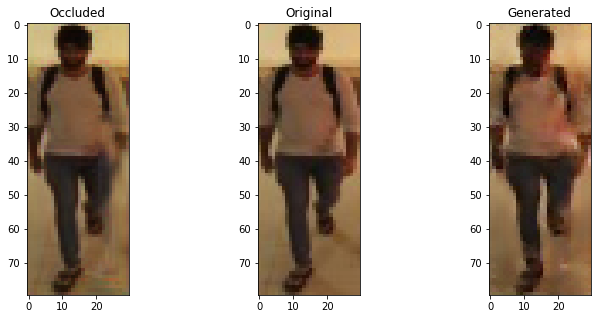

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6339845657348633 , Adversarial Loss:  0.0006386426975950599
Epoch 1402


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6832045316696167 , Adversarial Loss:  0.0006197310867719352
Epoch 1403


  8%|▊         | 1/13 [00:00<00:01,  6.36it/s]

Discriminator Loss:  0.6476107835769653 , Adversarial Loss:  0.0006248540012165904
Epoch 1404


  8%|▊         | 1/13 [00:00<00:02,  5.27it/s]

Discriminator Loss:  0.6531069278717041 , Adversarial Loss:  0.0005715845036320388
Epoch 1405


  8%|▊         | 1/13 [00:00<00:01,  6.74it/s]

Discriminator Loss:  0.6619460582733154 , Adversarial Loss:  0.0006286978023126721
Epoch 1406


  8%|▊         | 1/13 [00:00<00:01,  6.51it/s]

Discriminator Loss:  0.6604115962982178 , Adversarial Loss:  0.0006342143751680851
Epoch 1407


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6565173864364624 , Adversarial Loss:  0.0006273165345191956
Epoch 1408


  8%|▊         | 1/13 [00:00<00:02,  5.96it/s]

Discriminator Loss:  0.659575879573822 , Adversarial Loss:  0.000688644708134234
Epoch 1409


  8%|▊         | 1/13 [00:00<00:02,  5.33it/s]

Discriminator Loss:  0.6229261159896851 , Adversarial Loss:  0.0006247189594432712
Epoch 1410


  8%|▊         | 1/13 [00:00<00:01,  6.57it/s]

Discriminator Loss:  0.6414629220962524 , Adversarial Loss:  0.0006499290466308594
Epoch 1411


  8%|▊         | 1/13 [00:00<00:02,  5.23it/s]

Discriminator Loss:  0.6590653657913208 , Adversarial Loss:  0.0006124819628894329
Epoch 1412


  8%|▊         | 1/13 [00:00<00:01,  6.10it/s]

Discriminator Loss:  0.6735442876815796 , Adversarial Loss:  0.0005813193274661899
Epoch 1413


  8%|▊         | 1/13 [00:00<00:01,  6.49it/s]

Discriminator Loss:  0.6492797136306763 , Adversarial Loss:  0.0006613055011257529
Epoch 1414


  8%|▊         | 1/13 [00:00<00:01,  6.20it/s]

Discriminator Loss:  0.647863507270813 , Adversarial Loss:  0.000578958832193166
Epoch 1415


  8%|▊         | 1/13 [00:00<00:01,  6.20it/s]

Discriminator Loss:  0.6768162250518799 , Adversarial Loss:  0.0005696997977793217
Epoch 1416


  8%|▊         | 1/13 [00:00<00:01,  6.16it/s]

Discriminator Loss:  0.6452180743217468 , Adversarial Loss:  0.0005946005694568157
Epoch 1417


  8%|▊         | 1/13 [00:00<00:01,  6.78it/s]

Discriminator Loss:  0.6723846197128296 , Adversarial Loss:  0.0006366994348354638
Epoch 1418


  8%|▊         | 1/13 [00:00<00:01,  6.12it/s]

Discriminator Loss:  0.6787474155426025 , Adversarial Loss:  0.0006196843460202217
Epoch 1419


  8%|▊         | 1/13 [00:00<00:01,  6.88it/s]

Discriminator Loss:  0.6801696419715881 , Adversarial Loss:  0.0006002085283398628
Epoch 1420


  8%|▊         | 1/13 [00:00<00:02,  5.32it/s]

Discriminator Loss:  0.6715958118438721 , Adversarial Loss:  0.0006274025654420257
Epoch 1421


100%|██████████| 13/13 [00:02<00:00,  5.90it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


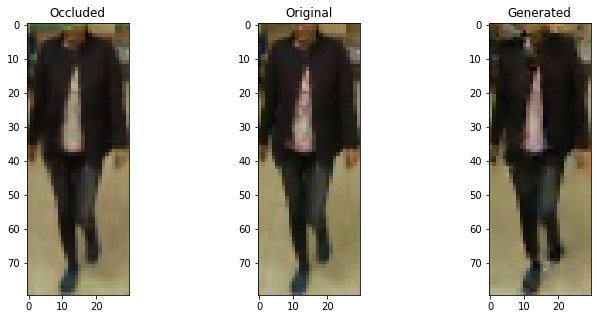

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


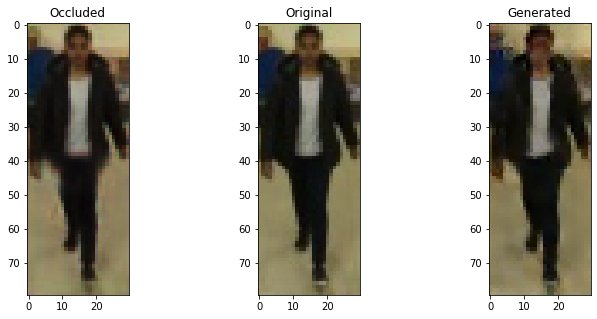

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


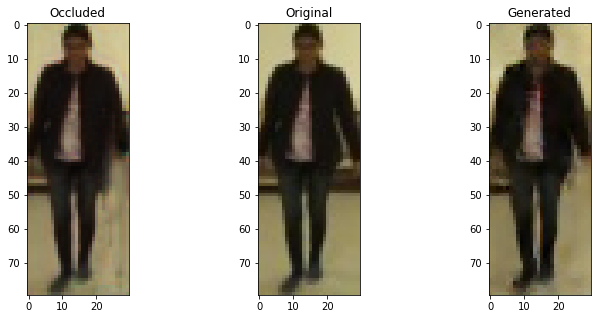

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


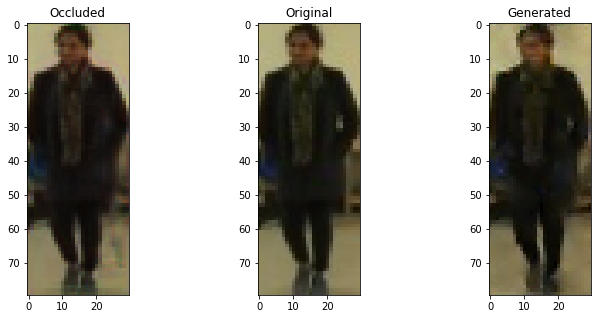

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


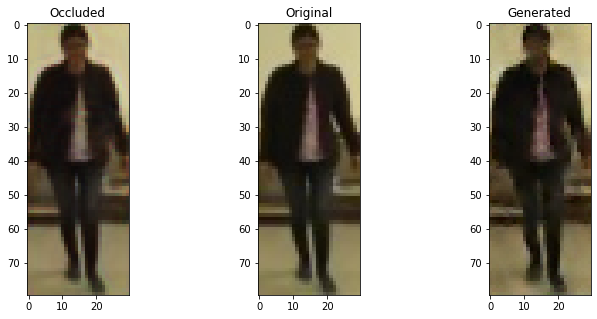

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.67630934715271 , Adversarial Loss:  0.0006271231104619801
Epoch 1422


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6502528190612793 , Adversarial Loss:  0.0005965522723272443
Epoch 1423


  8%|▊         | 1/13 [00:00<00:01,  6.36it/s]

Discriminator Loss:  0.6524455547332764 , Adversarial Loss:  0.0006036197883076966
Epoch 1424


  8%|▊         | 1/13 [00:00<00:01,  6.66it/s]

Discriminator Loss:  0.6688568592071533 , Adversarial Loss:  0.0005813023308292031
Epoch 1425


  8%|▊         | 1/13 [00:00<00:02,  5.78it/s]

Discriminator Loss:  0.6601554155349731 , Adversarial Loss:  0.0006070792442187667
Epoch 1426


  8%|▊         | 1/13 [00:00<00:01,  6.53it/s]

Discriminator Loss:  0.6722447276115417 , Adversarial Loss:  0.0006043058820068836
Epoch 1427


  8%|▊         | 1/13 [00:00<00:01,  6.44it/s]

Discriminator Loss:  0.6606126427650452 , Adversarial Loss:  0.0005825837142765522
Epoch 1428


  8%|▊         | 1/13 [00:00<00:01,  6.44it/s]

Discriminator Loss:  0.699813723564148 , Adversarial Loss:  0.0005452544428408146
Epoch 1429


  8%|▊         | 1/13 [00:00<00:01,  6.35it/s]

Discriminator Loss:  0.6563832759857178 , Adversarial Loss:  0.0006150006083771586
Epoch 1430


  8%|▊         | 1/13 [00:00<00:02,  5.27it/s]

Discriminator Loss:  0.6695784330368042 , Adversarial Loss:  0.000601946550887078
Epoch 1431


  8%|▊         | 1/13 [00:00<00:02,  5.76it/s]

Discriminator Loss:  0.6468144655227661 , Adversarial Loss:  0.0006358927930705249
Epoch 1432


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6478323936462402 , Adversarial Loss:  0.000621566956397146
Epoch 1433


  8%|▊         | 1/13 [00:00<00:01,  6.46it/s]

Discriminator Loss:  0.6617077589035034 , Adversarial Loss:  0.0006101122125983238
Epoch 1434


  8%|▊         | 1/13 [00:00<00:01,  6.56it/s]

Discriminator Loss:  0.6885812282562256 , Adversarial Loss:  0.0006445003673434258
Epoch 1435


  8%|▊         | 1/13 [00:00<00:01,  6.08it/s]

Discriminator Loss:  0.6687796115875244 , Adversarial Loss:  0.0006405755993910134
Epoch 1436


  8%|▊         | 1/13 [00:00<00:01,  6.24it/s]

Discriminator Loss:  0.6626876592636108 , Adversarial Loss:  0.0006062068277969956
Epoch 1437


  8%|▊         | 1/13 [00:00<00:01,  6.50it/s]

Discriminator Loss:  0.6629853248596191 , Adversarial Loss:  0.0006483448669314384
Epoch 1438


  8%|▊         | 1/13 [00:00<00:01,  6.12it/s]

Discriminator Loss:  0.6575735807418823 , Adversarial Loss:  0.0005973783554509282
Epoch 1439


  8%|▊         | 1/13 [00:00<00:01,  6.17it/s]

Discriminator Loss:  0.6525810956954956 , Adversarial Loss:  0.0005759713239967823
Epoch 1440


  8%|▊         | 1/13 [00:00<00:01,  6.73it/s]

Discriminator Loss:  0.6398743987083435 , Adversarial Loss:  0.0006209983257576823
Epoch 1441


100%|██████████| 13/13 [00:02<00:00,  6.22it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


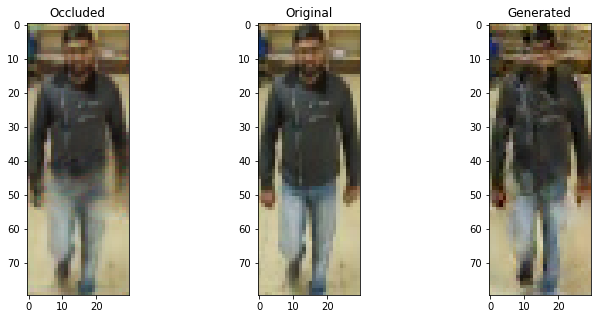

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


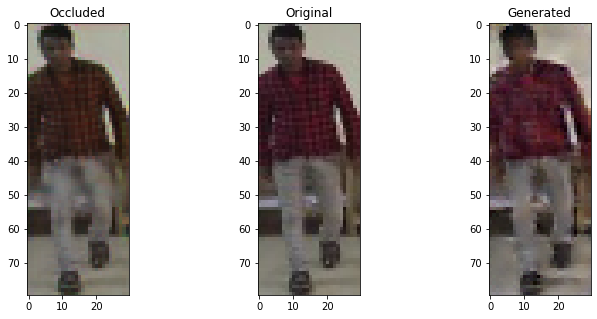

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


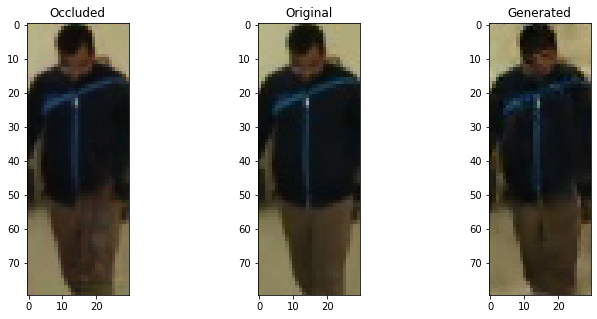

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


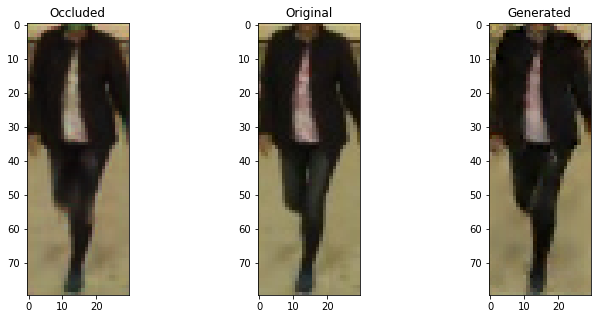

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


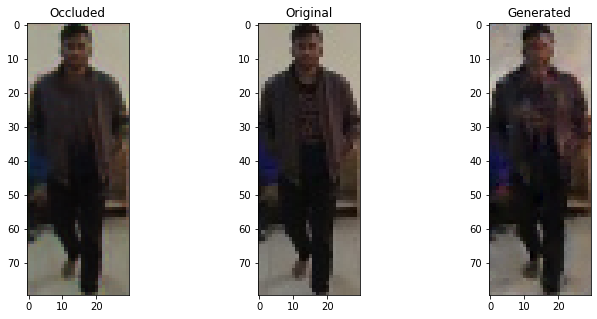

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6289042234420776 , Adversarial Loss:  0.0007230037008412182
Epoch 1442


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6425795555114746 , Adversarial Loss:  0.0006214680033735931
Epoch 1443


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6521354913711548 , Adversarial Loss:  0.0006645186804234982
Epoch 1444


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6740429401397705 , Adversarial Loss:  0.000597109436057508
Epoch 1445


  8%|▊         | 1/13 [00:00<00:02,  5.95it/s]

Discriminator Loss:  0.6601016521453857 , Adversarial Loss:  0.0006259116344153881
Epoch 1446


  8%|▊         | 1/13 [00:00<00:01,  6.64it/s]

Discriminator Loss:  0.6502327919006348 , Adversarial Loss:  0.0006093522533774376
Epoch 1447


  8%|▊         | 1/13 [00:00<00:01,  6.18it/s]

Discriminator Loss:  0.6502029299736023 , Adversarial Loss:  0.0005698725581169128
Epoch 1448


  8%|▊         | 1/13 [00:00<00:01,  6.69it/s]

Discriminator Loss:  0.6292577981948853 , Adversarial Loss:  0.0006502206670120358
Epoch 1449


  8%|▊         | 1/13 [00:00<00:01,  6.51it/s]

Discriminator Loss:  0.6580037474632263 , Adversarial Loss:  0.0006136712618172169
Epoch 1450


  8%|▊         | 1/13 [00:00<00:02,  5.77it/s]

Discriminator Loss:  0.6435804963111877 , Adversarial Loss:  0.0006215954781509936
Epoch 1451


  8%|▊         | 1/13 [00:00<00:01,  6.75it/s]

Discriminator Loss:  0.6623179912567139 , Adversarial Loss:  0.0005446756258606911
Epoch 1452


  8%|▊         | 1/13 [00:00<00:01,  6.38it/s]

Discriminator Loss:  0.651604413986206 , Adversarial Loss:  0.0006006947951391339
Epoch 1453


  8%|▊         | 1/13 [00:00<00:01,  6.68it/s]

Discriminator Loss:  0.6455848813056946 , Adversarial Loss:  0.0006310857133939862
Epoch 1454


  8%|▊         | 1/13 [00:00<00:01,  6.34it/s]

Discriminator Loss:  0.6520018577575684 , Adversarial Loss:  0.0006345609435811639
Epoch 1455


  8%|▊         | 1/13 [00:00<00:02,  5.87it/s]

Discriminator Loss:  0.6773386001586914 , Adversarial Loss:  0.0006423508748412132
Epoch 1456


  8%|▊         | 1/13 [00:00<00:01,  6.19it/s]

Discriminator Loss:  0.6638399362564087 , Adversarial Loss:  0.0005500974366441369
Epoch 1457


  8%|▊         | 1/13 [00:00<00:01,  6.22it/s]

Discriminator Loss:  0.674818754196167 , Adversarial Loss:  0.0006145015358924866
Epoch 1458


  8%|▊         | 1/13 [00:00<00:01,  6.61it/s]

Discriminator Loss:  0.6536275148391724 , Adversarial Loss:  0.0006300504901446402
Epoch 1459


  8%|▊         | 1/13 [00:00<00:02,  5.92it/s]

Discriminator Loss:  0.664833128452301 , Adversarial Loss:  0.000648653891403228
Epoch 1460


  8%|▊         | 1/13 [00:00<00:01,  6.47it/s]

Discriminator Loss:  0.6581228971481323 , Adversarial Loss:  0.0005486650625243783
Epoch 1461


100%|██████████| 13/13 [00:02<00:00,  6.08it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


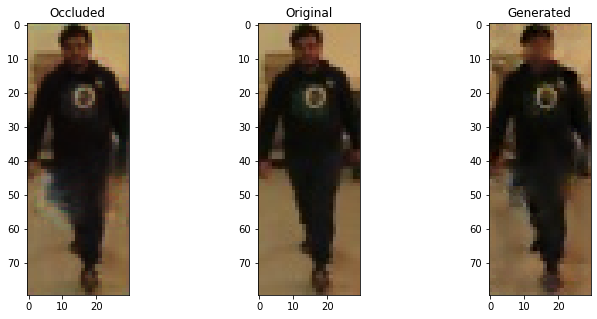

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


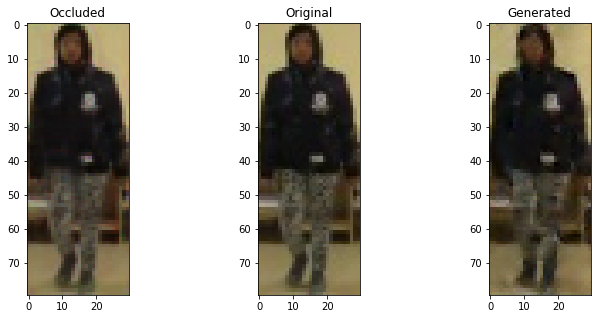

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


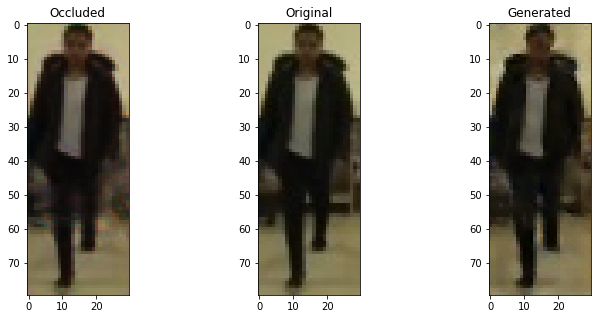

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


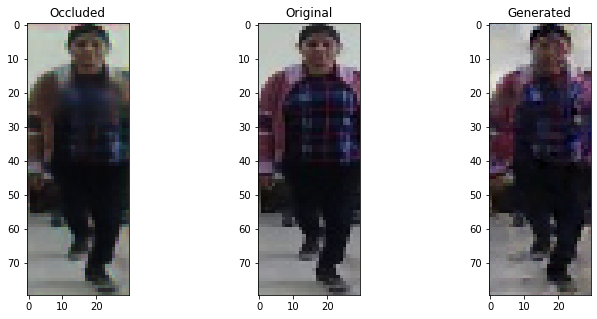

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


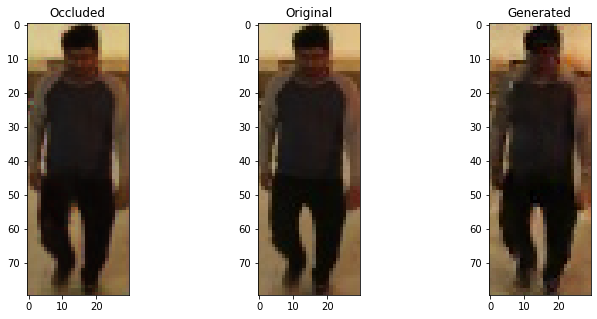

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6676661968231201 , Adversarial Loss:  0.0005843507242389023
Epoch 1462


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6589062213897705 , Adversarial Loss:  0.0005567515036091208
Epoch 1463


  8%|▊         | 1/13 [00:00<00:01,  6.05it/s]

Discriminator Loss:  0.6955524682998657 , Adversarial Loss:  0.0005642501637339592
Epoch 1464


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6574007868766785 , Adversarial Loss:  0.0005316152237355709
Epoch 1465


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6566591262817383 , Adversarial Loss:  0.0005681695183739066
Epoch 1466


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6439172029495239 , Adversarial Loss:  0.0005926181911490858
Epoch 1467


  8%|▊         | 1/13 [00:00<00:02,  5.15it/s]

Discriminator Loss:  0.67609703540802 , Adversarial Loss:  0.000585719128139317
Epoch 1468


  8%|▊         | 1/13 [00:00<00:02,  5.99it/s]

Discriminator Loss:  0.6537784934043884 , Adversarial Loss:  0.0005460926913656294
Epoch 1469


  8%|▊         | 1/13 [00:00<00:01,  6.56it/s]

Discriminator Loss:  0.6358190178871155 , Adversarial Loss:  0.0006063219625502825
Epoch 1470


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6504729390144348 , Adversarial Loss:  0.0005868918960914016
Epoch 1471


  8%|▊         | 1/13 [00:00<00:01,  6.53it/s]

Discriminator Loss:  0.6760559678077698 , Adversarial Loss:  0.0005550198256969452
Epoch 1472


  8%|▊         | 1/13 [00:00<00:02,  5.77it/s]

Discriminator Loss:  0.6682194471359253 , Adversarial Loss:  0.0005837582284584641
Epoch 1473


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6545988917350769 , Adversarial Loss:  0.0005590921500697732
Epoch 1474


  8%|▊         | 1/13 [00:00<00:02,  5.25it/s]

Discriminator Loss:  0.6713091731071472 , Adversarial Loss:  0.0005823128158226609
Epoch 1475


  8%|▊         | 1/13 [00:00<00:01,  6.09it/s]

Discriminator Loss:  0.6565577983856201 , Adversarial Loss:  0.0005936556844972074
Epoch 1476


  8%|▊         | 1/13 [00:00<00:01,  6.90it/s]

Discriminator Loss:  0.6633382439613342 , Adversarial Loss:  0.0006794757209718227
Epoch 1477


  8%|▊         | 1/13 [00:00<00:01,  6.21it/s]

Discriminator Loss:  0.6812761425971985 , Adversarial Loss:  0.0006396141252480447
Epoch 1478


  8%|▊         | 1/13 [00:00<00:01,  6.10it/s]

Discriminator Loss:  0.6480940580368042 , Adversarial Loss:  0.0005400789086706936
Epoch 1479


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6654096841812134 , Adversarial Loss:  0.0005876906216144562
Epoch 1480


  8%|▊         | 1/13 [00:00<00:01,  6.23it/s]

Discriminator Loss:  0.6692448854446411 , Adversarial Loss:  0.0005790385184809566
Epoch 1481


100%|██████████| 13/13 [00:02<00:00,  6.14it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


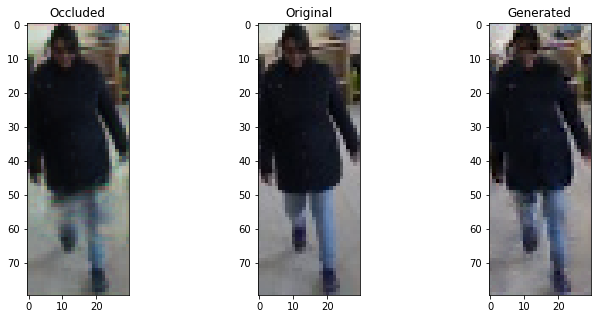

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


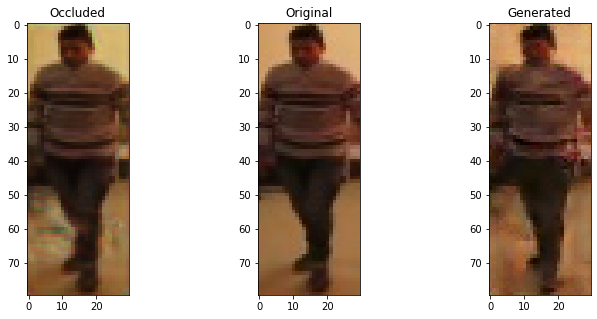

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


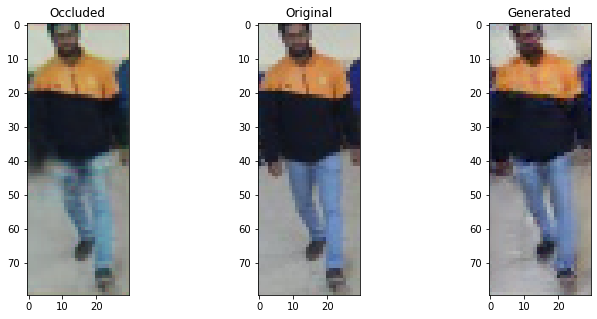

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


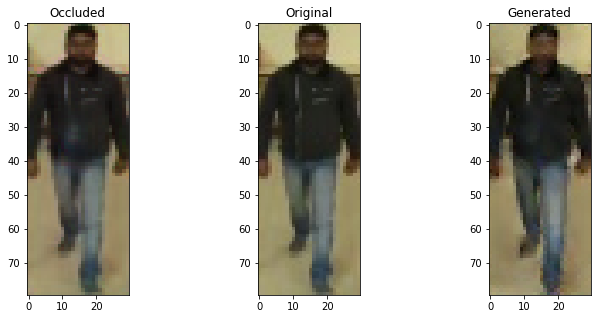

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


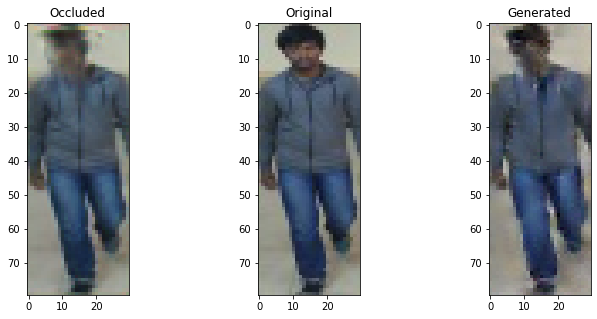

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6539086699485779 , Adversarial Loss:  0.0005428272997960448
Epoch 1482


  8%|▊         | 1/13 [00:00<00:01,  6.39it/s]

Discriminator Loss:  0.665939450263977 , Adversarial Loss:  0.000573260709643364
Epoch 1483


  8%|▊         | 1/13 [00:00<00:01,  6.42it/s]

Discriminator Loss:  0.6842761039733887 , Adversarial Loss:  0.0005786350811831653
Epoch 1484


  8%|▊         | 1/13 [00:00<00:01,  6.96it/s]

Discriminator Loss:  0.6470497846603394 , Adversarial Loss:  0.0005871006287634373
Epoch 1485


  8%|▊         | 1/13 [00:00<00:01,  6.18it/s]

Discriminator Loss:  0.6471669673919678 , Adversarial Loss:  0.00047823760542087257
Epoch 1486


  8%|▊         | 1/13 [00:00<00:01,  6.21it/s]

Discriminator Loss:  0.6917665600776672 , Adversarial Loss:  0.0006071255193091929
Epoch 1487


  8%|▊         | 1/13 [00:00<00:01,  6.39it/s]

Discriminator Loss:  0.6784668564796448 , Adversarial Loss:  0.0005687843658961356
Epoch 1488


  8%|▊         | 1/13 [00:00<00:02,  5.11it/s]

Discriminator Loss:  0.6383202075958252 , Adversarial Loss:  0.0006039718864485621
Epoch 1489


  8%|▊         | 1/13 [00:00<00:01,  6.62it/s]

Discriminator Loss:  0.6731817126274109 , Adversarial Loss:  0.0005901399999856949
Epoch 1490


  8%|▊         | 1/13 [00:00<00:01,  6.31it/s]

Discriminator Loss:  0.6722767949104309 , Adversarial Loss:  0.0006488427170552313
Epoch 1491


  8%|▊         | 1/13 [00:00<00:01,  6.40it/s]

Discriminator Loss:  0.6812035441398621 , Adversarial Loss:  0.0005984497256577015
Epoch 1492


  8%|▊         | 1/13 [00:00<00:01,  6.33it/s]

Discriminator Loss:  0.6715962290763855 , Adversarial Loss:  0.0005977543187327683
Epoch 1493


  8%|▊         | 1/13 [00:00<00:01,  7.05it/s]

Discriminator Loss:  0.703384280204773 , Adversarial Loss:  0.0005429646698758006
Epoch 1494


  8%|▊         | 1/13 [00:00<00:01,  6.68it/s]

Discriminator Loss:  0.6618002653121948 , Adversarial Loss:  0.0005741025670431554
Epoch 1495


  8%|▊         | 1/13 [00:00<00:01,  6.40it/s]

Discriminator Loss:  0.6513309478759766 , Adversarial Loss:  0.0006118409801274538
Epoch 1496


  8%|▊         | 1/13 [00:00<00:02,  5.15it/s]

Discriminator Loss:  0.6392381191253662 , Adversarial Loss:  0.0005941397976130247
Epoch 1497


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6257755756378174 , Adversarial Loss:  0.000627565139438957
Epoch 1498


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6850754022598267 , Adversarial Loss:  0.0006105047650635242
Epoch 1499


  8%|▊         | 1/13 [00:00<00:01,  6.56it/s]

Discriminator Loss:  0.6656418442726135 , Adversarial Loss:  0.0005941676208749413
Epoch 1500


  8%|▊         | 1/13 [00:00<00:01,  6.86it/s]

Discriminator Loss:  0.6701599359512329 , Adversarial Loss:  0.0005766218528151512
Epoch 1501


100%|██████████| 13/13 [00:02<00:00,  6.02it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


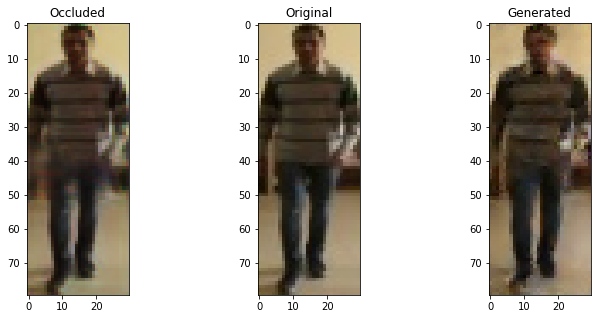

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


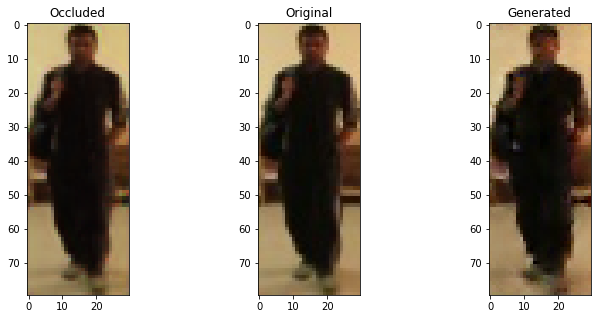

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


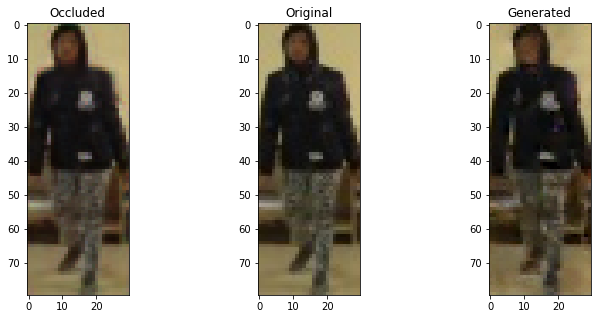

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


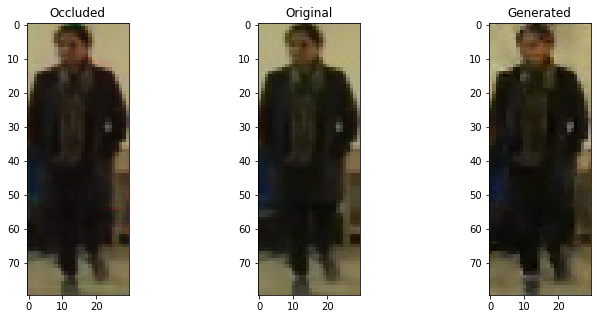

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


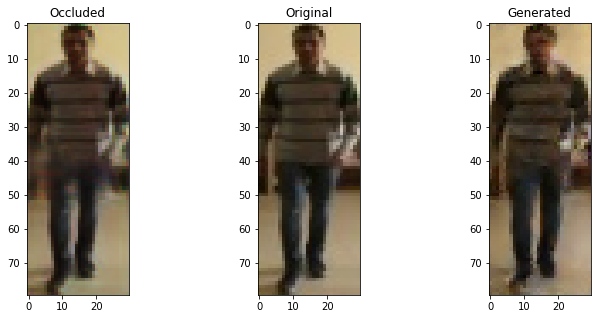

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6468599438667297 , Adversarial Loss:  0.0005905359284952283
Epoch 1502


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6473982334136963 , Adversarial Loss:  0.0006363206775858998
Epoch 1503


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6836156249046326 , Adversarial Loss:  0.0005942950956523418
Epoch 1504


  8%|▊         | 1/13 [00:00<00:01,  6.28it/s]

Discriminator Loss:  0.6513814330101013 , Adversarial Loss:  0.0005998652195557952
Epoch 1505


  8%|▊         | 1/13 [00:00<00:01,  6.22it/s]

Discriminator Loss:  0.6641676425933838 , Adversarial Loss:  0.0005702552734874189
Epoch 1506


  8%|▊         | 1/13 [00:00<00:01,  6.28it/s]

Discriminator Loss:  0.6520695090293884 , Adversarial Loss:  0.0005700212204828858
Epoch 1507


  8%|▊         | 1/13 [00:00<00:01,  6.64it/s]

Discriminator Loss:  0.6787484884262085 , Adversarial Loss:  0.0005372683517634869
Epoch 1508


  8%|▊         | 1/13 [00:00<00:01,  6.34it/s]

Discriminator Loss:  0.6501668095588684 , Adversarial Loss:  0.0005916671943850815
Epoch 1509


  8%|▊         | 1/13 [00:00<00:01,  6.65it/s]

Discriminator Loss:  0.6694937944412231 , Adversarial Loss:  0.0005233465926721692
Epoch 1510


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6536610126495361 , Adversarial Loss:  0.0005122116999700665
Epoch 1511


  8%|▊         | 1/13 [00:00<00:02,  5.44it/s]

Discriminator Loss:  0.6824226379394531 , Adversarial Loss:  0.0005632538814097643
Epoch 1512


  8%|▊         | 1/13 [00:00<00:02,  5.99it/s]

Discriminator Loss:  0.6668699979782104 , Adversarial Loss:  0.0005525785963982344
Epoch 1513


  8%|▊         | 1/13 [00:00<00:01,  6.24it/s]

Discriminator Loss:  0.6490729451179504 , Adversarial Loss:  0.0005566226900555193
Epoch 1514


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6650347709655762 , Adversarial Loss:  0.000577946484554559
Epoch 1515


  8%|▊         | 1/13 [00:00<00:01,  6.33it/s]

Discriminator Loss:  0.6467466354370117 , Adversarial Loss:  0.0013411286054179072
Epoch 1516


  8%|▊         | 1/13 [00:00<00:01,  6.71it/s]

Discriminator Loss:  0.6586524248123169 , Adversarial Loss:  0.005094799678772688
Epoch 1517


  8%|▊         | 1/13 [00:00<00:01,  6.25it/s]

Discriminator Loss:  0.6622830629348755 , Adversarial Loss:  0.0032449671998620033
Epoch 1518


  8%|▊         | 1/13 [00:00<00:01,  6.11it/s]

Discriminator Loss:  0.6449886560440063 , Adversarial Loss:  0.002576901111751795
Epoch 1519


  8%|▊         | 1/13 [00:00<00:02,  5.29it/s]

Discriminator Loss:  0.6609917879104614 , Adversarial Loss:  0.0025559519417583942
Epoch 1520


  8%|▊         | 1/13 [00:00<00:01,  6.60it/s]

Discriminator Loss:  0.6689144372940063 , Adversarial Loss:  0.0018654598388820887
Epoch 1521


100%|██████████| 13/13 [00:02<00:00,  5.88it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


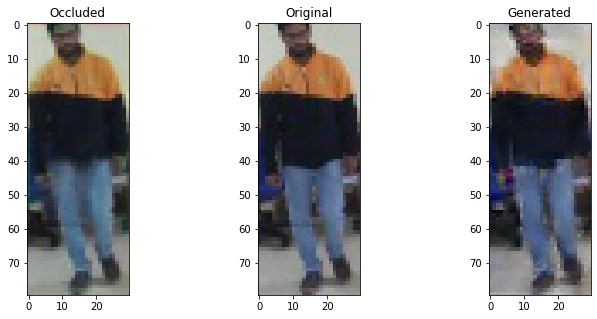

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


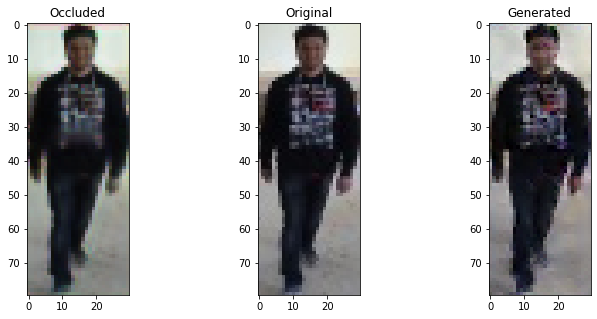

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


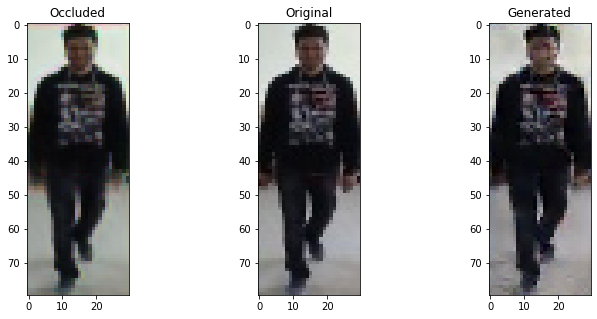

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


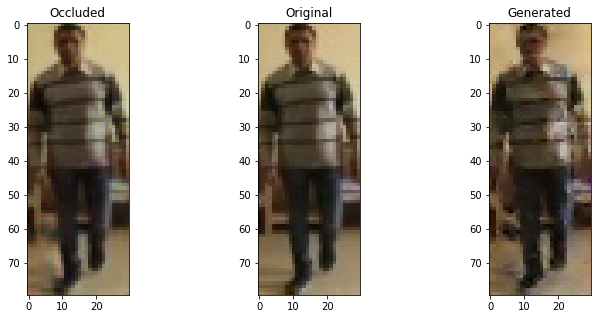

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


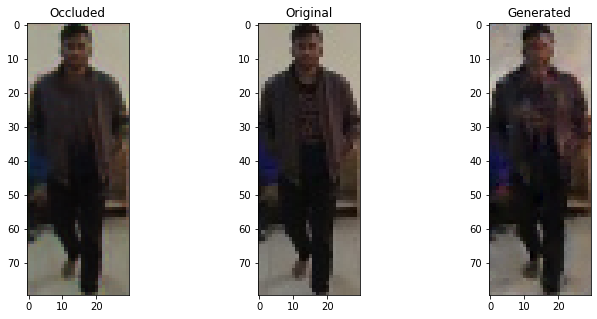

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6747604608535767 , Adversarial Loss:  0.001936412532813847
Epoch 1522


  8%|▊         | 1/13 [00:00<00:01,  6.25it/s]

Discriminator Loss:  0.631729006767273 , Adversarial Loss:  0.0017142394790425897
Epoch 1523


  8%|▊         | 1/13 [00:00<00:01,  6.43it/s]

Discriminator Loss:  0.6503817439079285 , Adversarial Loss:  0.0014771708520129323
Epoch 1524


  8%|▊         | 1/13 [00:00<00:01,  6.67it/s]

Discriminator Loss:  0.6431689262390137 , Adversarial Loss:  0.0015503480099141598
Epoch 1525


  8%|▊         | 1/13 [00:00<00:01,  6.07it/s]

Discriminator Loss:  0.6613224148750305 , Adversarial Loss:  0.0015095327980816364
Epoch 1526


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6645572781562805 , Adversarial Loss:  0.0013459122274070978
Epoch 1527


  8%|▊         | 1/13 [00:00<00:01,  6.83it/s]

Discriminator Loss:  0.6468806862831116 , Adversarial Loss:  0.0013175234198570251
Epoch 1528


  8%|▊         | 1/13 [00:00<00:01,  6.34it/s]

Discriminator Loss:  0.6440824866294861 , Adversarial Loss:  0.001136991661041975
Epoch 1529


  8%|▊         | 1/13 [00:00<00:01,  6.70it/s]

Discriminator Loss:  0.6520895957946777 , Adversarial Loss:  0.0010884293587878346
Epoch 1530


  8%|▊         | 1/13 [00:00<00:01,  6.56it/s]

Discriminator Loss:  0.6512029767036438 , Adversarial Loss:  0.001089773140847683
Epoch 1531


  8%|▊         | 1/13 [00:00<00:01,  6.67it/s]

Discriminator Loss:  0.6545644998550415 , Adversarial Loss:  0.0009973172564059496
Epoch 1532


  8%|▊         | 1/13 [00:00<00:01,  6.57it/s]

Discriminator Loss:  0.6540585160255432 , Adversarial Loss:  0.0010516472393646836
Epoch 1533


  8%|▊         | 1/13 [00:00<00:02,  5.97it/s]

Discriminator Loss:  0.6654212474822998 , Adversarial Loss:  0.0009745045099407434
Epoch 1534


  8%|▊         | 1/13 [00:00<00:02,  5.76it/s]

Discriminator Loss:  0.6474173069000244 , Adversarial Loss:  0.0010176001815125346
Epoch 1535


  8%|▊         | 1/13 [00:00<00:02,  5.92it/s]

Discriminator Loss:  0.6562078595161438 , Adversarial Loss:  0.000851389137096703
Epoch 1536


  8%|▊         | 1/13 [00:00<00:02,  5.66it/s]

Discriminator Loss:  0.6587493419647217 , Adversarial Loss:  0.0009348185267299414
Epoch 1537


  8%|▊         | 1/13 [00:00<00:01,  6.46it/s]

Discriminator Loss:  0.6452831029891968 , Adversarial Loss:  0.0009387409081682563
Epoch 1538


  8%|▊         | 1/13 [00:00<00:02,  5.79it/s]

Discriminator Loss:  0.6692835092544556 , Adversarial Loss:  0.000887939939275384
Epoch 1539


  8%|▊         | 1/13 [00:00<00:01,  6.16it/s]

Discriminator Loss:  0.6369836330413818 , Adversarial Loss:  0.0008303757640533149
Epoch 1540


  8%|▊         | 1/13 [00:00<00:01,  6.49it/s]

Discriminator Loss:  0.6677731871604919 , Adversarial Loss:  0.0008051125332713127
Epoch 1541


100%|██████████| 13/13 [00:02<00:00,  5.76it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


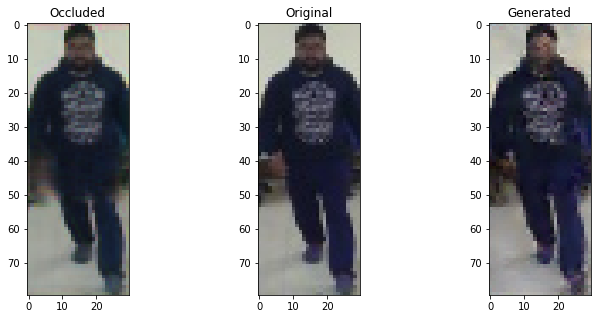

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


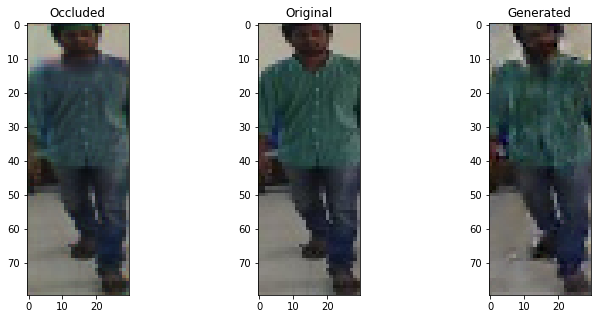

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


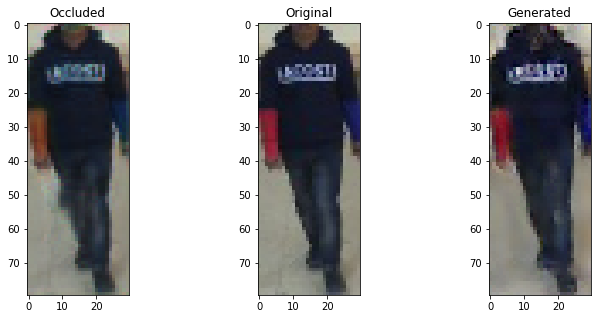

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


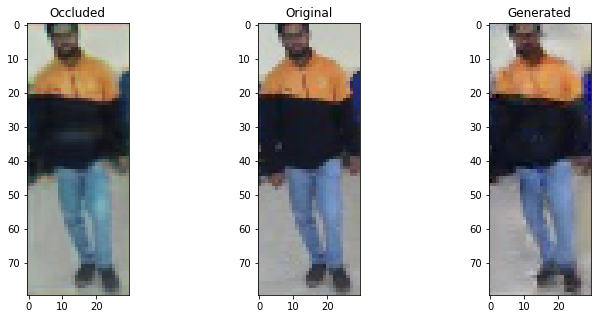

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


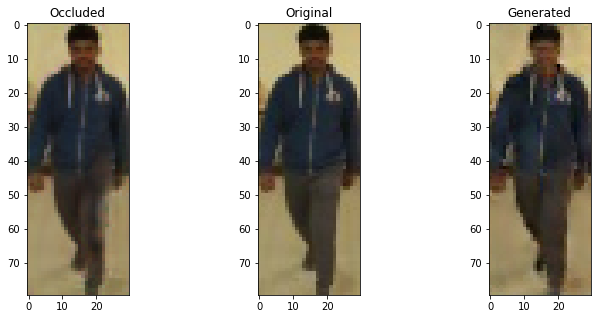

  8%|▊         | 1/13 [00:00<00:02,  5.21it/s]

Discriminator Loss:  0.6528331637382507 , Adversarial Loss:  0.000889908114913851
Epoch 1542


  8%|▊         | 1/13 [00:00<00:01,  6.52it/s]

Discriminator Loss:  0.6547899842262268 , Adversarial Loss:  0.0007645607693120837
Epoch 1543


  8%|▊         | 1/13 [00:00<00:01,  6.39it/s]

Discriminator Loss:  0.6436865329742432 , Adversarial Loss:  0.0007038833573460579
Epoch 1544


  8%|▊         | 1/13 [00:00<00:01,  6.69it/s]

Discriminator Loss:  0.644571840763092 , Adversarial Loss:  0.0007979549700394273
Epoch 1545


  8%|▊         | 1/13 [00:00<00:02,  5.95it/s]

Discriminator Loss:  0.6620602607727051 , Adversarial Loss:  0.0007615762297064066
Epoch 1546


  8%|▊         | 1/13 [00:00<00:02,  5.55it/s]

Discriminator Loss:  0.658636748790741 , Adversarial Loss:  0.0007205380825325847
Epoch 1547


  8%|▊         | 1/13 [00:00<00:01,  6.33it/s]

Discriminator Loss:  0.6593137979507446 , Adversarial Loss:  0.0006832021754235029
Epoch 1548


  8%|▊         | 1/13 [00:00<00:01,  6.52it/s]

Discriminator Loss:  0.6816713213920593 , Adversarial Loss:  0.0007364577031694353
Epoch 1549


  8%|▊         | 1/13 [00:00<00:01,  6.15it/s]

Discriminator Loss:  0.6585648059844971 , Adversarial Loss:  0.0006831936188973486
Epoch 1550


  8%|▊         | 1/13 [00:00<00:01,  6.63it/s]

Discriminator Loss:  0.6661937236785889 , Adversarial Loss:  0.0007444252260029316
Epoch 1551


  8%|▊         | 1/13 [00:00<00:01,  6.56it/s]

Discriminator Loss:  0.6521217823028564 , Adversarial Loss:  0.0007263575680553913
Epoch 1552


  8%|▊         | 1/13 [00:00<00:01,  6.67it/s]

Discriminator Loss:  0.6558091640472412 , Adversarial Loss:  0.0006708051078021526
Epoch 1553


  8%|▊         | 1/13 [00:00<00:02,  5.30it/s]

Discriminator Loss:  0.6728902459144592 , Adversarial Loss:  0.0007215419318526983
Epoch 1554


  8%|▊         | 1/13 [00:00<00:02,  5.28it/s]

Discriminator Loss:  0.653259813785553 , Adversarial Loss:  0.000621541403234005
Epoch 1555


  8%|▊         | 1/13 [00:00<00:02,  5.86it/s]

Discriminator Loss:  0.6600103974342346 , Adversarial Loss:  0.0007226877496577799
Epoch 1556


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6846354007720947 , Adversarial Loss:  0.0007168517331592739
Epoch 1557


  8%|▊         | 1/13 [00:00<00:01,  6.56it/s]

Discriminator Loss:  0.6317133903503418 , Adversarial Loss:  0.0006344164721667767
Epoch 1558


  8%|▊         | 1/13 [00:00<00:01,  6.30it/s]

Discriminator Loss:  0.6525492668151855 , Adversarial Loss:  0.0006835267995484173
Epoch 1559


  8%|▊         | 1/13 [00:00<00:01,  6.77it/s]

Discriminator Loss:  0.6583840250968933 , Adversarial Loss:  0.000681177421938628
Epoch 1560


  8%|▊         | 1/13 [00:00<00:01,  6.66it/s]

Discriminator Loss:  0.6625417470932007 , Adversarial Loss:  0.0007528841961175203
Epoch 1561


100%|██████████| 13/13 [00:02<00:00,  6.22it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


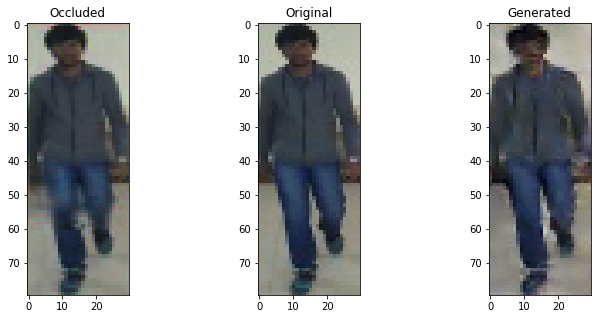

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


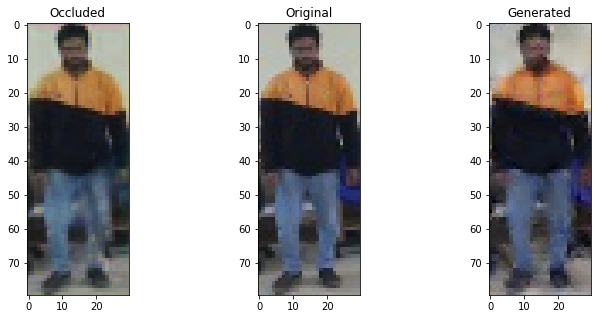

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


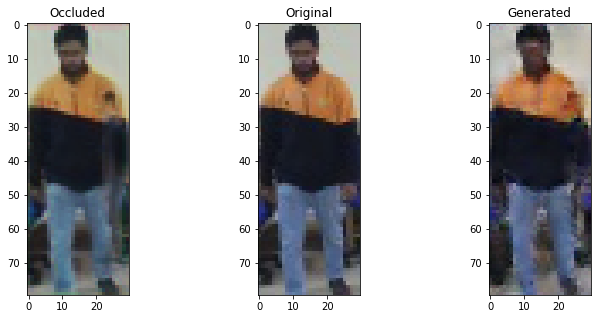

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


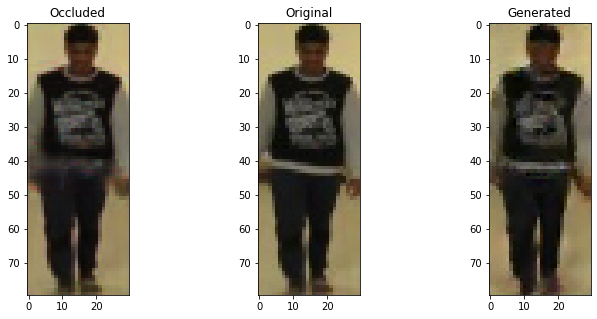

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


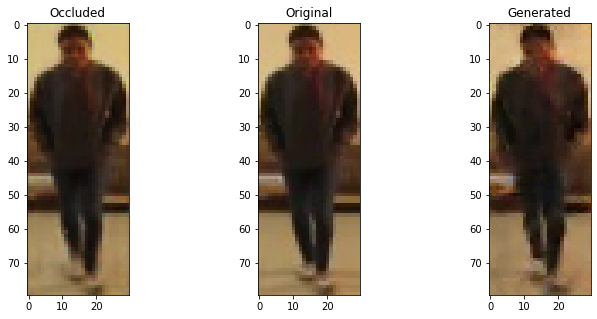

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.673596978187561 , Adversarial Loss:  0.0005927648162469268
Epoch 1562


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6695277690887451 , Adversarial Loss:  0.0006392723298631608
Epoch 1563


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6488629579544067 , Adversarial Loss:  0.0005788655253127217
Epoch 1564


  8%|▊         | 1/13 [00:00<00:01,  6.63it/s]

Discriminator Loss:  0.6676625609397888 , Adversarial Loss:  0.0007125637494027615
Epoch 1565


  8%|▊         | 1/13 [00:00<00:01,  6.51it/s]

Discriminator Loss:  0.644207239151001 , Adversarial Loss:  0.0006521083996631205
Epoch 1566


  8%|▊         | 1/13 [00:00<00:02,  5.14it/s]

Discriminator Loss:  0.6513085961341858 , Adversarial Loss:  0.0006667600246146321
Epoch 1567


  8%|▊         | 1/13 [00:00<00:02,  5.32it/s]

Discriminator Loss:  0.6487168073654175 , Adversarial Loss:  0.0005770274437963963
Epoch 1568


  8%|▊         | 1/13 [00:00<00:02,  5.89it/s]

Discriminator Loss:  0.6597775220870972 , Adversarial Loss:  0.0006564690265804529
Epoch 1569


  8%|▊         | 1/13 [00:00<00:01,  6.77it/s]

Discriminator Loss:  0.6474019289016724 , Adversarial Loss:  0.0006207966944202781
Epoch 1570


  8%|▊         | 1/13 [00:00<00:01,  6.61it/s]

Discriminator Loss:  0.654827356338501 , Adversarial Loss:  0.0006620177300646901
Epoch 1571


  8%|▊         | 1/13 [00:00<00:01,  6.50it/s]

Discriminator Loss:  0.6687451601028442 , Adversarial Loss:  0.0006123499479144812
Epoch 1572


  8%|▊         | 1/13 [00:00<00:01,  6.65it/s]

Discriminator Loss:  0.6612255573272705 , Adversarial Loss:  0.000600198341999203
Epoch 1573


  8%|▊         | 1/13 [00:00<00:01,  6.71it/s]

Discriminator Loss:  0.6611765623092651 , Adversarial Loss:  0.0005725993542000651
Epoch 1574


  8%|▊         | 1/13 [00:00<00:01,  6.70it/s]

Discriminator Loss:  0.6705105304718018 , Adversarial Loss:  0.000622423889581114
Epoch 1575


  8%|▊         | 1/13 [00:00<00:01,  6.28it/s]

Discriminator Loss:  0.6457396745681763 , Adversarial Loss:  0.0005955204833298922
Epoch 1576


  8%|▊         | 1/13 [00:00<00:01,  6.78it/s]

Discriminator Loss:  0.6544569730758667 , Adversarial Loss:  0.0006017570849508047
Epoch 1577


  8%|▊         | 1/13 [00:00<00:01,  6.80it/s]

Discriminator Loss:  0.6671825647354126 , Adversarial Loss:  0.0005740153719671071
Epoch 1578


  8%|▊         | 1/13 [00:00<00:01,  6.77it/s]

Discriminator Loss:  0.6701620817184448 , Adversarial Loss:  0.0006369415204972029
Epoch 1579


  8%|▊         | 1/13 [00:00<00:01,  6.85it/s]

Discriminator Loss:  0.676422119140625 , Adversarial Loss:  0.000650047673843801
Epoch 1580


  8%|▊         | 1/13 [00:00<00:01,  6.67it/s]

Discriminator Loss:  0.6743881702423096 , Adversarial Loss:  0.000619241502135992
Epoch 1581


100%|██████████| 13/13 [00:02<00:00,  5.86it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


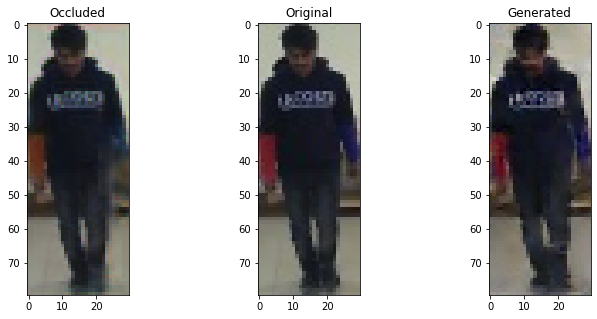

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


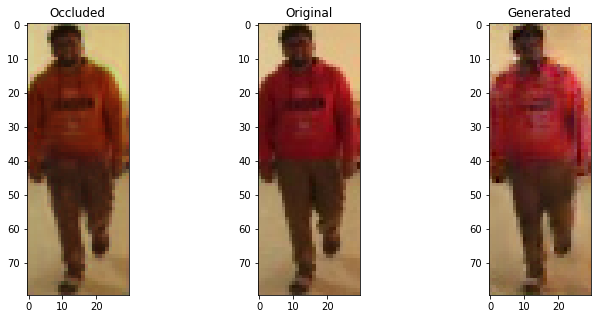

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


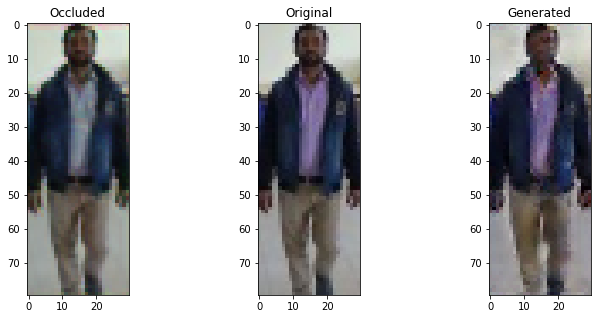

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


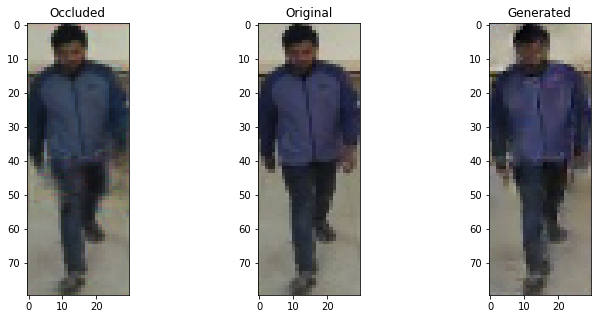

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


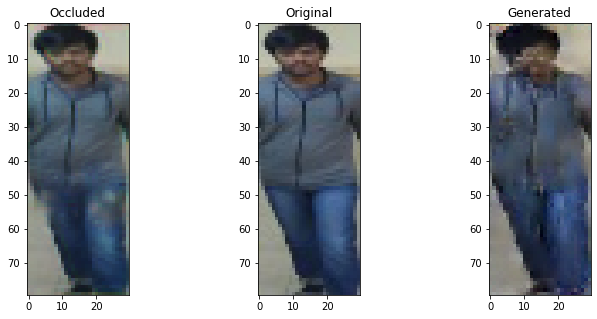

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6590366363525391 , Adversarial Loss:  0.0005941829876974225
Epoch 1582


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.651329755783081 , Adversarial Loss:  0.0005660572787746787
Epoch 1583


  8%|▊         | 1/13 [00:00<00:01,  6.57it/s]

Discriminator Loss:  0.6545207500457764 , Adversarial Loss:  0.0006651170551776886
Epoch 1584


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6578722596168518 , Adversarial Loss:  0.0006129681714810431
Epoch 1585


  8%|▊         | 1/13 [00:00<00:01,  6.56it/s]

Discriminator Loss:  0.6789615154266357 , Adversarial Loss:  0.0005531094502657652
Epoch 1586


  8%|▊         | 1/13 [00:00<00:02,  5.27it/s]

Discriminator Loss:  0.6658304929733276 , Adversarial Loss:  0.000561217893846333
Epoch 1587


  8%|▊         | 1/13 [00:00<00:01,  6.32it/s]

Discriminator Loss:  0.6552953124046326 , Adversarial Loss:  0.0006304571288637817
Epoch 1588


  8%|▊         | 1/13 [00:00<00:02,  5.20it/s]

Discriminator Loss:  0.6734524965286255 , Adversarial Loss:  0.0006622871151193976
Epoch 1589


  8%|▊         | 1/13 [00:00<00:01,  6.39it/s]

Discriminator Loss:  0.6659598350524902 , Adversarial Loss:  0.000578734849113971
Epoch 1590


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6603744626045227 , Adversarial Loss:  0.0006058141589164734
Epoch 1591


  8%|▊         | 1/13 [00:00<00:01,  6.73it/s]

Discriminator Loss:  0.6288484334945679 , Adversarial Loss:  0.0005744785303249955
Epoch 1592


  8%|▊         | 1/13 [00:00<00:01,  6.81it/s]

Discriminator Loss:  0.667587399482727 , Adversarial Loss:  0.0006124678766354918
Epoch 1593


  8%|▊         | 1/13 [00:00<00:01,  6.71it/s]

Discriminator Loss:  0.6506934762001038 , Adversarial Loss:  0.0006192272412590683
Epoch 1594


  8%|▊         | 1/13 [00:00<00:02,  5.93it/s]

Discriminator Loss:  0.6413381695747375 , Adversarial Loss:  0.0006410692585632205
Epoch 1595


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6819331645965576 , Adversarial Loss:  0.0005568276392295957
Epoch 1596


  8%|▊         | 1/13 [00:00<00:01,  6.25it/s]

Discriminator Loss:  0.675043523311615 , Adversarial Loss:  0.000605364388320595
Epoch 1597


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6714158058166504 , Adversarial Loss:  0.000554679601918906
Epoch 1598


  8%|▊         | 1/13 [00:00<00:02,  5.97it/s]

Discriminator Loss:  0.6726351380348206 , Adversarial Loss:  0.000567298848181963
Epoch 1599


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6542799472808838 , Adversarial Loss:  0.0005729565164074302
Epoch 1600


  8%|▊         | 1/13 [00:00<00:01,  6.76it/s]

Discriminator Loss:  0.6878418922424316 , Adversarial Loss:  0.0005877185030840337
Epoch 1601


100%|██████████| 13/13 [00:02<00:00,  5.35it/s]


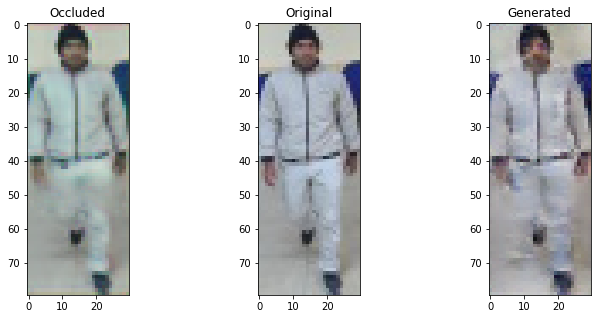

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


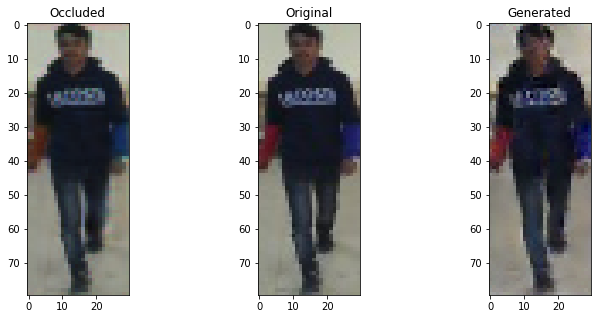

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


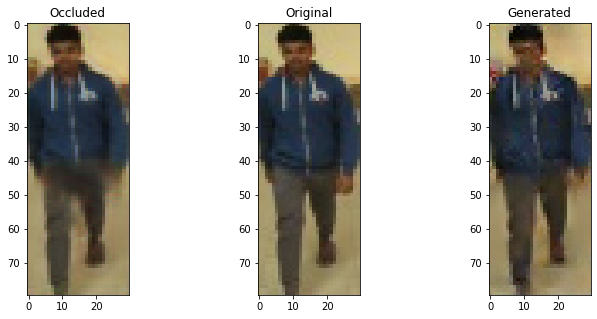

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


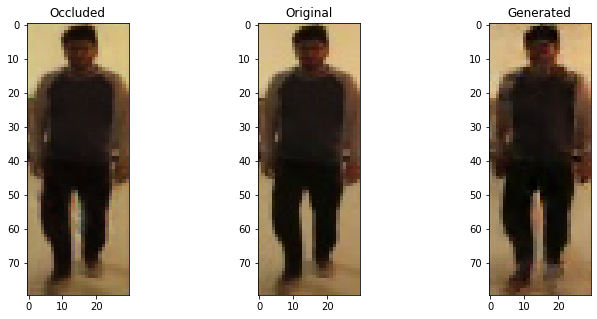

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


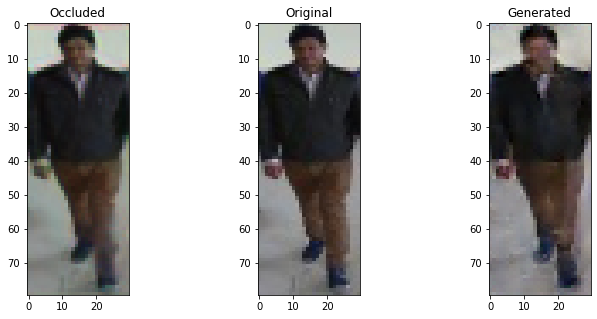

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6539677977561951 , Adversarial Loss:  0.0005882345139980316
Epoch 1602


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6781062483787537 , Adversarial Loss:  0.0006065628258511424
Epoch 1603


  8%|▊         | 1/13 [00:00<00:02,  5.92it/s]

Discriminator Loss:  0.6639659404754639 , Adversarial Loss:  0.0005949021433480084
Epoch 1604


  8%|▊         | 1/13 [00:00<00:01,  6.87it/s]

Discriminator Loss:  0.6686787605285645 , Adversarial Loss:  0.0005567075568251312
Epoch 1605


  8%|▊         | 1/13 [00:00<00:01,  6.09it/s]

Discriminator Loss:  0.6329889297485352 , Adversarial Loss:  0.0005325537640601397
Epoch 1606


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6631385087966919 , Adversarial Loss:  0.0005285918014124036
Epoch 1607


  8%|▊         | 1/13 [00:00<00:01,  6.30it/s]

Discriminator Loss:  0.6552997827529907 , Adversarial Loss:  0.0005382780800573528
Epoch 1608


  8%|▊         | 1/13 [00:00<00:01,  6.26it/s]

Discriminator Loss:  0.6602652668952942 , Adversarial Loss:  0.0005900530377402902
Epoch 1609


  8%|▊         | 1/13 [00:00<00:01,  6.71it/s]

Discriminator Loss:  0.6583495140075684 , Adversarial Loss:  0.000630709808319807
Epoch 1610


  8%|▊         | 1/13 [00:00<00:01,  6.06it/s]

Discriminator Loss:  0.6645639538764954 , Adversarial Loss:  0.0005712875281460583
Epoch 1611


  8%|▊         | 1/13 [00:00<00:01,  6.64it/s]

Discriminator Loss:  0.6691465377807617 , Adversarial Loss:  0.0006079908926039934
Epoch 1612


  8%|▊         | 1/13 [00:00<00:01,  6.09it/s]

Discriminator Loss:  0.6591823101043701 , Adversarial Loss:  0.0005434155464172363
Epoch 1613


  8%|▊         | 1/13 [00:00<00:01,  6.81it/s]

Discriminator Loss:  0.641884446144104 , Adversarial Loss:  0.0006140346522442997
Epoch 1614


  8%|▊         | 1/13 [00:00<00:01,  6.52it/s]

Discriminator Loss:  0.6573317050933838 , Adversarial Loss:  0.0005288450047373772
Epoch 1615


  8%|▊         | 1/13 [00:00<00:02,  5.64it/s]

Discriminator Loss:  0.6570451259613037 , Adversarial Loss:  0.0005315693560987711
Epoch 1616


  8%|▊         | 1/13 [00:00<00:01,  6.78it/s]

Discriminator Loss:  0.647355854511261 , Adversarial Loss:  0.0005637806607410312
Epoch 1617


  8%|▊         | 1/13 [00:00<00:01,  6.82it/s]

Discriminator Loss:  0.6563974022865295 , Adversarial Loss:  0.0005865329876542091
Epoch 1618


  8%|▊         | 1/13 [00:00<00:01,  6.63it/s]

Discriminator Loss:  0.6423715353012085 , Adversarial Loss:  0.0005495129153132439
Epoch 1619


  8%|▊         | 1/13 [00:00<00:01,  6.47it/s]

Discriminator Loss:  0.6691885590553284 , Adversarial Loss:  0.0005764542147517204
Epoch 1620


  8%|▊         | 1/13 [00:00<00:02,  5.20it/s]

Discriminator Loss:  0.6716976165771484 , Adversarial Loss:  0.0005426587304100394
Epoch 1621


100%|██████████| 13/13 [00:02<00:00,  6.15it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


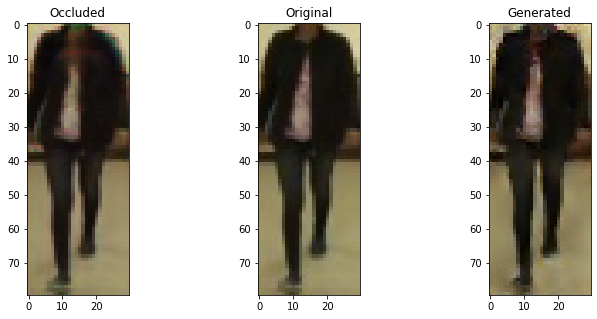

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


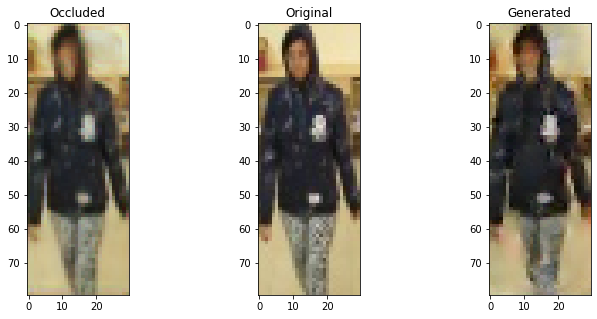

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


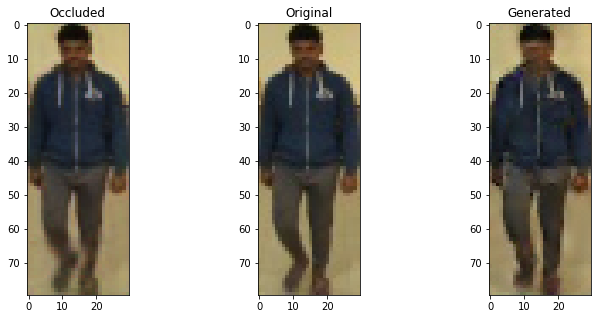

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


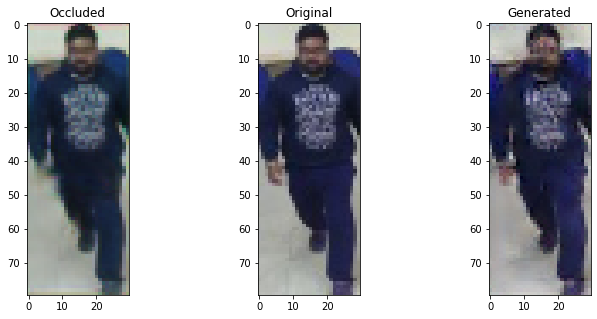

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


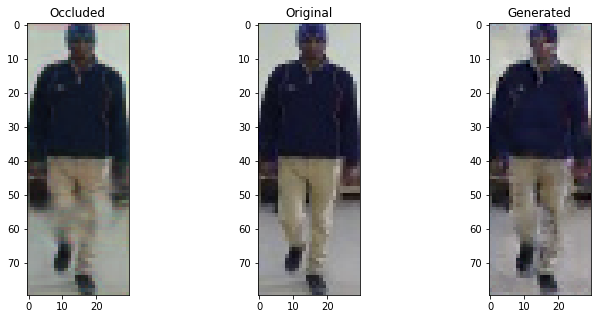

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6683568358421326 , Adversarial Loss:  0.000601582636591047
Epoch 1622


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6670820713043213 , Adversarial Loss:  0.000537293148227036
Epoch 1623


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6914528608322144 , Adversarial Loss:  0.0005574164679273963
Epoch 1624


  8%|▊         | 1/13 [00:00<00:01,  6.53it/s]

Discriminator Loss:  0.651971697807312 , Adversarial Loss:  0.0006050533265806735
Epoch 1625


  8%|▊         | 1/13 [00:00<00:01,  6.49it/s]

Discriminator Loss:  0.6564561724662781 , Adversarial Loss:  0.0005246555665507913
Epoch 1626


  8%|▊         | 1/13 [00:00<00:01,  6.41it/s]

Discriminator Loss:  0.6442767977714539 , Adversarial Loss:  0.0006010077195242047
Epoch 1627


  8%|▊         | 1/13 [00:00<00:01,  6.37it/s]

Discriminator Loss:  0.6348074674606323 , Adversarial Loss:  0.0005158871063031256
Epoch 1628


  8%|▊         | 1/13 [00:00<00:01,  6.03it/s]

Discriminator Loss:  0.6591461300849915 , Adversarial Loss:  0.0005246861255727708
Epoch 1629


  8%|▊         | 1/13 [00:00<00:01,  6.51it/s]

Discriminator Loss:  0.6646562814712524 , Adversarial Loss:  0.0005503131542354822
Epoch 1630


  8%|▊         | 1/13 [00:00<00:01,  6.52it/s]

Discriminator Loss:  0.6581474542617798 , Adversarial Loss:  0.0005621081218123436
Epoch 1631


  8%|▊         | 1/13 [00:00<00:02,  5.56it/s]

Discriminator Loss:  0.6777849197387695 , Adversarial Loss:  0.0005342543590813875
Epoch 1632


  8%|▊         | 1/13 [00:00<00:01,  6.29it/s]

Discriminator Loss:  0.660311222076416 , Adversarial Loss:  0.000490291160531342
Epoch 1633


  8%|▊         | 1/13 [00:00<00:01,  6.87it/s]

Discriminator Loss:  0.6543784141540527 , Adversarial Loss:  0.000550893135368824
Epoch 1634


  8%|▊         | 1/13 [00:00<00:01,  6.88it/s]

Discriminator Loss:  0.6457251906394958 , Adversarial Loss:  0.0005821730592288077
Epoch 1635


  8%|▊         | 1/13 [00:00<00:01,  6.31it/s]

Discriminator Loss:  0.6680327653884888 , Adversarial Loss:  0.0005172163946554065
Epoch 1636


  8%|▊         | 1/13 [00:00<00:01,  6.47it/s]

Discriminator Loss:  0.6815179586410522 , Adversarial Loss:  0.0005397354834713042
Epoch 1637


  8%|▊         | 1/13 [00:00<00:01,  6.42it/s]

Discriminator Loss:  0.647059977054596 , Adversarial Loss:  0.0005778658087365329
Epoch 1638


  8%|▊         | 1/13 [00:00<00:01,  7.11it/s]

Discriminator Loss:  0.6652789115905762 , Adversarial Loss:  0.0005728785181418061
Epoch 1639


  8%|▊         | 1/13 [00:00<00:01,  6.34it/s]

Discriminator Loss:  0.6685574054718018 , Adversarial Loss:  0.0005463402485474944
Epoch 1640


  8%|▊         | 1/13 [00:00<00:01,  6.68it/s]

Discriminator Loss:  0.6561846733093262 , Adversarial Loss:  0.0005576594267040491
Epoch 1641


100%|██████████| 13/13 [00:02<00:00,  6.09it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


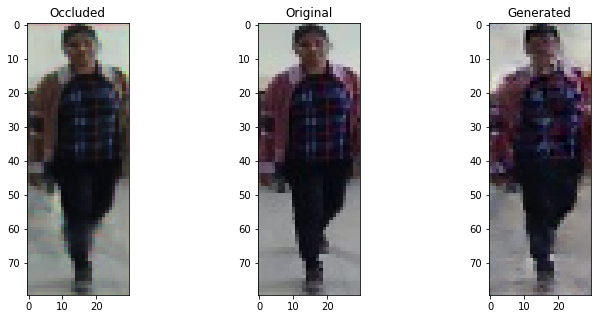

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


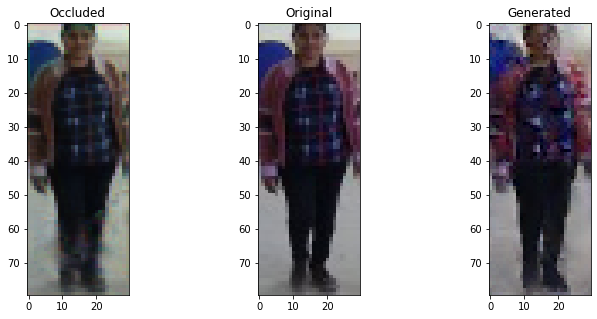

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


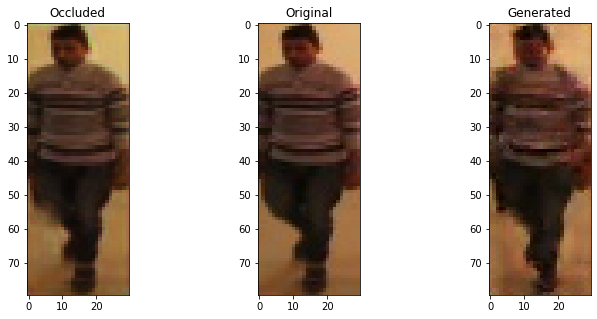

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


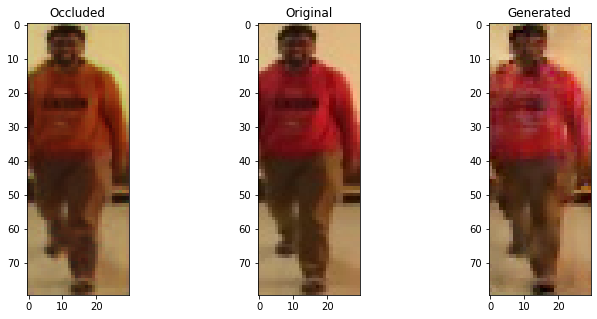

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


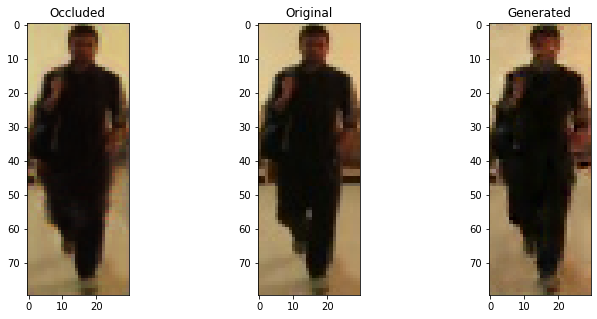

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6793086528778076 , Adversarial Loss:  0.0005461724940687418
Epoch 1642


  8%|▊         | 1/13 [00:00<00:02,  5.28it/s]

Discriminator Loss:  0.6517511606216431 , Adversarial Loss:  0.0005739154294133186
Epoch 1643


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6311532258987427 , Adversarial Loss:  0.0004835854342672974
Epoch 1644


  8%|▊         | 1/13 [00:00<00:01,  6.52it/s]

Discriminator Loss:  0.6557707190513611 , Adversarial Loss:  0.0004962797975167632
Epoch 1645


  8%|▊         | 1/13 [00:00<00:01,  6.82it/s]

Discriminator Loss:  0.6388962268829346 , Adversarial Loss:  0.0005351178115233779
Epoch 1646


  8%|▊         | 1/13 [00:00<00:01,  6.22it/s]

Discriminator Loss:  0.6959951519966125 , Adversarial Loss:  0.0004976276541128755
Epoch 1647


  8%|▊         | 1/13 [00:00<00:01,  6.61it/s]

Discriminator Loss:  0.6664245128631592 , Adversarial Loss:  0.0005663458141498268
Epoch 1648


  8%|▊         | 1/13 [00:00<00:02,  5.66it/s]

Discriminator Loss:  0.6505289077758789 , Adversarial Loss:  0.0004978437209501863
Epoch 1649


  8%|▊         | 1/13 [00:00<00:01,  6.68it/s]

Discriminator Loss:  0.6555270552635193 , Adversarial Loss:  0.0005469666793942451
Epoch 1650


  8%|▊         | 1/13 [00:00<00:01,  6.32it/s]

Discriminator Loss:  0.6889593601226807 , Adversarial Loss:  0.0005275984294712543
Epoch 1651


  8%|▊         | 1/13 [00:00<00:02,  5.65it/s]

Discriminator Loss:  0.665626585483551 , Adversarial Loss:  0.0006210768478922546
Epoch 1652


  8%|▊         | 1/13 [00:00<00:01,  6.12it/s]

Discriminator Loss:  0.6399634480476379 , Adversarial Loss:  0.0005030200118198991
Epoch 1653


  8%|▊         | 1/13 [00:00<00:01,  6.27it/s]

Discriminator Loss:  0.650104284286499 , Adversarial Loss:  0.0005321200005710125
Epoch 1654


  8%|▊         | 1/13 [00:00<00:01,  6.53it/s]

Discriminator Loss:  0.6566097736358643 , Adversarial Loss:  0.0005492321797646582
Epoch 1655


  8%|▊         | 1/13 [00:00<00:01,  6.41it/s]

Discriminator Loss:  0.6562068462371826 , Adversarial Loss:  0.0004962892853654921
Epoch 1656


  8%|▊         | 1/13 [00:00<00:02,  5.52it/s]

Discriminator Loss:  0.6613543033599854 , Adversarial Loss:  0.0005148255149833858
Epoch 1657


  8%|▊         | 1/13 [00:00<00:01,  6.78it/s]

Discriminator Loss:  0.6919328570365906 , Adversarial Loss:  0.0005344973178580403
Epoch 1658


  8%|▊         | 1/13 [00:00<00:01,  6.18it/s]

Discriminator Loss:  0.6439540386199951 , Adversarial Loss:  0.0005921758711338043
Epoch 1659


  8%|▊         | 1/13 [00:00<00:01,  6.11it/s]

Discriminator Loss:  0.6621098518371582 , Adversarial Loss:  0.0005816573975607753
Epoch 1660


  8%|▊         | 1/13 [00:00<00:01,  6.68it/s]

Discriminator Loss:  0.6632263660430908 , Adversarial Loss:  0.0005410389276221395
Epoch 1661


100%|██████████| 13/13 [00:02<00:00,  6.25it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


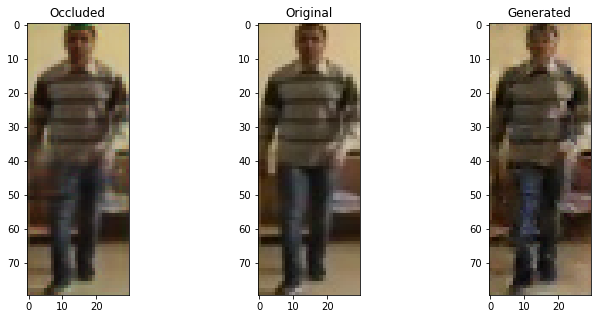

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


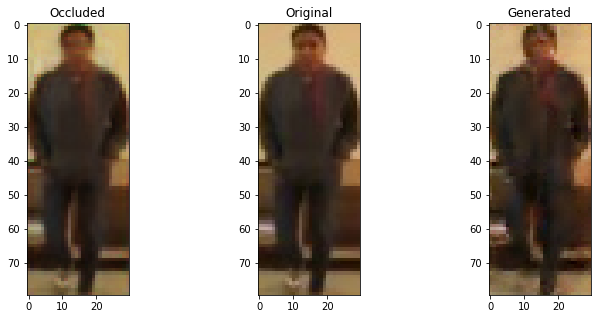

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


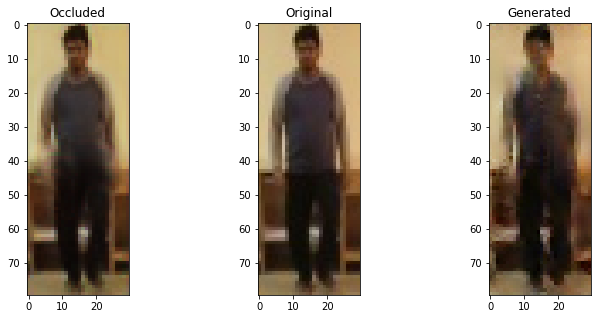

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


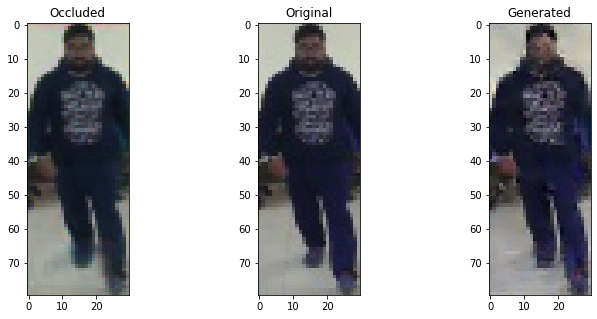

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


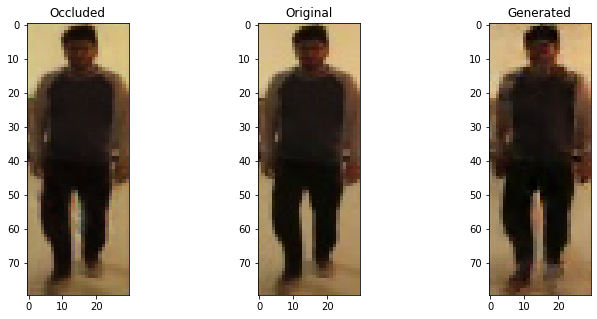

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6612027883529663 , Adversarial Loss:  0.0005606869817711413
Epoch 1662


  8%|▊         | 1/13 [00:00<00:01,  6.70it/s]

Discriminator Loss:  0.660731315612793 , Adversarial Loss:  0.0005004670238122344
Epoch 1663


  8%|▊         | 1/13 [00:00<00:01,  6.78it/s]

Discriminator Loss:  0.676842212677002 , Adversarial Loss:  0.0005139175918884575
Epoch 1664


  8%|▊         | 1/13 [00:00<00:01,  6.50it/s]

Discriminator Loss:  0.6269885301589966 , Adversarial Loss:  0.00047973968321457505
Epoch 1665


  8%|▊         | 1/13 [00:00<00:01,  6.34it/s]

Discriminator Loss:  0.6399266719818115 , Adversarial Loss:  0.0005397461936809123
Epoch 1666


  8%|▊         | 1/13 [00:00<00:01,  6.67it/s]

Discriminator Loss:  0.6658235788345337 , Adversarial Loss:  0.0005638258298859
Epoch 1667


  8%|▊         | 1/13 [00:00<00:01,  6.80it/s]

Discriminator Loss:  0.6468479633331299 , Adversarial Loss:  0.0005388518329709768
Epoch 1668


  8%|▊         | 1/13 [00:00<00:01,  6.27it/s]

Discriminator Loss:  0.6710360050201416 , Adversarial Loss:  0.00047200845438055694
Epoch 1669


  8%|▊         | 1/13 [00:00<00:02,  5.20it/s]

Discriminator Loss:  0.6502348780632019 , Adversarial Loss:  0.0004991083987988532
Epoch 1670


  8%|▊         | 1/13 [00:00<00:01,  6.60it/s]

Discriminator Loss:  0.670063853263855 , Adversarial Loss:  0.0005259430035948753
Epoch 1671


  8%|▊         | 1/13 [00:00<00:01,  6.85it/s]

Discriminator Loss:  0.6404191255569458 , Adversarial Loss:  0.0005363798700273037
Epoch 1672


  8%|▊         | 1/13 [00:00<00:01,  6.49it/s]

Discriminator Loss:  0.6621024012565613 , Adversarial Loss:  0.0004781183961313218
Epoch 1673


  8%|▊         | 1/13 [00:00<00:01,  6.56it/s]

Discriminator Loss:  0.6522170305252075 , Adversarial Loss:  0.0005293120630085468
Epoch 1674


  8%|▊         | 1/13 [00:00<00:02,  5.20it/s]

Discriminator Loss:  0.6436431407928467 , Adversarial Loss:  0.0005851570167578757
Epoch 1675


  8%|▊         | 1/13 [00:00<00:01,  6.18it/s]

Discriminator Loss:  0.6443701386451721 , Adversarial Loss:  0.0005347122205421329
Epoch 1676


  8%|▊         | 1/13 [00:00<00:01,  6.67it/s]

Discriminator Loss:  0.6523259878158569 , Adversarial Loss:  0.0005389562575146556
Epoch 1677


  8%|▊         | 1/13 [00:00<00:01,  6.30it/s]

Discriminator Loss:  0.6555601358413696 , Adversarial Loss:  0.0005038176896050572
Epoch 1678


  8%|▊         | 1/13 [00:00<00:01,  6.36it/s]

Discriminator Loss:  0.6517857313156128 , Adversarial Loss:  0.0005601149750873446
Epoch 1679


  8%|▊         | 1/13 [00:00<00:01,  6.76it/s]

Discriminator Loss:  0.6830316781997681 , Adversarial Loss:  0.0006059674196876585
Epoch 1680


  8%|▊         | 1/13 [00:00<00:02,  5.96it/s]

Discriminator Loss:  0.6416488885879517 , Adversarial Loss:  0.0004925565444864333
Epoch 1681


100%|██████████| 13/13 [00:02<00:00,  5.96it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


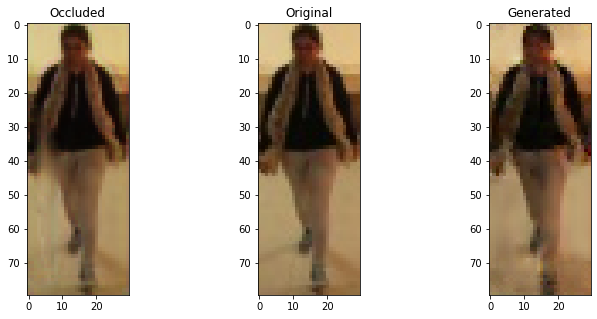

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


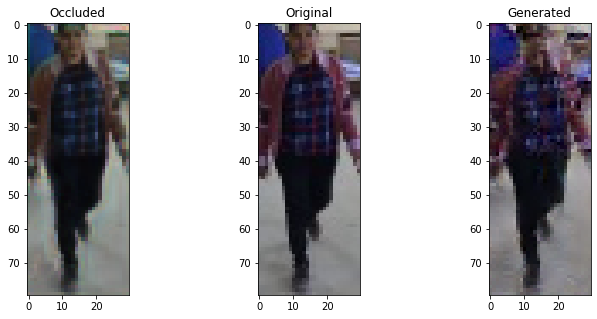

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


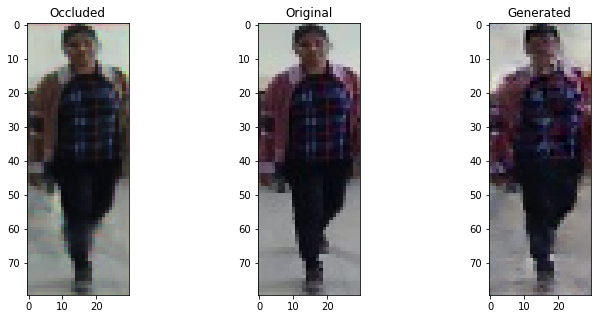

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


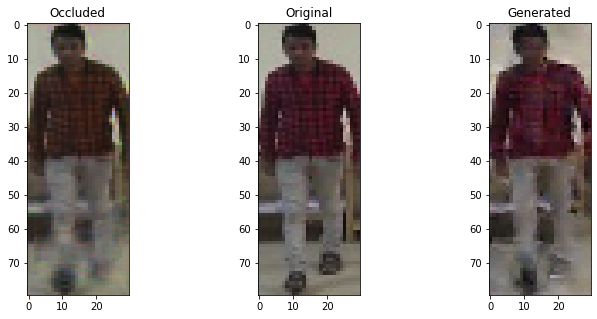

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


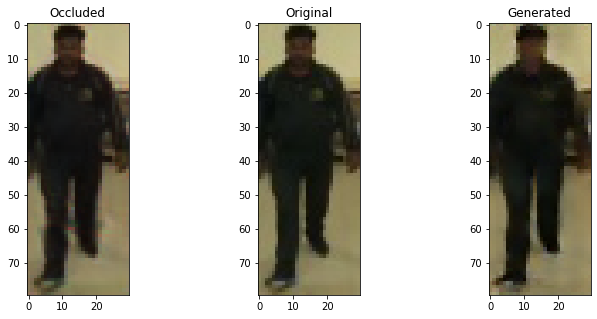

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.634471595287323 , Adversarial Loss:  0.000542800291441381
Epoch 1682


  8%|▊         | 1/13 [00:00<00:01,  6.67it/s]

Discriminator Loss:  0.6604195833206177 , Adversarial Loss:  0.0005029818275943398
Epoch 1683


  8%|▊         | 1/13 [00:00<00:01,  6.74it/s]

Discriminator Loss:  0.66141676902771 , Adversarial Loss:  0.0005360001232475042
Epoch 1684


  8%|▊         | 1/13 [00:00<00:01,  6.79it/s]

Discriminator Loss:  0.6614141464233398 , Adversarial Loss:  0.0005285794613882899
Epoch 1685


  8%|▊         | 1/13 [00:00<00:01,  6.36it/s]

Discriminator Loss:  0.6416885256767273 , Adversarial Loss:  0.000512816128320992
Epoch 1686


  8%|▊         | 1/13 [00:00<00:01,  6.82it/s]

Discriminator Loss:  0.6603423953056335 , Adversarial Loss:  0.0004936850164085627
Epoch 1687


  8%|▊         | 1/13 [00:00<00:01,  6.81it/s]

Discriminator Loss:  0.6367051601409912 , Adversarial Loss:  0.0005465284921228886
Epoch 1688


  8%|▊         | 1/13 [00:00<00:02,  5.96it/s]

Discriminator Loss:  0.6536195874214172 , Adversarial Loss:  0.00048666915972717106
Epoch 1689


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6579802632331848 , Adversarial Loss:  0.0005366228288039565
Epoch 1690


  8%|▊         | 1/13 [00:00<00:01,  6.32it/s]

Discriminator Loss:  0.6850842237472534 , Adversarial Loss:  0.0004927692352794111
Epoch 1691


  8%|▊         | 1/13 [00:00<00:02,  5.38it/s]

Discriminator Loss:  0.6794838905334473 , Adversarial Loss:  0.0005668712547048926
Epoch 1692


  8%|▊         | 1/13 [00:00<00:01,  6.64it/s]

Discriminator Loss:  0.651108980178833 , Adversarial Loss:  0.0006086558569222689
Epoch 1693


  8%|▊         | 1/13 [00:00<00:01,  6.56it/s]

Discriminator Loss:  0.6572290658950806 , Adversarial Loss:  0.0005506848101504147
Epoch 1694


  8%|▊         | 1/13 [00:00<00:01,  6.52it/s]

Discriminator Loss:  0.6580989360809326 , Adversarial Loss:  0.0004956228076480329
Epoch 1695


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6747450828552246 , Adversarial Loss:  0.0005335892783477902
Epoch 1696


  8%|▊         | 1/13 [00:00<00:01,  6.18it/s]

Discriminator Loss:  0.6789293885231018 , Adversarial Loss:  0.0005412144819274545
Epoch 1697


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6459290981292725 , Adversarial Loss:  0.0005083324504084885
Epoch 1698


  8%|▊         | 1/13 [00:00<00:01,  6.49it/s]

Discriminator Loss:  0.6642228960990906 , Adversarial Loss:  0.0005411793827079237
Epoch 1699


  8%|▊         | 1/13 [00:00<00:01,  6.68it/s]

Discriminator Loss:  0.6569714546203613 , Adversarial Loss:  0.0005705107469111681
Epoch 1700


  8%|▊         | 1/13 [00:00<00:02,  5.35it/s]

Discriminator Loss:  0.6587411165237427 , Adversarial Loss:  0.0004984018160030246
Epoch 1701


100%|██████████| 13/13 [00:02<00:00,  6.13it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


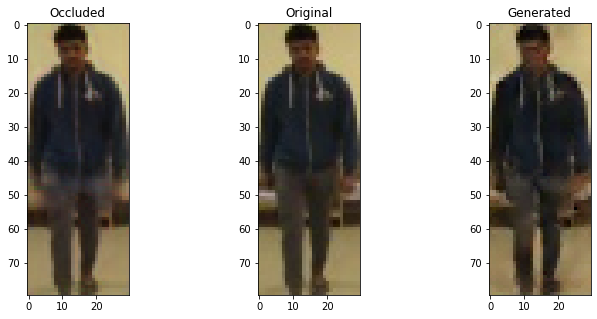

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


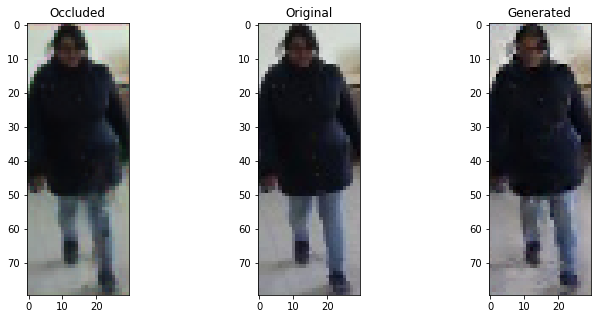

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


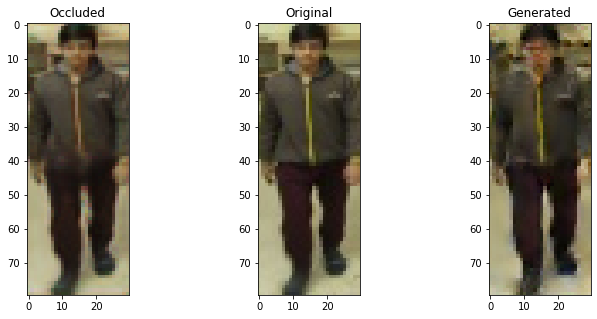

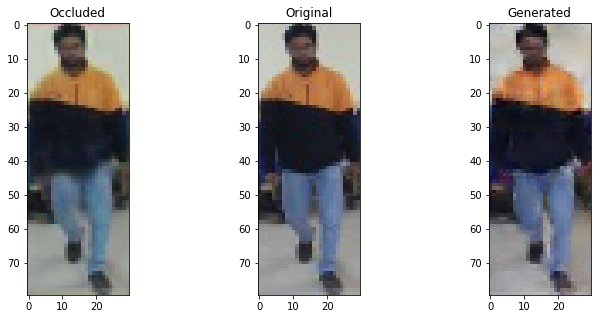

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


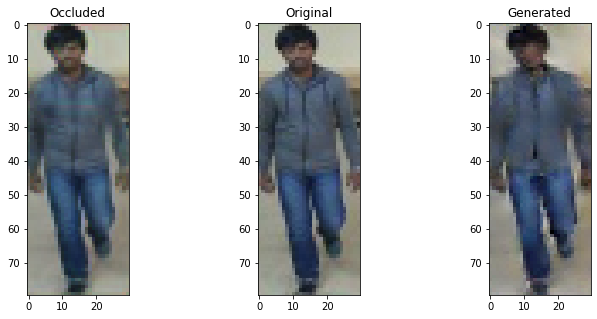

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6711550951004028 , Adversarial Loss:  0.0005580529686994851
Epoch 1702


  8%|▊         | 1/13 [00:00<00:01,  6.68it/s]

Discriminator Loss:  0.6461700797080994 , Adversarial Loss:  0.0005719964392483234
Epoch 1703


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6298065185546875 , Adversarial Loss:  0.0005293335998430848
Epoch 1704


  8%|▊         | 1/13 [00:00<00:02,  5.79it/s]

Discriminator Loss:  0.6701787114143372 , Adversarial Loss:  0.0004862587375100702
Epoch 1705


  8%|▊         | 1/13 [00:00<00:01,  6.60it/s]

Discriminator Loss:  0.6383174657821655 , Adversarial Loss:  0.0005370249273255467
Epoch 1706


  8%|▊         | 1/13 [00:00<00:01,  6.91it/s]

Discriminator Loss:  0.669034481048584 , Adversarial Loss:  0.0005138118285685778
Epoch 1707


  8%|▊         | 1/13 [00:00<00:01,  6.61it/s]

Discriminator Loss:  0.672461986541748 , Adversarial Loss:  0.0005298589239828289
Epoch 1708


  8%|▊         | 1/13 [00:00<00:02,  5.82it/s]

Discriminator Loss:  0.6528666019439697 , Adversarial Loss:  0.0005619391449727118
Epoch 1709


  8%|▊         | 1/13 [00:00<00:01,  6.48it/s]

Discriminator Loss:  0.6704219579696655 , Adversarial Loss:  0.0005334331654012203
Epoch 1710


  8%|▊         | 1/13 [00:00<00:01,  6.60it/s]

Discriminator Loss:  0.6606656312942505 , Adversarial Loss:  0.0005545483436435461
Epoch 1711


  8%|▊         | 1/13 [00:00<00:01,  6.19it/s]

Discriminator Loss:  0.6598286628723145 , Adversarial Loss:  0.000580347899813205
Epoch 1712


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6853399276733398 , Adversarial Loss:  0.0005420527886599302
Epoch 1713


  8%|▊         | 1/13 [00:00<00:01,  6.05it/s]

Discriminator Loss:  0.6728387475013733 , Adversarial Loss:  0.0005223208572715521
Epoch 1714


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6584690809249878 , Adversarial Loss:  0.000518418790306896
Epoch 1715


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6662334203720093 , Adversarial Loss:  0.0005468343151733279
Epoch 1716


  8%|▊         | 1/13 [00:00<00:01,  6.01it/s]

Discriminator Loss:  0.6420111656188965 , Adversarial Loss:  0.0004981736419722438
Epoch 1717


  8%|▊         | 1/13 [00:00<00:01,  6.47it/s]

Discriminator Loss:  0.6686585545539856 , Adversarial Loss:  0.0005392507882788777
Epoch 1718


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.654883623123169 , Adversarial Loss:  0.0004986741114407778
Epoch 1719


  8%|▊         | 1/13 [00:00<00:01,  6.05it/s]

Discriminator Loss:  0.6738675832748413 , Adversarial Loss:  0.0005422463291324675
Epoch 1720


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6412132978439331 , Adversarial Loss:  0.0004999650991521776
Epoch 1721


100%|██████████| 13/13 [00:02<00:00,  5.58it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


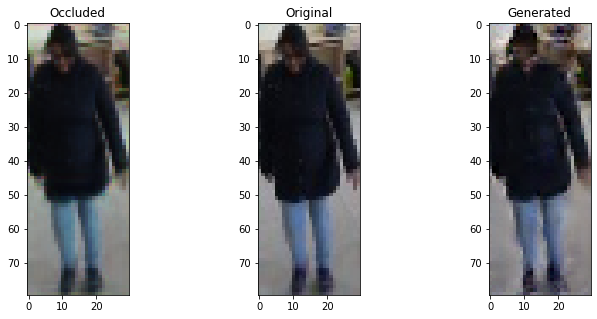

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


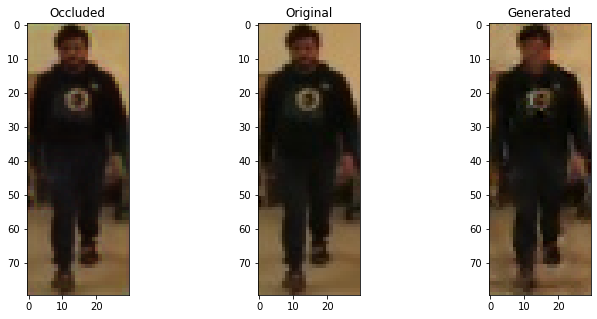

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


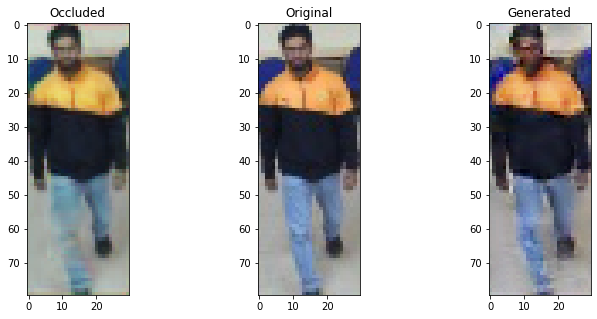

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


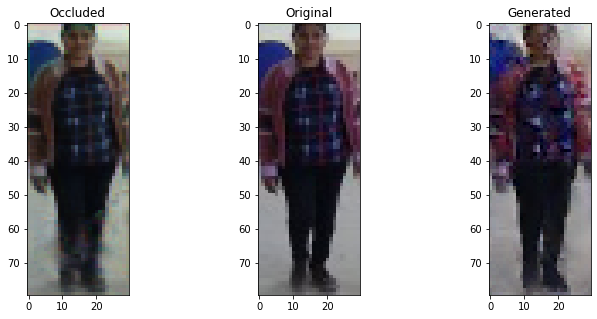

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


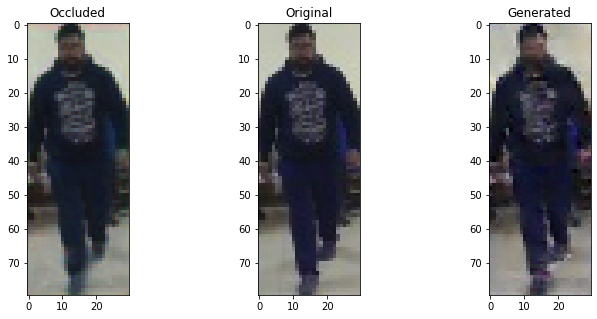

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6692737340927124 , Adversarial Loss:  0.0004971440648660064
Epoch 1722


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.656028151512146 , Adversarial Loss:  0.0005030898610129952
Epoch 1723


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6578394174575806 , Adversarial Loss:  0.0005286934319883585
Epoch 1724


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6755536198616028 , Adversarial Loss:  0.0004777169378940016
Epoch 1725


  8%|▊         | 1/13 [00:00<00:02,  5.40it/s]

Discriminator Loss:  0.6849207282066345 , Adversarial Loss:  0.0005173427052795887
Epoch 1726


  8%|▊         | 1/13 [00:00<00:01,  6.50it/s]

Discriminator Loss:  0.6722464561462402 , Adversarial Loss:  0.0005113856750540435
Epoch 1727


  8%|▊         | 1/13 [00:00<00:01,  6.47it/s]

Discriminator Loss:  0.6678668856620789 , Adversarial Loss:  0.0005498576210811734
Epoch 1728


  8%|▊         | 1/13 [00:00<00:01,  6.66it/s]

Discriminator Loss:  0.6691683530807495 , Adversarial Loss:  0.0005089807091280818
Epoch 1729


  8%|▊         | 1/13 [00:00<00:01,  6.65it/s]

Discriminator Loss:  0.6911972165107727 , Adversarial Loss:  0.0004851822159253061
Epoch 1730


  8%|▊         | 1/13 [00:00<00:01,  6.21it/s]

Discriminator Loss:  0.670905590057373 , Adversarial Loss:  0.0005063283606432378
Epoch 1731


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6553364992141724 , Adversarial Loss:  0.0004988888977095485
Epoch 1732


  8%|▊         | 1/13 [00:00<00:02,  5.98it/s]

Discriminator Loss:  0.671907365322113 , Adversarial Loss:  0.0006026961491443217
Epoch 1733


  8%|▊         | 1/13 [00:00<00:01,  6.61it/s]

Discriminator Loss:  0.6644182205200195 , Adversarial Loss:  0.0005128700286149979
Epoch 1734


  8%|▊         | 1/13 [00:00<00:01,  6.25it/s]

Discriminator Loss:  0.6477037072181702 , Adversarial Loss:  0.0005501738050952554
Epoch 1735


  8%|▊         | 1/13 [00:00<00:01,  6.26it/s]

Discriminator Loss:  0.6665946245193481 , Adversarial Loss:  0.0004972981405444443
Epoch 1736


  8%|▊         | 1/13 [00:00<00:01,  6.62it/s]

Discriminator Loss:  0.653956413269043 , Adversarial Loss:  0.0005367849953472614
Epoch 1737


  8%|▊         | 1/13 [00:00<00:01,  6.43it/s]

Discriminator Loss:  0.667261004447937 , Adversarial Loss:  0.0005568271153606474
Epoch 1738


  8%|▊         | 1/13 [00:00<00:02,  5.23it/s]

Discriminator Loss:  0.6435444355010986 , Adversarial Loss:  0.0005535439122468233
Epoch 1739


  8%|▊         | 1/13 [00:00<00:01,  6.64it/s]

Discriminator Loss:  0.6461291909217834 , Adversarial Loss:  0.0005600163713097572
Epoch 1740


  8%|▊         | 1/13 [00:00<00:01,  6.54it/s]

Discriminator Loss:  0.6490379571914673 , Adversarial Loss:  0.0005468277377076447
Epoch 1741


100%|██████████| 13/13 [00:02<00:00,  6.23it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


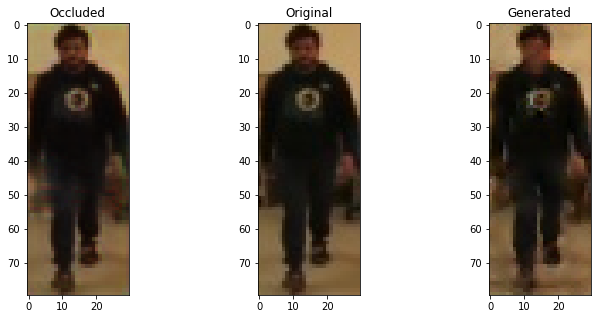

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


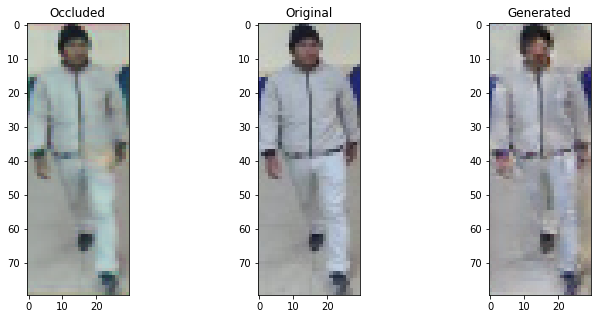

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


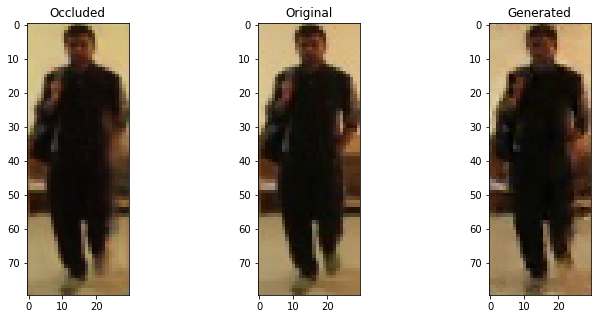

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


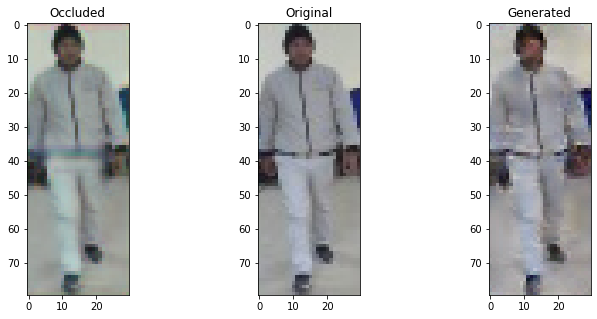

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


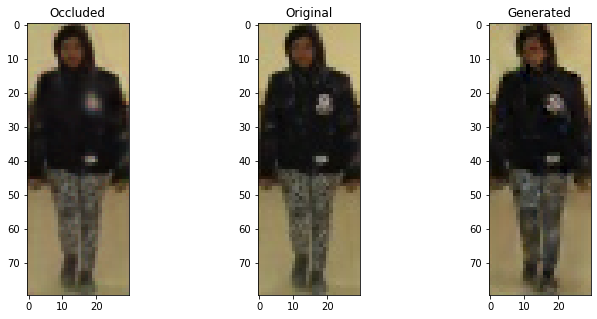

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6487863659858704 , Adversarial Loss:  0.0004747522179968655
Epoch 1742


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6772681474685669 , Adversarial Loss:  0.00047940900549292564
Epoch 1743


  8%|▊         | 1/13 [00:00<00:01,  6.44it/s]

Discriminator Loss:  0.6614359617233276 , Adversarial Loss:  0.0005459373351186514
Epoch 1744


  8%|▊         | 1/13 [00:00<00:01,  6.74it/s]

Discriminator Loss:  0.6712220311164856 , Adversarial Loss:  0.0004968763096258044
Epoch 1745


  8%|▊         | 1/13 [00:00<00:02,  5.63it/s]

Discriminator Loss:  0.6391699910163879 , Adversarial Loss:  0.0005117024411447346
Epoch 1746


  8%|▊         | 1/13 [00:00<00:01,  6.75it/s]

Discriminator Loss:  0.6485570669174194 , Adversarial Loss:  0.0004844301438424736
Epoch 1747


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6385811567306519 , Adversarial Loss:  0.0005301247583702207
Epoch 1748


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6458247900009155 , Adversarial Loss:  0.0005008615553379059
Epoch 1749


  8%|▊         | 1/13 [00:00<00:02,  5.87it/s]

Discriminator Loss:  0.6791201233863831 , Adversarial Loss:  0.0005644026678055525
Epoch 1750


  8%|▊         | 1/13 [00:00<00:01,  6.31it/s]

Discriminator Loss:  0.6788829565048218 , Adversarial Loss:  0.0005264997598715127
Epoch 1751


  8%|▊         | 1/13 [00:00<00:01,  6.45it/s]

Discriminator Loss:  0.6388687491416931 , Adversarial Loss:  0.0005138663691468537
Epoch 1752


  8%|▊         | 1/13 [00:00<00:01,  6.09it/s]

Discriminator Loss:  0.6685031652450562 , Adversarial Loss:  0.00046117970487102866
Epoch 1753


  8%|▊         | 1/13 [00:00<00:01,  6.41it/s]

Discriminator Loss:  0.6573567390441895 , Adversarial Loss:  0.0005221903556957841
Epoch 1754


  8%|▊         | 1/13 [00:00<00:01,  6.55it/s]

Discriminator Loss:  0.661228358745575 , Adversarial Loss:  0.0005265534273348749
Epoch 1755


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6281081438064575 , Adversarial Loss:  0.0005046326550655067
Epoch 1756


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6533392071723938 , Adversarial Loss:  0.0005903419805690646
Epoch 1757


  8%|▊         | 1/13 [00:00<00:01,  6.58it/s]

Discriminator Loss:  0.6519664525985718 , Adversarial Loss:  0.0005224284250289202
Epoch 1758


  8%|▊         | 1/13 [00:00<00:01,  6.51it/s]

Discriminator Loss:  0.670619010925293 , Adversarial Loss:  0.0005147129995748401
Epoch 1759


  8%|▊         | 1/13 [00:00<00:01,  6.35it/s]

Discriminator Loss:  0.6453832983970642 , Adversarial Loss:  0.0005632985848933458
Epoch 1760


  8%|▊         | 1/13 [00:00<00:01,  6.86it/s]

Discriminator Loss:  0.6618583798408508 , Adversarial Loss:  0.000546818133443594
Epoch 1761


100%|██████████| 13/13 [00:02<00:00,  6.08it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


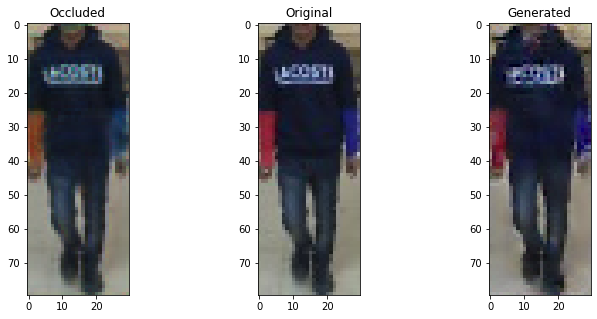

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


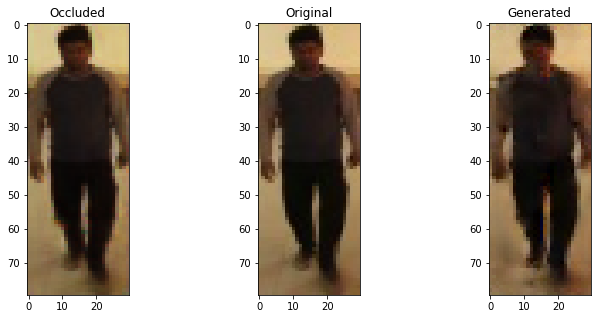

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


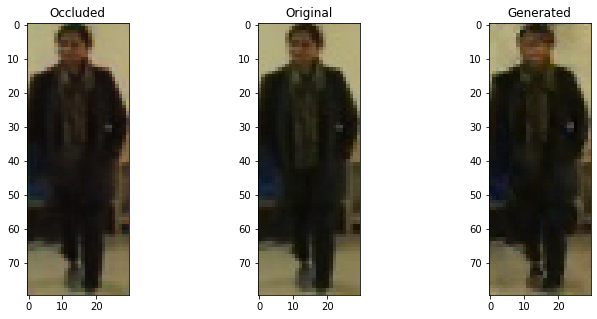

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


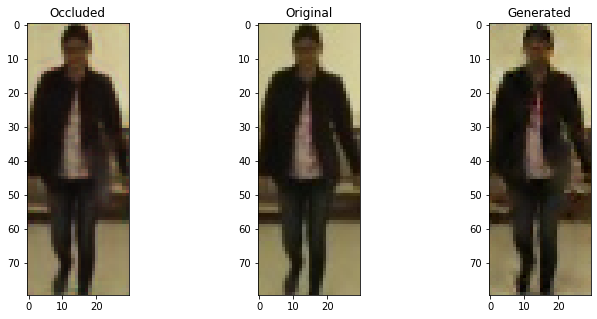

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


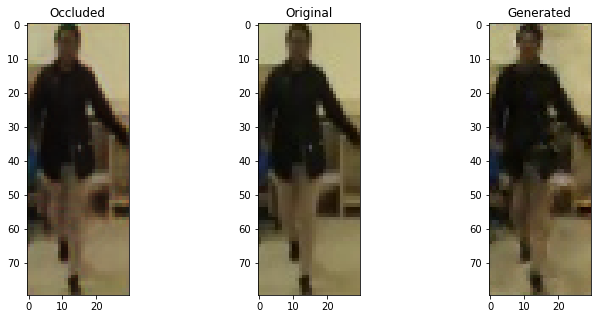

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6390179395675659 , Adversarial Loss:  0.000533966114744544
Epoch 1762


  8%|▊         | 1/13 [00:00<00:01,  6.38it/s]

Discriminator Loss:  0.6758410930633545 , Adversarial Loss:  0.0004996370407752693
Epoch 1763


  8%|▊         | 1/13 [00:00<00:01,  6.78it/s]

Discriminator Loss:  0.6606716513633728 , Adversarial Loss:  0.00047310045920312405
Epoch 1764


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6410449743270874 , Adversarial Loss:  0.0004837213782593608
Epoch 1765


  8%|▊         | 1/13 [00:00<00:01,  6.59it/s]

Discriminator Loss:  0.6563518047332764 , Adversarial Loss:  0.0004555981431622058
Epoch 1766


  8%|▊         | 1/13 [00:00<00:02,  5.22it/s]

Discriminator Loss:  0.6716338396072388 , Adversarial Loss:  0.0005407881108112633
Epoch 1767


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6764193773269653 , Adversarial Loss:  0.0005030925967730582
Epoch 1768


  8%|▊         | 1/13 [00:00<00:01,  6.42it/s]

Discriminator Loss:  0.6573085784912109 , Adversarial Loss:  0.0005402449169196188
Epoch 1769


  8%|▊         | 1/13 [00:00<00:01,  6.56it/s]

Discriminator Loss:  0.658605694770813 , Adversarial Loss:  0.0005162037559784949
Epoch 1770


  8%|▊         | 1/13 [00:00<00:01,  6.51it/s]

Discriminator Loss:  0.6565885543823242 , Adversarial Loss:  0.0004617517697624862
Epoch 1771


  8%|▊         | 1/13 [00:00<00:02,  5.62it/s]

Discriminator Loss:  0.646302342414856 , Adversarial Loss:  0.0005155936814844608
Epoch 1772


  8%|▊         | 1/13 [00:00<00:01,  6.64it/s]

Discriminator Loss:  0.6593868732452393 , Adversarial Loss:  0.0005152887897565961
Epoch 1773


  8%|▊         | 1/13 [00:00<00:01,  6.84it/s]

Discriminator Loss:  0.6496668457984924 , Adversarial Loss:  0.0005565901519730687
Epoch 1774


  8%|▊         | 1/13 [00:00<00:01,  6.61it/s]

Discriminator Loss:  0.6514145135879517 , Adversarial Loss:  0.0005893601337447762
Epoch 1775


  8%|▊         | 1/13 [00:00<00:01,  6.25it/s]

Discriminator Loss:  0.6534596085548401 , Adversarial Loss:  0.0005658285226672888
Epoch 1776


  8%|▊         | 1/13 [00:00<00:01,  6.70it/s]

Discriminator Loss:  0.6637287735939026 , Adversarial Loss:  0.00046381662832573056
Epoch 1777


  8%|▊         | 1/13 [00:00<00:02,  5.77it/s]

Discriminator Loss:  0.6675877571105957 , Adversarial Loss:  0.0005429032607935369
Epoch 1778


  8%|▊         | 1/13 [00:00<00:02,  6.00it/s]

Discriminator Loss:  0.6612367630004883 , Adversarial Loss:  0.0005504527944140136
Epoch 1779


  8%|▊         | 1/13 [00:00<00:01,  6.77it/s]

Discriminator Loss:  0.6536800265312195 , Adversarial Loss:  0.00048821669770404696
Epoch 1780


  8%|▊         | 1/13 [00:00<00:01,  6.16it/s]

Discriminator Loss:  0.6637274026870728 , Adversarial Loss:  0.0004818654269911349
Epoch 1781


100%|██████████| 13/13 [00:02<00:00,  6.01it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


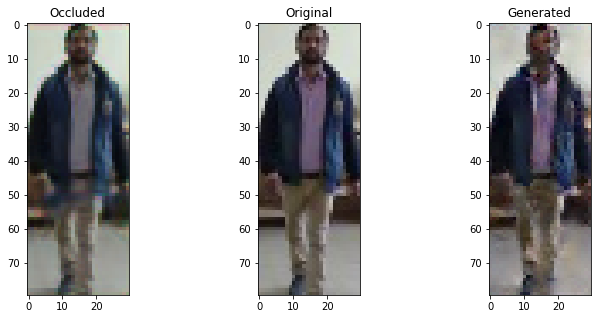

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


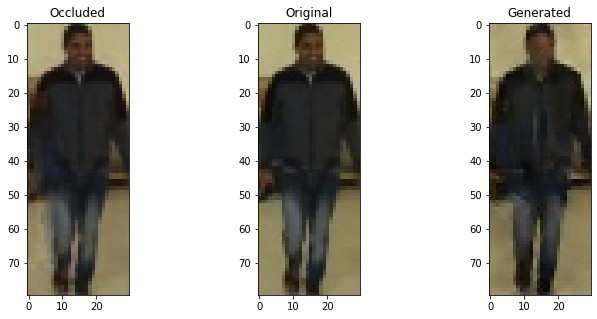

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


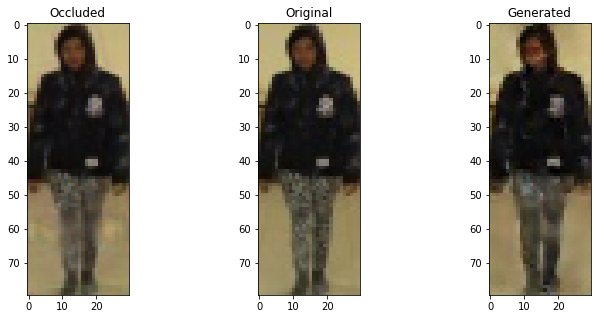

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


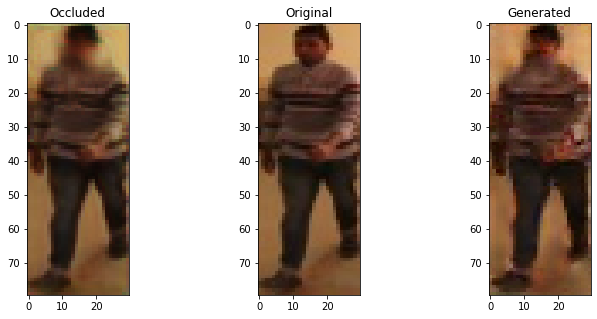

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


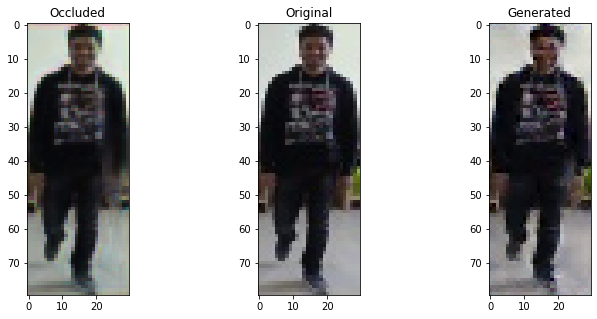

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6542706489562988 , Adversarial Loss:  0.0005212969845160842
Epoch 1782


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6412891149520874 , Adversarial Loss:  0.0005425139097496867
Epoch 1783


  8%|▊         | 1/13 [00:00<00:01,  6.42it/s]

Discriminator Loss:  0.6477208733558655 , Adversarial Loss:  0.0005178130813874304
Epoch 1784


  8%|▊         | 1/13 [00:00<00:01,  6.40it/s]

Discriminator Loss:  0.6808993816375732 , Adversarial Loss:  0.0004832028062082827
Epoch 1785


  8%|▊         | 1/13 [00:00<00:02,  5.36it/s]

Discriminator Loss:  0.6285758018493652 , Adversarial Loss:  0.0005008255830034614
Epoch 1786


  8%|▊         | 1/13 [00:00<00:01,  6.51it/s]

Discriminator Loss:  0.6634343862533569 , Adversarial Loss:  0.0004906055983155966
Epoch 1787


  8%|▊         | 1/13 [00:00<00:02,  5.64it/s]

Discriminator Loss:  0.6440901756286621 , Adversarial Loss:  0.0005154954269528389
Epoch 1788


  8%|▊         | 1/13 [00:00<00:01,  6.61it/s]

Discriminator Loss:  0.6657012701034546 , Adversarial Loss:  0.0005063808057457209
Epoch 1789


  8%|▊         | 1/13 [00:00<00:02,  5.80it/s]

Discriminator Loss:  0.6487258672714233 , Adversarial Loss:  0.0005150979850441217
Epoch 1790


  8%|▊         | 1/13 [00:00<00:01,  6.33it/s]

Discriminator Loss:  0.647993803024292 , Adversarial Loss:  0.000497304426971823
Epoch 1791


  8%|▊         | 1/13 [00:00<00:01,  6.61it/s]

Discriminator Loss:  0.6760521531105042 , Adversarial Loss:  0.0005532439099624753
Epoch 1792


  8%|▊         | 1/13 [00:00<00:01,  6.26it/s]

Discriminator Loss:  0.6442683935165405 , Adversarial Loss:  0.00041685436735861003
Epoch 1793


  8%|▊         | 1/13 [00:00<00:02,  5.19it/s]

Discriminator Loss:  0.6303480863571167 , Adversarial Loss:  0.0005062402924522758
Epoch 1794


  8%|▊         | 1/13 [00:00<00:01,  6.56it/s]

Discriminator Loss:  0.6481626033782959 , Adversarial Loss:  0.0005240937462076545
Epoch 1795


  8%|▊         | 1/13 [00:00<00:01,  6.17it/s]

Discriminator Loss:  0.6449352502822876 , Adversarial Loss:  0.0005091428174637258
Epoch 1796


  8%|▊         | 1/13 [00:00<00:01,  6.68it/s]

Discriminator Loss:  0.6606746912002563 , Adversarial Loss:  0.000495882413815707
Epoch 1797


  8%|▊         | 1/13 [00:00<00:01,  6.41it/s]

Discriminator Loss:  0.6584681272506714 , Adversarial Loss:  0.0005157763371244073
Epoch 1798


  8%|▊         | 1/13 [00:00<00:01,  6.30it/s]

Discriminator Loss:  0.6278117299079895 , Adversarial Loss:  0.0004914193414151669
Epoch 1799


  8%|▊         | 1/13 [00:00<00:02,  5.95it/s]

Discriminator Loss:  0.6503075361251831 , Adversarial Loss:  0.0004943264648318291
Epoch 1800


  8%|▊         | 1/13 [00:00<00:01,  6.36it/s]

Discriminator Loss:  0.6625051498413086 , Adversarial Loss:  0.0004725269100163132
Epoch 1801


100%|██████████| 13/13 [00:02<00:00,  5.83it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


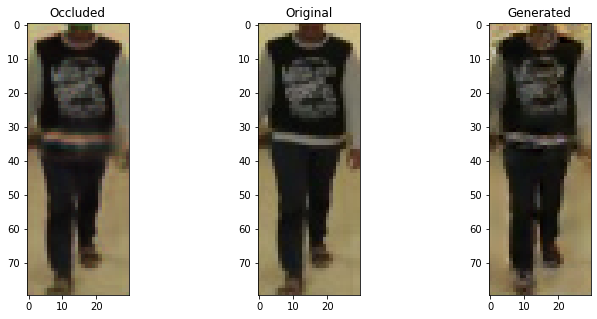

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


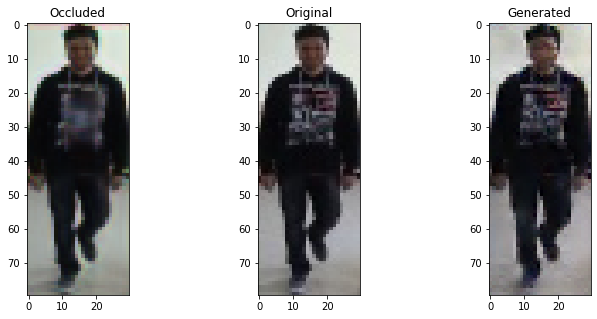

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


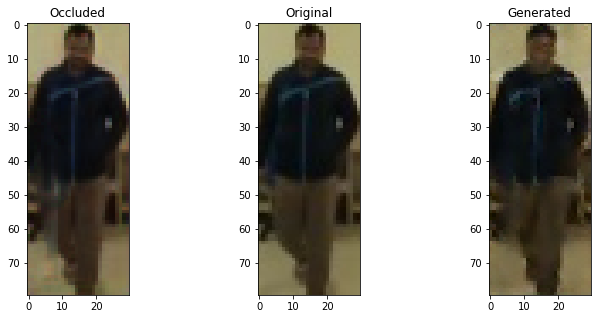

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


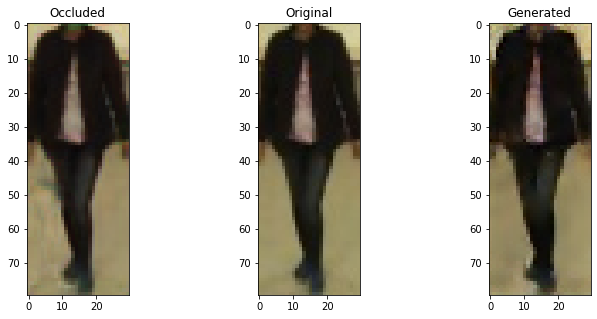

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


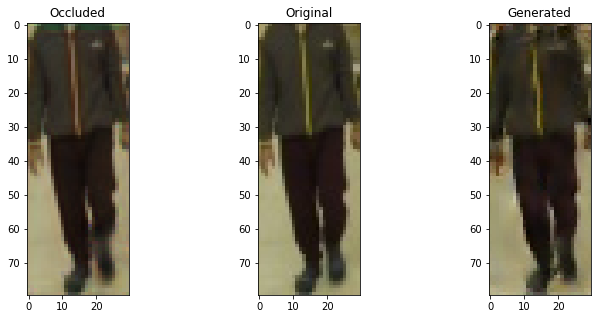

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6534343957901001 , Adversarial Loss:  0.0005352337611839175
Epoch 1802


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6681890487670898 , Adversarial Loss:  0.0005553733208216727
Epoch 1803


  8%|▊         | 1/13 [00:00<00:01,  6.13it/s]

Discriminator Loss:  0.6483269929885864 , Adversarial Loss:  0.000553147925529629
Epoch 1804


  8%|▊         | 1/13 [00:00<00:01,  6.14it/s]

Discriminator Loss:  0.6588390469551086 , Adversarial Loss:  0.0005063131684437394
Epoch 1805


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6818487644195557 , Adversarial Loss:  0.0004985767882317305
Epoch 1806


  8%|▊         | 1/13 [00:00<00:01,  6.14it/s]

Discriminator Loss:  0.6524553298950195 , Adversarial Loss:  0.0005216365680098534
Epoch 1807


  8%|▊         | 1/13 [00:00<00:02,  5.71it/s]

Discriminator Loss:  0.6603255271911621 , Adversarial Loss:  0.0005000558448955417
Epoch 1808


  8%|▊         | 1/13 [00:00<00:02,  5.58it/s]

Discriminator Loss:  0.6516497135162354 , Adversarial Loss:  0.0005661144386976957
Epoch 1809


  8%|▊         | 1/13 [00:00<00:01,  6.18it/s]

Discriminator Loss:  0.672682523727417 , Adversarial Loss:  0.0005260600009933114
Epoch 1810


  8%|▊         | 1/13 [00:00<00:02,  5.52it/s]

Discriminator Loss:  0.6679022312164307 , Adversarial Loss:  0.0005321452626958489
Epoch 1811


  8%|▊         | 1/13 [00:00<00:01,  6.33it/s]

Discriminator Loss:  0.6649800539016724 , Adversarial Loss:  0.00048669998068362474
Epoch 1812


  8%|▊         | 1/13 [00:00<00:02,  5.15it/s]

Discriminator Loss:  0.6717059016227722 , Adversarial Loss:  0.0005165367620065808
Epoch 1813


  8%|▊         | 1/13 [00:00<00:02,  5.89it/s]

Discriminator Loss:  0.6524693965911865 , Adversarial Loss:  0.0004952545859850943
Epoch 1814


  8%|▊         | 1/13 [00:00<00:01,  6.29it/s]

Discriminator Loss:  0.6563534140586853 , Adversarial Loss:  0.0004582376859616488
Epoch 1815


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6502761840820312 , Adversarial Loss:  0.0005145799368619919
Epoch 1816


  8%|▊         | 1/13 [00:00<00:01,  6.49it/s]

Discriminator Loss:  0.6635138392448425 , Adversarial Loss:  0.0004680084530264139
Epoch 1817


  8%|▊         | 1/13 [00:00<00:02,  5.96it/s]

Discriminator Loss:  0.6409355401992798 , Adversarial Loss:  0.0005235538119450212
Epoch 1818


  8%|▊         | 1/13 [00:00<00:02,  5.53it/s]

Discriminator Loss:  0.6478193998336792 , Adversarial Loss:  0.0005436460487544537
Epoch 1819


  8%|▊         | 1/13 [00:00<00:01,  6.00it/s]

Discriminator Loss:  0.6545233130455017 , Adversarial Loss:  0.0004581699031405151
Epoch 1820


  8%|▊         | 1/13 [00:00<00:01,  6.69it/s]

Discriminator Loss:  0.6405947804450989 , Adversarial Loss:  0.0005227819783613086
Epoch 1821


100%|██████████| 13/13 [00:02<00:00,  5.71it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


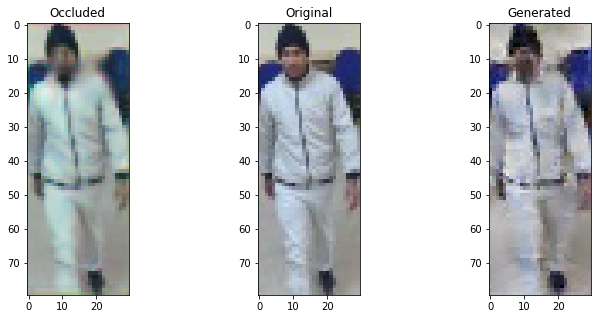

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


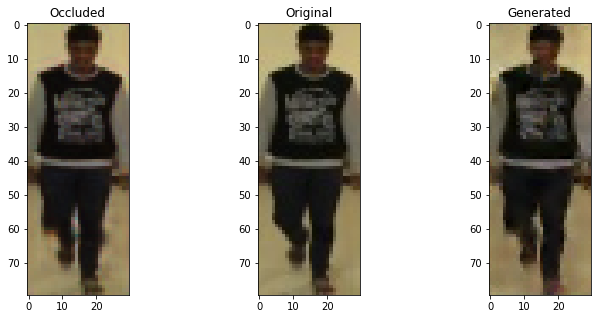

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


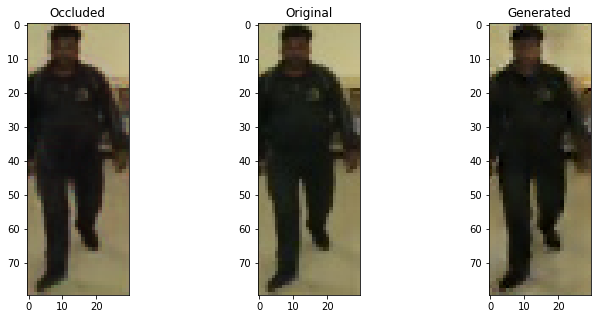

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


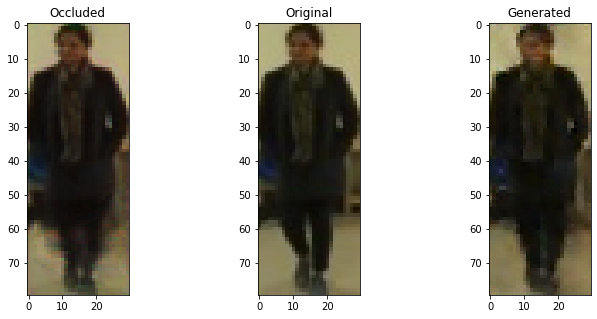

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


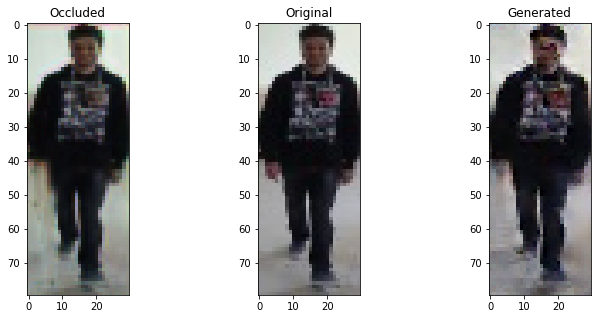

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6462749242782593 , Adversarial Loss:  0.0004941740771755576
Epoch 1822


  8%|▊         | 1/13 [00:00<00:01,  6.08it/s]

Discriminator Loss:  0.6675443053245544 , Adversarial Loss:  0.0005255172145552933
Epoch 1823


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6788928508758545 , Adversarial Loss:  0.0005338361370377243
Epoch 1824


  8%|▊         | 1/13 [00:00<00:02,  5.91it/s]

Discriminator Loss:  0.6532210111618042 , Adversarial Loss:  0.0004733505775220692
Epoch 1825


  8%|▊         | 1/13 [00:00<00:01,  6.24it/s]

Discriminator Loss:  0.6525113582611084 , Adversarial Loss:  0.00047545877168886364
Epoch 1826


  8%|▊         | 1/13 [00:00<00:01,  6.51it/s]

Discriminator Loss:  0.6551069617271423 , Adversarial Loss:  0.00047593493945896626
Epoch 1827


  8%|▊         | 1/13 [00:00<00:01,  6.27it/s]

Discriminator Loss:  0.6636855602264404 , Adversarial Loss:  0.0005508356261998415
Epoch 1828


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6579066514968872 , Adversarial Loss:  0.0005033737979829311
Epoch 1829


  8%|▊         | 1/13 [00:00<00:01,  6.35it/s]

Discriminator Loss:  0.6637741327285767 , Adversarial Loss:  0.0004896014579571784
Epoch 1830


  8%|▊         | 1/13 [00:00<00:02,  5.93it/s]

Discriminator Loss:  0.6822847723960876 , Adversarial Loss:  0.0004699687415268272
Epoch 1831


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6648272275924683 , Adversarial Loss:  0.000495336193125695
Epoch 1832


  8%|▊         | 1/13 [00:00<00:01,  6.52it/s]

Discriminator Loss:  0.6425807476043701 , Adversarial Loss:  0.00046116131125018
Epoch 1833


  8%|▊         | 1/13 [00:00<00:01,  6.50it/s]

Discriminator Loss:  0.6686629056930542 , Adversarial Loss:  0.0004958054050803185
Epoch 1834


  8%|▊         | 1/13 [00:00<00:01,  6.67it/s]

Discriminator Loss:  0.6483570337295532 , Adversarial Loss:  0.0004963992396369576
Epoch 1835


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6570379734039307 , Adversarial Loss:  0.0005112410290166736
Epoch 1836


  8%|▊         | 1/13 [00:00<00:02,  5.64it/s]

Discriminator Loss:  0.6468191146850586 , Adversarial Loss:  0.00047046676627360284
Epoch 1837


  8%|▊         | 1/13 [00:00<00:01,  6.28it/s]

Discriminator Loss:  0.6544309258460999 , Adversarial Loss:  0.000522499845828861
Epoch 1838


  8%|▊         | 1/13 [00:00<00:01,  6.07it/s]

Discriminator Loss:  0.6544517874717712 , Adversarial Loss:  0.00047297863056883216
Epoch 1839


  8%|▊         | 1/13 [00:00<00:01,  6.52it/s]

Discriminator Loss:  0.6836020946502686 , Adversarial Loss:  0.0004561494861263782
Epoch 1840


  8%|▊         | 1/13 [00:00<00:02,  5.97it/s]

Discriminator Loss:  0.6861658096313477 , Adversarial Loss:  0.000475536216981709
Epoch 1841


100%|██████████| 13/13 [00:02<00:00,  5.66it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


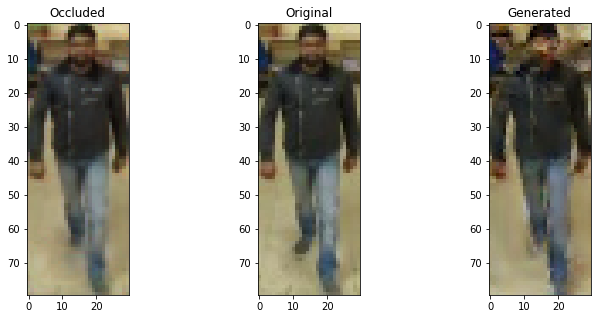

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


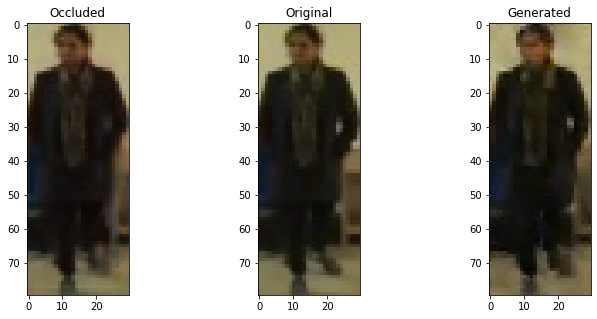

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


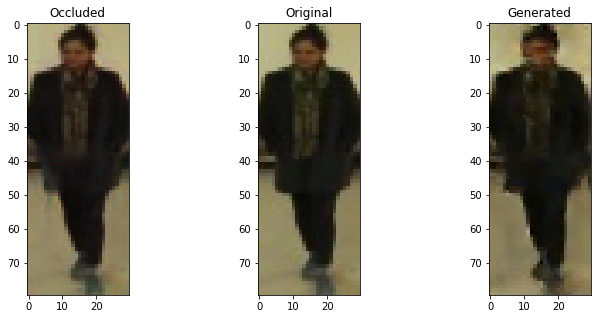

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


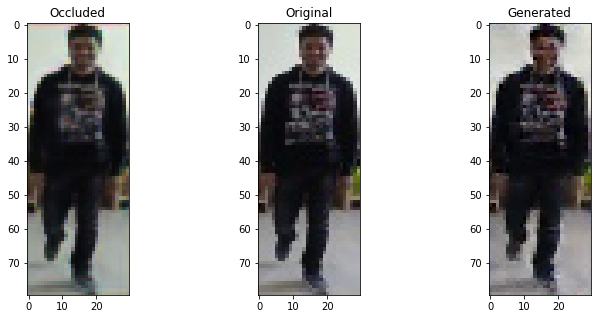

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


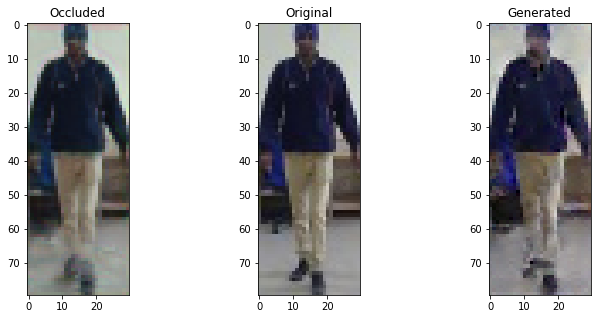

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6447721123695374 , Adversarial Loss:  0.0005166006740182638
Epoch 1842


  8%|▊         | 1/13 [00:00<00:02,  5.74it/s]

Discriminator Loss:  0.6580060720443726 , Adversarial Loss:  0.0004843875067308545
Epoch 1843


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6353986859321594 , Adversarial Loss:  0.00046278914669528604
Epoch 1844


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6562177538871765 , Adversarial Loss:  0.0005263820057734847
Epoch 1845


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6668770909309387 , Adversarial Loss:  0.00046168986591510475
Epoch 1846


  8%|▊         | 1/13 [00:00<00:01,  6.07it/s]

Discriminator Loss:  0.6639151573181152 , Adversarial Loss:  0.00042115451651625335
Epoch 1847


  8%|▊         | 1/13 [00:00<00:01,  6.20it/s]

Discriminator Loss:  0.6556957364082336 , Adversarial Loss:  0.0004662604769691825
Epoch 1848


  8%|▊         | 1/13 [00:00<00:01,  6.09it/s]

Discriminator Loss:  0.6701435446739197 , Adversarial Loss:  0.0004927132977172732
Epoch 1849


  8%|▊         | 1/13 [00:00<00:02,  5.17it/s]

Discriminator Loss:  0.6763672828674316 , Adversarial Loss:  0.0005391829181462526
Epoch 1850


  8%|▊         | 1/13 [00:00<00:01,  6.45it/s]

Discriminator Loss:  0.6628431677818298 , Adversarial Loss:  0.000497327302582562
Epoch 1851


  8%|▊         | 1/13 [00:00<00:01,  6.57it/s]

Discriminator Loss:  0.6621904373168945 , Adversarial Loss:  0.0005137029802426696
Epoch 1852


  8%|▊         | 1/13 [00:00<00:01,  6.30it/s]

Discriminator Loss:  0.6453471779823303 , Adversarial Loss:  0.0005431867903098464
Epoch 1853


  8%|▊         | 1/13 [00:00<00:02,  5.88it/s]

Discriminator Loss:  0.668566107749939 , Adversarial Loss:  0.0004975012270733714
Epoch 1854


  8%|▊         | 1/13 [00:00<00:01,  6.44it/s]

Discriminator Loss:  0.6873027086257935 , Adversarial Loss:  0.00044908514246344566
Epoch 1855


  8%|▊         | 1/13 [00:00<00:01,  6.31it/s]

Discriminator Loss:  0.6553494334220886 , Adversarial Loss:  0.00046422035666182637
Epoch 1856


  8%|▊         | 1/13 [00:00<00:01,  6.49it/s]

Discriminator Loss:  0.6520804166793823 , Adversarial Loss:  0.00048697448801249266
Epoch 1857


  8%|▊         | 1/13 [00:00<00:02,  5.14it/s]

Discriminator Loss:  0.6556328535079956 , Adversarial Loss:  0.000525540963280946
Epoch 1858


  8%|▊         | 1/13 [00:00<00:01,  6.60it/s]

Discriminator Loss:  0.6549760103225708 , Adversarial Loss:  0.00046646027476526797
Epoch 1859


  8%|▊         | 1/13 [00:00<00:02,  5.93it/s]

Discriminator Loss:  0.6558399200439453 , Adversarial Loss:  0.000502408598549664
Epoch 1860


  8%|▊         | 1/13 [00:00<00:01,  6.27it/s]

Discriminator Loss:  0.6439480781555176 , Adversarial Loss:  0.00046966076479293406
Epoch 1861


100%|██████████| 13/13 [00:02<00:00,  5.70it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


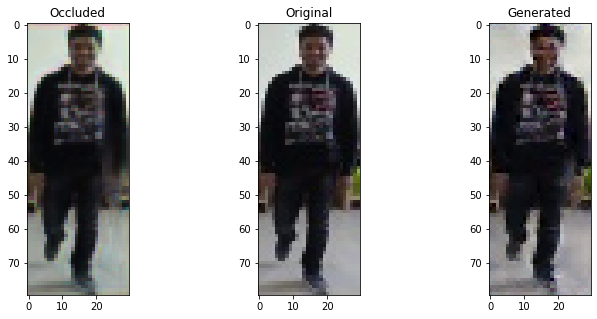

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


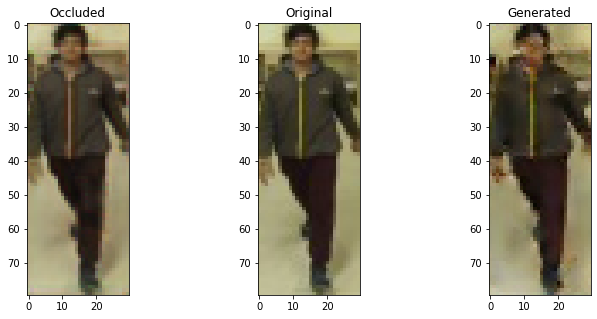

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


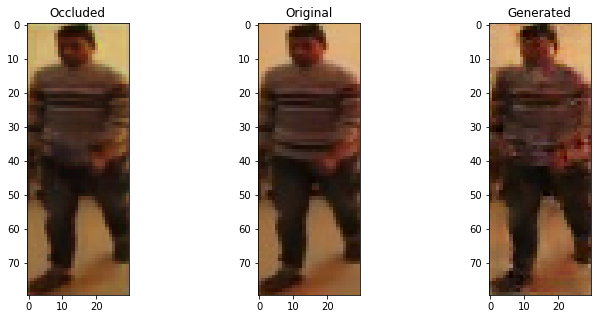

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


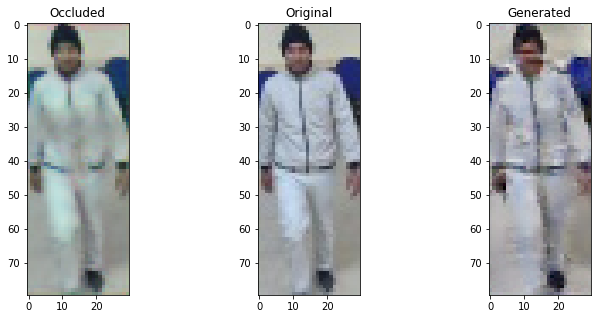

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


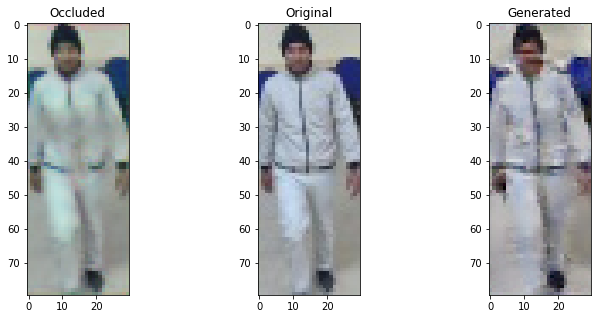

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6507174372673035 , Adversarial Loss:  0.000472872779937461
Epoch 1862


  8%|▊         | 1/13 [00:00<00:01,  6.66it/s]

Discriminator Loss:  0.6415497064590454 , Adversarial Loss:  0.0004704902821686119
Epoch 1863


  8%|▊         | 1/13 [00:00<00:01,  6.40it/s]

Discriminator Loss:  0.6440911889076233 , Adversarial Loss:  0.0004966526757925749
Epoch 1864


  8%|▊         | 1/13 [00:00<00:02,  5.29it/s]

Discriminator Loss:  0.6548137664794922 , Adversarial Loss:  0.0005164748290553689
Epoch 1865


  8%|▊         | 1/13 [00:00<00:02,  5.74it/s]

Discriminator Loss:  0.6371868848800659 , Adversarial Loss:  0.00045927613973617554
Epoch 1866


  8%|▊         | 1/13 [00:00<00:01,  6.11it/s]

Discriminator Loss:  0.6460224390029907 , Adversarial Loss:  0.0004872471035923809
Epoch 1867


  8%|▊         | 1/13 [00:00<00:01,  6.73it/s]

Discriminator Loss:  0.6301067471504211 , Adversarial Loss:  0.0004410916881170124
Epoch 1868


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6686931252479553 , Adversarial Loss:  0.0004929180140607059
Epoch 1869


  8%|▊         | 1/13 [00:00<00:01,  6.59it/s]

Discriminator Loss:  0.6595674753189087 , Adversarial Loss:  0.0005047388840466738
Epoch 1870


  8%|▊         | 1/13 [00:00<00:01,  6.69it/s]

Discriminator Loss:  0.6502929925918579 , Adversarial Loss:  0.0004496105539146811
Epoch 1871


  8%|▊         | 1/13 [00:00<00:02,  5.48it/s]

Discriminator Loss:  0.6646056175231934 , Adversarial Loss:  0.000477106892503798
Epoch 1872


  8%|▊         | 1/13 [00:00<00:01,  6.13it/s]

Discriminator Loss:  0.6598235368728638 , Adversarial Loss:  0.0004593819903675467
Epoch 1873


  8%|▊         | 1/13 [00:00<00:01,  6.52it/s]

Discriminator Loss:  0.6508916616439819 , Adversarial Loss:  0.0004496712936088443
Epoch 1874


  8%|▊         | 1/13 [00:00<00:02,  5.81it/s]

Discriminator Loss:  0.6523439884185791 , Adversarial Loss:  0.0004885641974397004
Epoch 1875


  8%|▊         | 1/13 [00:00<00:01,  6.26it/s]

Discriminator Loss:  0.6475389003753662 , Adversarial Loss:  0.00044835719745606184
Epoch 1876


  8%|▊         | 1/13 [00:00<00:01,  6.13it/s]

Discriminator Loss:  0.6393066644668579 , Adversarial Loss:  0.00045712600694969296
Epoch 1877


  8%|▊         | 1/13 [00:00<00:01,  6.07it/s]

Discriminator Loss:  0.6485422849655151 , Adversarial Loss:  0.0005260210018604994
Epoch 1878


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6670262813568115 , Adversarial Loss:  0.0004681260325014591
Epoch 1879


  8%|▊         | 1/13 [00:00<00:01,  6.44it/s]

Discriminator Loss:  0.6707213521003723 , Adversarial Loss:  0.0004739417345263064
Epoch 1880


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6667221784591675 , Adversarial Loss:  0.000527127762325108
Epoch 1881


100%|██████████| 13/13 [00:02<00:00,  5.64it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


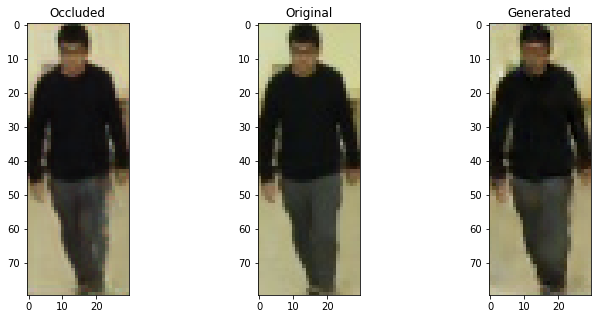

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


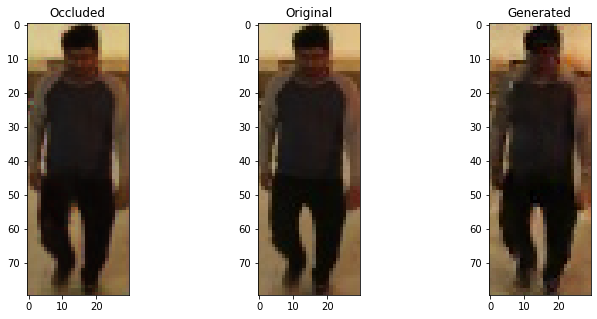

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


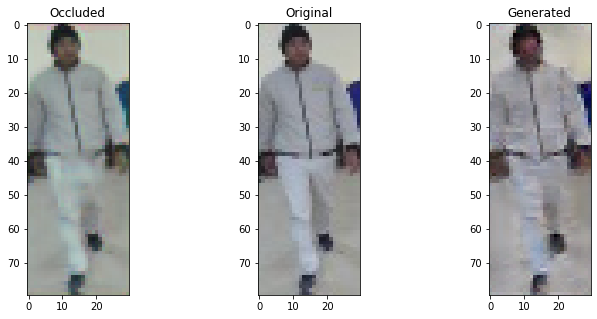

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


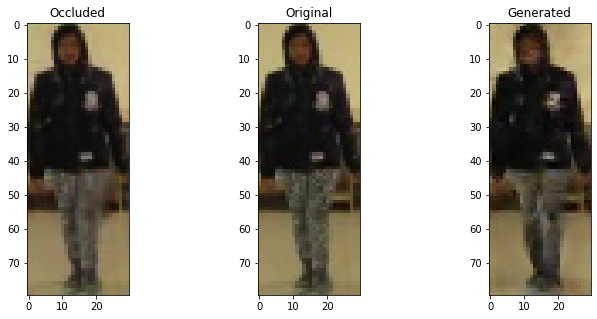

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


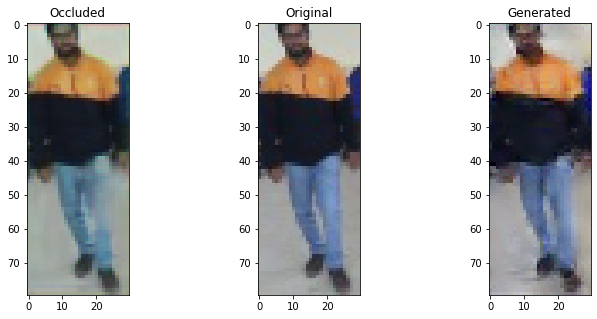

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6516124606132507 , Adversarial Loss:  0.0004484944511204958
Epoch 1882


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6587551832199097 , Adversarial Loss:  0.0004240300040692091
Epoch 1883


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6530975699424744 , Adversarial Loss:  0.00044718163553625345
Epoch 1884


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6584763526916504 , Adversarial Loss:  0.0004908420378342271
Epoch 1885


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6435815095901489 , Adversarial Loss:  0.000466174038592726
Epoch 1886


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6340010166168213 , Adversarial Loss:  0.00044438333134166896
Epoch 1887


  8%|▊         | 1/13 [00:00<00:01,  6.09it/s]

Discriminator Loss:  0.6418911218643188 , Adversarial Loss:  0.00047207478201016784
Epoch 1888


  8%|▊         | 1/13 [00:00<00:02,  5.64it/s]

Discriminator Loss:  0.6604145765304565 , Adversarial Loss:  0.0004499173373915255
Epoch 1889


  8%|▊         | 1/13 [00:00<00:01,  6.30it/s]

Discriminator Loss:  0.6439533233642578 , Adversarial Loss:  0.0004393935087136924
Epoch 1890


  8%|▊         | 1/13 [00:00<00:02,  5.23it/s]

Discriminator Loss:  0.6471937894821167 , Adversarial Loss:  0.00046840388677082956
Epoch 1891


  8%|▊         | 1/13 [00:00<00:01,  6.15it/s]

Discriminator Loss:  0.646721363067627 , Adversarial Loss:  0.00042192707769572735
Epoch 1892


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6546289920806885 , Adversarial Loss:  0.0004407164524309337
Epoch 1893


  8%|▊         | 1/13 [00:00<00:01,  6.56it/s]

Discriminator Loss:  0.6408120393753052 , Adversarial Loss:  0.0004886420210823417
Epoch 1894


  8%|▊         | 1/13 [00:00<00:01,  6.15it/s]

Discriminator Loss:  0.6511578559875488 , Adversarial Loss:  0.00047056470066308975
Epoch 1895


  8%|▊         | 1/13 [00:00<00:02,  5.41it/s]

Discriminator Loss:  0.6715454459190369 , Adversarial Loss:  0.0004858046304434538
Epoch 1896


  8%|▊         | 1/13 [00:00<00:01,  6.46it/s]

Discriminator Loss:  0.6561267375946045 , Adversarial Loss:  0.00045966991456225514
Epoch 1897


  8%|▊         | 1/13 [00:00<00:02,  5.69it/s]

Discriminator Loss:  0.6431739926338196 , Adversarial Loss:  0.0004587189760059118
Epoch 1898


  8%|▊         | 1/13 [00:00<00:01,  6.48it/s]

Discriminator Loss:  0.65781569480896 , Adversarial Loss:  0.0004699218843597919
Epoch 1899


  8%|▊         | 1/13 [00:00<00:02,  5.89it/s]

Discriminator Loss:  0.6353266835212708 , Adversarial Loss:  0.0004562076064758003
Epoch 1900


  8%|▊         | 1/13 [00:00<00:02,  5.94it/s]

Discriminator Loss:  0.6601511240005493 , Adversarial Loss:  0.0004855150473304093
Epoch 1901


100%|██████████| 13/13 [00:02<00:00,  5.76it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


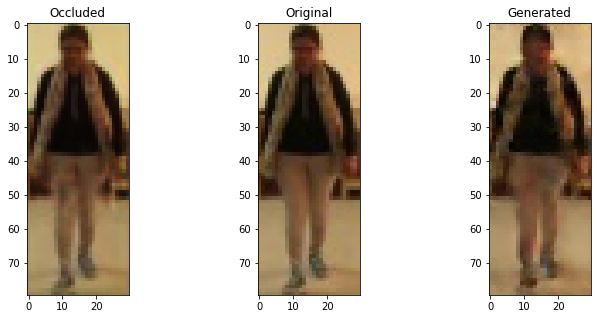

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


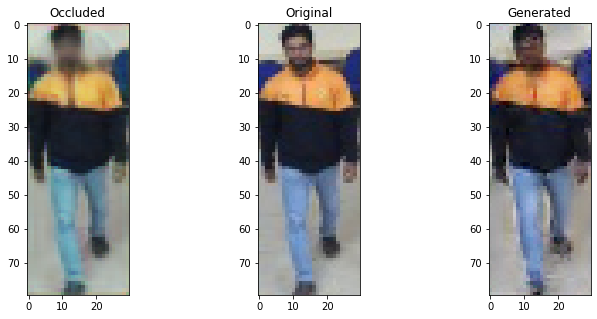

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


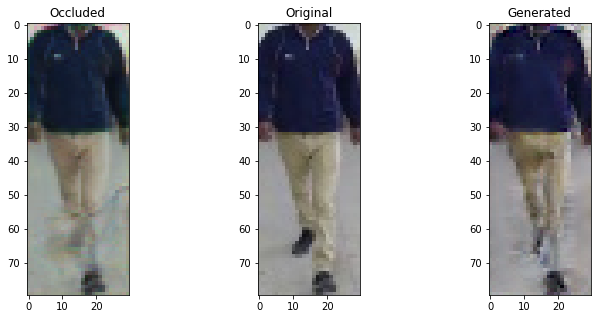

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


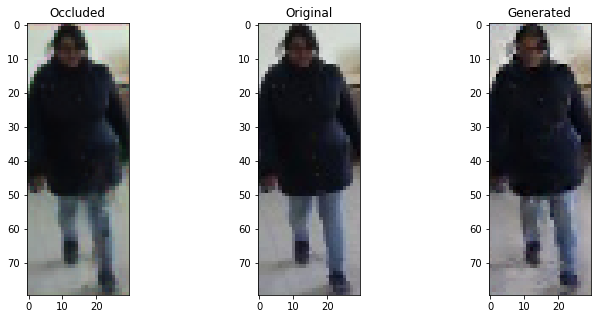

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


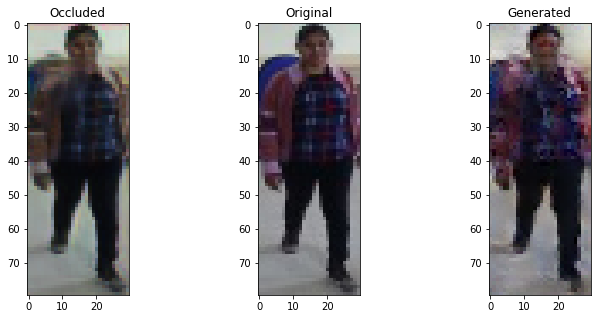

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6535937786102295 , Adversarial Loss:  0.0004447717219591141
Epoch 1902


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6525525450706482 , Adversarial Loss:  0.0004919646307826042
Epoch 1903


  8%|▊         | 1/13 [00:00<00:02,  5.78it/s]

Discriminator Loss:  0.6427500247955322 , Adversarial Loss:  0.00048479135148227215
Epoch 1904


  8%|▊         | 1/13 [00:00<00:01,  6.32it/s]

Discriminator Loss:  0.6563745737075806 , Adversarial Loss:  0.00043126766104251146
Epoch 1905


  8%|▊         | 1/13 [00:00<00:01,  6.07it/s]

Discriminator Loss:  0.6485481262207031 , Adversarial Loss:  0.00048715464072301984
Epoch 1906


  8%|▊         | 1/13 [00:00<00:02,  5.99it/s]

Discriminator Loss:  0.6519238948822021 , Adversarial Loss:  0.0005044121062383056
Epoch 1907


  8%|▊         | 1/13 [00:00<00:01,  6.52it/s]

Discriminator Loss:  0.6640650033950806 , Adversarial Loss:  0.0005131068173795938
Epoch 1908


  8%|▊         | 1/13 [00:00<00:02,  5.72it/s]

Discriminator Loss:  0.6613165140151978 , Adversarial Loss:  0.0004775300621986389
Epoch 1909


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.649427056312561 , Adversarial Loss:  0.0004964236286468804
Epoch 1910


  8%|▊         | 1/13 [00:00<00:01,  6.34it/s]

Discriminator Loss:  0.6486293077468872 , Adversarial Loss:  0.0004594439815264195
Epoch 1911


  8%|▊         | 1/13 [00:00<00:01,  6.61it/s]

Discriminator Loss:  0.6581312417984009 , Adversarial Loss:  0.0005026760627515614
Epoch 1912


  8%|▊         | 1/13 [00:00<00:01,  6.43it/s]

Discriminator Loss:  0.6583009362220764 , Adversarial Loss:  0.0005393814644776285
Epoch 1913


  8%|▊         | 1/13 [00:00<00:02,  5.79it/s]

Discriminator Loss:  0.6588491201400757 , Adversarial Loss:  0.00045259686885401607
Epoch 1914


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6537729501724243 , Adversarial Loss:  0.0004554576298687607
Epoch 1915


  8%|▊         | 1/13 [00:00<00:02,  5.19it/s]

Discriminator Loss:  0.6555063724517822 , Adversarial Loss:  0.00047006120439618826
Epoch 1916


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6325690746307373 , Adversarial Loss:  0.0003809104091487825
Epoch 1917


  8%|▊         | 1/13 [00:00<00:01,  6.37it/s]

Discriminator Loss:  0.64629065990448 , Adversarial Loss:  0.0004897016333416104
Epoch 1918


  8%|▊         | 1/13 [00:00<00:01,  6.04it/s]

Discriminator Loss:  0.6361140012741089 , Adversarial Loss:  0.0005142063018865883
Epoch 1919


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6707017421722412 , Adversarial Loss:  0.00048754707677289844
Epoch 1920


  8%|▊         | 1/13 [00:00<00:01,  6.30it/s]

Discriminator Loss:  0.6627374291419983 , Adversarial Loss:  0.00044687502668239176
Epoch 1921


100%|██████████| 13/13 [00:02<00:00,  5.85it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


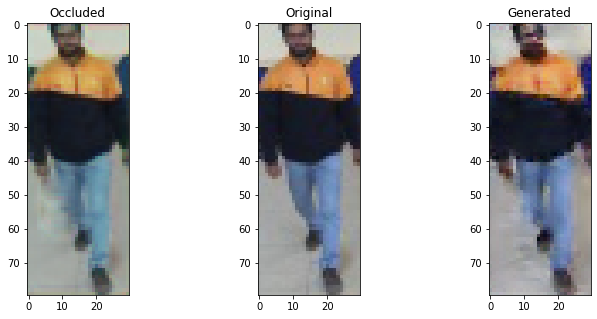

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


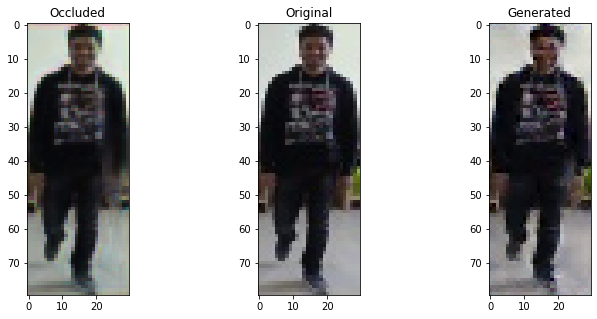

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


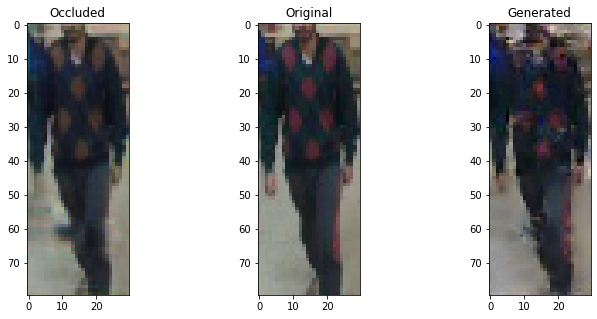

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


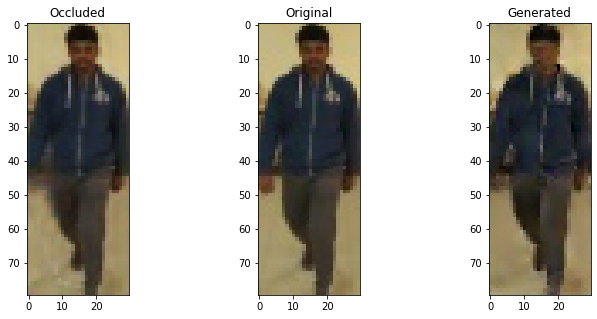

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


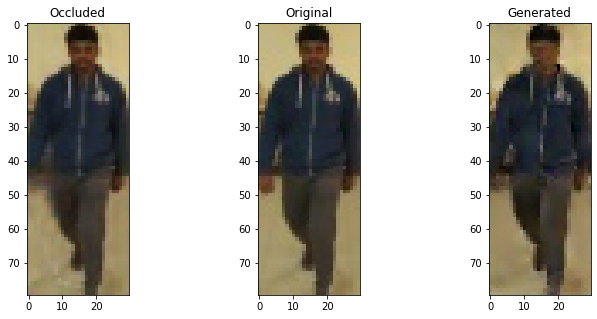

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6895334124565125 , Adversarial Loss:  0.0005115359090268612
Epoch 1922


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6313557624816895 , Adversarial Loss:  0.00048394425539299846
Epoch 1923


  8%|▊         | 1/13 [00:00<00:02,  5.39it/s]

Discriminator Loss:  0.6461620330810547 , Adversarial Loss:  0.0004249557969160378
Epoch 1924


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6626062393188477 , Adversarial Loss:  0.0005257092998363078
Epoch 1925


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6556128263473511 , Adversarial Loss:  0.0004910421557724476
Epoch 1926


  8%|▊         | 1/13 [00:00<00:01,  6.11it/s]

Discriminator Loss:  0.6587625741958618 , Adversarial Loss:  0.0004119256045669317
Epoch 1927


  8%|▊         | 1/13 [00:00<00:01,  6.43it/s]

Discriminator Loss:  0.6642274260520935 , Adversarial Loss:  0.00045052936184220016
Epoch 1928


  8%|▊         | 1/13 [00:00<00:02,  5.67it/s]

Discriminator Loss:  0.6820535659790039 , Adversarial Loss:  0.00045182794565334916
Epoch 1929


  8%|▊         | 1/13 [00:00<00:01,  6.23it/s]

Discriminator Loss:  0.6649079322814941 , Adversarial Loss:  0.0004314905090723187
Epoch 1930


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6948215961456299 , Adversarial Loss:  0.00045668252278119326
Epoch 1931


  8%|▊         | 1/13 [00:00<00:01,  6.21it/s]

Discriminator Loss:  0.6629686951637268 , Adversarial Loss:  0.00044924201210960746
Epoch 1932


  8%|▊         | 1/13 [00:00<00:01,  6.28it/s]

Discriminator Loss:  0.6625267267227173 , Adversarial Loss:  0.0004052424628753215
Epoch 1933


  8%|▊         | 1/13 [00:00<00:01,  6.73it/s]

Discriminator Loss:  0.6351121664047241 , Adversarial Loss:  0.00044105653068982065
Epoch 1934


  8%|▊         | 1/13 [00:00<00:01,  6.59it/s]

Discriminator Loss:  0.6515534520149231 , Adversarial Loss:  0.00046246868441812694
Epoch 1935


  8%|▊         | 1/13 [00:00<00:02,  5.65it/s]

Discriminator Loss:  0.6614649295806885 , Adversarial Loss:  0.00044622612767852843
Epoch 1936


  8%|▊         | 1/13 [00:00<00:02,  5.78it/s]

Discriminator Loss:  0.6726109385490417 , Adversarial Loss:  0.00048480124678462744
Epoch 1937


  8%|▊         | 1/13 [00:00<00:01,  6.54it/s]

Discriminator Loss:  0.6581970453262329 , Adversarial Loss:  0.00047619087854400277
Epoch 1938


  8%|▊         | 1/13 [00:00<00:01,  6.12it/s]

Discriminator Loss:  0.6538736820220947 , Adversarial Loss:  0.00048335708561353385
Epoch 1939


  8%|▊         | 1/13 [00:00<00:01,  6.40it/s]

Discriminator Loss:  0.6480576992034912 , Adversarial Loss:  0.0004407410742715001
Epoch 1940


  8%|▊         | 1/13 [00:00<00:01,  6.51it/s]

Discriminator Loss:  0.6494935750961304 , Adversarial Loss:  0.00039450189797207713
Epoch 1941


100%|██████████| 13/13 [00:02<00:00,  5.92it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


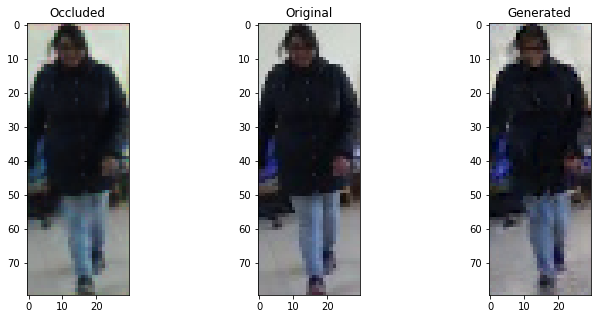

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


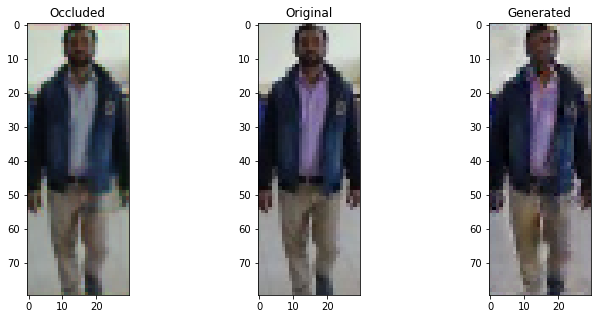

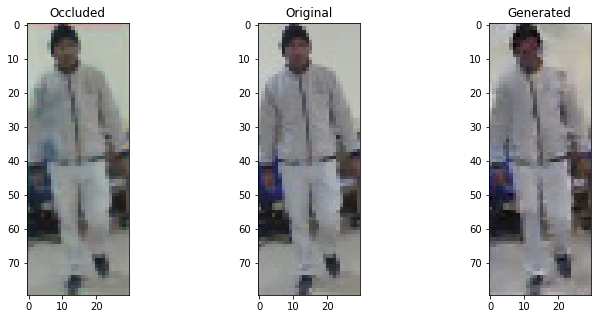

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


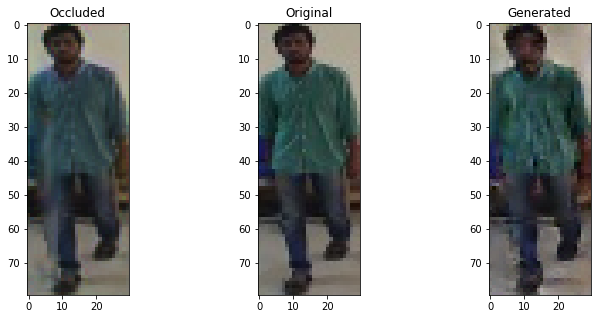

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


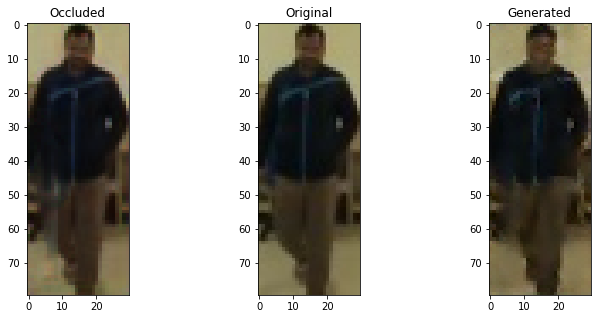

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6760491728782654 , Adversarial Loss:  0.0004450997803360224
Epoch 1942


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6557205319404602 , Adversarial Loss:  0.00045174185652285814
Epoch 1943


  8%|▊         | 1/13 [00:00<00:01,  6.66it/s]

Discriminator Loss:  0.6560643911361694 , Adversarial Loss:  0.0004295545513741672
Epoch 1944


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6799755096435547 , Adversarial Loss:  0.00040462211472913623
Epoch 1945


  8%|▊         | 1/13 [00:00<00:02,  5.46it/s]

Discriminator Loss:  0.6524091958999634 , Adversarial Loss:  0.00041160298860631883
Epoch 1946


  8%|▊         | 1/13 [00:00<00:02,  5.91it/s]

Discriminator Loss:  0.6921374797821045 , Adversarial Loss:  0.0004501334042288363
Epoch 1947


  8%|▊         | 1/13 [00:00<00:01,  6.52it/s]

Discriminator Loss:  0.6606403589248657 , Adversarial Loss:  0.0004561419482342899
Epoch 1948


  8%|▊         | 1/13 [00:00<00:02,  5.31it/s]

Discriminator Loss:  0.6499602198600769 , Adversarial Loss:  0.0004603205597959459
Epoch 1949


  8%|▊         | 1/13 [00:00<00:02,  5.20it/s]

Discriminator Loss:  0.6588069200515747 , Adversarial Loss:  0.0005304196383804083
Epoch 1950


  8%|▊         | 1/13 [00:00<00:01,  6.57it/s]

Discriminator Loss:  0.6358474493026733 , Adversarial Loss:  0.00043082493357360363
Epoch 1951


  8%|▊         | 1/13 [00:00<00:01,  6.56it/s]

Discriminator Loss:  0.6607933044433594 , Adversarial Loss:  0.0004115935298614204
Epoch 1952


  8%|▊         | 1/13 [00:00<00:01,  6.32it/s]

Discriminator Loss:  0.6689631342887878 , Adversarial Loss:  0.0005089656333439052
Epoch 1953


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6700711846351624 , Adversarial Loss:  0.00046178436605259776
Epoch 1954


  8%|▊         | 1/13 [00:00<00:01,  6.53it/s]

Discriminator Loss:  0.6445044279098511 , Adversarial Loss:  0.00043433334212750196
Epoch 1955


  8%|▊         | 1/13 [00:00<00:01,  6.69it/s]

Discriminator Loss:  0.664445161819458 , Adversarial Loss:  0.00040467394865117967
Epoch 1956


  8%|▊         | 1/13 [00:00<00:01,  6.77it/s]

Discriminator Loss:  0.6200218200683594 , Adversarial Loss:  0.00041278713615611196
Epoch 1957


  8%|▊         | 1/13 [00:00<00:01,  6.68it/s]

Discriminator Loss:  0.6536428928375244 , Adversarial Loss:  0.00048404879635199904
Epoch 1958


  8%|▊         | 1/13 [00:00<00:01,  6.25it/s]

Discriminator Loss:  0.6486208438873291 , Adversarial Loss:  0.0004598661616910249
Epoch 1959


  8%|▊         | 1/13 [00:00<00:01,  6.27it/s]

Discriminator Loss:  0.6424367427825928 , Adversarial Loss:  0.0004898059996776283
Epoch 1960


  8%|▊         | 1/13 [00:00<00:01,  6.52it/s]

Discriminator Loss:  0.6930258274078369 , Adversarial Loss:  0.0004298542917240411
Epoch 1961


100%|██████████| 13/13 [00:02<00:00,  5.97it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


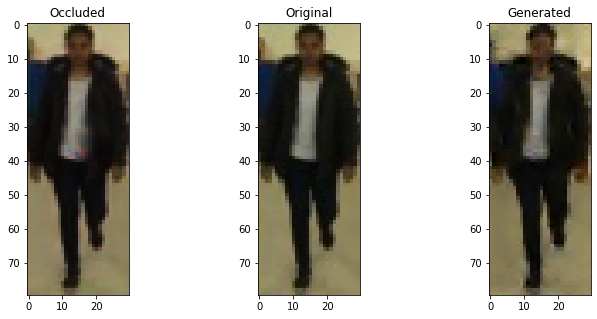

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


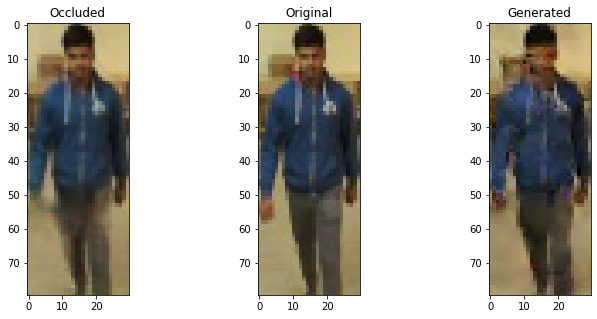

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


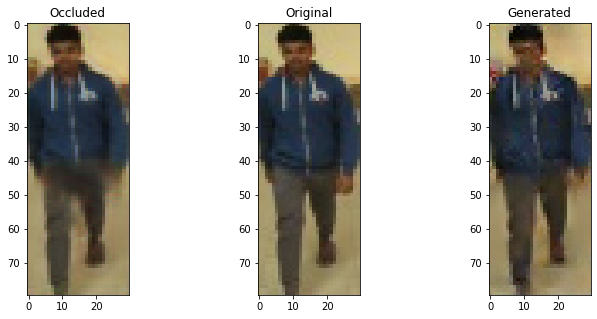

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


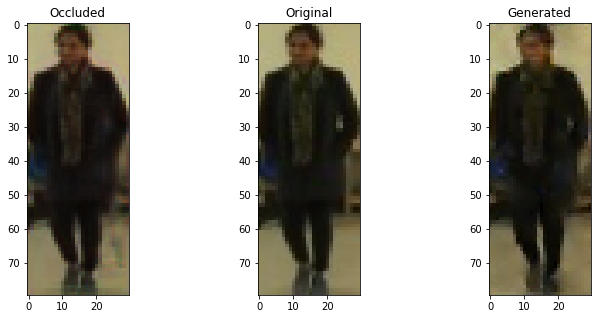

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


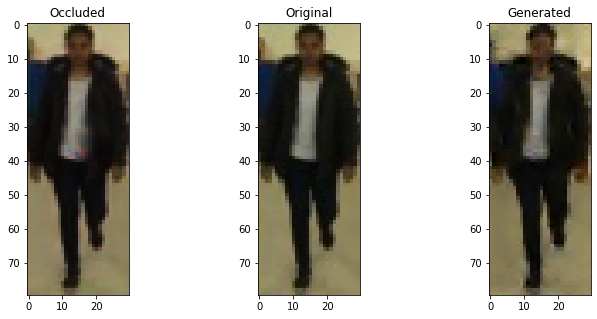

  8%|▊         | 1/13 [00:00<00:02,  5.57it/s]

Discriminator Loss:  0.6712599396705627 , Adversarial Loss:  0.000481722760014236
Epoch 1962


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6691794991493225 , Adversarial Loss:  0.00046491221291944385
Epoch 1963


  8%|▊         | 1/13 [00:00<00:02,  5.60it/s]

Discriminator Loss:  0.653423547744751 , Adversarial Loss:  0.0004779380979016423
Epoch 1964


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6690753102302551 , Adversarial Loss:  0.00043434585677459836
Epoch 1965


  8%|▊         | 1/13 [00:00<00:02,  5.73it/s]

Discriminator Loss:  0.6469155550003052 , Adversarial Loss:  0.00047146412543952465
Epoch 1966


  8%|▊         | 1/13 [00:00<00:01,  6.15it/s]

Discriminator Loss:  0.6478073596954346 , Adversarial Loss:  0.00046893343096598983
Epoch 1967


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6644243001937866 , Adversarial Loss:  0.0003941477043554187
Epoch 1968


  8%|▊         | 1/13 [00:00<00:01,  6.33it/s]

Discriminator Loss:  0.6696610450744629 , Adversarial Loss:  0.0004241337883286178
Epoch 1969


  8%|▊         | 1/13 [00:00<00:01,  6.36it/s]

Discriminator Loss:  0.6569341421127319 , Adversarial Loss:  0.0005155809922143817
Epoch 1970


  8%|▊         | 1/13 [00:00<00:01,  6.82it/s]

Discriminator Loss:  0.654850423336029 , Adversarial Loss:  0.00044484116369858384
Epoch 1971


  8%|▊         | 1/13 [00:00<00:01,  6.29it/s]

Discriminator Loss:  0.6522270441055298 , Adversarial Loss:  0.000451346073532477
Epoch 1972


  8%|▊         | 1/13 [00:00<00:01,  6.55it/s]

Discriminator Loss:  0.6573874950408936 , Adversarial Loss:  0.00045494281221181154
Epoch 1973


  8%|▊         | 1/13 [00:00<00:01,  6.24it/s]

Discriminator Loss:  0.6417482495307922 , Adversarial Loss:  0.00047913126763887703
Epoch 1974


  8%|▊         | 1/13 [00:00<00:01,  6.93it/s]

Discriminator Loss:  0.6548058986663818 , Adversarial Loss:  0.0004149660817347467
Epoch 1975


  8%|▊         | 1/13 [00:00<00:01,  6.46it/s]

Discriminator Loss:  0.6519734859466553 , Adversarial Loss:  0.00041216897079721093
Epoch 1976


  8%|▊         | 1/13 [00:00<00:01,  6.61it/s]

Discriminator Loss:  0.6799607276916504 , Adversarial Loss:  0.0004185318248346448
Epoch 1977


  8%|▊         | 1/13 [00:00<00:01,  6.72it/s]

Discriminator Loss:  0.6695404648780823 , Adversarial Loss:  0.000496967404615134
Epoch 1978


  8%|▊         | 1/13 [00:00<00:02,  5.97it/s]

Discriminator Loss:  0.6653539538383484 , Adversarial Loss:  0.00044729007640853524
Epoch 1979


  8%|▊         | 1/13 [00:00<00:01,  6.70it/s]

Discriminator Loss:  0.6718391180038452 , Adversarial Loss:  0.0004239637637510896
Epoch 1980


  8%|▊         | 1/13 [00:00<00:01,  6.57it/s]

Discriminator Loss:  0.6451935768127441 , Adversarial Loss:  0.0004368071968201548
Epoch 1981


100%|██████████| 13/13 [00:02<00:00,  5.91it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


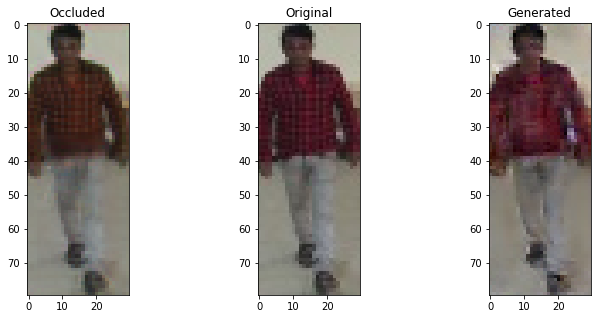

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


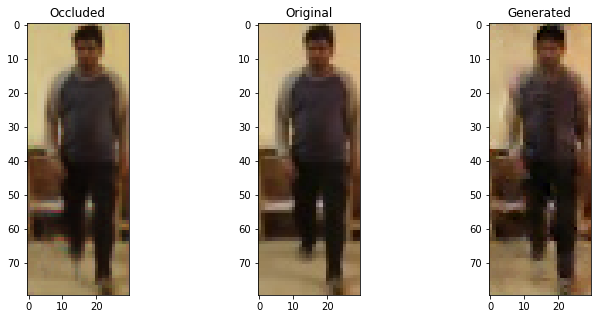

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


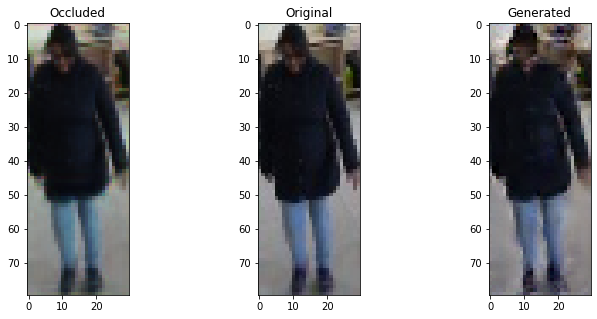

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


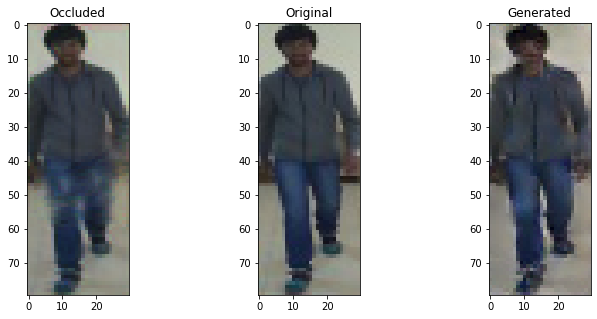

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


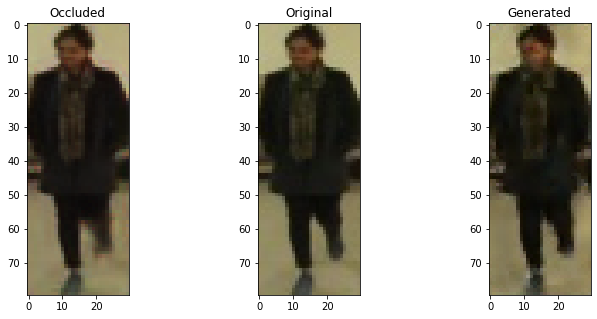

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6658424139022827 , Adversarial Loss:  0.0004922520602121949
Epoch 1982


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6689159870147705 , Adversarial Loss:  0.00044369150418788195
Epoch 1983


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6523758769035339 , Adversarial Loss:  0.0004606381698977202
Epoch 1984


  8%|▊         | 1/13 [00:00<00:01,  6.06it/s]

Discriminator Loss:  0.6496298313140869 , Adversarial Loss:  0.0004929091082885861
Epoch 1985


  8%|▊         | 1/13 [00:00<00:01,  6.84it/s]

Discriminator Loss:  0.6698795557022095 , Adversarial Loss:  0.0004372085095383227
Epoch 1986


  8%|▊         | 1/13 [00:00<00:01,  6.97it/s]

Discriminator Loss:  0.6626454591751099 , Adversarial Loss:  0.00045345944818109274
Epoch 1987


  8%|▊         | 1/13 [00:00<00:02,  5.94it/s]

Discriminator Loss:  0.6557364463806152 , Adversarial Loss:  0.00042565487092360854
Epoch 1988


  8%|▊         | 1/13 [00:00<00:01,  6.26it/s]

Discriminator Loss:  0.6675043702125549 , Adversarial Loss:  0.0004581707180477679
Epoch 1989


  8%|▊         | 1/13 [00:00<00:01,  6.23it/s]

Discriminator Loss:  0.6412392854690552 , Adversarial Loss:  0.01662997528910637
Epoch 1990


  8%|▊         | 1/13 [00:00<00:01,  6.51it/s]

Discriminator Loss:  0.6507623195648193 , Adversarial Loss:  0.004747296217828989
Epoch 1991


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6523208022117615 , Adversarial Loss:  0.003864218480885029
Epoch 1992


  8%|▊         | 1/13 [00:00<00:01,  6.67it/s]

Discriminator Loss:  0.6587017178535461 , Adversarial Loss:  0.0033540979493409395
Epoch 1993


  8%|▊         | 1/13 [00:00<00:01,  6.71it/s]

Discriminator Loss:  0.6772605180740356 , Adversarial Loss:  0.0029073692858219147
Epoch 1994


  8%|▊         | 1/13 [00:00<00:01,  6.21it/s]

Discriminator Loss:  0.6540176272392273 , Adversarial Loss:  0.0026278109289705753
Epoch 1995


  8%|▊         | 1/13 [00:00<00:02,  5.16it/s]

Discriminator Loss:  0.6343622207641602 , Adversarial Loss:  0.0023490451276302338
Epoch 1996


  8%|▊         | 1/13 [00:00<00:01,  6.28it/s]

Discriminator Loss:  0.6483529210090637 , Adversarial Loss:  0.0025307745672762394
Epoch 1997


  8%|▊         | 1/13 [00:00<00:01,  6.74it/s]

Discriminator Loss:  0.6663780808448792 , Adversarial Loss:  0.002523017581552267
Epoch 1998


  8%|▊         | 1/13 [00:00<00:02,  5.94it/s]

Discriminator Loss:  0.651527464389801 , Adversarial Loss:  0.00212676078081131
Epoch 1999


  8%|▊         | 1/13 [00:00<00:02,  5.96it/s]

Discriminator Loss:  0.6616305112838745 , Adversarial Loss:  0.00204459298402071
Epoch 2000


  8%|▊         | 1/13 [00:00<00:02,  5.50it/s]

Discriminator Loss:  0.66718590259552 , Adversarial Loss:  0.002053264994174242
Epoch 2001


100%|██████████| 13/13 [00:02<00:00,  6.19it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


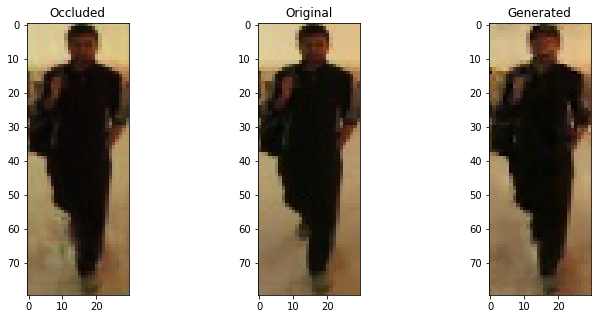

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


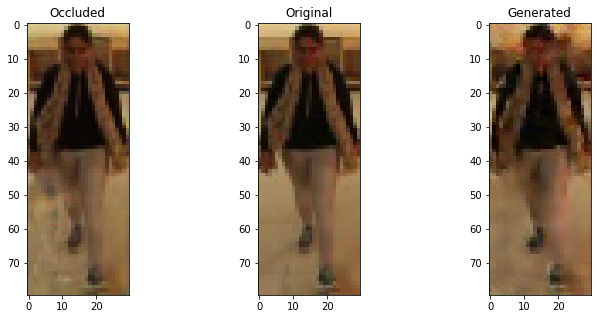

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


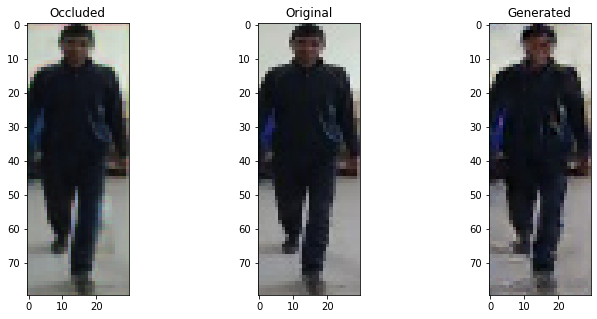

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


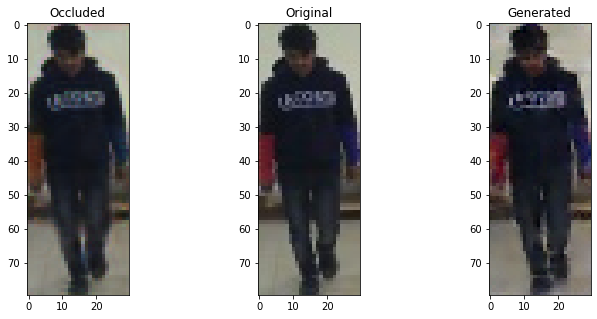

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


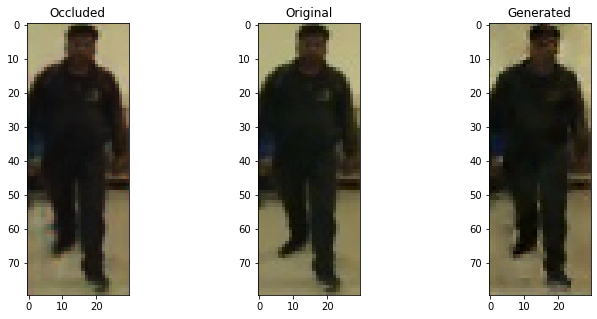

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6564748287200928 , Adversarial Loss:  0.0019100161734968424
Epoch 2002


  8%|▊         | 1/13 [00:00<00:01,  6.01it/s]

Discriminator Loss:  0.6656579971313477 , Adversarial Loss:  0.0017447698628529906
Epoch 2003


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6301748752593994 , Adversarial Loss:  0.0017488084267824888
Epoch 2004


  8%|▊         | 1/13 [00:00<00:01,  6.53it/s]

Discriminator Loss:  0.6718824505805969 , Adversarial Loss:  0.001783288549631834
Epoch 2005


  8%|▊         | 1/13 [00:00<00:01,  6.79it/s]

Discriminator Loss:  0.66572505235672 , Adversarial Loss:  0.001561748911626637
Epoch 2006


  8%|▊         | 1/13 [00:00<00:01,  6.79it/s]

Discriminator Loss:  0.6510604619979858 , Adversarial Loss:  0.0018215107265859842
Epoch 2007


  8%|▊         | 1/13 [00:00<00:01,  6.61it/s]

Discriminator Loss:  0.6436662077903748 , Adversarial Loss:  0.001478816382586956
Epoch 2008


  8%|▊         | 1/13 [00:00<00:01,  6.73it/s]

Discriminator Loss:  0.646814227104187 , Adversarial Loss:  0.0013178226072341204
Epoch 2009


  8%|▊         | 1/13 [00:00<00:01,  6.08it/s]

Discriminator Loss:  0.6566514372825623 , Adversarial Loss:  0.0015277001075446606
Epoch 2010


  8%|▊         | 1/13 [00:00<00:01,  6.20it/s]

Discriminator Loss:  0.6641581058502197 , Adversarial Loss:  0.001387275056913495
Epoch 2011


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6715052723884583 , Adversarial Loss:  0.0014190074289217591
Epoch 2012


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6510424613952637 , Adversarial Loss:  0.0013881786726415157
Epoch 2013


  8%|▊         | 1/13 [00:00<00:01,  6.32it/s]

Discriminator Loss:  0.65468430519104 , Adversarial Loss:  0.0013015834847465158
Epoch 2014


  8%|▊         | 1/13 [00:00<00:01,  6.73it/s]

Discriminator Loss:  0.6798773407936096 , Adversarial Loss:  0.0011529370676726103
Epoch 2015


  8%|▊         | 1/13 [00:00<00:02,  5.30it/s]

Discriminator Loss:  0.6411698460578918 , Adversarial Loss:  0.0013600573875010014
Epoch 2016


  8%|▊         | 1/13 [00:00<00:01,  6.70it/s]

Discriminator Loss:  0.662772536277771 , Adversarial Loss:  0.00117716274689883
Epoch 2017


  8%|▊         | 1/13 [00:00<00:01,  6.40it/s]

Discriminator Loss:  0.6358152627944946 , Adversarial Loss:  0.0010967639973387122
Epoch 2018


  8%|▊         | 1/13 [00:00<00:01,  6.56it/s]

Discriminator Loss:  0.6588535308837891 , Adversarial Loss:  0.0011495830258354545
Epoch 2019


  8%|▊         | 1/13 [00:00<00:02,  5.94it/s]

Discriminator Loss:  0.6653380393981934 , Adversarial Loss:  0.0010356095153838396
Epoch 2020


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6531212329864502 , Adversarial Loss:  0.0009073945693671703
Epoch 2021


100%|██████████| 13/13 [00:02<00:00,  6.04it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


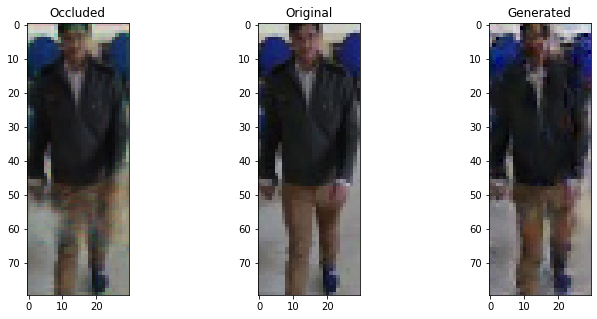

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


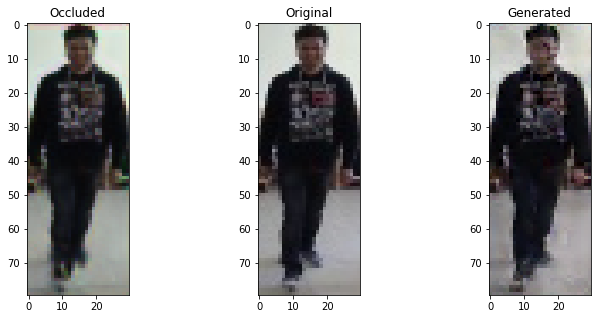

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


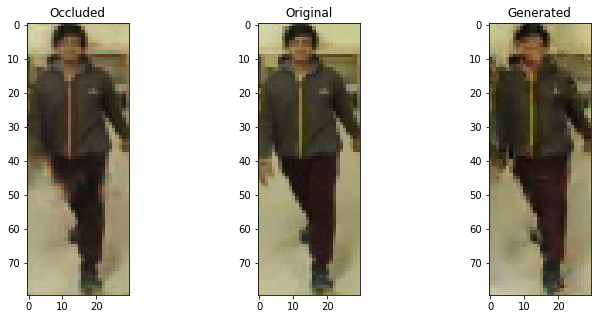

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


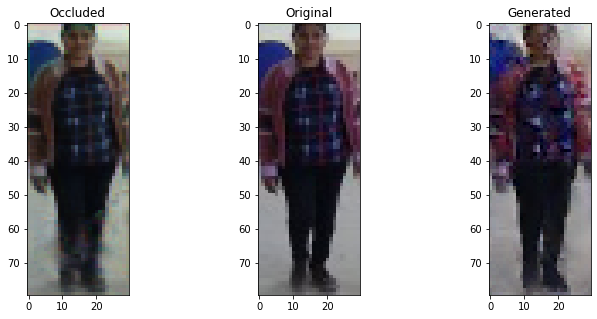

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


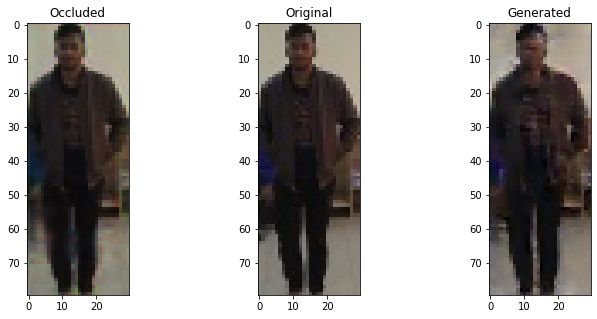

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6495105624198914 , Adversarial Loss:  0.001007472281344235
Epoch 2022


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6650353074073792 , Adversarial Loss:  0.0009513265686109662
Epoch 2023


  8%|▊         | 1/13 [00:00<00:01,  6.45it/s]

Discriminator Loss:  0.6492792367935181 , Adversarial Loss:  0.0010734950192272663
Epoch 2024


  8%|▊         | 1/13 [00:00<00:01,  6.70it/s]

Discriminator Loss:  0.6554961800575256 , Adversarial Loss:  0.0009661736548878253
Epoch 2025


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6758934259414673 , Adversarial Loss:  0.001008674968034029
Epoch 2026


  8%|▊         | 1/13 [00:00<00:01,  6.27it/s]

Discriminator Loss:  0.6621517539024353 , Adversarial Loss:  0.0009622261277399957
Epoch 2027


  8%|▊         | 1/13 [00:00<00:01,  6.68it/s]

Discriminator Loss:  0.6658978462219238 , Adversarial Loss:  0.0007842568447813392
Epoch 2028


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6604052782058716 , Adversarial Loss:  0.0008410398731939495
Epoch 2029


  8%|▊         | 1/13 [00:00<00:01,  6.70it/s]

Discriminator Loss:  0.6903600692749023 , Adversarial Loss:  0.0009183025103993714
Epoch 2030


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6511041522026062 , Adversarial Loss:  0.0009677782654762268
Epoch 2031


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6835423707962036 , Adversarial Loss:  0.0007546496344730258
Epoch 2032


  8%|▊         | 1/13 [00:00<00:01,  6.30it/s]

Discriminator Loss:  0.6796103119850159 , Adversarial Loss:  0.0008262003539130092
Epoch 2033


  8%|▊         | 1/13 [00:00<00:02,  5.62it/s]

Discriminator Loss:  0.6509486436843872 , Adversarial Loss:  0.0009171988349407911
Epoch 2034


  8%|▊         | 1/13 [00:00<00:01,  6.62it/s]

Discriminator Loss:  0.6707873344421387 , Adversarial Loss:  0.0009497242863290012
Epoch 2035


  8%|▊         | 1/13 [00:00<00:02,  5.50it/s]

Discriminator Loss:  0.6426012516021729 , Adversarial Loss:  0.0007308313506655395
Epoch 2036


  8%|▊         | 1/13 [00:00<00:02,  5.50it/s]

Discriminator Loss:  0.663221001625061 , Adversarial Loss:  0.0008160435827448964
Epoch 2037


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6628152132034302 , Adversarial Loss:  0.0007356205023825169
Epoch 2038


  8%|▊         | 1/13 [00:00<00:01,  6.38it/s]

Discriminator Loss:  0.6458741426467896 , Adversarial Loss:  0.0007251048227772117
Epoch 2039


  8%|▊         | 1/13 [00:00<00:01,  6.26it/s]

Discriminator Loss:  0.6528119444847107 , Adversarial Loss:  0.0007988479337655008
Epoch 2040


  8%|▊         | 1/13 [00:00<00:01,  6.68it/s]

Discriminator Loss:  0.640198826789856 , Adversarial Loss:  0.0007243063300848007
Epoch 2041


100%|██████████| 13/13 [00:02<00:00,  6.08it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


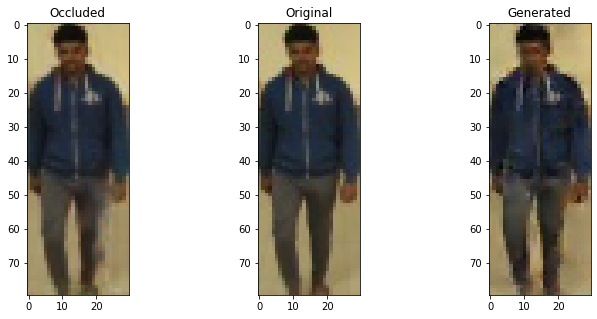

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


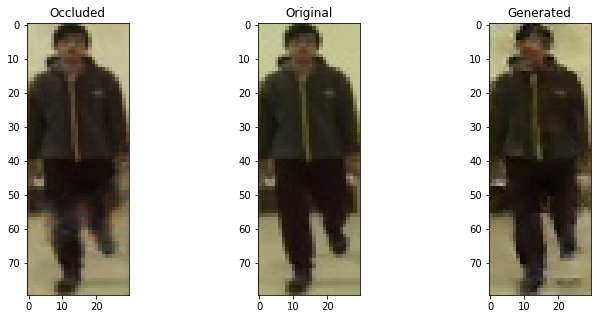

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


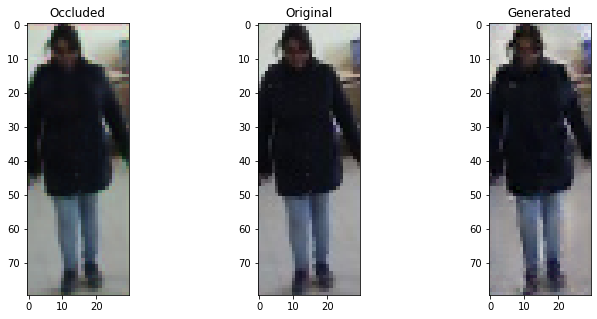

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


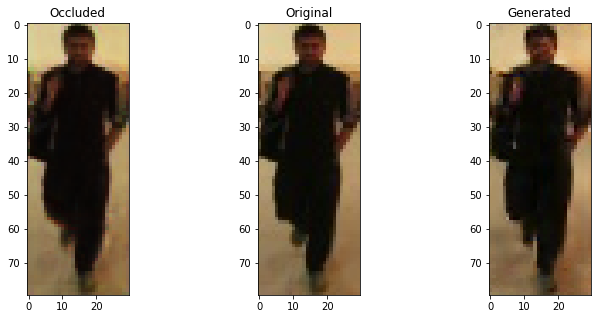

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


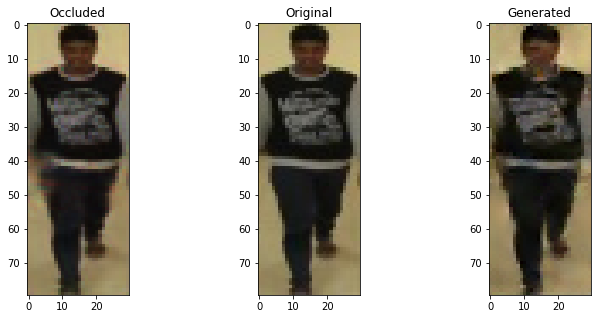

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6541101336479187 , Adversarial Loss:  0.000672545691486448
Epoch 2042


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.63677978515625 , Adversarial Loss:  0.0007350837113335729
Epoch 2043


  8%|▊         | 1/13 [00:00<00:01,  6.12it/s]

Discriminator Loss:  0.6436867117881775 , Adversarial Loss:  0.0006687238346785307
Epoch 2044


  8%|▊         | 1/13 [00:00<00:02,  5.28it/s]

Discriminator Loss:  0.6517589092254639 , Adversarial Loss:  0.0006806968012824655
Epoch 2045


  8%|▊         | 1/13 [00:00<00:01,  6.41it/s]

Discriminator Loss:  0.6679073572158813 , Adversarial Loss:  0.000716624257620424
Epoch 2046


  8%|▊         | 1/13 [00:00<00:02,  5.84it/s]

Discriminator Loss:  0.6475995182991028 , Adversarial Loss:  0.0006487650680355728
Epoch 2047


  8%|▊         | 1/13 [00:00<00:01,  6.40it/s]

Discriminator Loss:  0.6808090209960938 , Adversarial Loss:  0.0007371106185019016
Epoch 2048


  8%|▊         | 1/13 [00:00<00:01,  6.51it/s]

Discriminator Loss:  0.6363464593887329 , Adversarial Loss:  0.0005947810132056475
Epoch 2049


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6444165706634521 , Adversarial Loss:  0.0006488098879344761
Epoch 2050


  8%|▊         | 1/13 [00:00<00:02,  5.14it/s]

Discriminator Loss:  0.6558325290679932 , Adversarial Loss:  0.0006299659144133329
Epoch 2051


  8%|▊         | 1/13 [00:00<00:01,  6.44it/s]

Discriminator Loss:  0.6487606763839722 , Adversarial Loss:  0.0006345193833112717
Epoch 2052


  8%|▊         | 1/13 [00:00<00:02,  5.18it/s]

Discriminator Loss:  0.6662375330924988 , Adversarial Loss:  0.0006324072601273656
Epoch 2053


  8%|▊         | 1/13 [00:00<00:01,  6.44it/s]

Discriminator Loss:  0.6479036808013916 , Adversarial Loss:  0.0006630924181081355
Epoch 2054


  8%|▊         | 1/13 [00:00<00:01,  6.85it/s]

Discriminator Loss:  0.644965648651123 , Adversarial Loss:  0.0005740979104302824
Epoch 2055


  8%|▊         | 1/13 [00:00<00:01,  6.03it/s]

Discriminator Loss:  0.6543149948120117 , Adversarial Loss:  0.0006237908382900059
Epoch 2056


  8%|▊         | 1/13 [00:00<00:01,  6.58it/s]

Discriminator Loss:  0.6472898721694946 , Adversarial Loss:  0.0005914342473261058
Epoch 2057


  8%|▊         | 1/13 [00:00<00:01,  6.75it/s]

Discriminator Loss:  0.6459672451019287 , Adversarial Loss:  0.0005354724708013237
Epoch 2058


  8%|▊         | 1/13 [00:00<00:01,  6.52it/s]

Discriminator Loss:  0.6417720317840576 , Adversarial Loss:  0.0006396243115887046
Epoch 2059


  8%|▊         | 1/13 [00:00<00:01,  6.45it/s]

Discriminator Loss:  0.6584036350250244 , Adversarial Loss:  0.0006447684718295932
Epoch 2060


  8%|▊         | 1/13 [00:00<00:02,  5.29it/s]

Discriminator Loss:  0.6604179739952087 , Adversarial Loss:  0.0005916053196415305
Epoch 2061


100%|██████████| 13/13 [00:02<00:00,  6.02it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


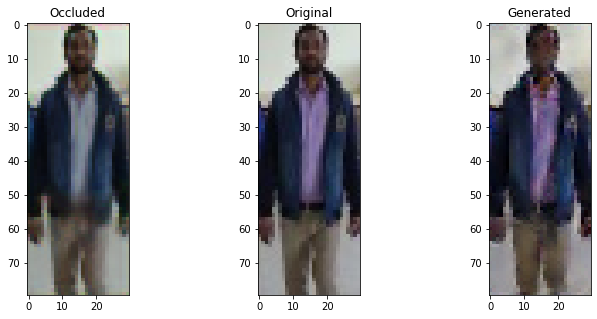

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


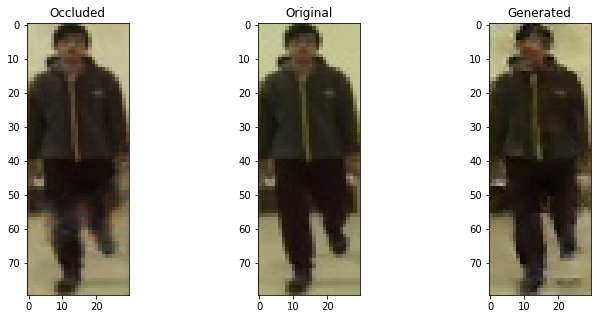

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


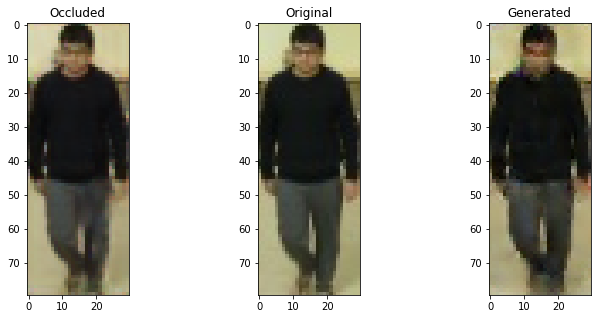

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


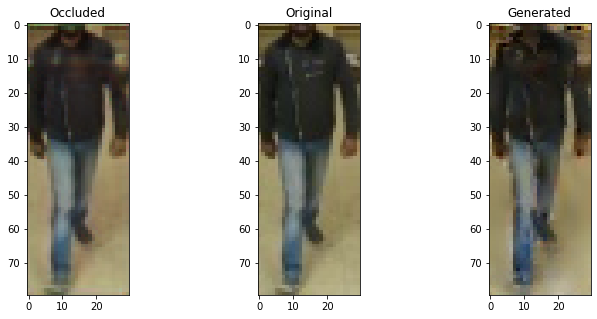

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


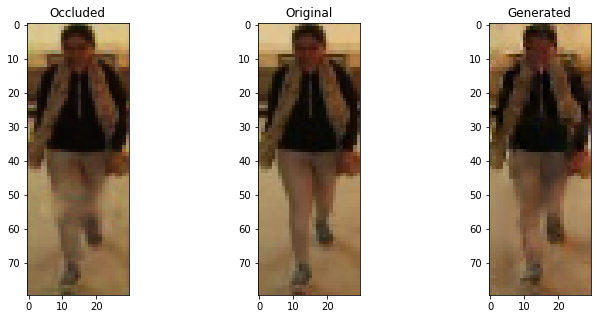

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.629740834236145 , Adversarial Loss:  0.0005974731175228953
Epoch 2062


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6328784823417664 , Adversarial Loss:  0.000536239764187485
Epoch 2063


  8%|▊         | 1/13 [00:00<00:01,  6.65it/s]

Discriminator Loss:  0.6397654414176941 , Adversarial Loss:  0.0005971001228317618
Epoch 2064


  8%|▊         | 1/13 [00:00<00:01,  6.20it/s]

Discriminator Loss:  0.6919392347335815 , Adversarial Loss:  0.0006250106380321085
Epoch 2065


  8%|▊         | 1/13 [00:00<00:01,  6.13it/s]

Discriminator Loss:  0.6524213552474976 , Adversarial Loss:  0.0006182575016282499
Epoch 2066


  8%|▊         | 1/13 [00:00<00:01,  6.21it/s]

Discriminator Loss:  0.6582967042922974 , Adversarial Loss:  0.0005279242759570479
Epoch 2067


  8%|▊         | 1/13 [00:00<00:01,  6.55it/s]

Discriminator Loss:  0.6588999032974243 , Adversarial Loss:  0.0005691131809726357
Epoch 2068


  8%|▊         | 1/13 [00:00<00:01,  6.04it/s]

Discriminator Loss:  0.6558569669723511 , Adversarial Loss:  0.0005647766520269215
Epoch 2069


  8%|▊         | 1/13 [00:00<00:01,  6.24it/s]

Discriminator Loss:  0.6906536817550659 , Adversarial Loss:  0.0005629804218187928
Epoch 2070


  8%|▊         | 1/13 [00:00<00:01,  6.63it/s]

Discriminator Loss:  0.6742241382598877 , Adversarial Loss:  0.0005288884276524186
Epoch 2071


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6415689587593079 , Adversarial Loss:  0.0005460009560920298
Epoch 2072


  8%|▊         | 1/13 [00:00<00:01,  6.14it/s]

Discriminator Loss:  0.6453461647033691 , Adversarial Loss:  0.0005701381014660001
Epoch 2073


  8%|▊         | 1/13 [00:00<00:02,  5.71it/s]

Discriminator Loss:  0.6473885178565979 , Adversarial Loss:  0.0006095409044064581
Epoch 2074


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6414060592651367 , Adversarial Loss:  0.0005058962851762772
Epoch 2075


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6395524144172668 , Adversarial Loss:  0.0005576340481638908
Epoch 2076


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6725574731826782 , Adversarial Loss:  0.0005329321138560772
Epoch 2077


  8%|▊         | 1/13 [00:00<00:01,  6.09it/s]

Discriminator Loss:  0.6547034978866577 , Adversarial Loss:  0.000536189298145473
Epoch 2078


  8%|▊         | 1/13 [00:00<00:02,  5.87it/s]

Discriminator Loss:  0.6560662388801575 , Adversarial Loss:  0.0005635180277749896
Epoch 2079


  8%|▊         | 1/13 [00:00<00:01,  6.30it/s]

Discriminator Loss:  0.6569011211395264 , Adversarial Loss:  0.0005549469497054815
Epoch 2080


  8%|▊         | 1/13 [00:00<00:01,  6.48it/s]

Discriminator Loss:  0.6432369351387024 , Adversarial Loss:  0.0005590985529124737
Epoch 2081


100%|██████████| 13/13 [00:02<00:00,  6.20it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


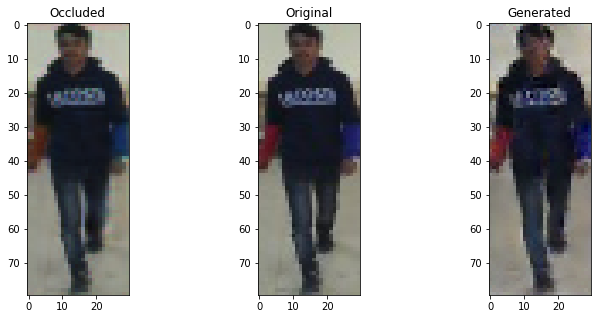

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


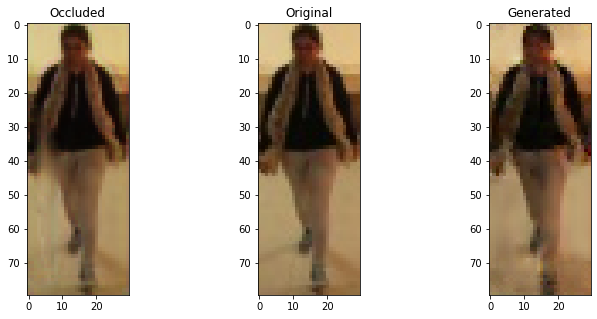

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


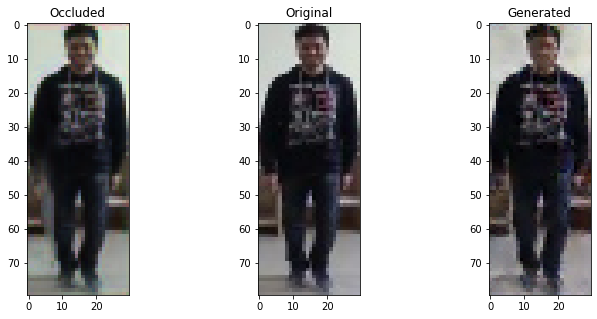

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


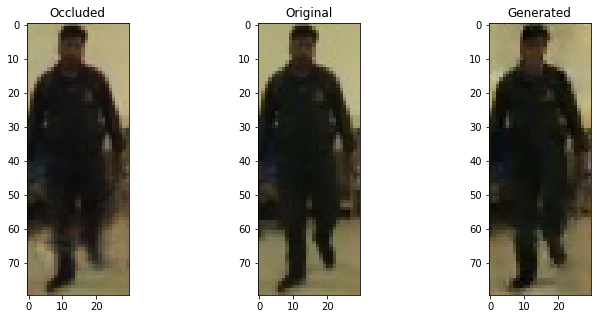

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


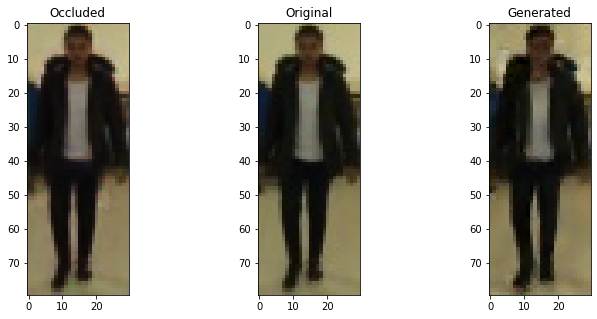

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6444422602653503 , Adversarial Loss:  0.0004951223963871598
Epoch 2082


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6771044731140137 , Adversarial Loss:  0.0005303601501509547
Epoch 2083


  8%|▊         | 1/13 [00:00<00:01,  6.60it/s]

Discriminator Loss:  0.6405290365219116 , Adversarial Loss:  0.0005524288862943649
Epoch 2084


  8%|▊         | 1/13 [00:00<00:01,  6.60it/s]

Discriminator Loss:  0.666398286819458 , Adversarial Loss:  0.0005261747865006328
Epoch 2085


  8%|▊         | 1/13 [00:00<00:01,  6.56it/s]

Discriminator Loss:  0.6656725406646729 , Adversarial Loss:  0.0005117292166687548
Epoch 2086


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6479588747024536 , Adversarial Loss:  0.0005037191440351307
Epoch 2087


  8%|▊         | 1/13 [00:00<00:02,  5.22it/s]

Discriminator Loss:  0.6590613126754761 , Adversarial Loss:  0.0005356329493224621
Epoch 2088


  8%|▊         | 1/13 [00:00<00:01,  6.32it/s]

Discriminator Loss:  0.6609704494476318 , Adversarial Loss:  0.0004949299618601799
Epoch 2089


  8%|▊         | 1/13 [00:00<00:01,  6.85it/s]

Discriminator Loss:  0.653531551361084 , Adversarial Loss:  0.0005168878706172109
Epoch 2090


  8%|▊         | 1/13 [00:00<00:01,  6.49it/s]

Discriminator Loss:  0.6653692126274109 , Adversarial Loss:  0.000538004154805094
Epoch 2091


  8%|▊         | 1/13 [00:00<00:01,  6.25it/s]

Discriminator Loss:  0.6552836298942566 , Adversarial Loss:  0.0005233875708654523
Epoch 2092


  8%|▊         | 1/13 [00:00<00:01,  6.84it/s]

Discriminator Loss:  0.6679666042327881 , Adversarial Loss:  0.00045669174869544804
Epoch 2093


  8%|▊         | 1/13 [00:00<00:01,  6.34it/s]

Discriminator Loss:  0.6673973798751831 , Adversarial Loss:  0.0004960577352903783
Epoch 2094


  8%|▊         | 1/13 [00:00<00:01,  6.89it/s]

Discriminator Loss:  0.6516193151473999 , Adversarial Loss:  0.0004889590200036764
Epoch 2095


  8%|▊         | 1/13 [00:00<00:01,  6.39it/s]

Discriminator Loss:  0.6500648856163025 , Adversarial Loss:  0.0005314499721862376
Epoch 2096


  8%|▊         | 1/13 [00:00<00:02,  5.98it/s]

Discriminator Loss:  0.6389390230178833 , Adversarial Loss:  0.0004982756217941642
Epoch 2097


  8%|▊         | 1/13 [00:00<00:01,  6.63it/s]

Discriminator Loss:  0.6620904207229614 , Adversarial Loss:  0.0004642719286493957
Epoch 2098


  8%|▊         | 1/13 [00:00<00:01,  6.73it/s]

Discriminator Loss:  0.6619579792022705 , Adversarial Loss:  0.00043825514148920774
Epoch 2099


  8%|▊         | 1/13 [00:00<00:01,  6.06it/s]

Discriminator Loss:  0.6597913503646851 , Adversarial Loss:  0.0004713886009994894
Epoch 2100


  8%|▊         | 1/13 [00:00<00:01,  6.65it/s]

Discriminator Loss:  0.662998378276825 , Adversarial Loss:  0.0005340721108950675
Epoch 2101


100%|██████████| 13/13 [00:02<00:00,  6.08it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


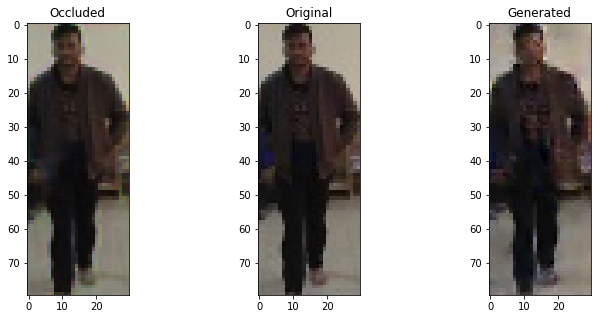

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


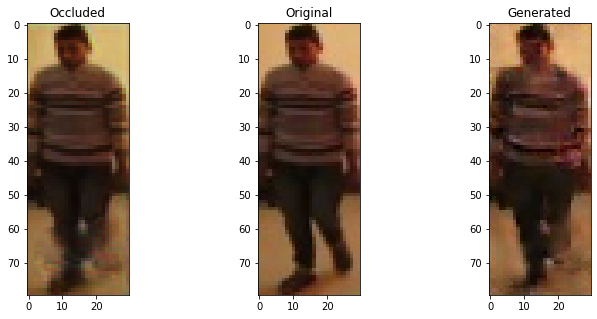

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


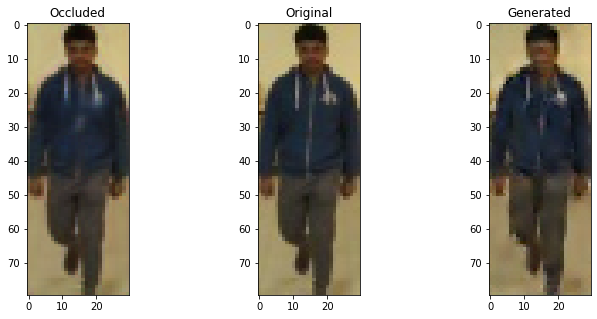

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


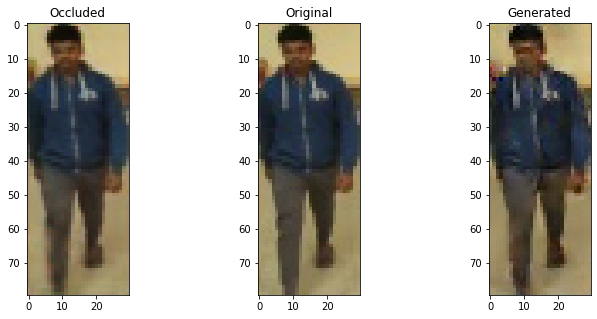

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


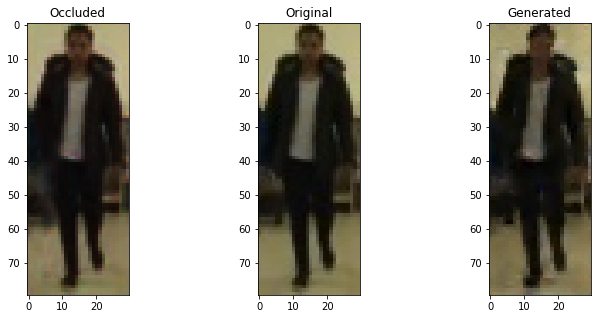

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6754229664802551 , Adversarial Loss:  0.0004904043744318187
Epoch 2102


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6390874981880188 , Adversarial Loss:  0.0005291701527312398
Epoch 2103


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6595321297645569 , Adversarial Loss:  0.00047910233843140304
Epoch 2104


  8%|▊         | 1/13 [00:00<00:01,  6.56it/s]

Discriminator Loss:  0.6450251936912537 , Adversarial Loss:  0.00046486733481287956
Epoch 2105


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6492081880569458 , Adversarial Loss:  0.00043399404967203736
Epoch 2106


  8%|▊         | 1/13 [00:00<00:01,  6.35it/s]

Discriminator Loss:  0.654296338558197 , Adversarial Loss:  0.000513555365614593
Epoch 2107


  8%|▊         | 1/13 [00:00<00:01,  6.20it/s]

Discriminator Loss:  0.6536538600921631 , Adversarial Loss:  0.0004506548575591296
Epoch 2108


  8%|▊         | 1/13 [00:00<00:02,  5.88it/s]

Discriminator Loss:  0.6693601608276367 , Adversarial Loss:  0.0005138276610523462
Epoch 2109


  8%|▊         | 1/13 [00:00<00:02,  5.11it/s]

Discriminator Loss:  0.6440831422805786 , Adversarial Loss:  0.0004306060145609081
Epoch 2110


  8%|▊         | 1/13 [00:00<00:02,  5.57it/s]

Discriminator Loss:  0.629822313785553 , Adversarial Loss:  0.0005031753098592162
Epoch 2111


  8%|▊         | 1/13 [00:00<00:02,  5.19it/s]

Discriminator Loss:  0.6595429182052612 , Adversarial Loss:  0.0005016066133975983
Epoch 2112


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6457059383392334 , Adversarial Loss:  0.00047617664677090943
Epoch 2113


  8%|▊         | 1/13 [00:00<00:02,  5.45it/s]

Discriminator Loss:  0.6559879779815674 , Adversarial Loss:  0.0004454870941117406
Epoch 2114


  8%|▊         | 1/13 [00:00<00:02,  5.75it/s]

Discriminator Loss:  0.6470569372177124 , Adversarial Loss:  0.0004622629494406283
Epoch 2115


  8%|▊         | 1/13 [00:00<00:01,  6.14it/s]

Discriminator Loss:  0.6484284400939941 , Adversarial Loss:  0.0004969686269760132
Epoch 2116


  8%|▊         | 1/13 [00:00<00:01,  6.21it/s]

Discriminator Loss:  0.6544914245605469 , Adversarial Loss:  0.0004751206433866173
Epoch 2117


  8%|▊         | 1/13 [00:00<00:01,  6.17it/s]

Discriminator Loss:  0.6577315330505371 , Adversarial Loss:  0.00048519467236474156
Epoch 2118


  8%|▊         | 1/13 [00:00<00:02,  5.12it/s]

Discriminator Loss:  0.6687858700752258 , Adversarial Loss:  0.00046411543735302985
Epoch 2119


  8%|▊         | 1/13 [00:00<00:01,  6.50it/s]

Discriminator Loss:  0.633316159248352 , Adversarial Loss:  0.00048343351227231324
Epoch 2120


  8%|▊         | 1/13 [00:00<00:01,  6.70it/s]

Discriminator Loss:  0.6773245930671692 , Adversarial Loss:  0.00045939546544104815
Epoch 2121


100%|██████████| 13/13 [00:02<00:00,  5.92it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


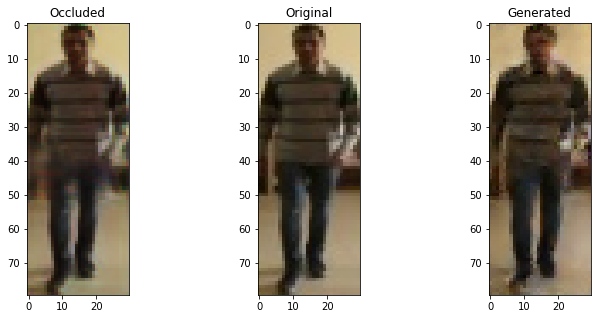

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


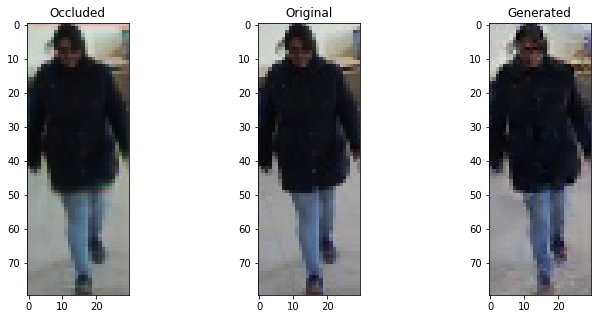

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


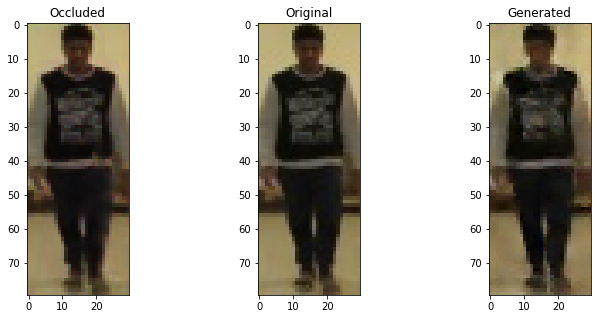

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


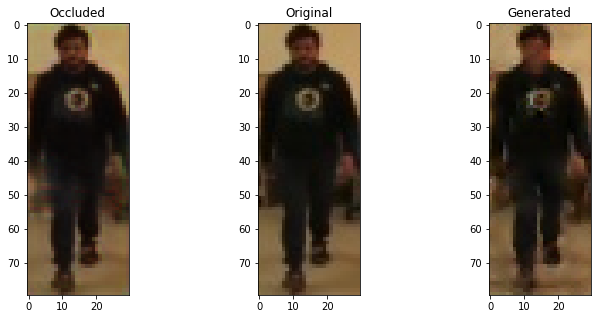

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


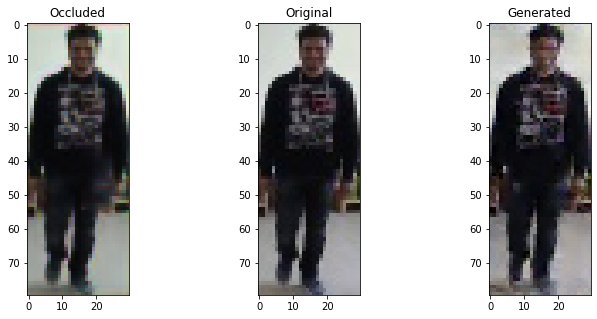

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6370962858200073 , Adversarial Loss:  0.00049946567742154
Epoch 2122


  8%|▊         | 1/13 [00:00<00:01,  6.61it/s]

Discriminator Loss:  0.6672655344009399 , Adversarial Loss:  0.0004674896481446922
Epoch 2123


  8%|▊         | 1/13 [00:00<00:01,  6.81it/s]

Discriminator Loss:  0.6404650211334229 , Adversarial Loss:  0.0004853110294789076
Epoch 2124


  8%|▊         | 1/13 [00:00<00:01,  6.67it/s]

Discriminator Loss:  0.6685025691986084 , Adversarial Loss:  0.0004612869815900922
Epoch 2125


  8%|▊         | 1/13 [00:00<00:01,  6.97it/s]

Discriminator Loss:  0.664242684841156 , Adversarial Loss:  0.0004209242179058492
Epoch 2126


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6473755240440369 , Adversarial Loss:  0.0004940044600516558
Epoch 2127


  8%|▊         | 1/13 [00:00<00:01,  6.60it/s]

Discriminator Loss:  0.6470237374305725 , Adversarial Loss:  0.0004632755008060485
Epoch 2128


  8%|▊         | 1/13 [00:00<00:01,  6.18it/s]

Discriminator Loss:  0.6863621473312378 , Adversarial Loss:  0.0004915529862046242
Epoch 2129


  8%|▊         | 1/13 [00:00<00:01,  6.48it/s]

Discriminator Loss:  0.6564267873764038 , Adversarial Loss:  0.00043108605314046144
Epoch 2130


  8%|▊         | 1/13 [00:00<00:01,  6.89it/s]

Discriminator Loss:  0.6406404972076416 , Adversarial Loss:  0.00042856213985942304
Epoch 2131


  8%|▊         | 1/13 [00:00<00:01,  6.73it/s]

Discriminator Loss:  0.6578460931777954 , Adversarial Loss:  0.0004324471519794315
Epoch 2132


  8%|▊         | 1/13 [00:00<00:01,  6.65it/s]

Discriminator Loss:  0.6497942209243774 , Adversarial Loss:  0.000512469036038965
Epoch 2133


  8%|▊         | 1/13 [00:00<00:01,  6.08it/s]

Discriminator Loss:  0.6606558561325073 , Adversarial Loss:  0.00041626099846325815
Epoch 2134


  8%|▊         | 1/13 [00:00<00:01,  6.53it/s]

Discriminator Loss:  0.6528066396713257 , Adversarial Loss:  0.00047301038284786046
Epoch 2135


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6484683156013489 , Adversarial Loss:  0.0004387404187582433
Epoch 2136


  8%|▊         | 1/13 [00:00<00:02,  5.02it/s]

Discriminator Loss:  0.6432727575302124 , Adversarial Loss:  0.00045987567864358425
Epoch 2137


  8%|▊         | 1/13 [00:00<00:01,  6.48it/s]

Discriminator Loss:  0.6687390804290771 , Adversarial Loss:  0.0004621372791007161
Epoch 2138


  8%|▊         | 1/13 [00:00<00:01,  6.23it/s]

Discriminator Loss:  0.617152750492096 , Adversarial Loss:  0.0004665315500460565
Epoch 2139


  8%|▊         | 1/13 [00:00<00:01,  6.70it/s]

Discriminator Loss:  0.6805171966552734 , Adversarial Loss:  0.0004825171490665525
Epoch 2140


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6384581923484802 , Adversarial Loss:  0.0004326067282818258
Epoch 2141


100%|██████████| 13/13 [00:02<00:00,  6.02it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


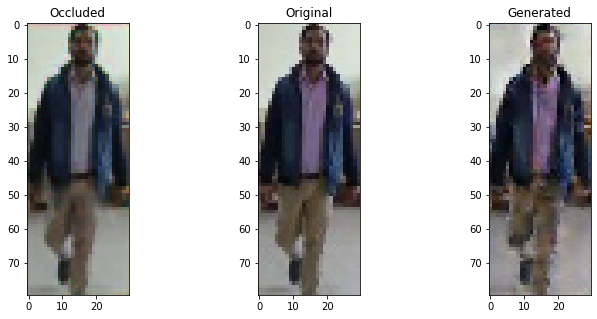

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


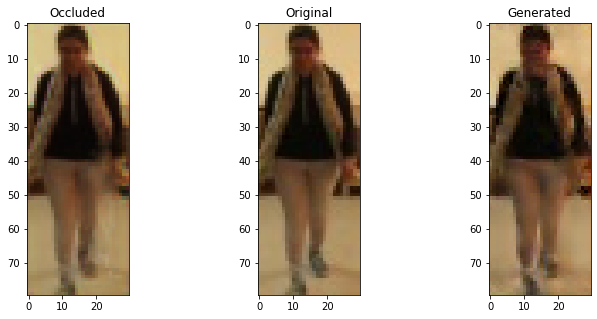

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


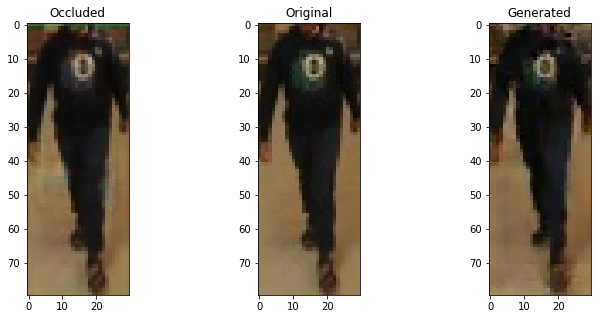

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


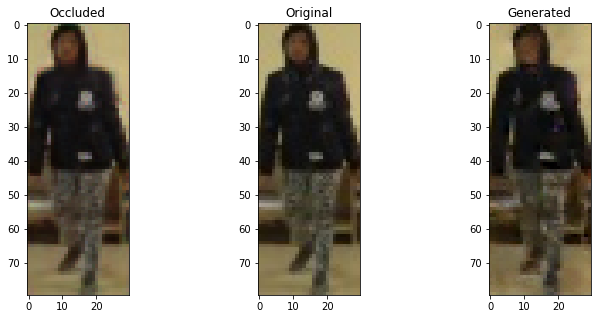

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


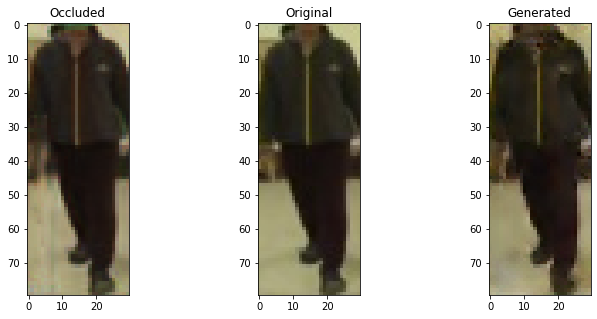

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.66799396276474 , Adversarial Loss:  0.00045435389620251954
Epoch 2142


  8%|▊         | 1/13 [00:00<00:01,  6.65it/s]

Discriminator Loss:  0.6517559885978699 , Adversarial Loss:  0.00040411693044006824
Epoch 2143


  8%|▊         | 1/13 [00:00<00:01,  6.34it/s]

Discriminator Loss:  0.6655668020248413 , Adversarial Loss:  0.0004351286916062236
Epoch 2144


  8%|▊         | 1/13 [00:00<00:01,  6.72it/s]

Discriminator Loss:  0.6383252739906311 , Adversarial Loss:  0.0004747954662889242
Epoch 2145


  8%|▊         | 1/13 [00:00<00:01,  6.39it/s]

Discriminator Loss:  0.6533644795417786 , Adversarial Loss:  0.0004621056723408401
Epoch 2146


  8%|▊         | 1/13 [00:00<00:02,  5.83it/s]

Discriminator Loss:  0.6625912189483643 , Adversarial Loss:  0.00043757579987868667
Epoch 2147


  8%|▊         | 1/13 [00:00<00:01,  6.79it/s]

Discriminator Loss:  0.6508359909057617 , Adversarial Loss:  0.00041920202784240246
Epoch 2148


  8%|▊         | 1/13 [00:00<00:02,  5.99it/s]

Discriminator Loss:  0.6670780777931213 , Adversarial Loss:  0.00045774903264828026
Epoch 2149


  8%|▊         | 1/13 [00:00<00:01,  6.72it/s]

Discriminator Loss:  0.6552358865737915 , Adversarial Loss:  0.00044558808440342546
Epoch 2150


  8%|▊         | 1/13 [00:00<00:01,  6.07it/s]

Discriminator Loss:  0.6914852857589722 , Adversarial Loss:  0.000420812692027539
Epoch 2151


  8%|▊         | 1/13 [00:00<00:01,  6.88it/s]

Discriminator Loss:  0.6653803586959839 , Adversarial Loss:  0.0005015385686419904
Epoch 2152


  8%|▊         | 1/13 [00:00<00:02,  5.42it/s]

Discriminator Loss:  0.6518028378486633 , Adversarial Loss:  0.0004348131187725812
Epoch 2153


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6400359272956848 , Adversarial Loss:  0.00045640498865395784
Epoch 2154


  8%|▊         | 1/13 [00:00<00:01,  6.70it/s]

Discriminator Loss:  0.6712129712104797 , Adversarial Loss:  0.00043879670556634665
Epoch 2155


  8%|▊         | 1/13 [00:00<00:01,  6.37it/s]

Discriminator Loss:  0.6790785193443298 , Adversarial Loss:  0.000457802030723542
Epoch 2156


  8%|▊         | 1/13 [00:00<00:01,  6.42it/s]

Discriminator Loss:  0.6672900915145874 , Adversarial Loss:  0.0004465222009457648
Epoch 2157


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6660010814666748 , Adversarial Loss:  0.0004868688411079347
Epoch 2158


  8%|▊         | 1/13 [00:00<00:02,  5.42it/s]

Discriminator Loss:  0.6573003530502319 , Adversarial Loss:  0.0004115344490855932
Epoch 2159


  8%|▊         | 1/13 [00:00<00:01,  6.48it/s]

Discriminator Loss:  0.6534672975540161 , Adversarial Loss:  0.00045692542335018516
Epoch 2160


  8%|▊         | 1/13 [00:00<00:01,  6.80it/s]

Discriminator Loss:  0.6492094993591309 , Adversarial Loss:  0.00043471981189213693
Epoch 2161


100%|██████████| 13/13 [00:02<00:00,  6.22it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


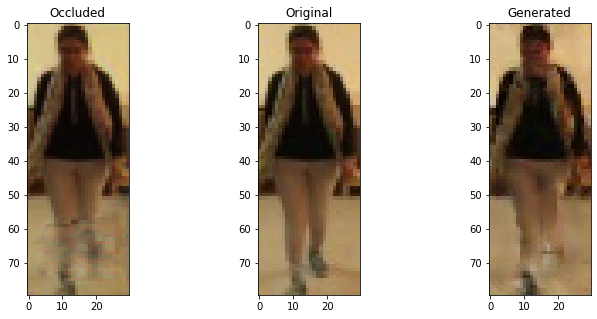

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


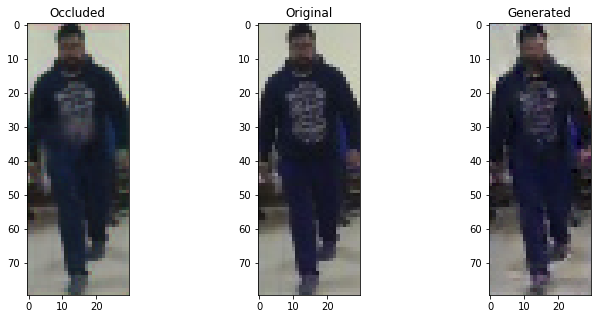

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


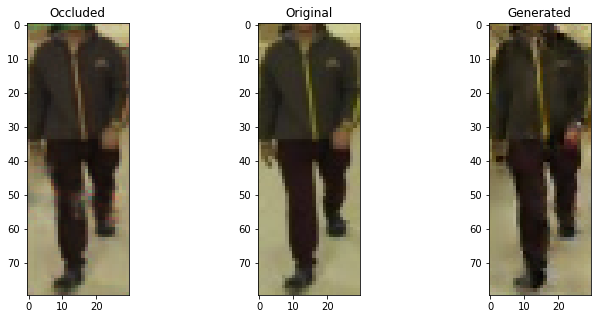

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


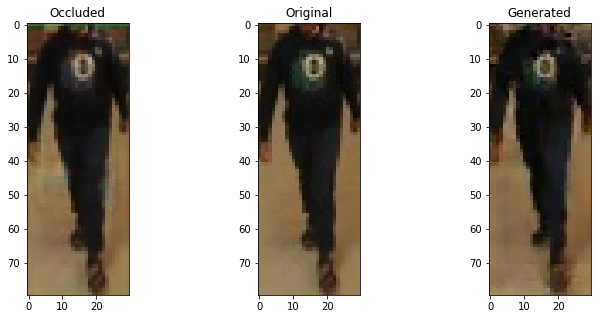

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


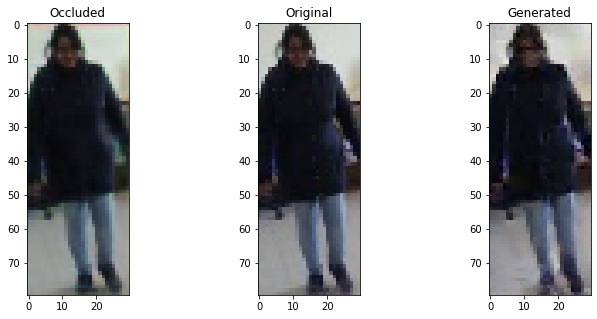

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6439989805221558 , Adversarial Loss:  0.00042733404552564025
Epoch 2162


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6540102958679199 , Adversarial Loss:  0.00042325182585045695
Epoch 2163


  8%|▊         | 1/13 [00:00<00:01,  6.28it/s]

Discriminator Loss:  0.6590684652328491 , Adversarial Loss:  0.0004465034871827811
Epoch 2164


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6457223892211914 , Adversarial Loss:  0.0005384626565501094
Epoch 2165


  8%|▊         | 1/13 [00:00<00:01,  6.51it/s]

Discriminator Loss:  0.6649704575538635 , Adversarial Loss:  0.0004760110459756106
Epoch 2166


  8%|▊         | 1/13 [00:00<00:01,  6.35it/s]

Discriminator Loss:  0.6421157717704773 , Adversarial Loss:  0.0005103981820866466
Epoch 2167


  8%|▊         | 1/13 [00:00<00:01,  6.52it/s]

Discriminator Loss:  0.6467416286468506 , Adversarial Loss:  0.0003917708818335086
Epoch 2168


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6727703809738159 , Adversarial Loss:  0.0004330892988946289
Epoch 2169


  8%|▊         | 1/13 [00:00<00:02,  5.39it/s]

Discriminator Loss:  0.6525734066963196 , Adversarial Loss:  0.0004519577487371862
Epoch 2170


  8%|▊         | 1/13 [00:00<00:02,  5.80it/s]

Discriminator Loss:  0.6731981635093689 , Adversarial Loss:  0.0004098318750038743
Epoch 2171


  8%|▊         | 1/13 [00:00<00:01,  6.01it/s]

Discriminator Loss:  0.6738942861557007 , Adversarial Loss:  0.00046449393266811967
Epoch 2172


  8%|▊         | 1/13 [00:00<00:01,  6.63it/s]

Discriminator Loss:  0.6426860094070435 , Adversarial Loss:  0.0004466001992113888
Epoch 2173


  8%|▊         | 1/13 [00:00<00:01,  6.62it/s]

Discriminator Loss:  0.656521201133728 , Adversarial Loss:  0.00042876493535004556
Epoch 2174


  8%|▊         | 1/13 [00:00<00:01,  6.46it/s]

Discriminator Loss:  0.6740955114364624 , Adversarial Loss:  0.0004648397443816066
Epoch 2175


  8%|▊         | 1/13 [00:00<00:01,  6.83it/s]

Discriminator Loss:  0.6529096961021423 , Adversarial Loss:  0.00045701477210968733
Epoch 2176


  8%|▊         | 1/13 [00:00<00:01,  6.74it/s]

Discriminator Loss:  0.6425982713699341 , Adversarial Loss:  0.0004981502424925566
Epoch 2177


  8%|▊         | 1/13 [00:00<00:01,  6.92it/s]

Discriminator Loss:  0.6625005006790161 , Adversarial Loss:  0.0004571877943817526
Epoch 2178


  8%|▊         | 1/13 [00:00<00:01,  6.20it/s]

Discriminator Loss:  0.6620492935180664 , Adversarial Loss:  0.0003861920558847487
Epoch 2179


  8%|▊         | 1/13 [00:00<00:01,  6.48it/s]

Discriminator Loss:  0.6678473949432373 , Adversarial Loss:  0.00044620438711717725
Epoch 2180


  8%|▊         | 1/13 [00:00<00:02,  5.98it/s]

Discriminator Loss:  0.6633998155593872 , Adversarial Loss:  0.0004296773986425251
Epoch 2181


100%|██████████| 13/13 [00:02<00:00,  6.20it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


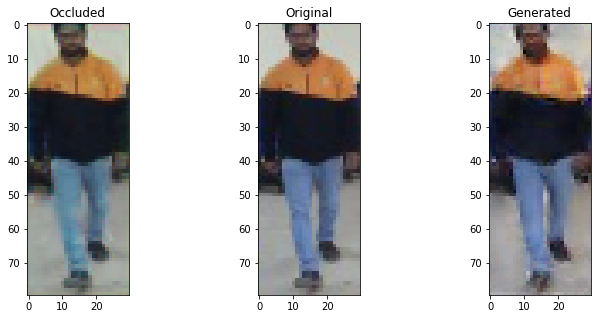

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


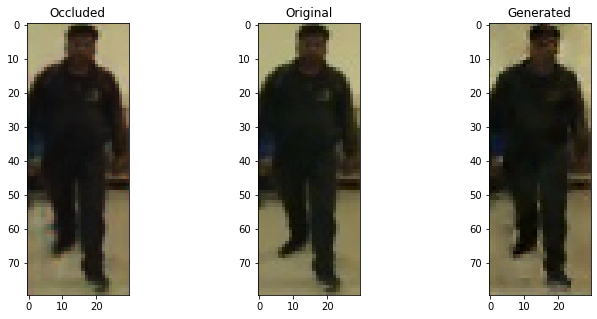

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


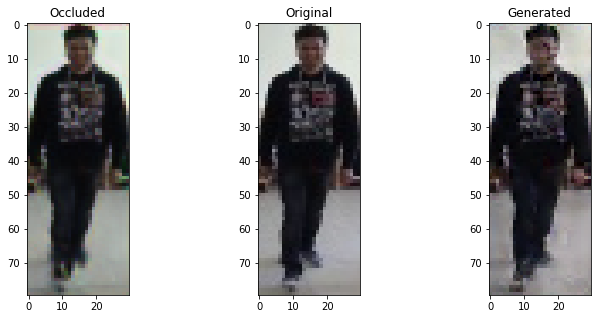

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


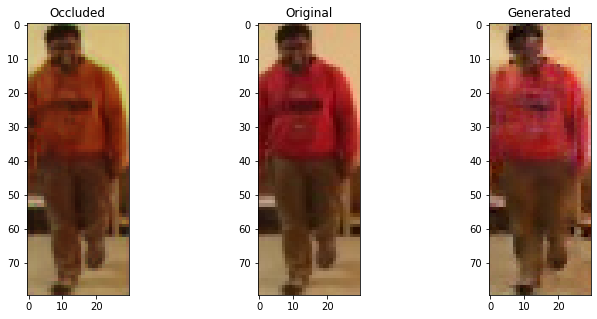

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


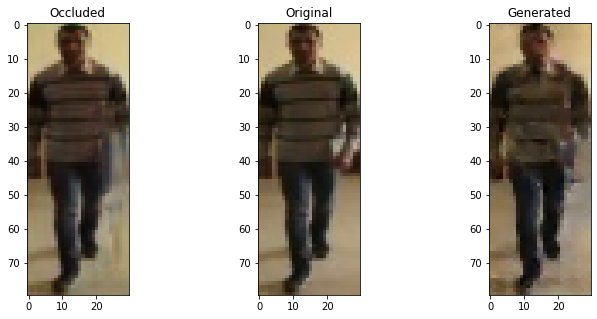

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6506081223487854 , Adversarial Loss:  0.0004078643396496773
Epoch 2182


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6401490569114685 , Adversarial Loss:  0.0004693716182373464
Epoch 2183


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6959457397460938 , Adversarial Loss:  0.0004917618352919817
Epoch 2184


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6289004683494568 , Adversarial Loss:  0.0004405628424137831
Epoch 2185


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6480135917663574 , Adversarial Loss:  0.0004252356884535402
Epoch 2186


  8%|▊         | 1/13 [00:00<00:02,  5.71it/s]

Discriminator Loss:  0.6639752388000488 , Adversarial Loss:  0.0004312180681154132
Epoch 2187


  8%|▊         | 1/13 [00:00<00:02,  5.82it/s]

Discriminator Loss:  0.6437381505966187 , Adversarial Loss:  0.00038255940307863057
Epoch 2188


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6426721811294556 , Adversarial Loss:  0.00042980152647942305
Epoch 2189


  8%|▊         | 1/13 [00:00<00:01,  6.65it/s]

Discriminator Loss:  0.6798815131187439 , Adversarial Loss:  0.0004251399077475071
Epoch 2190


  8%|▊         | 1/13 [00:00<00:01,  6.24it/s]

Discriminator Loss:  0.636768639087677 , Adversarial Loss:  0.00046859163558110595
Epoch 2191


  8%|▊         | 1/13 [00:00<00:02,  5.36it/s]

Discriminator Loss:  0.6525044441223145 , Adversarial Loss:  0.0004222480347380042
Epoch 2192


  8%|▊         | 1/13 [00:00<00:01,  6.67it/s]

Discriminator Loss:  0.6520829796791077 , Adversarial Loss:  0.00045722484355792403
Epoch 2193


  8%|▊         | 1/13 [00:00<00:01,  6.57it/s]

Discriminator Loss:  0.653032660484314 , Adversarial Loss:  0.0004452681168913841
Epoch 2194


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.66722571849823 , Adversarial Loss:  0.00041522469837218523
Epoch 2195


  8%|▊         | 1/13 [00:00<00:02,  5.57it/s]

Discriminator Loss:  0.6644608378410339 , Adversarial Loss:  0.00038062024395912886
Epoch 2196


  8%|▊         | 1/13 [00:00<00:01,  6.28it/s]

Discriminator Loss:  0.6575419902801514 , Adversarial Loss:  0.00042067718459293246
Epoch 2197


  8%|▊         | 1/13 [00:00<00:02,  5.33it/s]

Discriminator Loss:  0.6805652379989624 , Adversarial Loss:  0.0004264884628355503
Epoch 2198


  8%|▊         | 1/13 [00:00<00:01,  6.72it/s]

Discriminator Loss:  0.6804144978523254 , Adversarial Loss:  0.00044250814244151115
Epoch 2199


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6730926036834717 , Adversarial Loss:  0.0004018023028038442
Epoch 2200


  8%|▊         | 1/13 [00:00<00:01,  6.08it/s]

Discriminator Loss:  0.6569215059280396 , Adversarial Loss:  0.0003899357107002288
Epoch 2201


100%|██████████| 13/13 [00:02<00:00,  5.77it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


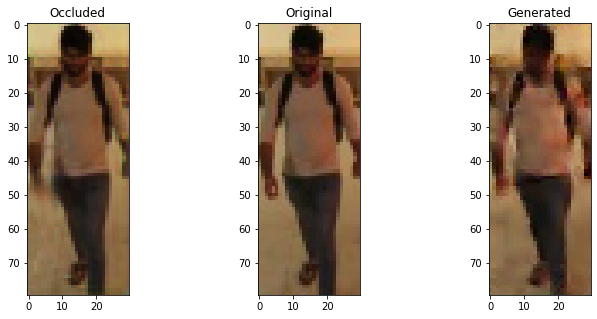

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


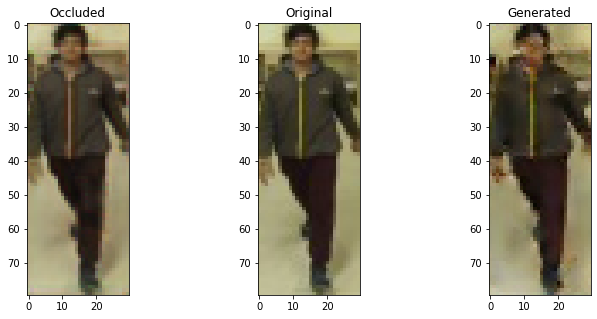

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


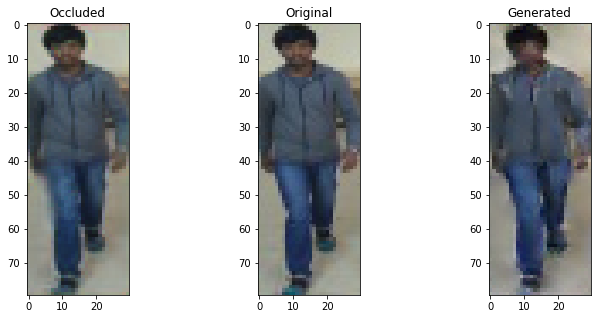

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


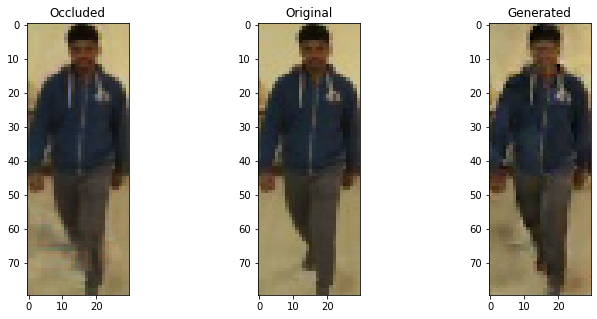

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


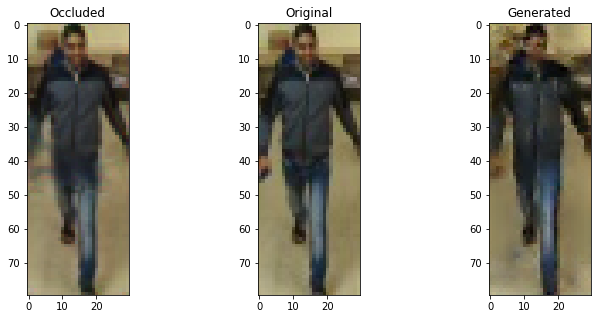

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6540035009384155 , Adversarial Loss:  0.00035363173810765147
Epoch 2202


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6610897779464722 , Adversarial Loss:  0.00042858030064962804
Epoch 2203


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6459622383117676 , Adversarial Loss:  0.00043351127533242106
Epoch 2204


  8%|▊         | 1/13 [00:00<00:01,  6.69it/s]

Discriminator Loss:  0.6659376621246338 , Adversarial Loss:  0.00041708553908392787
Epoch 2205


  8%|▊         | 1/13 [00:00<00:01,  6.05it/s]

Discriminator Loss:  0.6810020208358765 , Adversarial Loss:  0.00043612823355942965
Epoch 2206


  8%|▊         | 1/13 [00:00<00:01,  6.50it/s]

Discriminator Loss:  0.6367359757423401 , Adversarial Loss:  0.00036265410017222166
Epoch 2207


  8%|▊         | 1/13 [00:00<00:01,  6.78it/s]

Discriminator Loss:  0.666881799697876 , Adversarial Loss:  0.00043161428766325116
Epoch 2208


  8%|▊         | 1/13 [00:00<00:01,  6.54it/s]

Discriminator Loss:  0.6655200719833374 , Adversarial Loss:  0.00040054350392892957
Epoch 2209


  8%|▊         | 1/13 [00:00<00:01,  6.51it/s]

Discriminator Loss:  0.6550920009613037 , Adversarial Loss:  0.0004536404157988727
Epoch 2210


  8%|▊         | 1/13 [00:00<00:01,  6.58it/s]

Discriminator Loss:  0.6507443785667419 , Adversarial Loss:  0.0004191374755464494
Epoch 2211


  8%|▊         | 1/13 [00:00<00:01,  6.47it/s]

Discriminator Loss:  0.6669102907180786 , Adversarial Loss:  0.00044512830208987
Epoch 2212


  8%|▊         | 1/13 [00:00<00:01,  6.55it/s]

Discriminator Loss:  0.6554545164108276 , Adversarial Loss:  0.00043931682012043893
Epoch 2213


  8%|▊         | 1/13 [00:00<00:01,  6.72it/s]

Discriminator Loss:  0.6554195284843445 , Adversarial Loss:  0.00043718202505260706
Epoch 2214


  8%|▊         | 1/13 [00:00<00:01,  6.61it/s]

Discriminator Loss:  0.6651185750961304 , Adversarial Loss:  0.00039806647691875696
Epoch 2215


  8%|▊         | 1/13 [00:00<00:02,  5.77it/s]

Discriminator Loss:  0.6197830438613892 , Adversarial Loss:  0.0004104171530343592
Epoch 2216


  8%|▊         | 1/13 [00:00<00:01,  6.88it/s]

Discriminator Loss:  0.647723913192749 , Adversarial Loss:  0.0003869027132168412
Epoch 2217


  8%|▊         | 1/13 [00:00<00:01,  6.77it/s]

Discriminator Loss:  0.6436201333999634 , Adversarial Loss:  0.0003907091449946165
Epoch 2218


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6459762454032898 , Adversarial Loss:  0.0004328747163526714
Epoch 2219


  8%|▊         | 1/13 [00:00<00:01,  6.63it/s]

Discriminator Loss:  0.669370174407959 , Adversarial Loss:  0.0004132311441935599
Epoch 2220


  8%|▊         | 1/13 [00:00<00:01,  6.16it/s]

Discriminator Loss:  0.6595913171768188 , Adversarial Loss:  0.000393074267776683
Epoch 2221


100%|██████████| 13/13 [00:02<00:00,  6.08it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


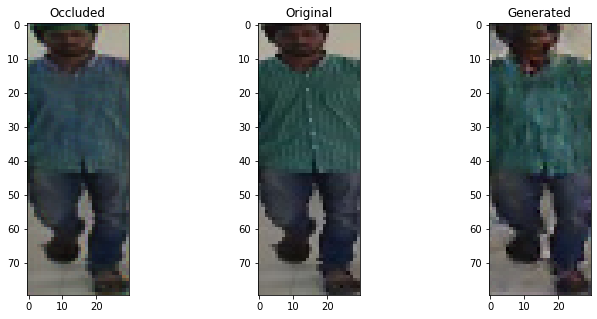

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


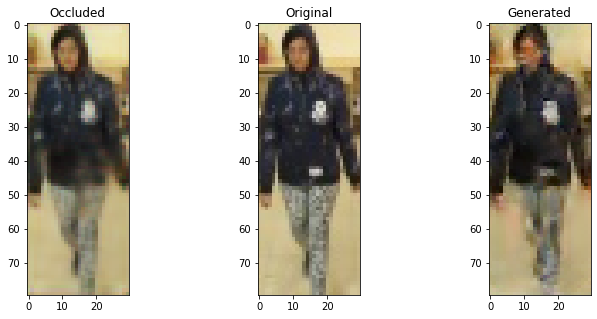

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


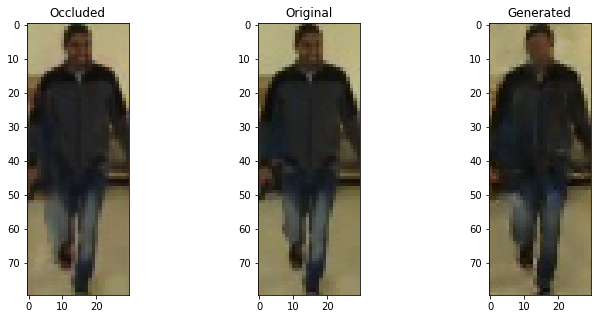

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


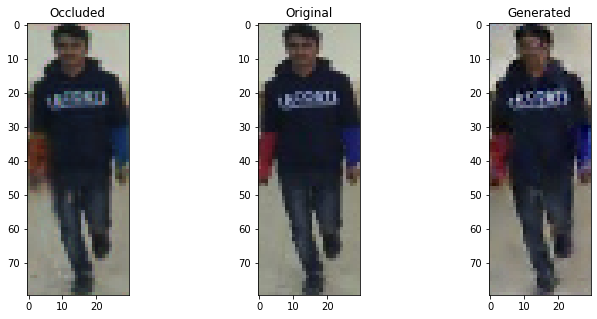

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


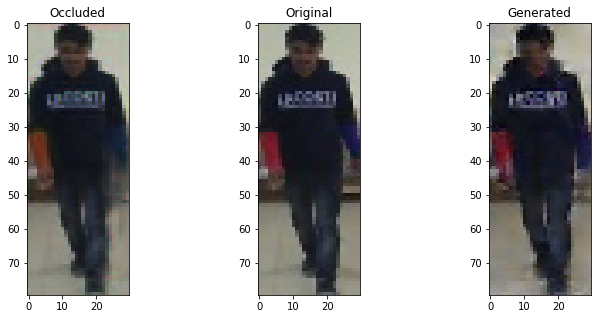

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.659675657749176 , Adversarial Loss:  0.0004266033647581935
Epoch 2222


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.682000994682312 , Adversarial Loss:  0.0004184864228591323
Epoch 2223


  8%|▊         | 1/13 [00:00<00:02,  5.51it/s]

Discriminator Loss:  0.674483060836792 , Adversarial Loss:  0.00041173904901370406
Epoch 2224


  8%|▊         | 1/13 [00:00<00:02,  5.16it/s]

Discriminator Loss:  0.6607832312583923 , Adversarial Loss:  0.0004090223810635507
Epoch 2225


  8%|▊         | 1/13 [00:00<00:01,  6.49it/s]

Discriminator Loss:  0.660836935043335 , Adversarial Loss:  0.0004364600754342973
Epoch 2226


  8%|▊         | 1/13 [00:00<00:01,  6.62it/s]

Discriminator Loss:  0.6768307685852051 , Adversarial Loss:  0.00042437968659214675
Epoch 2227


  8%|▊         | 1/13 [00:00<00:01,  6.64it/s]

Discriminator Loss:  0.6593053936958313 , Adversarial Loss:  0.0003864619939122349
Epoch 2228


  8%|▊         | 1/13 [00:00<00:02,  5.15it/s]

Discriminator Loss:  0.6705604791641235 , Adversarial Loss:  0.00039944061427377164
Epoch 2229


  8%|▊         | 1/13 [00:00<00:01,  6.02it/s]

Discriminator Loss:  0.6673907041549683 , Adversarial Loss:  0.00042605496128089726
Epoch 2230


  8%|▊         | 1/13 [00:00<00:01,  6.32it/s]

Discriminator Loss:  0.646378755569458 , Adversarial Loss:  0.00039873592322692275
Epoch 2231


  8%|▊         | 1/13 [00:00<00:01,  6.52it/s]

Discriminator Loss:  0.6696517467498779 , Adversarial Loss:  0.00037881743628531694
Epoch 2232


  8%|▊         | 1/13 [00:00<00:01,  6.45it/s]

Discriminator Loss:  0.6611363887786865 , Adversarial Loss:  0.0003837419208139181
Epoch 2233


  8%|▊         | 1/13 [00:00<00:01,  6.50it/s]

Discriminator Loss:  0.6658422946929932 , Adversarial Loss:  0.0003807383181992918
Epoch 2234


  8%|▊         | 1/13 [00:00<00:01,  6.49it/s]

Discriminator Loss:  0.6686596870422363 , Adversarial Loss:  0.00044034046004526317
Epoch 2235


  8%|▊         | 1/13 [00:00<00:01,  6.26it/s]

Discriminator Loss:  0.6672655344009399 , Adversarial Loss:  0.00041990645695477724
Epoch 2236


  8%|▊         | 1/13 [00:00<00:01,  6.50it/s]

Discriminator Loss:  0.6640310287475586 , Adversarial Loss:  0.00043094396824017167
Epoch 2237


  8%|▊         | 1/13 [00:00<00:01,  6.43it/s]

Discriminator Loss:  0.6578773260116577 , Adversarial Loss:  0.0003684747498482466
Epoch 2238


  8%|▊         | 1/13 [00:00<00:01,  6.50it/s]

Discriminator Loss:  0.6508979797363281 , Adversarial Loss:  0.0004422383790370077
Epoch 2239


  8%|▊         | 1/13 [00:00<00:01,  6.50it/s]

Discriminator Loss:  0.6807970404624939 , Adversarial Loss:  0.0004288309719413519
Epoch 2240


  8%|▊         | 1/13 [00:00<00:01,  6.19it/s]

Discriminator Loss:  0.6454046964645386 , Adversarial Loss:  0.00038892513839527965
Epoch 2241


100%|██████████| 13/13 [00:02<00:00,  5.68it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


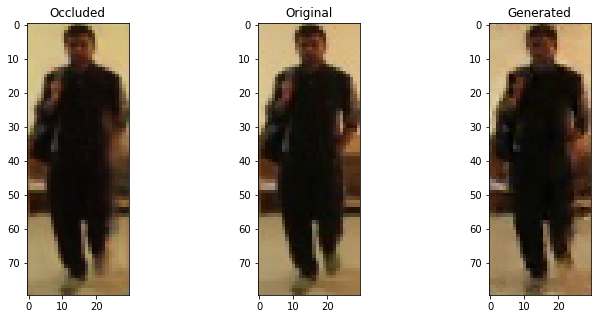

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


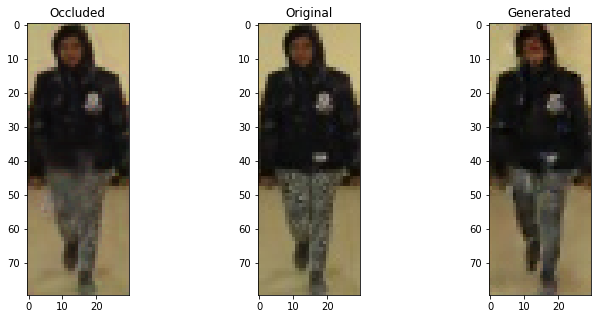

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


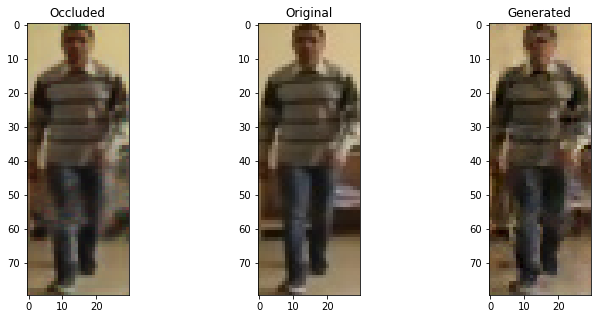

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


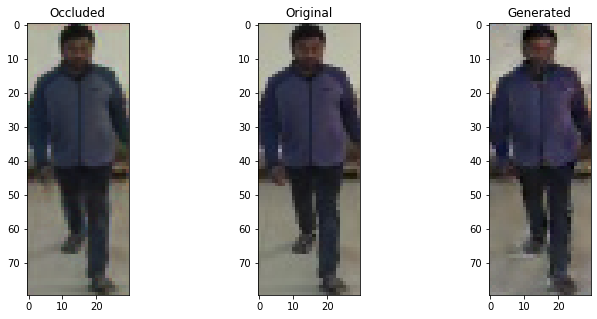

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


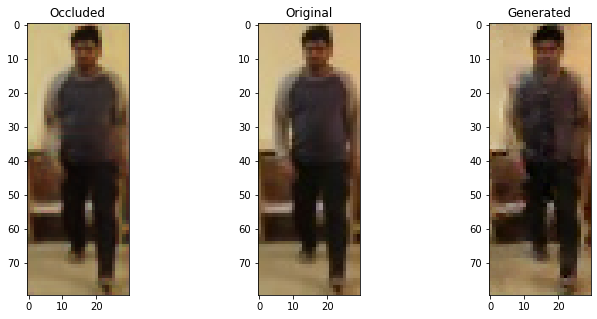

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6733865141868591 , Adversarial Loss:  0.0004017835308331996
Epoch 2242


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6375872492790222 , Adversarial Loss:  0.000403630081564188
Epoch 2243


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6421787142753601 , Adversarial Loss:  0.00041675398824736476
Epoch 2244


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6785438060760498 , Adversarial Loss:  0.0004211778286844492
Epoch 2245


  8%|▊         | 1/13 [00:00<00:01,  6.14it/s]

Discriminator Loss:  0.6579422950744629 , Adversarial Loss:  0.0004303115711081773
Epoch 2246


  8%|▊         | 1/13 [00:00<00:01,  6.38it/s]

Discriminator Loss:  0.6714193820953369 , Adversarial Loss:  0.00043571676360443234
Epoch 2247


  8%|▊         | 1/13 [00:00<00:01,  6.61it/s]

Discriminator Loss:  0.6614338755607605 , Adversarial Loss:  0.0004033148870803416
Epoch 2248


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6646692156791687 , Adversarial Loss:  0.0003855809336528182
Epoch 2249


  8%|▊         | 1/13 [00:00<00:02,  5.11it/s]

Discriminator Loss:  0.6643538475036621 , Adversarial Loss:  0.00039288573316298425
Epoch 2250


  8%|▊         | 1/13 [00:00<00:01,  6.44it/s]

Discriminator Loss:  0.6439197063446045 , Adversarial Loss:  0.0003686632262542844
Epoch 2251


  8%|▊         | 1/13 [00:00<00:02,  5.82it/s]

Discriminator Loss:  0.6288653612136841 , Adversarial Loss:  0.00040808378253132105
Epoch 2252


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6310593485832214 , Adversarial Loss:  0.00042110501090064645
Epoch 2253


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6580272912979126 , Adversarial Loss:  0.0004117462085559964
Epoch 2254


  8%|▊         | 1/13 [00:00<00:02,  5.86it/s]

Discriminator Loss:  0.6450965404510498 , Adversarial Loss:  0.0004518264322541654
Epoch 2255


  8%|▊         | 1/13 [00:00<00:01,  6.83it/s]

Discriminator Loss:  0.6423366069793701 , Adversarial Loss:  0.0003484721528366208
Epoch 2256


  8%|▊         | 1/13 [00:00<00:01,  6.60it/s]

Discriminator Loss:  0.6477511525154114 , Adversarial Loss:  0.00043950468534603715
Epoch 2257


  8%|▊         | 1/13 [00:00<00:01,  6.04it/s]

Discriminator Loss:  0.6716647148132324 , Adversarial Loss:  0.00042957335244864225
Epoch 2258


  8%|▊         | 1/13 [00:00<00:01,  6.40it/s]

Discriminator Loss:  0.6391138434410095 , Adversarial Loss:  0.0004146330466028303
Epoch 2259


  8%|▊         | 1/13 [00:00<00:01,  6.52it/s]

Discriminator Loss:  0.6285184621810913 , Adversarial Loss:  0.000424754194682464
Epoch 2260


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6450005173683167 , Adversarial Loss:  0.00038481998490169644
Epoch 2261


100%|██████████| 13/13 [00:02<00:00,  5.89it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


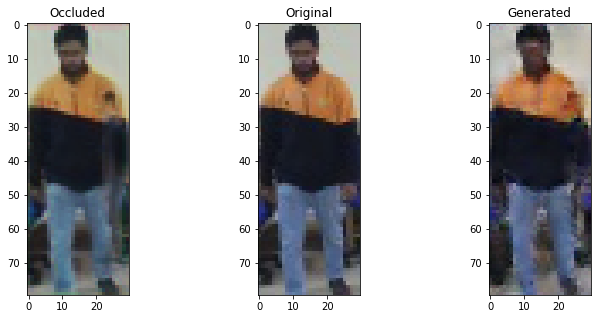

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


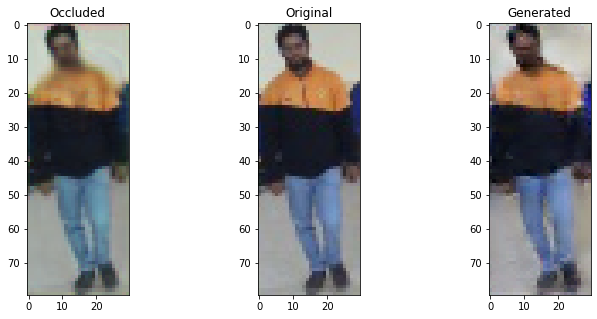

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


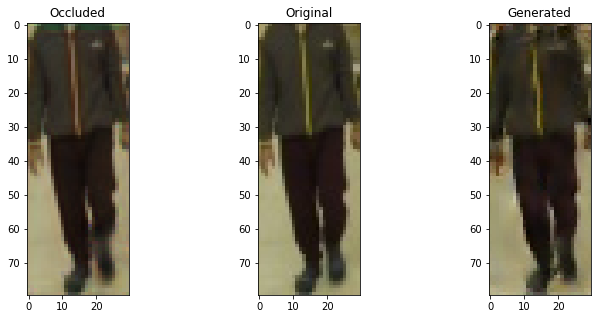

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


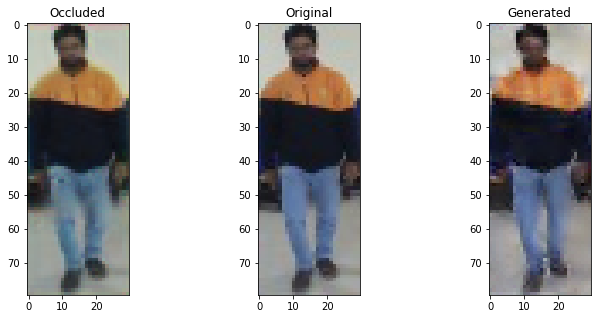

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


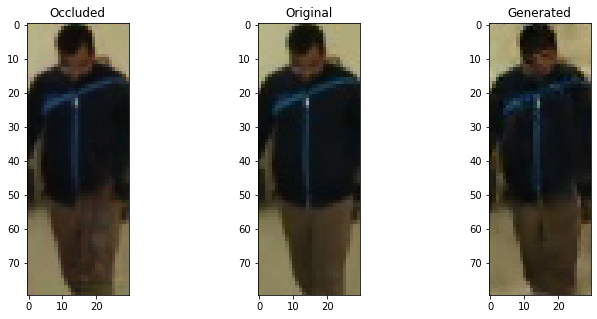

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6685731410980225 , Adversarial Loss:  0.00040264788549393415
Epoch 2262


  8%|▊         | 1/13 [00:00<00:01,  6.44it/s]

Discriminator Loss:  0.6987111568450928 , Adversarial Loss:  0.00037740563857369125
Epoch 2263


  8%|▊         | 1/13 [00:00<00:01,  6.52it/s]

Discriminator Loss:  0.6900083422660828 , Adversarial Loss:  0.0004078612837474793
Epoch 2264


  8%|▊         | 1/13 [00:00<00:02,  5.81it/s]

Discriminator Loss:  0.6518899202346802 , Adversarial Loss:  0.00043594581075012684
Epoch 2265


  8%|▊         | 1/13 [00:00<00:01,  6.52it/s]

Discriminator Loss:  0.6768873333930969 , Adversarial Loss:  0.00039757421473041177
Epoch 2266


  8%|▊         | 1/13 [00:00<00:02,  5.85it/s]

Discriminator Loss:  0.6409041881561279 , Adversarial Loss:  0.0004375806311145425
Epoch 2267


  8%|▊         | 1/13 [00:00<00:02,  5.72it/s]

Discriminator Loss:  0.6674662828445435 , Adversarial Loss:  0.00036181320319883525
Epoch 2268


  8%|▊         | 1/13 [00:00<00:02,  5.49it/s]

Discriminator Loss:  0.6674929857254028 , Adversarial Loss:  0.00044227350736036897
Epoch 2269


  8%|▊         | 1/13 [00:00<00:01,  6.72it/s]

Discriminator Loss:  0.6551648378372192 , Adversarial Loss:  0.00036530185025185347
Epoch 2270


  8%|▊         | 1/13 [00:00<00:01,  6.97it/s]

Discriminator Loss:  0.656536340713501 , Adversarial Loss:  0.00041847117245197296
Epoch 2271


  8%|▊         | 1/13 [00:00<00:01,  6.38it/s]

Discriminator Loss:  0.6651303768157959 , Adversarial Loss:  0.00040529726538807154
Epoch 2272


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6494550108909607 , Adversarial Loss:  0.00038610625779256225
Epoch 2273


  8%|▊         | 1/13 [00:00<00:01,  6.49it/s]

Discriminator Loss:  0.6624237895011902 , Adversarial Loss:  0.0004070134600624442
Epoch 2274


  8%|▊         | 1/13 [00:00<00:01,  6.26it/s]

Discriminator Loss:  0.6765885353088379 , Adversarial Loss:  0.000440681615145877
Epoch 2275


  8%|▊         | 1/13 [00:00<00:01,  6.43it/s]

Discriminator Loss:  0.6958125829696655 , Adversarial Loss:  0.0004186567384749651
Epoch 2276


  8%|▊         | 1/13 [00:00<00:01,  6.52it/s]

Discriminator Loss:  0.6612615585327148 , Adversarial Loss:  0.00041102568502537906
Epoch 2277


  8%|▊         | 1/13 [00:00<00:01,  6.30it/s]

Discriminator Loss:  0.657983660697937 , Adversarial Loss:  0.00037857540883123875
Epoch 2278


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6412973999977112 , Adversarial Loss:  0.00039245857624337077
Epoch 2279


  8%|▊         | 1/13 [00:00<00:01,  6.60it/s]

Discriminator Loss:  0.655298113822937 , Adversarial Loss:  0.00040318912942893803
Epoch 2280


  8%|▊         | 1/13 [00:00<00:01,  6.66it/s]

Discriminator Loss:  0.6448026895523071 , Adversarial Loss:  0.0004303604655433446
Epoch 2281


100%|██████████| 13/13 [00:02<00:00,  6.00it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


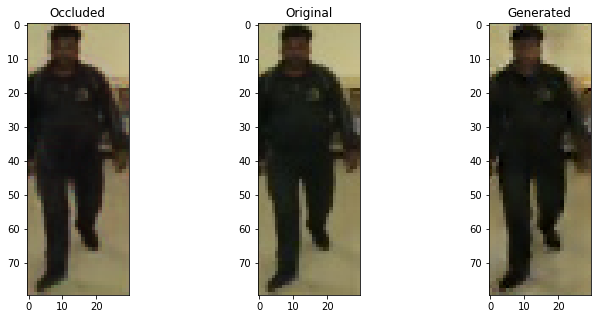

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


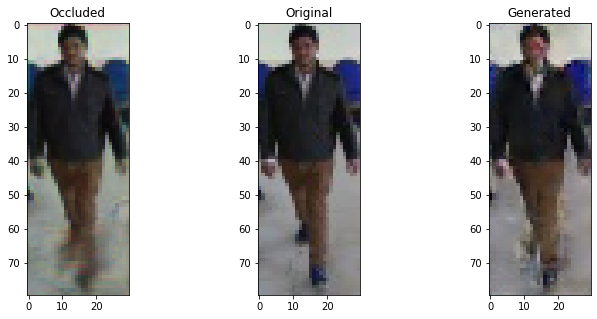

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


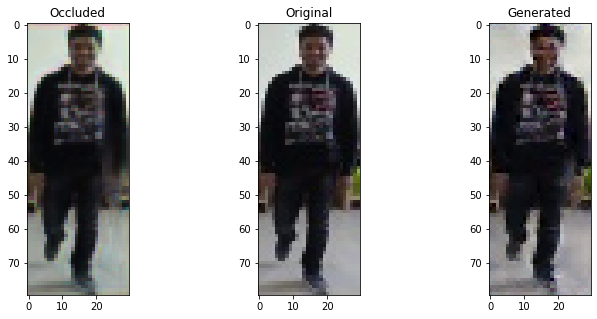

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


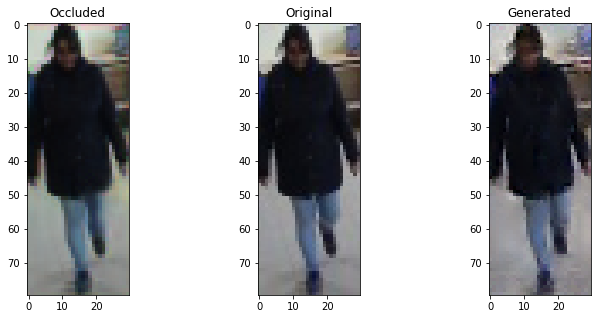

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


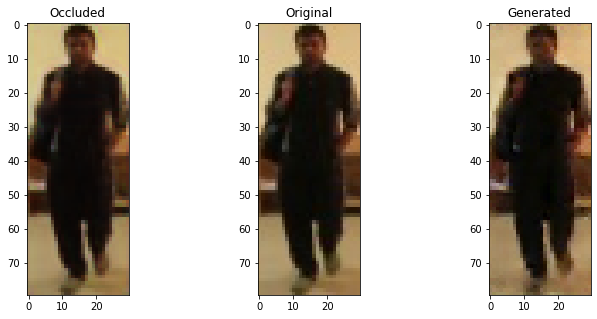

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6488791704177856 , Adversarial Loss:  0.00039281090721488
Epoch 2282


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6551640629768372 , Adversarial Loss:  0.00042413215851411223
Epoch 2283


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6312346458435059 , Adversarial Loss:  0.00042615545680746436
Epoch 2284


  8%|▊         | 1/13 [00:00<00:02,  5.49it/s]

Discriminator Loss:  0.6588031053543091 , Adversarial Loss:  0.0003543857019394636
Epoch 2285


  8%|▊         | 1/13 [00:00<00:01,  6.25it/s]

Discriminator Loss:  0.6534844636917114 , Adversarial Loss:  0.0003694295301102102
Epoch 2286


  8%|▊         | 1/13 [00:00<00:01,  6.47it/s]

Discriminator Loss:  0.6679335832595825 , Adversarial Loss:  0.00043910619569942355
Epoch 2287


  8%|▊         | 1/13 [00:00<00:02,  5.22it/s]

Discriminator Loss:  0.6597408056259155 , Adversarial Loss:  0.00042895262595266104
Epoch 2288


  8%|▊         | 1/13 [00:00<00:02,  5.74it/s]

Discriminator Loss:  0.6426807045936584 , Adversarial Loss:  0.0003944850177504122
Epoch 2289


  8%|▊         | 1/13 [00:00<00:01,  6.46it/s]

Discriminator Loss:  0.6847058534622192 , Adversarial Loss:  0.00038331857649609447
Epoch 2290


  8%|▊         | 1/13 [00:00<00:01,  6.51it/s]

Discriminator Loss:  0.6574102640151978 , Adversarial Loss:  0.00040373080992139876
Epoch 2291


  8%|▊         | 1/13 [00:00<00:01,  6.77it/s]

Discriminator Loss:  0.6554588079452515 , Adversarial Loss:  0.0003936314897146076
Epoch 2292


  8%|▊         | 1/13 [00:00<00:01,  6.07it/s]

Discriminator Loss:  0.6575766801834106 , Adversarial Loss:  0.00041367558878846467
Epoch 2293


  8%|▊         | 1/13 [00:00<00:01,  6.75it/s]

Discriminator Loss:  0.6594390869140625 , Adversarial Loss:  0.00039714478771202266
Epoch 2294


  8%|▊         | 1/13 [00:00<00:01,  6.07it/s]

Discriminator Loss:  0.6726003885269165 , Adversarial Loss:  0.0003860772994812578
Epoch 2295


  8%|▊         | 1/13 [00:00<00:01,  6.15it/s]

Discriminator Loss:  0.6554572582244873 , Adversarial Loss:  0.0003747682203538716
Epoch 2296


  8%|▊         | 1/13 [00:00<00:01,  6.49it/s]

Discriminator Loss:  0.6434804797172546 , Adversarial Loss:  0.00034599844366312027
Epoch 2297


  8%|▊         | 1/13 [00:00<00:01,  6.63it/s]

Discriminator Loss:  0.6716902256011963 , Adversarial Loss:  0.00038263254100456834
Epoch 2298


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6622647047042847 , Adversarial Loss:  0.0003850440261885524
Epoch 2299


  8%|▊         | 1/13 [00:00<00:01,  6.91it/s]

Discriminator Loss:  0.6581753492355347 , Adversarial Loss:  0.0003688418073579669
Epoch 2300


  8%|▊         | 1/13 [00:00<00:01,  6.41it/s]

Discriminator Loss:  0.6710897088050842 , Adversarial Loss:  0.0004090010770596564
Epoch 2301


100%|██████████| 13/13 [00:02<00:00,  5.90it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


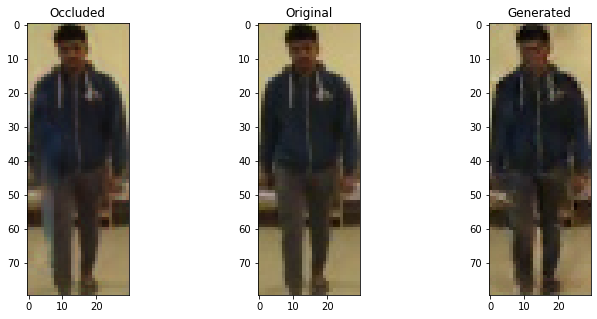

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


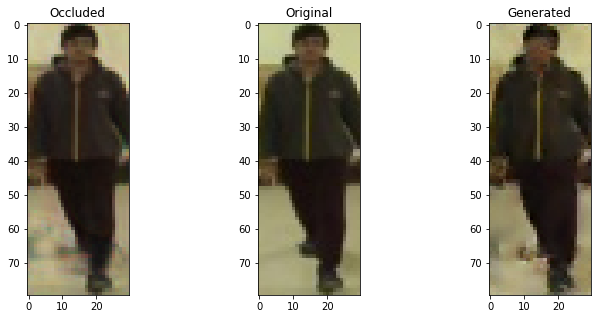

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


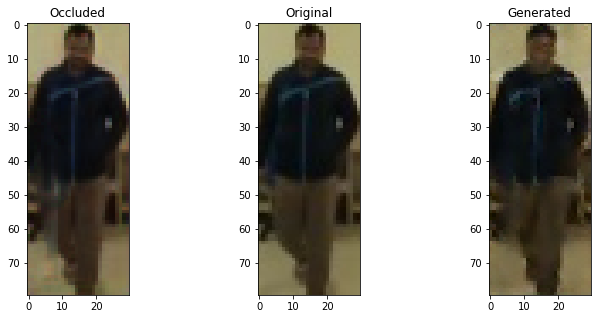

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


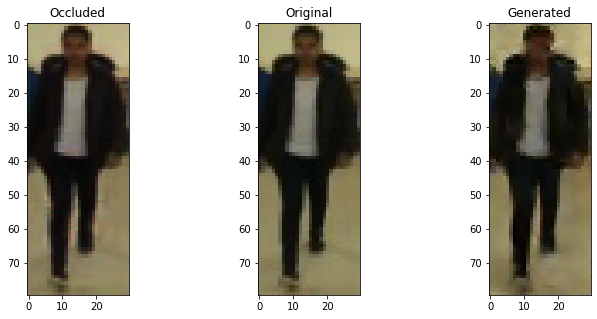

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


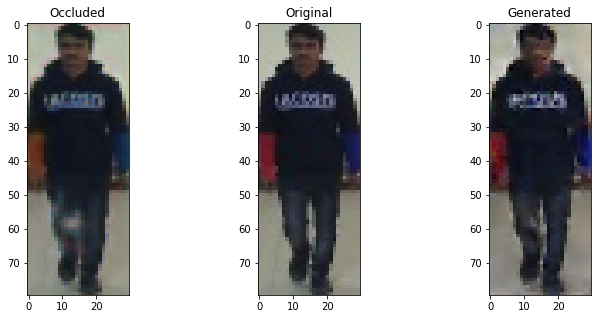

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6527838706970215 , Adversarial Loss:  0.0003835952084045857
Epoch 2302


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6587671041488647 , Adversarial Loss:  0.00041052309097722173
Epoch 2303


  8%|▊         | 1/13 [00:00<00:01,  6.45it/s]

Discriminator Loss:  0.6543617844581604 , Adversarial Loss:  0.000409512547776103
Epoch 2304


  8%|▊         | 1/13 [00:00<00:01,  6.78it/s]

Discriminator Loss:  0.6297299861907959 , Adversarial Loss:  0.00040720734978094697
Epoch 2305


  8%|▊         | 1/13 [00:00<00:01,  6.09it/s]

Discriminator Loss:  0.6414819359779358 , Adversarial Loss:  0.0003961885522585362
Epoch 2306


  8%|▊         | 1/13 [00:00<00:01,  6.19it/s]

Discriminator Loss:  0.6428908109664917 , Adversarial Loss:  0.0004147348809055984
Epoch 2307


  8%|▊         | 1/13 [00:00<00:01,  6.40it/s]

Discriminator Loss:  0.6739078760147095 , Adversarial Loss:  0.00041552502079866827
Epoch 2308


  8%|▊         | 1/13 [00:00<00:02,  5.90it/s]

Discriminator Loss:  0.6561598777770996 , Adversarial Loss:  0.00037510585389100015
Epoch 2309


  8%|▊         | 1/13 [00:00<00:01,  6.55it/s]

Discriminator Loss:  0.6617224216461182 , Adversarial Loss:  0.00035526129067875445
Epoch 2310


  8%|▊         | 1/13 [00:00<00:01,  6.07it/s]

Discriminator Loss:  0.6558997631072998 , Adversarial Loss:  0.0003792480565607548
Epoch 2311


  8%|▊         | 1/13 [00:00<00:01,  6.14it/s]

Discriminator Loss:  0.6485076546669006 , Adversarial Loss:  0.0003771433839574456
Epoch 2312


  8%|▊         | 1/13 [00:00<00:01,  6.74it/s]

Discriminator Loss:  0.6651369333267212 , Adversarial Loss:  0.00041015283204615116
Epoch 2313


  8%|▊         | 1/13 [00:00<00:01,  6.77it/s]

Discriminator Loss:  0.6533157825469971 , Adversarial Loss:  0.0003929649537894875
Epoch 2314


  8%|▊         | 1/13 [00:00<00:02,  5.08it/s]

Discriminator Loss:  0.6468560695648193 , Adversarial Loss:  0.00043905555503442883
Epoch 2315


  8%|▊         | 1/13 [00:00<00:01,  6.23it/s]

Discriminator Loss:  0.6504628658294678 , Adversarial Loss:  0.00042959151323884726
Epoch 2316


  8%|▊         | 1/13 [00:00<00:02,  5.78it/s]

Discriminator Loss:  0.6573238372802734 , Adversarial Loss:  0.00040389253990724683
Epoch 2317


  8%|▊         | 1/13 [00:00<00:01,  6.43it/s]

Discriminator Loss:  0.6754305362701416 , Adversarial Loss:  0.0004002524365205318
Epoch 2318


  8%|▊         | 1/13 [00:00<00:02,  5.62it/s]

Discriminator Loss:  0.668773889541626 , Adversarial Loss:  0.00038448028499260545
Epoch 2319


  8%|▊         | 1/13 [00:00<00:01,  6.61it/s]

Discriminator Loss:  0.622695803642273 , Adversarial Loss:  0.0004451171262189746
Epoch 2320


  8%|▊         | 1/13 [00:00<00:01,  6.46it/s]

Discriminator Loss:  0.640531063079834 , Adversarial Loss:  0.0004510092840064317
Epoch 2321


100%|██████████| 13/13 [00:02<00:00,  5.95it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


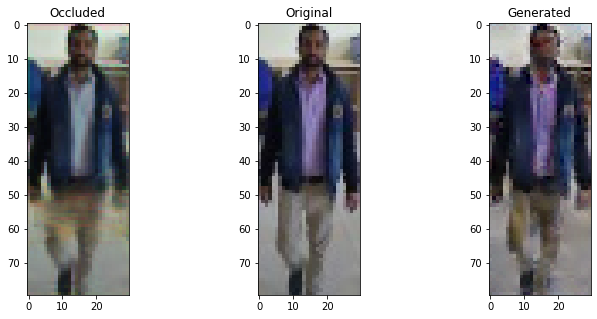

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


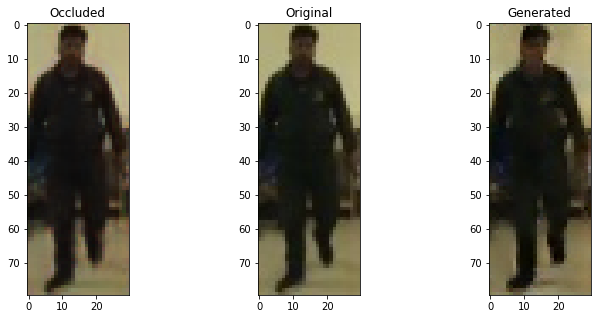

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


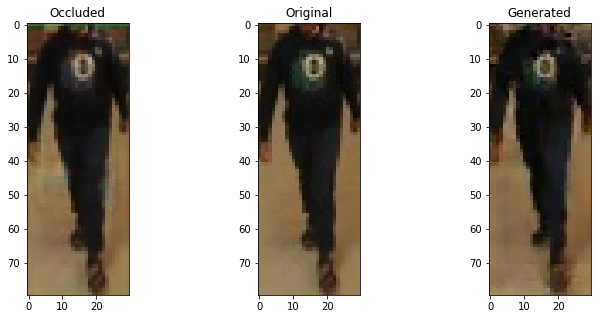

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


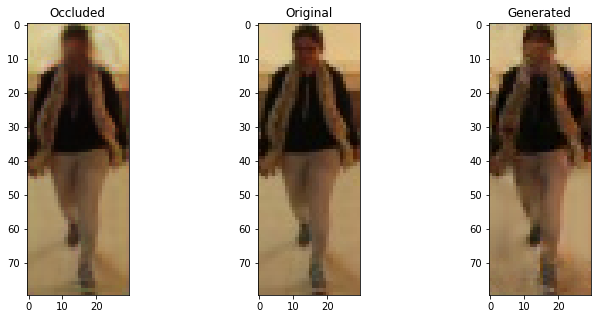

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


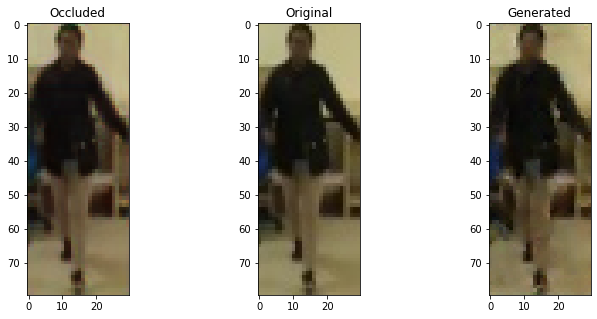

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6637678146362305 , Adversarial Loss:  0.00037106333184055984
Epoch 2322


  8%|▊         | 1/13 [00:00<00:02,  5.83it/s]

Discriminator Loss:  0.6792148351669312 , Adversarial Loss:  0.00038568704621866345
Epoch 2323


  8%|▊         | 1/13 [00:00<00:01,  6.27it/s]

Discriminator Loss:  0.6465944647789001 , Adversarial Loss:  0.00037527477252297103
Epoch 2324


  8%|▊         | 1/13 [00:00<00:02,  5.41it/s]

Discriminator Loss:  0.6535238027572632 , Adversarial Loss:  0.00035741759347729385
Epoch 2325


  8%|▊         | 1/13 [00:00<00:01,  6.16it/s]

Discriminator Loss:  0.6658358573913574 , Adversarial Loss:  0.00040295167127624154
Epoch 2326


  8%|▊         | 1/13 [00:00<00:01,  6.21it/s]

Discriminator Loss:  0.6595877408981323 , Adversarial Loss:  0.00034744598087854683
Epoch 2327


  8%|▊         | 1/13 [00:00<00:01,  6.10it/s]

Discriminator Loss:  0.6695672273635864 , Adversarial Loss:  0.0003839182900264859
Epoch 2328


  8%|▊         | 1/13 [00:00<00:02,  5.94it/s]

Discriminator Loss:  0.6577205657958984 , Adversarial Loss:  0.0003785182489082217
Epoch 2329


  8%|▊         | 1/13 [00:00<00:02,  5.80it/s]

Discriminator Loss:  0.6605428457260132 , Adversarial Loss:  0.0004135810595471412
Epoch 2330


  8%|▊         | 1/13 [00:00<00:01,  6.44it/s]

Discriminator Loss:  0.6552656292915344 , Adversarial Loss:  0.00039999198634177446
Epoch 2331


  8%|▊         | 1/13 [00:00<00:01,  6.37it/s]

Discriminator Loss:  0.6443085074424744 , Adversarial Loss:  0.00038071442395448685
Epoch 2332


  8%|▊         | 1/13 [00:00<00:02,  5.87it/s]

Discriminator Loss:  0.671570897102356 , Adversarial Loss:  0.00037395715480670333
Epoch 2333


  8%|▊         | 1/13 [00:00<00:01,  6.76it/s]

Discriminator Loss:  0.6454595923423767 , Adversarial Loss:  0.000402377569116652
Epoch 2334


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.642638623714447 , Adversarial Loss:  0.00038488395512104034
Epoch 2335


  8%|▊         | 1/13 [00:00<00:01,  6.54it/s]

Discriminator Loss:  0.6622990369796753 , Adversarial Loss:  0.0004266806645318866
Epoch 2336


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6366404294967651 , Adversarial Loss:  0.0003800278645940125
Epoch 2337


  8%|▊         | 1/13 [00:00<00:02,  5.08it/s]

Discriminator Loss:  0.6705416440963745 , Adversarial Loss:  0.0003636698529589921
Epoch 2338


  8%|▊         | 1/13 [00:00<00:01,  6.17it/s]

Discriminator Loss:  0.6380409002304077 , Adversarial Loss:  0.0003817534015979618
Epoch 2339


  8%|▊         | 1/13 [00:00<00:01,  6.75it/s]

Discriminator Loss:  0.6599144339561462 , Adversarial Loss:  0.0003482497704681009
Epoch 2340


  8%|▊         | 1/13 [00:00<00:02,  5.72it/s]

Discriminator Loss:  0.6876039505004883 , Adversarial Loss:  0.0004036266473121941
Epoch 2341


100%|██████████| 13/13 [00:02<00:00,  5.98it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


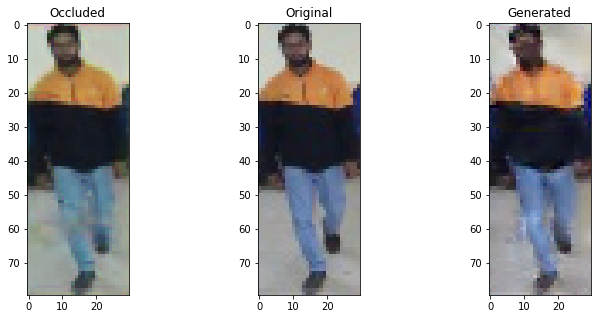

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


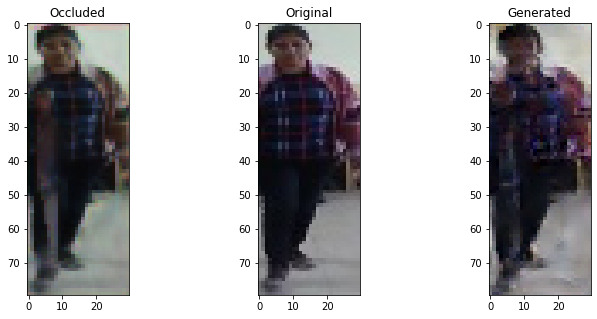

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


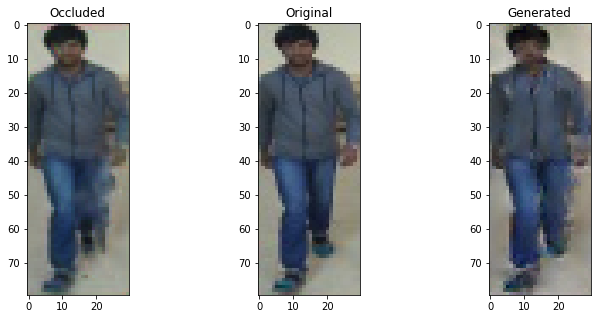

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


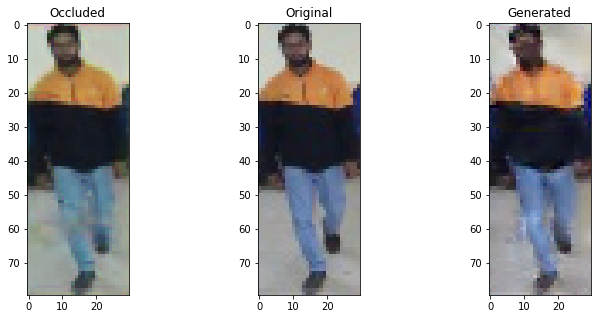

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


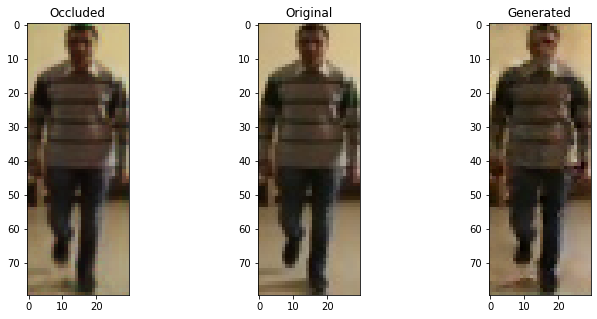

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6590292453765869 , Adversarial Loss:  0.0003693689650390297
Epoch 2342


  8%|▊         | 1/13 [00:00<00:01,  6.34it/s]

Discriminator Loss:  0.6480190753936768 , Adversarial Loss:  0.00038099728408269584
Epoch 2343


  8%|▊         | 1/13 [00:00<00:01,  6.44it/s]

Discriminator Loss:  0.6530886888504028 , Adversarial Loss:  0.00041138811502605677
Epoch 2344


  8%|▊         | 1/13 [00:00<00:01,  6.14it/s]

Discriminator Loss:  0.6750524044036865 , Adversarial Loss:  0.0003703777911141515
Epoch 2345


  8%|▊         | 1/13 [00:00<00:01,  6.40it/s]

Discriminator Loss:  0.657411515712738 , Adversarial Loss:  0.0003997571184299886
Epoch 2346


  8%|▊         | 1/13 [00:00<00:02,  5.98it/s]

Discriminator Loss:  0.6786219477653503 , Adversarial Loss:  0.00039525143802165985
Epoch 2347


  8%|▊         | 1/13 [00:00<00:01,  6.51it/s]

Discriminator Loss:  0.6736286878585815 , Adversarial Loss:  0.0004103198880329728
Epoch 2348


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6559257507324219 , Adversarial Loss:  0.00038851157296448946
Epoch 2349


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6383089423179626 , Adversarial Loss:  0.00037445808993652463
Epoch 2350


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6687989234924316 , Adversarial Loss:  0.0003920838935300708
Epoch 2351


  8%|▊         | 1/13 [00:00<00:02,  5.96it/s]

Discriminator Loss:  0.6456480026245117 , Adversarial Loss:  0.000375373667338863
Epoch 2352


  8%|▊         | 1/13 [00:00<00:01,  6.47it/s]

Discriminator Loss:  0.6475854516029358 , Adversarial Loss:  0.0003250194131396711
Epoch 2353


  8%|▊         | 1/13 [00:00<00:01,  6.72it/s]

Discriminator Loss:  0.6595554947853088 , Adversarial Loss:  0.0003826419706456363
Epoch 2354


  8%|▊         | 1/13 [00:00<00:01,  6.53it/s]

Discriminator Loss:  0.6819875240325928 , Adversarial Loss:  0.00035617087269201875
Epoch 2355


  8%|▊         | 1/13 [00:00<00:01,  6.39it/s]

Discriminator Loss:  0.6516416072845459 , Adversarial Loss:  0.0003739566309377551
Epoch 2356


  8%|▊         | 1/13 [00:00<00:01,  6.44it/s]

Discriminator Loss:  0.6613369584083557 , Adversarial Loss:  0.00043746299343183637
Epoch 2357


  8%|▊         | 1/13 [00:00<00:02,  5.89it/s]

Discriminator Loss:  0.6829417943954468 , Adversarial Loss:  0.00039593776455149055
Epoch 2358


  8%|▊         | 1/13 [00:00<00:02,  5.92it/s]

Discriminator Loss:  0.6425737142562866 , Adversarial Loss:  0.0003995877632405609
Epoch 2359


  8%|▊         | 1/13 [00:00<00:01,  6.44it/s]

Discriminator Loss:  0.6447291374206543 , Adversarial Loss:  0.00040149365668185055
Epoch 2360


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6702063083648682 , Adversarial Loss:  0.0004256304237060249
Epoch 2361


100%|██████████| 13/13 [00:02<00:00,  5.82it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


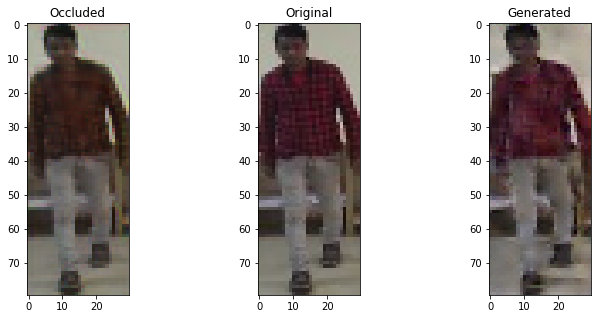

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


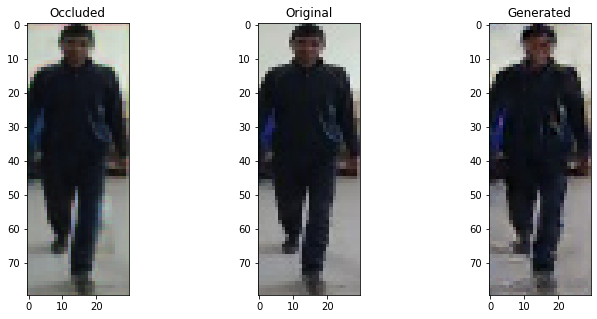

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


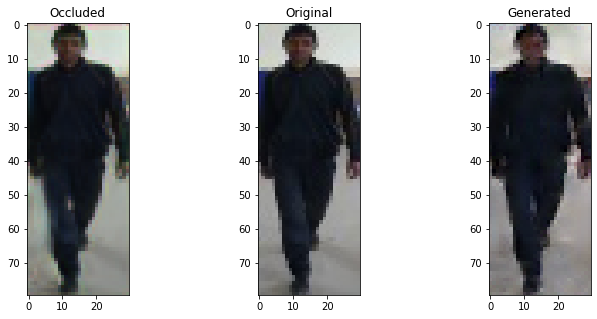

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


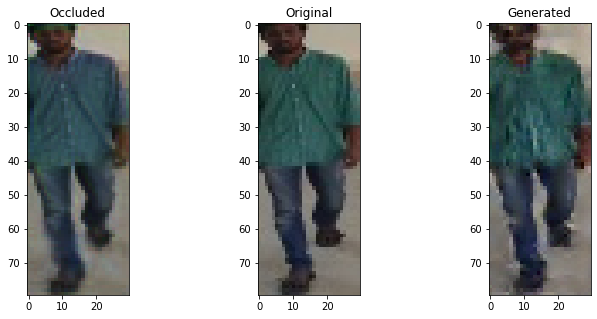

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


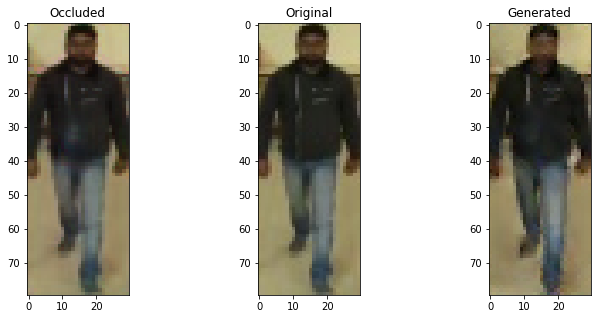

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6714441180229187 , Adversarial Loss:  0.00041358498856425285
Epoch 2362


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6759198307991028 , Adversarial Loss:  0.0004091826267540455
Epoch 2363


  8%|▊         | 1/13 [00:00<00:02,  5.33it/s]

Discriminator Loss:  0.6492564678192139 , Adversarial Loss:  0.00038225468597374856
Epoch 2364


  8%|▊         | 1/13 [00:00<00:01,  6.30it/s]

Discriminator Loss:  0.6620930433273315 , Adversarial Loss:  0.0003843767335638404
Epoch 2365


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6431670784950256 , Adversarial Loss:  0.00042819720692932606
Epoch 2366


  8%|▊         | 1/13 [00:00<00:01,  6.09it/s]

Discriminator Loss:  0.6499732136726379 , Adversarial Loss:  0.0004197205416858196
Epoch 2367


  8%|▊         | 1/13 [00:00<00:01,  6.40it/s]

Discriminator Loss:  0.677204430103302 , Adversarial Loss:  0.0003932567487936467
Epoch 2368


  8%|▊         | 1/13 [00:00<00:02,  5.94it/s]

Discriminator Loss:  0.6562201976776123 , Adversarial Loss:  0.0003901251475326717
Epoch 2369


  8%|▊         | 1/13 [00:00<00:01,  6.61it/s]

Discriminator Loss:  0.6483545899391174 , Adversarial Loss:  0.00038663085433654487
Epoch 2370


  8%|▊         | 1/13 [00:00<00:01,  6.53it/s]

Discriminator Loss:  0.6687871813774109 , Adversarial Loss:  0.000369145447621122
Epoch 2371


  8%|▊         | 1/13 [00:00<00:01,  6.45it/s]

Discriminator Loss:  0.6734932661056519 , Adversarial Loss:  0.00035678318818099797
Epoch 2372


  8%|▊         | 1/13 [00:00<00:01,  6.55it/s]

Discriminator Loss:  0.6552281379699707 , Adversarial Loss:  0.0004021954082418233
Epoch 2373


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6470407247543335 , Adversarial Loss:  0.0003954435233026743
Epoch 2374


  8%|▊         | 1/13 [00:00<00:01,  6.44it/s]

Discriminator Loss:  0.6349667310714722 , Adversarial Loss:  0.0004079241771250963
Epoch 2375


  8%|▊         | 1/13 [00:00<00:02,  5.94it/s]

Discriminator Loss:  0.6640876531600952 , Adversarial Loss:  0.0003396343672648072
Epoch 2376


  8%|▊         | 1/13 [00:00<00:01,  6.42it/s]

Discriminator Loss:  0.6520738005638123 , Adversarial Loss:  0.00041518936632201076
Epoch 2377


  8%|▊         | 1/13 [00:00<00:01,  6.33it/s]

Discriminator Loss:  0.6492013335227966 , Adversarial Loss:  0.0003722872643265873
Epoch 2378


  8%|▊         | 1/13 [00:00<00:02,  5.87it/s]

Discriminator Loss:  0.6513758897781372 , Adversarial Loss:  0.00038356479490175843
Epoch 2379


  8%|▊         | 1/13 [00:00<00:01,  6.68it/s]

Discriminator Loss:  0.6638473272323608 , Adversarial Loss:  0.00038478258647955954
Epoch 2380


  8%|▊         | 1/13 [00:00<00:01,  6.69it/s]

Discriminator Loss:  0.657501220703125 , Adversarial Loss:  0.00038231085636653006
Epoch 2381


100%|██████████| 13/13 [00:02<00:00,  6.02it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


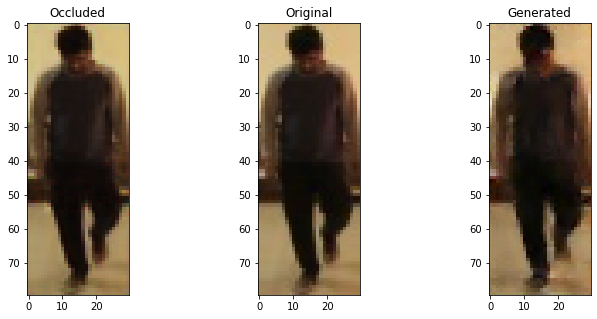

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


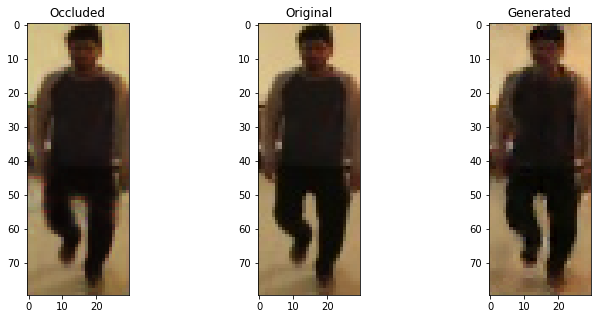

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


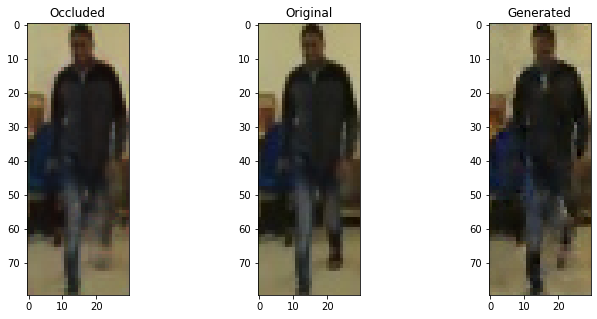

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


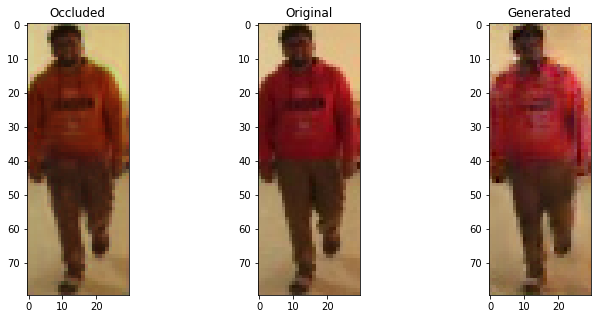

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


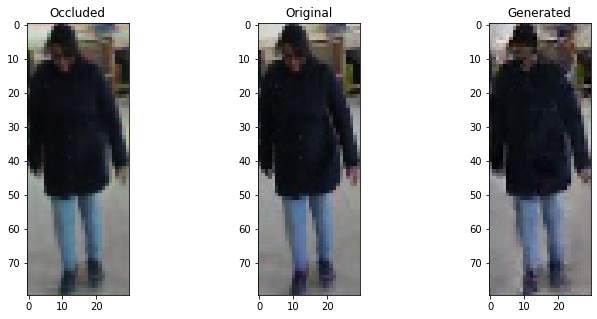

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6546157002449036 , Adversarial Loss:  0.0003702020039781928
Epoch 2382


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6754623651504517 , Adversarial Loss:  0.0003447287017479539
Epoch 2383


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6526904106140137 , Adversarial Loss:  0.00037710534525103867
Epoch 2384


  8%|▊         | 1/13 [00:00<00:01,  6.55it/s]

Discriminator Loss:  0.6607828736305237 , Adversarial Loss:  0.00041529734153300524
Epoch 2385


  8%|▊         | 1/13 [00:00<00:01,  6.25it/s]

Discriminator Loss:  0.6920081377029419 , Adversarial Loss:  0.0003942109760828316
Epoch 2386


  8%|▊         | 1/13 [00:00<00:01,  6.15it/s]

Discriminator Loss:  0.6511450409889221 , Adversarial Loss:  0.000363677681889385
Epoch 2387


  8%|▊         | 1/13 [00:00<00:02,  5.11it/s]

Discriminator Loss:  0.6659855842590332 , Adversarial Loss:  0.00037445200723595917
Epoch 2388


  8%|▊         | 1/13 [00:00<00:01,  6.37it/s]

Discriminator Loss:  0.6972101926803589 , Adversarial Loss:  0.0003599131014198065
Epoch 2389


  8%|▊         | 1/13 [00:00<00:01,  6.28it/s]

Discriminator Loss:  0.6610459089279175 , Adversarial Loss:  0.0003642196243163198
Epoch 2390


  8%|▊         | 1/13 [00:00<00:01,  6.23it/s]

Discriminator Loss:  0.6721723079681396 , Adversarial Loss:  0.00040351474308408797
Epoch 2391


  8%|▊         | 1/13 [00:00<00:01,  6.51it/s]

Discriminator Loss:  0.6501618027687073 , Adversarial Loss:  0.0003809447807725519
Epoch 2392


  8%|▊         | 1/13 [00:00<00:02,  5.31it/s]

Discriminator Loss:  0.6400957703590393 , Adversarial Loss:  0.0004041051724925637
Epoch 2393


  8%|▊         | 1/13 [00:00<00:01,  6.08it/s]

Discriminator Loss:  0.6713425517082214 , Adversarial Loss:  0.0004180430551059544
Epoch 2394


  8%|▊         | 1/13 [00:00<00:01,  6.50it/s]

Discriminator Loss:  0.6378767490386963 , Adversarial Loss:  0.0003827932523563504
Epoch 2395


  8%|▊         | 1/13 [00:00<00:01,  6.43it/s]

Discriminator Loss:  0.6560693979263306 , Adversarial Loss:  0.00037187139969319105
Epoch 2396


  8%|▊         | 1/13 [00:00<00:02,  5.78it/s]

Discriminator Loss:  0.6724553108215332 , Adversarial Loss:  0.00039052736246958375
Epoch 2397


  8%|▊         | 1/13 [00:00<00:01,  6.43it/s]

Discriminator Loss:  0.6433767676353455 , Adversarial Loss:  0.00037166482070460916
Epoch 2398


  8%|▊         | 1/13 [00:00<00:01,  6.59it/s]

Discriminator Loss:  0.652645468711853 , Adversarial Loss:  0.0003770218463614583
Epoch 2399


  8%|▊         | 1/13 [00:00<00:01,  6.66it/s]

Discriminator Loss:  0.6457803249359131 , Adversarial Loss:  0.0004455107555259019
Epoch 2400


  8%|▊         | 1/13 [00:00<00:01,  6.03it/s]

Discriminator Loss:  0.6595263481140137 , Adversarial Loss:  0.00035689270589500666
Epoch 2401


100%|██████████| 13/13 [00:02<00:00,  5.88it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


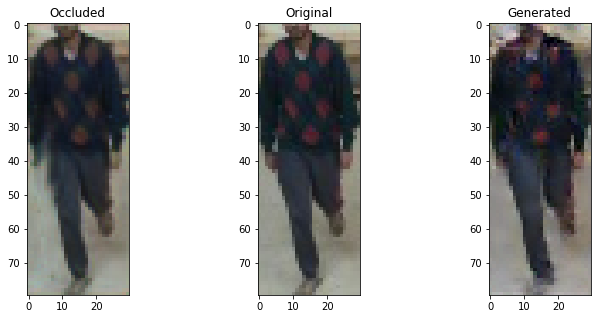

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


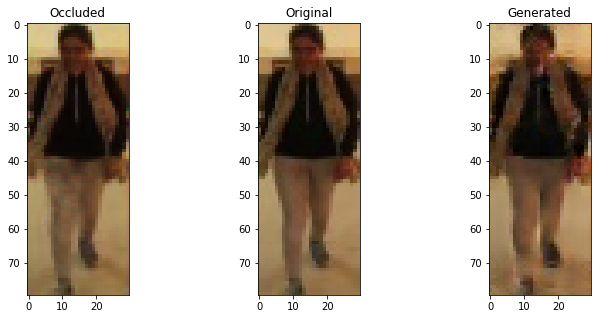

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


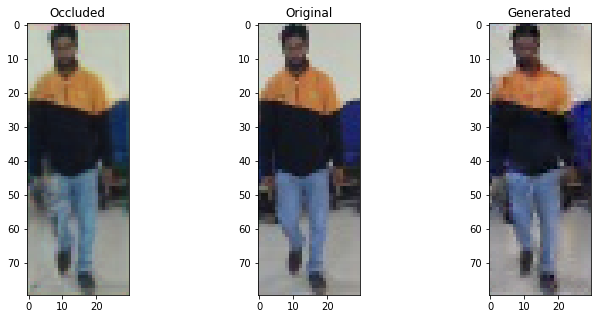

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


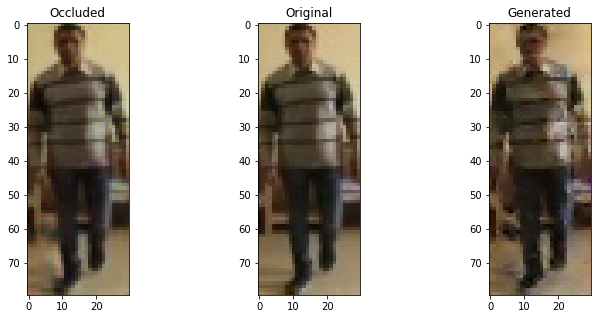

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


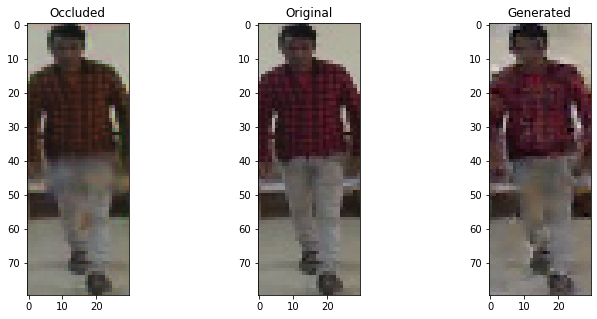

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6497149467468262 , Adversarial Loss:  0.0003886764170601964
Epoch 2402


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6658164262771606 , Adversarial Loss:  0.00039489177288487554
Epoch 2403


  8%|▊         | 1/13 [00:00<00:01,  6.23it/s]

Discriminator Loss:  0.6753449440002441 , Adversarial Loss:  0.00037798425182700157
Epoch 2404


  8%|▊         | 1/13 [00:00<00:01,  6.61it/s]

Discriminator Loss:  0.6540984511375427 , Adversarial Loss:  0.0003602550132200122
Epoch 2405


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6326605081558228 , Adversarial Loss:  0.00042073643999174237
Epoch 2406


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.65023273229599 , Adversarial Loss:  0.0003658345085568726
Epoch 2407


  8%|▊         | 1/13 [00:00<00:01,  6.29it/s]

Discriminator Loss:  0.6765133142471313 , Adversarial Loss:  0.00035652791848406196
Epoch 2408


  8%|▊         | 1/13 [00:00<00:01,  6.43it/s]

Discriminator Loss:  0.6525217294692993 , Adversarial Loss:  0.0003779224643949419
Epoch 2409


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6629401445388794 , Adversarial Loss:  0.0003981448826380074
Epoch 2410


  8%|▊         | 1/13 [00:00<00:01,  6.08it/s]

Discriminator Loss:  0.6271643042564392 , Adversarial Loss:  0.00042774982284754515
Epoch 2411


  8%|▊         | 1/13 [00:00<00:01,  6.67it/s]

Discriminator Loss:  0.6476848721504211 , Adversarial Loss:  0.0003689827281050384
Epoch 2412


  8%|▊         | 1/13 [00:00<00:01,  6.47it/s]

Discriminator Loss:  0.6615268588066101 , Adversarial Loss:  0.000353634066414088
Epoch 2413


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6524986028671265 , Adversarial Loss:  0.00038999965181574225
Epoch 2414


  8%|▊         | 1/13 [00:00<00:02,  5.22it/s]

Discriminator Loss:  0.6289968490600586 , Adversarial Loss:  0.0003568521933630109
Epoch 2415


  8%|▊         | 1/13 [00:00<00:02,  5.72it/s]

Discriminator Loss:  0.658420979976654 , Adversarial Loss:  0.00038158486131578684
Epoch 2416


  8%|▊         | 1/13 [00:00<00:01,  6.53it/s]

Discriminator Loss:  0.6484771966934204 , Adversarial Loss:  0.00038176937960088253
Epoch 2417


  8%|▊         | 1/13 [00:00<00:01,  6.51it/s]

Discriminator Loss:  0.6485478281974792 , Adversarial Loss:  0.00036719057243317366
Epoch 2418


  8%|▊         | 1/13 [00:00<00:01,  6.20it/s]

Discriminator Loss:  0.6687506437301636 , Adversarial Loss:  0.0003905396442860365
Epoch 2419


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6477135419845581 , Adversarial Loss:  0.0003626774996519089
Epoch 2420


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.648511528968811 , Adversarial Loss:  0.00036174169508740306
Epoch 2421


100%|██████████| 13/13 [00:02<00:00,  5.94it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


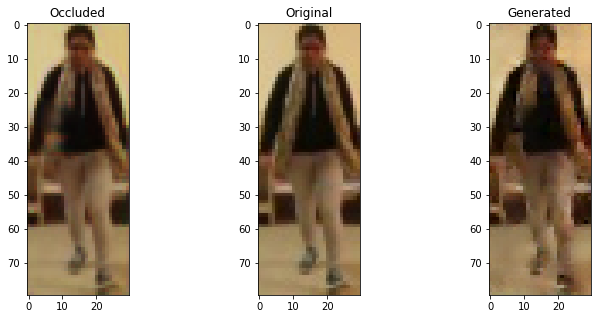

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


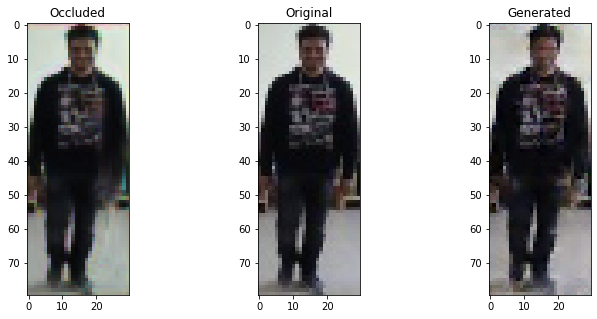

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


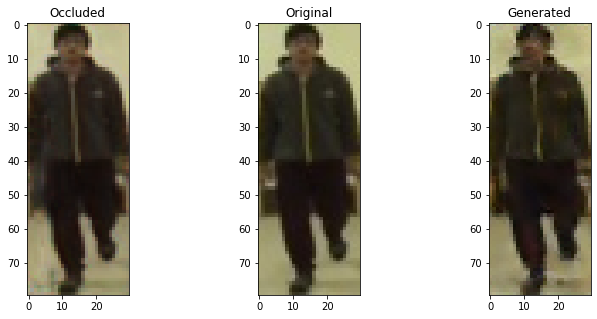

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


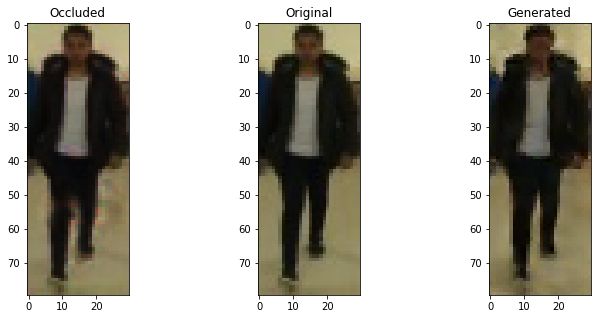

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


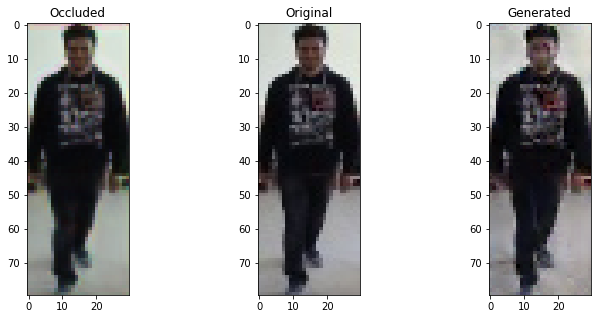

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6762757897377014 , Adversarial Loss:  0.0003798360703513026
Epoch 2422


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6468302011489868 , Adversarial Loss:  0.0003560678451322019
Epoch 2423


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6506044864654541 , Adversarial Loss:  0.0004178568487986922
Epoch 2424


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6528475284576416 , Adversarial Loss:  0.00039397107320837677
Epoch 2425


  8%|▊         | 1/13 [00:00<00:01,  6.46it/s]

Discriminator Loss:  0.6746244430541992 , Adversarial Loss:  0.00040346034802496433
Epoch 2426


  8%|▊         | 1/13 [00:00<00:02,  5.66it/s]

Discriminator Loss:  0.6635899543762207 , Adversarial Loss:  0.0003898467984981835
Epoch 2427


  8%|▊         | 1/13 [00:00<00:02,  5.18it/s]

Discriminator Loss:  0.6327033042907715 , Adversarial Loss:  0.00035451806616038084
Epoch 2428


  8%|▊         | 1/13 [00:00<00:01,  6.60it/s]

Discriminator Loss:  0.6819713115692139 , Adversarial Loss:  0.00036350407754071057
Epoch 2429


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6539096832275391 , Adversarial Loss:  0.00037503900239244103
Epoch 2430


  8%|▊         | 1/13 [00:00<00:02,  5.21it/s]

Discriminator Loss:  0.668360710144043 , Adversarial Loss:  0.0003851640794891864
Epoch 2431


  8%|▊         | 1/13 [00:00<00:01,  6.03it/s]

Discriminator Loss:  0.6546304225921631 , Adversarial Loss:  0.0003609764389693737
Epoch 2432


  8%|▊         | 1/13 [00:00<00:01,  6.42it/s]

Discriminator Loss:  0.6433889865875244 , Adversarial Loss:  0.0003893844841513783
Epoch 2433


  8%|▊         | 1/13 [00:00<00:01,  6.29it/s]

Discriminator Loss:  0.6628741025924683 , Adversarial Loss:  0.00035697672865353525
Epoch 2434


  8%|▊         | 1/13 [00:00<00:01,  6.41it/s]

Discriminator Loss:  0.6541100144386292 , Adversarial Loss:  0.00036392913898453116
Epoch 2435


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6552322506904602 , Adversarial Loss:  0.00035169103648513556
Epoch 2436


  8%|▊         | 1/13 [00:00<00:01,  6.23it/s]

Discriminator Loss:  0.6571322083473206 , Adversarial Loss:  0.00036906078457832336
Epoch 2437


  8%|▊         | 1/13 [00:00<00:01,  6.33it/s]

Discriminator Loss:  0.6589800119400024 , Adversarial Loss:  0.00037660813541151583
Epoch 2438


  8%|▊         | 1/13 [00:00<00:01,  6.40it/s]

Discriminator Loss:  0.6554282307624817 , Adversarial Loss:  0.0003764605207834393
Epoch 2439


  8%|▊         | 1/13 [00:00<00:01,  6.44it/s]

Discriminator Loss:  0.6754021048545837 , Adversarial Loss:  0.000388988119084388
Epoch 2440


  8%|▊         | 1/13 [00:00<00:02,  5.56it/s]

Discriminator Loss:  0.6646074652671814 , Adversarial Loss:  0.00037801414146088064
Epoch 2441


100%|██████████| 13/13 [00:02<00:00,  6.02it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


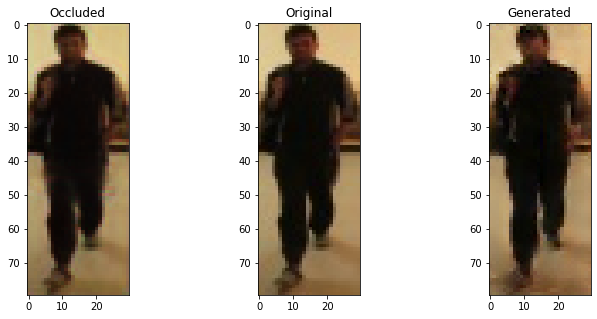

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


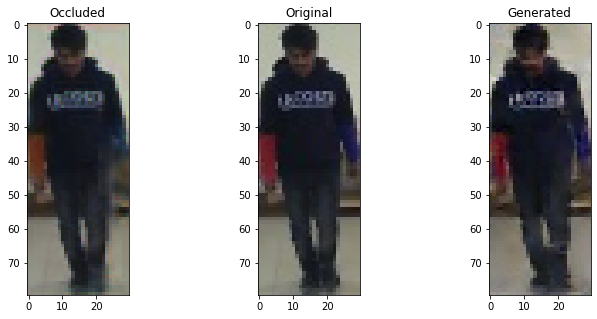

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


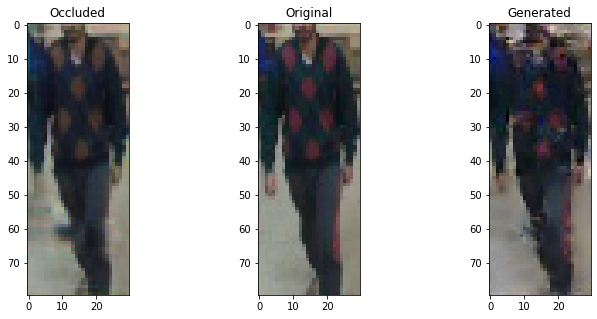

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


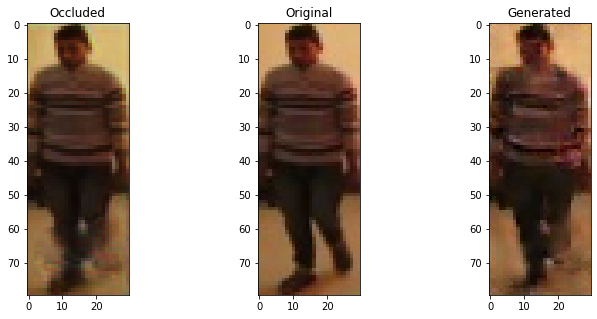

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


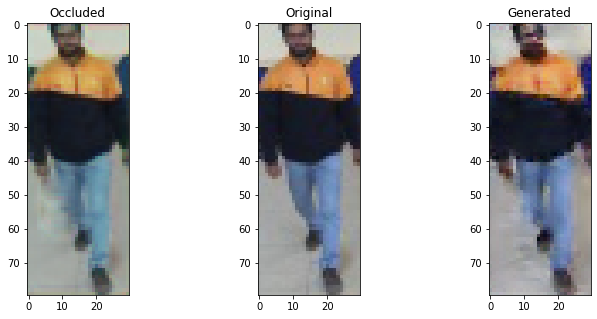

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6448997855186462 , Adversarial Loss:  0.0003518355078995228
Epoch 2442


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6498370170593262 , Adversarial Loss:  0.0003849680651910603
Epoch 2443


  8%|▊         | 1/13 [00:00<00:01,  6.45it/s]

Discriminator Loss:  0.6387418508529663 , Adversarial Loss:  0.00038064748514443636
Epoch 2444


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6458317041397095 , Adversarial Loss:  0.00039398856461048126
Epoch 2445


  8%|▊         | 1/13 [00:00<00:01,  6.02it/s]

Discriminator Loss:  0.6413501501083374 , Adversarial Loss:  0.00032034667674452066
Epoch 2446


  8%|▊         | 1/13 [00:00<00:01,  6.53it/s]

Discriminator Loss:  0.6653092503547668 , Adversarial Loss:  0.0003774388460442424
Epoch 2447


  8%|▊         | 1/13 [00:00<00:02,  5.56it/s]

Discriminator Loss:  0.6481255888938904 , Adversarial Loss:  0.00031817785929888487
Epoch 2448


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6314442157745361 , Adversarial Loss:  0.00036386778810992837
Epoch 2449


  8%|▊         | 1/13 [00:00<00:01,  6.67it/s]

Discriminator Loss:  0.6503131985664368 , Adversarial Loss:  0.0003510735696181655
Epoch 2450


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6965558528900146 , Adversarial Loss:  0.0003405960451345891
Epoch 2451


  8%|▊         | 1/13 [00:00<00:01,  6.68it/s]

Discriminator Loss:  0.65138840675354 , Adversarial Loss:  0.0003410328063182533
Epoch 2452


  8%|▊         | 1/13 [00:00<00:01,  6.33it/s]

Discriminator Loss:  0.6591913104057312 , Adversarial Loss:  0.0003573148569557816
Epoch 2453


  8%|▊         | 1/13 [00:00<00:01,  6.53it/s]

Discriminator Loss:  0.6636974215507507 , Adversarial Loss:  0.0003370650811120868
Epoch 2454


  8%|▊         | 1/13 [00:00<00:01,  6.45it/s]

Discriminator Loss:  0.6863201856613159 , Adversarial Loss:  0.0003648269339464605
Epoch 2455


  8%|▊         | 1/13 [00:00<00:01,  6.12it/s]

Discriminator Loss:  0.6510699987411499 , Adversarial Loss:  0.00035473034949973226
Epoch 2456


  8%|▊         | 1/13 [00:00<00:01,  6.53it/s]

Discriminator Loss:  0.6697553396224976 , Adversarial Loss:  0.00038736386341042817
Epoch 2457


  8%|▊         | 1/13 [00:00<00:01,  6.70it/s]

Discriminator Loss:  0.6588234901428223 , Adversarial Loss:  0.00041903581586666405
Epoch 2458


  8%|▊         | 1/13 [00:00<00:02,  5.71it/s]

Discriminator Loss:  0.6364662051200867 , Adversarial Loss:  0.0003842471051029861
Epoch 2459


  8%|▊         | 1/13 [00:00<00:01,  6.23it/s]

Discriminator Loss:  0.6550105214118958 , Adversarial Loss:  0.0003671511076390743
Epoch 2460


  8%|▊         | 1/13 [00:00<00:01,  6.01it/s]

Discriminator Loss:  0.6477125883102417 , Adversarial Loss:  0.00035761151229962707
Epoch 2461


100%|██████████| 13/13 [00:02<00:00,  6.01it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


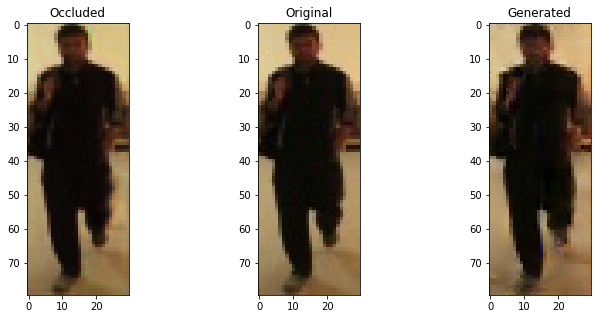

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


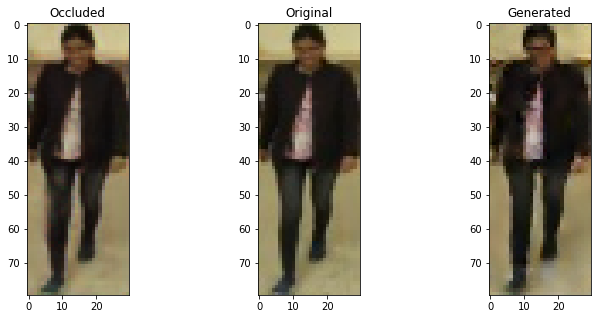

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


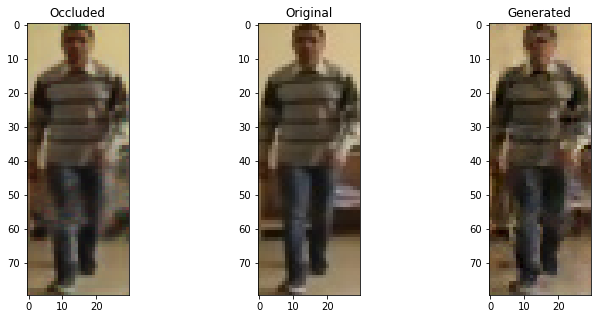

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


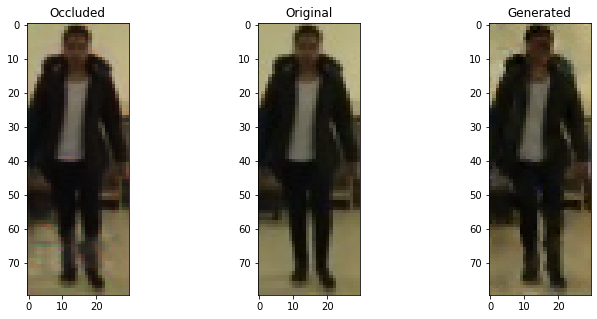

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


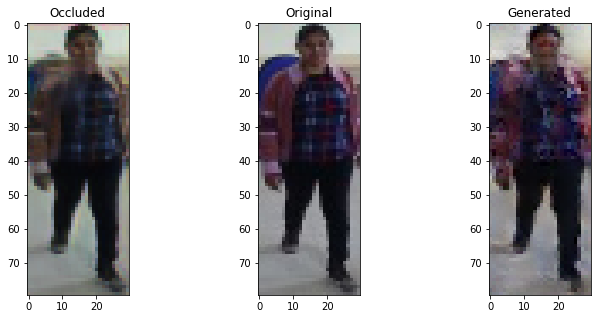

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6368510723114014 , Adversarial Loss:  0.0003762050182558596
Epoch 2462


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6637321710586548 , Adversarial Loss:  0.00035661441506817937
Epoch 2463


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6834689378738403 , Adversarial Loss:  0.0003604103112593293
Epoch 2464


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6535975933074951 , Adversarial Loss:  0.00039424485294148326
Epoch 2465


  8%|▊         | 1/13 [00:00<00:01,  6.34it/s]

Discriminator Loss:  0.6313821077346802 , Adversarial Loss:  0.0003782996500376612
Epoch 2466


  8%|▊         | 1/13 [00:00<00:02,  5.53it/s]

Discriminator Loss:  0.6584810018539429 , Adversarial Loss:  0.0003793660434894264
Epoch 2467


  8%|▊         | 1/13 [00:00<00:02,  5.94it/s]

Discriminator Loss:  0.697184681892395 , Adversarial Loss:  0.0003626910620369017
Epoch 2468


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6475323438644409 , Adversarial Loss:  0.00036535313120111823
Epoch 2469


  8%|▊         | 1/13 [00:00<00:01,  6.77it/s]

Discriminator Loss:  0.6525107622146606 , Adversarial Loss:  0.00036778865614905953
Epoch 2470


  8%|▊         | 1/13 [00:00<00:01,  6.58it/s]

Discriminator Loss:  0.6501607298851013 , Adversarial Loss:  0.0003429382049944252
Epoch 2471


  8%|▊         | 1/13 [00:00<00:01,  6.08it/s]

Discriminator Loss:  0.6642563939094543 , Adversarial Loss:  0.0003475773264653981
Epoch 2472


  8%|▊         | 1/13 [00:00<00:01,  6.52it/s]

Discriminator Loss:  0.6722812652587891 , Adversarial Loss:  0.00041377110756002367
Epoch 2473


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6959328651428223 , Adversarial Loss:  0.0003559612378012389
Epoch 2474


  8%|▊         | 1/13 [00:00<00:01,  6.02it/s]

Discriminator Loss:  0.6822535395622253 , Adversarial Loss:  0.0003866506740450859
Epoch 2475


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6497942209243774 , Adversarial Loss:  0.00035467150155454874
Epoch 2476


  8%|▊         | 1/13 [00:00<00:01,  6.37it/s]

Discriminator Loss:  0.641003429889679 , Adversarial Loss:  0.00041266606422141194
Epoch 2477


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6657470464706421 , Adversarial Loss:  0.00036864890716969967
Epoch 2478


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6462199687957764 , Adversarial Loss:  0.00039368277066387236
Epoch 2479


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6722527742385864 , Adversarial Loss:  0.00032509869197383523
Epoch 2480


  8%|▊         | 1/13 [00:00<00:01,  6.67it/s]

Discriminator Loss:  0.6459659337997437 , Adversarial Loss:  0.0003842020523734391
Epoch 2481


100%|██████████| 13/13 [00:02<00:00,  6.01it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


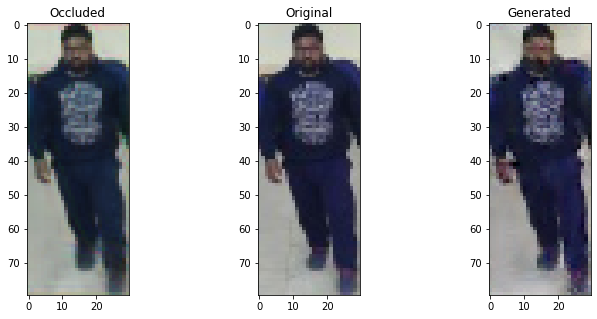

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


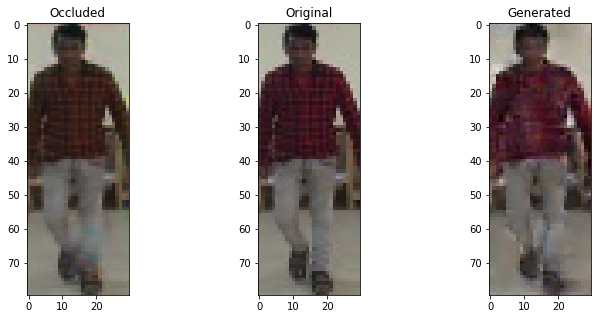

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


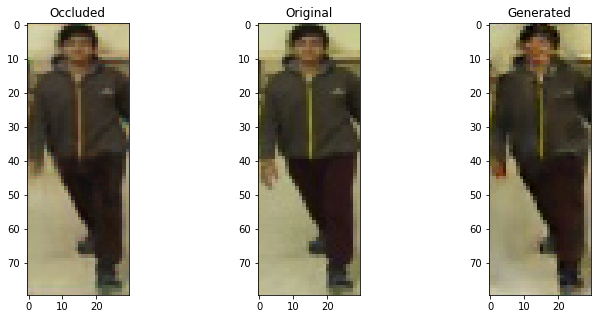

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


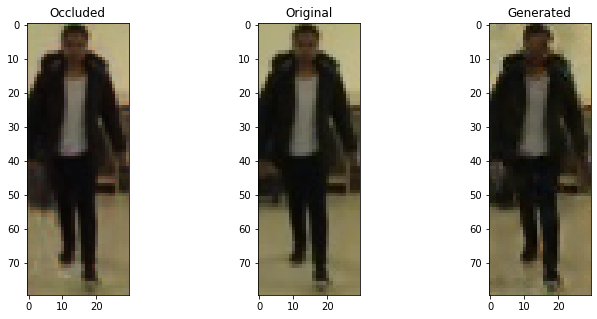

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


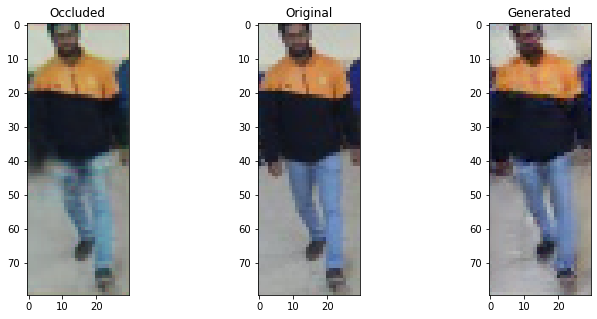

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.668224036693573 , Adversarial Loss:  0.0003759319079108536
Epoch 2482


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6554654836654663 , Adversarial Loss:  0.00037724978756159544
Epoch 2483


  8%|▊         | 1/13 [00:00<00:01,  6.35it/s]

Discriminator Loss:  0.6500452756881714 , Adversarial Loss:  0.0003583694342523813
Epoch 2484


  8%|▊         | 1/13 [00:00<00:02,  5.23it/s]

Discriminator Loss:  0.6490063667297363 , Adversarial Loss:  0.00039480728446505964
Epoch 2485


  8%|▊         | 1/13 [00:00<00:01,  6.63it/s]

Discriminator Loss:  0.6485402584075928 , Adversarial Loss:  0.0003409679338801652
Epoch 2486


  8%|▊         | 1/13 [00:00<00:01,  6.63it/s]

Discriminator Loss:  0.6674783825874329 , Adversarial Loss:  0.0003953757113777101
Epoch 2487


  8%|▊         | 1/13 [00:00<00:01,  6.29it/s]

Discriminator Loss:  0.6542847752571106 , Adversarial Loss:  0.00039222792838700116
Epoch 2488


  8%|▊         | 1/13 [00:00<00:02,  5.99it/s]

Discriminator Loss:  0.6095181703567505 , Adversarial Loss:  0.0003792415664065629
Epoch 2489


  8%|▊         | 1/13 [00:00<00:01,  6.39it/s]

Discriminator Loss:  0.6728990077972412 , Adversarial Loss:  0.0003578065079636872
Epoch 2490


  8%|▊         | 1/13 [00:00<00:01,  6.45it/s]

Discriminator Loss:  0.6442024111747742 , Adversarial Loss:  0.0003615292953327298
Epoch 2491


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6724780201911926 , Adversarial Loss:  0.00046090787509456277
Epoch 2492


  8%|▊         | 1/13 [00:00<00:01,  6.53it/s]

Discriminator Loss:  0.6851685047149658 , Adversarial Loss:  0.00039200150058604777
Epoch 2493


  8%|▊         | 1/13 [00:00<00:01,  6.75it/s]

Discriminator Loss:  0.681347131729126 , Adversarial Loss:  0.00040516682201996446
Epoch 2494


  8%|▊         | 1/13 [00:00<00:01,  6.48it/s]

Discriminator Loss:  0.6564826369285583 , Adversarial Loss:  0.00034218610380776227
Epoch 2495


  8%|▊         | 1/13 [00:00<00:01,  6.01it/s]

Discriminator Loss:  0.6613074541091919 , Adversarial Loss:  0.0003278790391050279
Epoch 2496


  8%|▊         | 1/13 [00:00<00:02,  5.69it/s]

Discriminator Loss:  0.6487690210342407 , Adversarial Loss:  0.0003920001909136772
Epoch 2497


  8%|▊         | 1/13 [00:00<00:01,  6.45it/s]

Discriminator Loss:  0.6247240900993347 , Adversarial Loss:  0.00033840100513771176
Epoch 2498


  8%|▊         | 1/13 [00:00<00:01,  6.02it/s]

Discriminator Loss:  0.6743437647819519 , Adversarial Loss:  0.0003959340392611921
Epoch 2499


  8%|▊         | 1/13 [00:00<00:01,  6.77it/s]

Discriminator Loss:  0.6755627393722534 , Adversarial Loss:  0.00034579102066345513
Epoch 2500


  8%|▊         | 1/13 [00:00<00:01,  6.15it/s]

Discriminator Loss:  0.6683205366134644 , Adversarial Loss:  0.00031671952456235886
Epoch 2501


100%|██████████| 13/13 [00:02<00:00,  5.78it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


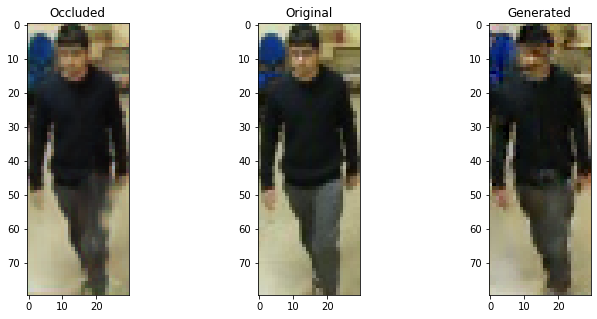

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


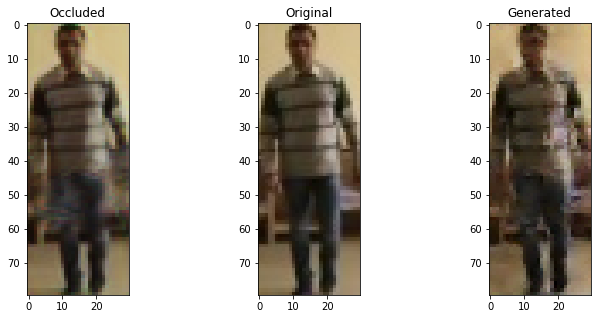

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


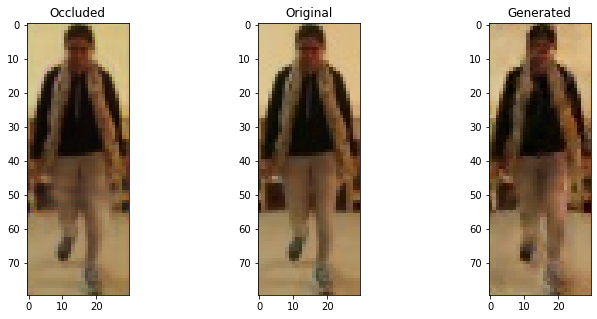

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


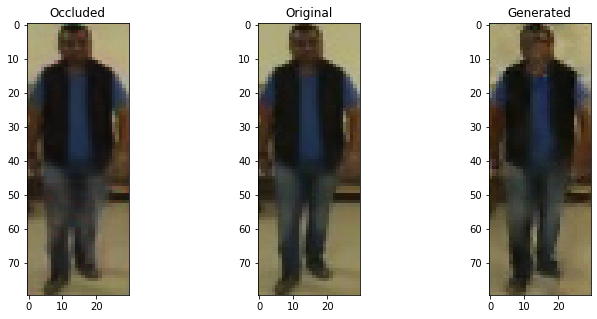

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


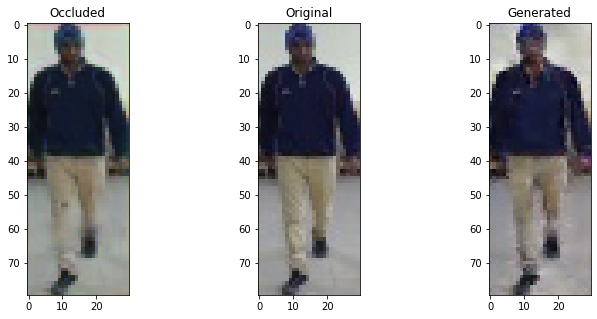

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.665559709072113 , Adversarial Loss:  0.0003792927018366754
Epoch 2502


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6398535966873169 , Adversarial Loss:  0.0003312506014481187
Epoch 2503


  8%|▊         | 1/13 [00:00<00:01,  6.23it/s]

Discriminator Loss:  0.6857990026473999 , Adversarial Loss:  0.000356633507180959
Epoch 2504


  8%|▊         | 1/13 [00:00<00:01,  6.44it/s]

Discriminator Loss:  0.6583542823791504 , Adversarial Loss:  0.00039058327092789114
Epoch 2505


  8%|▊         | 1/13 [00:00<00:01,  6.27it/s]

Discriminator Loss:  0.6600818634033203 , Adversarial Loss:  0.0003526384534779936
Epoch 2506


  8%|▊         | 1/13 [00:00<00:02,  5.76it/s]

Discriminator Loss:  0.6444715261459351 , Adversarial Loss:  0.00036901800194755197
Epoch 2507


  8%|▊         | 1/13 [00:00<00:02,  5.09it/s]

Discriminator Loss:  0.6610947251319885 , Adversarial Loss:  0.0003819404519163072
Epoch 2508


  8%|▊         | 1/13 [00:00<00:02,  5.24it/s]

Discriminator Loss:  0.6496128439903259 , Adversarial Loss:  0.00037795520620420575
Epoch 2509


  8%|▊         | 1/13 [00:00<00:01,  6.46it/s]

Discriminator Loss:  0.6402412056922913 , Adversarial Loss:  0.0003689649165607989
Epoch 2510


  8%|▊         | 1/13 [00:00<00:01,  6.64it/s]

Discriminator Loss:  0.6647516489028931 , Adversarial Loss:  0.0003681218368001282
Epoch 2511


  8%|▊         | 1/13 [00:00<00:01,  6.67it/s]

Discriminator Loss:  0.6600501537322998 , Adversarial Loss:  0.00036420815740711987
Epoch 2512


  8%|▊         | 1/13 [00:00<00:02,  5.42it/s]

Discriminator Loss:  0.6323401927947998 , Adversarial Loss:  0.00039510370697826147
Epoch 2513


  8%|▊         | 1/13 [00:00<00:01,  6.25it/s]

Discriminator Loss:  0.6526336669921875 , Adversarial Loss:  0.0003586459788493812
Epoch 2514


  8%|▊         | 1/13 [00:00<00:01,  6.59it/s]

Discriminator Loss:  0.6657974123954773 , Adversarial Loss:  0.0003601380449254066
Epoch 2515


  8%|▊         | 1/13 [00:00<00:01,  6.23it/s]

Discriminator Loss:  0.6729240417480469 , Adversarial Loss:  0.00033197482116520405
Epoch 2516


  8%|▊         | 1/13 [00:00<00:01,  6.42it/s]

Discriminator Loss:  0.6624017357826233 , Adversarial Loss:  0.0003658980131149292
Epoch 2517


  8%|▊         | 1/13 [00:00<00:01,  6.54it/s]

Discriminator Loss:  0.6359578371047974 , Adversarial Loss:  0.00033662168425507843
Epoch 2518


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6573574542999268 , Adversarial Loss:  0.00035163122811354697
Epoch 2519


  8%|▊         | 1/13 [00:00<00:01,  6.60it/s]

Discriminator Loss:  0.6493957042694092 , Adversarial Loss:  0.00034807302290573716
Epoch 2520


  8%|▊         | 1/13 [00:00<00:01,  6.61it/s]

Discriminator Loss:  0.6488527059555054 , Adversarial Loss:  0.00034123670775443316
Epoch 2521


100%|██████████| 13/13 [00:02<00:00,  6.20it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


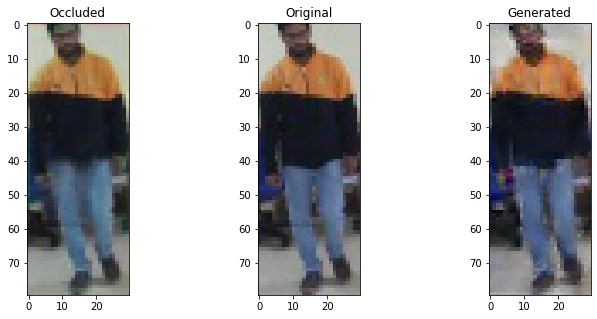

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


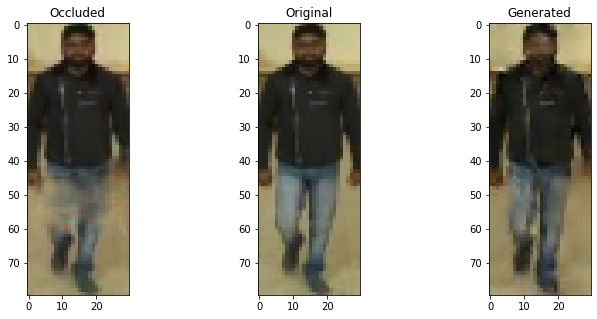

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


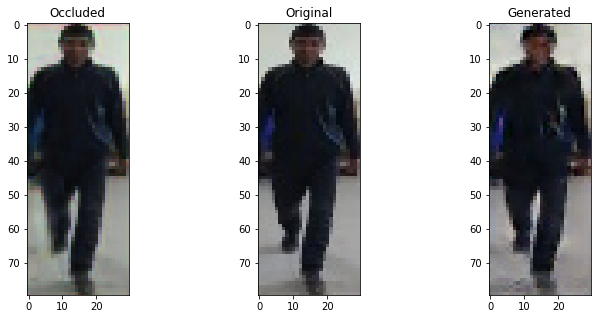

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


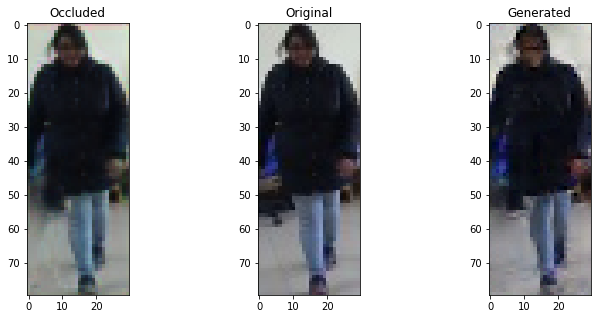

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


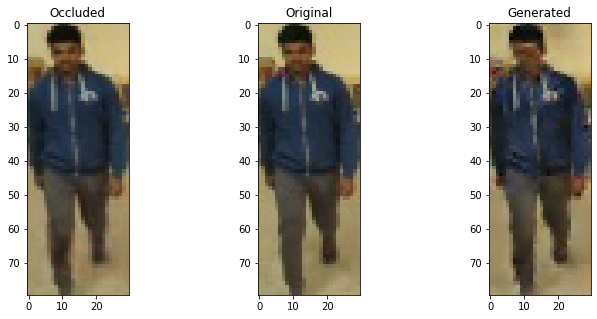

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6680736541748047 , Adversarial Loss:  0.00043046212522313
Epoch 2522


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6711428165435791 , Adversarial Loss:  0.00031721460982225835
Epoch 2523


  8%|▊         | 1/13 [00:00<00:01,  6.25it/s]

Discriminator Loss:  0.6731474995613098 , Adversarial Loss:  0.00038623824366368353
Epoch 2524


  8%|▊         | 1/13 [00:00<00:01,  6.76it/s]

Discriminator Loss:  0.6366395950317383 , Adversarial Loss:  0.00032655399991199374
Epoch 2525


  8%|▊         | 1/13 [00:00<00:01,  6.55it/s]

Discriminator Loss:  0.6458542943000793 , Adversarial Loss:  0.0003972399281337857
Epoch 2526


  8%|▊         | 1/13 [00:00<00:01,  6.91it/s]

Discriminator Loss:  0.6605721116065979 , Adversarial Loss:  0.0003645892720669508
Epoch 2527


  8%|▊         | 1/13 [00:00<00:02,  5.78it/s]

Discriminator Loss:  0.667951762676239 , Adversarial Loss:  0.00036933785304427147
Epoch 2528


  8%|▊         | 1/13 [00:00<00:01,  6.36it/s]

Discriminator Loss:  0.6538989543914795 , Adversarial Loss:  0.0003514081472530961
Epoch 2529


  8%|▊         | 1/13 [00:00<00:01,  6.85it/s]

Discriminator Loss:  0.651060163974762 , Adversarial Loss:  0.0003597010509110987
Epoch 2530


  8%|▊         | 1/13 [00:00<00:02,  5.19it/s]

Discriminator Loss:  0.6487678289413452 , Adversarial Loss:  0.0003509995876811445
Epoch 2531


  8%|▊         | 1/13 [00:00<00:01,  6.61it/s]

Discriminator Loss:  0.6725441217422485 , Adversarial Loss:  0.0003670351579785347
Epoch 2532


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6766237020492554 , Adversarial Loss:  0.00037115233135409653
Epoch 2533


  8%|▊         | 1/13 [00:00<00:01,  6.78it/s]

Discriminator Loss:  0.6616584062576294 , Adversarial Loss:  0.0003406161558814347
Epoch 2534


  8%|▊         | 1/13 [00:00<00:01,  6.80it/s]

Discriminator Loss:  0.6628782749176025 , Adversarial Loss:  0.0003514829440973699
Epoch 2535


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6682276725769043 , Adversarial Loss:  0.0003650246071629226
Epoch 2536


  8%|▊         | 1/13 [00:00<00:01,  6.98it/s]

Discriminator Loss:  0.663930356502533 , Adversarial Loss:  0.0003573453868739307
Epoch 2537


  8%|▊         | 1/13 [00:00<00:01,  6.90it/s]

Discriminator Loss:  0.6826014518737793 , Adversarial Loss:  0.0003468944923952222
Epoch 2538


  8%|▊         | 1/13 [00:00<00:02,  5.26it/s]

Discriminator Loss:  0.6864821910858154 , Adversarial Loss:  0.00035941757960245013
Epoch 2539


  8%|▊         | 1/13 [00:00<00:01,  6.33it/s]

Discriminator Loss:  0.6744333505630493 , Adversarial Loss:  0.00036936189280822873
Epoch 2540


  8%|▊         | 1/13 [00:00<00:02,  5.33it/s]

Discriminator Loss:  0.646518349647522 , Adversarial Loss:  0.00032930297311395407
Epoch 2541


100%|██████████| 13/13 [00:02<00:00,  5.87it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


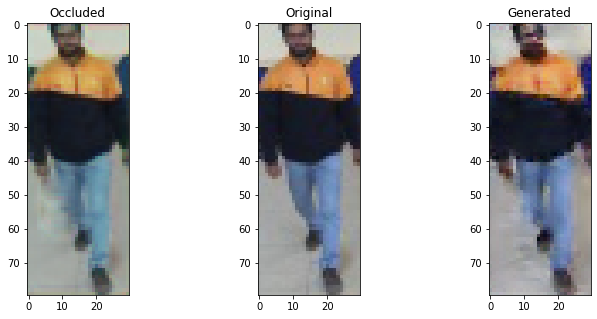

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


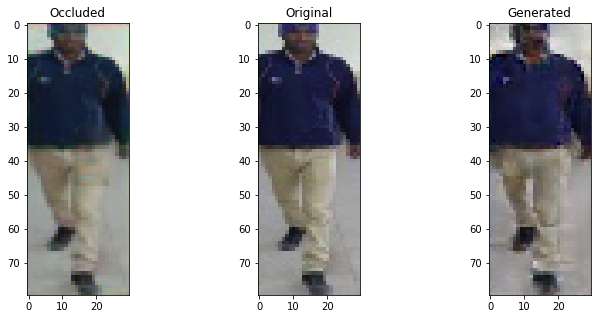

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


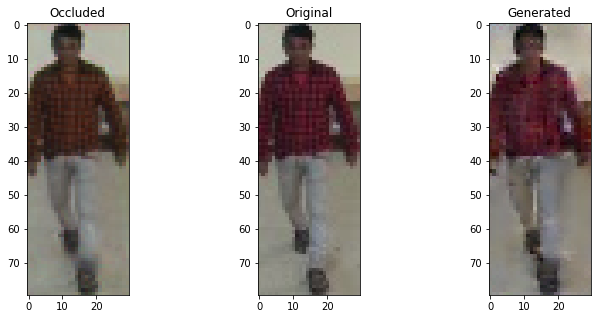

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


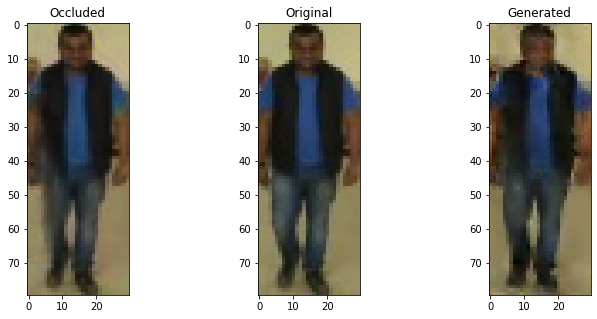

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


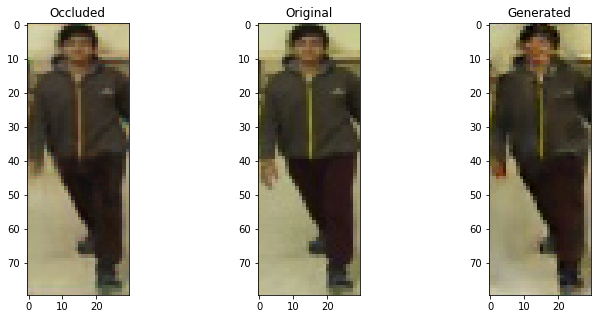

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6458449363708496 , Adversarial Loss:  0.00040736247319728136
Epoch 2542


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6543389558792114 , Adversarial Loss:  0.00038853491423651576
Epoch 2543


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6566194891929626 , Adversarial Loss:  0.0003178698243573308
Epoch 2544


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6532745361328125 , Adversarial Loss:  0.00041414040606468916
Epoch 2545


  8%|▊         | 1/13 [00:00<00:01,  6.78it/s]

Discriminator Loss:  0.6559940576553345 , Adversarial Loss:  0.0003911987878382206
Epoch 2546


  8%|▊         | 1/13 [00:00<00:01,  6.54it/s]

Discriminator Loss:  0.6489246487617493 , Adversarial Loss:  0.0003510673122946173
Epoch 2547


  8%|▊         | 1/13 [00:00<00:01,  6.69it/s]

Discriminator Loss:  0.667609453201294 , Adversarial Loss:  0.0003890611114911735
Epoch 2548


  8%|▊         | 1/13 [00:00<00:01,  6.53it/s]

Discriminator Loss:  0.6562150716781616 , Adversarial Loss:  0.0003729538875631988
Epoch 2549


  8%|▊         | 1/13 [00:00<00:01,  6.47it/s]

Discriminator Loss:  0.6741068363189697 , Adversarial Loss:  0.00034160184441134334
Epoch 2550


  8%|▊         | 1/13 [00:00<00:01,  6.57it/s]

Discriminator Loss:  0.672642707824707 , Adversarial Loss:  0.0003496433491818607
Epoch 2551


  8%|▊         | 1/13 [00:00<00:02,  5.70it/s]

Discriminator Loss:  0.6494545340538025 , Adversarial Loss:  0.0003778607351705432
Epoch 2552


  8%|▊         | 1/13 [00:00<00:01,  6.92it/s]

Discriminator Loss:  0.6545042991638184 , Adversarial Loss:  0.0003426177136134356
Epoch 2553


  8%|▊         | 1/13 [00:00<00:01,  6.77it/s]

Discriminator Loss:  0.6389137506484985 , Adversarial Loss:  0.00039828504668548703
Epoch 2554


  8%|▊         | 1/13 [00:00<00:01,  6.34it/s]

Discriminator Loss:  0.6492623090744019 , Adversarial Loss:  0.0003583462967071682
Epoch 2555


  8%|▊         | 1/13 [00:00<00:01,  6.43it/s]

Discriminator Loss:  0.6651382446289062 , Adversarial Loss:  0.0003629305574577302
Epoch 2556


  8%|▊         | 1/13 [00:00<00:01,  6.40it/s]

Discriminator Loss:  0.6448894739151001 , Adversarial Loss:  0.0003534409333951771
Epoch 2557


  8%|▊         | 1/13 [00:00<00:01,  6.92it/s]

Discriminator Loss:  0.6455529928207397 , Adversarial Loss:  0.0003481743042357266
Epoch 2558


  8%|▊         | 1/13 [00:00<00:01,  6.06it/s]

Discriminator Loss:  0.6491872668266296 , Adversarial Loss:  0.00034666573628783226
Epoch 2559


  8%|▊         | 1/13 [00:00<00:02,  5.90it/s]

Discriminator Loss:  0.6746664047241211 , Adversarial Loss:  0.00036168735823594034
Epoch 2560


  8%|▊         | 1/13 [00:00<00:01,  6.84it/s]

Discriminator Loss:  0.629557728767395 , Adversarial Loss:  0.00035642151487991214
Epoch 2561


100%|██████████| 13/13 [00:02<00:00,  5.96it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


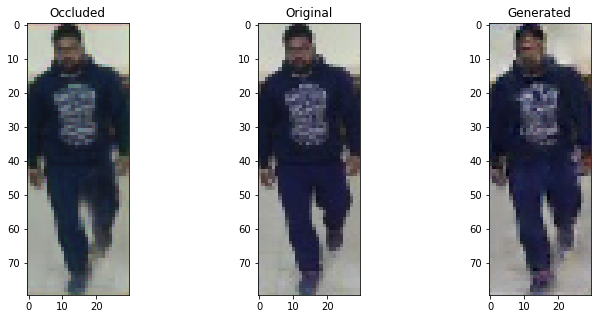

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


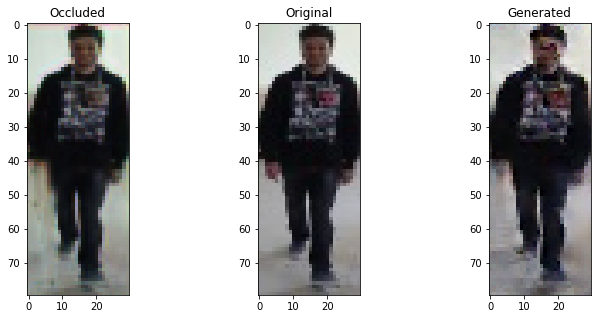

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


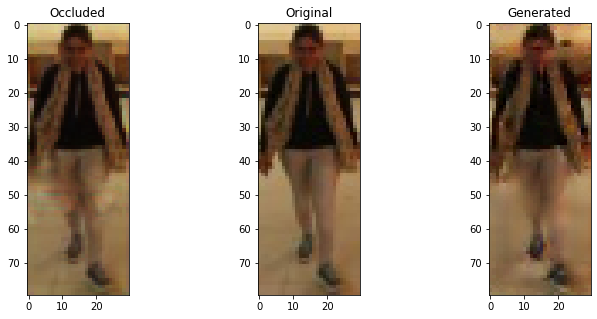

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


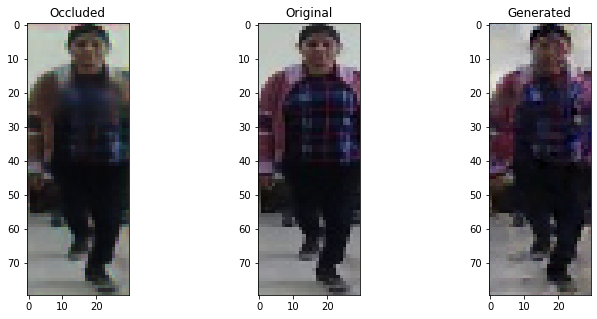

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


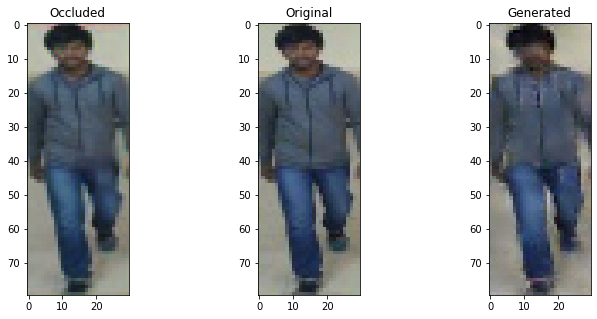

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6352066993713379 , Adversarial Loss:  0.00038937677163630724
Epoch 2562


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6656210422515869 , Adversarial Loss:  0.0004013755824416876
Epoch 2563


  8%|▊         | 1/13 [00:00<00:02,  5.63it/s]

Discriminator Loss:  0.6509263515472412 , Adversarial Loss:  0.0003641332732513547
Epoch 2564


  8%|▊         | 1/13 [00:00<00:01,  6.19it/s]

Discriminator Loss:  0.6686177849769592 , Adversarial Loss:  0.00032140896655619144
Epoch 2565


  8%|▊         | 1/13 [00:00<00:01,  6.51it/s]

Discriminator Loss:  0.6660475730895996 , Adversarial Loss:  0.0003362927818670869
Epoch 2566


  8%|▊         | 1/13 [00:00<00:01,  6.74it/s]

Discriminator Loss:  0.6576370596885681 , Adversarial Loss:  0.00037027455982752144
Epoch 2567


  8%|▊         | 1/13 [00:00<00:02,  5.43it/s]

Discriminator Loss:  0.6429860591888428 , Adversarial Loss:  0.0003533591516315937
Epoch 2568


  8%|▊         | 1/13 [00:00<00:02,  5.16it/s]

Discriminator Loss:  0.6619032621383667 , Adversarial Loss:  0.00037811161018908024
Epoch 2569


  8%|▊         | 1/13 [00:00<00:01,  6.68it/s]

Discriminator Loss:  0.6536493301391602 , Adversarial Loss:  0.0003806958848144859
Epoch 2570


  8%|▊         | 1/13 [00:00<00:02,  5.25it/s]

Discriminator Loss:  0.662036120891571 , Adversarial Loss:  0.000373699062038213
Epoch 2571


  8%|▊         | 1/13 [00:00<00:01,  7.03it/s]

Discriminator Loss:  0.6595677733421326 , Adversarial Loss:  0.0003552694688551128
Epoch 2572


  8%|▊         | 1/13 [00:00<00:01,  6.69it/s]

Discriminator Loss:  0.644515335559845 , Adversarial Loss:  0.00035272733657620847
Epoch 2573


  8%|▊         | 1/13 [00:00<00:01,  6.63it/s]

Discriminator Loss:  0.6711846590042114 , Adversarial Loss:  0.00035755670978687704
Epoch 2574


  8%|▊         | 1/13 [00:00<00:01,  6.68it/s]

Discriminator Loss:  0.6677619218826294 , Adversarial Loss:  0.000333129137288779
Epoch 2575


  8%|▊         | 1/13 [00:00<00:02,  5.74it/s]

Discriminator Loss:  0.6484428644180298 , Adversarial Loss:  0.00034806219628080726
Epoch 2576


  8%|▊         | 1/13 [00:00<00:01,  6.95it/s]

Discriminator Loss:  0.6490695476531982 , Adversarial Loss:  0.00035898282658308744
Epoch 2577


  8%|▊         | 1/13 [00:00<00:01,  6.15it/s]

Discriminator Loss:  0.6677089929580688 , Adversarial Loss:  0.00038672599475830793
Epoch 2578


  8%|▊         | 1/13 [00:00<00:01,  6.97it/s]

Discriminator Loss:  0.6864482164382935 , Adversarial Loss:  0.00033522851299494505
Epoch 2579


  8%|▊         | 1/13 [00:00<00:01,  6.95it/s]

Discriminator Loss:  0.6690030694007874 , Adversarial Loss:  0.0003672336461022496
Epoch 2580


  8%|▊         | 1/13 [00:00<00:01,  6.84it/s]

Discriminator Loss:  0.6541195511817932 , Adversarial Loss:  0.0003797905519604683
Epoch 2581


100%|██████████| 13/13 [00:02<00:00,  6.08it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


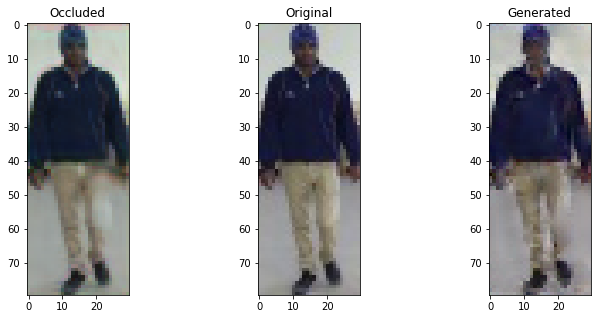

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


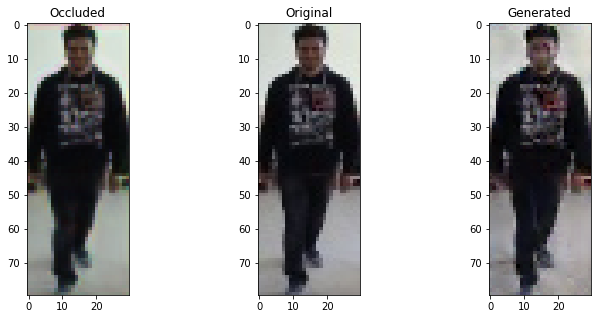

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


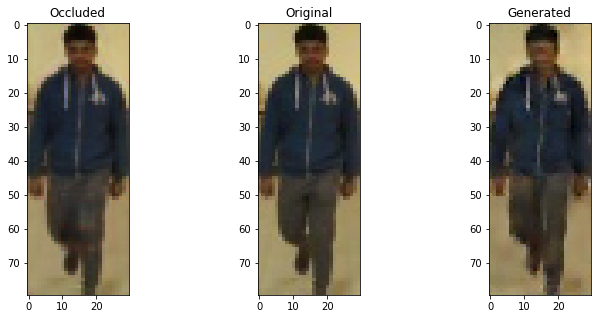

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


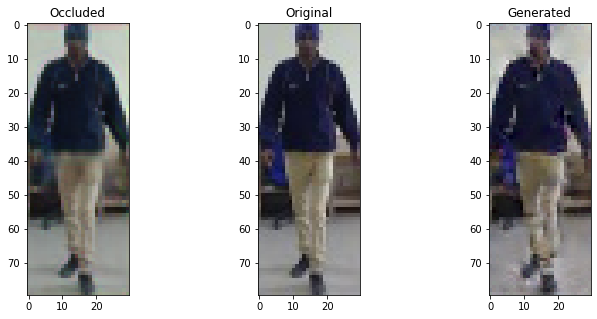

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


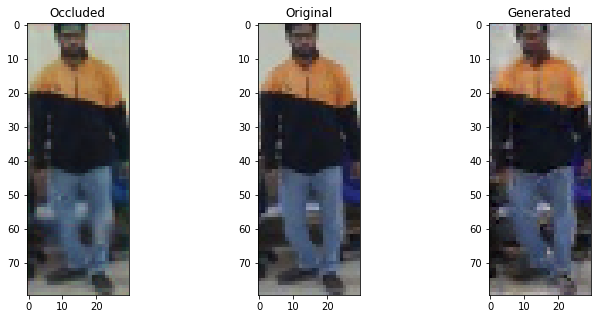

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6586424708366394 , Adversarial Loss:  0.00039195705903694034
Epoch 2582


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6636649370193481 , Adversarial Loss:  0.00034083001082763076
Epoch 2583


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6584682464599609 , Adversarial Loss:  0.0003435612889006734
Epoch 2584


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.667664110660553 , Adversarial Loss:  0.0003437671111896634
Epoch 2585


  8%|▊         | 1/13 [00:00<00:01,  6.96it/s]

Discriminator Loss:  0.6340983510017395 , Adversarial Loss:  0.00034416973358020186
Epoch 2586


  8%|▊         | 1/13 [00:00<00:01,  6.81it/s]

Discriminator Loss:  0.6504802703857422 , Adversarial Loss:  0.0003333070781081915
Epoch 2587


  8%|▊         | 1/13 [00:00<00:01,  7.04it/s]

Discriminator Loss:  0.647884726524353 , Adversarial Loss:  0.0003577556926757097
Epoch 2588


  8%|▊         | 1/13 [00:00<00:01,  6.65it/s]

Discriminator Loss:  0.6616090536117554 , Adversarial Loss:  0.0003508075897116214
Epoch 2589


  8%|▊         | 1/13 [00:00<00:01,  6.72it/s]

Discriminator Loss:  0.6704117059707642 , Adversarial Loss:  0.0003491495444905013
Epoch 2590


  8%|▊         | 1/13 [00:00<00:01,  6.87it/s]

Discriminator Loss:  0.6412351131439209 , Adversarial Loss:  0.0003367573954164982
Epoch 2591


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6568472385406494 , Adversarial Loss:  0.0003413588274270296
Epoch 2592


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6540814638137817 , Adversarial Loss:  0.0003551963600330055
Epoch 2593


  8%|▊         | 1/13 [00:00<00:01,  7.06it/s]

Discriminator Loss:  0.664588212966919 , Adversarial Loss:  0.000359196710633114
Epoch 2594


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6527953147888184 , Adversarial Loss:  0.00035872479202225804
Epoch 2595


  8%|▊         | 1/13 [00:00<00:01,  6.27it/s]

Discriminator Loss:  0.6670137643814087 , Adversarial Loss:  0.00033981550950556993
Epoch 2596


  8%|▊         | 1/13 [00:00<00:01,  6.94it/s]

Discriminator Loss:  0.6714116930961609 , Adversarial Loss:  0.000352796952938661
Epoch 2597


  8%|▊         | 1/13 [00:00<00:01,  7.12it/s]

Discriminator Loss:  0.6618765592575073 , Adversarial Loss:  0.01502399891614914
Epoch 2598


  8%|▊         | 1/13 [00:00<00:01,  6.33it/s]

Discriminator Loss:  0.664050817489624 , Adversarial Loss:  0.003514716401696205
Epoch 2599


  8%|▊         | 1/13 [00:00<00:01,  6.60it/s]

Discriminator Loss:  0.6633769869804382 , Adversarial Loss:  0.0027695365715771914
Epoch 2600


  8%|▊         | 1/13 [00:00<00:01,  6.81it/s]

Discriminator Loss:  0.6459934711456299 , Adversarial Loss:  0.002583807334303856
Epoch 2601


100%|██████████| 13/13 [00:02<00:00,  6.33it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


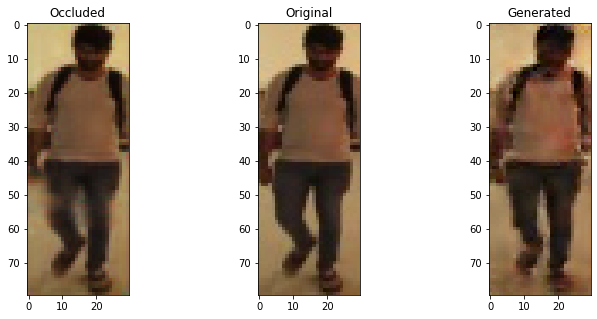

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


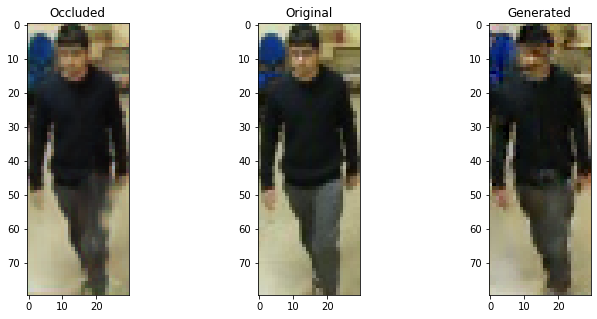

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


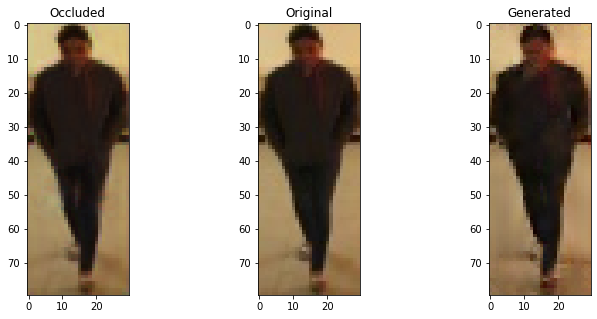

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


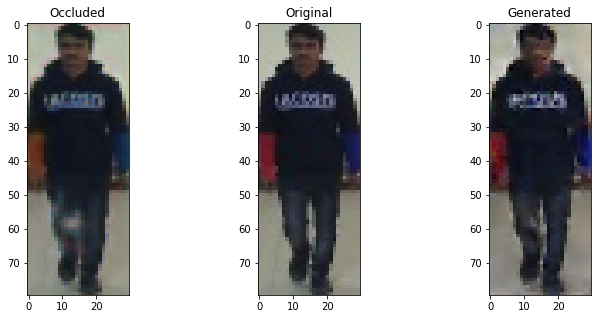

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


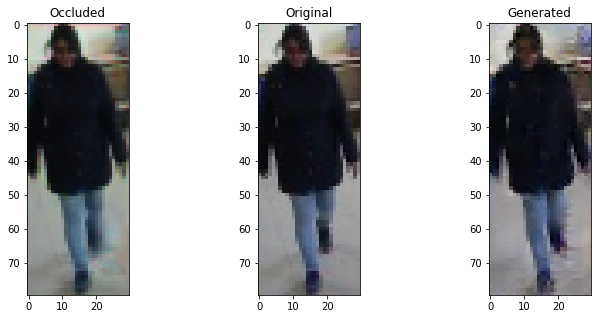

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6749210357666016 , Adversarial Loss:  0.002144461264833808
Epoch 2602


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6395294666290283 , Adversarial Loss:  0.0019991518929600716
Epoch 2603


  8%|▊         | 1/13 [00:00<00:01,  6.70it/s]

Discriminator Loss:  0.6659870147705078 , Adversarial Loss:  0.0016998107312247157
Epoch 2604


  8%|▊         | 1/13 [00:00<00:01,  6.16it/s]

Discriminator Loss:  0.6464864611625671 , Adversarial Loss:  0.0016159098595380783
Epoch 2605


  8%|▊         | 1/13 [00:00<00:01,  7.15it/s]

Discriminator Loss:  0.642432451248169 , Adversarial Loss:  0.0014773913426324725
Epoch 2606


  8%|▊         | 1/13 [00:00<00:01,  6.75it/s]

Discriminator Loss:  0.6601229310035706 , Adversarial Loss:  0.001331542618572712
Epoch 2607


  8%|▊         | 1/13 [00:00<00:01,  6.74it/s]

Discriminator Loss:  0.663119912147522 , Adversarial Loss:  0.0012400343548506498
Epoch 2608


  8%|▊         | 1/13 [00:00<00:01,  6.19it/s]

Discriminator Loss:  0.628655731678009 , Adversarial Loss:  0.001174726290628314
Epoch 2609


  8%|▊         | 1/13 [00:00<00:01,  6.96it/s]

Discriminator Loss:  0.6465295553207397 , Adversarial Loss:  0.0009588126558810472
Epoch 2610


  8%|▊         | 1/13 [00:00<00:01,  6.70it/s]

Discriminator Loss:  0.6690692901611328 , Adversarial Loss:  0.0010187209118157625
Epoch 2611


  8%|▊         | 1/13 [00:00<00:01,  6.87it/s]

Discriminator Loss:  0.6558898091316223 , Adversarial Loss:  0.0008724186918698251
Epoch 2612


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6284178495407104 , Adversarial Loss:  0.0008209447842091322
Epoch 2613


  8%|▊         | 1/13 [00:00<00:01,  6.78it/s]

Discriminator Loss:  0.6612496376037598 , Adversarial Loss:  0.0007599650416523218
Epoch 2614


  8%|▊         | 1/13 [00:00<00:01,  6.76it/s]

Discriminator Loss:  0.6690597534179688 , Adversarial Loss:  0.0007365617202594876
Epoch 2615


  8%|▊         | 1/13 [00:00<00:01,  6.44it/s]

Discriminator Loss:  0.6429863572120667 , Adversarial Loss:  0.0006956106517463923
Epoch 2616


  8%|▊         | 1/13 [00:00<00:01,  6.67it/s]

Discriminator Loss:  0.666212260723114 , Adversarial Loss:  0.0006053465185686946
Epoch 2617


  8%|▊         | 1/13 [00:00<00:01,  6.79it/s]

Discriminator Loss:  0.6500943303108215 , Adversarial Loss:  0.000608000555075705
Epoch 2618


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6659431457519531 , Adversarial Loss:  0.0006402754224836826
Epoch 2619


  8%|▊         | 1/13 [00:00<00:01,  6.83it/s]

Discriminator Loss:  0.6548806428909302 , Adversarial Loss:  0.0005564746679738164
Epoch 2620


  8%|▊         | 1/13 [00:00<00:02,  5.86it/s]

Discriminator Loss:  0.6614104509353638 , Adversarial Loss:  0.0005339015042409301
Epoch 2621


100%|██████████| 13/13 [00:02<00:00,  6.17it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


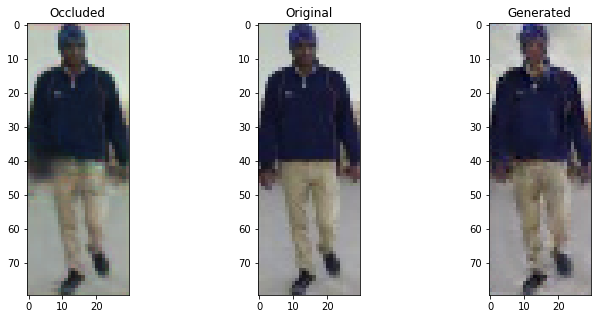

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


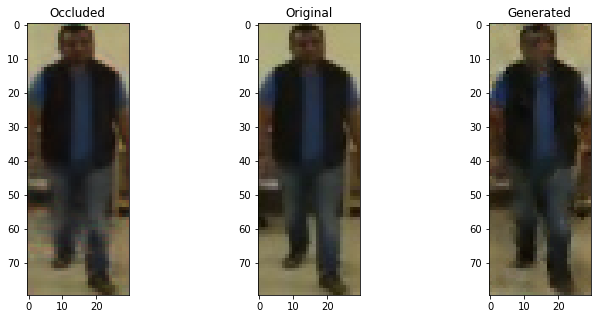

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


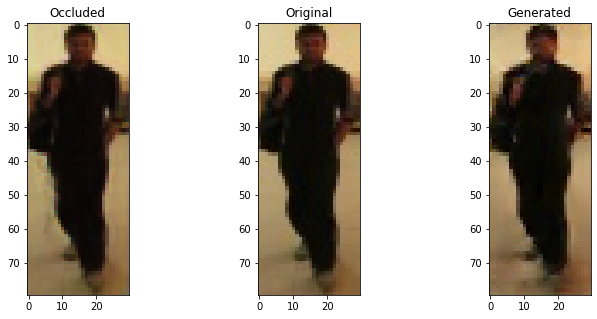

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


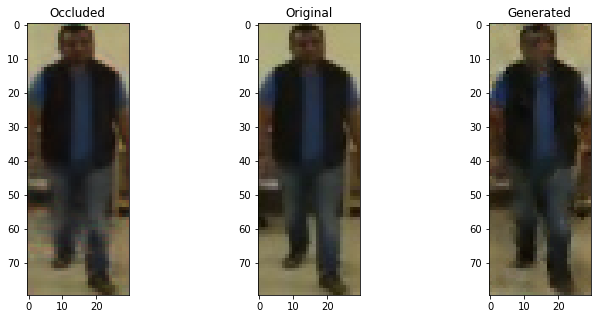

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


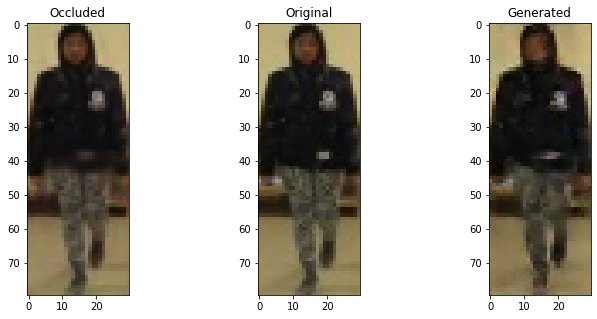

  8%|▊         | 1/13 [00:00<00:02,  5.71it/s]

Discriminator Loss:  0.6508674025535583 , Adversarial Loss:  0.00047927250852808356
Epoch 2622


  8%|▊         | 1/13 [00:00<00:01,  6.73it/s]

Discriminator Loss:  0.6419460773468018 , Adversarial Loss:  0.00048542500007897615
Epoch 2623


  8%|▊         | 1/13 [00:00<00:01,  6.89it/s]

Discriminator Loss:  0.6469281911849976 , Adversarial Loss:  0.00045130314538255334
Epoch 2624


  8%|▊         | 1/13 [00:00<00:02,  5.65it/s]

Discriminator Loss:  0.6458622813224792 , Adversarial Loss:  0.0005151815130375326
Epoch 2625


  8%|▊         | 1/13 [00:00<00:01,  6.54it/s]

Discriminator Loss:  0.6516605019569397 , Adversarial Loss:  0.0005018641240894794
Epoch 2626


  8%|▊         | 1/13 [00:00<00:01,  6.93it/s]

Discriminator Loss:  0.6777231097221375 , Adversarial Loss:  0.00044641364365816116
Epoch 2627


  8%|▊         | 1/13 [00:00<00:01,  6.72it/s]

Discriminator Loss:  0.6482656002044678 , Adversarial Loss:  0.00047865317901596427
Epoch 2628


  8%|▊         | 1/13 [00:00<00:01,  6.64it/s]

Discriminator Loss:  0.6465490460395813 , Adversarial Loss:  0.00047155431821011007
Epoch 2629


  8%|▊         | 1/13 [00:00<00:01,  6.72it/s]

Discriminator Loss:  0.6536469459533691 , Adversarial Loss:  0.0004436424351297319
Epoch 2630


  8%|▊         | 1/13 [00:00<00:01,  6.94it/s]

Discriminator Loss:  0.6539509296417236 , Adversarial Loss:  0.0004749878426082432
Epoch 2631


  8%|▊         | 1/13 [00:00<00:01,  6.14it/s]

Discriminator Loss:  0.6590838432312012 , Adversarial Loss:  0.00039785949047654867
Epoch 2632


  8%|▊         | 1/13 [00:00<00:01,  6.11it/s]

Discriminator Loss:  0.6690539121627808 , Adversarial Loss:  0.0005007499130442739
Epoch 2633


  8%|▊         | 1/13 [00:00<00:01,  6.55it/s]

Discriminator Loss:  0.6430502533912659 , Adversarial Loss:  0.0004460923373699188
Epoch 2634


  8%|▊         | 1/13 [00:00<00:01,  6.05it/s]

Discriminator Loss:  0.6917562484741211 , Adversarial Loss:  0.0004299395368434489
Epoch 2635


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6475266218185425 , Adversarial Loss:  0.00038675899850204587
Epoch 2636


  8%|▊         | 1/13 [00:00<00:01,  6.07it/s]

Discriminator Loss:  0.6451044082641602 , Adversarial Loss:  0.0004303451278246939
Epoch 2637


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6534016728401184 , Adversarial Loss:  0.0004015648737549782
Epoch 2638


  8%|▊         | 1/13 [00:00<00:01,  6.57it/s]

Discriminator Loss:  0.6315357685089111 , Adversarial Loss:  0.0004127310239709914
Epoch 2639


  8%|▊         | 1/13 [00:00<00:01,  6.84it/s]

Discriminator Loss:  0.6871775388717651 , Adversarial Loss:  0.0003788310568779707
Epoch 2640


  8%|▊         | 1/13 [00:00<00:01,  6.64it/s]

Discriminator Loss:  0.673859179019928 , Adversarial Loss:  0.00039796571945771575
Epoch 2641


100%|██████████| 13/13 [00:02<00:00,  6.32it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


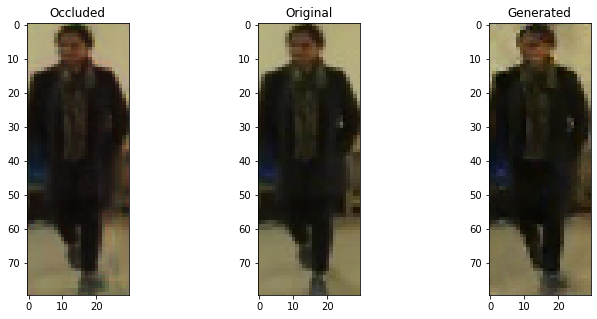

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


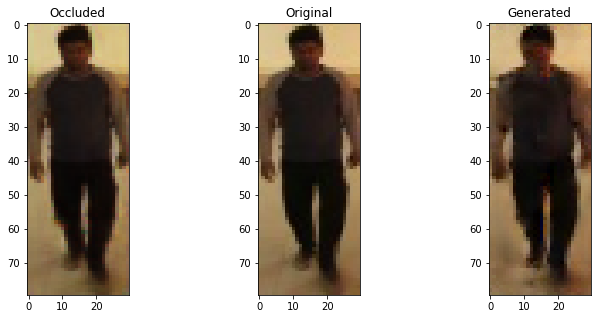

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


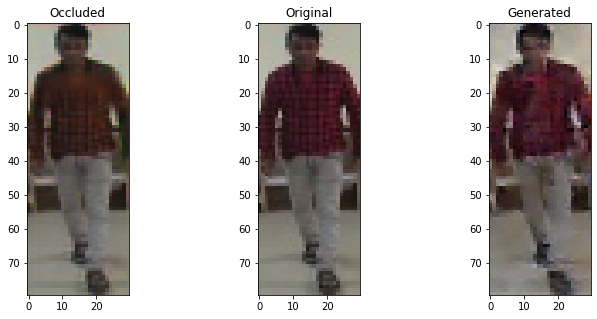

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


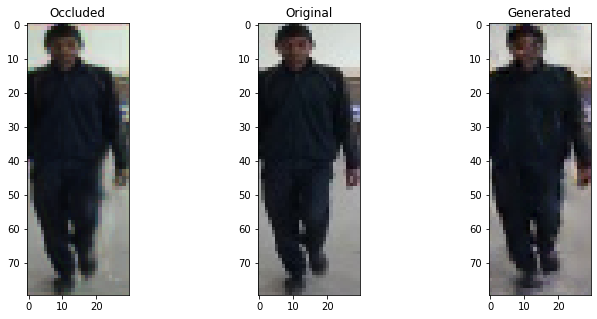

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


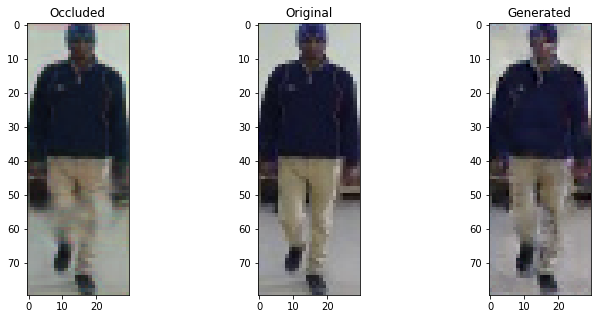

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6474244594573975 , Adversarial Loss:  0.0004257273394614458
Epoch 2642


  8%|▊         | 1/13 [00:00<00:01,  6.44it/s]

Discriminator Loss:  0.6555501222610474 , Adversarial Loss:  0.00039191643008962274
Epoch 2643


  8%|▊         | 1/13 [00:00<00:01,  6.68it/s]

Discriminator Loss:  0.6554657220840454 , Adversarial Loss:  0.00039722691872157156
Epoch 2644


  8%|▊         | 1/13 [00:00<00:01,  6.98it/s]

Discriminator Loss:  0.6459325551986694 , Adversarial Loss:  0.0003753211931325495
Epoch 2645


  8%|▊         | 1/13 [00:00<00:02,  5.59it/s]

Discriminator Loss:  0.6654318571090698 , Adversarial Loss:  0.00039248657412827015
Epoch 2646


  8%|▊         | 1/13 [00:00<00:01,  6.60it/s]

Discriminator Loss:  0.6419531106948853 , Adversarial Loss:  0.00042073483928106725
Epoch 2647


  8%|▊         | 1/13 [00:00<00:01,  6.75it/s]

Discriminator Loss:  0.6576623916625977 , Adversarial Loss:  0.0003723127883858979
Epoch 2648


  8%|▊         | 1/13 [00:00<00:01,  6.39it/s]

Discriminator Loss:  0.6716368794441223 , Adversarial Loss:  0.0003618245245888829
Epoch 2649


  8%|▊         | 1/13 [00:00<00:01,  6.77it/s]

Discriminator Loss:  0.6585729122161865 , Adversarial Loss:  0.0003695657360367477
Epoch 2650


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6696197986602783 , Adversarial Loss:  0.00043001523590646684
Epoch 2651


  8%|▊         | 1/13 [00:00<00:01,  6.80it/s]

Discriminator Loss:  0.6813950538635254 , Adversarial Loss:  0.0003971689147874713
Epoch 2652


  8%|▊         | 1/13 [00:00<00:01,  6.98it/s]

Discriminator Loss:  0.6581543684005737 , Adversarial Loss:  0.00037284105201251805
Epoch 2653


  8%|▊         | 1/13 [00:00<00:01,  7.14it/s]

Discriminator Loss:  0.6667022705078125 , Adversarial Loss:  0.00038762076292186975
Epoch 2654


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6531028747558594 , Adversarial Loss:  0.00037488967063836753
Epoch 2655


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6562079191207886 , Adversarial Loss:  0.00042402383405715227
Epoch 2656


  8%|▊         | 1/13 [00:00<00:01,  6.76it/s]

Discriminator Loss:  0.6515192985534668 , Adversarial Loss:  0.00041168800089508295
Epoch 2657


  8%|▊         | 1/13 [00:00<00:01,  6.79it/s]

Discriminator Loss:  0.6812781095504761 , Adversarial Loss:  0.00036362395621836185
Epoch 2658


  8%|▊         | 1/13 [00:00<00:01,  6.15it/s]

Discriminator Loss:  0.6543904542922974 , Adversarial Loss:  0.00039523138548247516
Epoch 2659


  8%|▊         | 1/13 [00:00<00:01,  6.20it/s]

Discriminator Loss:  0.6356111168861389 , Adversarial Loss:  0.0003416085965000093
Epoch 2660


  8%|▊         | 1/13 [00:00<00:01,  6.56it/s]

Discriminator Loss:  0.6514363288879395 , Adversarial Loss:  0.0003704254631884396
Epoch 2661


100%|██████████| 13/13 [00:02<00:00,  6.26it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


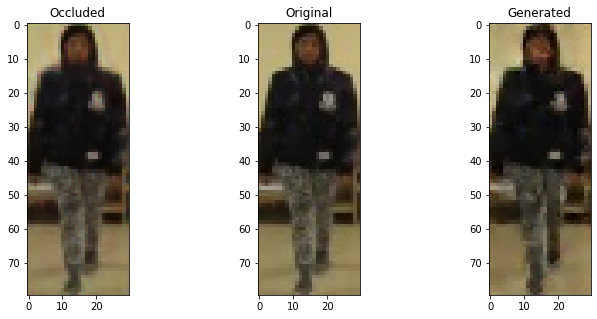

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


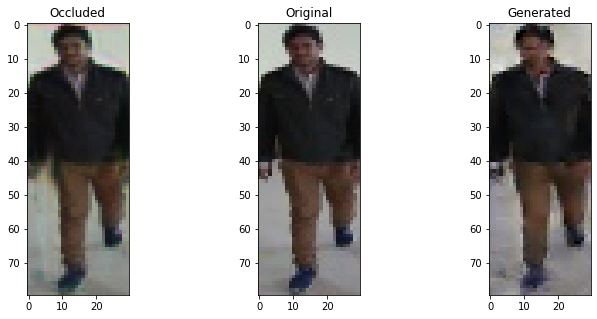

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


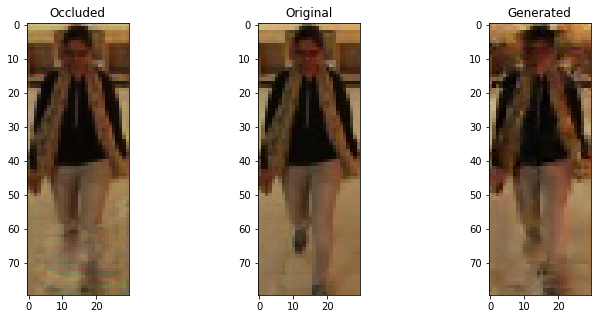

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


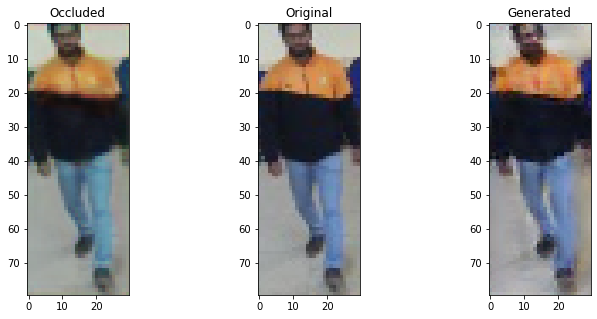

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


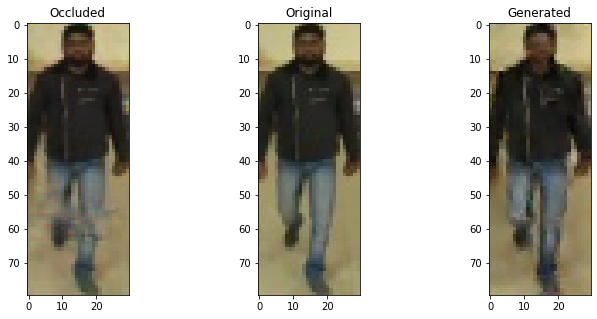

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6526639461517334 , Adversarial Loss:  0.0004035379970446229
Epoch 2662


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6600191593170166 , Adversarial Loss:  0.0003744757268577814
Epoch 2663


  8%|▊         | 1/13 [00:00<00:02,  5.23it/s]

Discriminator Loss:  0.658715546131134 , Adversarial Loss:  0.00037756568053737283
Epoch 2664


  8%|▊         | 1/13 [00:00<00:01,  6.79it/s]

Discriminator Loss:  0.6775796413421631 , Adversarial Loss:  0.00038613402284681797
Epoch 2665


  8%|▊         | 1/13 [00:00<00:01,  6.45it/s]

Discriminator Loss:  0.6725707650184631 , Adversarial Loss:  0.00038950087036937475
Epoch 2666


  8%|▊         | 1/13 [00:00<00:01,  6.69it/s]

Discriminator Loss:  0.6776655912399292 , Adversarial Loss:  0.00041010280256159604
Epoch 2667


  8%|▊         | 1/13 [00:00<00:01,  6.75it/s]

Discriminator Loss:  0.6429997682571411 , Adversarial Loss:  0.0003801407292485237
Epoch 2668


  8%|▊         | 1/13 [00:00<00:01,  6.80it/s]

Discriminator Loss:  0.6561806201934814 , Adversarial Loss:  0.00038096733624115586
Epoch 2669


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6597702503204346 , Adversarial Loss:  0.00038518811925314367
Epoch 2670


  8%|▊         | 1/13 [00:00<00:02,  5.25it/s]

Discriminator Loss:  0.6456563472747803 , Adversarial Loss:  0.00038833971484564245
Epoch 2671


  8%|▊         | 1/13 [00:00<00:02,  5.95it/s]

Discriminator Loss:  0.6739320158958435 , Adversarial Loss:  0.00038234161911532283
Epoch 2672


  8%|▊         | 1/13 [00:00<00:01,  6.52it/s]

Discriminator Loss:  0.6555754542350769 , Adversarial Loss:  0.0003629723796620965
Epoch 2673


  8%|▊         | 1/13 [00:00<00:02,  5.42it/s]

Discriminator Loss:  0.6586326360702515 , Adversarial Loss:  0.0004070177674293518
Epoch 2674


  8%|▊         | 1/13 [00:00<00:02,  5.32it/s]

Discriminator Loss:  0.6574703454971313 , Adversarial Loss:  0.0003965823561884463
Epoch 2675


  8%|▊         | 1/13 [00:00<00:01,  6.19it/s]

Discriminator Loss:  0.6554476022720337 , Adversarial Loss:  0.00032254320103675127
Epoch 2676


  8%|▊         | 1/13 [00:00<00:01,  6.66it/s]

Discriminator Loss:  0.6715691089630127 , Adversarial Loss:  0.0003902901371475309
Epoch 2677


  8%|▊         | 1/13 [00:00<00:01,  6.68it/s]

Discriminator Loss:  0.6578682661056519 , Adversarial Loss:  0.0003702620160765946
Epoch 2678


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6497621536254883 , Adversarial Loss:  0.0003841994621325284
Epoch 2679


  8%|▊         | 1/13 [00:00<00:01,  6.65it/s]

Discriminator Loss:  0.6717873811721802 , Adversarial Loss:  0.00036991568049415946
Epoch 2680


  8%|▊         | 1/13 [00:00<00:01,  6.63it/s]

Discriminator Loss:  0.6656597256660461 , Adversarial Loss:  0.0004057847545482218
Epoch 2681


100%|██████████| 13/13 [00:02<00:00,  5.79it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


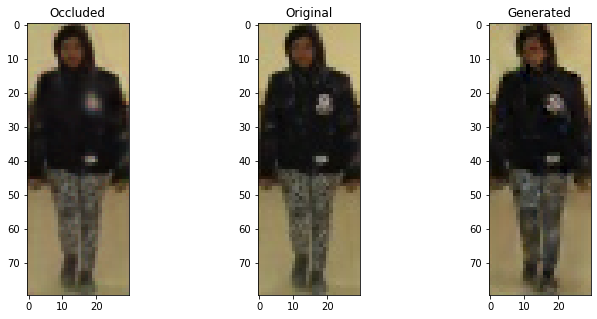

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


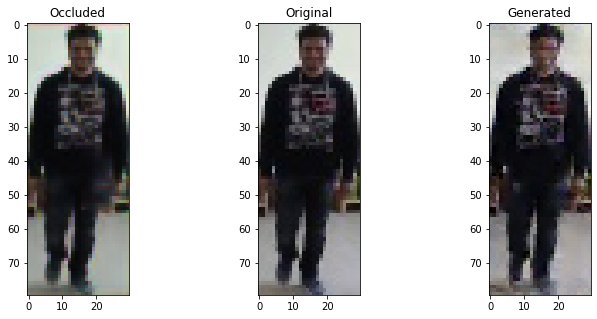

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


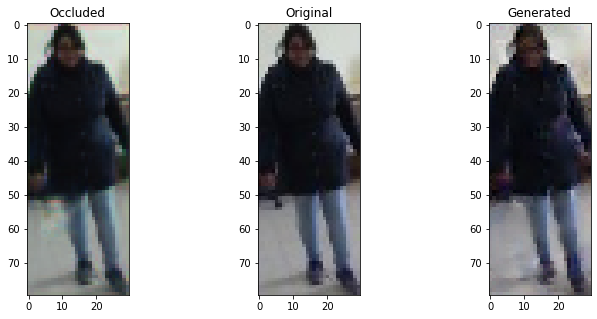

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


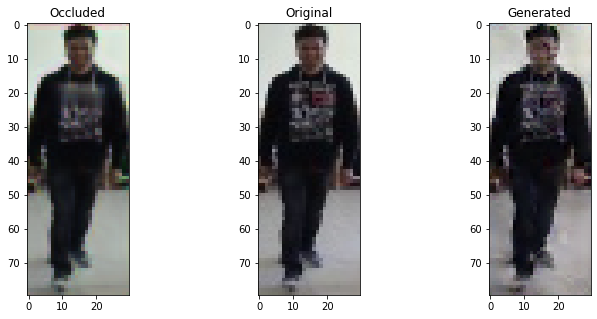

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


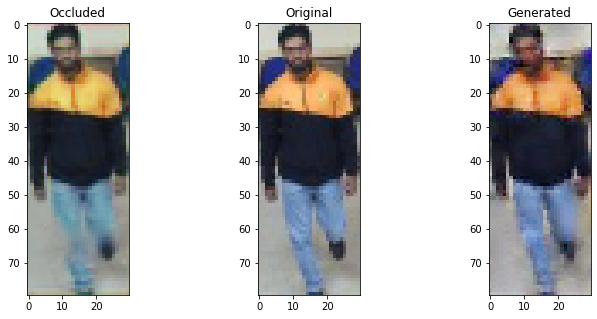

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6703342199325562 , Adversarial Loss:  0.0003914348199032247
Epoch 2682


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6775261163711548 , Adversarial Loss:  0.000403160898713395
Epoch 2683


  8%|▊         | 1/13 [00:00<00:02,  5.99it/s]

Discriminator Loss:  0.6730382442474365 , Adversarial Loss:  0.0003716358041856438
Epoch 2684


  8%|▊         | 1/13 [00:00<00:01,  6.63it/s]

Discriminator Loss:  0.6570608615875244 , Adversarial Loss:  0.00039538677083328366
Epoch 2685


  8%|▊         | 1/13 [00:00<00:02,  5.26it/s]

Discriminator Loss:  0.6575222611427307 , Adversarial Loss:  0.0003804558073170483
Epoch 2686


  8%|▊         | 1/13 [00:00<00:01,  6.62it/s]

Discriminator Loss:  0.6682442426681519 , Adversarial Loss:  0.00037721043918281794
Epoch 2687


  8%|▊         | 1/13 [00:00<00:01,  6.69it/s]

Discriminator Loss:  0.6799167394638062 , Adversarial Loss:  0.0003372414212208241
Epoch 2688


  8%|▊         | 1/13 [00:00<00:01,  6.48it/s]

Discriminator Loss:  0.6185863018035889 , Adversarial Loss:  0.0003498981532175094
Epoch 2689


  8%|▊         | 1/13 [00:00<00:01,  6.60it/s]

Discriminator Loss:  0.6564479470252991 , Adversarial Loss:  0.0003590277337934822
Epoch 2690


  8%|▊         | 1/13 [00:00<00:01,  6.86it/s]

Discriminator Loss:  0.6495840549468994 , Adversarial Loss:  0.000367588218068704
Epoch 2691


  8%|▊         | 1/13 [00:00<00:01,  6.41it/s]

Discriminator Loss:  0.6449168920516968 , Adversarial Loss:  0.00038285728078335524
Epoch 2692


  8%|▊         | 1/13 [00:00<00:01,  6.47it/s]

Discriminator Loss:  0.6665706634521484 , Adversarial Loss:  0.00036952539812773466
Epoch 2693


  8%|▊         | 1/13 [00:00<00:01,  7.12it/s]

Discriminator Loss:  0.6736876964569092 , Adversarial Loss:  0.000331803341396153
Epoch 2694


  8%|▊         | 1/13 [00:00<00:01,  6.81it/s]

Discriminator Loss:  0.6680124402046204 , Adversarial Loss:  0.000373257789760828
Epoch 2695


  8%|▊         | 1/13 [00:00<00:01,  6.33it/s]

Discriminator Loss:  0.6709814071655273 , Adversarial Loss:  0.0003737672814168036
Epoch 2696


  8%|▊         | 1/13 [00:00<00:01,  6.84it/s]

Discriminator Loss:  0.6400012373924255 , Adversarial Loss:  0.0003770150360651314
Epoch 2697


  8%|▊         | 1/13 [00:00<00:01,  7.02it/s]

Discriminator Loss:  0.6620324850082397 , Adversarial Loss:  0.000332941795932129
Epoch 2698


  8%|▊         | 1/13 [00:00<00:01,  6.62it/s]

Discriminator Loss:  0.6733758449554443 , Adversarial Loss:  0.00038048235001042485
Epoch 2699


  8%|▊         | 1/13 [00:00<00:01,  6.48it/s]

Discriminator Loss:  0.6509243249893188 , Adversarial Loss:  0.0003490046947263181
Epoch 2700


  8%|▊         | 1/13 [00:00<00:01,  6.83it/s]

Discriminator Loss:  0.6543638110160828 , Adversarial Loss:  0.0003560582408681512
Epoch 2701


100%|██████████| 13/13 [00:02<00:00,  6.12it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


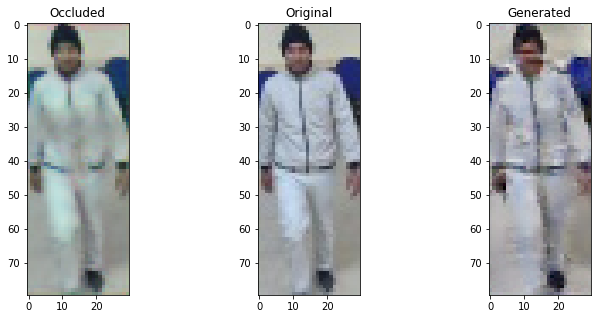

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


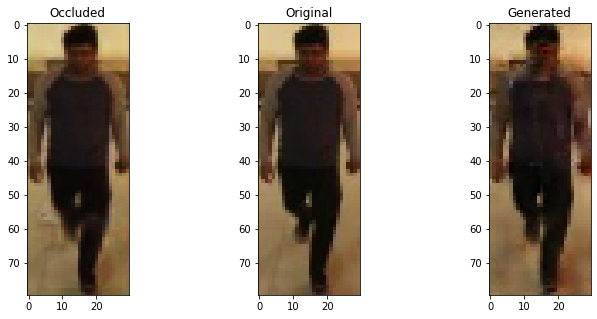

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


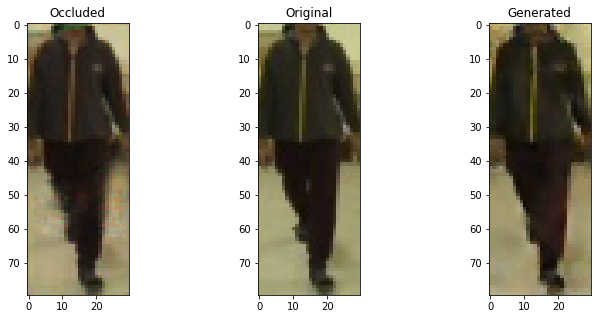

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


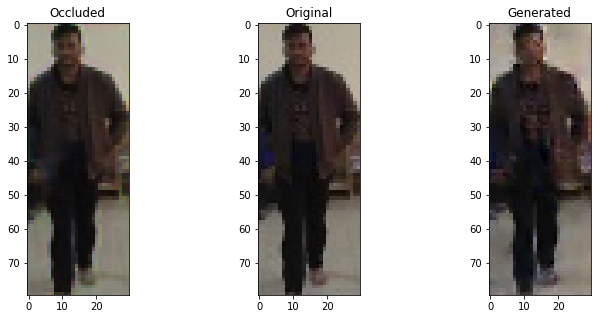

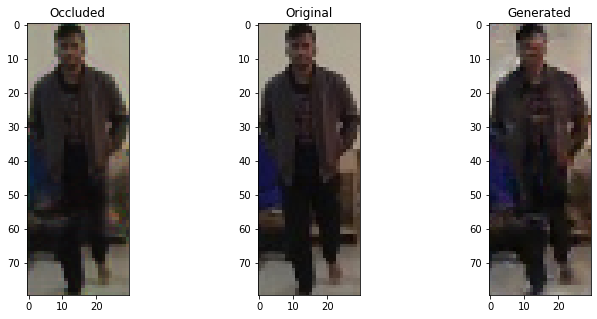

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6595128178596497 , Adversarial Loss:  0.00038726491038687527
Epoch 2702


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.663989782333374 , Adversarial Loss:  0.00036920717684552073
Epoch 2703


  8%|▊         | 1/13 [00:00<00:01,  6.61it/s]

Discriminator Loss:  0.6486604809761047 , Adversarial Loss:  0.00034389685606583953
Epoch 2704


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6477370262145996 , Adversarial Loss:  0.00034236194915138185
Epoch 2705


  8%|▊         | 1/13 [00:00<00:01,  6.49it/s]

Discriminator Loss:  0.6830663084983826 , Adversarial Loss:  0.0003976990992669016
Epoch 2706


  8%|▊         | 1/13 [00:00<00:02,  5.13it/s]

Discriminator Loss:  0.6688598394393921 , Adversarial Loss:  0.00038510968443006277
Epoch 2707


  8%|▊         | 1/13 [00:00<00:01,  6.94it/s]

Discriminator Loss:  0.6504449844360352 , Adversarial Loss:  0.0003526551299728453
Epoch 2708


  8%|▊         | 1/13 [00:00<00:01,  6.98it/s]

Discriminator Loss:  0.6777892708778381 , Adversarial Loss:  0.00035242456942796707
Epoch 2709


  8%|▊         | 1/13 [00:00<00:01,  6.02it/s]

Discriminator Loss:  0.6638427972793579 , Adversarial Loss:  0.0004017919418402016
Epoch 2710


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6624865531921387 , Adversarial Loss:  0.0003241209778934717
Epoch 2711


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6444802284240723 , Adversarial Loss:  0.0003537830780260265
Epoch 2712


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6468894481658936 , Adversarial Loss:  0.0003894052351824939
Epoch 2713


  8%|▊         | 1/13 [00:00<00:02,  5.24it/s]

Discriminator Loss:  0.6585315465927124 , Adversarial Loss:  0.00037132034776732326
Epoch 2714


  8%|▊         | 1/13 [00:00<00:01,  6.88it/s]

Discriminator Loss:  0.6503239870071411 , Adversarial Loss:  0.00040345959132537246
Epoch 2715


  8%|▊         | 1/13 [00:00<00:01,  6.87it/s]

Discriminator Loss:  0.6521493196487427 , Adversarial Loss:  0.0003355182707309723
Epoch 2716


  8%|▊         | 1/13 [00:00<00:01,  6.81it/s]

Discriminator Loss:  0.662183940410614 , Adversarial Loss:  0.00037283109850250185
Epoch 2717


  8%|▊         | 1/13 [00:00<00:01,  6.87it/s]

Discriminator Loss:  0.6617270708084106 , Adversarial Loss:  0.00034737304667942226
Epoch 2718


  8%|▊         | 1/13 [00:00<00:01,  6.72it/s]

Discriminator Loss:  0.6435624957084656 , Adversarial Loss:  0.0003658982750494033
Epoch 2719


  8%|▊         | 1/13 [00:00<00:01,  6.50it/s]

Discriminator Loss:  0.6722917556762695 , Adversarial Loss:  0.0003853863454423845
Epoch 2720


  8%|▊         | 1/13 [00:00<00:01,  6.59it/s]

Discriminator Loss:  0.6528566479682922 , Adversarial Loss:  0.0003850887296721339
Epoch 2721


100%|██████████| 13/13 [00:02<00:00,  6.26it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


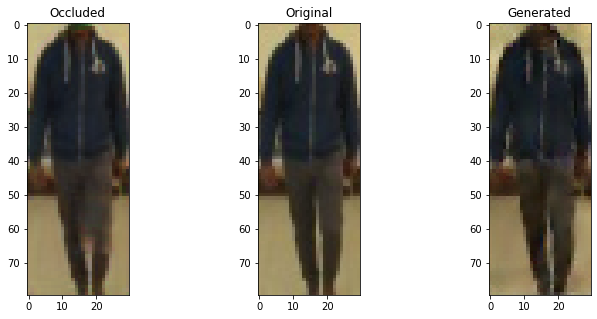

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


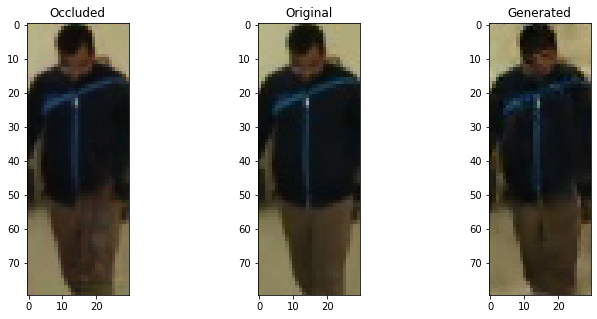

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


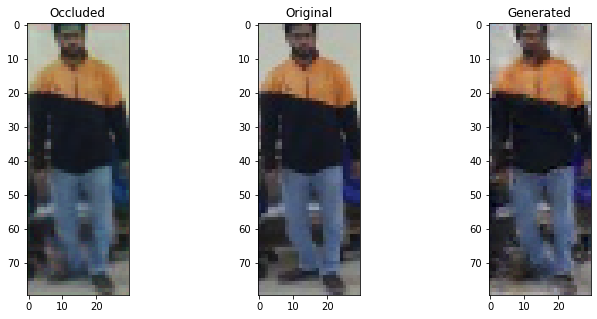

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


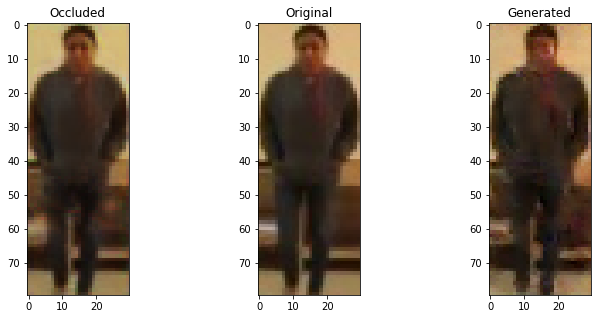

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


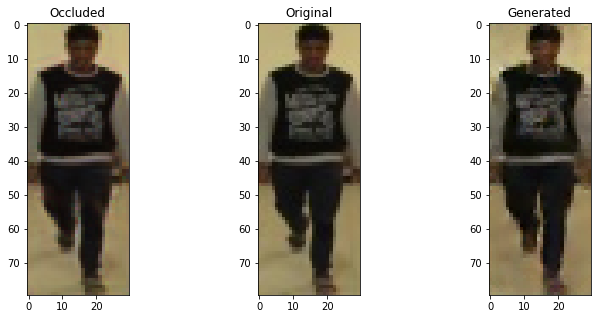

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6477816700935364 , Adversarial Loss:  0.0003244515974074602
Epoch 2722


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6861807107925415 , Adversarial Loss:  0.0003940114111173898
Epoch 2723


  8%|▊         | 1/13 [00:00<00:02,  5.52it/s]

Discriminator Loss:  0.6640306711196899 , Adversarial Loss:  0.0003545388753991574
Epoch 2724


  8%|▊         | 1/13 [00:00<00:01,  6.85it/s]

Discriminator Loss:  0.6840165257453918 , Adversarial Loss:  0.0003828447079285979
Epoch 2725


  8%|▊         | 1/13 [00:00<00:01,  6.84it/s]

Discriminator Loss:  0.6607024073600769 , Adversarial Loss:  0.00035827310057356954
Epoch 2726


  8%|▊         | 1/13 [00:00<00:01,  6.62it/s]

Discriminator Loss:  0.6525238752365112 , Adversarial Loss:  0.0003690867160912603
Epoch 2727


  8%|▊         | 1/13 [00:00<00:01,  6.94it/s]

Discriminator Loss:  0.6462154388427734 , Adversarial Loss:  0.0003675096668303013
Epoch 2728


  8%|▊         | 1/13 [00:00<00:01,  6.56it/s]

Discriminator Loss:  0.6645674705505371 , Adversarial Loss:  0.00036680250195786357
Epoch 2729


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6579028367996216 , Adversarial Loss:  0.00032786920201033354
Epoch 2730


  8%|▊         | 1/13 [00:00<00:01,  6.85it/s]

Discriminator Loss:  0.6556241512298584 , Adversarial Loss:  0.00040185614489018917
Epoch 2731


  8%|▊         | 1/13 [00:00<00:01,  6.06it/s]

Discriminator Loss:  0.6723455190658569 , Adversarial Loss:  0.00035624951124191284
Epoch 2732


  8%|▊         | 1/13 [00:00<00:01,  6.34it/s]

Discriminator Loss:  0.6504089832305908 , Adversarial Loss:  0.0003571719862520695
Epoch 2733


  8%|▊         | 1/13 [00:00<00:02,  5.57it/s]

Discriminator Loss:  0.6497018337249756 , Adversarial Loss:  0.0003889729268848896
Epoch 2734


  8%|▊         | 1/13 [00:00<00:01,  7.19it/s]

Discriminator Loss:  0.6561753749847412 , Adversarial Loss:  0.000364328152500093
Epoch 2735


  8%|▊         | 1/13 [00:00<00:01,  6.73it/s]

Discriminator Loss:  0.648859977722168 , Adversarial Loss:  0.0003700296801980585
Epoch 2736


  8%|▊         | 1/13 [00:00<00:01,  6.89it/s]

Discriminator Loss:  0.66782146692276 , Adversarial Loss:  0.00039157597348093987
Epoch 2737


  8%|▊         | 1/13 [00:00<00:01,  6.89it/s]

Discriminator Loss:  0.6465432047843933 , Adversarial Loss:  0.0003694466722663492
Epoch 2738


  8%|▊         | 1/13 [00:00<00:01,  6.35it/s]

Discriminator Loss:  0.6498879194259644 , Adversarial Loss:  0.0003712445613928139
Epoch 2739


  8%|▊         | 1/13 [00:00<00:01,  6.97it/s]

Discriminator Loss:  0.683168351650238 , Adversarial Loss:  0.0003342276031617075
Epoch 2740


  8%|▊         | 1/13 [00:00<00:01,  6.65it/s]

Discriminator Loss:  0.6616119742393494 , Adversarial Loss:  0.00037435092963278294
Epoch 2741


100%|██████████| 13/13 [00:02<00:00,  6.17it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


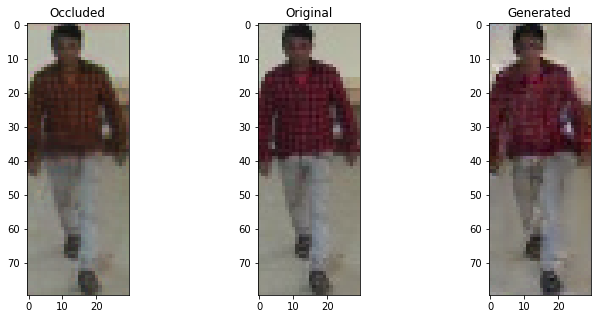

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


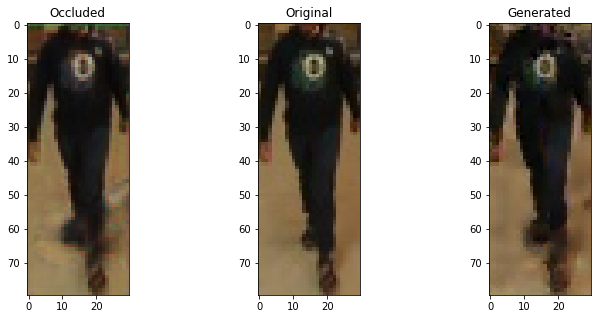

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


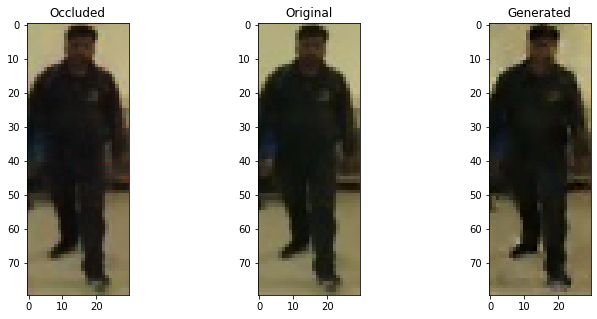

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


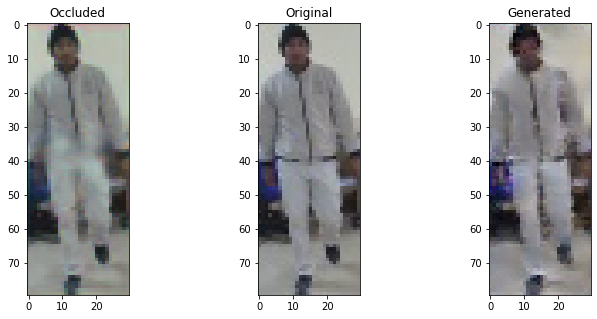

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


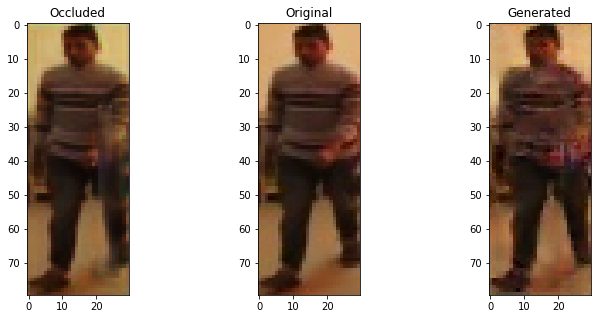

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6637712121009827 , Adversarial Loss:  0.0003473718243185431
Epoch 2742


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6644357442855835 , Adversarial Loss:  0.00034930388210341334
Epoch 2743


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6678855419158936 , Adversarial Loss:  0.0003629325074143708
Epoch 2744


  8%|▊         | 1/13 [00:00<00:01,  6.69it/s]

Discriminator Loss:  0.6594357490539551 , Adversarial Loss:  0.0003563058562576771
Epoch 2745


  8%|▊         | 1/13 [00:00<00:01,  6.86it/s]

Discriminator Loss:  0.6738579869270325 , Adversarial Loss:  0.00036677642492577434
Epoch 2746


  8%|▊         | 1/13 [00:00<00:01,  6.32it/s]

Discriminator Loss:  0.6675595045089722 , Adversarial Loss:  0.00033715073368512094
Epoch 2747


  8%|▊         | 1/13 [00:00<00:01,  6.85it/s]

Discriminator Loss:  0.6538109183311462 , Adversarial Loss:  0.0003862140001729131
Epoch 2748


  8%|▊         | 1/13 [00:00<00:01,  6.65it/s]

Discriminator Loss:  0.6728684306144714 , Adversarial Loss:  0.0003774854994844645
Epoch 2749


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6518230438232422 , Adversarial Loss:  0.0003449800715316087
Epoch 2750


  8%|▊         | 1/13 [00:00<00:01,  6.47it/s]

Discriminator Loss:  0.6677181720733643 , Adversarial Loss:  0.0003949624369852245
Epoch 2751


  8%|▊         | 1/13 [00:00<00:01,  6.19it/s]

Discriminator Loss:  0.6470420360565186 , Adversarial Loss:  0.0003781382692977786
Epoch 2752


  8%|▊         | 1/13 [00:00<00:02,  5.27it/s]

Discriminator Loss:  0.6764362454414368 , Adversarial Loss:  0.0003511605318635702
Epoch 2753


  8%|▊         | 1/13 [00:00<00:01,  6.77it/s]

Discriminator Loss:  0.6342873573303223 , Adversarial Loss:  0.0003931987448595464
Epoch 2754


  8%|▊         | 1/13 [00:00<00:01,  6.69it/s]

Discriminator Loss:  0.6717079877853394 , Adversarial Loss:  0.00031108252005651593
Epoch 2755


  8%|▊         | 1/13 [00:00<00:02,  5.93it/s]

Discriminator Loss:  0.6456341743469238 , Adversarial Loss:  0.0003404773597139865
Epoch 2756


  8%|▊         | 1/13 [00:00<00:01,  6.29it/s]

Discriminator Loss:  0.6661412715911865 , Adversarial Loss:  0.00031530833803117275
Epoch 2757


  8%|▊         | 1/13 [00:00<00:01,  6.75it/s]

Discriminator Loss:  0.6718599796295166 , Adversarial Loss:  0.00039090990321710706
Epoch 2758


  8%|▊         | 1/13 [00:00<00:01,  6.43it/s]

Discriminator Loss:  0.6629804372787476 , Adversarial Loss:  0.00033810531022027135
Epoch 2759


  8%|▊         | 1/13 [00:00<00:01,  6.67it/s]

Discriminator Loss:  0.6436859965324402 , Adversarial Loss:  0.00034781452268362045
Epoch 2760


  8%|▊         | 1/13 [00:00<00:02,  5.50it/s]

Discriminator Loss:  0.6705994009971619 , Adversarial Loss:  0.0003703335241880268
Epoch 2761


100%|██████████| 13/13 [00:02<00:00,  6.17it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


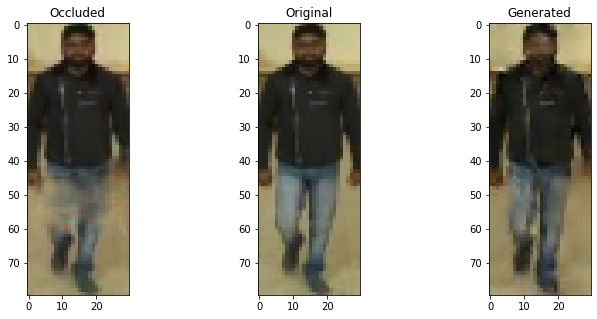

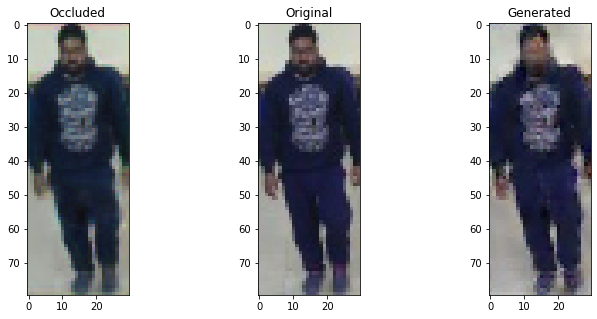

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


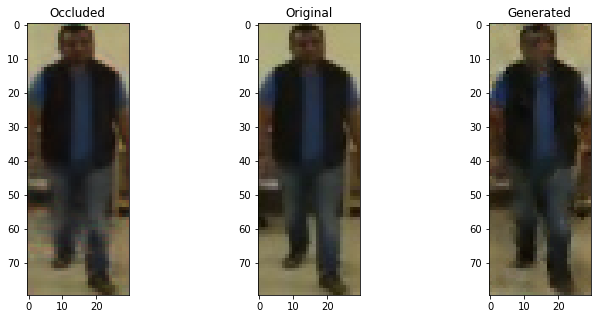

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


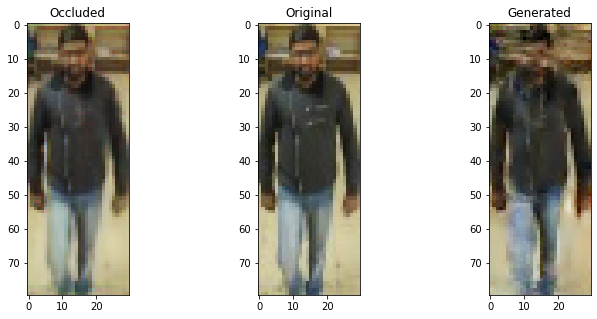

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


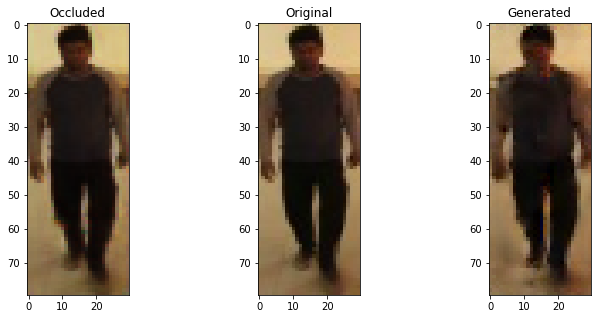

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6717816591262817 , Adversarial Loss:  0.000375647796317935
Epoch 2762


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6762368679046631 , Adversarial Loss:  0.0003913981781806797
Epoch 2763


  8%|▊         | 1/13 [00:00<00:02,  5.92it/s]

Discriminator Loss:  0.6497323513031006 , Adversarial Loss:  0.00034959331969730556
Epoch 2764


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6670643091201782 , Adversarial Loss:  0.00036790850572288036
Epoch 2765


  8%|▊         | 1/13 [00:00<00:01,  6.07it/s]

Discriminator Loss:  0.6411293148994446 , Adversarial Loss:  0.0003552683047018945
Epoch 2766


  8%|▊         | 1/13 [00:00<00:01,  6.80it/s]

Discriminator Loss:  0.6529175639152527 , Adversarial Loss:  0.0003804597072303295
Epoch 2767


  8%|▊         | 1/13 [00:00<00:01,  6.78it/s]

Discriminator Loss:  0.6702959537506104 , Adversarial Loss:  0.000358578865416348
Epoch 2768


  8%|▊         | 1/13 [00:00<00:01,  6.82it/s]

Discriminator Loss:  0.677355170249939 , Adversarial Loss:  0.000348029425367713
Epoch 2769


  8%|▊         | 1/13 [00:00<00:01,  6.69it/s]

Discriminator Loss:  0.6630350351333618 , Adversarial Loss:  0.00041611489723436534
Epoch 2770


  8%|▊         | 1/13 [00:00<00:01,  6.64it/s]

Discriminator Loss:  0.6576358079910278 , Adversarial Loss:  0.0003963099734392017
Epoch 2771


  8%|▊         | 1/13 [00:00<00:01,  6.23it/s]

Discriminator Loss:  0.6733611822128296 , Adversarial Loss:  0.0003744925488717854
Epoch 2772


  8%|▊         | 1/13 [00:00<00:01,  6.46it/s]

Discriminator Loss:  0.6697126626968384 , Adversarial Loss:  0.00037318625254556537
Epoch 2773


  8%|▊         | 1/13 [00:00<00:01,  6.92it/s]

Discriminator Loss:  0.6492978930473328 , Adversarial Loss:  0.0003760117688216269
Epoch 2774


  8%|▊         | 1/13 [00:00<00:01,  6.71it/s]

Discriminator Loss:  0.6341372132301331 , Adversarial Loss:  0.00036709813866764307
Epoch 2775


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6821905374526978 , Adversarial Loss:  0.00039369368460029364
Epoch 2776


  8%|▊         | 1/13 [00:00<00:02,  5.22it/s]

Discriminator Loss:  0.639945387840271 , Adversarial Loss:  0.00031248919549398124
Epoch 2777


  8%|▊         | 1/13 [00:00<00:02,  5.38it/s]

Discriminator Loss:  0.6548917293548584 , Adversarial Loss:  0.0003934026462957263
Epoch 2778


  8%|▊         | 1/13 [00:00<00:01,  6.61it/s]

Discriminator Loss:  0.6639784574508667 , Adversarial Loss:  0.000355411262717098
Epoch 2779


  8%|▊         | 1/13 [00:00<00:01,  6.51it/s]

Discriminator Loss:  0.6876500844955444 , Adversarial Loss:  0.0003792559145949781
Epoch 2780


  8%|▊         | 1/13 [00:00<00:01,  6.40it/s]

Discriminator Loss:  0.6691484451293945 , Adversarial Loss:  0.000351108203176409
Epoch 2781


100%|██████████| 13/13 [00:02<00:00,  6.25it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


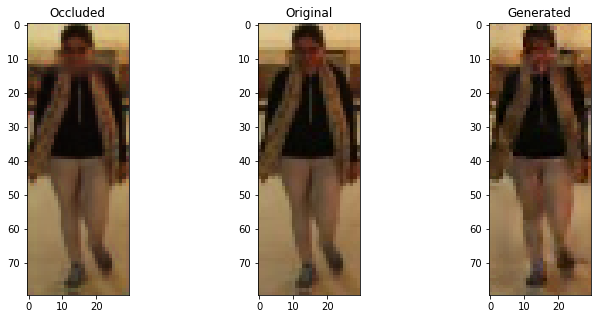

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


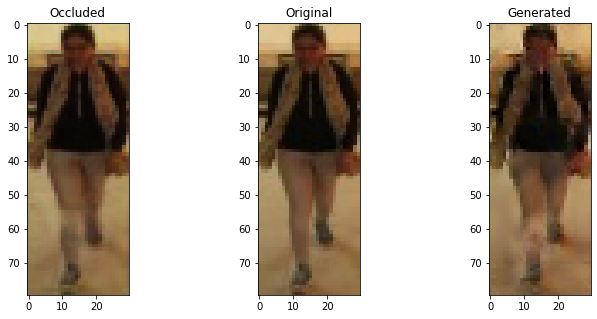

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


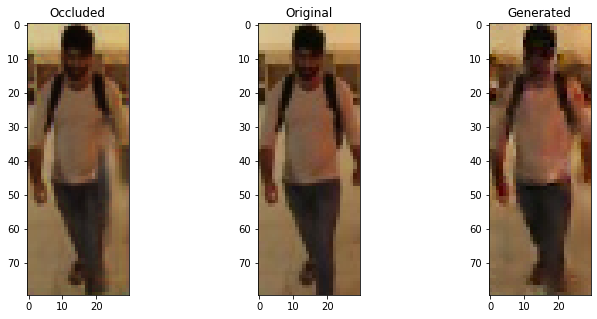

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


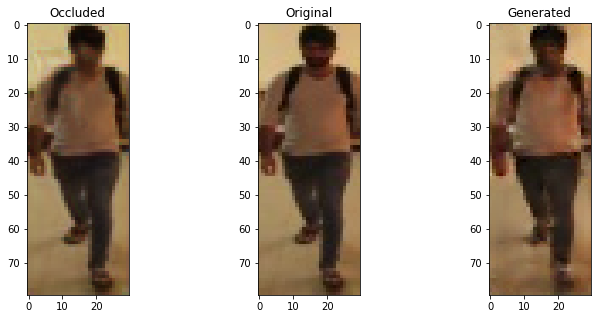

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


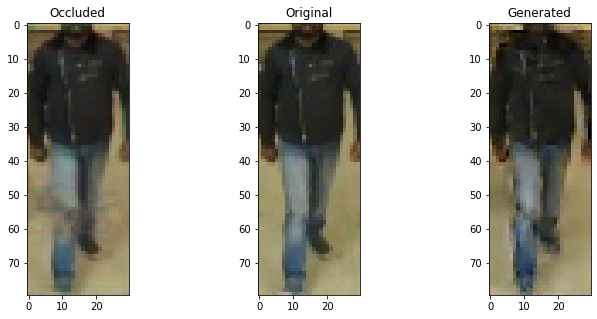

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6471585631370544 , Adversarial Loss:  0.0003805677406489849
Epoch 2782


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6633796095848083 , Adversarial Loss:  0.0003326809382997453
Epoch 2783


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6528117656707764 , Adversarial Loss:  0.000334444222971797
Epoch 2784


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6687724590301514 , Adversarial Loss:  0.0003417305997572839
Epoch 2785


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6824716329574585 , Adversarial Loss:  0.0003267139836680144
Epoch 2786


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6480028033256531 , Adversarial Loss:  0.00035024865064769983
Epoch 2787


  8%|▊         | 1/13 [00:00<00:01,  6.55it/s]

Discriminator Loss:  0.670468270778656 , Adversarial Loss:  0.00033099603024311364
Epoch 2788


  8%|▊         | 1/13 [00:00<00:01,  6.10it/s]

Discriminator Loss:  0.6593050956726074 , Adversarial Loss:  0.0003710974124260247
Epoch 2789


  8%|▊         | 1/13 [00:00<00:01,  6.37it/s]

Discriminator Loss:  0.6687510013580322 , Adversarial Loss:  0.00034837558632716537
Epoch 2790


  8%|▊         | 1/13 [00:00<00:01,  6.59it/s]

Discriminator Loss:  0.673975944519043 , Adversarial Loss:  0.0003489101363811642
Epoch 2791


  8%|▊         | 1/13 [00:00<00:01,  6.91it/s]

Discriminator Loss:  0.6484734416007996 , Adversarial Loss:  0.00036088458728045225
Epoch 2792


  8%|▊         | 1/13 [00:00<00:01,  6.93it/s]

Discriminator Loss:  0.6534384489059448 , Adversarial Loss:  0.00034126132959499955
Epoch 2793


  8%|▊         | 1/13 [00:00<00:01,  6.64it/s]

Discriminator Loss:  0.6499102115631104 , Adversarial Loss:  0.0003789978800341487
Epoch 2794


  8%|▊         | 1/13 [00:00<00:01,  6.57it/s]

Discriminator Loss:  0.6525217890739441 , Adversarial Loss:  0.00035356689477339387
Epoch 2795


  8%|▊         | 1/13 [00:00<00:01,  6.36it/s]

Discriminator Loss:  0.6495182514190674 , Adversarial Loss:  0.00034802479785867035
Epoch 2796


  8%|▊         | 1/13 [00:00<00:01,  6.90it/s]

Discriminator Loss:  0.6646486520767212 , Adversarial Loss:  0.0003544660285115242
Epoch 2797


  8%|▊         | 1/13 [00:00<00:01,  6.72it/s]

Discriminator Loss:  0.6403908133506775 , Adversarial Loss:  0.00037401242298074067
Epoch 2798


  8%|▊         | 1/13 [00:00<00:02,  5.65it/s]

Discriminator Loss:  0.6516942381858826 , Adversarial Loss:  0.00035860060597769916
Epoch 2799


  8%|▊         | 1/13 [00:00<00:01,  6.81it/s]

Discriminator Loss:  0.6827701330184937 , Adversarial Loss:  0.0003861441509798169
Epoch 2800


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6496014595031738 , Adversarial Loss:  0.0003664960677269846
Epoch 2801


100%|██████████| 13/13 [00:02<00:00,  6.11it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


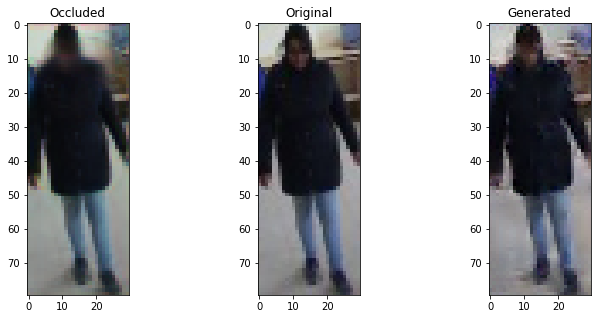

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


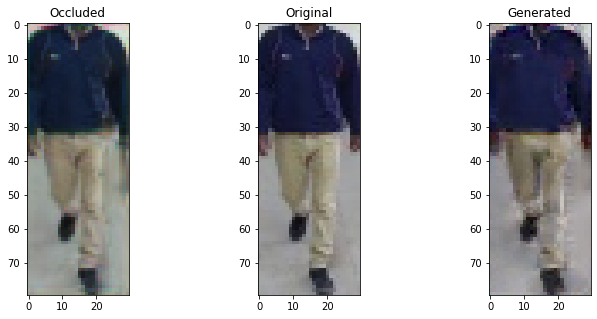

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


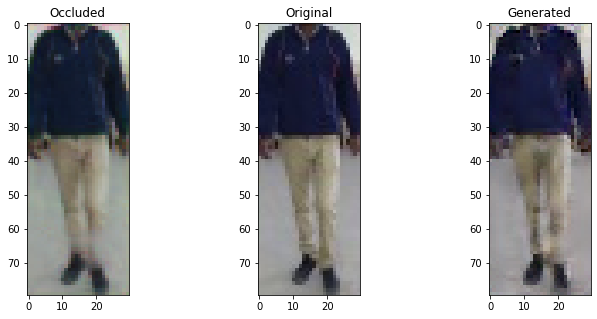

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


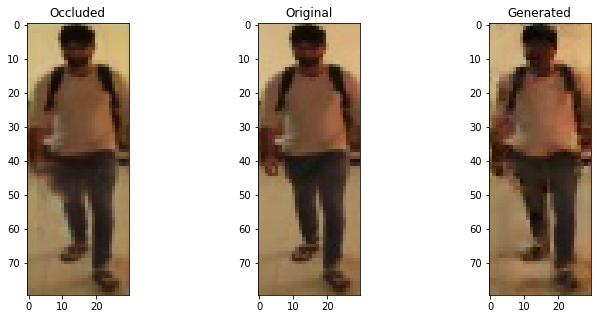

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


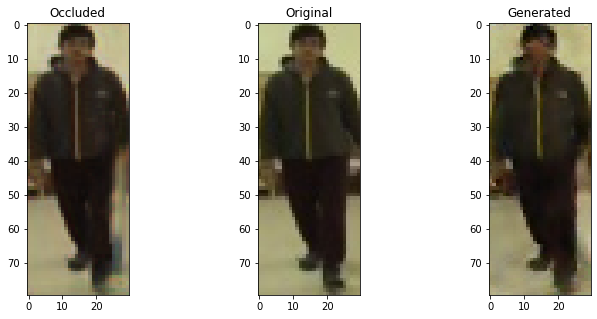

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6639508008956909 , Adversarial Loss:  0.00031044549541547894
Epoch 2802


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6408085823059082 , Adversarial Loss:  0.00037646054988726974
Epoch 2803


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6524100303649902 , Adversarial Loss:  0.0003404002054594457
Epoch 2804


  8%|▊         | 1/13 [00:00<00:01,  7.04it/s]

Discriminator Loss:  0.6733682751655579 , Adversarial Loss:  0.00038094588671810925
Epoch 2805


  8%|▊         | 1/13 [00:00<00:01,  6.53it/s]

Discriminator Loss:  0.6547704935073853 , Adversarial Loss:  0.0003871690423693508
Epoch 2806


  8%|▊         | 1/13 [00:00<00:01,  6.08it/s]

Discriminator Loss:  0.6723712086677551 , Adversarial Loss:  0.0003621541545726359
Epoch 2807


  8%|▊         | 1/13 [00:00<00:01,  6.53it/s]

Discriminator Loss:  0.6828857660293579 , Adversarial Loss:  0.00033947371412068605
Epoch 2808


  8%|▊         | 1/13 [00:00<00:02,  5.17it/s]

Discriminator Loss:  0.6682506799697876 , Adversarial Loss:  0.00040287114097736776
Epoch 2809


  8%|▊         | 1/13 [00:00<00:01,  6.64it/s]

Discriminator Loss:  0.6522809863090515 , Adversarial Loss:  0.00031838726135902107
Epoch 2810


  8%|▊         | 1/13 [00:00<00:01,  6.79it/s]

Discriminator Loss:  0.6397433280944824 , Adversarial Loss:  0.0003334801585879177
Epoch 2811


  8%|▊         | 1/13 [00:00<00:02,  5.28it/s]

Discriminator Loss:  0.6625807881355286 , Adversarial Loss:  0.00035884667886421084
Epoch 2812


  8%|▊         | 1/13 [00:00<00:01,  6.97it/s]

Discriminator Loss:  0.679722011089325 , Adversarial Loss:  0.0003603440709412098
Epoch 2813


  8%|▊         | 1/13 [00:00<00:01,  6.24it/s]

Discriminator Loss:  0.6739158034324646 , Adversarial Loss:  0.000311308482196182
Epoch 2814


  8%|▊         | 1/13 [00:00<00:01,  6.73it/s]

Discriminator Loss:  0.6687438488006592 , Adversarial Loss:  0.00039810617454349995
Epoch 2815


  8%|▊         | 1/13 [00:00<00:01,  6.26it/s]

Discriminator Loss:  0.6529965400695801 , Adversarial Loss:  0.0003387538017705083
Epoch 2816


  8%|▊         | 1/13 [00:00<00:01,  6.71it/s]

Discriminator Loss:  0.6360927820205688 , Adversarial Loss:  0.0002997407573275268
Epoch 2817


  8%|▊         | 1/13 [00:00<00:01,  6.86it/s]

Discriminator Loss:  0.6406461596488953 , Adversarial Loss:  0.0003851400688290596
Epoch 2818


  8%|▊         | 1/13 [00:00<00:01,  6.61it/s]

Discriminator Loss:  0.6737935543060303 , Adversarial Loss:  0.0003771670162677765
Epoch 2819


  8%|▊         | 1/13 [00:00<00:01,  6.14it/s]

Discriminator Loss:  0.6625545024871826 , Adversarial Loss:  0.0003640390350483358
Epoch 2820


  8%|▊         | 1/13 [00:00<00:01,  6.82it/s]

Discriminator Loss:  0.6332488059997559 , Adversarial Loss:  0.00033738065394572914
Epoch 2821


100%|██████████| 13/13 [00:02<00:00,  6.21it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


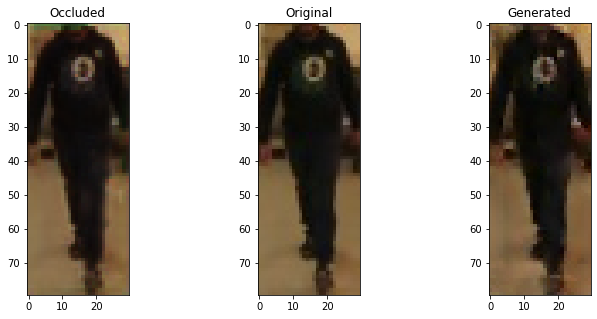

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


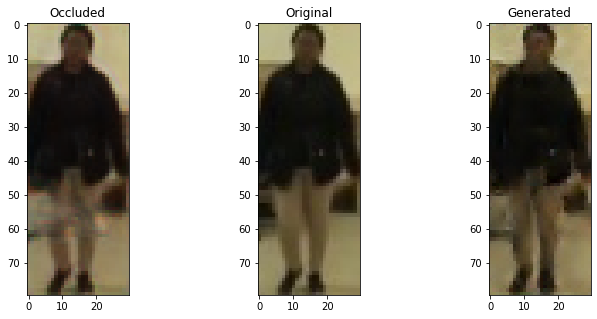

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


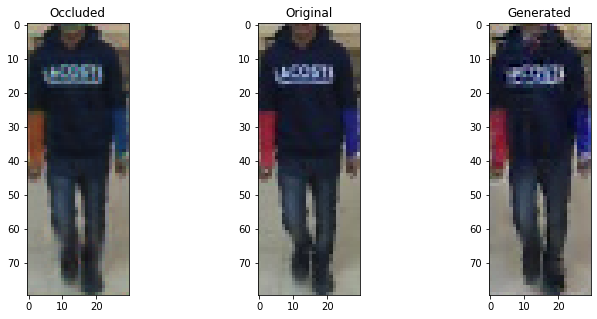

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


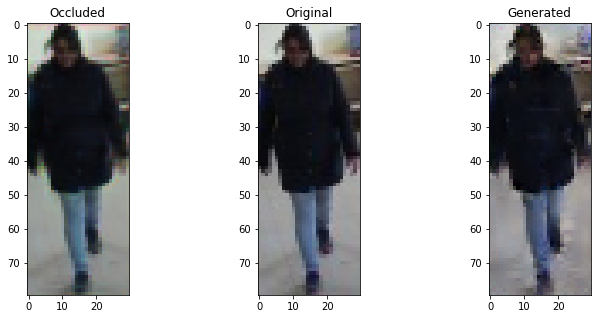

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


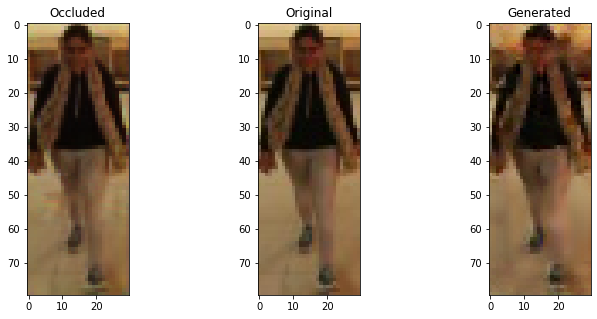

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6409730911254883 , Adversarial Loss:  0.00032226755865849555
Epoch 2822


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6698963642120361 , Adversarial Loss:  0.0003306414291728288
Epoch 2823


  8%|▊         | 1/13 [00:00<00:01,  6.63it/s]

Discriminator Loss:  0.6373304724693298 , Adversarial Loss:  0.0003678034117911011
Epoch 2824


  8%|▊         | 1/13 [00:00<00:01,  6.60it/s]

Discriminator Loss:  0.6605418920516968 , Adversarial Loss:  0.00035719567677006125
Epoch 2825


  8%|▊         | 1/13 [00:00<00:01,  6.45it/s]

Discriminator Loss:  0.6530202627182007 , Adversarial Loss:  0.0003220989019609988
Epoch 2826


  8%|▊         | 1/13 [00:00<00:02,  5.47it/s]

Discriminator Loss:  0.6364315748214722 , Adversarial Loss:  0.0003346374141983688
Epoch 2827


  8%|▊         | 1/13 [00:00<00:02,  5.97it/s]

Discriminator Loss:  0.6501460075378418 , Adversarial Loss:  0.00038118765223771334
Epoch 2828


  8%|▊         | 1/13 [00:00<00:02,  5.56it/s]

Discriminator Loss:  0.6588164567947388 , Adversarial Loss:  0.0003188852278981358
Epoch 2829


  8%|▊         | 1/13 [00:00<00:01,  6.80it/s]

Discriminator Loss:  0.6397550106048584 , Adversarial Loss:  0.0003482132451608777
Epoch 2830


  8%|▊         | 1/13 [00:00<00:01,  7.07it/s]

Discriminator Loss:  0.6748939752578735 , Adversarial Loss:  0.0003529232053551823
Epoch 2831


  8%|▊         | 1/13 [00:00<00:01,  6.49it/s]

Discriminator Loss:  0.652489185333252 , Adversarial Loss:  0.0003773738571908325
Epoch 2832


  8%|▊         | 1/13 [00:00<00:01,  6.54it/s]

Discriminator Loss:  0.65657639503479 , Adversarial Loss:  0.00033847533632069826
Epoch 2833


  8%|▊         | 1/13 [00:00<00:01,  6.47it/s]

Discriminator Loss:  0.6714314222335815 , Adversarial Loss:  0.00034969119587913156
Epoch 2834


  8%|▊         | 1/13 [00:00<00:01,  6.35it/s]

Discriminator Loss:  0.6649951934814453 , Adversarial Loss:  0.0004035617457702756
Epoch 2835


  8%|▊         | 1/13 [00:00<00:01,  6.43it/s]

Discriminator Loss:  0.6599368453025818 , Adversarial Loss:  0.0003431254008319229
Epoch 2836


  8%|▊         | 1/13 [00:00<00:02,  5.53it/s]

Discriminator Loss:  0.6461269855499268 , Adversarial Loss:  0.0003394212108105421
Epoch 2837


  8%|▊         | 1/13 [00:00<00:01,  6.94it/s]

Discriminator Loss:  0.6793202757835388 , Adversarial Loss:  0.0003848154447041452
Epoch 2838


  8%|▊         | 1/13 [00:00<00:01,  6.78it/s]

Discriminator Loss:  0.679076075553894 , Adversarial Loss:  0.00033817195799201727
Epoch 2839


  8%|▊         | 1/13 [00:00<00:01,  6.74it/s]

Discriminator Loss:  0.6726295948028564 , Adversarial Loss:  0.0003267744032200426
Epoch 2840


  8%|▊         | 1/13 [00:00<00:01,  6.58it/s]

Discriminator Loss:  0.6522419452667236 , Adversarial Loss:  0.00032116228248924017
Epoch 2841


100%|██████████| 13/13 [00:02<00:00,  6.06it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


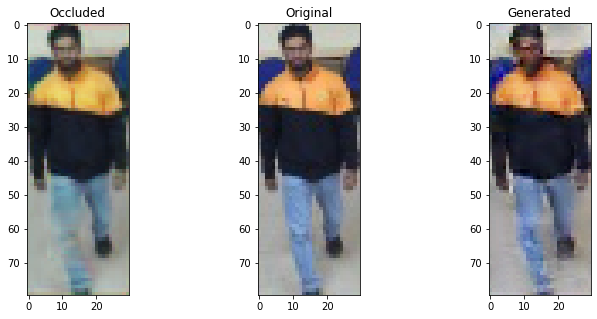

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


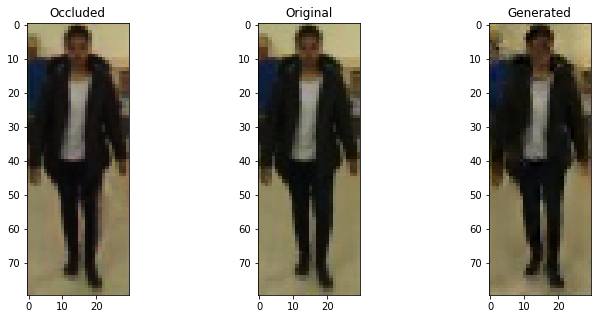

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


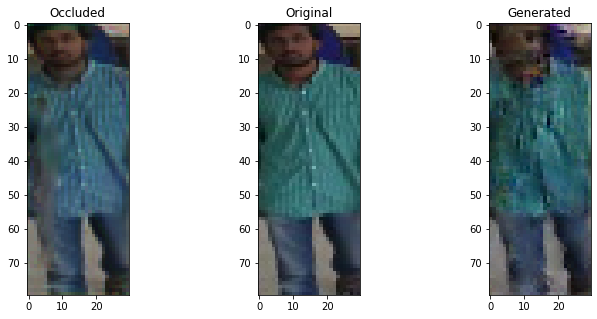

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


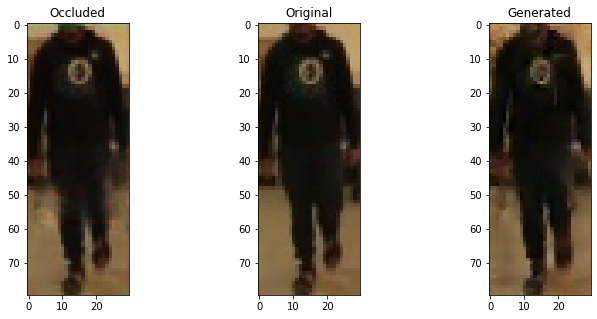

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


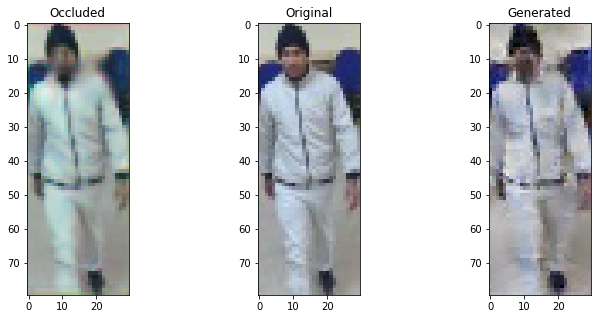

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6498728394508362 , Adversarial Loss:  0.0003875341499224305
Epoch 2842


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6476225256919861 , Adversarial Loss:  0.00035231420770287514
Epoch 2843


  8%|▊         | 1/13 [00:00<00:01,  6.69it/s]

Discriminator Loss:  0.6676729917526245 , Adversarial Loss:  0.0003599022747948766
Epoch 2844


  8%|▊         | 1/13 [00:00<00:01,  6.45it/s]

Discriminator Loss:  0.6811650395393372 , Adversarial Loss:  0.000355964177288115
Epoch 2845


  8%|▊         | 1/13 [00:00<00:01,  6.24it/s]

Discriminator Loss:  0.6648812890052795 , Adversarial Loss:  0.00036322331288829446
Epoch 2846


  8%|▊         | 1/13 [00:00<00:01,  6.72it/s]

Discriminator Loss:  0.6637024283409119 , Adversarial Loss:  0.0003313009219709784
Epoch 2847


  8%|▊         | 1/13 [00:00<00:01,  6.97it/s]

Discriminator Loss:  0.6443654894828796 , Adversarial Loss:  0.0003432842204347253
Epoch 2848


  8%|▊         | 1/13 [00:00<00:01,  6.98it/s]

Discriminator Loss:  0.6314733624458313 , Adversarial Loss:  0.0003472114622127265
Epoch 2849


  8%|▊         | 1/13 [00:00<00:02,  5.33it/s]

Discriminator Loss:  0.6641485095024109 , Adversarial Loss:  0.0003597831237129867
Epoch 2850


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6573650240898132 , Adversarial Loss:  0.0003392603248357773
Epoch 2851


  8%|▊         | 1/13 [00:00<00:01,  6.95it/s]

Discriminator Loss:  0.6324401497840881 , Adversarial Loss:  0.00035146265872754157
Epoch 2852


  8%|▊         | 1/13 [00:00<00:01,  6.84it/s]

Discriminator Loss:  0.6675025224685669 , Adversarial Loss:  0.0003407633921597153
Epoch 2853


  8%|▊         | 1/13 [00:00<00:01,  6.80it/s]

Discriminator Loss:  0.6575191020965576 , Adversarial Loss:  0.00034340695128776133
Epoch 2854


  8%|▊         | 1/13 [00:00<00:01,  6.56it/s]

Discriminator Loss:  0.6523433327674866 , Adversarial Loss:  0.00038326927460730076
Epoch 2855


  8%|▊         | 1/13 [00:00<00:01,  6.58it/s]

Discriminator Loss:  0.6639007329940796 , Adversarial Loss:  0.0003311457112431526
Epoch 2856


  8%|▊         | 1/13 [00:00<00:02,  5.23it/s]

Discriminator Loss:  0.6631336212158203 , Adversarial Loss:  0.0003749242168851197
Epoch 2857


  8%|▊         | 1/13 [00:00<00:02,  5.36it/s]

Discriminator Loss:  0.6628789305686951 , Adversarial Loss:  0.00036331440787762403
Epoch 2858


  8%|▊         | 1/13 [00:00<00:01,  6.75it/s]

Discriminator Loss:  0.6593984961509705 , Adversarial Loss:  0.0003083174815401435
Epoch 2859


  8%|▊         | 1/13 [00:00<00:01,  6.92it/s]

Discriminator Loss:  0.6410965919494629 , Adversarial Loss:  0.00031278858659788966
Epoch 2860


  8%|▊         | 1/13 [00:00<00:01,  6.97it/s]

Discriminator Loss:  0.6754868626594543 , Adversarial Loss:  0.00031326094176620245
Epoch 2861


100%|██████████| 13/13 [00:02<00:00,  6.31it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


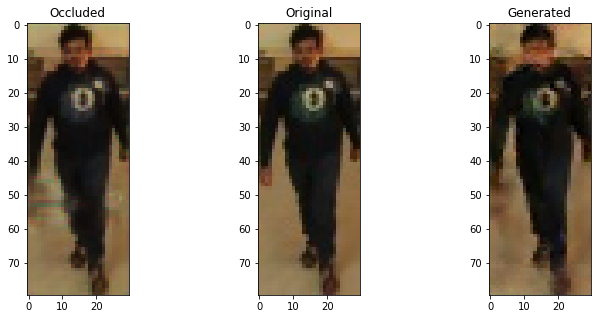

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


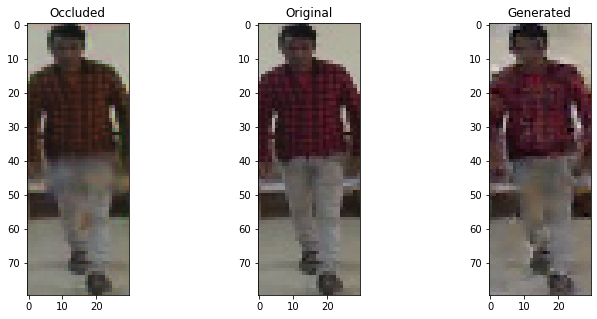

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


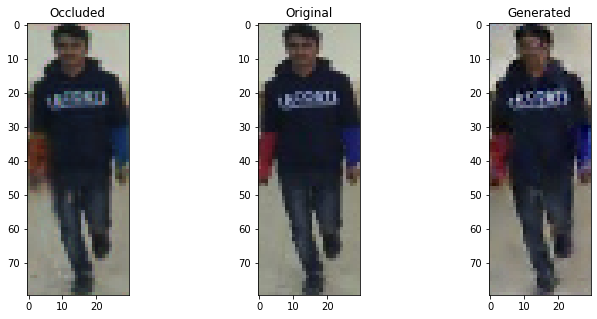

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


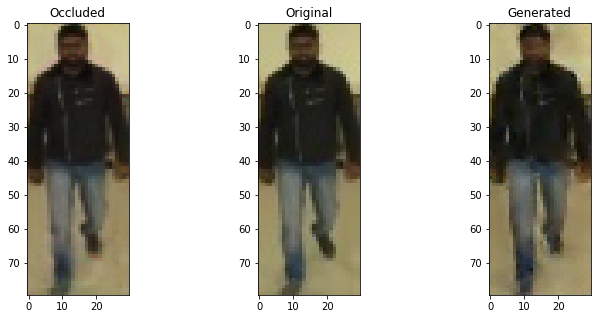

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


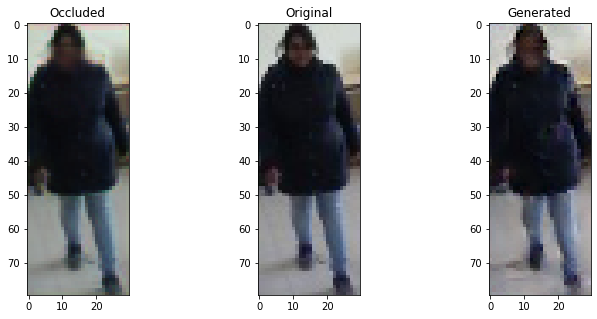

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6570398807525635 , Adversarial Loss:  0.00036219743196852505
Epoch 2862


  8%|▊         | 1/13 [00:00<00:01,  6.41it/s]

Discriminator Loss:  0.6405032277107239 , Adversarial Loss:  0.0003399247652851045
Epoch 2863


  8%|▊         | 1/13 [00:00<00:01,  6.94it/s]

Discriminator Loss:  0.6640928387641907 , Adversarial Loss:  0.00032372624264098704
Epoch 2864


  8%|▊         | 1/13 [00:00<00:02,  5.03it/s]

Discriminator Loss:  0.6732417941093445 , Adversarial Loss:  0.0003239379439037293
Epoch 2865


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.641928493976593 , Adversarial Loss:  0.0003716489882208407
Epoch 2866


  8%|▊         | 1/13 [00:00<00:01,  6.31it/s]

Discriminator Loss:  0.6617296934127808 , Adversarial Loss:  0.000359195691999048
Epoch 2867


  8%|▊         | 1/13 [00:00<00:01,  7.01it/s]

Discriminator Loss:  0.6542299389839172 , Adversarial Loss:  0.00038378062890842557
Epoch 2868


  8%|▊         | 1/13 [00:00<00:02,  5.40it/s]

Discriminator Loss:  0.6504060626029968 , Adversarial Loss:  0.00035163306165486574
Epoch 2869


  8%|▊         | 1/13 [00:00<00:02,  5.14it/s]

Discriminator Loss:  0.670305609703064 , Adversarial Loss:  0.00034423527540639043
Epoch 2870


  8%|▊         | 1/13 [00:00<00:02,  5.55it/s]

Discriminator Loss:  0.6391826272010803 , Adversarial Loss:  0.00034783646697178483
Epoch 2871


  8%|▊         | 1/13 [00:00<00:01,  6.72it/s]

Discriminator Loss:  0.6398109197616577 , Adversarial Loss:  0.00034903650521300733
Epoch 2872


  8%|▊         | 1/13 [00:00<00:01,  6.88it/s]

Discriminator Loss:  0.6720815896987915 , Adversarial Loss:  0.00030841006082482636
Epoch 2873


  8%|▊         | 1/13 [00:00<00:01,  6.91it/s]

Discriminator Loss:  0.6544842720031738 , Adversarial Loss:  0.0003575857263058424
Epoch 2874


  8%|▊         | 1/13 [00:00<00:01,  7.03it/s]

Discriminator Loss:  0.6572473645210266 , Adversarial Loss:  0.000355388387106359
Epoch 2875


  8%|▊         | 1/13 [00:00<00:01,  6.42it/s]

Discriminator Loss:  0.6400611400604248 , Adversarial Loss:  0.00038271298399195075
Epoch 2876


  8%|▊         | 1/13 [00:00<00:01,  6.66it/s]

Discriminator Loss:  0.6823128461837769 , Adversarial Loss:  0.0003574613656383008
Epoch 2877


  8%|▊         | 1/13 [00:00<00:01,  7.07it/s]

Discriminator Loss:  0.6491268873214722 , Adversarial Loss:  0.00032041786471381783
Epoch 2878


  8%|▊         | 1/13 [00:00<00:02,  5.13it/s]

Discriminator Loss:  0.6394658088684082 , Adversarial Loss:  0.0003176411846652627
Epoch 2879


  8%|▊         | 1/13 [00:00<00:01,  6.74it/s]

Discriminator Loss:  0.6419283151626587 , Adversarial Loss:  0.00035477307392284274
Epoch 2880


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6752402782440186 , Adversarial Loss:  0.0003335431101731956
Epoch 2881


100%|██████████| 13/13 [00:02<00:00,  5.95it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


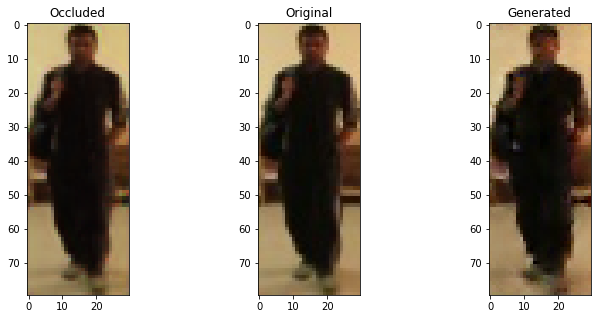

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


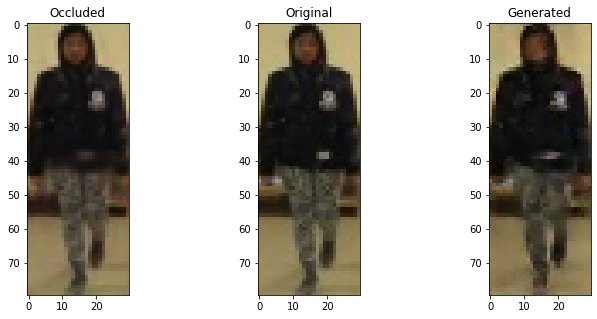

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


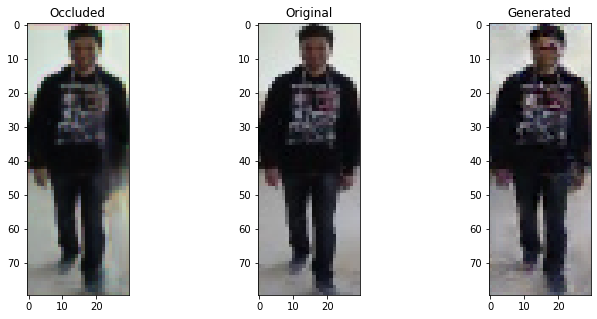

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


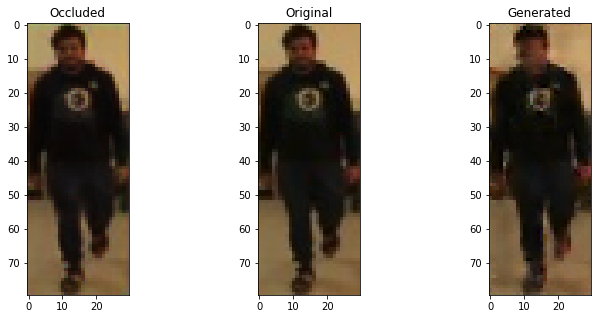

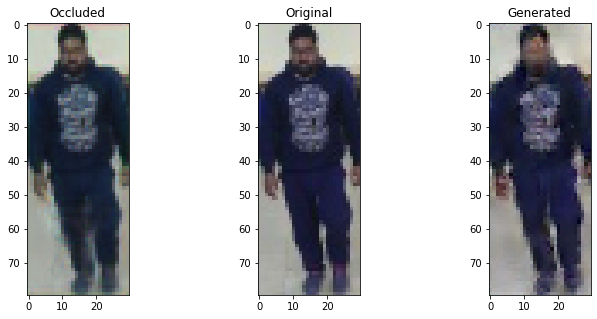

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6703090667724609 , Adversarial Loss:  0.00031077797757461667
Epoch 2882


  8%|▊         | 1/13 [00:00<00:02,  5.25it/s]

Discriminator Loss:  0.650231122970581 , Adversarial Loss:  0.00034726844751276076
Epoch 2883


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6753193736076355 , Adversarial Loss:  0.00035327771911397576
Epoch 2884


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6712262034416199 , Adversarial Loss:  0.000341365288477391
Epoch 2885


  8%|▊         | 1/13 [00:00<00:01,  6.99it/s]

Discriminator Loss:  0.656967282295227 , Adversarial Loss:  0.0003975783765781671
Epoch 2886


  8%|▊         | 1/13 [00:00<00:01,  6.81it/s]

Discriminator Loss:  0.6404304504394531 , Adversarial Loss:  0.0003477225545793772
Epoch 2887


  8%|▊         | 1/13 [00:00<00:01,  6.89it/s]

Discriminator Loss:  0.6377692222595215 , Adversarial Loss:  0.00034565123496577144
Epoch 2888


  8%|▊         | 1/13 [00:00<00:01,  6.21it/s]

Discriminator Loss:  0.6295204162597656 , Adversarial Loss:  0.00037340630660764873
Epoch 2889


  8%|▊         | 1/13 [00:00<00:01,  6.81it/s]

Discriminator Loss:  0.6716155409812927 , Adversarial Loss:  0.0003628574777394533
Epoch 2890


  8%|▊         | 1/13 [00:00<00:01,  6.92it/s]

Discriminator Loss:  0.6609901785850525 , Adversarial Loss:  0.00036225467920303345
Epoch 2891


  8%|▊         | 1/13 [00:00<00:01,  6.75it/s]

Discriminator Loss:  0.6802661418914795 , Adversarial Loss:  0.0003500814491417259
Epoch 2892


  8%|▊         | 1/13 [00:00<00:02,  5.70it/s]

Discriminator Loss:  0.6529028415679932 , Adversarial Loss:  0.0003249022993259132
Epoch 2893


  8%|▊         | 1/13 [00:00<00:01,  6.95it/s]

Discriminator Loss:  0.6553071141242981 , Adversarial Loss:  0.0003379734407644719
Epoch 2894


  8%|▊         | 1/13 [00:00<00:01,  6.91it/s]

Discriminator Loss:  0.6724022626876831 , Adversarial Loss:  0.00035260565346106887
Epoch 2895


  8%|▊         | 1/13 [00:00<00:01,  6.51it/s]

Discriminator Loss:  0.6640264987945557 , Adversarial Loss:  0.00032749486854299903
Epoch 2896


  8%|▊         | 1/13 [00:00<00:01,  6.75it/s]

Discriminator Loss:  0.6492280960083008 , Adversarial Loss:  0.0003350432962179184
Epoch 2897


  8%|▊         | 1/13 [00:00<00:01,  6.88it/s]

Discriminator Loss:  0.6551889181137085 , Adversarial Loss:  0.0003503499901853502
Epoch 2898


  8%|▊         | 1/13 [00:00<00:01,  6.10it/s]

Discriminator Loss:  0.6780380010604858 , Adversarial Loss:  0.00034287248854525387
Epoch 2899


  8%|▊         | 1/13 [00:00<00:02,  5.36it/s]

Discriminator Loss:  0.6724761724472046 , Adversarial Loss:  0.0003732092445716262
Epoch 2900


  8%|▊         | 1/13 [00:00<00:02,  5.77it/s]

Discriminator Loss:  0.6608078479766846 , Adversarial Loss:  0.0003698052023537457
Epoch 2901


100%|██████████| 13/13 [00:02<00:00,  5.97it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


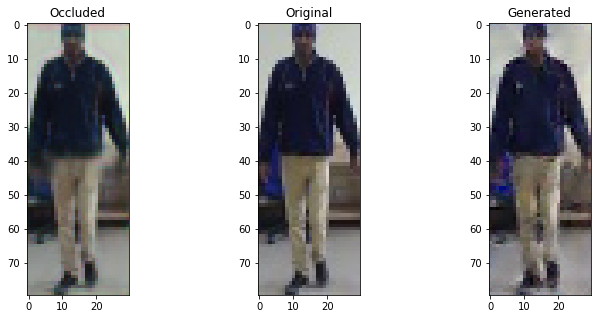

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


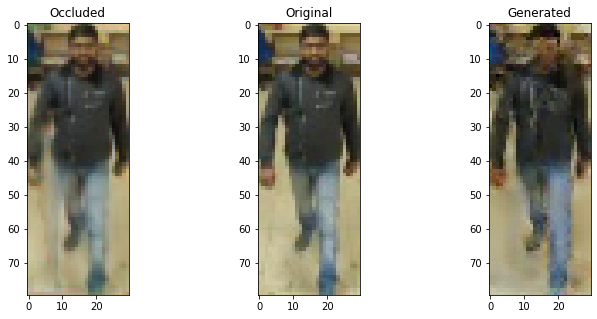

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


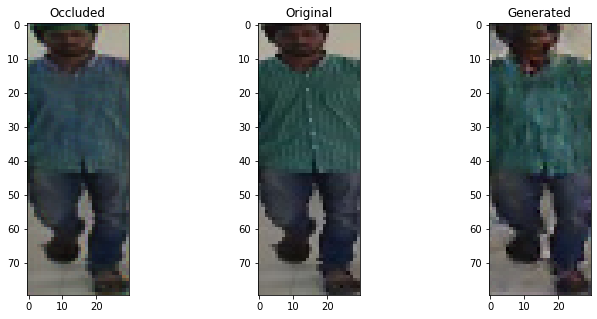

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


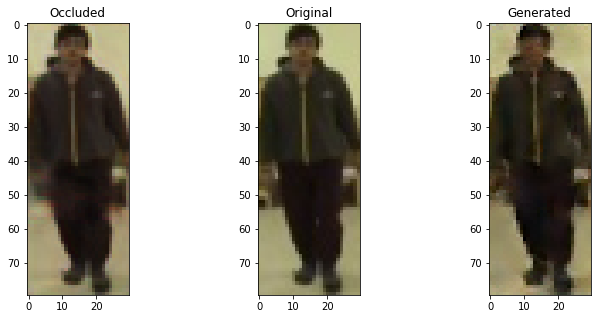

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


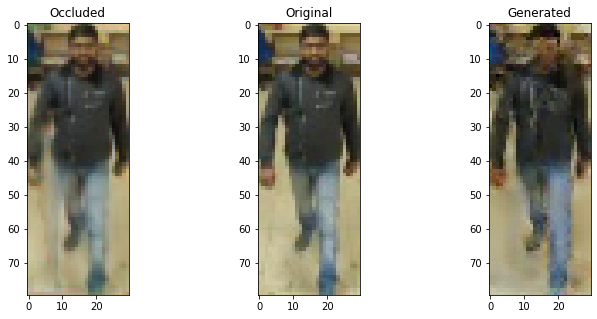

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6518681049346924 , Adversarial Loss:  0.0003352533094584942
Epoch 2902


  8%|▊         | 1/13 [00:00<00:02,  5.45it/s]

Discriminator Loss:  0.6498668789863586 , Adversarial Loss:  0.0003325408324599266
Epoch 2903


  8%|▊         | 1/13 [00:00<00:01,  6.52it/s]

Discriminator Loss:  0.6483824253082275 , Adversarial Loss:  0.0003292313776910305
Epoch 2904


  8%|▊         | 1/13 [00:00<00:01,  7.05it/s]

Discriminator Loss:  0.6789246797561646 , Adversarial Loss:  0.00036201393231749535
Epoch 2905


  8%|▊         | 1/13 [00:00<00:01,  6.80it/s]

Discriminator Loss:  0.6646934747695923 , Adversarial Loss:  0.00032366678351536393
Epoch 2906


  8%|▊         | 1/13 [00:00<00:01,  6.76it/s]

Discriminator Loss:  0.657119870185852 , Adversarial Loss:  0.0003072232357226312
Epoch 2907


  8%|▊         | 1/13 [00:00<00:01,  6.88it/s]

Discriminator Loss:  0.6792246103286743 , Adversarial Loss:  0.00035774370189756155
Epoch 2908


  8%|▊         | 1/13 [00:00<00:01,  6.40it/s]

Discriminator Loss:  0.6453748345375061 , Adversarial Loss:  0.00031418318394571543
Epoch 2909


  8%|▊         | 1/13 [00:00<00:01,  7.10it/s]

Discriminator Loss:  0.6492023468017578 , Adversarial Loss:  0.0003299696836620569
Epoch 2910


  8%|▊         | 1/13 [00:00<00:01,  7.03it/s]

Discriminator Loss:  0.6413898468017578 , Adversarial Loss:  0.00035065016709268093
Epoch 2911


  8%|▊         | 1/13 [00:00<00:01,  6.06it/s]

Discriminator Loss:  0.6575614213943481 , Adversarial Loss:  0.0003416240797378123
Epoch 2912


  8%|▊         | 1/13 [00:00<00:01,  6.46it/s]

Discriminator Loss:  0.6439411640167236 , Adversarial Loss:  0.0003617419279180467
Epoch 2913


  8%|▊         | 1/13 [00:00<00:01,  6.91it/s]

Discriminator Loss:  0.6460704803466797 , Adversarial Loss:  0.0003607121470849961
Epoch 2914


  8%|▊         | 1/13 [00:00<00:01,  6.87it/s]

Discriminator Loss:  0.6704341173171997 , Adversarial Loss:  0.0003236554330214858
Epoch 2915


  8%|▊         | 1/13 [00:00<00:01,  7.01it/s]

Discriminator Loss:  0.6559486985206604 , Adversarial Loss:  0.000338512851158157
Epoch 2916


  8%|▊         | 1/13 [00:00<00:02,  5.34it/s]

Discriminator Loss:  0.6448264122009277 , Adversarial Loss:  0.0003141664492432028
Epoch 2917


  8%|▊         | 1/13 [00:00<00:01,  6.89it/s]

Discriminator Loss:  0.6713535785675049 , Adversarial Loss:  0.00037570425774902105
Epoch 2918


  8%|▊         | 1/13 [00:00<00:01,  6.46it/s]

Discriminator Loss:  0.679953396320343 , Adversarial Loss:  0.00032576979720033705
Epoch 2919


  8%|▊         | 1/13 [00:00<00:01,  6.95it/s]

Discriminator Loss:  0.6432110071182251 , Adversarial Loss:  0.0003479945007711649
Epoch 2920


  8%|▊         | 1/13 [00:00<00:01,  6.61it/s]

Discriminator Loss:  0.6682361960411072 , Adversarial Loss:  0.0003261332167312503
Epoch 2921


100%|██████████| 13/13 [00:02<00:00,  6.13it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


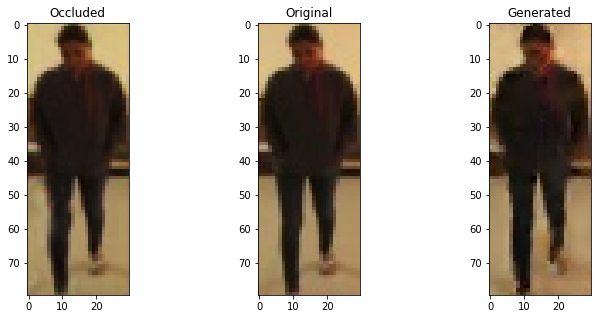

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


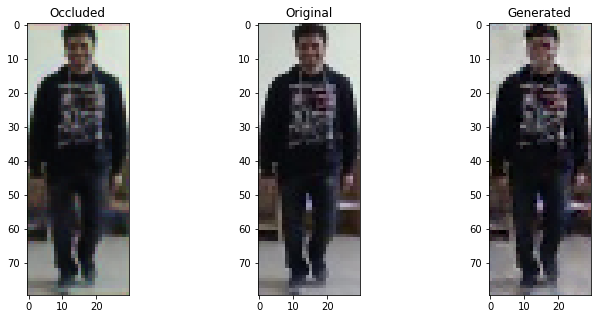

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


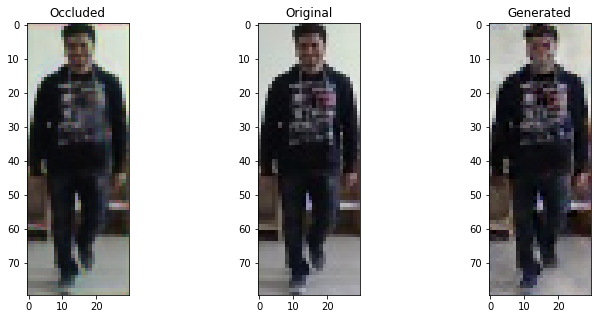

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


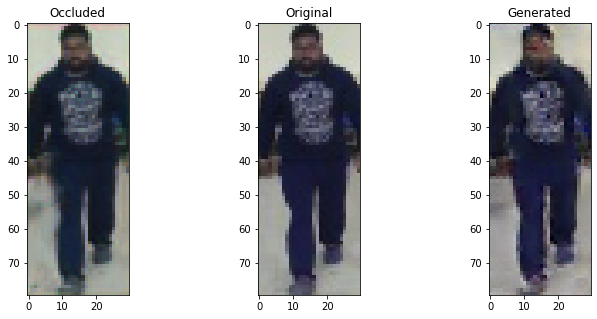

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


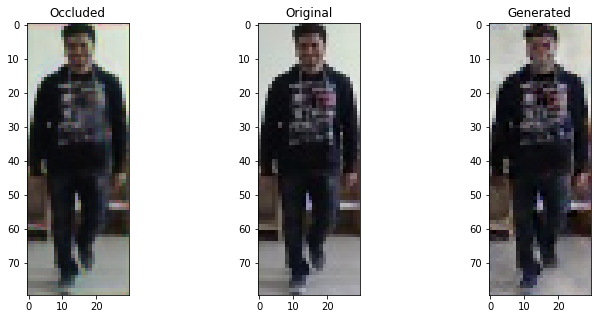

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.669015645980835 , Adversarial Loss:  0.00034614262403920293
Epoch 2922


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6531572341918945 , Adversarial Loss:  0.0003151200362481177
Epoch 2923


  8%|▊         | 1/13 [00:00<00:01,  6.88it/s]

Discriminator Loss:  0.6573452353477478 , Adversarial Loss:  0.0003502756298985332
Epoch 2924


  8%|▊         | 1/13 [00:00<00:01,  6.94it/s]

Discriminator Loss:  0.6851171255111694 , Adversarial Loss:  0.0003811510105151683
Epoch 2925


  8%|▊         | 1/13 [00:00<00:01,  6.96it/s]

Discriminator Loss:  0.6706128716468811 , Adversarial Loss:  0.0003421009751036763
Epoch 2926


  8%|▊         | 1/13 [00:00<00:01,  6.67it/s]

Discriminator Loss:  0.6811985969543457 , Adversarial Loss:  0.0003527908702380955
Epoch 2927


  8%|▊         | 1/13 [00:00<00:01,  7.01it/s]

Discriminator Loss:  0.6533746719360352 , Adversarial Loss:  0.00035477912751957774
Epoch 2928


  8%|▊         | 1/13 [00:00<00:01,  6.42it/s]

Discriminator Loss:  0.6452587842941284 , Adversarial Loss:  0.0003063129843212664
Epoch 2929


  8%|▊         | 1/13 [00:00<00:01,  6.89it/s]

Discriminator Loss:  0.6592632532119751 , Adversarial Loss:  0.000316856661811471
Epoch 2930


  8%|▊         | 1/13 [00:00<00:01,  6.63it/s]

Discriminator Loss:  0.65901780128479 , Adversarial Loss:  0.00037136697210371494
Epoch 2931


  8%|▊         | 1/13 [00:00<00:01,  6.83it/s]

Discriminator Loss:  0.6320997476577759 , Adversarial Loss:  0.00032133545028045774
Epoch 2932


  8%|▊         | 1/13 [00:00<00:02,  5.66it/s]

Discriminator Loss:  0.6420490741729736 , Adversarial Loss:  0.00033032192732207477
Epoch 2933


  8%|▊         | 1/13 [00:00<00:01,  6.56it/s]

Discriminator Loss:  0.6499584317207336 , Adversarial Loss:  0.00032015296164900064
Epoch 2934


  8%|▊         | 1/13 [00:00<00:01,  6.22it/s]

Discriminator Loss:  0.6586806774139404 , Adversarial Loss:  0.000317147234454751
Epoch 2935


  8%|▊         | 1/13 [00:00<00:01,  6.28it/s]

Discriminator Loss:  0.6756644248962402 , Adversarial Loss:  0.00030817603692412376
Epoch 2936


  8%|▊         | 1/13 [00:00<00:02,  5.31it/s]

Discriminator Loss:  0.6846392750740051 , Adversarial Loss:  0.00032396416645497084
Epoch 2937


  8%|▊         | 1/13 [00:00<00:02,  5.48it/s]

Discriminator Loss:  0.6742150187492371 , Adversarial Loss:  0.00034978409530594945
Epoch 2938


  8%|▊         | 1/13 [00:00<00:01,  6.96it/s]

Discriminator Loss:  0.638116717338562 , Adversarial Loss:  0.0003187428810633719
Epoch 2939


  8%|▊         | 1/13 [00:00<00:01,  6.96it/s]

Discriminator Loss:  0.6595962047576904 , Adversarial Loss:  0.0003412648802623153
Epoch 2940


  8%|▊         | 1/13 [00:00<00:01,  6.97it/s]

Discriminator Loss:  0.6759040355682373 , Adversarial Loss:  0.000383213278837502
Epoch 2941


100%|██████████| 13/13 [00:02<00:00,  6.01it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


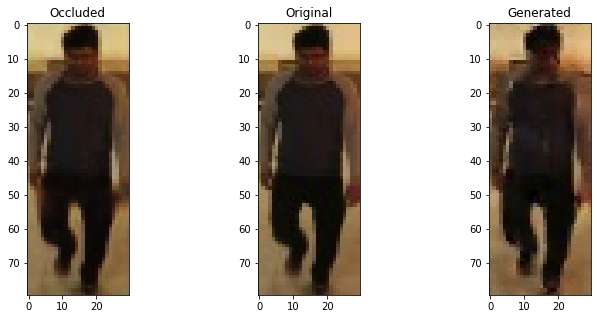

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


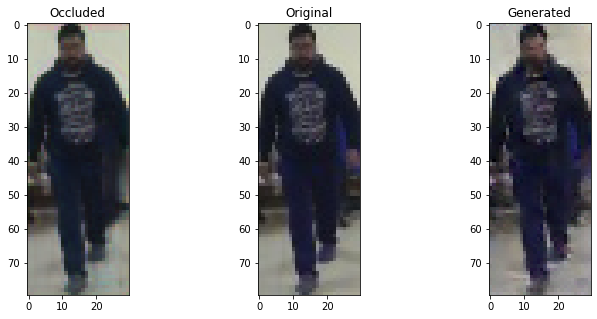

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


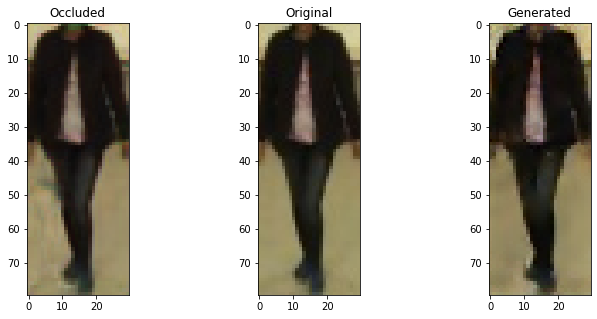

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


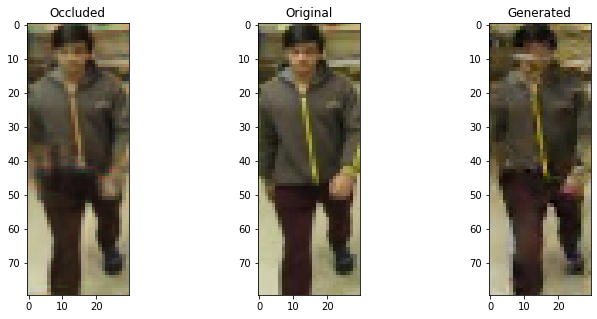

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


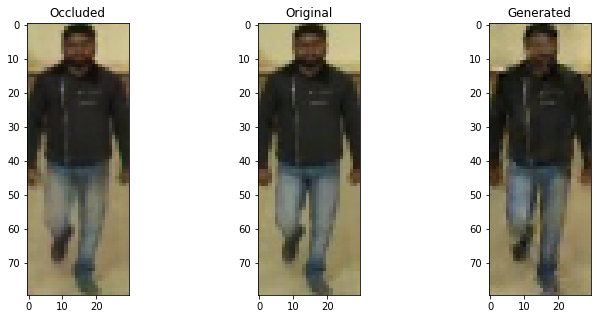

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.661946177482605 , Adversarial Loss:  0.00032355659641325474
Epoch 2942


  8%|▊         | 1/13 [00:00<00:01,  6.91it/s]

Discriminator Loss:  0.6486814022064209 , Adversarial Loss:  0.0003472209791652858
Epoch 2943


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6479239463806152 , Adversarial Loss:  0.0003420325228944421
Epoch 2944


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6600363254547119 , Adversarial Loss:  0.00037575673195533454
Epoch 2945


  8%|▊         | 1/13 [00:00<00:01,  7.07it/s]

Discriminator Loss:  0.6803202033042908 , Adversarial Loss:  0.0003184761153534055
Epoch 2946


  8%|▊         | 1/13 [00:00<00:02,  5.41it/s]

Discriminator Loss:  0.6464220881462097 , Adversarial Loss:  0.00031084305373951793
Epoch 2947


  8%|▊         | 1/13 [00:00<00:02,  5.29it/s]

Discriminator Loss:  0.6712448596954346 , Adversarial Loss:  0.0003493936383165419
Epoch 2948


  8%|▊         | 1/13 [00:00<00:02,  5.89it/s]

Discriminator Loss:  0.6695687770843506 , Adversarial Loss:  0.0003452291712164879
Epoch 2949


  8%|▊         | 1/13 [00:00<00:01,  6.58it/s]

Discriminator Loss:  0.6693055629730225 , Adversarial Loss:  0.0003791348426602781
Epoch 2950


  8%|▊         | 1/13 [00:00<00:01,  6.85it/s]

Discriminator Loss:  0.6604837775230408 , Adversarial Loss:  0.0003147096140310168
Epoch 2951


  8%|▊         | 1/13 [00:00<00:01,  7.02it/s]

Discriminator Loss:  0.6618743538856506 , Adversarial Loss:  0.0003521443286444992
Epoch 2952


  8%|▊         | 1/13 [00:00<00:02,  5.24it/s]

Discriminator Loss:  0.6612210273742676 , Adversarial Loss:  0.0003578963805921376
Epoch 2953


  8%|▊         | 1/13 [00:00<00:02,  5.32it/s]

Discriminator Loss:  0.6573814153671265 , Adversarial Loss:  0.0003356392844580114
Epoch 2954


  8%|▊         | 1/13 [00:00<00:01,  6.49it/s]

Discriminator Loss:  0.657382071018219 , Adversarial Loss:  0.00035172124626114964
Epoch 2955


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6526414155960083 , Adversarial Loss:  0.0003216502955183387
Epoch 2956


  8%|▊         | 1/13 [00:00<00:01,  6.88it/s]

Discriminator Loss:  0.6379013061523438 , Adversarial Loss:  0.00034036117722280324
Epoch 2957


  8%|▊         | 1/13 [00:00<00:01,  6.37it/s]

Discriminator Loss:  0.6548371315002441 , Adversarial Loss:  0.00031593116000294685
Epoch 2958


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6442829370498657 , Adversarial Loss:  0.0003427768824622035
Epoch 2959


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6516413688659668 , Adversarial Loss:  0.0003510366950649768
Epoch 2960


  8%|▊         | 1/13 [00:00<00:02,  5.39it/s]

Discriminator Loss:  0.634831428527832 , Adversarial Loss:  0.00038153096102178097
Epoch 2961


100%|██████████| 13/13 [00:02<00:00,  6.20it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


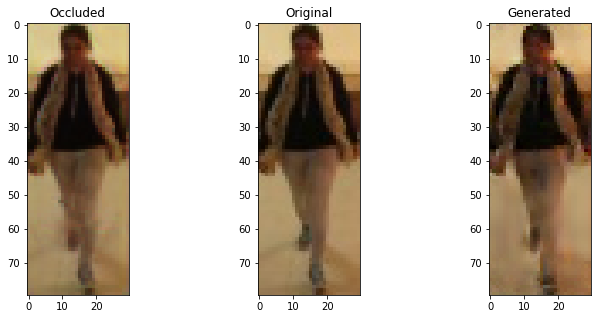

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


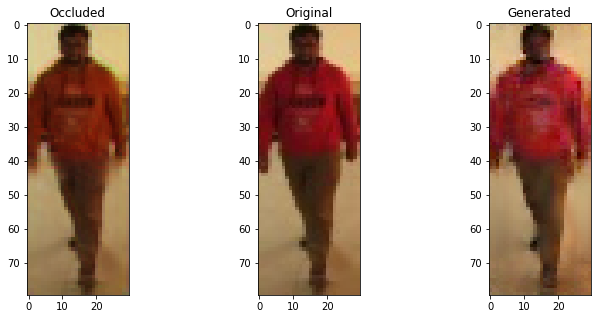

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


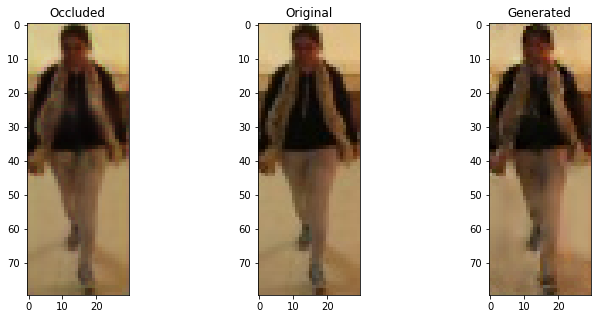

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


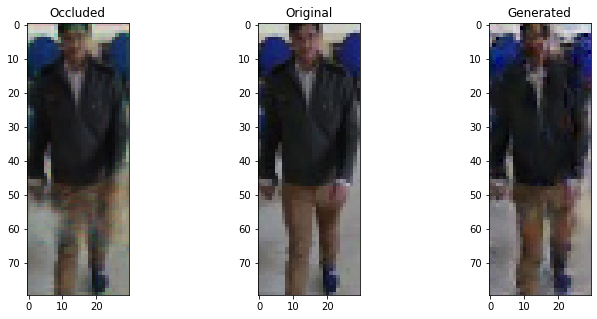

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


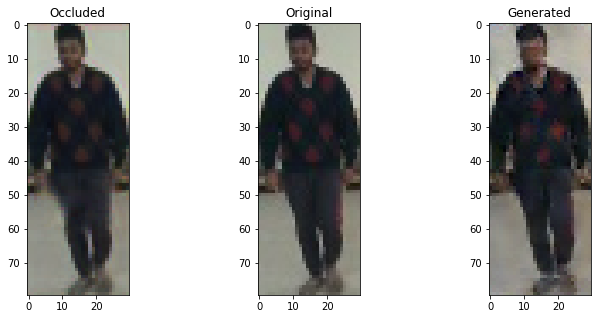

  8%|▊         | 1/13 [00:00<00:02,  5.74it/s]

Discriminator Loss:  0.6452763080596924 , Adversarial Loss:  0.00035596650559455156
Epoch 2962


  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6687029004096985 , Adversarial Loss:  0.000328038731822744
Epoch 2963


  8%|▊         | 1/13 [00:00<00:01,  6.80it/s]

Discriminator Loss:  0.6432087421417236 , Adversarial Loss:  0.000324284570524469
Epoch 2964


  8%|▊         | 1/13 [00:00<00:01,  6.95it/s]

Discriminator Loss:  0.6562303304672241 , Adversarial Loss:  0.00035149024915881455
Epoch 2965


  8%|▊         | 1/13 [00:00<00:01,  6.69it/s]

Discriminator Loss:  0.6550316214561462 , Adversarial Loss:  0.0003543653874658048
Epoch 2966


  8%|▊         | 1/13 [00:00<00:01,  7.00it/s]

Discriminator Loss:  0.673839807510376 , Adversarial Loss:  0.00036046942113898695
Epoch 2967


  8%|▊         | 1/13 [00:00<00:01,  6.83it/s]

Discriminator Loss:  0.6547031998634338 , Adversarial Loss:  0.00031159166246652603
Epoch 2968


  8%|▊         | 1/13 [00:00<00:01,  6.18it/s]

Discriminator Loss:  0.6555812358856201 , Adversarial Loss:  0.0003426632611081004
Epoch 2969


  8%|▊         | 1/13 [00:00<00:01,  7.01it/s]

Discriminator Loss:  0.6314234733581543 , Adversarial Loss:  0.0003757258818950504
Epoch 2970


  8%|▊         | 1/13 [00:00<00:01,  6.76it/s]

Discriminator Loss:  0.6567004323005676 , Adversarial Loss:  0.0003163109067827463
Epoch 2971


  8%|▊         | 1/13 [00:00<00:01,  6.78it/s]

Discriminator Loss:  0.6545678377151489 , Adversarial Loss:  0.0003626266261562705
Epoch 2972


  8%|▊         | 1/13 [00:00<00:01,  6.70it/s]

Discriminator Loss:  0.6457492113113403 , Adversarial Loss:  0.00033051418722607195
Epoch 2973


  8%|▊         | 1/13 [00:00<00:01,  6.94it/s]

Discriminator Loss:  0.660388708114624 , Adversarial Loss:  0.000370280584320426
Epoch 2974


  8%|▊         | 1/13 [00:00<00:02,  5.39it/s]

Discriminator Loss:  0.645896315574646 , Adversarial Loss:  0.0003219126374460757
Epoch 2975


  8%|▊         | 1/13 [00:00<00:01,  6.58it/s]

Discriminator Loss:  0.6567618250846863 , Adversarial Loss:  0.00036360451485961676
Epoch 2976


  8%|▊         | 1/13 [00:00<00:02,  5.40it/s]

Discriminator Loss:  0.6691075563430786 , Adversarial Loss:  0.0003373760264366865
Epoch 2977


  8%|▊         | 1/13 [00:00<00:02,  5.40it/s]

Discriminator Loss:  0.6711138486862183 , Adversarial Loss:  0.0003727497241925448
Epoch 2978


  8%|▊         | 1/13 [00:00<00:01,  7.14it/s]

Discriminator Loss:  0.635421097278595 , Adversarial Loss:  0.00037440125015564263
Epoch 2979


  8%|▊         | 1/13 [00:00<00:01,  6.82it/s]

Discriminator Loss:  0.6618412733078003 , Adversarial Loss:  0.0003722588298842311
Epoch 2980


  8%|▊         | 1/13 [00:00<00:01,  6.78it/s]

Discriminator Loss:  0.6415755748748779 , Adversarial Loss:  0.00031971902353689075
Epoch 2981


100%|██████████| 13/13 [00:02<00:00,  6.27it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


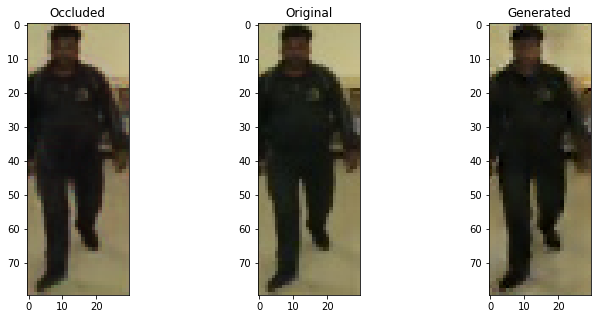

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


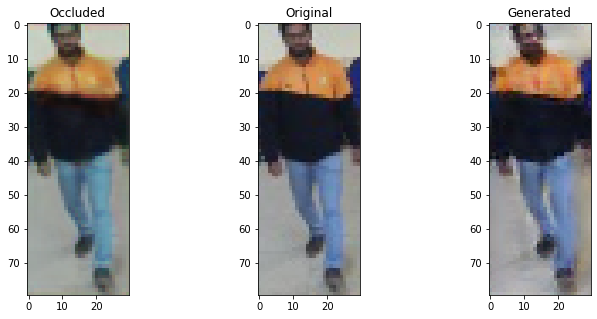

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


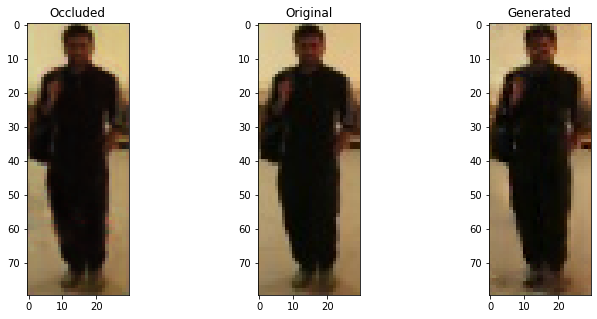

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


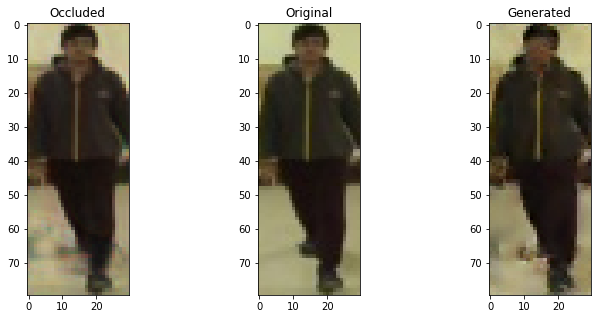

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


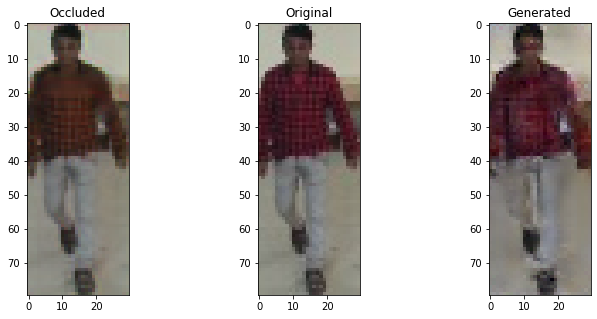

  0%|          | 0/13 [00:00<?, ?it/s]

Discriminator Loss:  0.6723508834838867 , Adversarial Loss:  0.0003240168443880975
Epoch 2982


  8%|▊         | 1/13 [00:00<00:01,  6.65it/s]

Discriminator Loss:  0.6559680700302124 , Adversarial Loss:  0.0003325429279357195
Epoch 2983


  8%|▊         | 1/13 [00:00<00:01,  6.98it/s]

Discriminator Loss:  0.6754701137542725 , Adversarial Loss:  0.0003706493880599737
Epoch 2984


  8%|▊         | 1/13 [00:00<00:01,  6.92it/s]

Discriminator Loss:  0.6602604985237122 , Adversarial Loss:  0.0003300165990367532
Epoch 2985


  8%|▊         | 1/13 [00:00<00:01,  7.08it/s]

Discriminator Loss:  0.672424852848053 , Adversarial Loss:  0.00036657892633229494
Epoch 2986


  8%|▊         | 1/13 [00:00<00:01,  6.63it/s]

Discriminator Loss:  0.6661128997802734 , Adversarial Loss:  0.00035570067120715976
Epoch 2987


  8%|▊         | 1/13 [00:00<00:01,  6.79it/s]

Discriminator Loss:  0.6631214022636414 , Adversarial Loss:  0.0003122290945611894
Epoch 2988


  8%|▊         | 1/13 [00:00<00:01,  6.58it/s]

Discriminator Loss:  0.655140221118927 , Adversarial Loss:  0.0003513440606184304
Epoch 2989


  8%|▊         | 1/13 [00:00<00:01,  6.88it/s]

Discriminator Loss:  0.6435562968254089 , Adversarial Loss:  0.0003117491723969579
Epoch 2990


  8%|▊         | 1/13 [00:00<00:01,  6.69it/s]

Discriminator Loss:  0.6834414601325989 , Adversarial Loss:  0.0003966792719438672
Epoch 2991


  8%|▊         | 1/13 [00:00<00:02,  5.18it/s]

Discriminator Loss:  0.6738917827606201 , Adversarial Loss:  0.0003386431490071118
Epoch 2992


  8%|▊         | 1/13 [00:00<00:01,  6.02it/s]

Discriminator Loss:  0.6611477732658386 , Adversarial Loss:  0.00033326074481010437
Epoch 2993


  8%|▊         | 1/13 [00:00<00:01,  6.91it/s]

Discriminator Loss:  0.6614252328872681 , Adversarial Loss:  0.0003553538117557764
Epoch 2994


  8%|▊         | 1/13 [00:00<00:02,  5.65it/s]

Discriminator Loss:  0.6654167175292969 , Adversarial Loss:  0.0003370477061253041
Epoch 2995


  8%|▊         | 1/13 [00:00<00:02,  5.70it/s]

Discriminator Loss:  0.6399614810943604 , Adversarial Loss:  0.0003451798402238637
Epoch 2996


  8%|▊         | 1/13 [00:00<00:01,  6.85it/s]

Discriminator Loss:  0.6638314723968506 , Adversarial Loss:  0.00034440692979842424
Epoch 2997


  8%|▊         | 1/13 [00:00<00:01,  6.79it/s]

Discriminator Loss:  0.6365196704864502 , Adversarial Loss:  0.00031162440427578986
Epoch 2998


  8%|▊         | 1/13 [00:00<00:01,  6.97it/s]

Discriminator Loss:  0.6520740985870361 , Adversarial Loss:  0.0003550090768840164
Epoch 2999


  8%|▊         | 1/13 [00:00<00:01,  6.10it/s]

Discriminator Loss:  0.6370377540588379 , Adversarial Loss:  0.00036296172766014934
Epoch 3000


100%|██████████| 13/13 [00:02<00:00,  6.37it/s]

Discriminator Loss:  0.641294002532959 , Adversarial Loss:  0.00035613070940598845


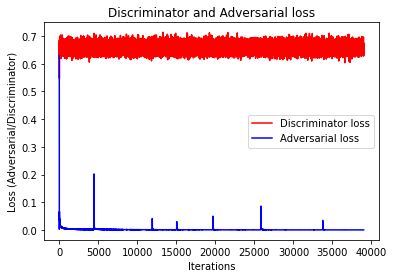

In [ ]:
def train(X_train, noised_train_data,
          input_shape, smooth_real,
          epochs, batch_size,
          optimizer_g, optimizer_d):

    # define two empty lists to store the discriminator
    # and the generatoe losses
    discriminator_losses = []
    generator_losses = []
    
    # Number of iteration possible with batches of size 128
    iterations = X_train.shape[0] // batch_size

    # Load the generator and the discriminator
    generator = img_generator(input_shape)
    discriminator = img_discriminator(input_shape)

    # Compile the discriminator with binary_crossentropy loss
    discriminator.compile(loss='binary_crossentropy',optimizer=optimizer_d)
    
    # Feed the generator and the discriminator to the function dcgan
    # to form the DCGAN architecture
    gan = dcgan(discriminator, generator, input_shape)
    
    # Compile the DCGAN with binary_crossentropy loss
    gan.compile(loss='binary_crossentropy', optimizer=optimizer_g)

    for i in range(epochs):
        print ('Epoch %d' % (i+1))
        # Use tqdm to get an estimate of time remaining
        for j in tqdm(range(1, iterations+1)):
            
            # batch of original images (batch = batchsize)
            original = X_train[np.random.randint(0, X_train.shape[0], size=batch_size)]
            
            # batch of noised images (batch = batchsize)
            noise = noised_train_data[np.random.randint(0, noised_train_data.shape[0], size=batch_size)]

            # Generate fake images
            generated_images = generator.predict(noise)
            
            # Labels for generated data
            dis_lab = np.zeros(2*batch_size)
            
            # data for discriminator
            dis_train = np.concatenate([original, generated_images])
            
            # label smoothing for original images
            dis_lab[:batch_size] = smooth_real
            
            # Train discriminator on original iamges
            discriminator.trainable = True
            discriminator_loss = discriminator.train_on_batch(dis_train, dis_lab)
            
            # save the losses 
            discriminator_losses.append(discriminator_loss)
            
            # Train generator
            gen_lab = np.ones(batch_size)
            discriminator.trainable = False
            sample_indices = np.random.randint(0, X_train.shape[0], size=batch_size)
            original = X_train[sample_indices]
            noise = noised_train_data[sample_indices]
            
            generator_loss = gan.train_on_batch(noise, gen_lab)
            
            # save the losses
            generator_losses.append(generator_loss)
            
          
        if (i)%20==0:
          #print('Iteration - ', j)
          generated_images_plot(original, noise, generator)
          #plot_generated_images_combined(original, noise, generator)

        if i==0:
          generator=load_model('/content/drive/MyDrive/Dataset/N/final/gen_f{1999}.h5')
          discriminator=load_model('/content/drive/MyDrive/Dataset/N/final/disc_f{1999}.h5')

        if (i>2000 and (i)%200==0) or i==2999:
          generator.save('/content/drive/MyDrive/Dataset/N/final/gen_f1{'+str(i)+'}.h5')
          discriminator.save('/content/drive/MyDrive/Dataset/N/final/disc_f1{'+str(i)+'}.h5')
        
        print("Discriminator Loss: ", discriminator_loss,\
              ", Adversarial Loss: ", generator_loss)
        
        # training plot 1
        #generated_images_plot(original, noise, generator)
        # training plot 2
        #plot_generated_images_combined(original, noise, generator)
    
    
    # plot the training losses
    plt.figure()
    plt.plot(range(len(discriminator_losses)), discriminator_losses,
             color='red', label='Discriminator loss')
    plt.plot(range(len(generator_losses)), generator_losses,
             color='blue', label='Adversarial loss')
    plt.title('Discriminator and Adversarial loss')
    plt.xlabel('Iterations')
    plt.ylabel('Loss (Adversarial/Discriminator)')
    plt.legend()
    plt.show()
    
    return generator


generator = train(d[:, 0, :, :, :], d[:, 1, :, :, :],
                  input_shape, smooth_real,
                  epochs, batch_size,
                  optimizer_g, optimizer_d)

In [ ]:
generator.save('/content/drive/MyDrive/Dataset/gen-1800---1.h5')

In [ ]:
from keras.models import load_model

# returns a compiled model
# identical to the previous one
g = load_model('/content/drive/MyDrive/Dataset/N/gen_{1800---1}.h5')

In [ ]:
d[0,:1,:,:,:].shape

(1, 80, 30, 3)

In [ ]:
gen_imgs_test = g.predict(d[0,:1,:,:,:])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


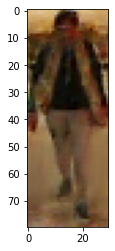

In [ ]:
plt.imshow(gen_imgs_test.reshape(80,30,3))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


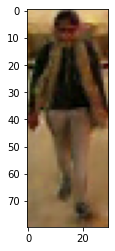

In [ ]:
plt.imshow(gen_imgs_test.reshape(80,30,3))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


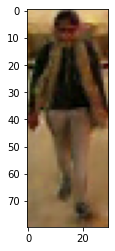

In [ ]:
plt.imshow(gen_imgs_test.reshape(80,30,3))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


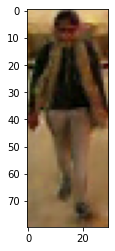

In [ ]:
plt.imshow(gen_imgs_test.reshape(80,30,3))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


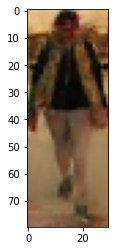

In [ ]:
plt.imshow(gen_imgs_test.reshape(80,30,3))